In [4]:
import json
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf
from hyperopt import Trials, STATUS_OK, tpe
from hyperas import optim
from keras.optimizers import SGD
from hyperas.distributions import choice, uniform
from keras.layers import Dense, Dropout, Activation
import keras
from sklearn.metrics import mean_squared_error
import math
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import mean_absolute_error

import seaborn as sns
import keras.backend as K

from sklearn import preprocessing
from scipy.stats import gaussian_kde



Using TensorFlow backend.


In [3]:
import import_ipynb

import predictionLambda as pl


In [8]:
df_core= pd.read_csv('./final-final-final.csv')
len(df_core)
df_core[(df_core['task_type'] == 4) & (df_core['ram'] == 1152)]['successed'].mean()

0.0

In [44]:
df_core[df_core['successed'] == 0]['hyperflow_time'].max()

70063

In [48]:
df_core[(df_core['ram'] == 1536) & (df_core['task_type'] == 4) ]['lambda_time'].quantile(.5)

1265.5

In [50]:
df_core= pd.read_csv('./final-final-final.csv')
len(df_core)
df_core[(df_core['task_type'] == 6) & (df_core['ram'] == 576)]['lambda_time']

7465    12474.0
7466    13043.0
7467    13376.0
Name: lambda_time, dtype: float64

In [37]:
df_core= pd.read_csv('./montage-hyperflow.csv')
print(len(df_core[(df_core['task_type'] == 4) & (df_core['ram'] == 1792)]['lambda_time']))

print("====")
df_core['iteration'] = 1
df_more_data = pd.read_csv('./montage-normalized.csv')
print(df_more_data[(df_more_data['task_type'] == 0 ) & (df_more_data['ram'] == 1792)]['lambda_time'].quantile(.60))


df_more_data = df_more_data[(df_more_data['iteration'] == 1)].sort_values(by=['task_type', 'ram', 'lambda_time'])
df_more_data = df_more_data.reset_index(drop=True)
df_more_data = df_more_data[df_more_data.index % 3 == 0]  
len(df_more_data)

df_core = df_core.sort_values(by=['task_type', 'ram', 'lambda_time'])
df_core = df_core.reset_index(drop=True)

df_core = df_core[df_core.index % 3 != 0]  
len(df_core)

#mdiff
# df_more_data_diff = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 1)]
# df_more_diff = df_more_data_diff[df_more_data_diff.index % 4 == 0]  

# df_core_diff = df_core[df_core['task_type'] == 1]
# df_core_diff = df_core_diff[df_core_diff.index % 4 != 0]  

# #mproj
# df_more_data_proj = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 0)]
# df_more_proj = df_more_data_proj[df_more_data_proj.index % 3 == 0]  

# df_core_proj = df_core[df_core['task_type'] == 0]
# df_core_proj = df_core_proj[df_core_proj.index % 3 != 0]  

# #mconcat
# df_more_data_concat = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 2)]
# df_more_concat = df_more_data_concat[df_more_data_concat.index % 2 == 0]  

# df_core_concat = df_core[df_core['task_type'] == 2]
# df_core_concat = df_core_concat[df_core_concat.index % 2 != 0]  

# #mbgmodel
# df_more_data = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 0)]
# df_more_proj = df_more_data[df_more_data.index % 3 == 0]  

# df_core_proj = df_core[df_core['task_type'] == 0]
# df_core_proj = df_core_diff[df_core_diff.index % 3 != 0]  

# #mproj
# df_more_data = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 0)]
# df_more_proj = df_more_data[df_more_data.index % 3 == 0]  

# df_core_proj = df_core[df_core['task_type'] == 0]
# df_core_proj = df_core_diff[df_core_diff.index % 3 != 0]  

# #mproj
# df_more_data = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 0)]
# df_more_proj = df_more_data[df_more_data.index % 3 == 0]  

# df_core_proj = df_core[df_core['task_type'] == 0]
# df_core_proj = df_core_diff[df_core_diff.index % 3 != 0]  

# #mproj
# df_more_data = df_more_data[(df_more_data['iteration'] == 1) & (df_more_data['task_type'] == 0)]
# df_more_proj = df_more_data[df_more_data.index % 3 == 0]  

# df_core_proj = df_core[df_core['task_type'] == 0]
# df_core_proj = df_core_diff[df_core_diff.index % 3 != 0]  

df_results = pd.concat([df_more_data, df_core])
df_results = df_results.reset_index(drop=True)
df_results['lambda_time'].min()


132
====
14188.599999999999


162.0

In [72]:
df_full= pd.read_csv('./full-hyperflow.csv')
print(len(df_full))
df_full = df_full[(df_full['task_type'] != 0) | (df_full['ram'] != 1024) | (df_full['hyperflow_time'] < 28000)]
df_full = df_full[(df_full['task_type'] != 0) | (df_full['ram'] != 1472) | (df_full['hyperflow_time'] < 20000)]
df_full = df_full[(df_full['task_type'] != 1) | (df_full['ram'] < 1000) | (df_full['hyperflow_time'] < 7000)]
df_full = df_full[(df_full['task_type'] != 4) | (df_full['ram'] < 640) | (df_full['hyperflow_time'] < 7000)]
len(df_full)

41842


39994

In [5]:
df_results= pd.read_csv('./final-final-final.csv')
len(df_results)

42964

In [81]:
for ram in list(range(128, 3072 ,64)):
    for task in range(0, 7):

        perc_25 = df_results[(df_results['task_type'] == task) & (df_results['ram'] == ram)]['lambda_time'].quantile(.25)
        perc_75 = df_results[(df_results['task_type'] == task) & (df_results['ram'] == ram)]['lambda_time'].quantile(.75)
        wanted_part = df_results[(df_results['task_type'] == task) & (df_results['ram'] == ram) & ((df_results['lambda_time'] >= perc_25) & (df_results['lambda_time'] <= perc_75))]
        df_results = df_results.drop(df_results[(df_results['task_type'] == task) & (df_results['ram'] == ram)].index)
        df_results = pd.concat([wanted_part, df_results])



In [115]:
df_mdiff = df_mdiff.sort_values(by=['task_type', 'ram', 'lambda_time']).iloc[::2]
df_results = pd.concat([df_mdiff, df_no_mdiff])

In [12]:
df_full

,ram,ram_mapped,execution_time_100ms_rounded,execution_time_100ms_rounded_normalized,successed,upload_time_100ms_rounded,upload_time_100ms_rounded_normalized,download_time_100ms_rounded,download_time_100ms_rounded_normalized,lambda_time_100ms_rounded,...,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow,workflow_size,workflow_size_mapped
0,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.242225,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
1,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.245100,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
2,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.248012,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
3,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.248732,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
4,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.243492,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41837,3008,19.0,9.0,0.027875,0,3.0,0.038462,51.0,0.322581,62.0,...,19.714437,16.357402,16.357402,16.357402,2,17.050549,15.578064,montage,0.35,1.0
41838,3008,19.0,12.0,0.038328,0,2.0,0.019231,2.0,0.006452,15.0,...,16.357402,13.811694,13.811694,13.811694,1,13.811694,15.433209,montage,0.35,1.0
41839,3008,19.0,11.0,0.034843,0,1.0,0.000000,3.0,0.012903,14.0,...,16.357402,13.654701,13.654701,13.654701,1,13.654701,15.433209,montage,0.35,1.0
41840,3008,19.0,12.0,0.038328,0,1.0,0.000000,2.0,0.006452,15.0,...,16.357402,13.826876,13.826876,13.826876,1,13.826876,15.433209,montage,0.35,1.0


In [66]:
df_results.to_csv('./montage-final.csv')

In [70]:
df_results[(df_results['task_type'] == 6) & (df_results['ram'] == 1024)]['lambda_time']

14228    8145.0
42778    7626.0
42779    9585.0
Name: lambda_time, dtype: float64

In [78]:
df_results_tmp = df_results[(df_results['task_type'] == 1 ) & (df_results['workflow_size'] == 0.35 )]

In [79]:
print(df_results_tmp[df_results_tmp['ram'] == 2240]['lambda_time'])

45969    511.0
45971    365.0
45974    383.0
45977    334.0
45978    309.0
         ...  
47355    341.0
47356    528.0
47358    543.0
47359    273.0
47360    299.0
Name: lambda_time, Length: 967, dtype: float64


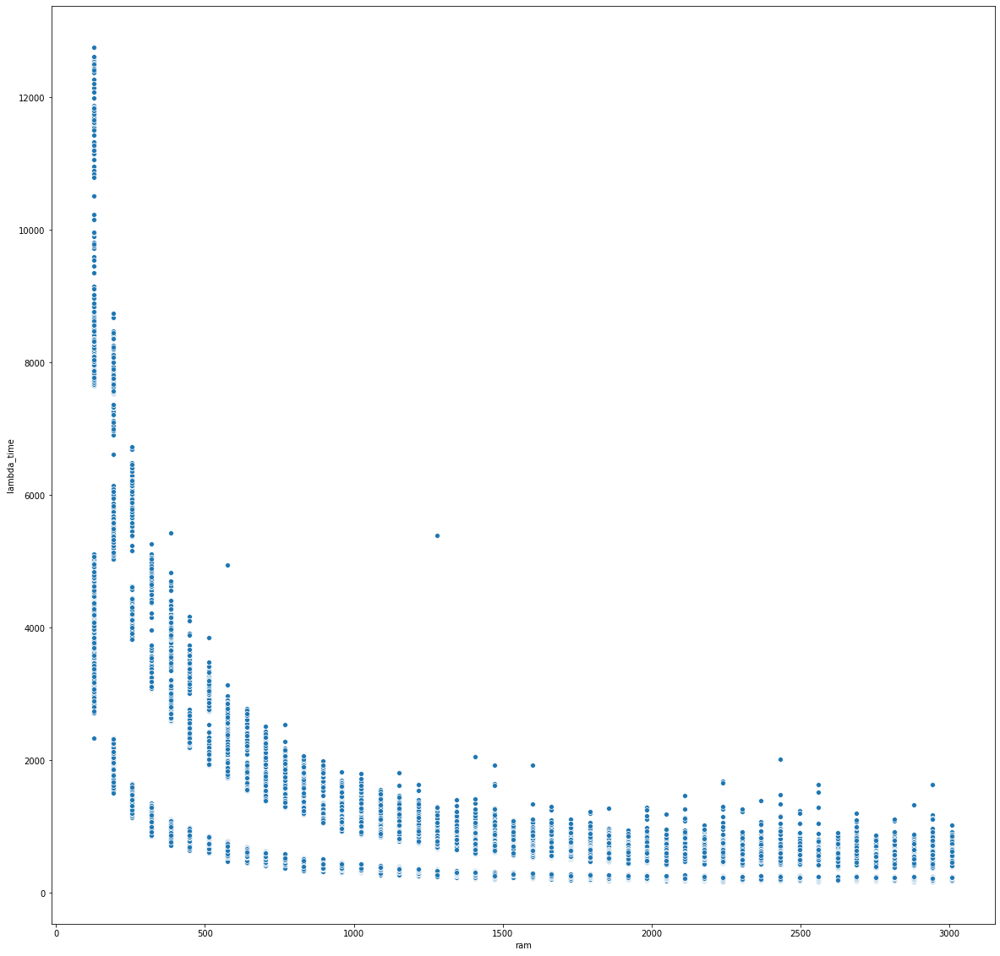

In [37]:
plt.figure(figsize=(20,20))
sns.scatterplot(data=df_results[df_results['task_type'] == 1], x='ram', y='lambda_time')

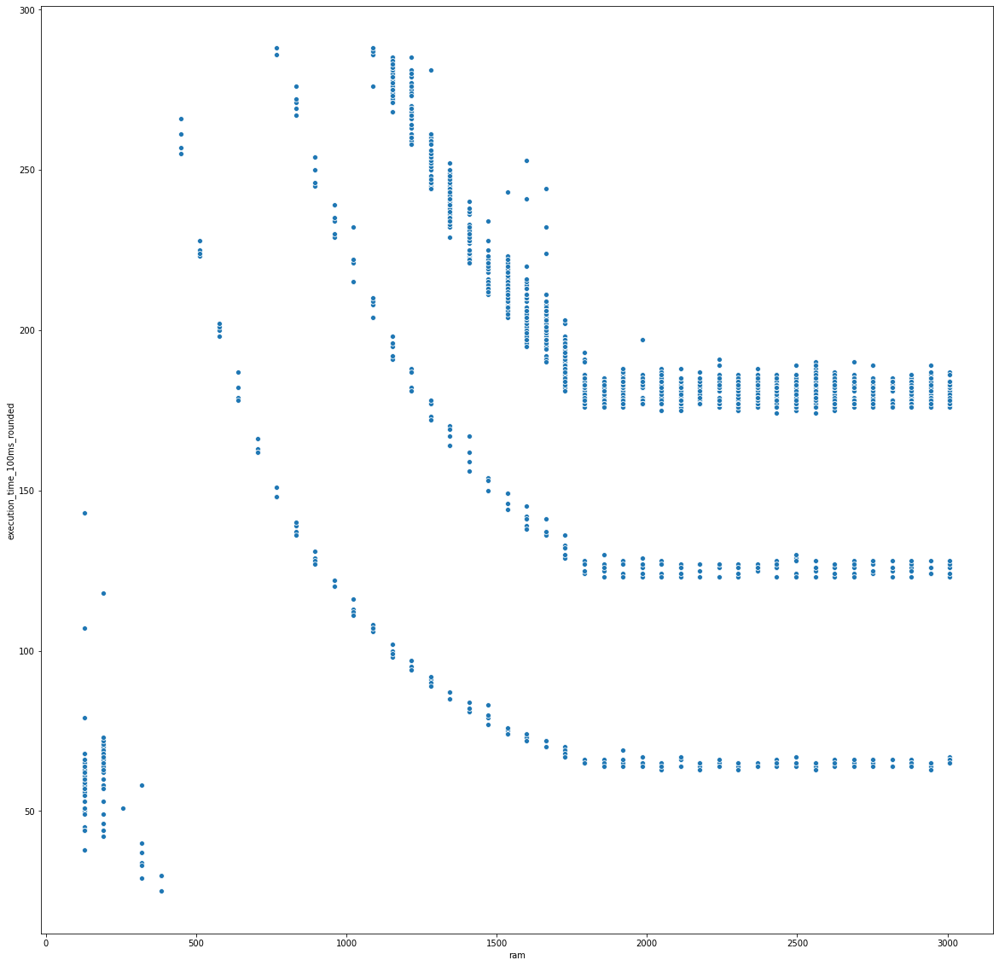

In [41]:
plt.figure(figsize=(20,20))
sns.scatterplot(data=df_results_tmp, x='ram', y='execution_time_100ms_rounded')

In [66]:
# find  NaN entries in your df
nanEntries = df_results[(df_results['task_type'] == 7) & (df_results['ram'] > 1800)].index.tolist()
# choose 10% randomly
dropIndices = np.random.default_rng().choice(nanEntries, size = int(df_results[(df_results['task_type'] == 7) & (df_results['ram'] > 1800)].shape[0]*0.6), replace=False)
# drop them
df_results = df_results.drop(dropIndices)

In [44]:
df_results = pd.read_csv('./results_after_removal.csv')


In [68]:
df_results.to_csv("results_after_removal.csv")

In [77]:
df_results = df_results[df_results['iteration'] == 1]
df_results

,ram,ram_mapped,execution_time_100ms_rounded,execution_time_100ms_rounded_normalized,successed,upload_time_100ms_rounded,upload_time_100ms_rounded_normalized,download_time_100ms_rounded,download_time_100ms_rounded_normalized,lambda_time_100ms_rounded,...,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow,workflow_size,workflow_size_mapped,iteration
0,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,15.239332,15.239332,15.239332,2,15.932479,15.595658,montage,0.35,1.0,1
1,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0,1
2,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0,1
3,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0,1
4,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106578,3008,19.0,1.0,0.000000,0,1.0,0.000000,2.0,0.005291,3.0,...,5.564520,5.564520,5.564520,1,5.564520,13.523338,montage,0.35,1.0,1
106579,3008,19.0,7.0,0.020979,0,2.0,0.018519,2.0,0.005291,10.0,...,15.243484,15.243484,15.243484,2,15.936631,15.572224,montage,0.35,1.0,1
106580,3008,19.0,1.0,0.000000,0,1.0,0.000000,2.0,0.005291,3.0,...,5.572154,5.572154,5.572154,1,5.572154,13.523338,montage,0.35,1.0,1
106581,3008,19.0,1.0,0.000000,0,1.0,0.000000,3.0,0.010582,4.0,...,5.587249,5.587249,5.587249,1,5.587249,13.523338,montage,0.35,1.0,1


In [7]:
x = df_core.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(x_scaled)

ValueError: could not convert string to float: 'mProject_7'

In [22]:
a1 = [1,4,7,8]
a2 = [1,7,2,5]
a3 = a2 if a2 >= a1 else 2 * a2
res = a1[:] < a2[:]

In [38]:
np_a2 = np.array(a2)
np_a2[np.greater_equal(a1, a2)] = np_a2[np.greater_equal(a1, a2)] / 2.0
np_a2

array([0, 7, 1, 2])

In [4]:
def model(x_train, y_train, x_test, y_test):
    model = keras.models.Sequential()
    model.add(Dense({{choice([70,90,110])}}))

    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.01, 0.05)}}))
    model.add(Dense({{choice([70,90,110])}}))

    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.01, 0.05)}}))
    
    model.add(Dense({{choice([70,90,110])}}))

    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.01, 0.05)}}))
    
    
    model.add(Dense(1))
    model.add(Activation('linear'))
    
    model.compile(loss="mean_squared_error", metrics=['accuracy'],optimizer='rmsprop')
        
    model.fit(x_train, y_train,
              batch_size={{choice([128,256,512])}},
              epochs={{choice([500,750,1000])}},
              verbose=2)

    y_pred = model.predict(x_test)
    y_pred = np.nan_to_num(y_pred)
    error = mean_squared_error(y_test, y_pred)
    
    y_pred_train = model.predict(x_train)
    y_pred_train = np.nan_to_num(y_pred_train)
    error_train = mean_squared_error(y_train, y_pred_train)
    error_final = (error + error_train) / 2
    print('Test error:', error)
    return {'loss': error_final, 'status': STATUS_OK, 'model': model}

{'Dense': 2, 'Dense_1': 2, 'Dense_2': 1, 'Dropout': 0.03509211474342462, 'Dropout_1': 0.07521505473124843, 'Dropout_2': 0.23878314775011256, 'batch_size': 3, 'epochs': 3, 'optim': 0}

In [5]:
def model_failed(x_train, y_train, x_test, y_test):
    model = keras.models.Sequential()
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0, 0.3)}}))
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0, 0.3)}}))

    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    
    adam = keras.optimizers.Adam(lr={{uniform(0.0001, 0.1)}})

    model.compile(loss='binary_crossentropy', metrics=['accuracy'],optimizer='adam')
        
    model.fit(x_train, y_train,
              batch_size={{choice([32,64,128,256])}},
              epochs={{choice([100,200,500,1000])}},
              verbose=2)

    y_pred = model.predict(x_test)
    y_pred = np.nan_to_num(y_pred)
    error = mean_squared_error(y_test, y_pred)
    print('Test error:', error)
    return {'loss': error, 'status': STATUS_OK, 'model': model}

In [20]:
x1, y1, x2, y2 = data()
x1

array([[0.95555556, 1.        , 0.        , ..., 0.00526924, 0.        ,
        0.        ],
       [0.13333334, 1.        , 0.        , ..., 0.00590599, 0.        ,
        0.        ],
       [0.8       , 1.        , 0.        , ..., 0.00333052, 0.        ,
        0.        ],
       ...,
       [0.75555557, 1.        , 0.        , ..., 0.00333052, 0.        ,
        0.        ],
       [0.53333336, 1.        , 0.        , ..., 0.00365666, 0.        ,
        0.        ],
       [0.06666667, 1.        , 0.        , ..., 0.00300315, 0.        ,
        0.        ]], dtype=float32)

In [15]:
def data():
    
    df_x = pd.read_csv('x_final_final.csv')
    df_y = pd.read_csv('y_final_final_hyperflow.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

In [8]:
def data_all():
    
    df_x = pd.read_csv('x_normalized.csv')
    df_y = pd.read_csv('y_normalized.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x, y

In [9]:
def data_more():
    
    df_x = pd.read_csv('x_more_data.csv')
    df_y = pd.read_csv('y_more_data.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

In [14]:
def data_128():
    
    df_x = pd.read_csv('x_final_final.csv')
    df_y = pd.read_csv('y_final_final_hyperflow.csv')
 
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    x_y_train_new = np.asarray([x for x in x_y_train if int(x[0] * (3008 - 128) + 128) % 128 == 0 ])
    x_train_new = x_y_train_new[:,:-1]
    y_train_new = x_y_train_new[:,-1]
    
    x_y_test = np.concatenate((x_test, y_test), axis=1)
    
    x_y_test_new = np.asarray([x for x in x_y_test if int(x[0] * (3008 - 128) + 128) % 128 == 0 ])
    x_test_new = x_y_test_new[:,:-1]
    y_test_new = x_y_test_new[:,-1]
    
    return x_train_new, y_train_new, x_test_new, y_test_new

In [13]:
def data_256():
    
    df_x = pd.read_csv('x_final_final.csv')
    df_y = pd.read_csv('y_final_final_hyperflow.csv')
 
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    x_y_train_new = np.asarray([x for x in x_y_train if int(x[0] * (3008 - 128) + 128) % 256 == 128 ])
    x_train_new = x_y_train_new[:,:-1]
    y_train_new = x_y_train_new[:,-1]
    
    x_y_test = np.concatenate((x_test, y_test), axis=1)
    
    x_y_test_new = np.asarray([x for x in x_y_test if int(x[0] * (3008 - 128) + 128) % 256 == 128 ])
    x_test_new = x_y_test_new[:,:-1]
    y_test_new = x_y_test_new[:,-1]
    
    return x_train_new, y_train_new, x_test_new, y_test_new


In [2]:
def data_512():
    
    df_x = pd.read_csv('x_final_final.csv')
    df_y = pd.read_csv('y_final_final_hyperflow.csv')
 
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    x_y_train_new = np.asarray([x for x in x_y_train if int(x[0] * (3008 - 128) + 128) % 512 == 128 ])
    x_train_new = x_y_train_new[:,:-1]
    y_train_new = x_y_train_new[:,-1]
    
    x_y_test = np.concatenate((x_test, y_test), axis=1)
    
    x_y_test_new = np.asarray([x for x in x_y_test if int(x[0] * (3008 - 128) + 128) % 512 == 128 ])
    x_test_new = x_y_test_new[:,:-1]
    y_test_new = x_y_test_new[:,-1]
    
    return x_train_new, y_train_new, x_test_new, y_test_new


In [40]:
len(df_full)

41178

In [62]:
def data_1_run():
    def append_to_dict(my_dict, key):
        if key in my_dict:
            my_dict[key] += 1
        else:
            my_dict[key] = 1
        return my_dict[key] < 2   
    
    df_x = pd.read_csv('x_with_id.csv')
    df_y = pd.read_csv('y_with_id.csv')
         
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    ram_number_dict = dict()
    x_y_train_new = np.asarray([x for x in x_y_train if append_to_dict(ram_number_dict, str(x[0]) + '_' + str(x[1]) + '_' + str(x[4]) + '_' + str(x[-2]))])
            
    x_train = x_y_train_new[:,:-1]
    x_train = np.delete(x_train, 1, 1)
    y_train = x_y_train_new[:,-1]
    x_test = np.delete(x_test, 1, 1)

    return x_train, y_train, x_test, y_test

In [8]:
def data_failed():
    
    df_x = pd.read_csv('x_failed_normalized.csv')
    df_y = pd.read_csv('y_failed_normalized.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

In [87]:
0.044444444444444446 / (3008 - 128) + 128

128.00001543209876

In [21]:
df_results = df_core
df_results

,ram,ram_mapped,execution_time_100ms_rounded,execution_time_100ms_rounded_normalized,successed,upload_time_100ms_rounded,upload_time_100ms_rounded_normalized,download_time_100ms_rounded,download_time_100ms_rounded_normalized,lambda_time_100ms_rounded,...,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow,workflow_size,workflow_size_mapped
0,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.242646,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
1,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.240449,15.239332,15.239332,15.239332,2,15.932479,15.595658,montage,0.35,1.0
2,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.245396,15.239332,15.239332,15.239332,2,15.932479,15.595658,montage,0.35,1.0
3,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.242225,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
4,128,30.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,...,14.245100,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42959,3008,19.0,11.0,0.035088,0,1.0,0.000000,2.0,0.005464,14.0,...,16.357402,13.654701,13.654701,13.654701,1,13.654701,15.433209,montage,0.35,1.0
42960,3008,19.0,9.0,0.028070,0,5.0,0.074074,45.0,0.240437,58.0,...,19.714437,16.357402,16.357402,16.357402,2,17.050549,15.578064,montage,0.35,1.0
42961,3008,19.0,12.0,0.038596,0,2.0,0.018519,2.0,0.005464,16.0,...,16.357402,13.811694,13.811694,13.811694,1,13.811694,15.433209,montage,0.35,1.0
42962,3008,19.0,12.0,0.038596,0,2.0,0.018519,3.0,0.010929,16.0,...,16.357402,13.826876,13.826876,13.826876,1,13.826876,15.433209,montage,0.35,1.0


Tutaj jakis teskst


In [22]:
df_results = df_results[df_results['successed'] == 0]
df_y = df_results['hyperflow_time']
del df_results['lambda_time_100ms_rounded']
del df_results['download_time_100ms_rounded_normalized']
del df_results['ram_mapped']
del df_results['execution_time_100ms_rounded']
del df_results['execution_time_100ms_rounded_normalized']
del df_results['upload_time_100ms_rounded']
del df_results['upload_time_100ms_rounded_normalized']
del df_results['download_time_100ms_rounded']
#del df_results['iteration']





In [75]:
df_results

,ram,successed,lambda_time_100ms_rounded_normalized,lambda_time,hyperflow_time,task_id,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,...,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow,workflow_size,workflow_size_mapped
132,128,0,0.222222,6555.0,7430,mDiffFit_34,2.815578,2.970347,1,5.624018,...,16.625643,5.579730,5.579730,5.579730,1,5.579730,13.523338,montage,0.35,1.0
133,128,0,0.211806,6293.0,7392,mDiffFit_94,2.815578,2.970347,1,5.624018,...,16.623560,5.575949,5.575949,5.575949,1,5.575949,13.523338,montage,0.35,1.0
134,128,0,0.211806,6256.0,7376,mDiffFit_87,2.815578,2.970347,1,5.624018,...,16.623560,5.579730,5.579730,5.579730,1,5.579730,13.523338,montage,0.35,1.0
135,128,0,0.211806,6299.0,7519,mDiffFit_52,2.815578,2.970347,1,5.624018,...,16.624602,5.587249,5.587249,5.587249,1,5.587249,13.523338,montage,0.35,1.0
136,128,0,0.225694,6612.0,7873,mDiffFit_38,2.815578,2.970347,1,5.624018,...,16.626336,5.575949,5.575949,5.575949,1,5.575949,13.523338,montage,0.35,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41837,3008,0,0.208333,6137.0,6354,mAdd_3,0.477121,2.970347,6,5.616771,...,19.714437,16.357402,16.357402,16.357402,2,17.050549,15.578064,montage,0.35,1.0
41838,3008,0,0.045139,1474.0,1724,mViewer_1,0.602060,2.970347,7,16.357402,...,16.357402,13.811694,13.811694,13.811694,1,13.811694,15.433209,montage,0.35,1.0
41839,3008,0,0.041667,1382.0,1632,mViewer_2,0.602060,2.970347,7,16.357402,...,16.357402,13.654701,13.654701,13.654701,1,13.654701,15.433209,montage,0.35,1.0
41840,3008,0,0.045139,1475.0,1710,mViewer_3,0.602060,2.970347,7,16.357402,...,16.357402,13.826876,13.826876,13.826876,1,13.826876,15.433209,montage,0.35,1.0


In [23]:
del df_results['successed']
del df_results['lambda_time_100ms_rounded_normalized']
del df_results['task_id']
del df_results['workflow']
del df_results['workflow_size_mapped']
#del df_results['Unnamed: 0']

In [42]:
df_results['hyperflow_time'].max()

1.0

In [25]:
x = df_results.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df_results = pd.DataFrame(min_max_scaler.fit_transform(df_results), columns=df_results.columns, index=df_results.index)
df_results

,ram,lambda_time,hyperflow_time,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size
132,0.0,0.222074,0.100620,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.001434,0.001434,0.001434,0.0,0.001348,0.00000,0.0
133,0.0,0.229099,0.105397,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.004924,0.004924,0.004924,0.0,0.004628,0.00000,0.0
134,0.0,0.245223,0.109198,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.003891,0.003891,0.003891,0.0,0.003657,0.00000,0.0
135,0.0,0.225657,0.105870,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.005946,0.005946,0.005946,0.0,0.005588,0.00000,0.0
136,0.0,0.241288,0.108998,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.003891,0.003891,0.003891,0.0,0.003657,0.00000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42959,1.0,0.040677,0.016899,0.053428,0.0,1.000000,1.000000,1.000000,1.000000,0.000000,0.612671,0.750033,0.750033,0.750033,0.0,0.704847,0.92161,0.0
42960,1.0,0.195448,0.079976,0.000000,0.0,0.857143,0.006622,0.816324,0.889847,0.834988,0.999468,1.000000,1.000000,1.000000,1.0,1.000000,0.99151,0.0
42961,1.0,0.047668,0.019754,0.053428,0.0,1.000000,1.000000,1.000000,1.000000,0.000000,0.612671,0.764553,0.764553,0.764553,0.0,0.718492,0.92161,0.0
42962,1.0,0.047527,0.019869,0.053428,0.0,1.000000,1.000000,1.000000,1.000000,0.000000,0.612671,0.765957,0.765957,0.765957,0.0,0.719811,0.92161,0.0


In [34]:
df_results[abs(df_results['task_type'] - 0.142857) < 0.0001][abs(df_results['ram'] - 0.488889) < 0.000001].mean()

<ipython-input-34-0b0647edc9d1>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_results[abs(df_results['task_type'] - 0.142857) < 0.0001][abs(df_results['ram'] - 0.488889) < 0.000001].mean()


ram                    0.488889
lambda_time            0.010518
hyperflow_time         0.009979
task_count_log         1.000000
all_tasks_count_log    0.000000
task_type              0.142857
min_size_in_ln         0.007292
max_size_in_ln         0.816327
avg_size_in_ln         0.870686
count_in_ln            0.298648
sum_in_ln              0.643536
min_size_out_ln        0.003762
max_size_out_ln        0.003762
avg_size_out_ln        0.003762
count_out              0.000000
sum_out_ln             0.003535
exec_file_size_ln      0.000000
workflow_size          0.000000
dtype: float64

In [29]:
(1536 - 128) / (3008 - 128)

0.4888888888888889

In [14]:
df_y_hyperflow = df_results['hyperflow_time']
df_y_lambda = df_results['lambda_time']
del df_results['lambda_time']
del df_results['hyperflow_time']

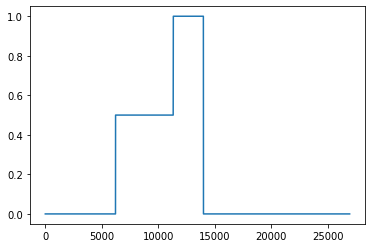

In [18]:
df_results['task_id'] = df_results['task_id'].str.split('_').str[1]

<ipython-input-18-c2d8a4b71457>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_results['task_id'] = df_results['task_id'].str.split('_').str[1]


In [203]:
df

,x_ram,x_task,x_workflow,y_test,y_pred
157,320.000000,2.0,1.0,11.660189,10.158322
215,2112.000000,2.0,1.0,2.152971,2.101343
428,2496.000000,2.0,1.0,2.372640,2.015714
612,2560.000000,2.0,1.0,2.073848,2.006138
1670,1152.000000,2.0,1.0,3.594878,3.329403
1889,1920.000122,2.0,1.0,1.790672,2.200994
2451,2944.000000,2.0,1.0,2.200861,1.946532
4011,2496.000000,2.0,1.0,1.794836,2.015040
4218,1728.000122,2.0,1.0,1.959328,2.345025
4241,768.000000,2.0,1.0,4.525611,4.755287


In [24]:
df_results = df_results.rename(columns={"successed": "failed"})
df_y_failed = df_results['failed']
del df_results['lambda_time_100ms_rounded']
del df_results['download_time_100ms_rounded_normalized']
del df_results['ram_mapped']
del df_results['execution_time_100ms_rounded']
del df_results['execution_time_100ms_rounded_normalized']
del df_results['upload_time_100ms_rounded']
del df_results['upload_time_100ms_rounded_normalized']
del df_results['download_time_100ms_rounded']  
del df_results['task_id']
del df_results['workflow']
del df_results['workflow_size'] 
#del df_results['failed']


In [25]:
del df_results['lambda_time_100ms_rounded_normalized']


In [54]:
df_results

,ram,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size
42139,1.0,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.005607,0.005607,0.005607,0.0,0.005269,0.000000,0.0
42144,1.0,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.005946,0.005946,0.005946,0.0,0.005588,0.000000,0.0
42145,1.0,1.000000,0.0,0.142857,0.007292,0.815982,0.870520,0.298648,0.643338,0.006285,0.006285,0.006285,0.0,0.005906,0.000000,0.0
42146,1.0,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.010894,0.010894,0.010894,0.0,0.010237,0.000000,0.0
42148,1.0,1.000000,0.0,0.142857,0.007292,0.815982,0.870520,0.298648,0.643338,0.003196,0.003196,0.003196,0.0,0.003003,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85916,1.0,0.702794,0.0,0.571429,0.209876,0.816665,0.825729,0.257242,0.564087,0.896784,0.896784,0.896784,1.0,0.903003,0.988692,0.0
85917,1.0,0.702794,0.0,0.000000,0.007292,0.645679,0.725307,0.128621,0.364184,0.896976,0.896976,0.896976,1.0,0.903183,1.000000,0.0
85919,1.0,0.702794,0.0,0.000000,0.007292,0.653079,0.729648,0.128621,0.369373,0.896399,0.896399,0.896399,1.0,0.902641,1.000000,0.0
85924,1.0,0.702794,0.0,0.571429,0.209876,0.817006,0.825929,0.257242,0.564326,0.896976,0.896976,0.896976,1.0,0.903183,0.988692,0.0


In [33]:
x = df_results.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(min_max_scaler.fit_transform(df_results), columns=df_results.columns, index=df_results.index)
df

,ram,lambda_time,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size
0,0.088889,0.048549,1.000000,0.0,0.142857,0.007292,0.815982,0.870419,0.298648,0.643218,0.003544,0.003544,0.003544,0.0,0.003331,0.000000,0.0
1,0.088889,0.165880,0.702794,0.0,0.571429,0.209876,0.815639,0.825127,0.257242,0.563368,0.896206,0.896206,0.896206,1.0,0.902459,0.988692,0.0
2,0.088889,0.044975,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.001789,0.001789,0.001789,0.0,0.001681,0.000000,0.0
4,0.088889,0.142039,0.702794,0.0,0.571429,0.209876,0.815982,0.825328,0.257242,0.563608,0.896399,0.896399,0.896399,1.0,0.902641,0.988692,0.0
5,0.088889,0.053269,1.000000,0.0,0.142857,0.007292,0.815982,0.870520,0.298648,0.643338,0.002846,0.002846,0.002846,0.0,0.002675,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63614,1.000000,0.002984,1.000000,0.0,0.142857,0.007292,0.815982,0.870520,0.298648,0.643338,0.001789,0.001789,0.001789,0.0,0.001681,0.000000,0.0
63615,1.000000,0.027450,0.702794,0.0,0.571429,0.209876,0.817006,0.825929,0.257242,0.564326,0.896976,0.896976,0.896976,1.0,0.903183,0.988692,0.0
63616,1.000000,0.004511,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.002495,0.002495,0.002495,0.0,0.002345,0.000000,0.0
63617,1.000000,0.004928,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.003891,0.003891,0.003891,0.0,0.003657,0.000000,0.0


In [90]:
del df_results['lambda_time']

In [48]:
del df_results['task_count_log']
del df_results['all_tasks_count_log']
del df_results['min_size_in_ln']
del df_results['max_size_in_ln']
del df_results['count_in_ln']
del df_results['min_size_out_ln']
del df_results['max_size_out_ln']
del df_results['count_out']



In [28]:
del df['Unnamed: 0']


In [31]:
del df['failed']

In [12]:
del df_results['Unnamed: 0']

df_x = df_results
df_x

,ram,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size_mapped
0,1536,0.477121,2.970347,2,5.545177,10.270212,5.985465,5.389072,11.374537,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
1,1536,2.815578,2.970347,1,5.624018,15.241410,15.018283,1.609438,16.627721,5.587249,5.587249,5.587249,1,5.587249,13.523338,1.0
2,1536,2.120574,2.970347,0,5.624018,14.245625,13.552658,0.693147,14.245806,15.237249,15.237249,15.237249,2,15.930396,15.595658,1.0
3,1536,2.120574,2.970347,0,5.624018,14.200582,13.507623,0.693147,14.200770,15.243484,15.243484,15.243484,2,15.936631,15.595658,1.0
4,1536,2.120574,2.970347,0,5.624018,14.201983,13.509024,0.693147,14.202171,15.241410,15.241410,15.241410,2,15.934557,15.595658,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26933,2944,0.602060,2.970347,7,16.357402,16.357402,16.357402,0.000000,16.357402,13.811694,13.811694,13.811694,1,13.811694,15.433209,1.0
26934,2944,0.477121,2.970347,2,5.545177,10.270212,5.982981,5.389072,11.372053,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
26935,2944,0.477121,2.970347,6,5.616771,15.244175,15.219244,4.499810,19.719054,16.357402,16.357402,16.357402,2,17.050549,15.578064,1.0
26936,2944,0.477121,2.970347,5,8.900549,15.239332,15.214611,3.806662,19.021274,9.907280,9.907280,9.907280,1,9.907280,15.592423,1.0


In [101]:
df_results

,ram,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size
56844,0.244444,0.702794,0.0,0.0,0.007292,0.645440,0.725167,0.128621,0.364017,0.896399,0.896399,0.896399,1.0,0.902641,1.00000,0.0
56823,0.244444,0.702794,0.0,0.0,0.007292,0.645370,0.725126,0.128621,0.363968,0.896399,0.896399,0.896399,1.0,0.902641,1.00000,0.0
54333,0.266667,0.702794,0.0,0.0,0.007292,0.645386,0.725135,0.128621,0.363979,0.896399,0.896399,0.896399,1.0,0.902641,1.00000,0.0
11209,0.266667,0.702794,0.0,0.0,0.007292,0.645246,0.725053,0.128621,0.363881,0.896784,0.896784,0.896784,1.0,0.903003,1.00000,0.0
55030,0.266667,0.702794,0.0,0.0,0.007292,0.646306,0.725675,0.128621,0.364624,0.896399,0.896399,0.896399,1.0,0.902641,1.00000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82907,0.977778,0.053428,0.0,1.0,1.000000,1.000000,1.000000,0.203859,0.739253,0.880306,0.880306,0.880306,0.0,0.827272,0.92161,0.0
42962,1.000000,0.053428,0.0,1.0,1.000000,1.000000,1.000000,0.000000,0.612671,0.750033,0.750033,0.750033,0.0,0.704847,0.92161,0.0
85471,1.000000,0.053428,0.0,1.0,1.000000,1.000000,1.000000,0.000000,0.612671,0.764553,0.764553,0.764553,0.0,0.718492,0.92161,0.0
42959,1.000000,0.053428,0.0,1.0,1.000000,1.000000,1.000000,0.000000,0.612671,0.764553,0.764553,0.764553,0.0,0.718492,0.92161,0.0


In [15]:
df_results.to_csv('x_final_final.csv', index=False)
df_y_hyperflow.to_csv('y_final_final_hyperflow.csv', index=False)
df_y_lambda.to_csv('y_final_final_lambda.csv', index=False)



In [19]:
def custom_loss_function(y_actual, y_predicted):
    mask = tf.cast(tf.math.greater_equal(y_actual, y_predicted), tf.float32)
    mask = mask * 0.1 + 1
    y_actual = tf.math.multiply(y_actual, mask)
    return K.mean(K.square(K.abs(y_actual - y_predicted)))


In [235]:
def tilted_loss(q,y,f):
    e = (y-f)
    return K.mean(K.maximum(q*e, (q-1)*e), axis=-1)

In [19]:
actual = tf.constant([1.0, 3.0])
predicted = tf.constant([ 2.0, 1.0])
custom_loss_function(actual, predicted)

<tf.Tensor: shape=(), dtype=float32, numpy=5.6199994>

In [95]:
mask = tf.cast(tf.math.greater_equal(actual, predicted), tf.float32)
mask = mask + 1
mask

<tf.Tensor: shape=(2,), dtype=float32, numpy=array([1., 2.], dtype=float32)>

In [28]:
x_train, y_train, x_test, y_test = data()
set(x_train[:, 0])

{0.0,
 0.022222223,
 0.044444446,
 0.06666667,
 0.08888889,
 0.11111111,
 0.13333334,
 0.15555556,
 0.17777778,
 0.2,
 0.22222222,
 0.24444444,
 0.26666668,
 0.2888889,
 0.31111112,
 0.33333334,
 0.35555556,
 0.37777779,
 0.4,
 0.42222223,
 0.44444445,
 0.46666667,
 0.4888889,
 0.51111114,
 0.53333336,
 0.5555556,
 0.5777778,
 0.6,
 0.62222224,
 0.64444447,
 0.6666667,
 0.6888889,
 0.7111111,
 0.73333335,
 0.75555557,
 0.7777778,
 0.8,
 0.82222223,
 0.84444445,
 0.8666667,
 0.8888889,
 0.9111111,
 0.93333334,
 0.95555556,
 0.9777778,
 1.0}

In [8]:
x_train, y_train, x_test, y_test = data_512()

best_run, best_model = optim.minimize(model=model, data = data_512,
                                      algo=tpe.suggest,
                                      max_evals=200,
                                      trials=Trials(),
                                      notebook_name='predictionLambda')

>>> Imports:
#coding=utf-8

try:
    import json
except:
    pass

try:
    import pandas as pd
except:
    pass

try:
    import numpy as np
except:
    pass

try:
    from sklearn.model_selection import train_test_split
except:
    pass

try:
    import tensorflow as tf
except:
    pass

try:
    from hyperopt import Trials, STATUS_OK, tpe
except:
    pass

try:
    from hyperas import optim
except:
    pass

try:
    from keras.optimizers import SGD
except:
    pass

try:
    from hyperas.distributions import choice, uniform
except:
    pass

try:
    from keras.layers import Dense, Dropout, Activation
except:
    pass

try:
    import keras
except:
    pass

try:
    from sklearn.metrics import mean_squared_error
except:
    pass

try:
    import math
except:
    pass

try:
    from sklearn.metrics import plot_confusion_matrix
except:
    pass

try:
    import matplotlib.pyplot as plt
except:
    pass

try:
    import seaborn as sn
except:
    pass

try:
    from sklearn.metrics im

 - 0s - loss: 1.7509e-04 - accuracy: 3.0322e-05        

Epoch 106/500                                          
 - 0s - loss: 1.9185e-04 - accuracy: 3.0322e-05        

Epoch 107/500                                          
 - 0s - loss: 1.7431e-04 - accuracy: 3.0322e-05        

Epoch 108/500                                          
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05        

Epoch 109/500                                          
 - 0s - loss: 1.6028e-04 - accuracy: 3.0322e-05        

Epoch 110/500                                          
 - 0s - loss: 1.6429e-04 - accuracy: 3.0322e-05        

Epoch 111/500                                          
 - 0s - loss: 1.7769e-04 - accuracy: 3.0322e-05        

Epoch 112/500                                          
 - 0s - loss: 1.7144e-04 - accuracy: 3.0322e-05        

Epoch 113/500                                          
 - 0s - loss: 1.7177e-04 - accuracy: 3.0322e-05        

Epoch 114/500                          

Epoch 178/500                                          
 - 0s - loss: 1.6636e-04 - accuracy: 3.0322e-05        

Epoch 179/500                                          
 - 0s - loss: 1.5829e-04 - accuracy: 3.0322e-05        

Epoch 180/500                                          
 - 0s - loss: 1.6578e-04 - accuracy: 3.0322e-05        

Epoch 181/500                                          
 - 0s - loss: 1.5520e-04 - accuracy: 3.0322e-05        

Epoch 182/500                                          
 - 0s - loss: 1.8082e-04 - accuracy: 3.0322e-05        

Epoch 183/500                                          
 - 0s - loss: 1.6703e-04 - accuracy: 3.0322e-05        

Epoch 184/500                                          
 - 0s - loss: 1.5556e-04 - accuracy: 3.0322e-05        

Epoch 185/500                                          
 - 0s - loss: 1.5671e-04 - accuracy: 3.0322e-05        

Epoch 186/500                                          
 - 0s - loss: 1.4371e-04 - accuracy: 3.0

Epoch 323/500                                          
 - 0s - loss: 1.4973e-04 - accuracy: 3.0322e-05        

Epoch 324/500                                          
 - 0s - loss: 1.5558e-04 - accuracy: 3.0322e-05        

Epoch 325/500                                          
 - 0s - loss: 1.5713e-04 - accuracy: 3.0322e-05        

Epoch 326/500                                          
 - 0s - loss: 1.4248e-04 - accuracy: 3.0322e-05        

Epoch 327/500                                          
 - 0s - loss: 1.7354e-04 - accuracy: 3.0322e-05        

Epoch 328/500                                          
 - 0s - loss: 1.4251e-04 - accuracy: 3.0322e-05        

Epoch 329/500                                          
 - 0s - loss: 1.4315e-04 - accuracy: 3.0322e-05        

Epoch 330/500                                          
 - 0s - loss: 1.5215e-04 - accuracy: 3.0322e-05        

Epoch 331/500                                          
 - 0s - loss: 1.4383e-04 - accuracy: 3.0

Epoch 468/500                                          
 - 0s - loss: 1.4424e-04 - accuracy: 3.0322e-05        

Epoch 469/500                                          
 - 0s - loss: 1.4402e-04 - accuracy: 3.0322e-05        

Epoch 470/500                                          
 - 0s - loss: 1.3835e-04 - accuracy: 3.0322e-05        

Epoch 471/500                                          
 - 0s - loss: 1.4503e-04 - accuracy: 3.0322e-05        

Epoch 472/500                                          
 - 0s - loss: 1.6890e-04 - accuracy: 3.0322e-05        

Epoch 473/500                                          
 - 0s - loss: 1.3987e-04 - accuracy: 3.0322e-05        

Epoch 474/500                                          
 - 0s - loss: 1.3525e-04 - accuracy: 3.0322e-05        

Epoch 475/500                                          
 - 0s - loss: 1.4091e-04 - accuracy: 3.0322e-05        

Epoch 476/500                                          
 - 0s - loss: 1.4164e-04 - accuracy: 3.0

 - 0s - loss: 1.9182e-04 - accuracy: 3.0322e-05                                        

Epoch 72/750                                                                           
 - 0s - loss: 1.8051e-04 - accuracy: 3.0322e-05                                        

Epoch 73/750                                                                           
 - 0s - loss: 1.7632e-04 - accuracy: 3.0322e-05                                        

Epoch 74/750                                                                           
 - 0s - loss: 1.8975e-04 - accuracy: 3.0322e-05                                        

Epoch 75/750                                                                           
 - 0s - loss: 1.8331e-04 - accuracy: 3.0322e-05                                        

Epoch 76/750                                                                           
 - 0s - loss: 1.7361e-04 - accuracy: 3.0322e-05                                        

Epoch 77/750              

 - 0s - loss: 1.8272e-04 - accuracy: 3.0322e-05                                        

Epoch 164/750                                                                          
 - 0s - loss: 1.6455e-04 - accuracy: 3.0322e-05                                        

Epoch 165/750                                                                          
 - 0s - loss: 1.6473e-04 - accuracy: 3.0322e-05                                        

Epoch 166/750                                                                          
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                                        

Epoch 167/750                                                                          
 - 0s - loss: 1.6555e-04 - accuracy: 3.0322e-05                                        

Epoch 168/750                                                                          
 - 0s - loss: 1.7725e-04 - accuracy: 3.0322e-05                                        

Epoch 169/750             

 - 0s - loss: 1.5760e-04 - accuracy: 3.0322e-05                                        

Epoch 256/750                                                                          
 - 0s - loss: 1.5759e-04 - accuracy: 3.0322e-05                                        

Epoch 257/750                                                                          
 - 0s - loss: 1.6342e-04 - accuracy: 3.0322e-05                                        

Epoch 258/750                                                                          
 - 0s - loss: 1.6451e-04 - accuracy: 3.0322e-05                                        

Epoch 259/750                                                                          
 - 0s - loss: 1.6423e-04 - accuracy: 3.0322e-05                                        

Epoch 260/750                                                                          
 - 0s - loss: 1.7495e-04 - accuracy: 3.0322e-05                                        

Epoch 261/750             

 - 0s - loss: 1.5895e-04 - accuracy: 3.0322e-05                                        

Epoch 348/750                                                                          
 - 0s - loss: 1.6577e-04 - accuracy: 3.0322e-05                                        

Epoch 349/750                                                                          
 - 0s - loss: 1.5893e-04 - accuracy: 3.0322e-05                                        

Epoch 350/750                                                                          
 - 0s - loss: 1.5403e-04 - accuracy: 3.0322e-05                                        

Epoch 351/750                                                                          
 - 0s - loss: 1.6364e-04 - accuracy: 3.0322e-05                                        

Epoch 352/750                                                                          
 - 0s - loss: 1.5898e-04 - accuracy: 3.0322e-05                                        

Epoch 353/750             

 - 0s - loss: 1.6317e-04 - accuracy: 3.0322e-05                                        

Epoch 440/750                                                                          
 - 0s - loss: 1.6497e-04 - accuracy: 3.0322e-05                                        

Epoch 441/750                                                                          
 - 0s - loss: 1.5011e-04 - accuracy: 3.0322e-05                                        

Epoch 442/750                                                                          
 - 0s - loss: 1.5387e-04 - accuracy: 3.0322e-05                                        

Epoch 443/750                                                                          
 - 0s - loss: 1.4959e-04 - accuracy: 3.0322e-05                                        

Epoch 444/750                                                                          
 - 0s - loss: 1.6836e-04 - accuracy: 3.0322e-05                                        

Epoch 445/750             

 - 0s - loss: 1.7994e-04 - accuracy: 3.0322e-05                                        

Epoch 532/750                                                                          
 - 0s - loss: 1.6902e-04 - accuracy: 3.0322e-05                                        

Epoch 533/750                                                                          
 - 0s - loss: 1.6891e-04 - accuracy: 3.0322e-05                                        

Epoch 534/750                                                                          
 - 0s - loss: 1.6207e-04 - accuracy: 3.0322e-05                                        

Epoch 535/750                                                                          
 - 0s - loss: 1.6267e-04 - accuracy: 3.0322e-05                                        

Epoch 536/750                                                                          
 - 0s - loss: 1.6191e-04 - accuracy: 3.0322e-05                                        

Epoch 537/750             

 - 0s - loss: 1.7083e-04 - accuracy: 3.0322e-05                                        

Epoch 624/750                                                                          
 - 0s - loss: 1.7342e-04 - accuracy: 3.0322e-05                                        

Epoch 625/750                                                                          
 - 0s - loss: 1.7525e-04 - accuracy: 3.0322e-05                                        

Epoch 626/750                                                                          
 - 0s - loss: 1.6256e-04 - accuracy: 3.0322e-05                                        

Epoch 627/750                                                                          
 - 0s - loss: 1.8196e-04 - accuracy: 3.0322e-05                                        

Epoch 628/750                                                                          
 - 0s - loss: 1.6577e-04 - accuracy: 3.0322e-05                                        

Epoch 629/750             

 - 0s - loss: 1.7360e-04 - accuracy: 3.0322e-05                                        

Epoch 716/750                                                                          
 - 0s - loss: 1.6594e-04 - accuracy: 3.0322e-05                                        

Epoch 717/750                                                                          
 - 0s - loss: 1.5925e-04 - accuracy: 3.0322e-05                                        

Epoch 718/750                                                                          
 - 0s - loss: 1.7185e-04 - accuracy: 3.0322e-05                                        

Epoch 719/750                                                                          
 - 0s - loss: 1.5913e-04 - accuracy: 3.0322e-05                                        

Epoch 720/750                                                                          
 - 0s - loss: 1.6544e-04 - accuracy: 3.0322e-05                                        

Epoch 721/750             

Epoch 56/1000                                                                           
 - 0s - loss: 1.8053e-04 - accuracy: 3.0322e-05                                         

Epoch 57/1000                                                                           
 - 0s - loss: 1.7348e-04 - accuracy: 3.0322e-05                                         

Epoch 58/1000                                                                           
 - 0s - loss: 1.8144e-04 - accuracy: 3.0322e-05                                         

Epoch 59/1000                                                                           
 - 0s - loss: 1.8361e-04 - accuracy: 3.0322e-05                                         

Epoch 60/1000                                                                           
 - 0s - loss: 1.9144e-04 - accuracy: 3.0322e-05                                         

Epoch 61/1000                                                                           
 - 0s - loss: 2.

Epoch 147/1000                                                                          
 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                         

Epoch 148/1000                                                                          
 - 0s - loss: 1.7348e-04 - accuracy: 3.0322e-05                                         

Epoch 149/1000                                                                          
 - 0s - loss: 1.6835e-04 - accuracy: 3.0322e-05                                         

Epoch 150/1000                                                                          
 - 0s - loss: 1.6759e-04 - accuracy: 3.0322e-05                                         

Epoch 151/1000                                                                          
 - 0s - loss: 1.6159e-04 - accuracy: 3.0322e-05                                         

Epoch 152/1000                                                                          
 - 0s - loss: 1.

Epoch 238/1000                                                                          
 - 0s - loss: 1.6541e-04 - accuracy: 3.0322e-05                                         

Epoch 239/1000                                                                          
 - 0s - loss: 1.7622e-04 - accuracy: 3.0322e-05                                         

Epoch 240/1000                                                                          
 - 0s - loss: 1.7209e-04 - accuracy: 3.0322e-05                                         

Epoch 241/1000                                                                          
 - 0s - loss: 1.7493e-04 - accuracy: 3.0322e-05                                         

Epoch 242/1000                                                                          
 - 0s - loss: 1.6717e-04 - accuracy: 3.0322e-05                                         

Epoch 243/1000                                                                          
 - 0s - loss: 1.

Epoch 329/1000                                                                          
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                         

Epoch 330/1000                                                                          
 - 0s - loss: 1.6291e-04 - accuracy: 3.0322e-05                                         

Epoch 331/1000                                                                          
 - 0s - loss: 1.6766e-04 - accuracy: 3.0322e-05                                         

Epoch 332/1000                                                                          
 - 0s - loss: 1.8785e-04 - accuracy: 3.0322e-05                                         

Epoch 333/1000                                                                          
 - 0s - loss: 1.6239e-04 - accuracy: 3.0322e-05                                         

Epoch 334/1000                                                                          
 - 0s - loss: 1.

Epoch 420/1000                                                                          
 - 0s - loss: 1.5486e-04 - accuracy: 3.0322e-05                                         

Epoch 421/1000                                                                          
 - 0s - loss: 1.7394e-04 - accuracy: 3.0322e-05                                         

Epoch 422/1000                                                                          
 - 0s - loss: 1.5408e-04 - accuracy: 3.0322e-05                                         

Epoch 423/1000                                                                          
 - 0s - loss: 1.5878e-04 - accuracy: 3.0322e-05                                         

Epoch 424/1000                                                                          
 - 0s - loss: 1.4921e-04 - accuracy: 3.0322e-05                                         

Epoch 425/1000                                                                          
 - 0s - loss: 1.

Epoch 511/1000                                                                          
 - 0s - loss: 1.6208e-04 - accuracy: 3.0322e-05                                         

Epoch 512/1000                                                                          
 - 0s - loss: 1.6234e-04 - accuracy: 3.0322e-05                                         

Epoch 513/1000                                                                          
 - 0s - loss: 1.7587e-04 - accuracy: 3.0322e-05                                         

Epoch 514/1000                                                                          
 - 0s - loss: 1.8480e-04 - accuracy: 3.0322e-05                                         

Epoch 515/1000                                                                          
 - 0s - loss: 1.8281e-04 - accuracy: 3.0322e-05                                         

Epoch 516/1000                                                                          
 - 0s - loss: 1.

Epoch 602/1000                                                                          
 - 0s - loss: 1.7607e-04 - accuracy: 3.0322e-05                                         

Epoch 603/1000                                                                          
 - 0s - loss: 1.8107e-04 - accuracy: 3.0322e-05                                         

Epoch 604/1000                                                                          
 - 0s - loss: 1.6936e-04 - accuracy: 3.0322e-05                                         

Epoch 605/1000                                                                          
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                         

Epoch 606/1000                                                                          
 - 0s - loss: 1.6727e-04 - accuracy: 3.0322e-05                                         

Epoch 607/1000                                                                          
 - 0s - loss: 1.

Epoch 693/1000                                                                          
 - 0s - loss: 1.6040e-04 - accuracy: 3.0322e-05                                         

Epoch 694/1000                                                                          
 - 0s - loss: 1.5702e-04 - accuracy: 3.0322e-05                                         

Epoch 695/1000                                                                          
 - 0s - loss: 1.5559e-04 - accuracy: 3.0322e-05                                         

Epoch 696/1000                                                                          
 - 0s - loss: 1.6693e-04 - accuracy: 3.0322e-05                                         

Epoch 697/1000                                                                          
 - 0s - loss: 1.6339e-04 - accuracy: 3.0322e-05                                         

Epoch 698/1000                                                                          
 - 0s - loss: 1.

Epoch 784/1000                                                                          
 - 0s - loss: 1.7140e-04 - accuracy: 3.0322e-05                                         

Epoch 785/1000                                                                          
 - 0s - loss: 1.6474e-04 - accuracy: 3.0322e-05                                         

Epoch 786/1000                                                                          
 - 0s - loss: 1.5799e-04 - accuracy: 3.0322e-05                                         

Epoch 787/1000                                                                          
 - 0s - loss: 1.6328e-04 - accuracy: 3.0322e-05                                         

Epoch 788/1000                                                                          
 - 0s - loss: 1.5655e-04 - accuracy: 3.0322e-05                                         

Epoch 789/1000                                                                          
 - 0s - loss: 1.

Epoch 875/1000                                                                          
 - 0s - loss: 1.6822e-04 - accuracy: 3.0322e-05                                         

Epoch 876/1000                                                                          
 - 0s - loss: 1.6208e-04 - accuracy: 3.0322e-05                                         

Epoch 877/1000                                                                          
 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                                         

Epoch 878/1000                                                                          
 - 0s - loss: 1.5692e-04 - accuracy: 3.0322e-05                                         

Epoch 879/1000                                                                          
 - 0s - loss: 1.6021e-04 - accuracy: 3.0322e-05                                         

Epoch 880/1000                                                                          
 - 0s - loss: 1.

Epoch 966/1000                                                                          
 - 0s - loss: 1.6051e-04 - accuracy: 3.0322e-05                                         

Epoch 967/1000                                                                          
 - 0s - loss: 1.5753e-04 - accuracy: 3.0322e-05                                         

Epoch 968/1000                                                                          
 - 0s - loss: 1.6113e-04 - accuracy: 3.0322e-05                                         

Epoch 969/1000                                                                          
 - 0s - loss: 1.4998e-04 - accuracy: 3.0322e-05                                         

Epoch 970/1000                                                                          
 - 0s - loss: 1.7359e-04 - accuracy: 3.0322e-05                                         

Epoch 971/1000                                                                          
 - 0s - loss: 1.

 - 0s - loss: 2.0738e-04 - accuracy: 3.0322e-05                                          

Epoch 56/750                                                                             
 - 0s - loss: 2.0108e-04 - accuracy: 3.0322e-05                                          

Epoch 57/750                                                                             
 - 0s - loss: 1.9076e-04 - accuracy: 3.0322e-05                                          

Epoch 58/750                                                                             
 - 0s - loss: 1.9482e-04 - accuracy: 3.0322e-05                                          

Epoch 59/750                                                                             
 - 0s - loss: 2.0170e-04 - accuracy: 3.0322e-05                                          

Epoch 60/750                                                                             
 - 0s - loss: 2.0477e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.5732e-04 - accuracy: 3.0322e-05                                          

Epoch 146/750                                                                            
 - 0s - loss: 1.7687e-04 - accuracy: 3.0322e-05                                          

Epoch 147/750                                                                            
 - 0s - loss: 1.6659e-04 - accuracy: 3.0322e-05                                          

Epoch 148/750                                                                            
 - 0s - loss: 1.6785e-04 - accuracy: 3.0322e-05                                          

Epoch 149/750                                                                            
 - 0s - loss: 1.7203e-04 - accuracy: 3.0322e-05                                          

Epoch 150/750                                                                            
 - 0s - loss: 1.7739e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.5267e-04 - accuracy: 3.0322e-05                                          

Epoch 236/750                                                                            
 - 0s - loss: 1.6075e-04 - accuracy: 3.0322e-05                                          

Epoch 237/750                                                                            
 - 0s - loss: 1.8684e-04 - accuracy: 3.0322e-05                                          

Epoch 238/750                                                                            
 - 0s - loss: 1.5248e-04 - accuracy: 3.0322e-05                                          

Epoch 239/750                                                                            
 - 0s - loss: 1.8165e-04 - accuracy: 3.0322e-05                                          

Epoch 240/750                                                                            
 - 0s - loss: 1.5682e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.5279e-04 - accuracy: 3.0322e-05                                          

Epoch 326/750                                                                            
 - 0s - loss: 1.4557e-04 - accuracy: 3.0322e-05                                          

Epoch 327/750                                                                            
 - 0s - loss: 1.5912e-04 - accuracy: 3.0322e-05                                          

Epoch 328/750                                                                            
 - 0s - loss: 1.4720e-04 - accuracy: 3.0322e-05                                          

Epoch 329/750                                                                            
 - 0s - loss: 1.5951e-04 - accuracy: 3.0322e-05                                          

Epoch 330/750                                                                            
 - 0s - loss: 1.5861e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.4375e-04 - accuracy: 3.0322e-05                                          

Epoch 416/750                                                                            
 - 0s - loss: 1.4948e-04 - accuracy: 3.0322e-05                                          

Epoch 417/750                                                                            
 - 0s - loss: 1.5825e-04 - accuracy: 3.0322e-05                                          

Epoch 418/750                                                                            
 - 0s - loss: 1.5049e-04 - accuracy: 3.0322e-05                                          

Epoch 419/750                                                                            
 - 0s - loss: 1.5865e-04 - accuracy: 3.0322e-05                                          

Epoch 420/750                                                                            
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.4074e-04 - accuracy: 3.0322e-05                                          

Epoch 506/750                                                                            
 - 0s - loss: 1.7142e-04 - accuracy: 3.0322e-05                                          

Epoch 507/750                                                                            
 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                                          

Epoch 508/750                                                                            
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                          

Epoch 509/750                                                                            
 - 0s - loss: 1.4927e-04 - accuracy: 3.0322e-05                                          

Epoch 510/750                                                                            
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.5207e-04 - accuracy: 3.0322e-05                                          

Epoch 596/750                                                                            
 - 0s - loss: 1.4097e-04 - accuracy: 3.0322e-05                                          

Epoch 597/750                                                                            
 - 0s - loss: 1.3513e-04 - accuracy: 3.0322e-05                                          

Epoch 598/750                                                                            
 - 0s - loss: 1.4403e-04 - accuracy: 3.0322e-05                                          

Epoch 599/750                                                                            
 - 0s - loss: 1.6278e-04 - accuracy: 3.0322e-05                                          

Epoch 600/750                                                                            
 - 0s - loss: 1.5765e-04 - accuracy: 3.0322e-05                                          

Epoc

 - 0s - loss: 1.6948e-04 - accuracy: 3.0322e-05                                          

Epoch 686/750                                                                            
 - 0s - loss: 1.4458e-04 - accuracy: 3.0322e-05                                          

Epoch 687/750                                                                            
 - 0s - loss: 1.4453e-04 - accuracy: 3.0322e-05                                          

Epoch 688/750                                                                            
 - 0s - loss: 1.4703e-04 - accuracy: 3.0322e-05                                          

Epoch 689/750                                                                            
 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                                          

Epoch 690/750                                                                            
 - 0s - loss: 1.4381e-04 - accuracy: 3.0322e-05                                          

Epoc

Epoch 25/1000                                                                           
 - 0s - loss: 3.1372e-04 - accuracy: 3.0322e-05                                         

Epoch 26/1000                                                                           
 - 0s - loss: 2.9689e-04 - accuracy: 3.0322e-05                                         

Epoch 27/1000                                                                           
 - 0s - loss: 3.0945e-04 - accuracy: 3.0322e-05                                         

Epoch 28/1000                                                                           
 - 0s - loss: 3.0592e-04 - accuracy: 3.0322e-05                                         

Epoch 29/1000                                                                           
 - 0s - loss: 2.9475e-04 - accuracy: 3.0322e-05                                         

Epoch 30/1000                                                                           
 - 0s - loss: 2.

Epoch 116/1000                                                                          
 - 0s - loss: 1.6768e-04 - accuracy: 3.0322e-05                                         

Epoch 117/1000                                                                          
 - 0s - loss: 1.4766e-04 - accuracy: 3.0322e-05                                         

Epoch 118/1000                                                                          
 - 0s - loss: 1.6565e-04 - accuracy: 3.0322e-05                                         

Epoch 119/1000                                                                          
 - 0s - loss: 1.7401e-04 - accuracy: 3.0322e-05                                         

Epoch 120/1000                                                                          
 - 0s - loss: 1.5523e-04 - accuracy: 3.0322e-05                                         

Epoch 121/1000                                                                          
 - 0s - loss: 1.

Epoch 207/1000                                                                          
 - 0s - loss: 1.5763e-04 - accuracy: 3.0322e-05                                         

Epoch 208/1000                                                                          
 - 0s - loss: 1.3876e-04 - accuracy: 3.0322e-05                                         

Epoch 209/1000                                                                          
 - 0s - loss: 1.5600e-04 - accuracy: 3.0322e-05                                         

Epoch 210/1000                                                                          
 - 0s - loss: 1.4281e-04 - accuracy: 3.0322e-05                                         

Epoch 211/1000                                                                          
 - 0s - loss: 1.4707e-04 - accuracy: 3.0322e-05                                         

Epoch 212/1000                                                                          
 - 0s - loss: 1.

Epoch 298/1000                                                                          
 - 0s - loss: 1.5083e-04 - accuracy: 3.0322e-05                                         

Epoch 299/1000                                                                          
 - 0s - loss: 1.4281e-04 - accuracy: 3.0322e-05                                         

Epoch 300/1000                                                                          
 - 0s - loss: 1.4368e-04 - accuracy: 3.0322e-05                                         

Epoch 301/1000                                                                          
 - 0s - loss: 1.3931e-04 - accuracy: 3.0322e-05                                         

Epoch 302/1000                                                                          
 - 0s - loss: 1.6147e-04 - accuracy: 3.0322e-05                                         

Epoch 303/1000                                                                          
 - 0s - loss: 1.

Epoch 389/1000                                                                          
 - 0s - loss: 1.3982e-04 - accuracy: 3.0322e-05                                         

Epoch 390/1000                                                                          
 - 0s - loss: 1.3384e-04 - accuracy: 3.0322e-05                                         

Epoch 391/1000                                                                          
 - 0s - loss: 1.2918e-04 - accuracy: 3.0322e-05                                         

Epoch 392/1000                                                                          
 - 0s - loss: 1.3907e-04 - accuracy: 3.0322e-05                                         

Epoch 393/1000                                                                          
 - 0s - loss: 1.3713e-04 - accuracy: 3.0322e-05                                         

Epoch 394/1000                                                                          
 - 0s - loss: 1.

Epoch 480/1000                                                                          
 - 0s - loss: 1.3614e-04 - accuracy: 3.0322e-05                                         

Epoch 481/1000                                                                          
 - 0s - loss: 1.3164e-04 - accuracy: 3.0322e-05                                         

Epoch 482/1000                                                                          
 - 0s - loss: 1.3689e-04 - accuracy: 3.0322e-05                                         

Epoch 483/1000                                                                          
 - 0s - loss: 1.3424e-04 - accuracy: 3.0322e-05                                         

Epoch 484/1000                                                                          
 - 0s - loss: 1.3414e-04 - accuracy: 3.0322e-05                                         

Epoch 485/1000                                                                          
 - 0s - loss: 1.

Epoch 571/1000                                                                          
 - 0s - loss: 1.3160e-04 - accuracy: 3.0322e-05                                         

Epoch 572/1000                                                                          
 - 0s - loss: 1.2996e-04 - accuracy: 3.0322e-05                                         

Epoch 573/1000                                                                          
 - 0s - loss: 1.3473e-04 - accuracy: 3.0322e-05                                         

Epoch 574/1000                                                                          
 - 0s - loss: 1.3671e-04 - accuracy: 3.0322e-05                                         

Epoch 575/1000                                                                          
 - 0s - loss: 1.3255e-04 - accuracy: 3.0322e-05                                         

Epoch 576/1000                                                                          
 - 0s - loss: 1.

Epoch 662/1000                                                                          
 - 0s - loss: 1.4052e-04 - accuracy: 3.0322e-05                                         

Epoch 663/1000                                                                          
 - 0s - loss: 1.4099e-04 - accuracy: 3.0322e-05                                         

Epoch 664/1000                                                                          
 - 0s - loss: 1.3546e-04 - accuracy: 3.0322e-05                                         

Epoch 665/1000                                                                          
 - 0s - loss: 1.3628e-04 - accuracy: 3.0322e-05                                         

Epoch 666/1000                                                                          
 - 0s - loss: 1.3543e-04 - accuracy: 3.0322e-05                                         

Epoch 667/1000                                                                          
 - 0s - loss: 1.

Epoch 753/1000                                                                          
 - 0s - loss: 1.2865e-04 - accuracy: 3.0322e-05                                         

Epoch 754/1000                                                                          
 - 0s - loss: 1.3908e-04 - accuracy: 3.0322e-05                                         

Epoch 755/1000                                                                          
 - 0s - loss: 1.3391e-04 - accuracy: 3.0322e-05                                         

Epoch 756/1000                                                                          
 - 0s - loss: 1.3577e-04 - accuracy: 3.0322e-05                                         

Epoch 757/1000                                                                          
 - 0s - loss: 1.3460e-04 - accuracy: 3.0322e-05                                         

Epoch 758/1000                                                                          
 - 0s - loss: 1.

Epoch 844/1000                                                                          
 - 0s - loss: 1.4166e-04 - accuracy: 3.0322e-05                                         

Epoch 845/1000                                                                          
 - 0s - loss: 1.3208e-04 - accuracy: 3.0322e-05                                         

Epoch 846/1000                                                                          
 - 0s - loss: 1.3248e-04 - accuracy: 3.0322e-05                                         

Epoch 847/1000                                                                          
 - 0s - loss: 1.3213e-04 - accuracy: 3.0322e-05                                         

Epoch 848/1000                                                                          
 - 0s - loss: 1.3169e-04 - accuracy: 3.0322e-05                                         

Epoch 849/1000                                                                          
 - 0s - loss: 1.

Epoch 935/1000                                                                          
 - 0s - loss: 1.3149e-04 - accuracy: 3.0322e-05                                         

Epoch 936/1000                                                                          
 - 0s - loss: 1.3325e-04 - accuracy: 3.0322e-05                                         

Epoch 937/1000                                                                          
 - 0s - loss: 1.3144e-04 - accuracy: 3.0322e-05                                         

Epoch 938/1000                                                                          
 - 0s - loss: 1.2218e-04 - accuracy: 3.0322e-05                                         

Epoch 939/1000                                                                          
 - 0s - loss: 1.2496e-04 - accuracy: 3.0322e-05                                         

Epoch 940/1000                                                                          
 - 0s - loss: 1.

Epoch 25/1000                                                                           
 - 0s - loss: 2.9347e-04 - accuracy: 3.0322e-05                                         

Epoch 26/1000                                                                           
 - 0s - loss: 2.8635e-04 - accuracy: 3.0322e-05                                         

Epoch 27/1000                                                                           
 - 0s - loss: 2.7996e-04 - accuracy: 3.0322e-05                                         

Epoch 28/1000                                                                           
 - 0s - loss: 2.6259e-04 - accuracy: 3.0322e-05                                         

Epoch 29/1000                                                                           
 - 0s - loss: 2.7843e-04 - accuracy: 3.0322e-05                                         

Epoch 30/1000                                                                           
 - 0s - loss: 2.

Epoch 116/1000                                                                          
 - 0s - loss: 1.6851e-04 - accuracy: 3.0322e-05                                         

Epoch 117/1000                                                                          
 - 0s - loss: 1.5802e-04 - accuracy: 3.0322e-05                                         

Epoch 118/1000                                                                          
 - 0s - loss: 1.7884e-04 - accuracy: 3.0322e-05                                         

Epoch 119/1000                                                                          
 - 0s - loss: 1.6334e-04 - accuracy: 3.0322e-05                                         

Epoch 120/1000                                                                          
 - 0s - loss: 1.5392e-04 - accuracy: 3.0322e-05                                         

Epoch 121/1000                                                                          
 - 0s - loss: 1.

Epoch 207/1000                                                                          
 - 0s - loss: 1.4510e-04 - accuracy: 3.0322e-05                                         

Epoch 208/1000                                                                          
 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                         

Epoch 209/1000                                                                          
 - 0s - loss: 1.5242e-04 - accuracy: 3.0322e-05                                         

Epoch 210/1000                                                                          
 - 0s - loss: 1.5256e-04 - accuracy: 3.0322e-05                                         

Epoch 211/1000                                                                          
 - 0s - loss: 1.7659e-04 - accuracy: 3.0322e-05                                         

Epoch 212/1000                                                                          
 - 0s - loss: 1.

Epoch 298/1000                                                                          
 - 0s - loss: 1.4962e-04 - accuracy: 3.0322e-05                                         

Epoch 299/1000                                                                          
 - 0s - loss: 1.5232e-04 - accuracy: 3.0322e-05                                         

Epoch 300/1000                                                                          
 - 0s - loss: 1.4096e-04 - accuracy: 3.0322e-05                                         

Epoch 301/1000                                                                          
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                         

Epoch 302/1000                                                                          
 - 0s - loss: 1.5075e-04 - accuracy: 3.0322e-05                                         

Epoch 303/1000                                                                          
 - 0s - loss: 1.

Epoch 389/1000                                                                          
 - 0s - loss: 1.4653e-04 - accuracy: 3.0322e-05                                         

Epoch 390/1000                                                                          
 - 0s - loss: 1.4205e-04 - accuracy: 3.0322e-05                                         

Epoch 391/1000                                                                          
 - 0s - loss: 1.3824e-04 - accuracy: 3.0322e-05                                         

Epoch 392/1000                                                                          
 - 0s - loss: 1.5220e-04 - accuracy: 3.0322e-05                                         

Epoch 393/1000                                                                          
 - 0s - loss: 1.4706e-04 - accuracy: 3.0322e-05                                         

Epoch 394/1000                                                                          
 - 0s - loss: 1.

Epoch 480/1000                                                                          
 - 0s - loss: 1.3949e-04 - accuracy: 3.0322e-05                                         

Epoch 481/1000                                                                          
 - 0s - loss: 1.4518e-04 - accuracy: 3.0322e-05                                         

Epoch 482/1000                                                                          
 - 0s - loss: 1.4196e-04 - accuracy: 3.0322e-05                                         

Epoch 483/1000                                                                          
 - 0s - loss: 1.4061e-04 - accuracy: 3.0322e-05                                         

Epoch 484/1000                                                                          
 - 0s - loss: 1.4267e-04 - accuracy: 3.0322e-05                                         

Epoch 485/1000                                                                          
 - 0s - loss: 1.

Epoch 571/1000                                                                          
 - 0s - loss: 1.4706e-04 - accuracy: 3.0322e-05                                         

Epoch 572/1000                                                                          
 - 0s - loss: 1.4857e-04 - accuracy: 3.0322e-05                                         

Epoch 573/1000                                                                          
 - 0s - loss: 1.4594e-04 - accuracy: 3.0322e-05                                         

Epoch 574/1000                                                                          
 - 0s - loss: 1.3937e-04 - accuracy: 3.0322e-05                                         

Epoch 575/1000                                                                          
 - 0s - loss: 1.4053e-04 - accuracy: 3.0322e-05                                         

Epoch 576/1000                                                                          
 - 0s - loss: 1.

Epoch 662/1000                                                                          
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                                         

Epoch 663/1000                                                                          
 - 0s - loss: 1.4560e-04 - accuracy: 3.0322e-05                                         

Epoch 664/1000                                                                          
 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                                         

Epoch 665/1000                                                                          
 - 0s - loss: 1.4374e-04 - accuracy: 3.0322e-05                                         

Epoch 666/1000                                                                          
 - 0s - loss: 1.4429e-04 - accuracy: 3.0322e-05                                         

Epoch 667/1000                                                                          
 - 0s - loss: 1.

Epoch 753/1000                                                                          
 - 0s - loss: 1.3653e-04 - accuracy: 3.0322e-05                                         

Epoch 754/1000                                                                          
 - 0s - loss: 1.4190e-04 - accuracy: 3.0322e-05                                         

Epoch 755/1000                                                                          
 - 0s - loss: 1.4356e-04 - accuracy: 3.0322e-05                                         

Epoch 756/1000                                                                          
 - 0s - loss: 1.3670e-04 - accuracy: 3.0322e-05                                         

Epoch 757/1000                                                                          
 - 0s - loss: 1.4178e-04 - accuracy: 3.0322e-05                                         

Epoch 758/1000                                                                          
 - 0s - loss: 1.

Epoch 844/1000                                                                          
 - 0s - loss: 1.4203e-04 - accuracy: 3.0322e-05                                         

Epoch 845/1000                                                                          
 - 0s - loss: 1.3057e-04 - accuracy: 3.0322e-05                                         

Epoch 846/1000                                                                          
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                         

Epoch 847/1000                                                                          
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                         

Epoch 848/1000                                                                          
 - 0s - loss: 1.3733e-04 - accuracy: 3.0322e-05                                         

Epoch 849/1000                                                                          
 - 0s - loss: 1.

Epoch 935/1000                                                                          
 - 0s - loss: 1.3405e-04 - accuracy: 3.0322e-05                                         

Epoch 936/1000                                                                          
 - 0s - loss: 1.4460e-04 - accuracy: 3.0322e-05                                         

Epoch 937/1000                                                                          
 - 0s - loss: 1.4169e-04 - accuracy: 3.0322e-05                                         

Epoch 938/1000                                                                          
 - 0s - loss: 1.6462e-04 - accuracy: 3.0322e-05                                         

Epoch 939/1000                                                                          
 - 0s - loss: 1.4799e-04 - accuracy: 3.0322e-05                                         

Epoch 940/1000                                                                          
 - 0s - loss: 1.

Epoch 25/500                                                                            
 - 0s - loss: 2.4496e-04 - accuracy: 3.0322e-05                                         

Epoch 26/500                                                                            
 - 0s - loss: 2.5731e-04 - accuracy: 3.0322e-05                                         

Epoch 27/500                                                                            
 - 0s - loss: 2.3694e-04 - accuracy: 3.0322e-05                                         

Epoch 28/500                                                                            
 - 0s - loss: 2.2369e-04 - accuracy: 3.0322e-05                                         

Epoch 29/500                                                                            
 - 0s - loss: 2.3923e-04 - accuracy: 3.0322e-05                                         

Epoch 30/500                                                                            
 - 0s - loss: 2.

Epoch 116/500                                                                           
 - 0s - loss: 1.6977e-04 - accuracy: 3.0322e-05                                         

Epoch 117/500                                                                           
 - 0s - loss: 1.6479e-04 - accuracy: 3.0322e-05                                         

Epoch 118/500                                                                           
 - 0s - loss: 1.7258e-04 - accuracy: 3.0322e-05                                         

Epoch 119/500                                                                           
 - 0s - loss: 1.7728e-04 - accuracy: 3.0322e-05                                         

Epoch 120/500                                                                           
 - 0s - loss: 1.7880e-04 - accuracy: 3.0322e-05                                         

Epoch 121/500                                                                           
 - 0s - loss: 1.

Epoch 207/500                                                                           
 - 0s - loss: 1.6749e-04 - accuracy: 3.0322e-05                                         

Epoch 208/500                                                                           
 - 0s - loss: 1.7039e-04 - accuracy: 3.0322e-05                                         

Epoch 209/500                                                                           
 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                         

Epoch 210/500                                                                           
 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                         

Epoch 211/500                                                                           
 - 0s - loss: 1.6532e-04 - accuracy: 3.0322e-05                                         

Epoch 212/500                                                                           
 - 0s - loss: 1.

Epoch 298/500                                                                           
 - 0s - loss: 1.5151e-04 - accuracy: 3.0322e-05                                         

Epoch 299/500                                                                           
 - 0s - loss: 1.6381e-04 - accuracy: 3.0322e-05                                         

Epoch 300/500                                                                           
 - 0s - loss: 1.7111e-04 - accuracy: 3.0322e-05                                         

Epoch 301/500                                                                           
 - 0s - loss: 1.7064e-04 - accuracy: 3.0322e-05                                         

Epoch 302/500                                                                           
 - 0s - loss: 1.8336e-04 - accuracy: 3.0322e-05                                         

Epoch 303/500                                                                           
 - 0s - loss: 1.

Epoch 389/500                                                                           
 - 0s - loss: 1.6274e-04 - accuracy: 3.0322e-05                                         

Epoch 390/500                                                                           
 - 0s - loss: 1.6970e-04 - accuracy: 3.0322e-05                                         

Epoch 391/500                                                                           
 - 0s - loss: 1.6320e-04 - accuracy: 3.0322e-05                                         

Epoch 392/500                                                                           
 - 0s - loss: 1.5762e-04 - accuracy: 3.0322e-05                                         

Epoch 393/500                                                                           
 - 0s - loss: 1.6844e-04 - accuracy: 3.0322e-05                                         

Epoch 394/500                                                                           
 - 0s - loss: 1.

Epoch 480/500                                                                           
 - 0s - loss: 1.4896e-04 - accuracy: 3.0322e-05                                         

Epoch 481/500                                                                           
 - 0s - loss: 1.5695e-04 - accuracy: 3.0322e-05                                         

Epoch 482/500                                                                           
 - 0s - loss: 1.6500e-04 - accuracy: 3.0322e-05                                         

Epoch 483/500                                                                           
 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                         

Epoch 484/500                                                                           
 - 0s - loss: 1.6277e-04 - accuracy: 3.0322e-05                                         

Epoch 485/500                                                                           
 - 0s - loss: 1.

Epoch 70/750                                                                            
 - 0s - loss: 1.9352e-04 - accuracy: 3.0322e-05                                         

Epoch 71/750                                                                            
 - 0s - loss: 1.7406e-04 - accuracy: 3.0322e-05                                         

Epoch 72/750                                                                            
 - 0s - loss: 1.8738e-04 - accuracy: 3.0322e-05                                         

Epoch 73/750                                                                            
 - 0s - loss: 1.7633e-04 - accuracy: 3.0322e-05                                         

Epoch 74/750                                                                            
 - 0s - loss: 1.8068e-04 - accuracy: 3.0322e-05                                         

Epoch 75/750                                                                            
 - 0s - loss: 1.

Epoch 161/750                                                                           
 - 0s - loss: 1.5342e-04 - accuracy: 3.0322e-05                                         

Epoch 162/750                                                                           
 - 0s - loss: 1.5423e-04 - accuracy: 3.0322e-05                                         

Epoch 163/750                                                                           
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                                         

Epoch 164/750                                                                           
 - 0s - loss: 1.4729e-04 - accuracy: 3.0322e-05                                         

Epoch 165/750                                                                           
 - 0s - loss: 1.4197e-04 - accuracy: 3.0322e-05                                         

Epoch 166/750                                                                           
 - 0s - loss: 1.

Epoch 252/750                                                                           
 - 0s - loss: 1.4001e-04 - accuracy: 3.0322e-05                                         

Epoch 253/750                                                                           
 - 0s - loss: 1.3389e-04 - accuracy: 3.0322e-05                                         

Epoch 254/750                                                                           
 - 0s - loss: 1.4774e-04 - accuracy: 3.0322e-05                                         

Epoch 255/750                                                                           
 - 0s - loss: 1.4136e-04 - accuracy: 3.0322e-05                                         

Epoch 256/750                                                                           
 - 0s - loss: 1.7446e-04 - accuracy: 3.0322e-05                                         

Epoch 257/750                                                                           
 - 0s - loss: 1.

Epoch 343/750                                                                           
 - 0s - loss: 1.3867e-04 - accuracy: 3.0322e-05                                         

Epoch 344/750                                                                           
 - 0s - loss: 1.4060e-04 - accuracy: 3.0322e-05                                         

Epoch 345/750                                                                           
 - 0s - loss: 1.5028e-04 - accuracy: 3.0322e-05                                         

Epoch 346/750                                                                           
 - 0s - loss: 1.3879e-04 - accuracy: 3.0322e-05                                         

Epoch 347/750                                                                           
 - 0s - loss: 1.4677e-04 - accuracy: 3.0322e-05                                         

Epoch 348/750                                                                           
 - 0s - loss: 1.

Epoch 434/750                                                                           
 - 0s - loss: 1.4950e-04 - accuracy: 3.0322e-05                                         

Epoch 435/750                                                                           
 - 0s - loss: 1.4817e-04 - accuracy: 3.0322e-05                                         

Epoch 436/750                                                                           
 - 0s - loss: 1.4350e-04 - accuracy: 3.0322e-05                                         

Epoch 437/750                                                                           
 - 0s - loss: 1.3942e-04 - accuracy: 3.0322e-05                                         

Epoch 438/750                                                                           
 - 0s - loss: 1.4048e-04 - accuracy: 3.0322e-05                                         

Epoch 439/750                                                                           
 - 0s - loss: 1.

Epoch 525/750                                                                           
 - 0s - loss: 1.3731e-04 - accuracy: 3.0322e-05                                         

Epoch 526/750                                                                           
 - 0s - loss: 1.3588e-04 - accuracy: 3.0322e-05                                         

Epoch 527/750                                                                           
 - 0s - loss: 1.3892e-04 - accuracy: 3.0322e-05                                         

Epoch 528/750                                                                           
 - 0s - loss: 1.5199e-04 - accuracy: 3.0322e-05                                         

Epoch 529/750                                                                           
 - 0s - loss: 1.3652e-04 - accuracy: 3.0322e-05                                         

Epoch 530/750                                                                           
 - 0s - loss: 1.

Epoch 616/750                                                                           
 - 0s - loss: 1.3554e-04 - accuracy: 3.0322e-05                                         

Epoch 617/750                                                                           
 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                         

Epoch 618/750                                                                           
 - 0s - loss: 1.3812e-04 - accuracy: 3.0322e-05                                         

Epoch 619/750                                                                           
 - 0s - loss: 1.4078e-04 - accuracy: 3.0322e-05                                         

Epoch 620/750                                                                           
 - 0s - loss: 1.3247e-04 - accuracy: 3.0322e-05                                         

Epoch 621/750                                                                           
 - 0s - loss: 1.

Epoch 707/750                                                                           
 - 0s - loss: 1.3517e-04 - accuracy: 3.0322e-05                                         

Epoch 708/750                                                                           
 - 0s - loss: 1.3796e-04 - accuracy: 3.0322e-05                                         

Epoch 709/750                                                                           
 - 0s - loss: 1.4561e-04 - accuracy: 3.0322e-05                                         

Epoch 710/750                                                                           
 - 0s - loss: 1.4361e-04 - accuracy: 3.0322e-05                                         

Epoch 711/750                                                                           
 - 0s - loss: 1.4176e-04 - accuracy: 3.0322e-05                                         

Epoch 712/750                                                                           
 - 0s - loss: 1.

Epoch 47/1000                                                                           
 - 0s - loss: 2.1174e-04 - accuracy: 3.0322e-05                                         

Epoch 48/1000                                                                           
 - 0s - loss: 2.1643e-04 - accuracy: 3.0322e-05                                         

Epoch 49/1000                                                                           
 - 0s - loss: 2.2641e-04 - accuracy: 3.0322e-05                                         

Epoch 50/1000                                                                           
 - 0s - loss: 2.0323e-04 - accuracy: 3.0322e-05                                         

Epoch 51/1000                                                                           
 - 0s - loss: 2.0038e-04 - accuracy: 3.0322e-05                                         

Epoch 52/1000                                                                           
 - 0s - loss: 2.

Epoch 138/1000                                                                          
 - 0s - loss: 1.6845e-04 - accuracy: 3.0322e-05                                         

Epoch 139/1000                                                                          
 - 0s - loss: 1.6316e-04 - accuracy: 3.0322e-05                                         

Epoch 140/1000                                                                          
 - 0s - loss: 1.5684e-04 - accuracy: 3.0322e-05                                         

Epoch 141/1000                                                                          
 - 0s - loss: 1.5430e-04 - accuracy: 3.0322e-05                                         

Epoch 142/1000                                                                          
 - 0s - loss: 1.5784e-04 - accuracy: 3.0322e-05                                         

Epoch 143/1000                                                                          
 - 0s - loss: 1.

Epoch 229/1000                                                                          
 - 0s - loss: 1.4794e-04 - accuracy: 3.0322e-05                                         

Epoch 230/1000                                                                          
 - 0s - loss: 1.4454e-04 - accuracy: 3.0322e-05                                         

Epoch 231/1000                                                                          
 - 0s - loss: 1.4594e-04 - accuracy: 3.0322e-05                                         

Epoch 232/1000                                                                          
 - 0s - loss: 1.5138e-04 - accuracy: 3.0322e-05                                         

Epoch 233/1000                                                                          
 - 0s - loss: 1.5451e-04 - accuracy: 3.0322e-05                                         

Epoch 234/1000                                                                          
 - 0s - loss: 1.

Epoch 320/1000                                                                          
 - 0s - loss: 1.6756e-04 - accuracy: 3.0322e-05                                         

Epoch 321/1000                                                                          
 - 0s - loss: 1.3969e-04 - accuracy: 3.0322e-05                                         

Epoch 322/1000                                                                          
 - 0s - loss: 1.4942e-04 - accuracy: 3.0322e-05                                         

Epoch 323/1000                                                                          
 - 0s - loss: 1.4861e-04 - accuracy: 3.0322e-05                                         

Epoch 324/1000                                                                          
 - 0s - loss: 1.5306e-04 - accuracy: 3.0322e-05                                         

Epoch 325/1000                                                                          
 - 0s - loss: 1.

Epoch 411/1000                                                                          
 - 0s - loss: 1.3868e-04 - accuracy: 3.0322e-05                                         

Epoch 412/1000                                                                          
 - 0s - loss: 1.5381e-04 - accuracy: 3.0322e-05                                         

Epoch 413/1000                                                                          
 - 0s - loss: 1.4292e-04 - accuracy: 3.0322e-05                                         

Epoch 414/1000                                                                          
 - 0s - loss: 1.4027e-04 - accuracy: 3.0322e-05                                         

Epoch 415/1000                                                                          
 - 0s - loss: 1.6801e-04 - accuracy: 3.0322e-05                                         

Epoch 416/1000                                                                          
 - 0s - loss: 1.

Epoch 502/1000                                                                          
 - 0s - loss: 1.3639e-04 - accuracy: 3.0322e-05                                         

Epoch 503/1000                                                                          
 - 0s - loss: 1.4259e-04 - accuracy: 3.0322e-05                                         

Epoch 504/1000                                                                          
 - 0s - loss: 1.5518e-04 - accuracy: 3.0322e-05                                         

Epoch 505/1000                                                                          
 - 0s - loss: 1.4708e-04 - accuracy: 3.0322e-05                                         

Epoch 506/1000                                                                          
 - 0s - loss: 1.3876e-04 - accuracy: 3.0322e-05                                         

Epoch 507/1000                                                                          
 - 0s - loss: 1.

Epoch 593/1000                                                                          
 - 0s - loss: 1.3387e-04 - accuracy: 3.0322e-05                                         

Epoch 594/1000                                                                          
 - 0s - loss: 1.3829e-04 - accuracy: 3.0322e-05                                         

Epoch 595/1000                                                                          
 - 0s - loss: 1.4172e-04 - accuracy: 3.0322e-05                                         

Epoch 596/1000                                                                          
 - 0s - loss: 1.4503e-04 - accuracy: 3.0322e-05                                         

Epoch 597/1000                                                                          
 - 0s - loss: 1.4166e-04 - accuracy: 3.0322e-05                                         

Epoch 598/1000                                                                          
 - 0s - loss: 1.

Epoch 684/1000                                                                          
 - 0s - loss: 1.3878e-04 - accuracy: 3.0322e-05                                         

Epoch 685/1000                                                                          
 - 0s - loss: 1.4423e-04 - accuracy: 3.0322e-05                                         

Epoch 686/1000                                                                          
 - 0s - loss: 1.3802e-04 - accuracy: 3.0322e-05                                         

Epoch 687/1000                                                                          
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                         

Epoch 688/1000                                                                          
 - 0s - loss: 1.4878e-04 - accuracy: 3.0322e-05                                         

Epoch 689/1000                                                                          
 - 0s - loss: 1.

Epoch 775/1000                                                                          
 - 0s - loss: 1.4201e-04 - accuracy: 3.0322e-05                                         

Epoch 776/1000                                                                          
 - 0s - loss: 1.3574e-04 - accuracy: 3.0322e-05                                         

Epoch 777/1000                                                                          
 - 0s - loss: 1.5824e-04 - accuracy: 3.0322e-05                                         

Epoch 778/1000                                                                          
 - 0s - loss: 1.3647e-04 - accuracy: 3.0322e-05                                         

Epoch 779/1000                                                                          
 - 0s - loss: 1.3538e-04 - accuracy: 3.0322e-05                                         

Epoch 780/1000                                                                          
 - 0s - loss: 1.

Epoch 866/1000                                                                          
 - 0s - loss: 1.4091e-04 - accuracy: 3.0322e-05                                         

Epoch 867/1000                                                                          
 - 0s - loss: 1.4332e-04 - accuracy: 3.0322e-05                                         

Epoch 868/1000                                                                          
 - 0s - loss: 1.3882e-04 - accuracy: 3.0322e-05                                         

Epoch 869/1000                                                                          
 - 0s - loss: 1.3570e-04 - accuracy: 3.0322e-05                                         

Epoch 870/1000                                                                          
 - 0s - loss: 1.4062e-04 - accuracy: 3.0322e-05                                         

Epoch 871/1000                                                                          
 - 0s - loss: 1.

Epoch 957/1000                                                                          
 - 0s - loss: 1.3639e-04 - accuracy: 3.0322e-05                                         

Epoch 958/1000                                                                          
 - 0s - loss: 1.3642e-04 - accuracy: 3.0322e-05                                         

Epoch 959/1000                                                                          
 - 0s - loss: 1.3852e-04 - accuracy: 3.0322e-05                                         

Epoch 960/1000                                                                          
 - 0s - loss: 1.3369e-04 - accuracy: 3.0322e-05                                         

Epoch 961/1000                                                                          
 - 0s - loss: 1.3954e-04 - accuracy: 3.0322e-05                                         

Epoch 962/1000                                                                          
 - 0s - loss: 1.

Epoch 47/750                                                                            
 - 0s - loss: 1.8787e-04 - accuracy: 3.0322e-05                                         

Epoch 48/750                                                                            
 - 0s - loss: 1.8768e-04 - accuracy: 3.0322e-05                                         

Epoch 49/750                                                                            
 - 0s - loss: 1.7935e-04 - accuracy: 3.0322e-05                                         

Epoch 50/750                                                                            
 - 0s - loss: 2.0447e-04 - accuracy: 3.0322e-05                                         

Epoch 51/750                                                                            
 - 0s - loss: 1.9064e-04 - accuracy: 3.0322e-05                                         

Epoch 52/750                                                                            
 - 0s - loss: 1.

Epoch 138/750                                                                           
 - 0s - loss: 1.6815e-04 - accuracy: 3.0322e-05                                         

Epoch 139/750                                                                           
 - 0s - loss: 1.6454e-04 - accuracy: 3.0322e-05                                         

Epoch 140/750                                                                           
 - 0s - loss: 1.7090e-04 - accuracy: 3.0322e-05                                         

Epoch 141/750                                                                           
 - 0s - loss: 1.6776e-04 - accuracy: 3.0322e-05                                         

Epoch 142/750                                                                           
 - 0s - loss: 1.8332e-04 - accuracy: 3.0322e-05                                         

Epoch 143/750                                                                           
 - 0s - loss: 1.

Epoch 229/750                                                                           
 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                         

Epoch 230/750                                                                           
 - 0s - loss: 1.6048e-04 - accuracy: 3.0322e-05                                         

Epoch 231/750                                                                           
 - 0s - loss: 1.6552e-04 - accuracy: 3.0322e-05                                         

Epoch 232/750                                                                           
 - 0s - loss: 1.7418e-04 - accuracy: 3.0322e-05                                         

Epoch 233/750                                                                           
 - 0s - loss: 1.6312e-04 - accuracy: 3.0322e-05                                         

Epoch 234/750                                                                           
 - 0s - loss: 1.

Epoch 320/750                                                                           
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                                         

Epoch 321/750                                                                           
 - 0s - loss: 1.6938e-04 - accuracy: 3.0322e-05                                         

Epoch 322/750                                                                           
 - 0s - loss: 1.6323e-04 - accuracy: 3.0322e-05                                         

Epoch 323/750                                                                           
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                         

Epoch 324/750                                                                           
 - 0s - loss: 1.5606e-04 - accuracy: 3.0322e-05                                         

Epoch 325/750                                                                           
 - 0s - loss: 1.

Epoch 411/750                                                                           
 - 0s - loss: 1.6093e-04 - accuracy: 3.0322e-05                                         

Epoch 412/750                                                                           
 - 0s - loss: 1.7034e-04 - accuracy: 3.0322e-05                                         

Epoch 413/750                                                                           
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                         

Epoch 414/750                                                                           
 - 0s - loss: 1.6487e-04 - accuracy: 3.0322e-05                                         

Epoch 415/750                                                                           
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                         

Epoch 416/750                                                                           
 - 0s - loss: 1.

Epoch 502/750                                                                           
 - 0s - loss: 1.5866e-04 - accuracy: 3.0322e-05                                         

Epoch 503/750                                                                           
 - 0s - loss: 1.6303e-04 - accuracy: 3.0322e-05                                         

Epoch 504/750                                                                           
 - 0s - loss: 1.4855e-04 - accuracy: 3.0322e-05                                         

Epoch 505/750                                                                           
 - 0s - loss: 1.6980e-04 - accuracy: 3.0322e-05                                         

Epoch 506/750                                                                           
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                         

Epoch 507/750                                                                           
 - 0s - loss: 1.

Epoch 593/750                                                                           
 - 0s - loss: 1.7103e-04 - accuracy: 3.0322e-05                                         

Epoch 594/750                                                                           
 - 0s - loss: 1.7176e-04 - accuracy: 3.0322e-05                                         

Epoch 595/750                                                                           
 - 0s - loss: 1.5935e-04 - accuracy: 3.0322e-05                                         

Epoch 596/750                                                                           
 - 0s - loss: 1.7914e-04 - accuracy: 3.0322e-05                                         

Epoch 597/750                                                                           
 - 0s - loss: 1.6488e-04 - accuracy: 3.0322e-05                                         

Epoch 598/750                                                                           
 - 0s - loss: 1.

Epoch 684/750                                                                           
 - 0s - loss: 1.7055e-04 - accuracy: 3.0322e-05                                         

Epoch 685/750                                                                           
 - 0s - loss: 1.5391e-04 - accuracy: 3.0322e-05                                         

Epoch 686/750                                                                           
 - 0s - loss: 1.7303e-04 - accuracy: 3.0322e-05                                         

Epoch 687/750                                                                           
 - 0s - loss: 1.6616e-04 - accuracy: 3.0322e-05                                         

Epoch 688/750                                                                           
 - 0s - loss: 1.6271e-04 - accuracy: 3.0322e-05                                         

Epoch 689/750                                                                           
 - 0s - loss: 1.

Epoch 24/1000                                                                            
 - 0s - loss: 3.0507e-04 - accuracy: 3.0322e-05                                          

Epoch 25/1000                                                                            
 - 0s - loss: 2.9840e-04 - accuracy: 3.0322e-05                                          

Epoch 26/1000                                                                            
 - 0s - loss: 3.0250e-04 - accuracy: 3.0322e-05                                          

Epoch 27/1000                                                                            
 - 0s - loss: 2.9851e-04 - accuracy: 3.0322e-05                                          

Epoch 28/1000                                                                            
 - 0s - loss: 3.0315e-04 - accuracy: 3.0322e-05                                          

Epoch 29/1000                                                                            
 - 0s

Epoch 114/1000                                                                           
 - 0s - loss: 1.6223e-04 - accuracy: 3.0322e-05                                          

Epoch 115/1000                                                                           
 - 0s - loss: 1.5862e-04 - accuracy: 3.0322e-05                                          

Epoch 116/1000                                                                           
 - 0s - loss: 1.6262e-04 - accuracy: 3.0322e-05                                          

Epoch 117/1000                                                                           
 - 0s - loss: 1.6338e-04 - accuracy: 3.0322e-05                                          

Epoch 118/1000                                                                           
 - 0s - loss: 1.7177e-04 - accuracy: 3.0322e-05                                          

Epoch 119/1000                                                                           
 - 0s

Epoch 204/1000                                                                           
 - 0s - loss: 1.4617e-04 - accuracy: 3.0322e-05                                          

Epoch 205/1000                                                                           
 - 0s - loss: 1.4207e-04 - accuracy: 3.0322e-05                                          

Epoch 206/1000                                                                           
 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                          

Epoch 207/1000                                                                           
 - 0s - loss: 1.6502e-04 - accuracy: 3.0322e-05                                          

Epoch 208/1000                                                                           
 - 0s - loss: 1.3856e-04 - accuracy: 3.0322e-05                                          

Epoch 209/1000                                                                           
 - 0s

Epoch 294/1000                                                                           
 - 0s - loss: 1.4031e-04 - accuracy: 3.0322e-05                                          

Epoch 295/1000                                                                           
 - 0s - loss: 1.4612e-04 - accuracy: 3.0322e-05                                          

Epoch 296/1000                                                                           
 - 0s - loss: 1.4382e-04 - accuracy: 3.0322e-05                                          

Epoch 297/1000                                                                           
 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                          

Epoch 298/1000                                                                           
 - 0s - loss: 1.4730e-04 - accuracy: 3.0322e-05                                          

Epoch 299/1000                                                                           
 - 0s

Epoch 384/1000                                                                           
 - 0s - loss: 1.3789e-04 - accuracy: 3.0322e-05                                          

Epoch 385/1000                                                                           
 - 0s - loss: 1.5904e-04 - accuracy: 3.0322e-05                                          

Epoch 386/1000                                                                           
 - 0s - loss: 1.4815e-04 - accuracy: 3.0322e-05                                          

Epoch 387/1000                                                                           
 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                          

Epoch 388/1000                                                                           
 - 0s - loss: 1.3471e-04 - accuracy: 3.0322e-05                                          

Epoch 389/1000                                                                           
 - 0s

Epoch 474/1000                                                                           
 - 0s - loss: 1.4760e-04 - accuracy: 3.0322e-05                                          

Epoch 475/1000                                                                           
 - 0s - loss: 1.4278e-04 - accuracy: 3.0322e-05                                          

Epoch 476/1000                                                                           
 - 0s - loss: 1.3907e-04 - accuracy: 3.0322e-05                                          

Epoch 477/1000                                                                           
 - 0s - loss: 1.4158e-04 - accuracy: 3.0322e-05                                          

Epoch 478/1000                                                                           
 - 0s - loss: 1.4156e-04 - accuracy: 3.0322e-05                                          

Epoch 479/1000                                                                           
 - 0s

Epoch 564/1000                                                                           
 - 0s - loss: 1.4438e-04 - accuracy: 3.0322e-05                                          

Epoch 565/1000                                                                           
 - 0s - loss: 1.4614e-04 - accuracy: 3.0322e-05                                          

Epoch 566/1000                                                                           
 - 0s - loss: 1.3436e-04 - accuracy: 3.0322e-05                                          

Epoch 567/1000                                                                           
 - 0s - loss: 1.4054e-04 - accuracy: 3.0322e-05                                          

Epoch 568/1000                                                                           
 - 0s - loss: 1.2744e-04 - accuracy: 3.0322e-05                                          

Epoch 569/1000                                                                           
 - 0s

Epoch 654/1000                                                                           
 - 0s - loss: 1.3885e-04 - accuracy: 3.0322e-05                                          

Epoch 655/1000                                                                           
 - 0s - loss: 1.3849e-04 - accuracy: 3.0322e-05                                          

Epoch 656/1000                                                                           
 - 0s - loss: 1.3894e-04 - accuracy: 3.0322e-05                                          

Epoch 657/1000                                                                           
 - 0s - loss: 1.4590e-04 - accuracy: 3.0322e-05                                          

Epoch 658/1000                                                                           
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                                          

Epoch 659/1000                                                                           
 - 0s

Epoch 744/1000                                                                           
 - 0s - loss: 1.4227e-04 - accuracy: 3.0322e-05                                          

Epoch 745/1000                                                                           
 - 0s - loss: 1.3838e-04 - accuracy: 3.0322e-05                                          

Epoch 746/1000                                                                           
 - 0s - loss: 1.3496e-04 - accuracy: 3.0322e-05                                          

Epoch 747/1000                                                                           
 - 0s - loss: 1.4662e-04 - accuracy: 3.0322e-05                                          

Epoch 748/1000                                                                           
 - 0s - loss: 1.3781e-04 - accuracy: 3.0322e-05                                          

Epoch 749/1000                                                                           
 - 0s

Epoch 834/1000                                                                           
 - 0s - loss: 1.4275e-04 - accuracy: 3.0322e-05                                          

Epoch 835/1000                                                                           
 - 0s - loss: 1.4111e-04 - accuracy: 3.0322e-05                                          

Epoch 836/1000                                                                           
 - 0s - loss: 1.5198e-04 - accuracy: 3.0322e-05                                          

Epoch 837/1000                                                                           
 - 0s - loss: 1.4096e-04 - accuracy: 3.0322e-05                                          

Epoch 838/1000                                                                           
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                                          

Epoch 839/1000                                                                           
 - 0s

Epoch 924/1000                                                                           
 - 0s - loss: 1.4290e-04 - accuracy: 3.0322e-05                                          

Epoch 925/1000                                                                           
 - 0s - loss: 1.3875e-04 - accuracy: 3.0322e-05                                          

Epoch 926/1000                                                                           
 - 0s - loss: 1.3603e-04 - accuracy: 3.0322e-05                                          

Epoch 927/1000                                                                           
 - 0s - loss: 1.4209e-04 - accuracy: 3.0322e-05                                          

Epoch 928/1000                                                                           
 - 0s - loss: 1.3867e-04 - accuracy: 3.0322e-05                                          

Epoch 929/1000                                                                           
 - 0s

Epoch 13/500                                                                             
 - 0s - loss: 3.8768e-04 - accuracy: 3.0322e-05                                          

Epoch 14/500                                                                             
 - 0s - loss: 3.8365e-04 - accuracy: 3.0322e-05                                          

Epoch 15/500                                                                             
 - 0s - loss: 3.3947e-04 - accuracy: 3.0322e-05                                          

Epoch 16/500                                                                             
 - 0s - loss: 3.4145e-04 - accuracy: 3.0322e-05                                          

Epoch 17/500                                                                             
 - 0s - loss: 3.6085e-04 - accuracy: 3.0322e-05                                          

Epoch 18/500                                                                             
 - 0s

Epoch 103/500                                                                            
 - 0s - loss: 1.8166e-04 - accuracy: 3.0322e-05                                          

Epoch 104/500                                                                            
 - 0s - loss: 1.6825e-04 - accuracy: 3.0322e-05                                          

Epoch 105/500                                                                            
 - 0s - loss: 1.6834e-04 - accuracy: 3.0322e-05                                          

Epoch 106/500                                                                            
 - 0s - loss: 1.8519e-04 - accuracy: 3.0322e-05                                          

Epoch 107/500                                                                            
 - 0s - loss: 1.6598e-04 - accuracy: 3.0322e-05                                          

Epoch 108/500                                                                            
 - 0s

Epoch 193/500                                                                            
 - 0s - loss: 1.7991e-04 - accuracy: 3.0322e-05                                          

Epoch 194/500                                                                            
 - 0s - loss: 1.7431e-04 - accuracy: 3.0322e-05                                          

Epoch 195/500                                                                            
 - 0s - loss: 1.6545e-04 - accuracy: 3.0322e-05                                          

Epoch 196/500                                                                            
 - 0s - loss: 1.4620e-04 - accuracy: 3.0322e-05                                          

Epoch 197/500                                                                            
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                                          

Epoch 198/500                                                                            
 - 0s

Epoch 283/500                                                                            
 - 0s - loss: 1.4732e-04 - accuracy: 3.0322e-05                                          

Epoch 284/500                                                                            
 - 0s - loss: 1.5398e-04 - accuracy: 3.0322e-05                                          

Epoch 285/500                                                                            
 - 0s - loss: 1.4183e-04 - accuracy: 3.0322e-05                                          

Epoch 286/500                                                                            
 - 0s - loss: 1.4360e-04 - accuracy: 3.0322e-05                                          

Epoch 287/500                                                                            
 - 0s - loss: 1.6101e-04 - accuracy: 3.0322e-05                                          

Epoch 288/500                                                                            
 - 0s

Epoch 373/500                                                                            
 - 0s - loss: 1.4741e-04 - accuracy: 3.0322e-05                                          

Epoch 374/500                                                                            
 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                                          

Epoch 375/500                                                                            
 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                                          

Epoch 376/500                                                                            
 - 0s - loss: 1.4850e-04 - accuracy: 3.0322e-05                                          

Epoch 377/500                                                                            
 - 0s - loss: 1.4523e-04 - accuracy: 3.0322e-05                                          

Epoch 378/500                                                                            
 - 0s

Epoch 463/500                                                                            
 - 0s - loss: 1.4747e-04 - accuracy: 3.0322e-05                                          

Epoch 464/500                                                                            
 - 0s - loss: 1.4549e-04 - accuracy: 3.0322e-05                                          

Epoch 465/500                                                                            
 - 0s - loss: 1.6045e-04 - accuracy: 3.0322e-05                                          

Epoch 466/500                                                                            
 - 0s - loss: 1.4487e-04 - accuracy: 3.0322e-05                                          

Epoch 467/500                                                                            
 - 0s - loss: 1.5178e-04 - accuracy: 3.0322e-05                                          

Epoch 468/500                                                                            
 - 0s

Epoch 52/1000                                                                            
 - 0s - loss: 2.2062e-04 - accuracy: 3.0322e-05                                          

Epoch 53/1000                                                                            
 - 0s - loss: 1.9944e-04 - accuracy: 3.0322e-05                                          

Epoch 54/1000                                                                            
 - 0s - loss: 2.0682e-04 - accuracy: 3.0322e-05                                          

Epoch 55/1000                                                                            
 - 0s - loss: 1.8297e-04 - accuracy: 3.0322e-05                                          

Epoch 56/1000                                                                            
 - 0s - loss: 1.8147e-04 - accuracy: 3.0322e-05                                          

Epoch 57/1000                                                                            
 - 0s

Epoch 142/1000                                                                           
 - 0s - loss: 1.6361e-04 - accuracy: 3.0322e-05                                          

Epoch 143/1000                                                                           
 - 0s - loss: 1.6060e-04 - accuracy: 3.0322e-05                                          

Epoch 144/1000                                                                           
 - 0s - loss: 1.5575e-04 - accuracy: 3.0322e-05                                          

Epoch 145/1000                                                                           
 - 0s - loss: 1.5607e-04 - accuracy: 3.0322e-05                                          

Epoch 146/1000                                                                           
 - 0s - loss: 1.5187e-04 - accuracy: 3.0322e-05                                          

Epoch 147/1000                                                                           
 - 0s

Epoch 232/1000                                                                           
 - 0s - loss: 1.5541e-04 - accuracy: 3.0322e-05                                          

Epoch 233/1000                                                                           
 - 0s - loss: 1.6118e-04 - accuracy: 3.0322e-05                                          

Epoch 234/1000                                                                           
 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                                          

Epoch 235/1000                                                                           
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                          

Epoch 236/1000                                                                           
 - 0s - loss: 1.4998e-04 - accuracy: 3.0322e-05                                          

Epoch 237/1000                                                                           
 - 0s

Epoch 322/1000                                                                           
 - 0s - loss: 1.4169e-04 - accuracy: 3.0322e-05                                          

Epoch 323/1000                                                                           
 - 0s - loss: 1.6179e-04 - accuracy: 3.0322e-05                                          

Epoch 324/1000                                                                           
 - 0s - loss: 1.4319e-04 - accuracy: 3.0322e-05                                          

Epoch 325/1000                                                                           
 - 0s - loss: 1.4002e-04 - accuracy: 3.0322e-05                                          

Epoch 326/1000                                                                           
 - 0s - loss: 1.3628e-04 - accuracy: 3.0322e-05                                          

Epoch 327/1000                                                                           
 - 0s

Epoch 412/1000                                                                           
 - 0s - loss: 1.3631e-04 - accuracy: 3.0322e-05                                          

Epoch 413/1000                                                                           
 - 0s - loss: 1.3824e-04 - accuracy: 3.0322e-05                                          

Epoch 414/1000                                                                           
 - 0s - loss: 1.4407e-04 - accuracy: 3.0322e-05                                          

Epoch 415/1000                                                                           
 - 0s - loss: 1.4093e-04 - accuracy: 3.0322e-05                                          

Epoch 416/1000                                                                           
 - 0s - loss: 1.4595e-04 - accuracy: 3.0322e-05                                          

Epoch 417/1000                                                                           
 - 0s

Epoch 502/1000                                                                           
 - 0s - loss: 1.3532e-04 - accuracy: 3.0322e-05                                          

Epoch 503/1000                                                                           
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                          

Epoch 504/1000                                                                           
 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                          

Epoch 505/1000                                                                           
 - 0s - loss: 1.3264e-04 - accuracy: 3.0322e-05                                          

Epoch 506/1000                                                                           
 - 0s - loss: 1.3783e-04 - accuracy: 3.0322e-05                                          

Epoch 507/1000                                                                           
 - 0s

Epoch 592/1000                                                                           
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                          

Epoch 593/1000                                                                           
 - 0s - loss: 1.3359e-04 - accuracy: 3.0322e-05                                          

Epoch 594/1000                                                                           
 - 0s - loss: 1.5702e-04 - accuracy: 3.0322e-05                                          

Epoch 595/1000                                                                           
 - 0s - loss: 1.3775e-04 - accuracy: 3.0322e-05                                          

Epoch 596/1000                                                                           
 - 0s - loss: 1.3766e-04 - accuracy: 3.0322e-05                                          

Epoch 597/1000                                                                           
 - 0s

Epoch 682/1000                                                                           
 - 0s - loss: 1.3819e-04 - accuracy: 3.0322e-05                                          

Epoch 683/1000                                                                           
 - 0s - loss: 1.5476e-04 - accuracy: 3.0322e-05                                          

Epoch 684/1000                                                                           
 - 0s - loss: 1.2628e-04 - accuracy: 3.0322e-05                                          

Epoch 685/1000                                                                           
 - 0s - loss: 1.3923e-04 - accuracy: 3.0322e-05                                          

Epoch 686/1000                                                                           
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                                          

Epoch 687/1000                                                                           
 - 0s

Epoch 772/1000                                                                           
 - 0s - loss: 1.4057e-04 - accuracy: 3.0322e-05                                          

Epoch 773/1000                                                                           
 - 0s - loss: 1.3293e-04 - accuracy: 3.0322e-05                                          

Epoch 774/1000                                                                           
 - 0s - loss: 1.3399e-04 - accuracy: 3.0322e-05                                          

Epoch 775/1000                                                                           
 - 0s - loss: 1.3531e-04 - accuracy: 3.0322e-05                                          

Epoch 776/1000                                                                           
 - 0s - loss: 1.4247e-04 - accuracy: 3.0322e-05                                          

Epoch 777/1000                                                                           
 - 0s

Epoch 862/1000                                                                           
 - 0s - loss: 1.4735e-04 - accuracy: 3.0322e-05                                          

Epoch 863/1000                                                                           
 - 0s - loss: 1.3563e-04 - accuracy: 3.0322e-05                                          

Epoch 864/1000                                                                           
 - 0s - loss: 1.4784e-04 - accuracy: 3.0322e-05                                          

Epoch 865/1000                                                                           
 - 0s - loss: 1.3672e-04 - accuracy: 3.0322e-05                                          

Epoch 866/1000                                                                           
 - 0s - loss: 1.3453e-04 - accuracy: 3.0322e-05                                          

Epoch 867/1000                                                                           
 - 0s

Epoch 952/1000                                                                           
 - 0s - loss: 1.3793e-04 - accuracy: 3.0322e-05                                          

Epoch 953/1000                                                                           
 - 0s - loss: 1.3520e-04 - accuracy: 3.0322e-05                                          

Epoch 954/1000                                                                           
 - 0s - loss: 1.3701e-04 - accuracy: 3.0322e-05                                          

Epoch 955/1000                                                                           
 - 0s - loss: 1.4173e-04 - accuracy: 3.0322e-05                                          

Epoch 956/1000                                                                           
 - 0s - loss: 1.2412e-04 - accuracy: 3.0322e-05                                          

Epoch 957/1000                                                                           
 - 0s

Epoch 41/500                                                                             
 - 0s - loss: 2.1717e-04 - accuracy: 3.0322e-05                                          

Epoch 42/500                                                                             
 - 0s - loss: 2.0373e-04 - accuracy: 3.0322e-05                                          

Epoch 43/500                                                                             
 - 0s - loss: 2.1183e-04 - accuracy: 3.0322e-05                                          

Epoch 44/500                                                                             
 - 0s - loss: 2.0399e-04 - accuracy: 3.0322e-05                                          

Epoch 45/500                                                                             
 - 0s - loss: 2.1652e-04 - accuracy: 3.0322e-05                                          

Epoch 46/500                                                                             
 - 0s

Epoch 131/500                                                                            
 - 0s - loss: 1.5624e-04 - accuracy: 3.0322e-05                                          

Epoch 132/500                                                                            
 - 0s - loss: 1.6589e-04 - accuracy: 3.0322e-05                                          

Epoch 133/500                                                                            
 - 0s - loss: 1.6156e-04 - accuracy: 3.0322e-05                                          

Epoch 134/500                                                                            
 - 0s - loss: 1.7160e-04 - accuracy: 3.0322e-05                                          

Epoch 135/500                                                                            
 - 0s - loss: 1.7227e-04 - accuracy: 3.0322e-05                                          

Epoch 136/500                                                                            
 - 0s

Epoch 221/500                                                                            
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                          

Epoch 222/500                                                                            
 - 0s - loss: 1.6267e-04 - accuracy: 3.0322e-05                                          

Epoch 223/500                                                                            
 - 0s - loss: 1.5641e-04 - accuracy: 3.0322e-05                                          

Epoch 224/500                                                                            
 - 0s - loss: 1.7829e-04 - accuracy: 3.0322e-05                                          

Epoch 225/500                                                                            
 - 0s - loss: 1.5720e-04 - accuracy: 3.0322e-05                                          

Epoch 226/500                                                                            
 - 0s

Epoch 311/500                                                                            
 - 0s - loss: 1.4939e-04 - accuracy: 3.0322e-05                                          

Epoch 312/500                                                                            
 - 0s - loss: 1.6677e-04 - accuracy: 3.0322e-05                                          

Epoch 313/500                                                                            
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                          

Epoch 314/500                                                                            
 - 0s - loss: 1.5232e-04 - accuracy: 3.0322e-05                                          

Epoch 315/500                                                                            
 - 0s - loss: 1.4804e-04 - accuracy: 3.0322e-05                                          

Epoch 316/500                                                                            
 - 0s

Epoch 401/500                                                                            
 - 0s - loss: 1.5355e-04 - accuracy: 3.0322e-05                                          

Epoch 402/500                                                                            
 - 0s - loss: 1.6572e-04 - accuracy: 3.0322e-05                                          

Epoch 403/500                                                                            
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                          

Epoch 404/500                                                                            
 - 0s - loss: 1.4469e-04 - accuracy: 3.0322e-05                                          

Epoch 405/500                                                                            
 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                          

Epoch 406/500                                                                            
 - 0s

Epoch 491/500                                                                            
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                          

Epoch 492/500                                                                            
 - 0s - loss: 1.5433e-04 - accuracy: 3.0322e-05                                          

Epoch 493/500                                                                            
 - 0s - loss: 1.4114e-04 - accuracy: 3.0322e-05                                          

Epoch 494/500                                                                            
 - 0s - loss: 1.7382e-04 - accuracy: 3.0322e-05                                          

Epoch 495/500                                                                            
 - 0s - loss: 1.4760e-04 - accuracy: 3.0322e-05                                          

Epoch 496/500                                                                            
 - 0s

Epoch 80/500                                                                             
 - 0s - loss: 1.6697e-04 - accuracy: 3.0322e-05                                          

Epoch 81/500                                                                             
 - 0s - loss: 1.7067e-04 - accuracy: 3.0322e-05                                          

Epoch 82/500                                                                             
 - 0s - loss: 1.8244e-04 - accuracy: 3.0322e-05                                          

Epoch 83/500                                                                             
 - 0s - loss: 1.8554e-04 - accuracy: 3.0322e-05                                          

Epoch 84/500                                                                             
 - 0s - loss: 1.7168e-04 - accuracy: 3.0322e-05                                          

Epoch 85/500                                                                             
 - 0s

Epoch 170/500                                                                            
 - 0s - loss: 1.4216e-04 - accuracy: 3.0322e-05                                          

Epoch 171/500                                                                            
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                                          

Epoch 172/500                                                                            
 - 0s - loss: 1.6031e-04 - accuracy: 3.0322e-05                                          

Epoch 173/500                                                                            
 - 0s - loss: 1.4961e-04 - accuracy: 3.0322e-05                                          

Epoch 174/500                                                                            
 - 0s - loss: 1.5846e-04 - accuracy: 3.0322e-05                                          

Epoch 175/500                                                                            
 - 0s

Epoch 260/500                                                                            
 - 0s - loss: 1.4627e-04 - accuracy: 3.0322e-05                                          

Epoch 261/500                                                                            
 - 0s - loss: 1.7971e-04 - accuracy: 3.0322e-05                                          

Epoch 262/500                                                                            
 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                          

Epoch 263/500                                                                            
 - 0s - loss: 1.5252e-04 - accuracy: 3.0322e-05                                          

Epoch 264/500                                                                            
 - 0s - loss: 1.4816e-04 - accuracy: 3.0322e-05                                          

Epoch 265/500                                                                            
 - 0s

Epoch 350/500                                                                            
 - 0s - loss: 1.4267e-04 - accuracy: 3.0322e-05                                          

Epoch 351/500                                                                            
 - 0s - loss: 1.6305e-04 - accuracy: 3.0322e-05                                          

Epoch 352/500                                                                            
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                          

Epoch 353/500                                                                            
 - 0s - loss: 1.5118e-04 - accuracy: 3.0322e-05                                          

Epoch 354/500                                                                            
 - 0s - loss: 1.5083e-04 - accuracy: 3.0322e-05                                          

Epoch 355/500                                                                            
 - 0s

Epoch 440/500                                                                            
 - 0s - loss: 1.5144e-04 - accuracy: 3.0322e-05                                          

Epoch 441/500                                                                            
 - 0s - loss: 1.4824e-04 - accuracy: 3.0322e-05                                          

Epoch 442/500                                                                            
 - 0s - loss: 1.5695e-04 - accuracy: 3.0322e-05                                          

Epoch 443/500                                                                            
 - 0s - loss: 1.5295e-04 - accuracy: 3.0322e-05                                          

Epoch 444/500                                                                            
 - 0s - loss: 1.5214e-04 - accuracy: 3.0322e-05                                          

Epoch 445/500                                                                            
 - 0s

Epoch 29/500                                                                             
 - 0s - loss: 2.4150e-04 - accuracy: 3.0322e-05                                          

Epoch 30/500                                                                             
 - 0s - loss: 2.2984e-04 - accuracy: 3.0322e-05                                          

Epoch 31/500                                                                             
 - 0s - loss: 2.5323e-04 - accuracy: 3.0322e-05                                          

Epoch 32/500                                                                             
 - 0s - loss: 2.4247e-04 - accuracy: 3.0322e-05                                          

Epoch 33/500                                                                             
 - 0s - loss: 2.2588e-04 - accuracy: 3.0322e-05                                          

Epoch 34/500                                                                             
 - 0s

Epoch 119/500                                                                            
 - 0s - loss: 1.5151e-04 - accuracy: 3.0322e-05                                          

Epoch 120/500                                                                            
 - 0s - loss: 1.6464e-04 - accuracy: 3.0322e-05                                          

Epoch 121/500                                                                            
 - 0s - loss: 1.7448e-04 - accuracy: 3.0322e-05                                          

Epoch 122/500                                                                            
 - 0s - loss: 1.5788e-04 - accuracy: 3.0322e-05                                          

Epoch 123/500                                                                            
 - 0s - loss: 1.6309e-04 - accuracy: 3.0322e-05                                          

Epoch 124/500                                                                            
 - 0s

Epoch 209/500                                                                            
 - 0s - loss: 1.5639e-04 - accuracy: 3.0322e-05                                          

Epoch 210/500                                                                            
 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                          

Epoch 211/500                                                                            
 - 0s - loss: 1.5069e-04 - accuracy: 3.0322e-05                                          

Epoch 212/500                                                                            
 - 0s - loss: 1.6028e-04 - accuracy: 3.0322e-05                                          

Epoch 213/500                                                                            
 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                          

Epoch 214/500                                                                            
 - 0s

Epoch 299/500                                                                            
 - 0s - loss: 1.5638e-04 - accuracy: 3.0322e-05                                          

Epoch 300/500                                                                            
 - 0s - loss: 1.4988e-04 - accuracy: 3.0322e-05                                          

Epoch 301/500                                                                            
 - 0s - loss: 1.6215e-04 - accuracy: 3.0322e-05                                          

Epoch 302/500                                                                            
 - 0s - loss: 1.5056e-04 - accuracy: 3.0322e-05                                          

Epoch 303/500                                                                            
 - 0s - loss: 1.4513e-04 - accuracy: 3.0322e-05                                          

Epoch 304/500                                                                            
 - 0s

Epoch 389/500                                                                            
 - 0s - loss: 1.4483e-04 - accuracy: 3.0322e-05                                          

Epoch 390/500                                                                            
 - 0s - loss: 1.4974e-04 - accuracy: 3.0322e-05                                          

Epoch 391/500                                                                            
 - 0s - loss: 1.4540e-04 - accuracy: 3.0322e-05                                          

Epoch 392/500                                                                            
 - 0s - loss: 1.5137e-04 - accuracy: 3.0322e-05                                          

Epoch 393/500                                                                            
 - 0s - loss: 1.5453e-04 - accuracy: 3.0322e-05                                          

Epoch 394/500                                                                            
 - 0s

Epoch 479/500                                                                            
 - 0s - loss: 1.7011e-04 - accuracy: 3.0322e-05                                          

Epoch 480/500                                                                            
 - 0s - loss: 1.5799e-04 - accuracy: 3.0322e-05                                          

Epoch 481/500                                                                            
 - 0s - loss: 1.5210e-04 - accuracy: 3.0322e-05                                          

Epoch 482/500                                                                            
 - 0s - loss: 1.5557e-04 - accuracy: 3.0322e-05                                          

Epoch 483/500                                                                            
 - 0s - loss: 1.4468e-04 - accuracy: 3.0322e-05                                          

Epoch 484/500                                                                            
 - 0s

Epoch 68/750                                                                             
 - 0s - loss: 1.8219e-04 - accuracy: 3.0322e-05                                          

Epoch 69/750                                                                             
 - 0s - loss: 1.7997e-04 - accuracy: 3.0322e-05                                          

Epoch 70/750                                                                             
 - 0s - loss: 1.7941e-04 - accuracy: 3.0322e-05                                          

Epoch 71/750                                                                             
 - 0s - loss: 1.8389e-04 - accuracy: 3.0322e-05                                          

Epoch 72/750                                                                             
 - 0s - loss: 1.7666e-04 - accuracy: 3.0322e-05                                          

Epoch 73/750                                                                             
 - 0s

Epoch 158/750                                                                            
 - 0s - loss: 1.5523e-04 - accuracy: 3.0322e-05                                          

Epoch 159/750                                                                            
 - 0s - loss: 1.6891e-04 - accuracy: 3.0322e-05                                          

Epoch 160/750                                                                            
 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                          

Epoch 161/750                                                                            
 - 0s - loss: 1.5642e-04 - accuracy: 3.0322e-05                                          

Epoch 162/750                                                                            
 - 0s - loss: 1.5789e-04 - accuracy: 3.0322e-05                                          

Epoch 163/750                                                                            
 - 0s

Epoch 248/750                                                                            
 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                                          

Epoch 249/750                                                                            
 - 0s - loss: 1.4927e-04 - accuracy: 3.0322e-05                                          

Epoch 250/750                                                                            
 - 0s - loss: 1.5467e-04 - accuracy: 3.0322e-05                                          

Epoch 251/750                                                                            
 - 0s - loss: 1.6000e-04 - accuracy: 3.0322e-05                                          

Epoch 252/750                                                                            
 - 0s - loss: 1.6752e-04 - accuracy: 3.0322e-05                                          

Epoch 253/750                                                                            
 - 0s

Epoch 338/750                                                                            
 - 0s - loss: 1.4849e-04 - accuracy: 3.0322e-05                                          

Epoch 339/750                                                                            
 - 0s - loss: 1.6583e-04 - accuracy: 3.0322e-05                                          

Epoch 340/750                                                                            
 - 0s - loss: 1.6831e-04 - accuracy: 3.0322e-05                                          

Epoch 341/750                                                                            
 - 0s - loss: 1.5681e-04 - accuracy: 3.0322e-05                                          

Epoch 342/750                                                                            
 - 0s - loss: 1.5902e-04 - accuracy: 3.0322e-05                                          

Epoch 343/750                                                                            
 - 0s

Epoch 428/750                                                                            
 - 0s - loss: 1.5087e-04 - accuracy: 3.0322e-05                                          

Epoch 429/750                                                                            
 - 0s - loss: 1.4122e-04 - accuracy: 3.0322e-05                                          

Epoch 430/750                                                                            
 - 0s - loss: 1.4409e-04 - accuracy: 3.0322e-05                                          

Epoch 431/750                                                                            
 - 0s - loss: 1.5458e-04 - accuracy: 3.0322e-05                                          

Epoch 432/750                                                                            
 - 0s - loss: 1.5026e-04 - accuracy: 3.0322e-05                                          

Epoch 433/750                                                                            
 - 0s

Epoch 518/750                                                                            
 - 0s - loss: 1.4049e-04 - accuracy: 3.0322e-05                                          

Epoch 519/750                                                                            
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                          

Epoch 520/750                                                                            
 - 0s - loss: 1.5204e-04 - accuracy: 3.0322e-05                                          

Epoch 521/750                                                                            
 - 0s - loss: 1.4285e-04 - accuracy: 3.0322e-05                                          

Epoch 522/750                                                                            
 - 0s - loss: 1.4960e-04 - accuracy: 3.0322e-05                                          

Epoch 523/750                                                                            
 - 0s

Epoch 608/750                                                                            
 - 0s - loss: 1.4973e-04 - accuracy: 3.0322e-05                                          

Epoch 609/750                                                                            
 - 0s - loss: 1.4332e-04 - accuracy: 3.0322e-05                                          

Epoch 610/750                                                                            
 - 0s - loss: 1.5129e-04 - accuracy: 3.0322e-05                                          

Epoch 611/750                                                                            
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                          

Epoch 612/750                                                                            
 - 0s - loss: 1.6055e-04 - accuracy: 3.0322e-05                                          

Epoch 613/750                                                                            
 - 0s

Epoch 698/750                                                                            
 - 0s - loss: 1.4818e-04 - accuracy: 3.0322e-05                                          

Epoch 699/750                                                                            
 - 0s - loss: 1.5306e-04 - accuracy: 3.0322e-05                                          

Epoch 700/750                                                                            
 - 0s - loss: 1.4951e-04 - accuracy: 3.0322e-05                                          

Epoch 701/750                                                                            
 - 0s - loss: 1.4251e-04 - accuracy: 3.0322e-05                                          

Epoch 702/750                                                                            
 - 0s - loss: 1.5106e-04 - accuracy: 3.0322e-05                                          

Epoch 703/750                                                                            
 - 0s

Epoch 37/500                                                                             
 - 0s - loss: 2.3117e-04 - accuracy: 3.0322e-05                                          

Epoch 38/500                                                                             
 - 0s - loss: 2.2531e-04 - accuracy: 3.0322e-05                                          

Epoch 39/500                                                                             
 - 0s - loss: 2.1872e-04 - accuracy: 3.0322e-05                                          

Epoch 40/500                                                                             
 - 0s - loss: 2.0700e-04 - accuracy: 3.0322e-05                                          

Epoch 41/500                                                                             
 - 0s - loss: 2.1266e-04 - accuracy: 3.0322e-05                                          

Epoch 42/500                                                                             
 - 0s

Epoch 127/500                                                                            
 - 0s - loss: 1.6969e-04 - accuracy: 3.0322e-05                                          

Epoch 128/500                                                                            
 - 0s - loss: 1.6844e-04 - accuracy: 3.0322e-05                                          

Epoch 129/500                                                                            
 - 0s - loss: 1.7524e-04 - accuracy: 3.0322e-05                                          

Epoch 130/500                                                                            
 - 0s - loss: 1.5589e-04 - accuracy: 3.0322e-05                                          

Epoch 131/500                                                                            
 - 0s - loss: 1.7575e-04 - accuracy: 3.0322e-05                                          

Epoch 132/500                                                                            
 - 0s

Epoch 217/500                                                                            
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                          

Epoch 218/500                                                                            
 - 0s - loss: 1.4775e-04 - accuracy: 3.0322e-05                                          

Epoch 219/500                                                                            
 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                          

Epoch 220/500                                                                            
 - 0s - loss: 1.6096e-04 - accuracy: 3.0322e-05                                          

Epoch 221/500                                                                            
 - 0s - loss: 1.5491e-04 - accuracy: 3.0322e-05                                          

Epoch 222/500                                                                            
 - 0s

Epoch 307/500                                                                            
 - 0s - loss: 1.5965e-04 - accuracy: 3.0322e-05                                          

Epoch 308/500                                                                            
 - 0s - loss: 1.5136e-04 - accuracy: 3.0322e-05                                          

Epoch 309/500                                                                            
 - 0s - loss: 1.5411e-04 - accuracy: 3.0322e-05                                          

Epoch 310/500                                                                            
 - 0s - loss: 1.6646e-04 - accuracy: 3.0322e-05                                          

Epoch 311/500                                                                            
 - 0s - loss: 1.4984e-04 - accuracy: 3.0322e-05                                          

Epoch 312/500                                                                            
 - 0s

Epoch 397/500                                                                            
 - 0s - loss: 1.4443e-04 - accuracy: 3.0322e-05                                          

Epoch 398/500                                                                            
 - 0s - loss: 1.5089e-04 - accuracy: 3.0322e-05                                          

Epoch 399/500                                                                            
 - 0s - loss: 1.5289e-04 - accuracy: 3.0322e-05                                          

Epoch 400/500                                                                            
 - 0s - loss: 1.4688e-04 - accuracy: 3.0322e-05                                          

Epoch 401/500                                                                            
 - 0s - loss: 1.4612e-04 - accuracy: 3.0322e-05                                          

Epoch 402/500                                                                            
 - 0s

Epoch 487/500                                                                            
 - 0s - loss: 1.5025e-04 - accuracy: 3.0322e-05                                          

Epoch 488/500                                                                            
 - 0s - loss: 1.3964e-04 - accuracy: 3.0322e-05                                          

Epoch 489/500                                                                            
 - 0s - loss: 1.5184e-04 - accuracy: 3.0322e-05                                          

Epoch 490/500                                                                            
 - 0s - loss: 1.4640e-04 - accuracy: 3.0322e-05                                          

Epoch 491/500                                                                            
 - 0s - loss: 1.6064e-04 - accuracy: 3.0322e-05                                          

Epoch 492/500                                                                            
 - 0s

Epoch 76/500                                                                             
 - 0s - loss: 1.6640e-04 - accuracy: 3.0322e-05                                          

Epoch 77/500                                                                             
 - 0s - loss: 1.9788e-04 - accuracy: 3.0322e-05                                          

Epoch 78/500                                                                             
 - 0s - loss: 1.8215e-04 - accuracy: 3.0322e-05                                          

Epoch 79/500                                                                             
 - 0s - loss: 1.6852e-04 - accuracy: 3.0322e-05                                          

Epoch 80/500                                                                             
 - 0s - loss: 1.8232e-04 - accuracy: 3.0322e-05                                          

Epoch 81/500                                                                             
 - 0s

Epoch 166/500                                                                            
 - 0s - loss: 1.4978e-04 - accuracy: 3.0322e-05                                          

Epoch 167/500                                                                            
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                          

Epoch 168/500                                                                            
 - 0s - loss: 1.4816e-04 - accuracy: 3.0322e-05                                          

Epoch 169/500                                                                            
 - 0s - loss: 1.5880e-04 - accuracy: 3.0322e-05                                          

Epoch 170/500                                                                            
 - 0s - loss: 1.6024e-04 - accuracy: 3.0322e-05                                          

Epoch 171/500                                                                            
 - 0s

Epoch 256/500                                                                            
 - 0s - loss: 1.4701e-04 - accuracy: 3.0322e-05                                          

Epoch 257/500                                                                            
 - 0s - loss: 1.4267e-04 - accuracy: 3.0322e-05                                          

Epoch 258/500                                                                            
 - 0s - loss: 1.5119e-04 - accuracy: 3.0322e-05                                          

Epoch 259/500                                                                            
 - 0s - loss: 1.4375e-04 - accuracy: 3.0322e-05                                          

Epoch 260/500                                                                            
 - 0s - loss: 1.4688e-04 - accuracy: 3.0322e-05                                          

Epoch 261/500                                                                            
 - 0s

Epoch 346/500                                                                            
 - 0s - loss: 1.4800e-04 - accuracy: 3.0322e-05                                          

Epoch 347/500                                                                            
 - 0s - loss: 1.3995e-04 - accuracy: 3.0322e-05                                          

Epoch 348/500                                                                            
 - 0s - loss: 1.4579e-04 - accuracy: 3.0322e-05                                          

Epoch 349/500                                                                            
 - 0s - loss: 1.4742e-04 - accuracy: 3.0322e-05                                          

Epoch 350/500                                                                            
 - 0s - loss: 1.3577e-04 - accuracy: 3.0322e-05                                          

Epoch 351/500                                                                            
 - 0s

Epoch 436/500                                                                            
 - 0s - loss: 1.3329e-04 - accuracy: 3.0322e-05                                          

Epoch 437/500                                                                            
 - 0s - loss: 1.4586e-04 - accuracy: 3.0322e-05                                          

Epoch 438/500                                                                            
 - 0s - loss: 1.4442e-04 - accuracy: 3.0322e-05                                          

Epoch 439/500                                                                            
 - 0s - loss: 1.4936e-04 - accuracy: 3.0322e-05                                          

Epoch 440/500                                                                            
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                                          

Epoch 441/500                                                                            
 - 0s

Epoch 25/500                                                                             
 - 0s - loss: 2.4237e-04 - accuracy: 3.0322e-05                                          

Epoch 26/500                                                                             
 - 0s - loss: 2.0999e-04 - accuracy: 3.0322e-05                                          

Epoch 27/500                                                                             
 - 0s - loss: 2.0190e-04 - accuracy: 3.0322e-05                                          

Epoch 28/500                                                                             
 - 0s - loss: 2.2637e-04 - accuracy: 3.0322e-05                                          

Epoch 29/500                                                                             
 - 0s - loss: 1.9510e-04 - accuracy: 3.0322e-05                                          

Epoch 30/500                                                                             
 - 0s

Epoch 115/500                                                                            
 - 0s - loss: 1.5633e-04 - accuracy: 3.0322e-05                                          

Epoch 116/500                                                                            
 - 0s - loss: 1.6785e-04 - accuracy: 3.0322e-05                                          

Epoch 117/500                                                                            
 - 0s - loss: 1.9410e-04 - accuracy: 3.0322e-05                                          

Epoch 118/500                                                                            
 - 0s - loss: 1.6640e-04 - accuracy: 3.0322e-05                                          

Epoch 119/500                                                                            
 - 0s - loss: 1.6608e-04 - accuracy: 3.0322e-05                                          

Epoch 120/500                                                                            
 - 0s

Epoch 205/500                                                                            
 - 0s - loss: 1.6210e-04 - accuracy: 3.0322e-05                                          

Epoch 206/500                                                                            
 - 0s - loss: 1.6066e-04 - accuracy: 3.0322e-05                                          

Epoch 207/500                                                                            
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                          

Epoch 208/500                                                                            
 - 0s - loss: 1.5741e-04 - accuracy: 3.0322e-05                                          

Epoch 209/500                                                                            
 - 0s - loss: 1.4956e-04 - accuracy: 3.0322e-05                                          

Epoch 210/500                                                                            
 - 0s

Epoch 295/500                                                                            
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                          

Epoch 296/500                                                                            
 - 0s - loss: 1.5083e-04 - accuracy: 3.0322e-05                                          

Epoch 297/500                                                                            
 - 0s - loss: 1.6667e-04 - accuracy: 3.0322e-05                                          

Epoch 298/500                                                                            
 - 0s - loss: 1.5876e-04 - accuracy: 3.0322e-05                                          

Epoch 299/500                                                                            
 - 0s - loss: 1.7151e-04 - accuracy: 3.0322e-05                                          

Epoch 300/500                                                                            
 - 0s

Epoch 385/500                                                                            
 - 0s - loss: 1.6410e-04 - accuracy: 3.0322e-05                                          

Epoch 386/500                                                                            
 - 0s - loss: 1.5816e-04 - accuracy: 3.0322e-05                                          

Epoch 387/500                                                                            
 - 0s - loss: 1.6315e-04 - accuracy: 3.0322e-05                                          

Epoch 388/500                                                                            
 - 0s - loss: 1.5074e-04 - accuracy: 3.0322e-05                                          

Epoch 389/500                                                                            
 - 0s - loss: 1.5969e-04 - accuracy: 3.0322e-05                                          

Epoch 390/500                                                                            
 - 0s

Epoch 475/500                                                                            
 - 0s - loss: 1.6242e-04 - accuracy: 3.0322e-05                                          

Epoch 476/500                                                                            
 - 0s - loss: 1.5972e-04 - accuracy: 3.0322e-05                                          

Epoch 477/500                                                                            
 - 0s - loss: 1.5448e-04 - accuracy: 3.0322e-05                                          

Epoch 478/500                                                                            
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                          

Epoch 479/500                                                                            
 - 0s - loss: 1.6966e-04 - accuracy: 3.0322e-05                                          

Epoch 480/500                                                                            
 - 0s

Epoch 64/750                                                                             
 - 0s - loss: 1.9396e-04 - accuracy: 3.0322e-05                                          

Epoch 65/750                                                                             
 - 0s - loss: 1.7480e-04 - accuracy: 3.0322e-05                                          

Epoch 66/750                                                                             
 - 0s - loss: 1.7763e-04 - accuracy: 3.0322e-05                                          

Epoch 67/750                                                                             
 - 0s - loss: 1.8692e-04 - accuracy: 3.0322e-05                                          

Epoch 68/750                                                                             
 - 0s - loss: 1.8291e-04 - accuracy: 3.0322e-05                                          

Epoch 69/750                                                                             
 - 0s

Epoch 154/750                                                                            
 - 0s - loss: 1.5938e-04 - accuracy: 3.0322e-05                                          

Epoch 155/750                                                                            
 - 0s - loss: 1.5733e-04 - accuracy: 3.0322e-05                                          

Epoch 156/750                                                                            
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                          

Epoch 157/750                                                                            
 - 0s - loss: 1.6593e-04 - accuracy: 3.0322e-05                                          

Epoch 158/750                                                                            
 - 0s - loss: 1.5960e-04 - accuracy: 3.0322e-05                                          

Epoch 159/750                                                                            
 - 0s

Epoch 244/750                                                                            
 - 0s - loss: 1.4858e-04 - accuracy: 3.0322e-05                                          

Epoch 245/750                                                                            
 - 0s - loss: 1.6643e-04 - accuracy: 3.0322e-05                                          

Epoch 246/750                                                                            
 - 0s - loss: 1.6910e-04 - accuracy: 3.0322e-05                                          

Epoch 247/750                                                                            
 - 0s - loss: 1.5785e-04 - accuracy: 3.0322e-05                                          

Epoch 248/750                                                                            
 - 0s - loss: 1.8148e-04 - accuracy: 3.0322e-05                                          

Epoch 249/750                                                                            
 - 0s

Epoch 334/750                                                                            
 - 0s - loss: 1.4882e-04 - accuracy: 3.0322e-05                                          

Epoch 335/750                                                                            
 - 0s - loss: 1.4914e-04 - accuracy: 3.0322e-05                                          

Epoch 336/750                                                                            
 - 0s - loss: 1.7454e-04 - accuracy: 3.0322e-05                                          

Epoch 337/750                                                                            
 - 0s - loss: 1.6006e-04 - accuracy: 3.0322e-05                                          

Epoch 338/750                                                                            
 - 0s - loss: 1.4357e-04 - accuracy: 3.0322e-05                                          

Epoch 339/750                                                                            
 - 0s

Epoch 424/750                                                                            
 - 0s - loss: 1.5557e-04 - accuracy: 3.0322e-05                                          

Epoch 425/750                                                                            
 - 0s - loss: 1.4670e-04 - accuracy: 3.0322e-05                                          

Epoch 426/750                                                                            
 - 0s - loss: 1.5204e-04 - accuracy: 3.0322e-05                                          

Epoch 427/750                                                                            
 - 0s - loss: 1.5727e-04 - accuracy: 3.0322e-05                                          

Epoch 428/750                                                                            
 - 0s - loss: 1.6225e-04 - accuracy: 3.0322e-05                                          

Epoch 429/750                                                                            
 - 0s

Epoch 514/750                                                                            
 - 0s - loss: 1.4802e-04 - accuracy: 3.0322e-05                                          

Epoch 515/750                                                                            
 - 0s - loss: 1.8183e-04 - accuracy: 3.0322e-05                                          

Epoch 516/750                                                                            
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                                          

Epoch 517/750                                                                            
 - 0s - loss: 1.4954e-04 - accuracy: 3.0322e-05                                          

Epoch 518/750                                                                            
 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                                          

Epoch 519/750                                                                            
 - 0s

Epoch 604/750                                                                            
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                          

Epoch 605/750                                                                            
 - 0s - loss: 1.4126e-04 - accuracy: 3.0322e-05                                          

Epoch 606/750                                                                            
 - 0s - loss: 1.4945e-04 - accuracy: 3.0322e-05                                          

Epoch 607/750                                                                            
 - 0s - loss: 1.4471e-04 - accuracy: 3.0322e-05                                          

Epoch 608/750                                                                            
 - 0s - loss: 1.4449e-04 - accuracy: 3.0322e-05                                          

Epoch 609/750                                                                            
 - 0s

Epoch 694/750                                                                            
 - 0s - loss: 1.4941e-04 - accuracy: 3.0322e-05                                          

Epoch 695/750                                                                            
 - 0s - loss: 1.5316e-04 - accuracy: 3.0322e-05                                          

Epoch 696/750                                                                            
 - 0s - loss: 1.5529e-04 - accuracy: 3.0322e-05                                          

Epoch 697/750                                                                            
 - 0s - loss: 1.4642e-04 - accuracy: 3.0322e-05                                          

Epoch 698/750                                                                            
 - 0s - loss: 1.3877e-04 - accuracy: 3.0322e-05                                          

Epoch 699/750                                                                            
 - 0s

Epoch 33/750                                                                             
 - 0s - loss: 2.2719e-04 - accuracy: 3.0322e-05                                          

Epoch 34/750                                                                             
 - 0s - loss: 2.4194e-04 - accuracy: 3.0322e-05                                          

Epoch 35/750                                                                             
 - 0s - loss: 2.1104e-04 - accuracy: 3.0322e-05                                          

Epoch 36/750                                                                             
 - 0s - loss: 2.4041e-04 - accuracy: 3.0322e-05                                          

Epoch 37/750                                                                             
 - 0s - loss: 2.0433e-04 - accuracy: 3.0322e-05                                          

Epoch 38/750                                                                             
 - 0s

Epoch 123/750                                                                            
 - 0s - loss: 1.7022e-04 - accuracy: 3.0322e-05                                          

Epoch 124/750                                                                            
 - 0s - loss: 1.7389e-04 - accuracy: 3.0322e-05                                          

Epoch 125/750                                                                            
 - 0s - loss: 1.5696e-04 - accuracy: 3.0322e-05                                          

Epoch 126/750                                                                            
 - 0s - loss: 1.8035e-04 - accuracy: 3.0322e-05                                          

Epoch 127/750                                                                            
 - 0s - loss: 1.8026e-04 - accuracy: 3.0322e-05                                          

Epoch 128/750                                                                            
 - 0s

Epoch 213/750                                                                            
 - 0s - loss: 1.6249e-04 - accuracy: 3.0322e-05                                          

Epoch 214/750                                                                            
 - 0s - loss: 1.6947e-04 - accuracy: 3.0322e-05                                          

Epoch 215/750                                                                            
 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                                          

Epoch 216/750                                                                            
 - 0s - loss: 1.5912e-04 - accuracy: 3.0322e-05                                          

Epoch 217/750                                                                            
 - 0s - loss: 1.5633e-04 - accuracy: 3.0322e-05                                          

Epoch 218/750                                                                            
 - 0s

Epoch 303/750                                                                            
 - 0s - loss: 1.6372e-04 - accuracy: 3.0322e-05                                          

Epoch 304/750                                                                            
 - 0s - loss: 1.5777e-04 - accuracy: 3.0322e-05                                          

Epoch 305/750                                                                            
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                          

Epoch 306/750                                                                            
 - 0s - loss: 1.6450e-04 - accuracy: 3.0322e-05                                          

Epoch 307/750                                                                            
 - 0s - loss: 1.5511e-04 - accuracy: 3.0322e-05                                          

Epoch 308/750                                                                            
 - 0s

Epoch 393/750                                                                            
 - 0s - loss: 1.6928e-04 - accuracy: 3.0322e-05                                          

Epoch 394/750                                                                            
 - 0s - loss: 1.5099e-04 - accuracy: 3.0322e-05                                          

Epoch 395/750                                                                            
 - 0s - loss: 1.4588e-04 - accuracy: 3.0322e-05                                          

Epoch 396/750                                                                            
 - 0s - loss: 1.5001e-04 - accuracy: 3.0322e-05                                          

Epoch 397/750                                                                            
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                          

Epoch 398/750                                                                            
 - 0s

Epoch 483/750                                                                            
 - 0s - loss: 1.6861e-04 - accuracy: 3.0322e-05                                          

Epoch 484/750                                                                            
 - 0s - loss: 1.4737e-04 - accuracy: 3.0322e-05                                          

Epoch 485/750                                                                            
 - 0s - loss: 1.5062e-04 - accuracy: 3.0322e-05                                          

Epoch 486/750                                                                            
 - 0s - loss: 1.5937e-04 - accuracy: 3.0322e-05                                          

Epoch 487/750                                                                            
 - 0s - loss: 1.6235e-04 - accuracy: 3.0322e-05                                          

Epoch 488/750                                                                            
 - 0s

Epoch 573/750                                                                            
 - 0s - loss: 1.4051e-04 - accuracy: 3.0322e-05                                          

Epoch 574/750                                                                            
 - 0s - loss: 1.5188e-04 - accuracy: 3.0322e-05                                          

Epoch 575/750                                                                            
 - 0s - loss: 1.4613e-04 - accuracy: 3.0322e-05                                          

Epoch 576/750                                                                            
 - 0s - loss: 1.4821e-04 - accuracy: 3.0322e-05                                          

Epoch 577/750                                                                            
 - 0s - loss: 1.4518e-04 - accuracy: 3.0322e-05                                          

Epoch 578/750                                                                            
 - 0s

Epoch 663/750                                                                            
 - 0s - loss: 1.4107e-04 - accuracy: 3.0322e-05                                          

Epoch 664/750                                                                            
 - 0s - loss: 1.5270e-04 - accuracy: 3.0322e-05                                          

Epoch 665/750                                                                            
 - 0s - loss: 1.5757e-04 - accuracy: 3.0322e-05                                          

Epoch 666/750                                                                            
 - 0s - loss: 1.4775e-04 - accuracy: 3.0322e-05                                          

Epoch 667/750                                                                            
 - 0s - loss: 1.4769e-04 - accuracy: 3.0322e-05                                          

Epoch 668/750                                                                            
 - 0s

Epoch 2/750                                                                              
 - 0s - loss: 7.3377e-04 - accuracy: 3.0322e-05                                          

Epoch 3/750                                                                              
 - 0s - loss: 5.8040e-04 - accuracy: 3.0322e-05                                          

Epoch 4/750                                                                              
 - 0s - loss: 5.0297e-04 - accuracy: 3.0322e-05                                          

Epoch 5/750                                                                              
 - 0s - loss: 4.8099e-04 - accuracy: 3.0322e-05                                          

Epoch 6/750                                                                              
 - 0s - loss: 4.4234e-04 - accuracy: 3.0322e-05                                          

Epoch 7/750                                                                              
 - 0s

Epoch 92/750                                                                             
 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                          

Epoch 93/750                                                                             
 - 0s - loss: 1.5592e-04 - accuracy: 3.0322e-05                                          

Epoch 94/750                                                                             
 - 0s - loss: 1.5963e-04 - accuracy: 3.0322e-05                                          

Epoch 95/750                                                                             
 - 0s - loss: 1.5433e-04 - accuracy: 3.0322e-05                                          

Epoch 96/750                                                                             
 - 0s - loss: 1.6228e-04 - accuracy: 3.0322e-05                                          

Epoch 97/750                                                                             
 - 0s

Epoch 182/750                                                                            
 - 0s - loss: 1.5333e-04 - accuracy: 3.0322e-05                                          

Epoch 183/750                                                                            
 - 0s - loss: 1.6238e-04 - accuracy: 3.0322e-05                                          

Epoch 184/750                                                                            
 - 0s - loss: 1.5723e-04 - accuracy: 3.0322e-05                                          

Epoch 185/750                                                                            
 - 0s - loss: 1.6417e-04 - accuracy: 3.0322e-05                                          

Epoch 186/750                                                                            
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                          

Epoch 187/750                                                                            
 - 0s

Epoch 272/750                                                                            
 - 0s - loss: 1.4237e-04 - accuracy: 3.0322e-05                                          

Epoch 273/750                                                                            
 - 0s - loss: 1.4015e-04 - accuracy: 3.0322e-05                                          

Epoch 274/750                                                                            
 - 0s - loss: 1.4660e-04 - accuracy: 3.0322e-05                                          

Epoch 275/750                                                                            
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                          

Epoch 276/750                                                                            
 - 0s - loss: 1.5144e-04 - accuracy: 3.0322e-05                                          

Epoch 277/750                                                                            
 - 0s

Epoch 362/750                                                                            
 - 0s - loss: 1.4075e-04 - accuracy: 3.0322e-05                                          

Epoch 363/750                                                                            
 - 0s - loss: 1.4412e-04 - accuracy: 3.0322e-05                                          

Epoch 364/750                                                                            
 - 0s - loss: 1.3470e-04 - accuracy: 3.0322e-05                                          

Epoch 365/750                                                                            
 - 0s - loss: 1.3724e-04 - accuracy: 3.0322e-05                                          

Epoch 366/750                                                                            
 - 0s - loss: 1.4059e-04 - accuracy: 3.0322e-05                                          

Epoch 367/750                                                                            
 - 0s

Epoch 452/750                                                                            
 - 0s - loss: 1.5002e-04 - accuracy: 3.0322e-05                                          

Epoch 453/750                                                                            
 - 0s - loss: 1.3521e-04 - accuracy: 3.0322e-05                                          

Epoch 454/750                                                                            
 - 0s - loss: 1.4416e-04 - accuracy: 3.0322e-05                                          

Epoch 455/750                                                                            
 - 0s - loss: 1.4615e-04 - accuracy: 3.0322e-05                                          

Epoch 456/750                                                                            
 - 0s - loss: 1.3813e-04 - accuracy: 3.0322e-05                                          

Epoch 457/750                                                                            
 - 0s

Epoch 542/750                                                                            
 - 0s - loss: 1.3760e-04 - accuracy: 3.0322e-05                                          

Epoch 543/750                                                                            
 - 0s - loss: 1.4672e-04 - accuracy: 3.0322e-05                                          

Epoch 544/750                                                                            
 - 0s - loss: 1.4166e-04 - accuracy: 3.0322e-05                                          

Epoch 545/750                                                                            
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                          

Epoch 546/750                                                                            
 - 0s - loss: 1.3766e-04 - accuracy: 3.0322e-05                                          

Epoch 547/750                                                                            
 - 0s

Epoch 632/750                                                                            
 - 0s - loss: 1.4641e-04 - accuracy: 3.0322e-05                                          

Epoch 633/750                                                                            
 - 0s - loss: 1.3462e-04 - accuracy: 3.0322e-05                                          

Epoch 634/750                                                                            
 - 0s - loss: 1.5695e-04 - accuracy: 3.0322e-05                                          

Epoch 635/750                                                                            
 - 0s - loss: 1.3455e-04 - accuracy: 3.0322e-05                                          

Epoch 636/750                                                                            
 - 0s - loss: 1.3567e-04 - accuracy: 3.0322e-05                                          

Epoch 637/750                                                                            
 - 0s

Epoch 722/750                                                                            
 - 0s - loss: 1.3852e-04 - accuracy: 3.0322e-05                                          

Epoch 723/750                                                                            
 - 0s - loss: 1.4079e-04 - accuracy: 3.0322e-05                                          

Epoch 724/750                                                                            
 - 0s - loss: 1.3919e-04 - accuracy: 3.0322e-05                                          

Epoch 725/750                                                                            
 - 0s - loss: 1.3601e-04 - accuracy: 3.0322e-05                                          

Epoch 726/750                                                                            
 - 0s - loss: 1.3430e-04 - accuracy: 3.0322e-05                                          

Epoch 727/750                                                                            
 - 0s

Epoch 61/750                                                                             
 - 0s - loss: 1.8365e-04 - accuracy: 3.0322e-05                                          

Epoch 62/750                                                                             
 - 0s - loss: 1.6360e-04 - accuracy: 3.0322e-05                                          

Epoch 63/750                                                                             
 - 0s - loss: 1.9243e-04 - accuracy: 3.0322e-05                                          

Epoch 64/750                                                                             
 - 0s - loss: 1.8629e-04 - accuracy: 3.0322e-05                                          

Epoch 65/750                                                                             
 - 0s - loss: 1.5959e-04 - accuracy: 3.0322e-05                                          

Epoch 66/750                                                                             
 - 0s

Epoch 151/750                                                                            
 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                                          

Epoch 152/750                                                                            
 - 0s - loss: 1.6573e-04 - accuracy: 3.0322e-05                                          

Epoch 153/750                                                                            
 - 0s - loss: 1.6944e-04 - accuracy: 3.0322e-05                                          

Epoch 154/750                                                                            
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                          

Epoch 155/750                                                                            
 - 0s - loss: 1.6851e-04 - accuracy: 3.0322e-05                                          

Epoch 156/750                                                                            
 - 0s

Epoch 241/750                                                                            
 - 0s - loss: 1.5131e-04 - accuracy: 3.0322e-05                                          

Epoch 242/750                                                                            
 - 0s - loss: 1.4795e-04 - accuracy: 3.0322e-05                                          

Epoch 243/750                                                                            
 - 0s - loss: 1.5322e-04 - accuracy: 3.0322e-05                                          

Epoch 244/750                                                                            
 - 0s - loss: 1.5780e-04 - accuracy: 3.0322e-05                                          

Epoch 245/750                                                                            
 - 0s - loss: 1.5806e-04 - accuracy: 3.0322e-05                                          

Epoch 246/750                                                                            
 - 0s

Epoch 331/750                                                                            
 - 0s - loss: 1.4393e-04 - accuracy: 3.0322e-05                                          

Epoch 332/750                                                                            
 - 0s - loss: 1.4516e-04 - accuracy: 3.0322e-05                                          

Epoch 333/750                                                                            
 - 0s - loss: 1.5502e-04 - accuracy: 3.0322e-05                                          

Epoch 334/750                                                                            
 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                          

Epoch 335/750                                                                            
 - 0s - loss: 1.5824e-04 - accuracy: 3.0322e-05                                          

Epoch 336/750                                                                            
 - 0s

Epoch 421/750                                                                            
 - 0s - loss: 1.6821e-04 - accuracy: 3.0322e-05                                          

Epoch 422/750                                                                            
 - 0s - loss: 1.4553e-04 - accuracy: 3.0322e-05                                          

Epoch 423/750                                                                            
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                          

Epoch 424/750                                                                            
 - 0s - loss: 1.5164e-04 - accuracy: 3.0322e-05                                          

Epoch 425/750                                                                            
 - 0s - loss: 1.5006e-04 - accuracy: 3.0322e-05                                          

Epoch 426/750                                                                            
 - 0s

Epoch 511/750                                                                            
 - 0s - loss: 1.5115e-04 - accuracy: 3.0322e-05                                          

Epoch 512/750                                                                            
 - 0s - loss: 1.4934e-04 - accuracy: 3.0322e-05                                          

Epoch 513/750                                                                            
 - 0s - loss: 1.4694e-04 - accuracy: 3.0322e-05                                          

Epoch 514/750                                                                            
 - 0s - loss: 1.4617e-04 - accuracy: 3.0322e-05                                          

Epoch 515/750                                                                            
 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                          

Epoch 516/750                                                                            
 - 0s

Epoch 601/750                                                                            
 - 0s - loss: 1.2952e-04 - accuracy: 3.0322e-05                                          

Epoch 602/750                                                                            
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                                          

Epoch 603/750                                                                            
 - 0s - loss: 1.4012e-04 - accuracy: 3.0322e-05                                          

Epoch 604/750                                                                            
 - 0s - loss: 1.3888e-04 - accuracy: 3.0322e-05                                          

Epoch 605/750                                                                            
 - 0s - loss: 1.3649e-04 - accuracy: 3.0322e-05                                          

Epoch 606/750                                                                            
 - 0s

 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                            

Epoch 691/750                                                                              
 - 0s - loss: 1.3827e-04 - accuracy: 3.0322e-05                                            

Epoch 692/750                                                                              
 - 0s - loss: 1.4104e-04 - accuracy: 3.0322e-05                                            

Epoch 693/750                                                                              
 - 0s - loss: 1.4709e-04 - accuracy: 3.0322e-05                                            

Epoch 694/750                                                                              
 - 0s - loss: 1.4993e-04 - accuracy: 3.0322e-05                                            

Epoch 695/750                                                                              
 - 0s - loss: 1.5832e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.7528e-04 - accuracy: 3.0322e-05                                            

Epoch 28/500                                                                               
 - 0s - loss: 2.7737e-04 - accuracy: 3.0322e-05                                            

Epoch 29/500                                                                               
 - 0s - loss: 2.7582e-04 - accuracy: 3.0322e-05                                            

Epoch 30/500                                                                               
 - 0s - loss: 2.7403e-04 - accuracy: 3.0322e-05                                            

Epoch 31/500                                                                               
 - 0s - loss: 2.6001e-04 - accuracy: 3.0322e-05                                            

Epoch 32/500                                                                               
 - 0s - loss: 2.7041e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6903e-04 - accuracy: 3.0322e-05                                            

Epoch 116/500                                                                              
 - 0s - loss: 1.5870e-04 - accuracy: 3.0322e-05                                            

Epoch 117/500                                                                              
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                                            

Epoch 118/500                                                                              
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                                            

Epoch 119/500                                                                              
 - 0s - loss: 1.5373e-04 - accuracy: 3.0322e-05                                            

Epoch 120/500                                                                              
 - 0s - loss: 1.6613e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5773e-04 - accuracy: 3.0322e-05                                            

Epoch 204/500                                                                              
 - 0s - loss: 1.5857e-04 - accuracy: 3.0322e-05                                            

Epoch 205/500                                                                              
 - 0s - loss: 1.5153e-04 - accuracy: 3.0322e-05                                            

Epoch 206/500                                                                              
 - 0s - loss: 1.5126e-04 - accuracy: 3.0322e-05                                            

Epoch 207/500                                                                              
 - 0s - loss: 1.6813e-04 - accuracy: 3.0322e-05                                            

Epoch 208/500                                                                              
 - 0s - loss: 1.5386e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4273e-04 - accuracy: 3.0322e-05                                            

Epoch 292/500                                                                              
 - 0s - loss: 1.4795e-04 - accuracy: 3.0322e-05                                            

Epoch 293/500                                                                              
 - 0s - loss: 1.4836e-04 - accuracy: 3.0322e-05                                            

Epoch 294/500                                                                              
 - 0s - loss: 1.4333e-04 - accuracy: 3.0322e-05                                            

Epoch 295/500                                                                              
 - 0s - loss: 1.4104e-04 - accuracy: 3.0322e-05                                            

Epoch 296/500                                                                              
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4075e-04 - accuracy: 3.0322e-05                                            

Epoch 380/500                                                                              
 - 0s - loss: 1.4382e-04 - accuracy: 3.0322e-05                                            

Epoch 381/500                                                                              
 - 0s - loss: 1.4804e-04 - accuracy: 3.0322e-05                                            

Epoch 382/500                                                                              
 - 0s - loss: 1.3973e-04 - accuracy: 3.0322e-05                                            

Epoch 383/500                                                                              
 - 0s - loss: 1.5904e-04 - accuracy: 3.0322e-05                                            

Epoch 384/500                                                                              
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                                            

Epoch 468/500                                                                              
 - 0s - loss: 1.3978e-04 - accuracy: 3.0322e-05                                            

Epoch 469/500                                                                              
 - 0s - loss: 1.4052e-04 - accuracy: 3.0322e-05                                            

Epoch 470/500                                                                              
 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                                            

Epoch 471/500                                                                              
 - 0s - loss: 1.4443e-04 - accuracy: 3.0322e-05                                            

Epoch 472/500                                                                              
 - 0s - loss: 1.4050e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0406e-04 - accuracy: 3.0322e-05                                            

Epoch 55/750                                                                               
 - 0s - loss: 2.1753e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.9158e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 2.0828e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 2.1423e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 2.1621e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6148e-04 - accuracy: 3.0322e-05                                            

Epoch 143/750                                                                              
 - 0s - loss: 1.6828e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.4901e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.8733e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.5979e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.6102e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4739e-04 - accuracy: 3.0322e-05                                            

Epoch 231/750                                                                              
 - 0s - loss: 1.4291e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.6041e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.6310e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.5319e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.5256e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5116e-04 - accuracy: 3.0322e-05                                            

Epoch 319/750                                                                              
 - 0s - loss: 1.5264e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.4669e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.4870e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.5718e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                            

Epoch 407/750                                                                              
 - 0s - loss: 1.6318e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.4050e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.4464e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.4846e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.5473e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5154e-04 - accuracy: 3.0322e-05                                            

Epoch 495/750                                                                              
 - 0s - loss: 1.5998e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.5094e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.4241e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4224e-04 - accuracy: 3.0322e-05                                            

Epoch 583/750                                                                              
 - 0s - loss: 1.4776e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.4448e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.4557e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.3780e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.4101e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3649e-04 - accuracy: 3.0322e-05                                            

Epoch 671/750                                                                              
 - 0s - loss: 1.4164e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.5025e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.4874e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.4476e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.3743e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.0995e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 3.7338e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.6371e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.7479e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.3343e-04 - accuracy: 3.0322e-05                                            

Epoch 12/750                                                                               
 - 0s - loss: 3.5178e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6582e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.6380e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.6237e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.6966e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.8562e-04 - accuracy: 3.0322e-05                                            

Epoch 100/750                                                                              
 - 0s - loss: 1.7118e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7290e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.6087e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.6569e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.9352e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.7229e-04 - accuracy: 3.0322e-05                                            

Epoch 188/750                                                                              
 - 0s - loss: 1.6239e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5520e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.7771e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.6496e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.5223e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.5795e-04 - accuracy: 3.0322e-05                                            

Epoch 276/750                                                                              
 - 0s - loss: 1.6071e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.7390e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.5335e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.5303e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.5177e-04 - accuracy: 3.0322e-05                                            

Epoch 364/750                                                                              
 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5562e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.5549e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.6570e-04 - accuracy: 3.0322e-05                                            

Epoch 452/750                                                                              
 - 0s - loss: 1.7449e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5323e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.6564e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.4859e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.6452e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.5318e-04 - accuracy: 3.0322e-05                                            

Epoch 540/750                                                                              
 - 0s - loss: 1.5096e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5019e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.4462e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.4762e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.5610e-04 - accuracy: 3.0322e-05                                            

Epoch 628/750                                                                              
 - 0s - loss: 1.6771e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6443e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.5053e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.5853e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                            

Epoch 716/750                                                                              
 - 0s - loss: 1.6161e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0776e-04 - accuracy: 3.0322e-05                                            

Epoch 49/500                                                                               
 - 0s - loss: 2.0090e-04 - accuracy: 3.0322e-05                                            

Epoch 50/500                                                                               
 - 0s - loss: 2.1062e-04 - accuracy: 3.0322e-05                                            

Epoch 51/500                                                                               
 - 0s - loss: 1.9078e-04 - accuracy: 3.0322e-05                                            

Epoch 52/500                                                                               
 - 0s - loss: 2.0004e-04 - accuracy: 3.0322e-05                                            

Epoch 53/500                                                                               
 - 0s - loss: 2.1902e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6954e-04 - accuracy: 3.0322e-05                                            

Epoch 137/500                                                                              
 - 0s - loss: 1.7235e-04 - accuracy: 3.0322e-05                                            

Epoch 138/500                                                                              
 - 0s - loss: 1.6506e-04 - accuracy: 3.0322e-05                                            

Epoch 139/500                                                                              
 - 0s - loss: 1.6827e-04 - accuracy: 3.0322e-05                                            

Epoch 140/500                                                                              
 - 0s - loss: 1.8298e-04 - accuracy: 3.0322e-05                                            

Epoch 141/500                                                                              
 - 0s - loss: 1.7404e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5886e-04 - accuracy: 3.0322e-05                                            

Epoch 225/500                                                                              
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                            

Epoch 226/500                                                                              
 - 0s - loss: 1.5976e-04 - accuracy: 3.0322e-05                                            

Epoch 227/500                                                                              
 - 0s - loss: 1.7989e-04 - accuracy: 3.0322e-05                                            

Epoch 228/500                                                                              
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                            

Epoch 229/500                                                                              
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                            

Epoch 313/500                                                                              
 - 0s - loss: 1.5867e-04 - accuracy: 3.0322e-05                                            

Epoch 314/500                                                                              
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                            

Epoch 315/500                                                                              
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                            

Epoch 316/500                                                                              
 - 0s - loss: 1.5460e-04 - accuracy: 3.0322e-05                                            

Epoch 317/500                                                                              
 - 0s - loss: 1.7953e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5103e-04 - accuracy: 3.0322e-05                                            

Epoch 401/500                                                                              
 - 0s - loss: 1.4351e-04 - accuracy: 3.0322e-05                                            

Epoch 402/500                                                                              
 - 0s - loss: 1.5793e-04 - accuracy: 3.0322e-05                                            

Epoch 403/500                                                                              
 - 0s - loss: 1.4419e-04 - accuracy: 3.0322e-05                                            

Epoch 404/500                                                                              
 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                            

Epoch 405/500                                                                              
 - 0s - loss: 1.5935e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4505e-04 - accuracy: 3.0322e-05                                            

Epoch 489/500                                                                              
 - 0s - loss: 1.4372e-04 - accuracy: 3.0322e-05                                            

Epoch 490/500                                                                              
 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                            

Epoch 491/500                                                                              
 - 0s - loss: 1.5101e-04 - accuracy: 3.0322e-05                                            

Epoch 492/500                                                                              
 - 0s - loss: 1.4528e-04 - accuracy: 3.0322e-05                                            

Epoch 493/500                                                                              
 - 0s - loss: 1.5255e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8556e-04 - accuracy: 3.0322e-05                                            

Epoch 76/500                                                                               
 - 0s - loss: 1.8155e-04 - accuracy: 3.0322e-05                                            

Epoch 77/500                                                                               
 - 0s - loss: 2.0575e-04 - accuracy: 3.0322e-05                                            

Epoch 78/500                                                                               
 - 0s - loss: 1.7849e-04 - accuracy: 3.0322e-05                                            

Epoch 79/500                                                                               
 - 0s - loss: 2.1006e-04 - accuracy: 3.0322e-05                                            

Epoch 80/500                                                                               
 - 0s - loss: 1.9714e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4847e-04 - accuracy: 3.0322e-05                                            

Epoch 164/500                                                                              
 - 0s - loss: 1.8959e-04 - accuracy: 3.0322e-05                                            

Epoch 165/500                                                                              
 - 0s - loss: 1.6513e-04 - accuracy: 3.0322e-05                                            

Epoch 166/500                                                                              
 - 0s - loss: 1.5568e-04 - accuracy: 3.0322e-05                                            

Epoch 167/500                                                                              
 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                                            

Epoch 168/500                                                                              
 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6261e-04 - accuracy: 3.0322e-05                                            

Epoch 252/500                                                                              
 - 0s - loss: 1.5179e-04 - accuracy: 3.0322e-05                                            

Epoch 253/500                                                                              
 - 0s - loss: 1.5381e-04 - accuracy: 3.0322e-05                                            

Epoch 254/500                                                                              
 - 0s - loss: 1.6672e-04 - accuracy: 3.0322e-05                                            

Epoch 255/500                                                                              
 - 0s - loss: 1.6425e-04 - accuracy: 3.0322e-05                                            

Epoch 256/500                                                                              
 - 0s - loss: 1.4567e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5445e-04 - accuracy: 3.0322e-05                                            

Epoch 340/500                                                                              
 - 0s - loss: 1.5423e-04 - accuracy: 3.0322e-05                                            

Epoch 341/500                                                                              
 - 0s - loss: 1.4266e-04 - accuracy: 3.0322e-05                                            

Epoch 342/500                                                                              
 - 0s - loss: 1.4369e-04 - accuracy: 3.0322e-05                                            

Epoch 343/500                                                                              
 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                            

Epoch 344/500                                                                              
 - 0s - loss: 1.4638e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5428e-04 - accuracy: 3.0322e-05                                            

Epoch 428/500                                                                              
 - 0s - loss: 1.4094e-04 - accuracy: 3.0322e-05                                            

Epoch 429/500                                                                              
 - 0s - loss: 1.5192e-04 - accuracy: 3.0322e-05                                            

Epoch 430/500                                                                              
 - 0s - loss: 1.3367e-04 - accuracy: 3.0322e-05                                            

Epoch 431/500                                                                              
 - 0s - loss: 1.3775e-04 - accuracy: 3.0322e-05                                            

Epoch 432/500                                                                              
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.0073e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.8309e-04 - accuracy: 3.0322e-05                                            

Epoch 16/750                                                                               
 - 0s - loss: 3.5695e-04 - accuracy: 3.0322e-05                                            

Epoch 17/750                                                                               
 - 0s - loss: 3.5559e-04 - accuracy: 3.0322e-05                                            

Epoch 18/750                                                                               
 - 0s - loss: 3.4338e-04 - accuracy: 3.0322e-05                                            

Epoch 19/750                                                                               
 - 0s - loss: 3.2879e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8824e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.6853e-04 - accuracy: 3.0322e-05                                            

Epoch 104/750                                                                              
 - 0s - loss: 1.7289e-04 - accuracy: 3.0322e-05                                            

Epoch 105/750                                                                              
 - 0s - loss: 1.6976e-04 - accuracy: 3.0322e-05                                            

Epoch 106/750                                                                              
 - 0s - loss: 1.6509e-04 - accuracy: 3.0322e-05                                            

Epoch 107/750                                                                              
 - 0s - loss: 1.7565e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5371e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.4578e-04 - accuracy: 3.0322e-05                                            

Epoch 192/750                                                                              
 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                                            

Epoch 193/750                                                                              
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                                            

Epoch 194/750                                                                              
 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                                            

Epoch 195/750                                                                              
 - 0s - loss: 1.5475e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5188e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.6280e-04 - accuracy: 3.0322e-05                                            

Epoch 280/750                                                                              
 - 0s - loss: 1.5786e-04 - accuracy: 3.0322e-05                                            

Epoch 281/750                                                                              
 - 0s - loss: 1.6741e-04 - accuracy: 3.0322e-05                                            

Epoch 282/750                                                                              
 - 0s - loss: 1.6740e-04 - accuracy: 3.0322e-05                                            

Epoch 283/750                                                                              
 - 0s - loss: 1.4807e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.5843e-04 - accuracy: 3.0322e-05                                            

Epoch 368/750                                                                              
 - 0s - loss: 1.4900e-04 - accuracy: 3.0322e-05                                            

Epoch 369/750                                                                              
 - 0s - loss: 1.4804e-04 - accuracy: 3.0322e-05                                            

Epoch 370/750                                                                              
 - 0s - loss: 1.5370e-04 - accuracy: 3.0322e-05                                            

Epoch 371/750                                                                              
 - 0s - loss: 1.3667e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4289e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.4121e-04 - accuracy: 3.0322e-05                                            

Epoch 456/750                                                                              
 - 0s - loss: 1.5118e-04 - accuracy: 3.0322e-05                                            

Epoch 457/750                                                                              
 - 0s - loss: 1.4504e-04 - accuracy: 3.0322e-05                                            

Epoch 458/750                                                                              
 - 0s - loss: 1.4598e-04 - accuracy: 3.0322e-05                                            

Epoch 459/750                                                                              
 - 0s - loss: 1.4169e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4442e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.5190e-04 - accuracy: 3.0322e-05                                            

Epoch 544/750                                                                              
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                            

Epoch 545/750                                                                              
 - 0s - loss: 1.5645e-04 - accuracy: 3.0322e-05                                            

Epoch 546/750                                                                              
 - 0s - loss: 1.4285e-04 - accuracy: 3.0322e-05                                            

Epoch 547/750                                                                              
 - 0s - loss: 1.4331e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4536e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.5228e-04 - accuracy: 3.0322e-05                                            

Epoch 632/750                                                                              
 - 0s - loss: 1.4776e-04 - accuracy: 3.0322e-05                                            

Epoch 633/750                                                                              
 - 0s - loss: 1.4661e-04 - accuracy: 3.0322e-05                                            

Epoch 634/750                                                                              
 - 0s - loss: 1.4193e-04 - accuracy: 3.0322e-05                                            

Epoch 635/750                                                                              
 - 0s - loss: 1.4442e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4339e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.5100e-04 - accuracy: 3.0322e-05                                            

Epoch 720/750                                                                              
 - 0s - loss: 1.3885e-04 - accuracy: 3.0322e-05                                            

Epoch 721/750                                                                              
 - 0s - loss: 1.3628e-04 - accuracy: 3.0322e-05                                            

Epoch 722/750                                                                              
 - 0s - loss: 1.3716e-04 - accuracy: 3.0322e-05                                            

Epoch 723/750                                                                              
 - 0s - loss: 1.6735e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0621e-04 - accuracy: 3.0322e-05                                            

Epoch 56/500                                                                               
 - 0s - loss: 1.8455e-04 - accuracy: 3.0322e-05                                            

Epoch 57/500                                                                               
 - 0s - loss: 1.8741e-04 - accuracy: 3.0322e-05                                            

Epoch 58/500                                                                               
 - 0s - loss: 2.0680e-04 - accuracy: 3.0322e-05                                            

Epoch 59/500                                                                               
 - 0s - loss: 1.9015e-04 - accuracy: 3.0322e-05                                            

Epoch 60/500                                                                               
 - 0s - loss: 1.9739e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8288e-04 - accuracy: 3.0322e-05                                            

Epoch 144/500                                                                              
 - 0s - loss: 1.7145e-04 - accuracy: 3.0322e-05                                            

Epoch 145/500                                                                              
 - 0s - loss: 1.7626e-04 - accuracy: 3.0322e-05                                            

Epoch 146/500                                                                              
 - 0s - loss: 1.7240e-04 - accuracy: 3.0322e-05                                            

Epoch 147/500                                                                              
 - 0s - loss: 1.7320e-04 - accuracy: 3.0322e-05                                            

Epoch 148/500                                                                              
 - 0s - loss: 1.6816e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7596e-04 - accuracy: 3.0322e-05                                            

Epoch 232/500                                                                              
 - 0s - loss: 1.6618e-04 - accuracy: 3.0322e-05                                            

Epoch 233/500                                                                              
 - 0s - loss: 1.7890e-04 - accuracy: 3.0322e-05                                            

Epoch 234/500                                                                              
 - 0s - loss: 1.6297e-04 - accuracy: 3.0322e-05                                            

Epoch 235/500                                                                              
 - 0s - loss: 1.6961e-04 - accuracy: 3.0322e-05                                            

Epoch 236/500                                                                              
 - 0s - loss: 1.6859e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6837e-04 - accuracy: 3.0322e-05                                            

Epoch 320/500                                                                              
 - 0s - loss: 1.6709e-04 - accuracy: 3.0322e-05                                            

Epoch 321/500                                                                              
 - 0s - loss: 1.8543e-04 - accuracy: 3.0322e-05                                            

Epoch 322/500                                                                              
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                                            

Epoch 323/500                                                                              
 - 0s - loss: 1.8185e-04 - accuracy: 3.0322e-05                                            

Epoch 324/500                                                                              
 - 0s - loss: 1.6137e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7879e-04 - accuracy: 3.0322e-05                                            

Epoch 408/500                                                                              
 - 0s - loss: 1.5979e-04 - accuracy: 3.0322e-05                                            

Epoch 409/500                                                                              
 - 0s - loss: 1.6895e-04 - accuracy: 3.0322e-05                                            

Epoch 410/500                                                                              
 - 0s - loss: 1.6329e-04 - accuracy: 3.0322e-05                                            

Epoch 411/500                                                                              
 - 0s - loss: 1.6260e-04 - accuracy: 3.0322e-05                                            

Epoch 412/500                                                                              
 - 0s - loss: 1.8048e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8771e-04 - accuracy: 3.0322e-05                                            

Epoch 496/500                                                                              
 - 0s - loss: 1.5875e-04 - accuracy: 3.0322e-05                                            

Epoch 497/500                                                                              
 - 0s - loss: 1.8406e-04 - accuracy: 3.0322e-05                                            

Epoch 498/500                                                                              
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                                            

Epoch 499/500                                                                              
 - 0s - loss: 1.4894e-04 - accuracy: 3.0322e-05                                            

Epoch 500/500                                                                              
 - 0s - loss: 1.7669e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8141e-04 - accuracy: 3.0322e-05                                            

Epoch 83/750                                                                               
 - 0s - loss: 1.7867e-04 - accuracy: 3.0322e-05                                            

Epoch 84/750                                                                               
 - 0s - loss: 1.6798e-04 - accuracy: 3.0322e-05                                            

Epoch 85/750                                                                               
 - 0s - loss: 1.6900e-04 - accuracy: 3.0322e-05                                            

Epoch 86/750                                                                               
 - 0s - loss: 1.6920e-04 - accuracy: 3.0322e-05                                            

Epoch 87/750                                                                               
 - 0s - loss: 1.8373e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5723e-04 - accuracy: 3.0322e-05                                            

Epoch 171/750                                                                              
 - 0s - loss: 1.6865e-04 - accuracy: 3.0322e-05                                            

Epoch 172/750                                                                              
 - 0s - loss: 1.6485e-04 - accuracy: 3.0322e-05                                            

Epoch 173/750                                                                              
 - 0s - loss: 1.6902e-04 - accuracy: 3.0322e-05                                            

Epoch 174/750                                                                              
 - 0s - loss: 1.8376e-04 - accuracy: 3.0322e-05                                            

Epoch 175/750                                                                              
 - 0s - loss: 1.7827e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5119e-04 - accuracy: 3.0322e-05                                            

Epoch 259/750                                                                              
 - 0s - loss: 1.6781e-04 - accuracy: 3.0322e-05                                            

Epoch 260/750                                                                              
 - 0s - loss: 1.5881e-04 - accuracy: 3.0322e-05                                            

Epoch 261/750                                                                              
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                            

Epoch 262/750                                                                              
 - 0s - loss: 1.5947e-04 - accuracy: 3.0322e-05                                            

Epoch 263/750                                                                              
 - 0s - loss: 1.6097e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5861e-04 - accuracy: 3.0322e-05                                            

Epoch 347/750                                                                              
 - 0s - loss: 1.6109e-04 - accuracy: 3.0322e-05                                            

Epoch 348/750                                                                              
 - 0s - loss: 1.4654e-04 - accuracy: 3.0322e-05                                            

Epoch 349/750                                                                              
 - 0s - loss: 1.6652e-04 - accuracy: 3.0322e-05                                            

Epoch 350/750                                                                              
 - 0s - loss: 1.6764e-04 - accuracy: 3.0322e-05                                            

Epoch 351/750                                                                              
 - 0s - loss: 1.5474e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4235e-04 - accuracy: 3.0322e-05                                            

Epoch 435/750                                                                              
 - 0s - loss: 1.5990e-04 - accuracy: 3.0322e-05                                            

Epoch 436/750                                                                              
 - 0s - loss: 1.5117e-04 - accuracy: 3.0322e-05                                            

Epoch 437/750                                                                              
 - 0s - loss: 1.5941e-04 - accuracy: 3.0322e-05                                            

Epoch 438/750                                                                              
 - 0s - loss: 1.5024e-04 - accuracy: 3.0322e-05                                            

Epoch 439/750                                                                              
 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6406e-04 - accuracy: 3.0322e-05                                            

Epoch 523/750                                                                              
 - 0s - loss: 1.6711e-04 - accuracy: 3.0322e-05                                            

Epoch 524/750                                                                              
 - 0s - loss: 1.5057e-04 - accuracy: 3.0322e-05                                            

Epoch 525/750                                                                              
 - 0s - loss: 1.5273e-04 - accuracy: 3.0322e-05                                            

Epoch 526/750                                                                              
 - 0s - loss: 1.6570e-04 - accuracy: 3.0322e-05                                            

Epoch 527/750                                                                              
 - 0s - loss: 1.4930e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5603e-04 - accuracy: 3.0322e-05                                            

Epoch 611/750                                                                              
 - 0s - loss: 1.6461e-04 - accuracy: 3.0322e-05                                            

Epoch 612/750                                                                              
 - 0s - loss: 1.6274e-04 - accuracy: 3.0322e-05                                            

Epoch 613/750                                                                              
 - 0s - loss: 1.5330e-04 - accuracy: 3.0322e-05                                            

Epoch 614/750                                                                              
 - 0s - loss: 1.4879e-04 - accuracy: 3.0322e-05                                            

Epoch 615/750                                                                              
 - 0s - loss: 1.5411e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5990e-04 - accuracy: 3.0322e-05                                            

Epoch 699/750                                                                              
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                            

Epoch 700/750                                                                              
 - 0s - loss: 1.5953e-04 - accuracy: 3.0322e-05                                            

Epoch 701/750                                                                              
 - 0s - loss: 1.6729e-04 - accuracy: 3.0322e-05                                            

Epoch 702/750                                                                              
 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                            

Epoch 703/750                                                                              
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.1549e-04 - accuracy: 3.0322e-05                                            

Epoch 36/500                                                                               
 - 0s - loss: 2.1227e-04 - accuracy: 3.0322e-05                                            

Epoch 37/500                                                                               
 - 0s - loss: 1.9339e-04 - accuracy: 3.0322e-05                                            

Epoch 38/500                                                                               
 - 0s - loss: 2.0925e-04 - accuracy: 3.0322e-05                                            

Epoch 39/500                                                                               
 - 0s - loss: 2.0589e-04 - accuracy: 3.0322e-05                                            

Epoch 40/500                                                                               
 - 0s - loss: 2.0220e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5489e-04 - accuracy: 3.0322e-05                                            

Epoch 124/500                                                                              
 - 0s - loss: 1.6812e-04 - accuracy: 3.0322e-05                                            

Epoch 125/500                                                                              
 - 0s - loss: 1.7671e-04 - accuracy: 3.0322e-05                                            

Epoch 126/500                                                                              
 - 0s - loss: 1.8494e-04 - accuracy: 3.0322e-05                                            

Epoch 127/500                                                                              
 - 0s - loss: 1.8372e-04 - accuracy: 3.0322e-05                                            

Epoch 128/500                                                                              
 - 0s - loss: 1.6027e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6156e-04 - accuracy: 3.0322e-05                                            

Epoch 212/500                                                                              
 - 0s - loss: 1.5176e-04 - accuracy: 3.0322e-05                                            

Epoch 213/500                                                                              
 - 0s - loss: 1.6054e-04 - accuracy: 3.0322e-05                                            

Epoch 214/500                                                                              
 - 0s - loss: 1.5675e-04 - accuracy: 3.0322e-05                                            

Epoch 215/500                                                                              
 - 0s - loss: 1.4980e-04 - accuracy: 3.0322e-05                                            

Epoch 216/500                                                                              
 - 0s - loss: 1.6556e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5210e-04 - accuracy: 3.0322e-05                                            

Epoch 300/500                                                                              
 - 0s - loss: 1.5868e-04 - accuracy: 3.0322e-05                                            

Epoch 301/500                                                                              
 - 0s - loss: 1.6392e-04 - accuracy: 3.0322e-05                                            

Epoch 302/500                                                                              
 - 0s - loss: 1.5540e-04 - accuracy: 3.0322e-05                                            

Epoch 303/500                                                                              
 - 0s - loss: 1.5699e-04 - accuracy: 3.0322e-05                                            

Epoch 304/500                                                                              
 - 0s - loss: 1.5793e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6543e-04 - accuracy: 3.0322e-05                                            

Epoch 388/500                                                                              
 - 0s - loss: 1.6429e-04 - accuracy: 3.0322e-05                                            

Epoch 389/500                                                                              
 - 0s - loss: 1.5564e-04 - accuracy: 3.0322e-05                                            

Epoch 390/500                                                                              
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 391/500                                                                              
 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                            

Epoch 392/500                                                                              
 - 0s - loss: 1.4682e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5398e-04 - accuracy: 3.0322e-05                                            

Epoch 476/500                                                                              
 - 0s - loss: 1.5018e-04 - accuracy: 3.0322e-05                                            

Epoch 477/500                                                                              
 - 0s - loss: 1.5443e-04 - accuracy: 3.0322e-05                                            

Epoch 478/500                                                                              
 - 0s - loss: 1.6366e-04 - accuracy: 3.0322e-05                                            

Epoch 479/500                                                                              
 - 0s - loss: 1.5099e-04 - accuracy: 3.0322e-05                                            

Epoch 480/500                                                                              
 - 0s - loss: 1.5400e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7754e-04 - accuracy: 3.0322e-05                                            

Epoch 63/750                                                                               
 - 0s - loss: 2.0514e-04 - accuracy: 3.0322e-05                                            

Epoch 64/750                                                                               
 - 0s - loss: 1.9697e-04 - accuracy: 3.0322e-05                                            

Epoch 65/750                                                                               
 - 0s - loss: 1.8699e-04 - accuracy: 3.0322e-05                                            

Epoch 66/750                                                                               
 - 0s - loss: 2.0264e-04 - accuracy: 3.0322e-05                                            

Epoch 67/750                                                                               
 - 0s - loss: 1.8709e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6220e-04 - accuracy: 3.0322e-05                                            

Epoch 151/750                                                                              
 - 0s - loss: 1.5773e-04 - accuracy: 3.0322e-05                                            

Epoch 152/750                                                                              
 - 0s - loss: 1.9274e-04 - accuracy: 3.0322e-05                                            

Epoch 153/750                                                                              
 - 0s - loss: 1.5224e-04 - accuracy: 3.0322e-05                                            

Epoch 154/750                                                                              
 - 0s - loss: 1.6115e-04 - accuracy: 3.0322e-05                                            

Epoch 155/750                                                                              
 - 0s - loss: 1.7671e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5824e-04 - accuracy: 3.0322e-05                                            

Epoch 239/750                                                                              
 - 0s - loss: 1.5581e-04 - accuracy: 3.0322e-05                                            

Epoch 240/750                                                                              
 - 0s - loss: 1.5843e-04 - accuracy: 3.0322e-05                                            

Epoch 241/750                                                                              
 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                            

Epoch 242/750                                                                              
 - 0s - loss: 1.6265e-04 - accuracy: 3.0322e-05                                            

Epoch 243/750                                                                              
 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6021e-04 - accuracy: 3.0322e-05                                            

Epoch 327/750                                                                              
 - 0s - loss: 1.5711e-04 - accuracy: 3.0322e-05                                            

Epoch 328/750                                                                              
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                            

Epoch 329/750                                                                              
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                                            

Epoch 330/750                                                                              
 - 0s - loss: 1.6497e-04 - accuracy: 3.0322e-05                                            

Epoch 331/750                                                                              
 - 0s - loss: 1.7309e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5433e-04 - accuracy: 3.0322e-05                                            

Epoch 415/750                                                                              
 - 0s - loss: 1.6588e-04 - accuracy: 3.0322e-05                                            

Epoch 416/750                                                                              
 - 0s - loss: 1.5759e-04 - accuracy: 3.0322e-05                                            

Epoch 417/750                                                                              
 - 0s - loss: 1.5787e-04 - accuracy: 3.0322e-05                                            

Epoch 418/750                                                                              
 - 0s - loss: 1.5938e-04 - accuracy: 3.0322e-05                                            

Epoch 419/750                                                                              
 - 0s - loss: 1.6273e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6225e-04 - accuracy: 3.0322e-05                                            

Epoch 503/750                                                                              
 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                                            

Epoch 504/750                                                                              
 - 0s - loss: 1.5292e-04 - accuracy: 3.0322e-05                                            

Epoch 505/750                                                                              
 - 0s - loss: 1.5332e-04 - accuracy: 3.0322e-05                                            

Epoch 506/750                                                                              
 - 0s - loss: 1.5656e-04 - accuracy: 3.0322e-05                                            

Epoch 507/750                                                                              
 - 0s - loss: 1.4635e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5744e-04 - accuracy: 3.0322e-05                                            

Epoch 591/750                                                                              
 - 0s - loss: 1.5514e-04 - accuracy: 3.0322e-05                                            

Epoch 592/750                                                                              
 - 0s - loss: 1.5077e-04 - accuracy: 3.0322e-05                                            

Epoch 593/750                                                                              
 - 0s - loss: 1.5149e-04 - accuracy: 3.0322e-05                                            

Epoch 594/750                                                                              
 - 0s - loss: 1.4845e-04 - accuracy: 3.0322e-05                                            

Epoch 595/750                                                                              
 - 0s - loss: 1.5989e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                            

Epoch 679/750                                                                              
 - 0s - loss: 1.4720e-04 - accuracy: 3.0322e-05                                            

Epoch 680/750                                                                              
 - 0s - loss: 1.5047e-04 - accuracy: 3.0322e-05                                            

Epoch 681/750                                                                              
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                            

Epoch 682/750                                                                              
 - 0s - loss: 1.5605e-04 - accuracy: 3.0322e-05                                            

Epoch 683/750                                                                              
 - 0s - loss: 1.5739e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.2559e-04 - accuracy: 3.0322e-05                                            

Epoch 16/1000                                                                              
 - 0s - loss: 3.0118e-04 - accuracy: 3.0322e-05                                            

Epoch 17/1000                                                                              
 - 0s - loss: 2.9089e-04 - accuracy: 3.0322e-05                                            

Epoch 18/1000                                                                              
 - 0s - loss: 3.0515e-04 - accuracy: 3.0322e-05                                            

Epoch 19/1000                                                                              
 - 0s - loss: 2.9367e-04 - accuracy: 3.0322e-05                                            

Epoch 20/1000                                                                              
 - 0s - loss: 2.6700e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7810e-04 - accuracy: 3.0322e-05                                            

Epoch 104/1000                                                                             
 - 0s - loss: 1.6368e-04 - accuracy: 3.0322e-05                                            

Epoch 105/1000                                                                             
 - 0s - loss: 1.7666e-04 - accuracy: 3.0322e-05                                            

Epoch 106/1000                                                                             
 - 0s - loss: 1.8517e-04 - accuracy: 3.0322e-05                                            

Epoch 107/1000                                                                             
 - 0s - loss: 1.8311e-04 - accuracy: 3.0322e-05                                            

Epoch 108/1000                                                                             
 - 0s - loss: 1.6947e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5730e-04 - accuracy: 3.0322e-05                                            

Epoch 192/1000                                                                             
 - 0s - loss: 1.6060e-04 - accuracy: 3.0322e-05                                            

Epoch 193/1000                                                                             
 - 0s - loss: 1.7094e-04 - accuracy: 3.0322e-05                                            

Epoch 194/1000                                                                             
 - 0s - loss: 1.6407e-04 - accuracy: 3.0322e-05                                            

Epoch 195/1000                                                                             
 - 0s - loss: 1.7069e-04 - accuracy: 3.0322e-05                                            

Epoch 196/1000                                                                             
 - 0s - loss: 1.7445e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5416e-04 - accuracy: 3.0322e-05                                            

Epoch 280/1000                                                                             
 - 0s - loss: 1.5675e-04 - accuracy: 3.0322e-05                                            

Epoch 281/1000                                                                             
 - 0s - loss: 1.6124e-04 - accuracy: 3.0322e-05                                            

Epoch 282/1000                                                                             
 - 0s - loss: 1.5758e-04 - accuracy: 3.0322e-05                                            

Epoch 283/1000                                                                             
 - 0s - loss: 1.5657e-04 - accuracy: 3.0322e-05                                            

Epoch 284/1000                                                                             
 - 0s - loss: 1.5346e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5896e-04 - accuracy: 3.0322e-05                                            

Epoch 368/1000                                                                             
 - 0s - loss: 1.4994e-04 - accuracy: 3.0322e-05                                            

Epoch 369/1000                                                                             
 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                            

Epoch 370/1000                                                                             
 - 0s - loss: 1.7193e-04 - accuracy: 3.0322e-05                                            

Epoch 371/1000                                                                             
 - 0s - loss: 1.5565e-04 - accuracy: 3.0322e-05                                            

Epoch 372/1000                                                                             
 - 0s - loss: 1.5350e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5904e-04 - accuracy: 3.0322e-05                                            

Epoch 456/1000                                                                             
 - 0s - loss: 1.6783e-04 - accuracy: 3.0322e-05                                            

Epoch 457/1000                                                                             
 - 0s - loss: 1.6811e-04 - accuracy: 3.0322e-05                                            

Epoch 458/1000                                                                             
 - 0s - loss: 1.5328e-04 - accuracy: 3.0322e-05                                            

Epoch 459/1000                                                                             
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                            

Epoch 460/1000                                                                             
 - 0s - loss: 1.5632e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5291e-04 - accuracy: 3.0322e-05                                            

Epoch 544/1000                                                                             
 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                            

Epoch 545/1000                                                                             
 - 0s - loss: 1.5500e-04 - accuracy: 3.0322e-05                                            

Epoch 546/1000                                                                             
 - 0s - loss: 1.4975e-04 - accuracy: 3.0322e-05                                            

Epoch 547/1000                                                                             
 - 0s - loss: 1.4212e-04 - accuracy: 3.0322e-05                                            

Epoch 548/1000                                                                             
 - 0s - loss: 1.6273e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6030e-04 - accuracy: 3.0322e-05                                            

Epoch 632/1000                                                                             
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                            

Epoch 633/1000                                                                             
 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                                            

Epoch 634/1000                                                                             
 - 0s - loss: 1.5346e-04 - accuracy: 3.0322e-05                                            

Epoch 635/1000                                                                             
 - 0s - loss: 1.4857e-04 - accuracy: 3.0322e-05                                            

Epoch 636/1000                                                                             
 - 0s - loss: 1.6210e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4884e-04 - accuracy: 3.0322e-05                                            

Epoch 720/1000                                                                             
 - 0s - loss: 1.5248e-04 - accuracy: 3.0322e-05                                            

Epoch 721/1000                                                                             
 - 0s - loss: 1.6157e-04 - accuracy: 3.0322e-05                                            

Epoch 722/1000                                                                             
 - 0s - loss: 1.5729e-04 - accuracy: 3.0322e-05                                            

Epoch 723/1000                                                                             
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                            

Epoch 724/1000                                                                             
 - 0s - loss: 1.4676e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7252e-04 - accuracy: 3.0322e-05                                            

Epoch 808/1000                                                                             
 - 0s - loss: 1.4674e-04 - accuracy: 3.0322e-05                                            

Epoch 809/1000                                                                             
 - 0s - loss: 1.5608e-04 - accuracy: 3.0322e-05                                            

Epoch 810/1000                                                                             
 - 0s - loss: 1.3695e-04 - accuracy: 3.0322e-05                                            

Epoch 811/1000                                                                             
 - 0s - loss: 1.5113e-04 - accuracy: 3.0322e-05                                            

Epoch 812/1000                                                                             
 - 0s - loss: 1.5164e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5808e-04 - accuracy: 3.0322e-05                                            

Epoch 896/1000                                                                             
 - 0s - loss: 1.6288e-04 - accuracy: 3.0322e-05                                            

Epoch 897/1000                                                                             
 - 0s - loss: 1.6669e-04 - accuracy: 3.0322e-05                                            

Epoch 898/1000                                                                             
 - 0s - loss: 1.5394e-04 - accuracy: 3.0322e-05                                            

Epoch 899/1000                                                                             
 - 0s - loss: 1.5719e-04 - accuracy: 3.0322e-05                                            

Epoch 900/1000                                                                             
 - 0s - loss: 1.5528e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4690e-04 - accuracy: 3.0322e-05                                            

Epoch 984/1000                                                                             
 - 0s - loss: 1.6728e-04 - accuracy: 3.0322e-05                                            

Epoch 985/1000                                                                             
 - 0s - loss: 1.5024e-04 - accuracy: 3.0322e-05                                            

Epoch 986/1000                                                                             
 - 0s - loss: 1.5833e-04 - accuracy: 3.0322e-05                                            

Epoch 987/1000                                                                             
 - 0s - loss: 1.7155e-04 - accuracy: 3.0322e-05                                            

Epoch 988/1000                                                                             
 - 0s - loss: 1.6489e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9828e-04 - accuracy: 3.0322e-05                                            

Epoch 71/750                                                                               
 - 0s - loss: 1.7447e-04 - accuracy: 3.0322e-05                                            

Epoch 72/750                                                                               
 - 0s - loss: 1.7795e-04 - accuracy: 3.0322e-05                                            

Epoch 73/750                                                                               
 - 0s - loss: 1.7015e-04 - accuracy: 3.0322e-05                                            

Epoch 74/750                                                                               
 - 0s - loss: 1.7447e-04 - accuracy: 3.0322e-05                                            

Epoch 75/750                                                                               
 - 0s - loss: 1.7834e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6543e-04 - accuracy: 3.0322e-05                                            

Epoch 159/750                                                                              
 - 0s - loss: 1.6955e-04 - accuracy: 3.0322e-05                                            

Epoch 160/750                                                                              
 - 0s - loss: 1.6824e-04 - accuracy: 3.0322e-05                                            

Epoch 161/750                                                                              
 - 0s - loss: 1.6693e-04 - accuracy: 3.0322e-05                                            

Epoch 162/750                                                                              
 - 0s - loss: 1.6257e-04 - accuracy: 3.0322e-05                                            

Epoch 163/750                                                                              
 - 0s - loss: 1.5888e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6565e-04 - accuracy: 3.0322e-05                                            

Epoch 247/750                                                                              
 - 0s - loss: 1.6503e-04 - accuracy: 3.0322e-05                                            

Epoch 248/750                                                                              
 - 0s - loss: 1.5663e-04 - accuracy: 3.0322e-05                                            

Epoch 249/750                                                                              
 - 0s - loss: 1.6214e-04 - accuracy: 3.0322e-05                                            

Epoch 250/750                                                                              
 - 0s - loss: 1.5913e-04 - accuracy: 3.0322e-05                                            

Epoch 251/750                                                                              
 - 0s - loss: 1.5508e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5981e-04 - accuracy: 3.0322e-05                                            

Epoch 335/750                                                                              
 - 0s - loss: 1.5801e-04 - accuracy: 3.0322e-05                                            

Epoch 336/750                                                                              
 - 0s - loss: 1.7550e-04 - accuracy: 3.0322e-05                                            

Epoch 337/750                                                                              
 - 0s - loss: 1.6112e-04 - accuracy: 3.0322e-05                                            

Epoch 338/750                                                                              
 - 0s - loss: 1.6112e-04 - accuracy: 3.0322e-05                                            

Epoch 339/750                                                                              
 - 0s - loss: 1.7348e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6141e-04 - accuracy: 3.0322e-05                                            

Epoch 423/750                                                                              
 - 0s - loss: 1.5771e-04 - accuracy: 3.0322e-05                                            

Epoch 424/750                                                                              
 - 0s - loss: 1.5203e-04 - accuracy: 3.0322e-05                                            

Epoch 425/750                                                                              
 - 0s - loss: 1.6310e-04 - accuracy: 3.0322e-05                                            

Epoch 426/750                                                                              
 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                            

Epoch 427/750                                                                              
 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5177e-04 - accuracy: 3.0322e-05                                            

Epoch 511/750                                                                              
 - 0s - loss: 1.5001e-04 - accuracy: 3.0322e-05                                            

Epoch 512/750                                                                              
 - 0s - loss: 1.6483e-04 - accuracy: 3.0322e-05                                            

Epoch 513/750                                                                              
 - 0s - loss: 1.4761e-04 - accuracy: 3.0322e-05                                            

Epoch 514/750                                                                              
 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                            

Epoch 515/750                                                                              
 - 0s - loss: 1.6147e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4792e-04 - accuracy: 3.0322e-05                                            

Epoch 599/750                                                                              
 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                                            

Epoch 600/750                                                                              
 - 0s - loss: 1.5818e-04 - accuracy: 3.0322e-05                                            

Epoch 601/750                                                                              
 - 0s - loss: 1.4895e-04 - accuracy: 3.0322e-05                                            

Epoch 602/750                                                                              
 - 0s - loss: 1.5036e-04 - accuracy: 3.0322e-05                                            

Epoch 603/750                                                                              
 - 0s - loss: 1.6350e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5899e-04 - accuracy: 3.0322e-05                                            

Epoch 687/750                                                                              
 - 0s - loss: 1.5190e-04 - accuracy: 3.0322e-05                                            

Epoch 688/750                                                                              
 - 0s - loss: 1.5488e-04 - accuracy: 3.0322e-05                                            

Epoch 689/750                                                                              
 - 0s - loss: 1.5648e-04 - accuracy: 3.0322e-05                                            

Epoch 690/750                                                                              
 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                                            

Epoch 691/750                                                                              
 - 0s - loss: 1.6176e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.3664e-04 - accuracy: 3.0322e-05                                            

Epoch 24/500                                                                               
 - 0s - loss: 2.3249e-04 - accuracy: 3.0322e-05                                            

Epoch 25/500                                                                               
 - 0s - loss: 2.4918e-04 - accuracy: 3.0322e-05                                            

Epoch 26/500                                                                               
 - 0s - loss: 2.3326e-04 - accuracy: 3.0322e-05                                            

Epoch 27/500                                                                               
 - 0s - loss: 2.3561e-04 - accuracy: 3.0322e-05                                            

Epoch 28/500                                                                               
 - 0s - loss: 2.4522e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7035e-04 - accuracy: 3.0322e-05                                            

Epoch 112/500                                                                              
 - 0s - loss: 1.5612e-04 - accuracy: 3.0322e-05                                            

Epoch 113/500                                                                              
 - 0s - loss: 1.5885e-04 - accuracy: 3.0322e-05                                            

Epoch 114/500                                                                              
 - 0s - loss: 1.7796e-04 - accuracy: 3.0322e-05                                            

Epoch 115/500                                                                              
 - 0s - loss: 1.7873e-04 - accuracy: 3.0322e-05                                            

Epoch 116/500                                                                              
 - 0s - loss: 1.7820e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7188e-04 - accuracy: 3.0322e-05                                            

Epoch 200/500                                                                              
 - 0s - loss: 1.4940e-04 - accuracy: 3.0322e-05                                            

Epoch 201/500                                                                              
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                            

Epoch 202/500                                                                              
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                                            

Epoch 203/500                                                                              
 - 0s - loss: 1.5828e-04 - accuracy: 3.0322e-05                                            

Epoch 204/500                                                                              
 - 0s - loss: 1.5131e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5338e-04 - accuracy: 3.0322e-05                                            

Epoch 288/500                                                                              
 - 0s - loss: 1.4418e-04 - accuracy: 3.0322e-05                                            

Epoch 289/500                                                                              
 - 0s - loss: 1.6630e-04 - accuracy: 3.0322e-05                                            

Epoch 290/500                                                                              
 - 0s - loss: 1.4670e-04 - accuracy: 3.0322e-05                                            

Epoch 291/500                                                                              
 - 0s - loss: 1.6892e-04 - accuracy: 3.0322e-05                                            

Epoch 292/500                                                                              
 - 0s - loss: 1.5351e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                                            

Epoch 376/500                                                                              
 - 0s - loss: 1.4006e-04 - accuracy: 3.0322e-05                                            

Epoch 377/500                                                                              
 - 0s - loss: 1.6324e-04 - accuracy: 3.0322e-05                                            

Epoch 378/500                                                                              
 - 0s - loss: 1.5006e-04 - accuracy: 3.0322e-05                                            

Epoch 379/500                                                                              
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                            

Epoch 380/500                                                                              
 - 0s - loss: 1.6654e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4632e-04 - accuracy: 3.0322e-05                                            

Epoch 464/500                                                                              
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                            

Epoch 465/500                                                                              
 - 0s - loss: 1.4397e-04 - accuracy: 3.0322e-05                                            

Epoch 466/500                                                                              
 - 0s - loss: 1.4640e-04 - accuracy: 3.0322e-05                                            

Epoch 467/500                                                                              
 - 0s - loss: 1.4649e-04 - accuracy: 3.0322e-05                                            

Epoch 468/500                                                                              
 - 0s - loss: 1.5021e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0151e-04 - accuracy: 3.0322e-05                                            

Epoch 51/1000                                                                              
 - 0s - loss: 1.9661e-04 - accuracy: 3.0322e-05                                            

Epoch 52/1000                                                                              
 - 0s - loss: 2.0065e-04 - accuracy: 3.0322e-05                                            

Epoch 53/1000                                                                              
 - 0s - loss: 2.0906e-04 - accuracy: 3.0322e-05                                            

Epoch 54/1000                                                                              
 - 0s - loss: 1.9391e-04 - accuracy: 3.0322e-05                                            

Epoch 55/1000                                                                              
 - 0s - loss: 1.9681e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7323e-04 - accuracy: 3.0322e-05                                            

Epoch 139/1000                                                                             
 - 0s - loss: 1.6915e-04 - accuracy: 3.0322e-05                                            

Epoch 140/1000                                                                             
 - 0s - loss: 1.8560e-04 - accuracy: 3.0322e-05                                            

Epoch 141/1000                                                                             
 - 0s - loss: 1.8089e-04 - accuracy: 3.0322e-05                                            

Epoch 142/1000                                                                             
 - 0s - loss: 1.8415e-04 - accuracy: 3.0322e-05                                            

Epoch 143/1000                                                                             
 - 0s - loss: 1.9586e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8339e-04 - accuracy: 3.0322e-05                                            

Epoch 227/1000                                                                             
 - 0s - loss: 1.7178e-04 - accuracy: 3.0322e-05                                            

Epoch 228/1000                                                                             
 - 0s - loss: 1.6332e-04 - accuracy: 3.0322e-05                                            

Epoch 229/1000                                                                             
 - 0s - loss: 1.7520e-04 - accuracy: 3.0322e-05                                            

Epoch 230/1000                                                                             
 - 0s - loss: 1.7144e-04 - accuracy: 3.0322e-05                                            

Epoch 231/1000                                                                             
 - 0s - loss: 1.6713e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5325e-04 - accuracy: 3.0322e-05                                            

Epoch 315/1000                                                                             
 - 0s - loss: 1.6079e-04 - accuracy: 3.0322e-05                                            

Epoch 316/1000                                                                             
 - 0s - loss: 1.6569e-04 - accuracy: 3.0322e-05                                            

Epoch 317/1000                                                                             
 - 0s - loss: 1.6837e-04 - accuracy: 3.0322e-05                                            

Epoch 318/1000                                                                             
 - 0s - loss: 1.7872e-04 - accuracy: 3.0322e-05                                            

Epoch 319/1000                                                                             
 - 0s - loss: 1.6517e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6482e-04 - accuracy: 3.0322e-05                                            

Epoch 403/1000                                                                             
 - 0s - loss: 1.6315e-04 - accuracy: 3.0322e-05                                            

Epoch 404/1000                                                                             
 - 0s - loss: 1.8250e-04 - accuracy: 3.0322e-05                                            

Epoch 405/1000                                                                             
 - 0s - loss: 1.4598e-04 - accuracy: 3.0322e-05                                            

Epoch 406/1000                                                                             
 - 0s - loss: 1.6023e-04 - accuracy: 3.0322e-05                                            

Epoch 407/1000                                                                             
 - 0s - loss: 1.7805e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8919e-04 - accuracy: 3.0322e-05                                            

Epoch 491/1000                                                                             
 - 0s - loss: 1.4805e-04 - accuracy: 3.0322e-05                                            

Epoch 492/1000                                                                             
 - 0s - loss: 1.7003e-04 - accuracy: 3.0322e-05                                            

Epoch 493/1000                                                                             
 - 0s - loss: 1.6520e-04 - accuracy: 3.0322e-05                                            

Epoch 494/1000                                                                             
 - 0s - loss: 1.5503e-04 - accuracy: 3.0322e-05                                            

Epoch 495/1000                                                                             
 - 0s - loss: 1.7404e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                                            

Epoch 579/1000                                                                             
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                            

Epoch 580/1000                                                                             
 - 0s - loss: 1.6151e-04 - accuracy: 3.0322e-05                                            

Epoch 581/1000                                                                             
 - 0s - loss: 1.6952e-04 - accuracy: 3.0322e-05                                            

Epoch 582/1000                                                                             
 - 0s - loss: 1.6939e-04 - accuracy: 3.0322e-05                                            

Epoch 583/1000                                                                             
 - 0s - loss: 1.6189e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                            

Epoch 667/1000                                                                             
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                            

Epoch 668/1000                                                                             
 - 0s - loss: 1.6931e-04 - accuracy: 3.0322e-05                                            

Epoch 669/1000                                                                             
 - 0s - loss: 1.6009e-04 - accuracy: 3.0322e-05                                            

Epoch 670/1000                                                                             
 - 0s - loss: 1.7054e-04 - accuracy: 3.0322e-05                                            

Epoch 671/1000                                                                             
 - 0s - loss: 1.5971e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5501e-04 - accuracy: 3.0322e-05                                            

Epoch 755/1000                                                                             
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                            

Epoch 756/1000                                                                             
 - 0s - loss: 1.6675e-04 - accuracy: 3.0322e-05                                            

Epoch 757/1000                                                                             
 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                                            

Epoch 758/1000                                                                             
 - 0s - loss: 1.6346e-04 - accuracy: 3.0322e-05                                            

Epoch 759/1000                                                                             
 - 0s - loss: 1.6469e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6139e-04 - accuracy: 3.0322e-05                                            

Epoch 843/1000                                                                             
 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                            

Epoch 844/1000                                                                             
 - 0s - loss: 1.5907e-04 - accuracy: 3.0322e-05                                            

Epoch 845/1000                                                                             
 - 0s - loss: 1.4770e-04 - accuracy: 3.0322e-05                                            

Epoch 846/1000                                                                             
 - 0s - loss: 1.6740e-04 - accuracy: 3.0322e-05                                            

Epoch 847/1000                                                                             
 - 0s - loss: 1.6948e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5325e-04 - accuracy: 3.0322e-05                                            

Epoch 931/1000                                                                             
 - 0s - loss: 1.7547e-04 - accuracy: 3.0322e-05                                            

Epoch 932/1000                                                                             
 - 0s - loss: 1.6956e-04 - accuracy: 3.0322e-05                                            

Epoch 933/1000                                                                             
 - 0s - loss: 1.5954e-04 - accuracy: 3.0322e-05                                            

Epoch 934/1000                                                                             
 - 0s - loss: 1.6078e-04 - accuracy: 3.0322e-05                                            

Epoch 935/1000                                                                             
 - 0s - loss: 1.6411e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.9374e-04 - accuracy: 3.0322e-05                                            

Epoch 18/750                                                                               
 - 0s - loss: 2.8660e-04 - accuracy: 3.0322e-05                                            

Epoch 19/750                                                                               
 - 0s - loss: 2.9368e-04 - accuracy: 3.0322e-05                                            

Epoch 20/750                                                                               
 - 0s - loss: 2.6993e-04 - accuracy: 3.0322e-05                                            

Epoch 21/750                                                                               
 - 0s - loss: 2.6113e-04 - accuracy: 3.0322e-05                                            

Epoch 22/750                                                                               
 - 0s - loss: 2.5776e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7414e-04 - accuracy: 3.0322e-05                                            

Epoch 106/750                                                                              
 - 0s - loss: 1.7198e-04 - accuracy: 3.0322e-05                                            

Epoch 107/750                                                                              
 - 0s - loss: 1.7035e-04 - accuracy: 3.0322e-05                                            

Epoch 108/750                                                                              
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                            

Epoch 109/750                                                                              
 - 0s - loss: 1.6395e-04 - accuracy: 3.0322e-05                                            

Epoch 110/750                                                                              
 - 0s - loss: 1.8021e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6184e-04 - accuracy: 3.0322e-05                                            

Epoch 194/750                                                                              
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                            

Epoch 195/750                                                                              
 - 0s - loss: 1.4913e-04 - accuracy: 3.0322e-05                                            

Epoch 196/750                                                                              
 - 0s - loss: 1.8000e-04 - accuracy: 3.0322e-05                                            

Epoch 197/750                                                                              
 - 0s - loss: 1.5180e-04 - accuracy: 3.0322e-05                                            

Epoch 198/750                                                                              
 - 0s - loss: 1.6523e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5603e-04 - accuracy: 3.0322e-05                                            

Epoch 282/750                                                                              
 - 0s - loss: 1.5859e-04 - accuracy: 3.0322e-05                                            

Epoch 283/750                                                                              
 - 0s - loss: 1.5792e-04 - accuracy: 3.0322e-05                                            

Epoch 284/750                                                                              
 - 0s - loss: 1.5375e-04 - accuracy: 3.0322e-05                                            

Epoch 285/750                                                                              
 - 0s - loss: 1.6707e-04 - accuracy: 3.0322e-05                                            

Epoch 286/750                                                                              
 - 0s - loss: 1.5719e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5980e-04 - accuracy: 3.0322e-05                                            

Epoch 370/750                                                                              
 - 0s - loss: 1.6962e-04 - accuracy: 3.0322e-05                                            

Epoch 371/750                                                                              
 - 0s - loss: 1.4941e-04 - accuracy: 3.0322e-05                                            

Epoch 372/750                                                                              
 - 0s - loss: 1.7444e-04 - accuracy: 3.0322e-05                                            

Epoch 373/750                                                                              
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                            

Epoch 374/750                                                                              
 - 0s - loss: 1.5790e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5512e-04 - accuracy: 3.0322e-05                                            

Epoch 458/750                                                                              
 - 0s - loss: 1.5749e-04 - accuracy: 3.0322e-05                                            

Epoch 459/750                                                                              
 - 0s - loss: 1.5478e-04 - accuracy: 3.0322e-05                                            

Epoch 460/750                                                                              
 - 0s - loss: 1.5890e-04 - accuracy: 3.0322e-05                                            

Epoch 461/750                                                                              
 - 0s - loss: 1.5913e-04 - accuracy: 3.0322e-05                                            

Epoch 462/750                                                                              
 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6221e-04 - accuracy: 3.0322e-05                                            

Epoch 546/750                                                                              
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                            

Epoch 547/750                                                                              
 - 0s - loss: 1.6537e-04 - accuracy: 3.0322e-05                                            

Epoch 548/750                                                                              
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                                            

Epoch 549/750                                                                              
 - 0s - loss: 1.3699e-04 - accuracy: 3.0322e-05                                            

Epoch 550/750                                                                              
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6803e-04 - accuracy: 3.0322e-05                                            

Epoch 634/750                                                                              
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                            

Epoch 635/750                                                                              
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                            

Epoch 636/750                                                                              
 - 0s - loss: 1.4778e-04 - accuracy: 3.0322e-05                                            

Epoch 637/750                                                                              
 - 0s - loss: 1.6473e-04 - accuracy: 3.0322e-05                                            

Epoch 638/750                                                                              
 - 0s - loss: 1.7043e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5502e-04 - accuracy: 3.0322e-05                                            

Epoch 722/750                                                                              
 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                                            

Epoch 723/750                                                                              
 - 0s - loss: 1.5487e-04 - accuracy: 3.0322e-05                                            

Epoch 724/750                                                                              
 - 0s - loss: 1.5637e-04 - accuracy: 3.0322e-05                                            

Epoch 725/750                                                                              
 - 0s - loss: 1.5354e-04 - accuracy: 3.0322e-05                                            

Epoch 726/750                                                                              
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7914e-04 - accuracy: 3.0322e-05                                            

Epoch 59/1000                                                                              
 - 0s - loss: 1.8242e-04 - accuracy: 3.0322e-05                                            

Epoch 60/1000                                                                              
 - 0s - loss: 1.9158e-04 - accuracy: 3.0322e-05                                            

Epoch 61/1000                                                                              
 - 0s - loss: 1.7394e-04 - accuracy: 3.0322e-05                                            

Epoch 62/1000                                                                              
 - 0s - loss: 1.8623e-04 - accuracy: 3.0322e-05                                            

Epoch 63/1000                                                                              
 - 0s - loss: 1.9351e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8056e-04 - accuracy: 3.0322e-05                                            

Epoch 147/1000                                                                             
 - 0s - loss: 1.6345e-04 - accuracy: 3.0322e-05                                            

Epoch 148/1000                                                                             
 - 0s - loss: 1.7957e-04 - accuracy: 3.0322e-05                                            

Epoch 149/1000                                                                             
 - 0s - loss: 1.8070e-04 - accuracy: 3.0322e-05                                            

Epoch 150/1000                                                                             
 - 0s - loss: 1.4874e-04 - accuracy: 3.0322e-05                                            

Epoch 151/1000                                                                             
 - 0s - loss: 1.7832e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6079e-04 - accuracy: 3.0322e-05                                            

Epoch 235/1000                                                                             
 - 0s - loss: 1.6502e-04 - accuracy: 3.0322e-05                                            

Epoch 236/1000                                                                             
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                            

Epoch 237/1000                                                                             
 - 0s - loss: 1.5146e-04 - accuracy: 3.0322e-05                                            

Epoch 238/1000                                                                             
 - 0s - loss: 1.5976e-04 - accuracy: 3.0322e-05                                            

Epoch 239/1000                                                                             
 - 0s - loss: 1.5610e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6112e-04 - accuracy: 3.0322e-05                                            

Epoch 323/1000                                                                             
 - 0s - loss: 1.6985e-04 - accuracy: 3.0322e-05                                            

Epoch 324/1000                                                                             
 - 0s - loss: 1.6787e-04 - accuracy: 3.0322e-05                                            

Epoch 325/1000                                                                             
 - 0s - loss: 1.6901e-04 - accuracy: 3.0322e-05                                            

Epoch 326/1000                                                                             
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                            

Epoch 327/1000                                                                             
 - 0s - loss: 1.5934e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4914e-04 - accuracy: 3.0322e-05                                            

Epoch 411/1000                                                                             
 - 0s - loss: 1.6928e-04 - accuracy: 3.0322e-05                                            

Epoch 412/1000                                                                             
 - 0s - loss: 1.4846e-04 - accuracy: 3.0322e-05                                            

Epoch 413/1000                                                                             
 - 0s - loss: 1.6505e-04 - accuracy: 3.0322e-05                                            

Epoch 414/1000                                                                             
 - 0s - loss: 1.6341e-04 - accuracy: 3.0322e-05                                            

Epoch 415/1000                                                                             
 - 0s - loss: 1.6505e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6343e-04 - accuracy: 3.0322e-05                                            

Epoch 499/1000                                                                             
 - 0s - loss: 1.5434e-04 - accuracy: 3.0322e-05                                            

Epoch 500/1000                                                                             
 - 0s - loss: 1.4710e-04 - accuracy: 3.0322e-05                                            

Epoch 501/1000                                                                             
 - 0s - loss: 1.7716e-04 - accuracy: 3.0322e-05                                            

Epoch 502/1000                                                                             
 - 0s - loss: 1.5995e-04 - accuracy: 3.0322e-05                                            

Epoch 503/1000                                                                             
 - 0s - loss: 1.6052e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6675e-04 - accuracy: 3.0322e-05                                            

Epoch 587/1000                                                                             
 - 0s - loss: 1.4747e-04 - accuracy: 3.0322e-05                                            

Epoch 588/1000                                                                             
 - 0s - loss: 1.5618e-04 - accuracy: 3.0322e-05                                            

Epoch 589/1000                                                                             
 - 0s - loss: 1.4940e-04 - accuracy: 3.0322e-05                                            

Epoch 590/1000                                                                             
 - 0s - loss: 1.6109e-04 - accuracy: 3.0322e-05                                            

Epoch 591/1000                                                                             
 - 0s - loss: 1.5832e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5347e-04 - accuracy: 3.0322e-05                                            

Epoch 675/1000                                                                             
 - 0s - loss: 1.6211e-04 - accuracy: 3.0322e-05                                            

Epoch 676/1000                                                                             
 - 0s - loss: 1.5623e-04 - accuracy: 3.0322e-05                                            

Epoch 677/1000                                                                             
 - 0s - loss: 1.5078e-04 - accuracy: 3.0322e-05                                            

Epoch 678/1000                                                                             
 - 0s - loss: 1.5697e-04 - accuracy: 3.0322e-05                                            

Epoch 679/1000                                                                             
 - 0s - loss: 1.5298e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5607e-04 - accuracy: 3.0322e-05                                            

Epoch 763/1000                                                                             
 - 0s - loss: 1.5957e-04 - accuracy: 3.0322e-05                                            

Epoch 764/1000                                                                             
 - 0s - loss: 1.4940e-04 - accuracy: 3.0322e-05                                            

Epoch 765/1000                                                                             
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                            

Epoch 766/1000                                                                             
 - 0s - loss: 1.5914e-04 - accuracy: 3.0322e-05                                            

Epoch 767/1000                                                                             
 - 0s - loss: 1.6541e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5680e-04 - accuracy: 3.0322e-05                                            

Epoch 851/1000                                                                             
 - 0s - loss: 1.5412e-04 - accuracy: 3.0322e-05                                            

Epoch 852/1000                                                                             
 - 0s - loss: 1.7014e-04 - accuracy: 3.0322e-05                                            

Epoch 853/1000                                                                             
 - 0s - loss: 1.6351e-04 - accuracy: 3.0322e-05                                            

Epoch 854/1000                                                                             
 - 0s - loss: 1.6661e-04 - accuracy: 3.0322e-05                                            

Epoch 855/1000                                                                             
 - 0s - loss: 1.6521e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5717e-04 - accuracy: 3.0322e-05                                            

Epoch 939/1000                                                                             
 - 0s - loss: 1.5518e-04 - accuracy: 3.0322e-05                                            

Epoch 940/1000                                                                             
 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                            

Epoch 941/1000                                                                             
 - 0s - loss: 1.5967e-04 - accuracy: 3.0322e-05                                            

Epoch 942/1000                                                                             
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                                            

Epoch 943/1000                                                                             
 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.5331e-04 - accuracy: 3.0322e-05                                             

Epoch 26/500                                                                                
 - 0s - loss: 2.5580e-04 - accuracy: 3.0322e-05                                             

Epoch 27/500                                                                                
 - 0s - loss: 2.3561e-04 - accuracy: 3.0322e-05                                             

Epoch 28/500                                                                                
 - 0s - loss: 2.3767e-04 - accuracy: 3.0322e-05                                             

Epoch 29/500                                                                                
 - 0s - loss: 2.3585e-04 - accuracy: 3.0322e-05                                             

Epoch 30/500                                                                                
 - 0s - loss: 2.3620e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5814e-04 - accuracy: 3.0322e-05                                             

Epoch 113/500                                                                               
 - 0s - loss: 1.6813e-04 - accuracy: 3.0322e-05                                             

Epoch 114/500                                                                               
 - 0s - loss: 1.7180e-04 - accuracy: 3.0322e-05                                             

Epoch 115/500                                                                               
 - 0s - loss: 1.6812e-04 - accuracy: 3.0322e-05                                             

Epoch 116/500                                                                               
 - 0s - loss: 1.6828e-04 - accuracy: 3.0322e-05                                             

Epoch 117/500                                                                               
 - 0s - loss: 1.6120e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                             

Epoch 200/500                                                                               
 - 0s - loss: 1.7173e-04 - accuracy: 3.0322e-05                                             

Epoch 201/500                                                                               
 - 0s - loss: 1.6270e-04 - accuracy: 3.0322e-05                                             

Epoch 202/500                                                                               
 - 0s - loss: 1.6759e-04 - accuracy: 3.0322e-05                                             

Epoch 203/500                                                                               
 - 0s - loss: 1.4273e-04 - accuracy: 3.0322e-05                                             

Epoch 204/500                                                                               
 - 0s - loss: 1.7238e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6003e-04 - accuracy: 3.0322e-05                                             

Epoch 287/500                                                                               
 - 0s - loss: 1.5635e-04 - accuracy: 3.0322e-05                                             

Epoch 288/500                                                                               
 - 0s - loss: 1.6584e-04 - accuracy: 3.0322e-05                                             

Epoch 289/500                                                                               
 - 0s - loss: 1.5467e-04 - accuracy: 3.0322e-05                                             

Epoch 290/500                                                                               
 - 0s - loss: 1.4605e-04 - accuracy: 3.0322e-05                                             

Epoch 291/500                                                                               
 - 0s - loss: 1.4845e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4643e-04 - accuracy: 3.0322e-05                                             

Epoch 374/500                                                                               
 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                             

Epoch 375/500                                                                               
 - 0s - loss: 1.6558e-04 - accuracy: 3.0322e-05                                             

Epoch 376/500                                                                               
 - 0s - loss: 1.5455e-04 - accuracy: 3.0322e-05                                             

Epoch 377/500                                                                               
 - 0s - loss: 1.5011e-04 - accuracy: 3.0322e-05                                             

Epoch 378/500                                                                               
 - 0s - loss: 1.5414e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                                             

Epoch 461/500                                                                               
 - 0s - loss: 1.5124e-04 - accuracy: 3.0322e-05                                             

Epoch 462/500                                                                               
 - 0s - loss: 1.4792e-04 - accuracy: 3.0322e-05                                             

Epoch 463/500                                                                               
 - 0s - loss: 1.4410e-04 - accuracy: 3.0322e-05                                             

Epoch 464/500                                                                               
 - 0s - loss: 1.4918e-04 - accuracy: 3.0322e-05                                             

Epoch 465/500                                                                               
 - 0s - loss: 1.4800e-04 - accuracy: 3.0322e-05                  

Epoch 47/750                                                                               
 - 0s - loss: 1.8050e-04 - accuracy: 3.0322e-05                                            

Epoch 48/750                                                                               
 - 0s - loss: 1.8085e-04 - accuracy: 3.0322e-05                                            

Epoch 49/750                                                                               
 - 0s - loss: 1.9602e-04 - accuracy: 3.0322e-05                                            

Epoch 50/750                                                                               
 - 0s - loss: 1.9566e-04 - accuracy: 3.0322e-05                                            

Epoch 51/750                                                                               
 - 0s - loss: 1.8920e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                               

Epoch 135/750                                                                              
 - 0s - loss: 1.6683e-04 - accuracy: 3.0322e-05                                            

Epoch 136/750                                                                              
 - 0s - loss: 1.5869e-04 - accuracy: 3.0322e-05                                            

Epoch 137/750                                                                              
 - 0s - loss: 1.7381e-04 - accuracy: 3.0322e-05                                            

Epoch 138/750                                                                              
 - 0s - loss: 1.6438e-04 - accuracy: 3.0322e-05                                            

Epoch 139/750                                                                              
 - 0s - loss: 1.7611e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                              

Epoch 223/750                                                                              
 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                            

Epoch 224/750                                                                              
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 225/750                                                                              
 - 0s - loss: 1.5571e-04 - accuracy: 3.0322e-05                                            

Epoch 226/750                                                                              
 - 0s - loss: 1.5192e-04 - accuracy: 3.0322e-05                                            

Epoch 227/750                                                                              
 - 0s - loss: 1.6301e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                              

Epoch 311/750                                                                              
 - 0s - loss: 1.4847e-04 - accuracy: 3.0322e-05                                            

Epoch 312/750                                                                              
 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                                            

Epoch 313/750                                                                              
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                            

Epoch 314/750                                                                              
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                            

Epoch 315/750                                                                              
 - 0s - loss: 1.4891e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                              

Epoch 399/750                                                                              
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                            

Epoch 400/750                                                                              
 - 0s - loss: 1.5425e-04 - accuracy: 3.0322e-05                                            

Epoch 401/750                                                                              
 - 0s - loss: 1.5165e-04 - accuracy: 3.0322e-05                                            

Epoch 402/750                                                                              
 - 0s - loss: 1.5186e-04 - accuracy: 3.0322e-05                                            

Epoch 403/750                                                                              
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                              

Epoch 487/750                                                                              
 - 0s - loss: 1.5115e-04 - accuracy: 3.0322e-05                                            

Epoch 488/750                                                                              
 - 0s - loss: 1.5258e-04 - accuracy: 3.0322e-05                                            

Epoch 489/750                                                                              
 - 0s - loss: 1.5227e-04 - accuracy: 3.0322e-05                                            

Epoch 490/750                                                                              
 - 0s - loss: 1.6690e-04 - accuracy: 3.0322e-05                                            

Epoch 491/750                                                                              
 - 0s - loss: 1.4644e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                              

Epoch 575/750                                                                              
 - 0s - loss: 1.4938e-04 - accuracy: 3.0322e-05                                            

Epoch 576/750                                                                              
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                                            

Epoch 577/750                                                                              
 - 0s - loss: 1.6077e-04 - accuracy: 3.0322e-05                                            

Epoch 578/750                                                                              
 - 0s - loss: 1.6220e-04 - accuracy: 3.0322e-05                                            

Epoch 579/750                                                                              
 - 0s - loss: 1.5492e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                              

Epoch 663/750                                                                              
 - 0s - loss: 1.3878e-04 - accuracy: 3.0322e-05                                            

Epoch 664/750                                                                              
 - 0s - loss: 1.5576e-04 - accuracy: 3.0322e-05                                            

Epoch 665/750                                                                              
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                            

Epoch 666/750                                                                              
 - 0s - loss: 1.6287e-04 - accuracy: 3.0322e-05                                            

Epoch 667/750                                                                              
 - 0s - loss: 1.5478e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                              

Test error:                                                                                
0.00030529522                                                                              
Epoch 1/1000                                                                               
 - 0s - loss: 0.0026 - accuracy: 3.0322e-05                                                

Epoch 2/1000                                                                               
 - 0s - loss: 6.4350e-04 - accuracy: 3.0322e-05                                            

Epoch 3/1000                                                                               
 - 0s - loss: 5.1603e-04 - accuracy: 3.0322e-05                                            

Epoch 4/1000                                                                               
 - 0s - loss: 4.5772e-04 - accuracy: 3.0322e-05                                            

Epoch 5/1000                                                                

Epoch 88/1000                                                                              
 - 0s - loss: 1.8085e-04 - accuracy: 3.0322e-05                                            

Epoch 89/1000                                                                              
 - 0s - loss: 1.7034e-04 - accuracy: 3.0322e-05                                            

Epoch 90/1000                                                                              
 - 0s - loss: 1.7594e-04 - accuracy: 3.0322e-05                                            

Epoch 91/1000                                                                              
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                            

Epoch 92/1000                                                                              
 - 0s - loss: 1.7243e-04 - accuracy: 3.0322e-05                                            

Epoch 93/1000                                                              

Epoch 176/1000                                                                             
 - 0s - loss: 1.7519e-04 - accuracy: 3.0322e-05                                            

Epoch 177/1000                                                                             
 - 0s - loss: 1.6050e-04 - accuracy: 3.0322e-05                                            

Epoch 178/1000                                                                             
 - 0s - loss: 1.9751e-04 - accuracy: 3.0322e-05                                            

Epoch 179/1000                                                                             
 - 0s - loss: 1.8091e-04 - accuracy: 3.0322e-05                                            

Epoch 180/1000                                                                             
 - 0s - loss: 1.6857e-04 - accuracy: 3.0322e-05                                            

Epoch 181/1000                                                             

Epoch 264/1000                                                                             
 - 0s - loss: 1.6909e-04 - accuracy: 3.0322e-05                                            

Epoch 265/1000                                                                             
 - 0s - loss: 1.8531e-04 - accuracy: 3.0322e-05                                            

Epoch 266/1000                                                                             
 - 0s - loss: 1.6379e-04 - accuracy: 3.0322e-05                                            

Epoch 267/1000                                                                             
 - 0s - loss: 1.7617e-04 - accuracy: 3.0322e-05                                            

Epoch 268/1000                                                                             
 - 0s - loss: 1.7012e-04 - accuracy: 3.0322e-05                                            

Epoch 269/1000                                                             

Epoch 352/1000                                                                             
 - 0s - loss: 1.7602e-04 - accuracy: 3.0322e-05                                            

Epoch 353/1000                                                                             
 - 0s - loss: 1.5911e-04 - accuracy: 3.0322e-05                                            

Epoch 354/1000                                                                             
 - 0s - loss: 1.7270e-04 - accuracy: 3.0322e-05                                            

Epoch 355/1000                                                                             
 - 0s - loss: 1.6835e-04 - accuracy: 3.0322e-05                                            

Epoch 356/1000                                                                             
 - 0s - loss: 1.6189e-04 - accuracy: 3.0322e-05                                            

Epoch 357/1000                                                             

Epoch 440/1000                                                                             
 - 0s - loss: 1.7016e-04 - accuracy: 3.0322e-05                                            

Epoch 441/1000                                                                             
 - 0s - loss: 1.5459e-04 - accuracy: 3.0322e-05                                            

Epoch 442/1000                                                                             
 - 0s - loss: 1.7333e-04 - accuracy: 3.0322e-05                                            

Epoch 443/1000                                                                             
 - 0s - loss: 1.6750e-04 - accuracy: 3.0322e-05                                            

Epoch 444/1000                                                                             
 - 0s - loss: 1.6033e-04 - accuracy: 3.0322e-05                                            

Epoch 445/1000                                                             

Epoch 528/1000                                                                             
 - 0s - loss: 1.5864e-04 - accuracy: 3.0322e-05                                            

Epoch 529/1000                                                                             
 - 0s - loss: 1.6690e-04 - accuracy: 3.0322e-05                                            

Epoch 530/1000                                                                             
 - 0s - loss: 1.6278e-04 - accuracy: 3.0322e-05                                            

Epoch 531/1000                                                                             
 - 0s - loss: 1.8397e-04 - accuracy: 3.0322e-05                                            

Epoch 532/1000                                                                             
 - 0s - loss: 1.6778e-04 - accuracy: 3.0322e-05                                            

Epoch 533/1000                                                             

Epoch 616/1000                                                                             
 - 0s - loss: 1.7164e-04 - accuracy: 3.0322e-05                                            

Epoch 617/1000                                                                             
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                            

Epoch 618/1000                                                                             
 - 0s - loss: 1.6449e-04 - accuracy: 3.0322e-05                                            

Epoch 619/1000                                                                             
 - 0s - loss: 1.7041e-04 - accuracy: 3.0322e-05                                            

Epoch 620/1000                                                                             
 - 0s - loss: 1.4573e-04 - accuracy: 3.0322e-05                                            

Epoch 621/1000                                                             

Epoch 704/1000                                                                             
 - 0s - loss: 1.6200e-04 - accuracy: 3.0322e-05                                            

Epoch 705/1000                                                                             
 - 0s - loss: 1.6923e-04 - accuracy: 3.0322e-05                                            

Epoch 706/1000                                                                             
 - 0s - loss: 1.6272e-04 - accuracy: 3.0322e-05                                            

Epoch 707/1000                                                                             
 - 0s - loss: 1.5214e-04 - accuracy: 3.0322e-05                                            

Epoch 708/1000                                                                             
 - 0s - loss: 1.6788e-04 - accuracy: 3.0322e-05                                            

Epoch 709/1000                                                             

Epoch 792/1000                                                                             
 - 0s - loss: 1.8199e-04 - accuracy: 3.0322e-05                                            

Epoch 793/1000                                                                             
 - 0s - loss: 1.6643e-04 - accuracy: 3.0322e-05                                            

Epoch 794/1000                                                                             
 - 0s - loss: 1.6979e-04 - accuracy: 3.0322e-05                                            

Epoch 795/1000                                                                             
 - 0s - loss: 1.6982e-04 - accuracy: 3.0322e-05                                            

Epoch 796/1000                                                                             
 - 0s - loss: 1.5826e-04 - accuracy: 3.0322e-05                                            

Epoch 797/1000                                                             

Epoch 880/1000                                                                             
 - 0s - loss: 1.6864e-04 - accuracy: 3.0322e-05                                            

Epoch 881/1000                                                                             
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                                            

Epoch 882/1000                                                                             
 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                            

Epoch 883/1000                                                                             
 - 0s - loss: 1.8160e-04 - accuracy: 3.0322e-05                                            

Epoch 884/1000                                                                             
 - 0s - loss: 1.5872e-04 - accuracy: 3.0322e-05                                            

Epoch 885/1000                                                             

Epoch 968/1000                                                                             
 - 0s - loss: 1.7409e-04 - accuracy: 3.0322e-05                                            

Epoch 969/1000                                                                             
 - 0s - loss: 1.5336e-04 - accuracy: 3.0322e-05                                            

Epoch 970/1000                                                                             
 - 0s - loss: 1.7793e-04 - accuracy: 3.0322e-05                                            

Epoch 971/1000                                                                             
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                            

Epoch 972/1000                                                                             
 - 0s - loss: 1.6583e-04 - accuracy: 3.0322e-05                                            

Epoch 973/1000                                                             

 - 0s - loss: 1.7452e-04 - accuracy: 3.0322e-05                                             

Epoch 55/500                                                                                
 - 0s - loss: 1.8433e-04 - accuracy: 3.0322e-05                                             

Epoch 56/500                                                                                
 - 0s - loss: 1.9892e-04 - accuracy: 3.0322e-05                                             

Epoch 57/500                                                                                
 - 0s - loss: 1.8918e-04 - accuracy: 3.0322e-05                                             

Epoch 58/500                                                                                
 - 0s - loss: 1.6812e-04 - accuracy: 3.0322e-05                                             

Epoch 59/500                                                                                
 - 0s - loss: 2.1756e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                                             

Epoch 142/500                                                                               
 - 0s - loss: 1.5825e-04 - accuracy: 3.0322e-05                                             

Epoch 143/500                                                                               
 - 0s - loss: 1.6790e-04 - accuracy: 3.0322e-05                                             

Epoch 144/500                                                                               
 - 0s - loss: 1.6776e-04 - accuracy: 3.0322e-05                                             

Epoch 145/500                                                                               
 - 0s - loss: 1.6003e-04 - accuracy: 3.0322e-05                                             

Epoch 146/500                                                                               
 - 0s - loss: 1.6484e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4712e-04 - accuracy: 3.0322e-05                                             

Epoch 229/500                                                                               
 - 0s - loss: 1.8659e-04 - accuracy: 3.0322e-05                                             

Epoch 230/500                                                                               
 - 0s - loss: 1.5162e-04 - accuracy: 3.0322e-05                                             

Epoch 231/500                                                                               
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                             

Epoch 232/500                                                                               
 - 0s - loss: 1.4916e-04 - accuracy: 3.0322e-05                                             

Epoch 233/500                                                                               
 - 0s - loss: 1.6375e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5269e-04 - accuracy: 3.0322e-05                                             

Epoch 316/500                                                                               
 - 0s - loss: 1.5584e-04 - accuracy: 3.0322e-05                                             

Epoch 317/500                                                                               
 - 0s - loss: 1.6249e-04 - accuracy: 3.0322e-05                                             

Epoch 318/500                                                                               
 - 0s - loss: 1.6328e-04 - accuracy: 3.0322e-05                                             

Epoch 319/500                                                                               
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                             

Epoch 320/500                                                                               
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4076e-04 - accuracy: 3.0322e-05                                             

Epoch 403/500                                                                               
 - 0s - loss: 1.5958e-04 - accuracy: 3.0322e-05                                             

Epoch 404/500                                                                               
 - 0s - loss: 1.5436e-04 - accuracy: 3.0322e-05                                             

Epoch 405/500                                                                               
 - 0s - loss: 1.3961e-04 - accuracy: 3.0322e-05                                             

Epoch 406/500                                                                               
 - 0s - loss: 1.6970e-04 - accuracy: 3.0322e-05                                             

Epoch 407/500                                                                               
 - 0s - loss: 1.4855e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5066e-04 - accuracy: 3.0322e-05                                             

Epoch 490/500                                                                               
 - 0s - loss: 1.5465e-04 - accuracy: 3.0322e-05                                             

Epoch 491/500                                                                               
 - 0s - loss: 1.5389e-04 - accuracy: 3.0322e-05                                             

Epoch 492/500                                                                               
 - 0s - loss: 1.4333e-04 - accuracy: 3.0322e-05                                             

Epoch 493/500                                                                               
 - 0s - loss: 1.6163e-04 - accuracy: 3.0322e-05                                             

Epoch 494/500                                                                               
 - 0s - loss: 1.4769e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7415e-04 - accuracy: 3.0322e-05                                            

Epoch 77/750                                                                               
 - 0s - loss: 1.6317e-04 - accuracy: 3.0322e-05                                            

Epoch 78/750                                                                               
 - 0s - loss: 1.8079e-04 - accuracy: 3.0322e-05                                            

Epoch 79/750                                                                               
 - 0s - loss: 1.5595e-04 - accuracy: 3.0322e-05                                            

Epoch 80/750                                                                               
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                            

Epoch 81/750                                                                               
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6858e-04 - accuracy: 3.0322e-05                                            

Epoch 165/750                                                                              
 - 0s - loss: 1.6155e-04 - accuracy: 3.0322e-05                                            

Epoch 166/750                                                                              
 - 0s - loss: 1.6986e-04 - accuracy: 3.0322e-05                                            

Epoch 167/750                                                                              
 - 0s - loss: 1.6199e-04 - accuracy: 3.0322e-05                                            

Epoch 168/750                                                                              
 - 0s - loss: 1.6858e-04 - accuracy: 3.0322e-05                                            

Epoch 169/750                                                                              
 - 0s - loss: 1.7445e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6538e-04 - accuracy: 3.0322e-05                                            

Epoch 253/750                                                                              
 - 0s - loss: 1.6319e-04 - accuracy: 3.0322e-05                                            

Epoch 254/750                                                                              
 - 0s - loss: 1.7652e-04 - accuracy: 3.0322e-05                                            

Epoch 255/750                                                                              
 - 0s - loss: 1.4239e-04 - accuracy: 3.0322e-05                                            

Epoch 256/750                                                                              
 - 0s - loss: 1.8448e-04 - accuracy: 3.0322e-05                                            

Epoch 257/750                                                                              
 - 0s - loss: 1.7268e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4612e-04 - accuracy: 3.0322e-05                                            

Epoch 341/750                                                                              
 - 0s - loss: 1.5611e-04 - accuracy: 3.0322e-05                                            

Epoch 342/750                                                                              
 - 0s - loss: 1.7549e-04 - accuracy: 3.0322e-05                                            

Epoch 343/750                                                                              
 - 0s - loss: 1.5308e-04 - accuracy: 3.0322e-05                                            

Epoch 344/750                                                                              
 - 0s - loss: 1.5075e-04 - accuracy: 3.0322e-05                                            

Epoch 345/750                                                                              
 - 0s - loss: 1.5034e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4774e-04 - accuracy: 3.0322e-05                                            

Epoch 429/750                                                                              
 - 0s - loss: 1.4103e-04 - accuracy: 3.0322e-05                                            

Epoch 430/750                                                                              
 - 0s - loss: 1.5292e-04 - accuracy: 3.0322e-05                                            

Epoch 431/750                                                                              
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                            

Epoch 432/750                                                                              
 - 0s - loss: 1.6853e-04 - accuracy: 3.0322e-05                                            

Epoch 433/750                                                                              
 - 0s - loss: 1.7472e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5357e-04 - accuracy: 3.0322e-05                                            

Epoch 517/750                                                                              
 - 0s - loss: 1.5040e-04 - accuracy: 3.0322e-05                                            

Epoch 518/750                                                                              
 - 0s - loss: 1.5826e-04 - accuracy: 3.0322e-05                                            

Epoch 519/750                                                                              
 - 0s - loss: 1.4715e-04 - accuracy: 3.0322e-05                                            

Epoch 520/750                                                                              
 - 0s - loss: 1.4497e-04 - accuracy: 3.0322e-05                                            

Epoch 521/750                                                                              
 - 0s - loss: 1.5293e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7870e-04 - accuracy: 3.0322e-05                                            

Epoch 605/750                                                                              
 - 0s - loss: 1.6509e-04 - accuracy: 3.0322e-05                                            

Epoch 606/750                                                                              
 - 0s - loss: 1.4513e-04 - accuracy: 3.0322e-05                                            

Epoch 607/750                                                                              
 - 0s - loss: 1.5095e-04 - accuracy: 3.0322e-05                                            

Epoch 608/750                                                                              
 - 0s - loss: 1.6168e-04 - accuracy: 3.0322e-05                                            

Epoch 609/750                                                                              
 - 0s - loss: 1.5359e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5218e-04 - accuracy: 3.0322e-05                                            

Epoch 693/750                                                                              
 - 0s - loss: 1.4845e-04 - accuracy: 3.0322e-05                                            

Epoch 694/750                                                                              
 - 0s - loss: 1.5191e-04 - accuracy: 3.0322e-05                                            

Epoch 695/750                                                                              
 - 0s - loss: 1.5095e-04 - accuracy: 3.0322e-05                                            

Epoch 696/750                                                                              
 - 0s - loss: 1.5482e-04 - accuracy: 3.0322e-05                                            

Epoch 697/750                                                                              
 - 0s - loss: 1.5511e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.5421e-04 - accuracy: 3.0322e-05                                            

Epoch 30/500                                                                               
 - 0s - loss: 2.4384e-04 - accuracy: 3.0322e-05                                            

Epoch 31/500                                                                               
 - 0s - loss: 2.3735e-04 - accuracy: 3.0322e-05                                            

Epoch 32/500                                                                               
 - 0s - loss: 2.1652e-04 - accuracy: 3.0322e-05                                            

Epoch 33/500                                                                               
 - 0s - loss: 2.4990e-04 - accuracy: 3.0322e-05                                            

Epoch 34/500                                                                               
 - 0s - loss: 2.1460e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6627e-04 - accuracy: 3.0322e-05                                            

Epoch 118/500                                                                              
 - 0s - loss: 1.7970e-04 - accuracy: 3.0322e-05                                            

Epoch 119/500                                                                              
 - 0s - loss: 1.6620e-04 - accuracy: 3.0322e-05                                            

Epoch 120/500                                                                              
 - 0s - loss: 1.7589e-04 - accuracy: 3.0322e-05                                            

Epoch 121/500                                                                              
 - 0s - loss: 1.5776e-04 - accuracy: 3.0322e-05                                            

Epoch 122/500                                                                              
 - 0s - loss: 1.6337e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5776e-04 - accuracy: 3.0322e-05                                            

Epoch 206/500                                                                              
 - 0s - loss: 1.6967e-04 - accuracy: 3.0322e-05                                            

Epoch 207/500                                                                              
 - 0s - loss: 1.6748e-04 - accuracy: 3.0322e-05                                            

Epoch 208/500                                                                              
 - 0s - loss: 1.6015e-04 - accuracy: 3.0322e-05                                            

Epoch 209/500                                                                              
 - 0s - loss: 1.5318e-04 - accuracy: 3.0322e-05                                            

Epoch 210/500                                                                              
 - 0s - loss: 1.6501e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5923e-04 - accuracy: 3.0322e-05                                            

Epoch 294/500                                                                              
 - 0s - loss: 1.6059e-04 - accuracy: 3.0322e-05                                            

Epoch 295/500                                                                              
 - 0s - loss: 1.5884e-04 - accuracy: 3.0322e-05                                            

Epoch 296/500                                                                              
 - 0s - loss: 1.5664e-04 - accuracy: 3.0322e-05                                            

Epoch 297/500                                                                              
 - 0s - loss: 1.7388e-04 - accuracy: 3.0322e-05                                            

Epoch 298/500                                                                              
 - 0s - loss: 1.5633e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5358e-04 - accuracy: 3.0322e-05                                            

Epoch 382/500                                                                              
 - 0s - loss: 1.4507e-04 - accuracy: 3.0322e-05                                            

Epoch 383/500                                                                              
 - 0s - loss: 1.5513e-04 - accuracy: 3.0322e-05                                            

Epoch 384/500                                                                              
 - 0s - loss: 1.5667e-04 - accuracy: 3.0322e-05                                            

Epoch 385/500                                                                              
 - 0s - loss: 1.4665e-04 - accuracy: 3.0322e-05                                            

Epoch 386/500                                                                              
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5606e-04 - accuracy: 3.0322e-05                                            

Epoch 470/500                                                                              
 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                            

Epoch 471/500                                                                              
 - 0s - loss: 1.5753e-04 - accuracy: 3.0322e-05                                            

Epoch 472/500                                                                              
 - 0s - loss: 1.7924e-04 - accuracy: 3.0322e-05                                            

Epoch 473/500                                                                              
 - 0s - loss: 1.6380e-04 - accuracy: 3.0322e-05                                            

Epoch 474/500                                                                              
 - 0s - loss: 1.6938e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9755e-04 - accuracy: 3.0322e-05                                            

Epoch 57/1000                                                                              
 - 0s - loss: 1.8189e-04 - accuracy: 3.0322e-05                                            

Epoch 58/1000                                                                              
 - 0s - loss: 1.9334e-04 - accuracy: 3.0322e-05                                            

Epoch 59/1000                                                                              
 - 0s - loss: 1.8706e-04 - accuracy: 3.0322e-05                                            

Epoch 60/1000                                                                              
 - 0s - loss: 1.8904e-04 - accuracy: 3.0322e-05                                            

Epoch 61/1000                                                                              
 - 0s - loss: 1.7885e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7613e-04 - accuracy: 3.0322e-05                                            

Epoch 145/1000                                                                             
 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                            

Epoch 146/1000                                                                             
 - 0s - loss: 1.6403e-04 - accuracy: 3.0322e-05                                            

Epoch 147/1000                                                                             
 - 0s - loss: 1.7369e-04 - accuracy: 3.0322e-05                                            

Epoch 148/1000                                                                             
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                            

Epoch 149/1000                                                                             
 - 0s - loss: 1.5563e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8154e-04 - accuracy: 3.0322e-05                                            

Epoch 233/1000                                                                             
 - 0s - loss: 1.5683e-04 - accuracy: 3.0322e-05                                            

Epoch 234/1000                                                                             
 - 0s - loss: 1.5613e-04 - accuracy: 3.0322e-05                                            

Epoch 235/1000                                                                             
 - 0s - loss: 1.4655e-04 - accuracy: 3.0322e-05                                            

Epoch 236/1000                                                                             
 - 0s - loss: 1.4605e-04 - accuracy: 3.0322e-05                                            

Epoch 237/1000                                                                             
 - 0s - loss: 1.7017e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6007e-04 - accuracy: 3.0322e-05                                            

Epoch 321/1000                                                                             
 - 0s - loss: 1.5659e-04 - accuracy: 3.0322e-05                                            

Epoch 322/1000                                                                             
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                            

Epoch 323/1000                                                                             
 - 0s - loss: 1.5494e-04 - accuracy: 3.0322e-05                                            

Epoch 324/1000                                                                             
 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                            

Epoch 325/1000                                                                             
 - 0s - loss: 1.5713e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5476e-04 - accuracy: 3.0322e-05                                            

Epoch 409/1000                                                                             
 - 0s - loss: 1.4785e-04 - accuracy: 3.0322e-05                                            

Epoch 410/1000                                                                             
 - 0s - loss: 1.5593e-04 - accuracy: 3.0322e-05                                            

Epoch 411/1000                                                                             
 - 0s - loss: 1.6572e-04 - accuracy: 3.0322e-05                                            

Epoch 412/1000                                                                             
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                            

Epoch 413/1000                                                                             
 - 0s - loss: 1.6318e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5952e-04 - accuracy: 3.0322e-05                                            

Epoch 497/1000                                                                             
 - 0s - loss: 1.6610e-04 - accuracy: 3.0322e-05                                            

Epoch 498/1000                                                                             
 - 0s - loss: 1.7214e-04 - accuracy: 3.0322e-05                                            

Epoch 499/1000                                                                             
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                            

Epoch 500/1000                                                                             
 - 0s - loss: 1.6332e-04 - accuracy: 3.0322e-05                                            

Epoch 501/1000                                                                             
 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5006e-04 - accuracy: 3.0322e-05                                            

Epoch 585/1000                                                                             
 - 0s - loss: 1.6741e-04 - accuracy: 3.0322e-05                                            

Epoch 586/1000                                                                             
 - 0s - loss: 1.4694e-04 - accuracy: 3.0322e-05                                            

Epoch 587/1000                                                                             
 - 0s - loss: 1.8141e-04 - accuracy: 3.0322e-05                                            

Epoch 588/1000                                                                             
 - 0s - loss: 1.6470e-04 - accuracy: 3.0322e-05                                            

Epoch 589/1000                                                                             
 - 0s - loss: 1.5982e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7614e-04 - accuracy: 3.0322e-05                                            

Epoch 673/1000                                                                             
 - 0s - loss: 1.6235e-04 - accuracy: 3.0322e-05                                            

Epoch 674/1000                                                                             
 - 0s - loss: 1.5985e-04 - accuracy: 3.0322e-05                                            

Epoch 675/1000                                                                             
 - 0s - loss: 1.6129e-04 - accuracy: 3.0322e-05                                            

Epoch 676/1000                                                                             
 - 0s - loss: 1.6124e-04 - accuracy: 3.0322e-05                                            

Epoch 677/1000                                                                             
 - 0s - loss: 1.5389e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5455e-04 - accuracy: 3.0322e-05                                            

Epoch 761/1000                                                                             
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                            

Epoch 762/1000                                                                             
 - 0s - loss: 1.6148e-04 - accuracy: 3.0322e-05                                            

Epoch 763/1000                                                                             
 - 0s - loss: 1.5697e-04 - accuracy: 3.0322e-05                                            

Epoch 764/1000                                                                             
 - 0s - loss: 1.6781e-04 - accuracy: 3.0322e-05                                            

Epoch 765/1000                                                                             
 - 0s - loss: 1.5535e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                            

Epoch 849/1000                                                                             
 - 0s - loss: 1.7158e-04 - accuracy: 3.0322e-05                                            

Epoch 850/1000                                                                             
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                            

Epoch 851/1000                                                                             
 - 0s - loss: 1.5996e-04 - accuracy: 3.0322e-05                                            

Epoch 852/1000                                                                             
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                            

Epoch 853/1000                                                                             
 - 0s - loss: 1.6993e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6672e-04 - accuracy: 3.0322e-05                                            

Epoch 937/1000                                                                             
 - 0s - loss: 1.6334e-04 - accuracy: 3.0322e-05                                            

Epoch 938/1000                                                                             
 - 0s - loss: 1.7231e-04 - accuracy: 3.0322e-05                                            

Epoch 939/1000                                                                             
 - 0s - loss: 1.6459e-04 - accuracy: 3.0322e-05                                            

Epoch 940/1000                                                                             
 - 0s - loss: 1.5805e-04 - accuracy: 3.0322e-05                                            

Epoch 941/1000                                                                             
 - 0s - loss: 1.6292e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.4101e-04 - accuracy: 3.0322e-05                                            

Epoch 24/750                                                                               
 - 0s - loss: 2.4355e-04 - accuracy: 3.0322e-05                                            

Epoch 25/750                                                                               
 - 0s - loss: 2.3324e-04 - accuracy: 3.0322e-05                                            

Epoch 26/750                                                                               
 - 0s - loss: 2.5120e-04 - accuracy: 3.0322e-05                                            

Epoch 27/750                                                                               
 - 0s - loss: 2.5255e-04 - accuracy: 3.0322e-05                                            

Epoch 28/750                                                                               
 - 0s - loss: 2.2999e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6919e-04 - accuracy: 3.0322e-05                                            

Epoch 112/750                                                                              
 - 0s - loss: 1.7134e-04 - accuracy: 3.0322e-05                                            

Epoch 113/750                                                                              
 - 0s - loss: 1.8865e-04 - accuracy: 3.0322e-05                                            

Epoch 114/750                                                                              
 - 0s - loss: 1.6761e-04 - accuracy: 3.0322e-05                                            

Epoch 115/750                                                                              
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                            

Epoch 116/750                                                                              
 - 0s - loss: 1.9669e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6558e-04 - accuracy: 3.0322e-05                                            

Epoch 200/750                                                                              
 - 0s - loss: 1.7272e-04 - accuracy: 3.0322e-05                                            

Epoch 201/750                                                                              
 - 0s - loss: 1.6243e-04 - accuracy: 3.0322e-05                                            

Epoch 202/750                                                                              
 - 0s - loss: 1.6528e-04 - accuracy: 3.0322e-05                                            

Epoch 203/750                                                                              
 - 0s - loss: 1.6324e-04 - accuracy: 3.0322e-05                                            

Epoch 204/750                                                                              
 - 0s - loss: 1.6951e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5821e-04 - accuracy: 3.0322e-05                                            

Epoch 288/750                                                                              
 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                            

Epoch 289/750                                                                              
 - 0s - loss: 1.6027e-04 - accuracy: 3.0322e-05                                            

Epoch 290/750                                                                              
 - 0s - loss: 1.6600e-04 - accuracy: 3.0322e-05                                            

Epoch 291/750                                                                              
 - 0s - loss: 1.6036e-04 - accuracy: 3.0322e-05                                            

Epoch 292/750                                                                              
 - 0s - loss: 1.6025e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5661e-04 - accuracy: 3.0322e-05                                            

Epoch 376/750                                                                              
 - 0s - loss: 1.7006e-04 - accuracy: 3.0322e-05                                            

Epoch 377/750                                                                              
 - 0s - loss: 1.5114e-04 - accuracy: 3.0322e-05                                            

Epoch 378/750                                                                              
 - 0s - loss: 1.5850e-04 - accuracy: 3.0322e-05                                            

Epoch 379/750                                                                              
 - 0s - loss: 1.6295e-04 - accuracy: 3.0322e-05                                            

Epoch 380/750                                                                              
 - 0s - loss: 1.4920e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5866e-04 - accuracy: 3.0322e-05                                            

Epoch 464/750                                                                              
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                                            

Epoch 465/750                                                                              
 - 0s - loss: 1.6295e-04 - accuracy: 3.0322e-05                                            

Epoch 466/750                                                                              
 - 0s - loss: 1.4191e-04 - accuracy: 3.0322e-05                                            

Epoch 467/750                                                                              
 - 0s - loss: 1.5635e-04 - accuracy: 3.0322e-05                                            

Epoch 468/750                                                                              
 - 0s - loss: 1.5420e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                                            

Epoch 552/750                                                                              
 - 0s - loss: 1.5303e-04 - accuracy: 3.0322e-05                                            

Epoch 553/750                                                                              
 - 0s - loss: 1.4501e-04 - accuracy: 3.0322e-05                                            

Epoch 554/750                                                                              
 - 0s - loss: 1.4845e-04 - accuracy: 3.0322e-05                                            

Epoch 555/750                                                                              
 - 0s - loss: 1.4635e-04 - accuracy: 3.0322e-05                                            

Epoch 556/750                                                                              
 - 0s - loss: 1.5872e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5275e-04 - accuracy: 3.0322e-05                                            

Epoch 640/750                                                                              
 - 0s - loss: 1.5521e-04 - accuracy: 3.0322e-05                                            

Epoch 641/750                                                                              
 - 0s - loss: 1.4739e-04 - accuracy: 3.0322e-05                                            

Epoch 642/750                                                                              
 - 0s - loss: 1.6480e-04 - accuracy: 3.0322e-05                                            

Epoch 643/750                                                                              
 - 0s - loss: 1.3902e-04 - accuracy: 3.0322e-05                                            

Epoch 644/750                                                                              
 - 0s - loss: 1.6909e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                                            

Epoch 728/750                                                                              
 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                            

Epoch 729/750                                                                              
 - 0s - loss: 1.4344e-04 - accuracy: 3.0322e-05                                            

Epoch 730/750                                                                              
 - 0s - loss: 1.5444e-04 - accuracy: 3.0322e-05                                            

Epoch 731/750                                                                              
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                            

Epoch 732/750                                                                              
 - 0s - loss: 1.6089e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8352e-04 - accuracy: 3.0322e-05                                            

Epoch 65/500                                                                               
 - 0s - loss: 1.9258e-04 - accuracy: 3.0322e-05                                            

Epoch 66/500                                                                               
 - 0s - loss: 1.6520e-04 - accuracy: 3.0322e-05                                            

Epoch 67/500                                                                               
 - 0s - loss: 1.8360e-04 - accuracy: 3.0322e-05                                            

Epoch 68/500                                                                               
 - 0s - loss: 1.9045e-04 - accuracy: 3.0322e-05                                            

Epoch 69/500                                                                               
 - 0s - loss: 1.8663e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                            

Epoch 153/500                                                                              
 - 0s - loss: 1.6370e-04 - accuracy: 3.0322e-05                                            

Epoch 154/500                                                                              
 - 0s - loss: 1.5293e-04 - accuracy: 3.0322e-05                                            

Epoch 155/500                                                                              
 - 0s - loss: 1.7600e-04 - accuracy: 3.0322e-05                                            

Epoch 156/500                                                                              
 - 0s - loss: 1.5975e-04 - accuracy: 3.0322e-05                                            

Epoch 157/500                                                                              
 - 0s - loss: 1.5926e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6139e-04 - accuracy: 3.0322e-05                                            

Epoch 241/500                                                                              
 - 0s - loss: 1.7191e-04 - accuracy: 3.0322e-05                                            

Epoch 242/500                                                                              
 - 0s - loss: 1.6237e-04 - accuracy: 3.0322e-05                                            

Epoch 243/500                                                                              
 - 0s - loss: 1.5758e-04 - accuracy: 3.0322e-05                                            

Epoch 244/500                                                                              
 - 0s - loss: 1.5826e-04 - accuracy: 3.0322e-05                                            

Epoch 245/500                                                                              
 - 0s - loss: 1.6275e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6278e-04 - accuracy: 3.0322e-05                                            

Epoch 329/500                                                                              
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                            

Epoch 330/500                                                                              
 - 0s - loss: 1.5449e-04 - accuracy: 3.0322e-05                                            

Epoch 331/500                                                                              
 - 0s - loss: 1.5123e-04 - accuracy: 3.0322e-05                                            

Epoch 332/500                                                                              
 - 0s - loss: 1.4039e-04 - accuracy: 3.0322e-05                                            

Epoch 333/500                                                                              
 - 0s - loss: 1.5160e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                            

Epoch 417/500                                                                              
 - 0s - loss: 1.5474e-04 - accuracy: 3.0322e-05                                            

Epoch 418/500                                                                              
 - 0s - loss: 1.4456e-04 - accuracy: 3.0322e-05                                            

Epoch 419/500                                                                              
 - 0s - loss: 1.4743e-04 - accuracy: 3.0322e-05                                            

Epoch 420/500                                                                              
 - 0s - loss: 1.5806e-04 - accuracy: 3.0322e-05                                            

Epoch 421/500                                                                              
 - 0s - loss: 1.6163e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 6.7626e-04 - accuracy: 3.0322e-05                                            

Epoch 4/750                                                                                
 - 0s - loss: 5.6974e-04 - accuracy: 3.0322e-05                                            

Epoch 5/750                                                                                
 - 0s - loss: 5.1270e-04 - accuracy: 3.0322e-05                                            

Epoch 6/750                                                                                
 - 0s - loss: 4.6183e-04 - accuracy: 3.0322e-05                                            

Epoch 7/750                                                                                
 - 0s - loss: 4.4842e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 4.2041e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                            

Epoch 92/750                                                                               
 - 0s - loss: 1.6647e-04 - accuracy: 3.0322e-05                                            

Epoch 93/750                                                                               
 - 0s - loss: 1.5256e-04 - accuracy: 3.0322e-05                                            

Epoch 94/750                                                                               
 - 0s - loss: 1.7310e-04 - accuracy: 3.0322e-05                                            

Epoch 95/750                                                                               
 - 0s - loss: 1.6630e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.7359e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4949e-04 - accuracy: 3.0322e-05                                            

Epoch 180/750                                                                              
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                                            

Epoch 181/750                                                                              
 - 0s - loss: 1.7161e-04 - accuracy: 3.0322e-05                                            

Epoch 182/750                                                                              
 - 0s - loss: 1.6431e-04 - accuracy: 3.0322e-05                                            

Epoch 183/750                                                                              
 - 0s - loss: 1.4701e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.7076e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4241e-04 - accuracy: 3.0322e-05                                            

Epoch 268/750                                                                              
 - 0s - loss: 1.4404e-04 - accuracy: 3.0322e-05                                            

Epoch 269/750                                                                              
 - 0s - loss: 1.4141e-04 - accuracy: 3.0322e-05                                            

Epoch 270/750                                                                              
 - 0s - loss: 1.5652e-04 - accuracy: 3.0322e-05                                            

Epoch 271/750                                                                              
 - 0s - loss: 1.4333e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4794e-04 - accuracy: 3.0322e-05                                            

Epoch 356/750                                                                              
 - 0s - loss: 1.3506e-04 - accuracy: 3.0322e-05                                            

Epoch 357/750                                                                              
 - 0s - loss: 1.4378e-04 - accuracy: 3.0322e-05                                            

Epoch 358/750                                                                              
 - 0s - loss: 1.4488e-04 - accuracy: 3.0322e-05                                            

Epoch 359/750                                                                              
 - 0s - loss: 1.3609e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.3734e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4689e-04 - accuracy: 3.0322e-05                                            

Epoch 444/750                                                                              
 - 0s - loss: 1.4068e-04 - accuracy: 3.0322e-05                                            

Epoch 445/750                                                                              
 - 0s - loss: 1.4052e-04 - accuracy: 3.0322e-05                                            

Epoch 446/750                                                                              
 - 0s - loss: 1.3783e-04 - accuracy: 3.0322e-05                                            

Epoch 447/750                                                                              
 - 0s - loss: 1.3528e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.4464e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3811e-04 - accuracy: 3.0322e-05                                            

Epoch 532/750                                                                              
 - 0s - loss: 1.5747e-04 - accuracy: 3.0322e-05                                            

Epoch 533/750                                                                              
 - 0s - loss: 1.4710e-04 - accuracy: 3.0322e-05                                            

Epoch 534/750                                                                              
 - 0s - loss: 1.5041e-04 - accuracy: 3.0322e-05                                            

Epoch 535/750                                                                              
 - 0s - loss: 1.4413e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4987e-04 - accuracy: 3.0322e-05                                            

Epoch 620/750                                                                              
 - 0s - loss: 1.5129e-04 - accuracy: 3.0322e-05                                            

Epoch 621/750                                                                              
 - 0s - loss: 1.4205e-04 - accuracy: 3.0322e-05                                            

Epoch 622/750                                                                              
 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                            

Epoch 623/750                                                                              
 - 0s - loss: 1.5186e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.4242e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4064e-04 - accuracy: 3.0322e-05                                            

Epoch 708/750                                                                              
 - 0s - loss: 1.4514e-04 - accuracy: 3.0322e-05                                            

Epoch 709/750                                                                              
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 710/750                                                                              
 - 0s - loss: 1.5099e-04 - accuracy: 3.0322e-05                                            

Epoch 711/750                                                                              
 - 0s - loss: 1.5054e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.4016e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.1812e-04 - accuracy: 3.0322e-05                                            

Epoch 45/500                                                                               
 - 0s - loss: 2.0145e-04 - accuracy: 3.0322e-05                                            

Epoch 46/500                                                                               
 - 0s - loss: 2.0275e-04 - accuracy: 3.0322e-05                                            

Epoch 47/500                                                                               
 - 0s - loss: 2.0312e-04 - accuracy: 3.0322e-05                                            

Epoch 48/500                                                                               
 - 0s - loss: 1.9331e-04 - accuracy: 3.0322e-05                                            

Epoch 49/500                                                                               
 - 0s - loss: 1.9673e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7352e-04 - accuracy: 3.0322e-05                                            

Epoch 133/500                                                                              
 - 0s - loss: 1.6679e-04 - accuracy: 3.0322e-05                                            

Epoch 134/500                                                                              
 - 0s - loss: 1.5859e-04 - accuracy: 3.0322e-05                                            

Epoch 135/500                                                                              
 - 0s - loss: 1.6617e-04 - accuracy: 3.0322e-05                                            

Epoch 136/500                                                                              
 - 0s - loss: 1.6044e-04 - accuracy: 3.0322e-05                                            

Epoch 137/500                                                                              
 - 0s - loss: 1.6621e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6448e-04 - accuracy: 3.0322e-05                                            

Epoch 221/500                                                                              
 - 0s - loss: 1.6056e-04 - accuracy: 3.0322e-05                                            

Epoch 222/500                                                                              
 - 0s - loss: 1.6722e-04 - accuracy: 3.0322e-05                                            

Epoch 223/500                                                                              
 - 0s - loss: 1.7744e-04 - accuracy: 3.0322e-05                                            

Epoch 224/500                                                                              
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                            

Epoch 225/500                                                                              
 - 0s - loss: 1.5487e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6380e-04 - accuracy: 3.0322e-05                                            

Epoch 309/500                                                                              
 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                            

Epoch 310/500                                                                              
 - 0s - loss: 1.5528e-04 - accuracy: 3.0322e-05                                            

Epoch 311/500                                                                              
 - 0s - loss: 1.6221e-04 - accuracy: 3.0322e-05                                            

Epoch 312/500                                                                              
 - 0s - loss: 1.6598e-04 - accuracy: 3.0322e-05                                            

Epoch 313/500                                                                              
 - 0s - loss: 1.7627e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5603e-04 - accuracy: 3.0322e-05                                            

Epoch 397/500                                                                              
 - 0s - loss: 1.7087e-04 - accuracy: 3.0322e-05                                            

Epoch 398/500                                                                              
 - 0s - loss: 1.6846e-04 - accuracy: 3.0322e-05                                            

Epoch 399/500                                                                              
 - 0s - loss: 1.6103e-04 - accuracy: 3.0322e-05                                            

Epoch 400/500                                                                              
 - 0s - loss: 1.7030e-04 - accuracy: 3.0322e-05                                            

Epoch 401/500                                                                              
 - 0s - loss: 1.6173e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                            

Epoch 485/500                                                                              
 - 0s - loss: 1.6476e-04 - accuracy: 3.0322e-05                                            

Epoch 486/500                                                                              
 - 0s - loss: 1.5905e-04 - accuracy: 3.0322e-05                                            

Epoch 487/500                                                                              
 - 0s - loss: 1.5720e-04 - accuracy: 3.0322e-05                                            

Epoch 488/500                                                                              
 - 0s - loss: 1.7481e-04 - accuracy: 3.0322e-05                                            

Epoch 489/500                                                                              
 - 0s - loss: 1.7435e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8844e-04 - accuracy: 3.0322e-05                                            

Epoch 72/1000                                                                              
 - 0s - loss: 1.8179e-04 - accuracy: 3.0322e-05                                            

Epoch 73/1000                                                                              
 - 0s - loss: 1.9759e-04 - accuracy: 3.0322e-05                                            

Epoch 74/1000                                                                              
 - 0s - loss: 1.7455e-04 - accuracy: 3.0322e-05                                            

Epoch 75/1000                                                                              
 - 0s - loss: 1.8777e-04 - accuracy: 3.0322e-05                                            

Epoch 76/1000                                                                              
 - 0s - loss: 1.9699e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8474e-04 - accuracy: 3.0322e-05                                            

Epoch 160/1000                                                                             
 - 0s - loss: 1.8127e-04 - accuracy: 3.0322e-05                                            

Epoch 161/1000                                                                             
 - 0s - loss: 1.7526e-04 - accuracy: 3.0322e-05                                            

Epoch 162/1000                                                                             
 - 0s - loss: 1.6566e-04 - accuracy: 3.0322e-05                                            

Epoch 163/1000                                                                             
 - 0s - loss: 1.7466e-04 - accuracy: 3.0322e-05                                            

Epoch 164/1000                                                                             
 - 0s - loss: 1.5972e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8311e-04 - accuracy: 3.0322e-05                                            

Epoch 248/1000                                                                             
 - 0s - loss: 1.6473e-04 - accuracy: 3.0322e-05                                            

Epoch 249/1000                                                                             
 - 0s - loss: 1.6020e-04 - accuracy: 3.0322e-05                                            

Epoch 250/1000                                                                             
 - 0s - loss: 1.7504e-04 - accuracy: 3.0322e-05                                            

Epoch 251/1000                                                                             
 - 0s - loss: 1.6026e-04 - accuracy: 3.0322e-05                                            

Epoch 252/1000                                                                             
 - 0s - loss: 1.7687e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6110e-04 - accuracy: 3.0322e-05                                            

Epoch 336/1000                                                                             
 - 0s - loss: 1.7661e-04 - accuracy: 3.0322e-05                                            

Epoch 337/1000                                                                             
 - 0s - loss: 1.5538e-04 - accuracy: 3.0322e-05                                            

Epoch 338/1000                                                                             
 - 0s - loss: 1.6137e-04 - accuracy: 3.0322e-05                                            

Epoch 339/1000                                                                             
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                                            

Epoch 340/1000                                                                             
 - 0s - loss: 1.7282e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                            

Epoch 424/1000                                                                             
 - 0s - loss: 1.6247e-04 - accuracy: 3.0322e-05                                            

Epoch 425/1000                                                                             
 - 0s - loss: 1.6871e-04 - accuracy: 3.0322e-05                                            

Epoch 426/1000                                                                             
 - 0s - loss: 1.6290e-04 - accuracy: 3.0322e-05                                            

Epoch 427/1000                                                                             
 - 0s - loss: 1.5339e-04 - accuracy: 3.0322e-05                                            

Epoch 428/1000                                                                             
 - 0s - loss: 1.6239e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4974e-04 - accuracy: 3.0322e-05                                            

Epoch 512/1000                                                                             
 - 0s - loss: 1.5900e-04 - accuracy: 3.0322e-05                                            

Epoch 513/1000                                                                             
 - 0s - loss: 1.5629e-04 - accuracy: 3.0322e-05                                            

Epoch 514/1000                                                                             
 - 0s - loss: 1.5133e-04 - accuracy: 3.0322e-05                                            

Epoch 515/1000                                                                             
 - 0s - loss: 1.6256e-04 - accuracy: 3.0322e-05                                            

Epoch 516/1000                                                                             
 - 0s - loss: 1.5669e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7110e-04 - accuracy: 3.0322e-05                                            

Epoch 600/1000                                                                             
 - 0s - loss: 1.8756e-04 - accuracy: 3.0322e-05                                            

Epoch 601/1000                                                                             
 - 0s - loss: 1.7549e-04 - accuracy: 3.0322e-05                                            

Epoch 602/1000                                                                             
 - 0s - loss: 1.5745e-04 - accuracy: 3.0322e-05                                            

Epoch 603/1000                                                                             
 - 0s - loss: 1.5493e-04 - accuracy: 3.0322e-05                                            

Epoch 604/1000                                                                             
 - 0s - loss: 1.6621e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6629e-04 - accuracy: 3.0322e-05                                            

Epoch 688/1000                                                                             
 - 0s - loss: 1.7907e-04 - accuracy: 3.0322e-05                                            

Epoch 689/1000                                                                             
 - 0s - loss: 1.7219e-04 - accuracy: 3.0322e-05                                            

Epoch 690/1000                                                                             
 - 0s - loss: 1.6264e-04 - accuracy: 3.0322e-05                                            

Epoch 691/1000                                                                             
 - 0s - loss: 1.6558e-04 - accuracy: 3.0322e-05                                            

Epoch 692/1000                                                                             
 - 0s - loss: 1.5253e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9122e-04 - accuracy: 3.0322e-05                                            

Epoch 776/1000                                                                             
 - 0s - loss: 1.7206e-04 - accuracy: 3.0322e-05                                            

Epoch 777/1000                                                                             
 - 0s - loss: 1.7890e-04 - accuracy: 3.0322e-05                                            

Epoch 778/1000                                                                             
 - 0s - loss: 1.6881e-04 - accuracy: 3.0322e-05                                            

Epoch 779/1000                                                                             
 - 0s - loss: 1.5960e-04 - accuracy: 3.0322e-05                                            

Epoch 780/1000                                                                             
 - 0s - loss: 1.6827e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                            

Epoch 864/1000                                                                             
 - 0s - loss: 1.6620e-04 - accuracy: 3.0322e-05                                            

Epoch 865/1000                                                                             
 - 0s - loss: 1.6502e-04 - accuracy: 3.0322e-05                                            

Epoch 866/1000                                                                             
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                            

Epoch 867/1000                                                                             
 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                                            

Epoch 868/1000                                                                             
 - 0s - loss: 1.5788e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6165e-04 - accuracy: 3.0322e-05                                            

Epoch 952/1000                                                                             
 - 0s - loss: 1.6034e-04 - accuracy: 3.0322e-05                                            

Epoch 953/1000                                                                             
 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                                            

Epoch 954/1000                                                                             
 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                            

Epoch 955/1000                                                                             
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                            

Epoch 956/1000                                                                             
 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.2190e-04 - accuracy: 3.0322e-05                                            

Epoch 39/750                                                                               
 - 0s - loss: 2.0617e-04 - accuracy: 3.0322e-05                                            

Epoch 40/750                                                                               
 - 0s - loss: 1.9254e-04 - accuracy: 3.0322e-05                                            

Epoch 41/750                                                                               
 - 0s - loss: 2.2326e-04 - accuracy: 3.0322e-05                                            

Epoch 42/750                                                                               
 - 0s - loss: 2.0126e-04 - accuracy: 3.0322e-05                                            

Epoch 43/750                                                                               
 - 0s - loss: 1.7085e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7982e-04 - accuracy: 3.0322e-05                                            

Epoch 127/750                                                                              
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                                            

Epoch 128/750                                                                              
 - 0s - loss: 1.7762e-04 - accuracy: 3.0322e-05                                            

Epoch 129/750                                                                              
 - 0s - loss: 1.9233e-04 - accuracy: 3.0322e-05                                            

Epoch 130/750                                                                              
 - 0s - loss: 1.5218e-04 - accuracy: 3.0322e-05                                            

Epoch 131/750                                                                              
 - 0s - loss: 1.7690e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7833e-04 - accuracy: 3.0322e-05                                            

Epoch 215/750                                                                              
 - 0s - loss: 1.7943e-04 - accuracy: 3.0322e-05                                            

Epoch 216/750                                                                              
 - 0s - loss: 1.6953e-04 - accuracy: 3.0322e-05                                            

Epoch 217/750                                                                              
 - 0s - loss: 1.4695e-04 - accuracy: 3.0322e-05                                            

Epoch 218/750                                                                              
 - 0s - loss: 1.5959e-04 - accuracy: 3.0322e-05                                            

Epoch 219/750                                                                              
 - 0s - loss: 1.5905e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4620e-04 - accuracy: 3.0322e-05                                            

Epoch 303/750                                                                              
 - 0s - loss: 1.5174e-04 - accuracy: 3.0322e-05                                            

Epoch 304/750                                                                              
 - 0s - loss: 1.4466e-04 - accuracy: 3.0322e-05                                            

Epoch 305/750                                                                              
 - 0s - loss: 1.4557e-04 - accuracy: 3.0322e-05                                            

Epoch 306/750                                                                              
 - 0s - loss: 1.6236e-04 - accuracy: 3.0322e-05                                            

Epoch 307/750                                                                              
 - 0s - loss: 1.5140e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3671e-04 - accuracy: 3.0322e-05                                            

Epoch 391/750                                                                              
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                                            

Epoch 392/750                                                                              
 - 0s - loss: 1.4511e-04 - accuracy: 3.0322e-05                                            

Epoch 393/750                                                                              
 - 0s - loss: 1.8517e-04 - accuracy: 3.0322e-05                                            

Epoch 394/750                                                                              
 - 0s - loss: 1.5778e-04 - accuracy: 3.0322e-05                                            

Epoch 395/750                                                                              
 - 0s - loss: 1.4786e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6000e-04 - accuracy: 3.0322e-05                                            

Epoch 479/750                                                                              
 - 0s - loss: 1.3981e-04 - accuracy: 3.0322e-05                                            

Epoch 480/750                                                                              
 - 0s - loss: 1.5080e-04 - accuracy: 3.0322e-05                                            

Epoch 481/750                                                                              
 - 0s - loss: 1.4982e-04 - accuracy: 3.0322e-05                                            

Epoch 482/750                                                                              
 - 0s - loss: 1.4833e-04 - accuracy: 3.0322e-05                                            

Epoch 483/750                                                                              
 - 0s - loss: 1.5238e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                            

Epoch 567/750                                                                              
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                            

Epoch 568/750                                                                              
 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                                            

Epoch 569/750                                                                              
 - 0s - loss: 1.5631e-04 - accuracy: 3.0322e-05                                            

Epoch 570/750                                                                              
 - 0s - loss: 1.4337e-04 - accuracy: 3.0322e-05                                            

Epoch 571/750                                                                              
 - 0s - loss: 1.3743e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4937e-04 - accuracy: 3.0322e-05                                            

Epoch 655/750                                                                              
 - 0s - loss: 1.4839e-04 - accuracy: 3.0322e-05                                            

Epoch 656/750                                                                              
 - 0s - loss: 1.3071e-04 - accuracy: 3.0322e-05                                            

Epoch 657/750                                                                              
 - 0s - loss: 1.5086e-04 - accuracy: 3.0322e-05                                            

Epoch 658/750                                                                              
 - 0s - loss: 1.3996e-04 - accuracy: 3.0322e-05                                            

Epoch 659/750                                                                              
 - 0s - loss: 1.4491e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4882e-04 - accuracy: 3.0322e-05                                            

Epoch 743/750                                                                              
 - 0s - loss: 1.4280e-04 - accuracy: 3.0322e-05                                            

Epoch 744/750                                                                              
 - 0s - loss: 1.5370e-04 - accuracy: 3.0322e-05                                            

Epoch 745/750                                                                              
 - 0s - loss: 1.3855e-04 - accuracy: 3.0322e-05                                            

Epoch 746/750                                                                              
 - 0s - loss: 1.5480e-04 - accuracy: 3.0322e-05                                            

Epoch 747/750                                                                              
 - 0s - loss: 1.5096e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9758e-04 - accuracy: 3.0322e-05                                            

Epoch 80/500                                                                               
 - 0s - loss: 1.7599e-04 - accuracy: 3.0322e-05                                            

Epoch 81/500                                                                               
 - 0s - loss: 1.7170e-04 - accuracy: 3.0322e-05                                            

Epoch 82/500                                                                               
 - 0s - loss: 1.9012e-04 - accuracy: 3.0322e-05                                            

Epoch 83/500                                                                               
 - 0s - loss: 1.8650e-04 - accuracy: 3.0322e-05                                            

Epoch 84/500                                                                               
 - 0s - loss: 1.6080e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6312e-04 - accuracy: 3.0322e-05                                            

Epoch 168/500                                                                              
 - 0s - loss: 1.6980e-04 - accuracy: 3.0322e-05                                            

Epoch 169/500                                                                              
 - 0s - loss: 1.4717e-04 - accuracy: 3.0322e-05                                            

Epoch 170/500                                                                              
 - 0s - loss: 1.5017e-04 - accuracy: 3.0322e-05                                            

Epoch 171/500                                                                              
 - 0s - loss: 1.6353e-04 - accuracy: 3.0322e-05                                            

Epoch 172/500                                                                              
 - 0s - loss: 1.4765e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5827e-04 - accuracy: 3.0322e-05                                            

Epoch 256/500                                                                              
 - 0s - loss: 1.4700e-04 - accuracy: 3.0322e-05                                            

Epoch 257/500                                                                              
 - 0s - loss: 1.6247e-04 - accuracy: 3.0322e-05                                            

Epoch 258/500                                                                              
 - 0s - loss: 1.5073e-04 - accuracy: 3.0322e-05                                            

Epoch 259/500                                                                              
 - 0s - loss: 1.4888e-04 - accuracy: 3.0322e-05                                            

Epoch 260/500                                                                              
 - 0s - loss: 1.5201e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7324e-04 - accuracy: 3.0322e-05                                            

Epoch 344/500                                                                              
 - 0s - loss: 1.4362e-04 - accuracy: 3.0322e-05                                            

Epoch 345/500                                                                              
 - 0s - loss: 1.6530e-04 - accuracy: 3.0322e-05                                            

Epoch 346/500                                                                              
 - 0s - loss: 1.4733e-04 - accuracy: 3.0322e-05                                            

Epoch 347/500                                                                              
 - 0s - loss: 1.5128e-04 - accuracy: 3.0322e-05                                            

Epoch 348/500                                                                              
 - 0s - loss: 1.5495e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4935e-04 - accuracy: 3.0322e-05                                            

Epoch 432/500                                                                              
 - 0s - loss: 1.4448e-04 - accuracy: 3.0322e-05                                            

Epoch 433/500                                                                              
 - 0s - loss: 1.5165e-04 - accuracy: 3.0322e-05                                            

Epoch 434/500                                                                              
 - 0s - loss: 1.5560e-04 - accuracy: 3.0322e-05                                            

Epoch 435/500                                                                              
 - 0s - loss: 1.5447e-04 - accuracy: 3.0322e-05                                            

Epoch 436/500                                                                              
 - 0s - loss: 1.4533e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.9569e-04 - accuracy: 3.0322e-05                                            

Epoch 19/750                                                                               
 - 0s - loss: 2.8144e-04 - accuracy: 3.0322e-05                                            

Epoch 20/750                                                                               
 - 0s - loss: 2.8234e-04 - accuracy: 3.0322e-05                                            

Epoch 21/750                                                                               
 - 0s - loss: 2.8249e-04 - accuracy: 3.0322e-05                                            

Epoch 22/750                                                                               
 - 0s - loss: 2.6031e-04 - accuracy: 3.0322e-05                                            

Epoch 23/750                                                                               
 - 0s - loss: 2.6706e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7833e-04 - accuracy: 3.0322e-05                                            

Epoch 107/750                                                                              
 - 0s - loss: 1.6860e-04 - accuracy: 3.0322e-05                                            

Epoch 108/750                                                                              
 - 0s - loss: 1.6781e-04 - accuracy: 3.0322e-05                                            

Epoch 109/750                                                                              
 - 0s - loss: 1.5994e-04 - accuracy: 3.0322e-05                                            

Epoch 110/750                                                                              
 - 0s - loss: 1.8623e-04 - accuracy: 3.0322e-05                                            

Epoch 111/750                                                                              
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4920e-04 - accuracy: 3.0322e-05                                            

Epoch 195/750                                                                              
 - 0s - loss: 1.4502e-04 - accuracy: 3.0322e-05                                            

Epoch 196/750                                                                              
 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                                            

Epoch 197/750                                                                              
 - 0s - loss: 1.9148e-04 - accuracy: 3.0322e-05                                            

Epoch 198/750                                                                              
 - 0s - loss: 1.6007e-04 - accuracy: 3.0322e-05                                            

Epoch 199/750                                                                              
 - 0s - loss: 1.7367e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5109e-04 - accuracy: 3.0322e-05                                            

Epoch 283/750                                                                              
 - 0s - loss: 1.6137e-04 - accuracy: 3.0322e-05                                            

Epoch 284/750                                                                              
 - 0s - loss: 1.4976e-04 - accuracy: 3.0322e-05                                            

Epoch 285/750                                                                              
 - 0s - loss: 1.4848e-04 - accuracy: 3.0322e-05                                            

Epoch 286/750                                                                              
 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                                            

Epoch 287/750                                                                              
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4639e-04 - accuracy: 3.0322e-05                                            

Epoch 371/750                                                                              
 - 0s - loss: 1.6467e-04 - accuracy: 3.0322e-05                                            

Epoch 372/750                                                                              
 - 0s - loss: 1.6844e-04 - accuracy: 3.0322e-05                                            

Epoch 373/750                                                                              
 - 0s - loss: 1.4696e-04 - accuracy: 3.0322e-05                                            

Epoch 374/750                                                                              
 - 0s - loss: 1.5058e-04 - accuracy: 3.0322e-05                                            

Epoch 375/750                                                                              
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4672e-04 - accuracy: 3.0322e-05                                            

Epoch 459/750                                                                              
 - 0s - loss: 1.6085e-04 - accuracy: 3.0322e-05                                            

Epoch 460/750                                                                              
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                                            

Epoch 461/750                                                                              
 - 0s - loss: 1.4852e-04 - accuracy: 3.0322e-05                                            

Epoch 462/750                                                                              
 - 0s - loss: 1.4323e-04 - accuracy: 3.0322e-05                                            

Epoch 463/750                                                                              
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3423e-04 - accuracy: 3.0322e-05                                            

Epoch 547/750                                                                              
 - 0s - loss: 1.5081e-04 - accuracy: 3.0322e-05                                            

Epoch 548/750                                                                              
 - 0s - loss: 1.4589e-04 - accuracy: 3.0322e-05                                            

Epoch 549/750                                                                              
 - 0s - loss: 1.4316e-04 - accuracy: 3.0322e-05                                            

Epoch 550/750                                                                              
 - 0s - loss: 1.6403e-04 - accuracy: 3.0322e-05                                            

Epoch 551/750                                                                              
 - 0s - loss: 1.4445e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5487e-04 - accuracy: 3.0322e-05                                            

Epoch 635/750                                                                              
 - 0s - loss: 1.6750e-04 - accuracy: 3.0322e-05                                            

Epoch 636/750                                                                              
 - 0s - loss: 1.4255e-04 - accuracy: 3.0322e-05                                            

Epoch 637/750                                                                              
 - 0s - loss: 1.4114e-04 - accuracy: 3.0322e-05                                            

Epoch 638/750                                                                              
 - 0s - loss: 1.5170e-04 - accuracy: 3.0322e-05                                            

Epoch 639/750                                                                              
 - 0s - loss: 1.4045e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4913e-04 - accuracy: 3.0322e-05                                            

Epoch 723/750                                                                              
 - 0s - loss: 1.4173e-04 - accuracy: 3.0322e-05                                            

Epoch 724/750                                                                              
 - 0s - loss: 1.6784e-04 - accuracy: 3.0322e-05                                            

Epoch 725/750                                                                              
 - 0s - loss: 1.4680e-04 - accuracy: 3.0322e-05                                            

Epoch 726/750                                                                              
 - 0s - loss: 1.5149e-04 - accuracy: 3.0322e-05                                            

Epoch 727/750                                                                              
 - 0s - loss: 1.4552e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0042e-04 - accuracy: 3.0322e-05                                            

Epoch 60/500                                                                               
 - 0s - loss: 1.9573e-04 - accuracy: 3.0322e-05                                            

Epoch 61/500                                                                               
 - 0s - loss: 2.1019e-04 - accuracy: 3.0322e-05                                            

Epoch 62/500                                                                               
 - 0s - loss: 1.8246e-04 - accuracy: 3.0322e-05                                            

Epoch 63/500                                                                               
 - 0s - loss: 1.8580e-04 - accuracy: 3.0322e-05                                            

Epoch 64/500                                                                               
 - 0s - loss: 1.9385e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7495e-04 - accuracy: 3.0322e-05                                            

Epoch 148/500                                                                              
 - 0s - loss: 1.7756e-04 - accuracy: 3.0322e-05                                            

Epoch 149/500                                                                              
 - 0s - loss: 1.8107e-04 - accuracy: 3.0322e-05                                            

Epoch 150/500                                                                              
 - 0s - loss: 1.8736e-04 - accuracy: 3.0322e-05                                            

Epoch 151/500                                                                              
 - 0s - loss: 1.5141e-04 - accuracy: 3.0322e-05                                            

Epoch 152/500                                                                              
 - 0s - loss: 1.9280e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                            

Epoch 236/500                                                                              
 - 0s - loss: 1.7285e-04 - accuracy: 3.0322e-05                                            

Epoch 237/500                                                                              
 - 0s - loss: 1.6609e-04 - accuracy: 3.0322e-05                                            

Epoch 238/500                                                                              
 - 0s - loss: 1.7066e-04 - accuracy: 3.0322e-05                                            

Epoch 239/500                                                                              
 - 0s - loss: 1.5432e-04 - accuracy: 3.0322e-05                                            

Epoch 240/500                                                                              
 - 0s - loss: 1.6821e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7869e-04 - accuracy: 3.0322e-05                                            

Epoch 324/500                                                                              
 - 0s - loss: 1.7033e-04 - accuracy: 3.0322e-05                                            

Epoch 325/500                                                                              
 - 0s - loss: 1.6745e-04 - accuracy: 3.0322e-05                                            

Epoch 326/500                                                                              
 - 0s - loss: 1.7294e-04 - accuracy: 3.0322e-05                                            

Epoch 327/500                                                                              
 - 0s - loss: 1.8478e-04 - accuracy: 3.0322e-05                                            

Epoch 328/500                                                                              
 - 0s - loss: 1.7729e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7781e-04 - accuracy: 3.0322e-05                                            

Epoch 412/500                                                                              
 - 0s - loss: 1.8979e-04 - accuracy: 3.0322e-05                                            

Epoch 413/500                                                                              
 - 0s - loss: 1.6533e-04 - accuracy: 3.0322e-05                                            

Epoch 414/500                                                                              
 - 0s - loss: 1.5195e-04 - accuracy: 3.0322e-05                                            

Epoch 415/500                                                                              
 - 0s - loss: 1.7264e-04 - accuracy: 3.0322e-05                                            

Epoch 416/500                                                                              
 - 0s - loss: 1.6431e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6834e-04 - accuracy: 3.0322e-05                                            

Epoch 500/500                                                                              
 - 0s - loss: 1.7544e-04 - accuracy: 3.0322e-05                                            

Test error:                                                                                
0.00026526145                                                                              
Epoch 1/750                                                                                
 - 0s - loss: 0.0027 - accuracy: 3.0322e-05                                                

Epoch 2/750                                                                                
 - 0s - loss: 7.3723e-04 - accuracy: 3.0322e-05                                            

Epoch 3/750                                                                                
 - 0s - loss: 5.9617e-04 - accuracy: 3.0322e-05                             

 - 0s - loss: 1.8641e-04 - accuracy: 3.0322e-05                                            

Epoch 87/750                                                                               
 - 0s - loss: 1.8798e-04 - accuracy: 3.0322e-05                                            

Epoch 88/750                                                                               
 - 0s - loss: 1.6513e-04 - accuracy: 3.0322e-05                                            

Epoch 89/750                                                                               
 - 0s - loss: 1.7038e-04 - accuracy: 3.0322e-05                                            

Epoch 90/750                                                                               
 - 0s - loss: 1.7985e-04 - accuracy: 3.0322e-05                                            

Epoch 91/750                                                                               
 - 0s - loss: 1.6952e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                            

Epoch 175/750                                                                              
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                                            

Epoch 176/750                                                                              
 - 0s - loss: 1.5505e-04 - accuracy: 3.0322e-05                                            

Epoch 177/750                                                                              
 - 0s - loss: 1.6577e-04 - accuracy: 3.0322e-05                                            

Epoch 178/750                                                                              
 - 0s - loss: 1.5385e-04 - accuracy: 3.0322e-05                                            

Epoch 179/750                                                                              
 - 0s - loss: 1.6319e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6979e-04 - accuracy: 3.0322e-05                                            

Epoch 263/750                                                                              
 - 0s - loss: 1.5774e-04 - accuracy: 3.0322e-05                                            

Epoch 264/750                                                                              
 - 0s - loss: 1.6296e-04 - accuracy: 3.0322e-05                                            

Epoch 265/750                                                                              
 - 0s - loss: 1.6937e-04 - accuracy: 3.0322e-05                                            

Epoch 266/750                                                                              
 - 0s - loss: 1.6066e-04 - accuracy: 3.0322e-05                                            

Epoch 267/750                                                                              
 - 0s - loss: 1.5095e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5697e-04 - accuracy: 3.0322e-05                                            

Epoch 351/750                                                                              
 - 0s - loss: 1.6366e-04 - accuracy: 3.0322e-05                                            

Epoch 352/750                                                                              
 - 0s - loss: 1.6553e-04 - accuracy: 3.0322e-05                                            

Epoch 353/750                                                                              
 - 0s - loss: 1.6846e-04 - accuracy: 3.0322e-05                                            

Epoch 354/750                                                                              
 - 0s - loss: 1.5637e-04 - accuracy: 3.0322e-05                                            

Epoch 355/750                                                                              
 - 0s - loss: 1.5078e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7212e-04 - accuracy: 3.0322e-05                                            

Epoch 439/750                                                                              
 - 0s - loss: 1.5866e-04 - accuracy: 3.0322e-05                                            

Epoch 440/750                                                                              
 - 0s - loss: 1.5262e-04 - accuracy: 3.0322e-05                                            

Epoch 441/750                                                                              
 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                            

Epoch 442/750                                                                              
 - 0s - loss: 1.5412e-04 - accuracy: 3.0322e-05                                            

Epoch 443/750                                                                              
 - 0s - loss: 1.5219e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4833e-04 - accuracy: 3.0322e-05                                            

Epoch 527/750                                                                              
 - 0s - loss: 1.4954e-04 - accuracy: 3.0322e-05                                            

Epoch 528/750                                                                              
 - 0s - loss: 1.5279e-04 - accuracy: 3.0322e-05                                            

Epoch 529/750                                                                              
 - 0s - loss: 1.4570e-04 - accuracy: 3.0322e-05                                            

Epoch 530/750                                                                              
 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                                            

Epoch 531/750                                                                              
 - 0s - loss: 1.6980e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4826e-04 - accuracy: 3.0322e-05                                            

Epoch 615/750                                                                              
 - 0s - loss: 1.4309e-04 - accuracy: 3.0322e-05                                            

Epoch 616/750                                                                              
 - 0s - loss: 1.4366e-04 - accuracy: 3.0322e-05                                            

Epoch 617/750                                                                              
 - 0s - loss: 1.5459e-04 - accuracy: 3.0322e-05                                            

Epoch 618/750                                                                              
 - 0s - loss: 1.5833e-04 - accuracy: 3.0322e-05                                            

Epoch 619/750                                                                              
 - 0s - loss: 1.5286e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4541e-04 - accuracy: 3.0322e-05                                            

Epoch 703/750                                                                              
 - 0s - loss: 1.5182e-04 - accuracy: 3.0322e-05                                            

Epoch 704/750                                                                              
 - 0s - loss: 1.5387e-04 - accuracy: 3.0322e-05                                            

Epoch 705/750                                                                              
 - 0s - loss: 1.5773e-04 - accuracy: 3.0322e-05                                            

Epoch 706/750                                                                              
 - 0s - loss: 1.4618e-04 - accuracy: 3.0322e-05                                            

Epoch 707/750                                                                              
 - 0s - loss: 1.5825e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.3020e-04 - accuracy: 3.0322e-05                                            

Epoch 40/500                                                                               
 - 0s - loss: 2.4270e-04 - accuracy: 3.0322e-05                                            

Epoch 41/500                                                                               
 - 0s - loss: 2.2379e-04 - accuracy: 3.0322e-05                                            

Epoch 42/500                                                                               
 - 0s - loss: 2.2392e-04 - accuracy: 3.0322e-05                                            

Epoch 43/500                                                                               
 - 0s - loss: 2.2976e-04 - accuracy: 3.0322e-05                                            

Epoch 44/500                                                                               
 - 0s - loss: 2.0326e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7269e-04 - accuracy: 3.0322e-05                                            

Epoch 128/500                                                                              
 - 0s - loss: 1.6503e-04 - accuracy: 3.0322e-05                                            

Epoch 129/500                                                                              
 - 0s - loss: 1.7867e-04 - accuracy: 3.0322e-05                                            

Epoch 130/500                                                                              
 - 0s - loss: 1.6788e-04 - accuracy: 3.0322e-05                                            

Epoch 131/500                                                                              
 - 0s - loss: 1.7605e-04 - accuracy: 3.0322e-05                                            

Epoch 132/500                                                                              
 - 0s - loss: 1.6018e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5401e-04 - accuracy: 3.0322e-05                                            

Epoch 216/500                                                                              
 - 0s - loss: 1.6132e-04 - accuracy: 3.0322e-05                                            

Epoch 217/500                                                                              
 - 0s - loss: 1.8164e-04 - accuracy: 3.0322e-05                                            

Epoch 218/500                                                                              
 - 0s - loss: 1.6425e-04 - accuracy: 3.0322e-05                                            

Epoch 219/500                                                                              
 - 0s - loss: 1.7797e-04 - accuracy: 3.0322e-05                                            

Epoch 220/500                                                                              
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4042e-04 - accuracy: 3.0322e-05                                            

Epoch 304/500                                                                              
 - 0s - loss: 1.4266e-04 - accuracy: 3.0322e-05                                            

Epoch 305/500                                                                              
 - 0s - loss: 1.3579e-04 - accuracy: 3.0322e-05                                            

Epoch 306/500                                                                              
 - 0s - loss: 1.5592e-04 - accuracy: 3.0322e-05                                            

Epoch 307/500                                                                              
 - 0s - loss: 1.4381e-04 - accuracy: 3.0322e-05                                            

Epoch 308/500                                                                              
 - 0s - loss: 1.4820e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5303e-04 - accuracy: 3.0322e-05                                            

Epoch 392/500                                                                              
 - 0s - loss: 1.5388e-04 - accuracy: 3.0322e-05                                            

Epoch 393/500                                                                              
 - 0s - loss: 1.4044e-04 - accuracy: 3.0322e-05                                            

Epoch 394/500                                                                              
 - 0s - loss: 1.4967e-04 - accuracy: 3.0322e-05                                            

Epoch 395/500                                                                              
 - 0s - loss: 1.4307e-04 - accuracy: 3.0322e-05                                            

Epoch 396/500                                                                              
 - 0s - loss: 1.4675e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4350e-04 - accuracy: 3.0322e-05                                            

Epoch 480/500                                                                              
 - 0s - loss: 1.4468e-04 - accuracy: 3.0322e-05                                            

Epoch 481/500                                                                              
 - 0s - loss: 1.3916e-04 - accuracy: 3.0322e-05                                            

Epoch 482/500                                                                              
 - 0s - loss: 1.4964e-04 - accuracy: 3.0322e-05                                            

Epoch 483/500                                                                              
 - 0s - loss: 1.4654e-04 - accuracy: 3.0322e-05                                            

Epoch 484/500                                                                              
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8464e-04 - accuracy: 3.0322e-05                                            

Epoch 67/1000                                                                              
 - 0s - loss: 1.8090e-04 - accuracy: 3.0322e-05                                            

Epoch 68/1000                                                                              
 - 0s - loss: 1.8017e-04 - accuracy: 3.0322e-05                                            

Epoch 69/1000                                                                              
 - 0s - loss: 1.8557e-04 - accuracy: 3.0322e-05                                            

Epoch 70/1000                                                                              
 - 0s - loss: 1.7713e-04 - accuracy: 3.0322e-05                                            

Epoch 71/1000                                                                              
 - 0s - loss: 1.7681e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6415e-04 - accuracy: 3.0322e-05                                            

Epoch 155/1000                                                                             
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                                            

Epoch 156/1000                                                                             
 - 0s - loss: 1.5900e-04 - accuracy: 3.0322e-05                                            

Epoch 157/1000                                                                             
 - 0s - loss: 1.6933e-04 - accuracy: 3.0322e-05                                            

Epoch 158/1000                                                                             
 - 0s - loss: 1.6386e-04 - accuracy: 3.0322e-05                                            

Epoch 159/1000                                                                             
 - 0s - loss: 1.5614e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6128e-04 - accuracy: 3.0322e-05                                            

Epoch 243/1000                                                                             
 - 0s - loss: 1.4433e-04 - accuracy: 3.0322e-05                                            

Epoch 244/1000                                                                             
 - 0s - loss: 1.5629e-04 - accuracy: 3.0322e-05                                            

Epoch 245/1000                                                                             
 - 0s - loss: 1.5556e-04 - accuracy: 3.0322e-05                                            

Epoch 246/1000                                                                             
 - 0s - loss: 1.5025e-04 - accuracy: 3.0322e-05                                            

Epoch 247/1000                                                                             
 - 0s - loss: 1.6099e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                            

Epoch 331/1000                                                                             
 - 0s - loss: 1.4984e-04 - accuracy: 3.0322e-05                                            

Epoch 332/1000                                                                             
 - 0s - loss: 1.5274e-04 - accuracy: 3.0322e-05                                            

Epoch 333/1000                                                                             
 - 0s - loss: 1.4465e-04 - accuracy: 3.0322e-05                                            

Epoch 334/1000                                                                             
 - 0s - loss: 1.6070e-04 - accuracy: 3.0322e-05                                            

Epoch 335/1000                                                                             
 - 0s - loss: 1.5122e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5987e-04 - accuracy: 3.0322e-05                                            

Epoch 419/1000                                                                             
 - 0s - loss: 1.5729e-04 - accuracy: 3.0322e-05                                            

Epoch 420/1000                                                                             
 - 0s - loss: 1.6378e-04 - accuracy: 3.0322e-05                                            

Epoch 421/1000                                                                             
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                            

Epoch 422/1000                                                                             
 - 0s - loss: 1.4838e-04 - accuracy: 3.0322e-05                                            

Epoch 423/1000                                                                             
 - 0s - loss: 1.4874e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5270e-04 - accuracy: 3.0322e-05                                            

Epoch 507/1000                                                                             
 - 0s - loss: 1.5755e-04 - accuracy: 3.0322e-05                                            

Epoch 508/1000                                                                             
 - 0s - loss: 1.5421e-04 - accuracy: 3.0322e-05                                            

Epoch 509/1000                                                                             
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                            

Epoch 510/1000                                                                             
 - 0s - loss: 1.4565e-04 - accuracy: 3.0322e-05                                            

Epoch 511/1000                                                                             
 - 0s - loss: 1.4215e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                                            

Epoch 595/1000                                                                             
 - 0s - loss: 1.5452e-04 - accuracy: 3.0322e-05                                            

Epoch 596/1000                                                                             
 - 0s - loss: 1.4283e-04 - accuracy: 3.0322e-05                                            

Epoch 597/1000                                                                             
 - 0s - loss: 1.4694e-04 - accuracy: 3.0322e-05                                            

Epoch 598/1000                                                                             
 - 0s - loss: 1.4522e-04 - accuracy: 3.0322e-05                                            

Epoch 599/1000                                                                             
 - 0s - loss: 1.4511e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4215e-04 - accuracy: 3.0322e-05                                            

Epoch 683/1000                                                                             
 - 0s - loss: 1.5461e-04 - accuracy: 3.0322e-05                                            

Epoch 684/1000                                                                             
 - 0s - loss: 1.4500e-04 - accuracy: 3.0322e-05                                            

Epoch 685/1000                                                                             
 - 0s - loss: 1.6310e-04 - accuracy: 3.0322e-05                                            

Epoch 686/1000                                                                             
 - 0s - loss: 1.6346e-04 - accuracy: 3.0322e-05                                            

Epoch 687/1000                                                                             
 - 0s - loss: 1.5924e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                            

Epoch 771/1000                                                                             
 - 0s - loss: 1.5646e-04 - accuracy: 3.0322e-05                                            

Epoch 772/1000                                                                             
 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                                            

Epoch 773/1000                                                                             
 - 0s - loss: 1.5910e-04 - accuracy: 3.0322e-05                                            

Epoch 774/1000                                                                             
 - 0s - loss: 1.3871e-04 - accuracy: 3.0322e-05                                            

Epoch 775/1000                                                                             
 - 0s - loss: 1.5320e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4728e-04 - accuracy: 3.0322e-05                                            

Epoch 859/1000                                                                             
 - 0s - loss: 1.6345e-04 - accuracy: 3.0322e-05                                            

Epoch 860/1000                                                                             
 - 0s - loss: 1.4566e-04 - accuracy: 3.0322e-05                                            

Epoch 861/1000                                                                             
 - 0s - loss: 1.4256e-04 - accuracy: 3.0322e-05                                            

Epoch 862/1000                                                                             
 - 0s - loss: 1.4240e-04 - accuracy: 3.0322e-05                                            

Epoch 863/1000                                                                             
 - 0s - loss: 1.4359e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5584e-04 - accuracy: 3.0322e-05                                            

Epoch 947/1000                                                                             
 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                                            

Epoch 948/1000                                                                             
 - 0s - loss: 1.6071e-04 - accuracy: 3.0322e-05                                            

Epoch 949/1000                                                                             
 - 0s - loss: 1.7177e-04 - accuracy: 3.0322e-05                                            

Epoch 950/1000                                                                             
 - 0s - loss: 1.5462e-04 - accuracy: 3.0322e-05                                            

Epoch 951/1000                                                                             
 - 0s - loss: 1.4743e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.2627e-04 - accuracy: 3.0322e-05                                            

Epoch 34/750                                                                               
 - 0s - loss: 2.2006e-04 - accuracy: 3.0322e-05                                            

Epoch 35/750                                                                               
 - 0s - loss: 2.0654e-04 - accuracy: 3.0322e-05                                            

Epoch 36/750                                                                               
 - 0s - loss: 2.1923e-04 - accuracy: 3.0322e-05                                            

Epoch 37/750                                                                               
 - 0s - loss: 2.1855e-04 - accuracy: 3.0322e-05                                            

Epoch 38/750                                                                               
 - 0s - loss: 2.1008e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5683e-04 - accuracy: 3.0322e-05                                            

Epoch 122/750                                                                              
 - 0s - loss: 1.6593e-04 - accuracy: 3.0322e-05                                            

Epoch 123/750                                                                              
 - 0s - loss: 1.7764e-04 - accuracy: 3.0322e-05                                            

Epoch 124/750                                                                              
 - 0s - loss: 1.7140e-04 - accuracy: 3.0322e-05                                            

Epoch 125/750                                                                              
 - 0s - loss: 1.7040e-04 - accuracy: 3.0322e-05                                            

Epoch 126/750                                                                              
 - 0s - loss: 1.6021e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6576e-04 - accuracy: 3.0322e-05                                            

Epoch 210/750                                                                              
 - 0s - loss: 1.9460e-04 - accuracy: 3.0322e-05                                            

Epoch 211/750                                                                              
 - 0s - loss: 1.8458e-04 - accuracy: 3.0322e-05                                            

Epoch 212/750                                                                              
 - 0s - loss: 1.6686e-04 - accuracy: 3.0322e-05                                            

Epoch 213/750                                                                              
 - 0s - loss: 1.6647e-04 - accuracy: 3.0322e-05                                            

Epoch 214/750                                                                              
 - 0s - loss: 1.5052e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3956e-04 - accuracy: 3.0322e-05                                            

Epoch 298/750                                                                              
 - 0s - loss: 1.6029e-04 - accuracy: 3.0322e-05                                            

Epoch 299/750                                                                              
 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                                            

Epoch 300/750                                                                              
 - 0s - loss: 1.6773e-04 - accuracy: 3.0322e-05                                            

Epoch 301/750                                                                              
 - 0s - loss: 1.5292e-04 - accuracy: 3.0322e-05                                            

Epoch 302/750                                                                              
 - 0s - loss: 1.5872e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5656e-04 - accuracy: 3.0322e-05                                            

Epoch 386/750                                                                              
 - 0s - loss: 1.7544e-04 - accuracy: 3.0322e-05                                            

Epoch 387/750                                                                              
 - 0s - loss: 1.5090e-04 - accuracy: 3.0322e-05                                            

Epoch 388/750                                                                              
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                            

Epoch 389/750                                                                              
 - 0s - loss: 1.4835e-04 - accuracy: 3.0322e-05                                            

Epoch 390/750                                                                              
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4686e-04 - accuracy: 3.0322e-05                                            

Epoch 474/750                                                                              
 - 0s - loss: 1.4522e-04 - accuracy: 3.0322e-05                                            

Epoch 475/750                                                                              
 - 0s - loss: 1.5134e-04 - accuracy: 3.0322e-05                                            

Epoch 476/750                                                                              
 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                                            

Epoch 477/750                                                                              
 - 0s - loss: 1.5481e-04 - accuracy: 3.0322e-05                                            

Epoch 478/750                                                                              
 - 0s - loss: 1.3908e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5647e-04 - accuracy: 3.0322e-05                                            

Epoch 562/750                                                                              
 - 0s - loss: 1.4838e-04 - accuracy: 3.0322e-05                                            

Epoch 563/750                                                                              
 - 0s - loss: 1.4963e-04 - accuracy: 3.0322e-05                                            

Epoch 564/750                                                                              
 - 0s - loss: 1.5028e-04 - accuracy: 3.0322e-05                                            

Epoch 565/750                                                                              
 - 0s - loss: 1.5276e-04 - accuracy: 3.0322e-05                                            

Epoch 566/750                                                                              
 - 0s - loss: 1.5347e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6752e-04 - accuracy: 3.0322e-05                                            

Epoch 650/750                                                                              
 - 0s - loss: 1.4448e-04 - accuracy: 3.0322e-05                                            

Epoch 651/750                                                                              
 - 0s - loss: 1.5483e-04 - accuracy: 3.0322e-05                                            

Epoch 652/750                                                                              
 - 0s - loss: 1.5119e-04 - accuracy: 3.0322e-05                                            

Epoch 653/750                                                                              
 - 0s - loss: 1.6861e-04 - accuracy: 3.0322e-05                                            

Epoch 654/750                                                                              
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5983e-04 - accuracy: 3.0322e-05                                            

Epoch 738/750                                                                              
 - 0s - loss: 1.5554e-04 - accuracy: 3.0322e-05                                            

Epoch 739/750                                                                              
 - 0s - loss: 1.4763e-04 - accuracy: 3.0322e-05                                            

Epoch 740/750                                                                              
 - 0s - loss: 1.7099e-04 - accuracy: 3.0322e-05                                            

Epoch 741/750                                                                              
 - 0s - loss: 1.4931e-04 - accuracy: 3.0322e-05                                            

Epoch 742/750                                                                              
 - 0s - loss: 1.5175e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8718e-04 - accuracy: 3.0322e-05                                            

Epoch 75/500                                                                               
 - 0s - loss: 1.9035e-04 - accuracy: 3.0322e-05                                            

Epoch 76/500                                                                               
 - 0s - loss: 1.9163e-04 - accuracy: 3.0322e-05                                            

Epoch 77/500                                                                               
 - 0s - loss: 2.0769e-04 - accuracy: 3.0322e-05                                            

Epoch 78/500                                                                               
 - 0s - loss: 1.9052e-04 - accuracy: 3.0322e-05                                            

Epoch 79/500                                                                               
 - 0s - loss: 1.9404e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6329e-04 - accuracy: 3.0322e-05                                            

Epoch 163/500                                                                              
 - 0s - loss: 1.6863e-04 - accuracy: 3.0322e-05                                            

Epoch 164/500                                                                              
 - 0s - loss: 1.6599e-04 - accuracy: 3.0322e-05                                            

Epoch 165/500                                                                              
 - 0s - loss: 1.6780e-04 - accuracy: 3.0322e-05                                            

Epoch 166/500                                                                              
 - 0s - loss: 1.6915e-04 - accuracy: 3.0322e-05                                            

Epoch 167/500                                                                              
 - 0s - loss: 1.6790e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5664e-04 - accuracy: 3.0322e-05                                            

Epoch 251/500                                                                              
 - 0s - loss: 1.6918e-04 - accuracy: 3.0322e-05                                            

Epoch 252/500                                                                              
 - 0s - loss: 1.5375e-04 - accuracy: 3.0322e-05                                            

Epoch 253/500                                                                              
 - 0s - loss: 1.5565e-04 - accuracy: 3.0322e-05                                            

Epoch 254/500                                                                              
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                            

Epoch 255/500                                                                              
 - 0s - loss: 1.5827e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5551e-04 - accuracy: 3.0322e-05                                            

Epoch 339/500                                                                              
 - 0s - loss: 1.5318e-04 - accuracy: 3.0322e-05                                            

Epoch 340/500                                                                              
 - 0s - loss: 1.6365e-04 - accuracy: 3.0322e-05                                            

Epoch 341/500                                                                              
 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                                            

Epoch 342/500                                                                              
 - 0s - loss: 1.4472e-04 - accuracy: 3.0322e-05                                            

Epoch 343/500                                                                              
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5559e-04 - accuracy: 3.0322e-05                                            

Epoch 427/500                                                                              
 - 0s - loss: 1.4000e-04 - accuracy: 3.0322e-05                                            

Epoch 428/500                                                                              
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                                            

Epoch 429/500                                                                              
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                            

Epoch 430/500                                                                              
 - 0s - loss: 1.4936e-04 - accuracy: 3.0322e-05                                            

Epoch 431/500                                                                              
 - 0s - loss: 1.4800e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.8522e-04 - accuracy: 3.0322e-05                                            

Epoch 14/750                                                                               
 - 0s - loss: 3.4164e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.3461e-04 - accuracy: 3.0322e-05                                            

Epoch 16/750                                                                               
 - 0s - loss: 3.6141e-04 - accuracy: 3.0322e-05                                            

Epoch 17/750                                                                               
 - 0s - loss: 3.3179e-04 - accuracy: 3.0322e-05                                            

Epoch 18/750                                                                               
 - 0s - loss: 3.1296e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6439e-04 - accuracy: 3.0322e-05                                            

Epoch 102/750                                                                              
 - 0s - loss: 1.7171e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.8691e-04 - accuracy: 3.0322e-05                                            

Epoch 104/750                                                                              
 - 0s - loss: 1.8806e-04 - accuracy: 3.0322e-05                                            

Epoch 105/750                                                                              
 - 0s - loss: 1.7337e-04 - accuracy: 3.0322e-05                                            

Epoch 106/750                                                                              
 - 0s - loss: 1.8605e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7698e-04 - accuracy: 3.0322e-05                                            

Epoch 190/750                                                                              
 - 0s - loss: 1.7298e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.6210e-04 - accuracy: 3.0322e-05                                            

Epoch 192/750                                                                              
 - 0s - loss: 1.7191e-04 - accuracy: 3.0322e-05                                            

Epoch 193/750                                                                              
 - 0s - loss: 1.6395e-04 - accuracy: 3.0322e-05                                            

Epoch 194/750                                                                              
 - 0s - loss: 1.7455e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                            

Epoch 278/750                                                                              
 - 0s - loss: 1.5976e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.4959e-04 - accuracy: 3.0322e-05                                            

Epoch 280/750                                                                              
 - 0s - loss: 1.6378e-04 - accuracy: 3.0322e-05                                            

Epoch 281/750                                                                              
 - 0s - loss: 1.5106e-04 - accuracy: 3.0322e-05                                            

Epoch 282/750                                                                              
 - 0s - loss: 1.5636e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5258e-04 - accuracy: 3.0322e-05                                            

Epoch 366/750                                                                              
 - 0s - loss: 1.7530e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.5024e-04 - accuracy: 3.0322e-05                                            

Epoch 368/750                                                                              
 - 0s - loss: 1.4858e-04 - accuracy: 3.0322e-05                                            

Epoch 369/750                                                                              
 - 0s - loss: 1.5787e-04 - accuracy: 3.0322e-05                                            

Epoch 370/750                                                                              
 - 0s - loss: 1.4498e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6103e-04 - accuracy: 3.0322e-05                                            

Epoch 454/750                                                                              
 - 0s - loss: 1.5705e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.5251e-04 - accuracy: 3.0322e-05                                            

Epoch 456/750                                                                              
 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                            

Epoch 457/750                                                                              
 - 0s - loss: 1.4302e-04 - accuracy: 3.0322e-05                                            

Epoch 458/750                                                                              
 - 0s - loss: 1.4471e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7510e-04 - accuracy: 3.0322e-05                                            

Epoch 542/750                                                                              
 - 0s - loss: 1.4985e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.5113e-04 - accuracy: 3.0322e-05                                            

Epoch 544/750                                                                              
 - 0s - loss: 1.5612e-04 - accuracy: 3.0322e-05                                            

Epoch 545/750                                                                              
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                                            

Epoch 546/750                                                                              
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5316e-04 - accuracy: 3.0322e-05                                            

Epoch 630/750                                                                              
 - 0s - loss: 1.7359e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.5018e-04 - accuracy: 3.0322e-05                                            

Epoch 632/750                                                                              
 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                            

Epoch 633/750                                                                              
 - 0s - loss: 1.6237e-04 - accuracy: 3.0322e-05                                            

Epoch 634/750                                                                              
 - 0s - loss: 1.5381e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6341e-04 - accuracy: 3.0322e-05                                            

Epoch 718/750                                                                              
 - 0s - loss: 1.4930e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.6091e-04 - accuracy: 3.0322e-05                                            

Epoch 720/750                                                                              
 - 0s - loss: 1.4538e-04 - accuracy: 3.0322e-05                                            

Epoch 721/750                                                                              
 - 0s - loss: 1.4315e-04 - accuracy: 3.0322e-05                                            

Epoch 722/750                                                                              
 - 0s - loss: 1.4881e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9705e-04 - accuracy: 3.0322e-05                                            

Epoch 55/750                                                                               
 - 0s - loss: 1.8860e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.9162e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 1.9120e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 1.8523e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 1.7594e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5965e-04 - accuracy: 3.0322e-05                                            

Epoch 143/750                                                                              
 - 0s - loss: 1.7141e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.6335e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.6924e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.7103e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7517e-04 - accuracy: 3.0322e-05                                            

Epoch 231/750                                                                              
 - 0s - loss: 1.8057e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.7355e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.7971e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.7891e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.5889e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6697e-04 - accuracy: 3.0322e-05                                            

Epoch 319/750                                                                              
 - 0s - loss: 1.6855e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.7709e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.5504e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.7167e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7116e-04 - accuracy: 3.0322e-05                                            

Epoch 407/750                                                                              
 - 0s - loss: 1.5743e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.5796e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.7447e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.6287e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.6650e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6662e-04 - accuracy: 3.0322e-05                                            

Epoch 495/750                                                                              
 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.5941e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.6514e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.7044e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.7216e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5780e-04 - accuracy: 3.0322e-05                                            

Epoch 583/750                                                                              
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.5878e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.5445e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.6516e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.6407e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5705e-04 - accuracy: 3.0322e-05                                            

Epoch 671/750                                                                              
 - 0s - loss: 1.5931e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.7029e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.6945e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.7660e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.6118e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.0291e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 3.9523e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.8455e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.6234e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.5711e-04 - accuracy: 3.0322e-05                                            

Epoch 12/750                                                                               
 - 0s - loss: 3.3955e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7394e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.6441e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.5637e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.7411e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.6037e-04 - accuracy: 3.0322e-05                                            

Epoch 100/750                                                                              
 - 0s - loss: 1.6646e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.6834e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.6056e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.6353e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.6225e-04 - accuracy: 3.0322e-05                                            

Epoch 188/750                                                                              
 - 0s - loss: 1.6305e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7015e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.6934e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.5091e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                            

Epoch 276/750                                                                              
 - 0s - loss: 1.5635e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.6250e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.6090e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.6187e-04 - accuracy: 3.0322e-05                                            

Epoch 364/750                                                                              
 - 0s - loss: 1.5529e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4989e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.5703e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.5511e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.5289e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                            

Epoch 452/750                                                                              
 - 0s - loss: 1.7556e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6162e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.6249e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.5709e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.5817e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.5042e-04 - accuracy: 3.0322e-05                                            

Epoch 540/750                                                                              
 - 0s - loss: 1.6407e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.5794e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.6627e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.5237e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                            

Epoch 628/750                                                                              
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.6777e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.6411e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                                            

Epoch 716/750                                                                              
 - 0s - loss: 1.6057e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.2267e-04 - accuracy: 3.0322e-05                                            

Epoch 49/750                                                                               
 - 0s - loss: 2.4673e-04 - accuracy: 3.0322e-05                                            

Epoch 50/750                                                                               
 - 0s - loss: 2.3644e-04 - accuracy: 3.0322e-05                                            

Epoch 51/750                                                                               
 - 0s - loss: 2.2263e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                                               
 - 0s - loss: 2.3722e-04 - accuracy: 3.0322e-05                                            

Epoch 53/750                                                                               
 - 0s - loss: 2.3656e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6300e-04 - accuracy: 3.0322e-05                                            

Epoch 137/750                                                                              
 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                            

Epoch 138/750                                                                              
 - 0s - loss: 1.7530e-04 - accuracy: 3.0322e-05                                            

Epoch 139/750                                                                              
 - 0s - loss: 1.6990e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                                              
 - 0s - loss: 1.5736e-04 - accuracy: 3.0322e-05                                            

Epoch 141/750                                                                              
 - 0s - loss: 1.8571e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5203e-04 - accuracy: 3.0322e-05                                            

Epoch 225/750                                                                              
 - 0s - loss: 1.5578e-04 - accuracy: 3.0322e-05                                            

Epoch 226/750                                                                              
 - 0s - loss: 1.6041e-04 - accuracy: 3.0322e-05                                            

Epoch 227/750                                                                              
 - 0s - loss: 1.4937e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                                              
 - 0s - loss: 1.4955e-04 - accuracy: 3.0322e-05                                            

Epoch 229/750                                                                              
 - 0s - loss: 1.6047e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                            

Epoch 313/750                                                                              
 - 0s - loss: 1.5015e-04 - accuracy: 3.0322e-05                                            

Epoch 314/750                                                                              
 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                                            

Epoch 315/750                                                                              
 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                                              
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                                            

Epoch 317/750                                                                              
 - 0s - loss: 1.5524e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4459e-04 - accuracy: 3.0322e-05                                            

Epoch 401/750                                                                              
 - 0s - loss: 1.6082e-04 - accuracy: 3.0322e-05                                            

Epoch 402/750                                                                              
 - 0s - loss: 1.4205e-04 - accuracy: 3.0322e-05                                            

Epoch 403/750                                                                              
 - 0s - loss: 1.5831e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                                              
 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                            

Epoch 405/750                                                                              
 - 0s - loss: 1.5396e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5158e-04 - accuracy: 3.0322e-05                                            

Epoch 489/750                                                                              
 - 0s - loss: 1.4880e-04 - accuracy: 3.0322e-05                                            

Epoch 490/750                                                                              
 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                                            

Epoch 491/750                                                                              
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                                              
 - 0s - loss: 1.6240e-04 - accuracy: 3.0322e-05                                            

Epoch 493/750                                                                              
 - 0s - loss: 1.6205e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4914e-04 - accuracy: 3.0322e-05                                            

Epoch 577/750                                                                              
 - 0s - loss: 1.8849e-04 - accuracy: 3.0322e-05                                            

Epoch 578/750                                                                              
 - 0s - loss: 1.4676e-04 - accuracy: 3.0322e-05                                            

Epoch 579/750                                                                              
 - 0s - loss: 1.4780e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                                              
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                            

Epoch 581/750                                                                              
 - 0s - loss: 1.4294e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5322e-04 - accuracy: 3.0322e-05                                            

Epoch 665/750                                                                              
 - 0s - loss: 1.4211e-04 - accuracy: 3.0322e-05                                            

Epoch 666/750                                                                              
 - 0s - loss: 1.4346e-04 - accuracy: 3.0322e-05                                            

Epoch 667/750                                                                              
 - 0s - loss: 1.4217e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                                              
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                                            

Epoch 669/750                                                                              
 - 0s - loss: 1.5275e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 0.0034 - accuracy: 3.0322e-05                                                

Epoch 2/750                                                                                
 - 0s - loss: 8.4158e-04 - accuracy: 3.0322e-05                                            

Epoch 3/750                                                                                
 - 0s - loss: 6.7553e-04 - accuracy: 3.0322e-05                                            

Epoch 4/750                                                                                
 - 0s - loss: 5.8539e-04 - accuracy: 3.0322e-05                                            

Epoch 5/750                                                                                
 - 0s - loss: 5.2813e-04 - accuracy: 3.0322e-05                                            

Epoch 6/750                                                                                
 - 0s - loss: 5.0329e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7642e-04 - accuracy: 3.0322e-05                                            

Epoch 90/750                                                                               
 - 0s - loss: 1.8726e-04 - accuracy: 3.0322e-05                                            

Epoch 91/750                                                                               
 - 0s - loss: 1.7975e-04 - accuracy: 3.0322e-05                                            

Epoch 92/750                                                                               
 - 0s - loss: 1.9003e-04 - accuracy: 3.0322e-05                                            

Epoch 93/750                                                                               
 - 0s - loss: 1.7468e-04 - accuracy: 3.0322e-05                                            

Epoch 94/750                                                                               
 - 0s - loss: 1.8121e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6320e-04 - accuracy: 3.0322e-05                                            

Epoch 178/750                                                                              
 - 0s - loss: 1.7467e-04 - accuracy: 3.0322e-05                                            

Epoch 179/750                                                                              
 - 0s - loss: 1.5733e-04 - accuracy: 3.0322e-05                                            

Epoch 180/750                                                                              
 - 0s - loss: 1.6623e-04 - accuracy: 3.0322e-05                                            

Epoch 181/750                                                                              
 - 0s - loss: 1.7902e-04 - accuracy: 3.0322e-05                                            

Epoch 182/750                                                                              
 - 0s - loss: 1.6052e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5900e-04 - accuracy: 3.0322e-05                                            

Epoch 266/750                                                                              
 - 0s - loss: 1.5262e-04 - accuracy: 3.0322e-05                                            

Epoch 267/750                                                                              
 - 0s - loss: 1.5821e-04 - accuracy: 3.0322e-05                                            

Epoch 268/750                                                                              
 - 0s - loss: 1.5545e-04 - accuracy: 3.0322e-05                                            

Epoch 269/750                                                                              
 - 0s - loss: 1.4816e-04 - accuracy: 3.0322e-05                                            

Epoch 270/750                                                                              
 - 0s - loss: 1.6623e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                                            

Epoch 354/750                                                                              
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                            

Epoch 355/750                                                                              
 - 0s - loss: 1.5904e-04 - accuracy: 3.0322e-05                                            

Epoch 356/750                                                                              
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                                            

Epoch 357/750                                                                              
 - 0s - loss: 1.5463e-04 - accuracy: 3.0322e-05                                            

Epoch 358/750                                                                              
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5178e-04 - accuracy: 3.0322e-05                                            

Epoch 442/750                                                                              
 - 0s - loss: 1.5536e-04 - accuracy: 3.0322e-05                                            

Epoch 443/750                                                                              
 - 0s - loss: 1.4988e-04 - accuracy: 3.0322e-05                                            

Epoch 444/750                                                                              
 - 0s - loss: 1.5796e-04 - accuracy: 3.0322e-05                                            

Epoch 445/750                                                                              
 - 0s - loss: 1.6814e-04 - accuracy: 3.0322e-05                                            

Epoch 446/750                                                                              
 - 0s - loss: 1.6362e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6453e-04 - accuracy: 3.0322e-05                                            

Epoch 530/750                                                                              
 - 0s - loss: 1.8940e-04 - accuracy: 3.0322e-05                                            

Epoch 531/750                                                                              
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                            

Epoch 532/750                                                                              
 - 0s - loss: 1.6043e-04 - accuracy: 3.0322e-05                                            

Epoch 533/750                                                                              
 - 0s - loss: 1.7423e-04 - accuracy: 3.0322e-05                                            

Epoch 534/750                                                                              
 - 0s - loss: 1.6135e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5083e-04 - accuracy: 3.0322e-05                                            

Epoch 618/750                                                                              
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                                            

Epoch 619/750                                                                              
 - 0s - loss: 1.5297e-04 - accuracy: 3.0322e-05                                            

Epoch 620/750                                                                              
 - 0s - loss: 1.6124e-04 - accuracy: 3.0322e-05                                            

Epoch 621/750                                                                              
 - 0s - loss: 1.6426e-04 - accuracy: 3.0322e-05                                            

Epoch 622/750                                                                              
 - 0s - loss: 1.6834e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5470e-04 - accuracy: 3.0322e-05                                            

Epoch 706/750                                                                              
 - 0s - loss: 1.7072e-04 - accuracy: 3.0322e-05                                            

Epoch 707/750                                                                              
 - 0s - loss: 1.7009e-04 - accuracy: 3.0322e-05                                            

Epoch 708/750                                                                              
 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                            

Epoch 709/750                                                                              
 - 0s - loss: 1.7158e-04 - accuracy: 3.0322e-05                                            

Epoch 710/750                                                                              
 - 0s - loss: 1.7166e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0600e-04 - accuracy: 3.0322e-05                                            

Epoch 43/750                                                                               
 - 0s - loss: 2.0519e-04 - accuracy: 3.0322e-05                                            

Epoch 44/750                                                                               
 - 0s - loss: 2.1212e-04 - accuracy: 3.0322e-05                                            

Epoch 45/750                                                                               
 - 0s - loss: 2.0480e-04 - accuracy: 3.0322e-05                                            

Epoch 46/750                                                                               
 - 0s - loss: 2.1105e-04 - accuracy: 3.0322e-05                                            

Epoch 47/750                                                                               
 - 0s - loss: 1.8863e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7904e-04 - accuracy: 3.0322e-05                                            

Epoch 131/750                                                                              
 - 0s - loss: 1.6889e-04 - accuracy: 3.0322e-05                                            

Epoch 132/750                                                                              
 - 0s - loss: 1.6404e-04 - accuracy: 3.0322e-05                                            

Epoch 133/750                                                                              
 - 0s - loss: 1.7408e-04 - accuracy: 3.0322e-05                                            

Epoch 134/750                                                                              
 - 0s - loss: 1.6857e-04 - accuracy: 3.0322e-05                                            

Epoch 135/750                                                                              
 - 0s - loss: 1.8835e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7152e-04 - accuracy: 3.0322e-05                                            

Epoch 219/750                                                                              
 - 0s - loss: 1.6790e-04 - accuracy: 3.0322e-05                                            

Epoch 220/750                                                                              
 - 0s - loss: 1.6472e-04 - accuracy: 3.0322e-05                                            

Epoch 221/750                                                                              
 - 0s - loss: 1.6965e-04 - accuracy: 3.0322e-05                                            

Epoch 222/750                                                                              
 - 0s - loss: 1.8805e-04 - accuracy: 3.0322e-05                                            

Epoch 223/750                                                                              
 - 0s - loss: 1.6550e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6253e-04 - accuracy: 3.0322e-05                                            

Epoch 307/750                                                                              
 - 0s - loss: 1.7198e-04 - accuracy: 3.0322e-05                                            

Epoch 308/750                                                                              
 - 0s - loss: 1.7419e-04 - accuracy: 3.0322e-05                                            

Epoch 309/750                                                                              
 - 0s - loss: 1.6205e-04 - accuracy: 3.0322e-05                                            

Epoch 310/750                                                                              
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                            

Epoch 311/750                                                                              
 - 0s - loss: 1.5781e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6776e-04 - accuracy: 3.0322e-05                                            

Epoch 395/750                                                                              
 - 0s - loss: 1.6813e-04 - accuracy: 3.0322e-05                                            

Epoch 396/750                                                                              
 - 0s - loss: 1.5428e-04 - accuracy: 3.0322e-05                                            

Epoch 397/750                                                                              
 - 0s - loss: 1.6123e-04 - accuracy: 3.0322e-05                                            

Epoch 398/750                                                                              
 - 0s - loss: 1.4806e-04 - accuracy: 3.0322e-05                                            

Epoch 399/750                                                                              
 - 0s - loss: 1.5675e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5771e-04 - accuracy: 3.0322e-05                                            

Epoch 483/750                                                                              
 - 0s - loss: 1.5554e-04 - accuracy: 3.0322e-05                                            

Epoch 484/750                                                                              
 - 0s - loss: 1.5613e-04 - accuracy: 3.0322e-05                                            

Epoch 485/750                                                                              
 - 0s - loss: 1.5966e-04 - accuracy: 3.0322e-05                                            

Epoch 486/750                                                                              
 - 0s - loss: 1.5690e-04 - accuracy: 3.0322e-05                                            

Epoch 487/750                                                                              
 - 0s - loss: 1.5616e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5721e-04 - accuracy: 3.0322e-05                                            

Epoch 571/750                                                                              
 - 0s - loss: 1.5915e-04 - accuracy: 3.0322e-05                                            

Epoch 572/750                                                                              
 - 0s - loss: 1.6134e-04 - accuracy: 3.0322e-05                                            

Epoch 573/750                                                                              
 - 0s - loss: 1.5200e-04 - accuracy: 3.0322e-05                                            

Epoch 574/750                                                                              
 - 0s - loss: 1.7360e-04 - accuracy: 3.0322e-05                                            

Epoch 575/750                                                                              
 - 0s - loss: 1.7205e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5313e-04 - accuracy: 3.0322e-05                                            

Epoch 659/750                                                                              
 - 0s - loss: 1.5190e-04 - accuracy: 3.0322e-05                                            

Epoch 660/750                                                                              
 - 0s - loss: 1.6408e-04 - accuracy: 3.0322e-05                                            

Epoch 661/750                                                                              
 - 0s - loss: 1.5836e-04 - accuracy: 3.0322e-05                                            

Epoch 662/750                                                                              
 - 0s - loss: 1.6116e-04 - accuracy: 3.0322e-05                                            

Epoch 663/750                                                                              
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5402e-04 - accuracy: 3.0322e-05                                            

Epoch 747/750                                                                              
 - 0s - loss: 1.6341e-04 - accuracy: 3.0322e-05                                            

Epoch 748/750                                                                              
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                                            

Epoch 749/750                                                                              
 - 0s - loss: 1.5535e-04 - accuracy: 3.0322e-05                                            

Epoch 750/750                                                                              
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                            

Test error:                                                                                
0.000304335                                                                

 - 0s - loss: 1.6927e-04 - accuracy: 3.0322e-05                                            

Epoch 84/750                                                                               
 - 0s - loss: 1.8916e-04 - accuracy: 3.0322e-05                                            

Epoch 85/750                                                                               
 - 0s - loss: 1.7893e-04 - accuracy: 3.0322e-05                                            

Epoch 86/750                                                                               
 - 0s - loss: 1.6605e-04 - accuracy: 3.0322e-05                                            

Epoch 87/750                                                                               
 - 0s - loss: 1.7956e-04 - accuracy: 3.0322e-05                                            

Epoch 88/750                                                                               
 - 0s - loss: 1.7003e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5940e-04 - accuracy: 3.0322e-05                                            

Epoch 172/750                                                                              
 - 0s - loss: 1.6130e-04 - accuracy: 3.0322e-05                                            

Epoch 173/750                                                                              
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                            

Epoch 174/750                                                                              
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                            

Epoch 175/750                                                                              
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                                            

Epoch 176/750                                                                              
 - 0s - loss: 1.5894e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5659e-04 - accuracy: 3.0322e-05                                            

Epoch 260/750                                                                              
 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                                            

Epoch 261/750                                                                              
 - 0s - loss: 1.5828e-04 - accuracy: 3.0322e-05                                            

Epoch 262/750                                                                              
 - 0s - loss: 1.6275e-04 - accuracy: 3.0322e-05                                            

Epoch 263/750                                                                              
 - 0s - loss: 1.6324e-04 - accuracy: 3.0322e-05                                            

Epoch 264/750                                                                              
 - 0s - loss: 1.5720e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                                            

Epoch 348/750                                                                              
 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                                            

Epoch 349/750                                                                              
 - 0s - loss: 1.6483e-04 - accuracy: 3.0322e-05                                            

Epoch 350/750                                                                              
 - 0s - loss: 1.5422e-04 - accuracy: 3.0322e-05                                            

Epoch 351/750                                                                              
 - 0s - loss: 1.5539e-04 - accuracy: 3.0322e-05                                            

Epoch 352/750                                                                              
 - 0s - loss: 1.6155e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7379e-04 - accuracy: 3.0322e-05                                            

Epoch 436/750                                                                              
 - 0s - loss: 1.6964e-04 - accuracy: 3.0322e-05                                            

Epoch 437/750                                                                              
 - 0s - loss: 1.5453e-04 - accuracy: 3.0322e-05                                            

Epoch 438/750                                                                              
 - 0s - loss: 1.5320e-04 - accuracy: 3.0322e-05                                            

Epoch 439/750                                                                              
 - 0s - loss: 1.6096e-04 - accuracy: 3.0322e-05                                            

Epoch 440/750                                                                              
 - 0s - loss: 1.6354e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5732e-04 - accuracy: 3.0322e-05                                            

Epoch 524/750                                                                              
 - 0s - loss: 1.5605e-04 - accuracy: 3.0322e-05                                            

Epoch 525/750                                                                              
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                            

Epoch 526/750                                                                              
 - 0s - loss: 1.4958e-04 - accuracy: 3.0322e-05                                            

Epoch 527/750                                                                              
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                                            

Epoch 528/750                                                                              
 - 0s - loss: 1.4614e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6668e-04 - accuracy: 3.0322e-05                                            

Epoch 612/750                                                                              
 - 0s - loss: 1.6483e-04 - accuracy: 3.0322e-05                                            

Epoch 613/750                                                                              
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                            

Epoch 614/750                                                                              
 - 0s - loss: 1.5970e-04 - accuracy: 3.0322e-05                                            

Epoch 615/750                                                                              
 - 0s - loss: 1.4996e-04 - accuracy: 3.0322e-05                                            

Epoch 616/750                                                                              
 - 0s - loss: 1.5993e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4917e-04 - accuracy: 3.0322e-05                                            

Epoch 700/750                                                                              
 - 0s - loss: 1.5488e-04 - accuracy: 3.0322e-05                                            

Epoch 701/750                                                                              
 - 0s - loss: 1.5836e-04 - accuracy: 3.0322e-05                                            

Epoch 702/750                                                                              
 - 0s - loss: 1.5480e-04 - accuracy: 3.0322e-05                                            

Epoch 703/750                                                                              
 - 0s - loss: 1.5908e-04 - accuracy: 3.0322e-05                                            

Epoch 704/750                                                                              
 - 0s - loss: 1.4889e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.4208e-04 - accuracy: 3.0322e-05                                            

Epoch 37/750                                                                               
 - 0s - loss: 2.0835e-04 - accuracy: 3.0322e-05                                            

Epoch 38/750                                                                               
 - 0s - loss: 2.4878e-04 - accuracy: 3.0322e-05                                            

Epoch 39/750                                                                               
 - 0s - loss: 2.0144e-04 - accuracy: 3.0322e-05                                            

Epoch 40/750                                                                               
 - 0s - loss: 2.1464e-04 - accuracy: 3.0322e-05                                            

Epoch 41/750                                                                               
 - 0s - loss: 1.9833e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6166e-04 - accuracy: 3.0322e-05                                            

Epoch 125/750                                                                              
 - 0s - loss: 1.7043e-04 - accuracy: 3.0322e-05                                            

Epoch 126/750                                                                              
 - 0s - loss: 1.6943e-04 - accuracy: 3.0322e-05                                            

Epoch 127/750                                                                              
 - 0s - loss: 1.6916e-04 - accuracy: 3.0322e-05                                            

Epoch 128/750                                                                              
 - 0s - loss: 1.7348e-04 - accuracy: 3.0322e-05                                            

Epoch 129/750                                                                              
 - 0s - loss: 1.6997e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7684e-04 - accuracy: 3.0322e-05                                            

Epoch 213/750                                                                              
 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                                            

Epoch 214/750                                                                              
 - 0s - loss: 1.6550e-04 - accuracy: 3.0322e-05                                            

Epoch 215/750                                                                              
 - 0s - loss: 1.7338e-04 - accuracy: 3.0322e-05                                            

Epoch 216/750                                                                              
 - 0s - loss: 1.6441e-04 - accuracy: 3.0322e-05                                            

Epoch 217/750                                                                              
 - 0s - loss: 1.6384e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5183e-04 - accuracy: 3.0322e-05                                            

Epoch 301/750                                                                              
 - 0s - loss: 1.6034e-04 - accuracy: 3.0322e-05                                            

Epoch 302/750                                                                              
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                            

Epoch 303/750                                                                              
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                                            

Epoch 304/750                                                                              
 - 0s - loss: 1.5409e-04 - accuracy: 3.0322e-05                                            

Epoch 305/750                                                                              
 - 0s - loss: 1.6137e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 389/750                                                                              
 - 0s - loss: 1.5372e-04 - accuracy: 3.0322e-05                                            

Epoch 390/750                                                                              
 - 0s - loss: 1.4965e-04 - accuracy: 3.0322e-05                                            

Epoch 391/750                                                                              
 - 0s - loss: 1.5816e-04 - accuracy: 3.0322e-05                                            

Epoch 392/750                                                                              
 - 0s - loss: 1.6094e-04 - accuracy: 3.0322e-05                                            

Epoch 393/750                                                                              
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4273e-04 - accuracy: 3.0322e-05                                            

Epoch 477/750                                                                              
 - 0s - loss: 1.5730e-04 - accuracy: 3.0322e-05                                            

Epoch 478/750                                                                              
 - 0s - loss: 1.6195e-04 - accuracy: 3.0322e-05                                            

Epoch 479/750                                                                              
 - 0s - loss: 1.4392e-04 - accuracy: 3.0322e-05                                            

Epoch 480/750                                                                              
 - 0s - loss: 1.4765e-04 - accuracy: 3.0322e-05                                            

Epoch 481/750                                                                              
 - 0s - loss: 1.4316e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                                            

Epoch 565/750                                                                              
 - 0s - loss: 1.4913e-04 - accuracy: 3.0322e-05                                            

Epoch 566/750                                                                              
 - 0s - loss: 1.5310e-04 - accuracy: 3.0322e-05                                            

Epoch 567/750                                                                              
 - 0s - loss: 1.5834e-04 - accuracy: 3.0322e-05                                            

Epoch 568/750                                                                              
 - 0s - loss: 1.5707e-04 - accuracy: 3.0322e-05                                            

Epoch 569/750                                                                              
 - 0s - loss: 1.5307e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5465e-04 - accuracy: 3.0322e-05                                            

Epoch 653/750                                                                              
 - 0s - loss: 1.4784e-04 - accuracy: 3.0322e-05                                            

Epoch 654/750                                                                              
 - 0s - loss: 1.3699e-04 - accuracy: 3.0322e-05                                            

Epoch 655/750                                                                              
 - 0s - loss: 1.4404e-04 - accuracy: 3.0322e-05                                            

Epoch 656/750                                                                              
 - 0s - loss: 1.5379e-04 - accuracy: 3.0322e-05                                            

Epoch 657/750                                                                              
 - 0s - loss: 1.5716e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5499e-04 - accuracy: 3.0322e-05                                            

Epoch 741/750                                                                              
 - 0s - loss: 1.6198e-04 - accuracy: 3.0322e-05                                            

Epoch 742/750                                                                              
 - 0s - loss: 1.4988e-04 - accuracy: 3.0322e-05                                            

Epoch 743/750                                                                              
 - 0s - loss: 1.4424e-04 - accuracy: 3.0322e-05                                            

Epoch 744/750                                                                              
 - 0s - loss: 1.6039e-04 - accuracy: 3.0322e-05                                            

Epoch 745/750                                                                              
 - 0s - loss: 1.4473e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7539e-04 - accuracy: 3.0322e-05                                            

Epoch 78/750                                                                               
 - 0s - loss: 1.7632e-04 - accuracy: 3.0322e-05                                            

Epoch 79/750                                                                               
 - 0s - loss: 1.8248e-04 - accuracy: 3.0322e-05                                            

Epoch 80/750                                                                               
 - 0s - loss: 2.0057e-04 - accuracy: 3.0322e-05                                            

Epoch 81/750                                                                               
 - 0s - loss: 1.7328e-04 - accuracy: 3.0322e-05                                            

Epoch 82/750                                                                               
 - 0s - loss: 1.7567e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7397e-04 - accuracy: 3.0322e-05                                            

Epoch 166/750                                                                              
 - 0s - loss: 1.7031e-04 - accuracy: 3.0322e-05                                            

Epoch 167/750                                                                              
 - 0s - loss: 1.6845e-04 - accuracy: 3.0322e-05                                            

Epoch 168/750                                                                              
 - 0s - loss: 1.6818e-04 - accuracy: 3.0322e-05                                            

Epoch 169/750                                                                              
 - 0s - loss: 1.8183e-04 - accuracy: 3.0322e-05                                            

Epoch 170/750                                                                              
 - 0s - loss: 1.6249e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6437e-04 - accuracy: 3.0322e-05                                            

Epoch 254/750                                                                              
 - 0s - loss: 1.5550e-04 - accuracy: 3.0322e-05                                            

Epoch 255/750                                                                              
 - 0s - loss: 1.6748e-04 - accuracy: 3.0322e-05                                            

Epoch 256/750                                                                              
 - 0s - loss: 1.6427e-04 - accuracy: 3.0322e-05                                            

Epoch 257/750                                                                              
 - 0s - loss: 1.7659e-04 - accuracy: 3.0322e-05                                            

Epoch 258/750                                                                              
 - 0s - loss: 1.4845e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7600e-04 - accuracy: 3.0322e-05                                            

Epoch 342/750                                                                              
 - 0s - loss: 1.8210e-04 - accuracy: 3.0322e-05                                            

Epoch 343/750                                                                              
 - 0s - loss: 1.6695e-04 - accuracy: 3.0322e-05                                            

Epoch 344/750                                                                              
 - 0s - loss: 1.7066e-04 - accuracy: 3.0322e-05                                            

Epoch 345/750                                                                              
 - 0s - loss: 1.7008e-04 - accuracy: 3.0322e-05                                            

Epoch 346/750                                                                              
 - 0s - loss: 1.6278e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6917e-04 - accuracy: 3.0322e-05                                            

Epoch 430/750                                                                              
 - 0s - loss: 1.8068e-04 - accuracy: 3.0322e-05                                            

Epoch 431/750                                                                              
 - 0s - loss: 1.8118e-04 - accuracy: 3.0322e-05                                            

Epoch 432/750                                                                              
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                            

Epoch 433/750                                                                              
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                                            

Epoch 434/750                                                                              
 - 0s - loss: 1.5354e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5182e-04 - accuracy: 3.0322e-05                                            

Epoch 518/750                                                                              
 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                            

Epoch 519/750                                                                              
 - 0s - loss: 1.6977e-04 - accuracy: 3.0322e-05                                            

Epoch 520/750                                                                              
 - 0s - loss: 1.7077e-04 - accuracy: 3.0322e-05                                            

Epoch 521/750                                                                              
 - 0s - loss: 1.6467e-04 - accuracy: 3.0322e-05                                            

Epoch 522/750                                                                              
 - 0s - loss: 1.5352e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7575e-04 - accuracy: 3.0322e-05                                            

Epoch 606/750                                                                              
 - 0s - loss: 1.5494e-04 - accuracy: 3.0322e-05                                            

Epoch 607/750                                                                              
 - 0s - loss: 1.6186e-04 - accuracy: 3.0322e-05                                            

Epoch 608/750                                                                              
 - 0s - loss: 1.5616e-04 - accuracy: 3.0322e-05                                            

Epoch 609/750                                                                              
 - 0s - loss: 1.6044e-04 - accuracy: 3.0322e-05                                            

Epoch 610/750                                                                              
 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4996e-04 - accuracy: 3.0322e-05                                            

Epoch 694/750                                                                              
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                                            

Epoch 695/750                                                                              
 - 0s - loss: 1.4764e-04 - accuracy: 3.0322e-05                                            

Epoch 696/750                                                                              
 - 0s - loss: 1.6131e-04 - accuracy: 3.0322e-05                                            

Epoch 697/750                                                                              
 - 0s - loss: 1.6183e-04 - accuracy: 3.0322e-05                                            

Epoch 698/750                                                                              
 - 0s - loss: 1.6001e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.2338e-04 - accuracy: 3.0322e-05                                            

Epoch 31/750                                                                               
 - 0s - loss: 2.3025e-04 - accuracy: 3.0322e-05                                            

Epoch 32/750                                                                               
 - 0s - loss: 2.2341e-04 - accuracy: 3.0322e-05                                            

Epoch 33/750                                                                               
 - 0s - loss: 2.4133e-04 - accuracy: 3.0322e-05                                            

Epoch 34/750                                                                               
 - 0s - loss: 2.2225e-04 - accuracy: 3.0322e-05                                            

Epoch 35/750                                                                               
 - 0s - loss: 2.1664e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6758e-04 - accuracy: 3.0322e-05                                            

Epoch 119/750                                                                              
 - 0s - loss: 1.7604e-04 - accuracy: 3.0322e-05                                            

Epoch 120/750                                                                              
 - 0s - loss: 1.7027e-04 - accuracy: 3.0322e-05                                            

Epoch 121/750                                                                              
 - 0s - loss: 1.8701e-04 - accuracy: 3.0322e-05                                            

Epoch 122/750                                                                              
 - 0s - loss: 1.7027e-04 - accuracy: 3.0322e-05                                            

Epoch 123/750                                                                              
 - 0s - loss: 1.8038e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6891e-04 - accuracy: 3.0322e-05                                            

Epoch 207/750                                                                              
 - 0s - loss: 1.6210e-04 - accuracy: 3.0322e-05                                            

Epoch 208/750                                                                              
 - 0s - loss: 1.4934e-04 - accuracy: 3.0322e-05                                            

Epoch 209/750                                                                              
 - 0s - loss: 1.6590e-04 - accuracy: 3.0322e-05                                            

Epoch 210/750                                                                              
 - 0s - loss: 1.6404e-04 - accuracy: 3.0322e-05                                            

Epoch 211/750                                                                              
 - 0s - loss: 1.6666e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                                            

Epoch 295/750                                                                              
 - 0s - loss: 1.6462e-04 - accuracy: 3.0322e-05                                            

Epoch 296/750                                                                              
 - 0s - loss: 1.5979e-04 - accuracy: 3.0322e-05                                            

Epoch 297/750                                                                              
 - 0s - loss: 1.6126e-04 - accuracy: 3.0322e-05                                            

Epoch 298/750                                                                              
 - 0s - loss: 1.6828e-04 - accuracy: 3.0322e-05                                            

Epoch 299/750                                                                              
 - 0s - loss: 1.5780e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5898e-04 - accuracy: 3.0322e-05                                            

Epoch 383/750                                                                              
 - 0s - loss: 1.5892e-04 - accuracy: 3.0322e-05                                            

Epoch 384/750                                                                              
 - 0s - loss: 1.4437e-04 - accuracy: 3.0322e-05                                            

Epoch 385/750                                                                              
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                            

Epoch 386/750                                                                              
 - 0s - loss: 1.5847e-04 - accuracy: 3.0322e-05                                            

Epoch 387/750                                                                              
 - 0s - loss: 1.6164e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                                            

Epoch 471/750                                                                              
 - 0s - loss: 1.6302e-04 - accuracy: 3.0322e-05                                            

Epoch 472/750                                                                              
 - 0s - loss: 1.5782e-04 - accuracy: 3.0322e-05                                            

Epoch 473/750                                                                              
 - 0s - loss: 1.4341e-04 - accuracy: 3.0322e-05                                            

Epoch 474/750                                                                              
 - 0s - loss: 1.5443e-04 - accuracy: 3.0322e-05                                            

Epoch 475/750                                                                              
 - 0s - loss: 1.5891e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6077e-04 - accuracy: 3.0322e-05                                            

Epoch 559/750                                                                              
 - 0s - loss: 1.5123e-04 - accuracy: 3.0322e-05                                            

Epoch 560/750                                                                              
 - 0s - loss: 1.6303e-04 - accuracy: 3.0322e-05                                            

Epoch 561/750                                                                              
 - 0s - loss: 1.4904e-04 - accuracy: 3.0322e-05                                            

Epoch 562/750                                                                              
 - 0s - loss: 1.5736e-04 - accuracy: 3.0322e-05                                            

Epoch 563/750                                                                              
 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                            

Epoch 647/750                                                                              
 - 0s - loss: 1.4168e-04 - accuracy: 3.0322e-05                                            

Epoch 648/750                                                                              
 - 0s - loss: 1.6200e-04 - accuracy: 3.0322e-05                                            

Epoch 649/750                                                                              
 - 0s - loss: 1.6192e-04 - accuracy: 3.0322e-05                                            

Epoch 650/750                                                                              
 - 0s - loss: 1.5280e-04 - accuracy: 3.0322e-05                                            

Epoch 651/750                                                                              
 - 0s - loss: 1.6153e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                            

Epoch 735/750                                                                              
 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                            

Epoch 736/750                                                                              
 - 0s - loss: 1.5110e-04 - accuracy: 3.0322e-05                                            

Epoch 737/750                                                                              
 - 0s - loss: 1.5243e-04 - accuracy: 3.0322e-05                                            

Epoch 738/750                                                                              
 - 0s - loss: 1.4781e-04 - accuracy: 3.0322e-05                                            

Epoch 739/750                                                                              
 - 0s - loss: 1.5824e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8018e-04 - accuracy: 3.0322e-05                                            

Epoch 72/750                                                                               
 - 0s - loss: 1.8501e-04 - accuracy: 3.0322e-05                                            

Epoch 73/750                                                                               
 - 0s - loss: 1.8201e-04 - accuracy: 3.0322e-05                                            

Epoch 74/750                                                                               
 - 0s - loss: 1.8200e-04 - accuracy: 3.0322e-05                                            

Epoch 75/750                                                                               
 - 0s - loss: 1.8796e-04 - accuracy: 3.0322e-05                                            

Epoch 76/750                                                                               
 - 0s - loss: 1.8011e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5284e-04 - accuracy: 3.0322e-05                                            

Epoch 160/750                                                                              
 - 0s - loss: 1.5473e-04 - accuracy: 3.0322e-05                                            

Epoch 161/750                                                                              
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                                            

Epoch 162/750                                                                              
 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                                            

Epoch 163/750                                                                              
 - 0s - loss: 1.5103e-04 - accuracy: 3.0322e-05                                            

Epoch 164/750                                                                              
 - 0s - loss: 1.4626e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4165e-04 - accuracy: 3.0322e-05                                            

Epoch 248/750                                                                              
 - 0s - loss: 1.4480e-04 - accuracy: 3.0322e-05                                            

Epoch 249/750                                                                              
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                            

Epoch 250/750                                                                              
 - 0s - loss: 1.4893e-04 - accuracy: 3.0322e-05                                            

Epoch 251/750                                                                              
 - 0s - loss: 1.5747e-04 - accuracy: 3.0322e-05                                            

Epoch 252/750                                                                              
 - 0s - loss: 1.5286e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                            

Epoch 336/750                                                                              
 - 0s - loss: 1.4976e-04 - accuracy: 3.0322e-05                                            

Epoch 337/750                                                                              
 - 0s - loss: 1.4413e-04 - accuracy: 3.0322e-05                                            

Epoch 338/750                                                                              
 - 0s - loss: 1.4169e-04 - accuracy: 3.0322e-05                                            

Epoch 339/750                                                                              
 - 0s - loss: 1.4302e-04 - accuracy: 3.0322e-05                                            

Epoch 340/750                                                                              
 - 0s - loss: 1.3329e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6574e-04 - accuracy: 3.0322e-05                                            

Epoch 424/750                                                                              
 - 0s - loss: 1.4077e-04 - accuracy: 3.0322e-05                                            

Epoch 425/750                                                                              
 - 0s - loss: 1.4854e-04 - accuracy: 3.0322e-05                                            

Epoch 426/750                                                                              
 - 0s - loss: 1.3800e-04 - accuracy: 3.0322e-05                                            

Epoch 427/750                                                                              
 - 0s - loss: 1.4898e-04 - accuracy: 3.0322e-05                                            

Epoch 428/750                                                                              
 - 0s - loss: 1.3990e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                            

Epoch 512/750                                                                              
 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                            

Epoch 513/750                                                                              
 - 0s - loss: 1.4512e-04 - accuracy: 3.0322e-05                                            

Epoch 514/750                                                                              
 - 0s - loss: 1.5082e-04 - accuracy: 3.0322e-05                                            

Epoch 515/750                                                                              
 - 0s - loss: 1.4709e-04 - accuracy: 3.0322e-05                                            

Epoch 516/750                                                                              
 - 0s - loss: 1.2928e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6359e-04 - accuracy: 3.0322e-05                                            

Epoch 600/750                                                                              
 - 0s - loss: 1.4247e-04 - accuracy: 3.0322e-05                                            

Epoch 601/750                                                                              
 - 0s - loss: 1.3730e-04 - accuracy: 3.0322e-05                                            

Epoch 602/750                                                                              
 - 0s - loss: 1.5076e-04 - accuracy: 3.0322e-05                                            

Epoch 603/750                                                                              
 - 0s - loss: 1.4846e-04 - accuracy: 3.0322e-05                                            

Epoch 604/750                                                                              
 - 0s - loss: 1.4043e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5502e-04 - accuracy: 3.0322e-05                                            

Epoch 688/750                                                                              
 - 0s - loss: 1.5668e-04 - accuracy: 3.0322e-05                                            

Epoch 689/750                                                                              
 - 0s - loss: 1.4756e-04 - accuracy: 3.0322e-05                                            

Epoch 690/750                                                                              
 - 0s - loss: 1.4296e-04 - accuracy: 3.0322e-05                                            

Epoch 691/750                                                                              
 - 0s - loss: 1.4021e-04 - accuracy: 3.0322e-05                                            

Epoch 692/750                                                                              
 - 0s - loss: 1.5177e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.5179e-04 - accuracy: 3.0322e-05                                            

Epoch 25/750                                                                               
 - 0s - loss: 2.8245e-04 - accuracy: 3.0322e-05                                            

Epoch 26/750                                                                               
 - 0s - loss: 2.5272e-04 - accuracy: 3.0322e-05                                            

Epoch 27/750                                                                               
 - 0s - loss: 2.3474e-04 - accuracy: 3.0322e-05                                            

Epoch 28/750                                                                               
 - 0s - loss: 2.4324e-04 - accuracy: 3.0322e-05                                            

Epoch 29/750                                                                               
 - 0s - loss: 2.5001e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8173e-04 - accuracy: 3.0322e-05                                            

Epoch 113/750                                                                              
 - 0s - loss: 1.6130e-04 - accuracy: 3.0322e-05                                            

Epoch 114/750                                                                              
 - 0s - loss: 1.6960e-04 - accuracy: 3.0322e-05                                            

Epoch 115/750                                                                              
 - 0s - loss: 1.6583e-04 - accuracy: 3.0322e-05                                            

Epoch 116/750                                                                              
 - 0s - loss: 1.6513e-04 - accuracy: 3.0322e-05                                            

Epoch 117/750                                                                              
 - 0s - loss: 1.5239e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7815e-04 - accuracy: 3.0322e-05                                            

Epoch 201/750                                                                              
 - 0s - loss: 1.5859e-04 - accuracy: 3.0322e-05                                            

Epoch 202/750                                                                              
 - 0s - loss: 1.6304e-04 - accuracy: 3.0322e-05                                            

Epoch 203/750                                                                              
 - 0s - loss: 1.7396e-04 - accuracy: 3.0322e-05                                            

Epoch 204/750                                                                              
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                            

Epoch 205/750                                                                              
 - 0s - loss: 1.7591e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4798e-04 - accuracy: 3.0322e-05                                            

Epoch 289/750                                                                              
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                            

Epoch 290/750                                                                              
 - 0s - loss: 1.5774e-04 - accuracy: 3.0322e-05                                            

Epoch 291/750                                                                              
 - 0s - loss: 1.6348e-04 - accuracy: 3.0322e-05                                            

Epoch 292/750                                                                              
 - 0s - loss: 1.5270e-04 - accuracy: 3.0322e-05                                            

Epoch 293/750                                                                              
 - 0s - loss: 1.5543e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6822e-04 - accuracy: 3.0322e-05                                            

Epoch 377/750                                                                              
 - 0s - loss: 1.6333e-04 - accuracy: 3.0322e-05                                            

Epoch 378/750                                                                              
 - 0s - loss: 1.6257e-04 - accuracy: 3.0322e-05                                            

Epoch 379/750                                                                              
 - 0s - loss: 1.4877e-04 - accuracy: 3.0322e-05                                            

Epoch 380/750                                                                              
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                                            

Epoch 381/750                                                                              
 - 0s - loss: 1.5283e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5123e-04 - accuracy: 3.0322e-05                                            

Epoch 465/750                                                                              
 - 0s - loss: 1.4390e-04 - accuracy: 3.0322e-05                                            

Epoch 466/750                                                                              
 - 0s - loss: 1.4844e-04 - accuracy: 3.0322e-05                                            

Epoch 467/750                                                                              
 - 0s - loss: 1.5195e-04 - accuracy: 3.0322e-05                                            

Epoch 468/750                                                                              
 - 0s - loss: 1.5510e-04 - accuracy: 3.0322e-05                                            

Epoch 469/750                                                                              
 - 0s - loss: 1.5133e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4441e-04 - accuracy: 3.0322e-05                                            

Epoch 553/750                                                                              
 - 0s - loss: 1.4576e-04 - accuracy: 3.0322e-05                                            

Epoch 554/750                                                                              
 - 0s - loss: 1.5489e-04 - accuracy: 3.0322e-05                                            

Epoch 555/750                                                                              
 - 0s - loss: 1.4416e-04 - accuracy: 3.0322e-05                                            

Epoch 556/750                                                                              
 - 0s - loss: 1.5137e-04 - accuracy: 3.0322e-05                                            

Epoch 557/750                                                                              
 - 0s - loss: 1.5379e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6489e-04 - accuracy: 3.0322e-05                                            

Epoch 641/750                                                                              
 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                                            

Epoch 642/750                                                                              
 - 0s - loss: 1.5013e-04 - accuracy: 3.0322e-05                                            

Epoch 643/750                                                                              
 - 0s - loss: 1.6197e-04 - accuracy: 3.0322e-05                                            

Epoch 644/750                                                                              
 - 0s - loss: 1.4299e-04 - accuracy: 3.0322e-05                                            

Epoch 645/750                                                                              
 - 0s - loss: 1.5362e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5419e-04 - accuracy: 3.0322e-05                                            

Epoch 729/750                                                                              
 - 0s - loss: 1.5976e-04 - accuracy: 3.0322e-05                                            

Epoch 730/750                                                                              
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                            

Epoch 731/750                                                                              
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                            

Epoch 732/750                                                                              
 - 0s - loss: 1.5158e-04 - accuracy: 3.0322e-05                                            

Epoch 733/750                                                                              
 - 0s - loss: 1.5205e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9711e-04 - accuracy: 3.0322e-05                                            

Epoch 66/750                                                                               
 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                            

Epoch 67/750                                                                               
 - 0s - loss: 1.9331e-04 - accuracy: 3.0322e-05                                            

Epoch 68/750                                                                               
 - 0s - loss: 1.8974e-04 - accuracy: 3.0322e-05                                            

Epoch 69/750                                                                               
 - 0s - loss: 1.8500e-04 - accuracy: 3.0322e-05                                            

Epoch 70/750                                                                               
 - 0s - loss: 1.8288e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6467e-04 - accuracy: 3.0322e-05                                            

Epoch 154/750                                                                              
 - 0s - loss: 1.6234e-04 - accuracy: 3.0322e-05                                            

Epoch 155/750                                                                              
 - 0s - loss: 1.6633e-04 - accuracy: 3.0322e-05                                            

Epoch 156/750                                                                              
 - 0s - loss: 1.5127e-04 - accuracy: 3.0322e-05                                            

Epoch 157/750                                                                              
 - 0s - loss: 1.6580e-04 - accuracy: 3.0322e-05                                            

Epoch 158/750                                                                              
 - 0s - loss: 1.6189e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5250e-04 - accuracy: 3.0322e-05                                            

Epoch 242/750                                                                              
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                            

Epoch 243/750                                                                              
 - 0s - loss: 1.4863e-04 - accuracy: 3.0322e-05                                            

Epoch 244/750                                                                              
 - 0s - loss: 1.5283e-04 - accuracy: 3.0322e-05                                            

Epoch 245/750                                                                              
 - 0s - loss: 1.5552e-04 - accuracy: 3.0322e-05                                            

Epoch 246/750                                                                              
 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4510e-04 - accuracy: 3.0322e-05                                            

Epoch 330/750                                                                              
 - 0s - loss: 1.5578e-04 - accuracy: 3.0322e-05                                            

Epoch 331/750                                                                              
 - 0s - loss: 1.5009e-04 - accuracy: 3.0322e-05                                            

Epoch 332/750                                                                              
 - 0s - loss: 1.6740e-04 - accuracy: 3.0322e-05                                            

Epoch 333/750                                                                              
 - 0s - loss: 1.6164e-04 - accuracy: 3.0322e-05                                            

Epoch 334/750                                                                              
 - 0s - loss: 1.4622e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5555e-04 - accuracy: 3.0322e-05                                            

Epoch 418/750                                                                              
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                            

Epoch 419/750                                                                              
 - 0s - loss: 1.4635e-04 - accuracy: 3.0322e-05                                            

Epoch 420/750                                                                              
 - 0s - loss: 1.6007e-04 - accuracy: 3.0322e-05                                            

Epoch 421/750                                                                              
 - 0s - loss: 1.4821e-04 - accuracy: 3.0322e-05                                            

Epoch 422/750                                                                              
 - 0s - loss: 1.4631e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4920e-04 - accuracy: 3.0322e-05                                            

Epoch 506/750                                                                              
 - 0s - loss: 1.4547e-04 - accuracy: 3.0322e-05                                            

Epoch 507/750                                                                              
 - 0s - loss: 1.5020e-04 - accuracy: 3.0322e-05                                            

Epoch 508/750                                                                              
 - 0s - loss: 1.5127e-04 - accuracy: 3.0322e-05                                            

Epoch 509/750                                                                              
 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                                            

Epoch 510/750                                                                              
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4946e-04 - accuracy: 3.0322e-05                                            

Epoch 594/750                                                                              
 - 0s - loss: 1.5566e-04 - accuracy: 3.0322e-05                                            

Epoch 595/750                                                                              
 - 0s - loss: 1.6640e-04 - accuracy: 3.0322e-05                                            

Epoch 596/750                                                                              
 - 0s - loss: 1.5510e-04 - accuracy: 3.0322e-05                                            

Epoch 597/750                                                                              
 - 0s - loss: 1.5685e-04 - accuracy: 3.0322e-05                                            

Epoch 598/750                                                                              
 - 0s - loss: 1.6373e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5162e-04 - accuracy: 3.0322e-05                                            

Epoch 682/750                                                                              
 - 0s - loss: 1.6119e-04 - accuracy: 3.0322e-05                                            

Epoch 683/750                                                                              
 - 0s - loss: 1.4632e-04 - accuracy: 3.0322e-05                                            

Epoch 684/750                                                                              
 - 0s - loss: 1.5208e-04 - accuracy: 3.0322e-05                                            

Epoch 685/750                                                                              
 - 0s - loss: 1.5428e-04 - accuracy: 3.0322e-05                                            

Epoch 686/750                                                                              
 - 0s - loss: 1.5131e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.9789e-04 - accuracy: 3.0322e-05                                            

Epoch 19/750                                                                               
 - 0s - loss: 2.7555e-04 - accuracy: 3.0322e-05                                            

Epoch 20/750                                                                               
 - 0s - loss: 2.7788e-04 - accuracy: 3.0322e-05                                            

Epoch 21/750                                                                               
 - 0s - loss: 2.9786e-04 - accuracy: 3.0322e-05                                            

Epoch 22/750                                                                               
 - 0s - loss: 2.4495e-04 - accuracy: 3.0322e-05                                            

Epoch 23/750                                                                               
 - 0s - loss: 2.5380e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5883e-04 - accuracy: 3.0322e-05                                            

Epoch 107/750                                                                              
 - 0s - loss: 1.5934e-04 - accuracy: 3.0322e-05                                            

Epoch 108/750                                                                              
 - 0s - loss: 1.6923e-04 - accuracy: 3.0322e-05                                            

Epoch 109/750                                                                              
 - 0s - loss: 1.7917e-04 - accuracy: 3.0322e-05                                            

Epoch 110/750                                                                              
 - 0s - loss: 1.6147e-04 - accuracy: 3.0322e-05                                            

Epoch 111/750                                                                              
 - 0s - loss: 1.7294e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5531e-04 - accuracy: 3.0322e-05                                            

Epoch 195/750                                                                              
 - 0s - loss: 1.5253e-04 - accuracy: 3.0322e-05                                            

Epoch 196/750                                                                              
 - 0s - loss: 1.6196e-04 - accuracy: 3.0322e-05                                            

Epoch 197/750                                                                              
 - 0s - loss: 1.5397e-04 - accuracy: 3.0322e-05                                            

Epoch 198/750                                                                              
 - 0s - loss: 1.5983e-04 - accuracy: 3.0322e-05                                            

Epoch 199/750                                                                              
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4545e-04 - accuracy: 3.0322e-05                                            

Epoch 283/750                                                                              
 - 0s - loss: 1.5290e-04 - accuracy: 3.0322e-05                                            

Epoch 284/750                                                                              
 - 0s - loss: 1.6426e-04 - accuracy: 3.0322e-05                                            

Epoch 285/750                                                                              
 - 0s - loss: 1.5697e-04 - accuracy: 3.0322e-05                                            

Epoch 286/750                                                                              
 - 0s - loss: 1.5776e-04 - accuracy: 3.0322e-05                                            

Epoch 287/750                                                                              
 - 0s - loss: 1.5521e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5716e-04 - accuracy: 3.0322e-05                                            

Epoch 371/750                                                                              
 - 0s - loss: 1.3734e-04 - accuracy: 3.0322e-05                                            

Epoch 372/750                                                                              
 - 0s - loss: 1.4733e-04 - accuracy: 3.0322e-05                                            

Epoch 373/750                                                                              
 - 0s - loss: 1.5686e-04 - accuracy: 3.0322e-05                                            

Epoch 374/750                                                                              
 - 0s - loss: 1.3640e-04 - accuracy: 3.0322e-05                                            

Epoch 375/750                                                                              
 - 0s - loss: 1.4738e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5703e-04 - accuracy: 3.0322e-05                                            

Epoch 459/750                                                                              
 - 0s - loss: 1.6135e-04 - accuracy: 3.0322e-05                                            

Epoch 460/750                                                                              
 - 0s - loss: 1.4861e-04 - accuracy: 3.0322e-05                                            

Epoch 461/750                                                                              
 - 0s - loss: 1.6263e-04 - accuracy: 3.0322e-05                                            

Epoch 462/750                                                                              
 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                            

Epoch 463/750                                                                              
 - 0s - loss: 1.4740e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4536e-04 - accuracy: 3.0322e-05                                            

Epoch 547/750                                                                              
 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                                            

Epoch 548/750                                                                              
 - 0s - loss: 1.6919e-04 - accuracy: 3.0322e-05                                            

Epoch 549/750                                                                              
 - 0s - loss: 1.4236e-04 - accuracy: 3.0322e-05                                            

Epoch 550/750                                                                              
 - 0s - loss: 1.4467e-04 - accuracy: 3.0322e-05                                            

Epoch 551/750                                                                              
 - 0s - loss: 1.4134e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3974e-04 - accuracy: 3.0322e-05                                            

Epoch 635/750                                                                              
 - 0s - loss: 1.4081e-04 - accuracy: 3.0322e-05                                            

Epoch 636/750                                                                              
 - 0s - loss: 1.4474e-04 - accuracy: 3.0322e-05                                            

Epoch 637/750                                                                              
 - 0s - loss: 1.4123e-04 - accuracy: 3.0322e-05                                            

Epoch 638/750                                                                              
 - 0s - loss: 1.4167e-04 - accuracy: 3.0322e-05                                            

Epoch 639/750                                                                              
 - 0s - loss: 1.4395e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4990e-04 - accuracy: 3.0322e-05                                            

Epoch 723/750                                                                              
 - 0s - loss: 1.4512e-04 - accuracy: 3.0322e-05                                            

Epoch 724/750                                                                              
 - 0s - loss: 1.4927e-04 - accuracy: 3.0322e-05                                            

Epoch 725/750                                                                              
 - 0s - loss: 1.4525e-04 - accuracy: 3.0322e-05                                            

Epoch 726/750                                                                              
 - 0s - loss: 1.4685e-04 - accuracy: 3.0322e-05                                            

Epoch 727/750                                                                              
 - 0s - loss: 1.6130e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0311e-04 - accuracy: 3.0322e-05                                            

Epoch 60/750                                                                               
 - 0s - loss: 2.0211e-04 - accuracy: 3.0322e-05                                            

Epoch 61/750                                                                               
 - 0s - loss: 1.8292e-04 - accuracy: 3.0322e-05                                            

Epoch 62/750                                                                               
 - 0s - loss: 1.8800e-04 - accuracy: 3.0322e-05                                            

Epoch 63/750                                                                               
 - 0s - loss: 1.8127e-04 - accuracy: 3.0322e-05                                            

Epoch 64/750                                                                               
 - 0s - loss: 2.0411e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8596e-04 - accuracy: 3.0322e-05                                            

Epoch 148/750                                                                              
 - 0s - loss: 1.6957e-04 - accuracy: 3.0322e-05                                            

Epoch 149/750                                                                              
 - 0s - loss: 1.7160e-04 - accuracy: 3.0322e-05                                            

Epoch 150/750                                                                              
 - 0s - loss: 1.5569e-04 - accuracy: 3.0322e-05                                            

Epoch 151/750                                                                              
 - 0s - loss: 1.5593e-04 - accuracy: 3.0322e-05                                            

Epoch 152/750                                                                              
 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7715e-04 - accuracy: 3.0322e-05                                            

Epoch 236/750                                                                              
 - 0s - loss: 1.5678e-04 - accuracy: 3.0322e-05                                            

Epoch 237/750                                                                              
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                                            

Epoch 238/750                                                                              
 - 0s - loss: 1.6842e-04 - accuracy: 3.0322e-05                                            

Epoch 239/750                                                                              
 - 0s - loss: 1.8042e-04 - accuracy: 3.0322e-05                                            

Epoch 240/750                                                                              
 - 0s - loss: 1.8479e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6242e-04 - accuracy: 3.0322e-05                                            

Epoch 324/750                                                                              
 - 0s - loss: 1.6229e-04 - accuracy: 3.0322e-05                                            

Epoch 325/750                                                                              
 - 0s - loss: 1.5596e-04 - accuracy: 3.0322e-05                                            

Epoch 326/750                                                                              
 - 0s - loss: 1.6090e-04 - accuracy: 3.0322e-05                                            

Epoch 327/750                                                                              
 - 0s - loss: 1.5108e-04 - accuracy: 3.0322e-05                                            

Epoch 328/750                                                                              
 - 0s - loss: 1.6017e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5379e-04 - accuracy: 3.0322e-05                                            

Epoch 412/750                                                                              
 - 0s - loss: 1.5536e-04 - accuracy: 3.0322e-05                                            

Epoch 413/750                                                                              
 - 0s - loss: 1.6447e-04 - accuracy: 3.0322e-05                                            

Epoch 414/750                                                                              
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                                            

Epoch 415/750                                                                              
 - 0s - loss: 1.5784e-04 - accuracy: 3.0322e-05                                            

Epoch 416/750                                                                              
 - 0s - loss: 1.6925e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                            

Epoch 500/750                                                                              
 - 0s - loss: 1.5288e-04 - accuracy: 3.0322e-05                                            

Epoch 501/750                                                                              
 - 0s - loss: 1.6247e-04 - accuracy: 3.0322e-05                                            

Epoch 502/750                                                                              
 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                            

Epoch 503/750                                                                              
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                            

Epoch 504/750                                                                              
 - 0s - loss: 1.5169e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5299e-04 - accuracy: 3.0322e-05                                            

Epoch 588/750                                                                              
 - 0s - loss: 1.4751e-04 - accuracy: 3.0322e-05                                            

Epoch 589/750                                                                              
 - 0s - loss: 1.5882e-04 - accuracy: 3.0322e-05                                            

Epoch 590/750                                                                              
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                            

Epoch 591/750                                                                              
 - 0s - loss: 1.6095e-04 - accuracy: 3.0322e-05                                            

Epoch 592/750                                                                              
 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                                            

Epoch 676/750                                                                              
 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                                            

Epoch 677/750                                                                              
 - 0s - loss: 1.4814e-04 - accuracy: 3.0322e-05                                            

Epoch 678/750                                                                              
 - 0s - loss: 1.5698e-04 - accuracy: 3.0322e-05                                            

Epoch 679/750                                                                              
 - 0s - loss: 1.5860e-04 - accuracy: 3.0322e-05                                            

Epoch 680/750                                                                              
 - 0s - loss: 1.4916e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.5162e-04 - accuracy: 3.0322e-05                                            

Epoch 13/750                                                                               
 - 0s - loss: 3.0629e-04 - accuracy: 3.0322e-05                                            

Epoch 14/750                                                                               
 - 0s - loss: 3.0707e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.0661e-04 - accuracy: 3.0322e-05                                            

Epoch 16/750                                                                               
 - 0s - loss: 3.1251e-04 - accuracy: 3.0322e-05                                            

Epoch 17/750                                                                               
 - 0s - loss: 2.8634e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                            

Epoch 101/750                                                                              
 - 0s - loss: 1.8009e-04 - accuracy: 3.0322e-05                                            

Epoch 102/750                                                                              
 - 0s - loss: 1.6916e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                                            

Epoch 104/750                                                                              
 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                                            

Epoch 105/750                                                                              
 - 0s - loss: 1.7798e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                            

Epoch 189/750                                                                              
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                            

Epoch 190/750                                                                              
 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.5781e-04 - accuracy: 3.0322e-05                                            

Epoch 192/750                                                                              
 - 0s - loss: 1.7984e-04 - accuracy: 3.0322e-05                                            

Epoch 193/750                                                                              
 - 0s - loss: 1.6466e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4697e-04 - accuracy: 3.0322e-05                                            

Epoch 277/750                                                                              
 - 0s - loss: 1.4177e-04 - accuracy: 3.0322e-05                                            

Epoch 278/750                                                                              
 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.5352e-04 - accuracy: 3.0322e-05                                            

Epoch 280/750                                                                              
 - 0s - loss: 1.4667e-04 - accuracy: 3.0322e-05                                            

Epoch 281/750                                                                              
 - 0s - loss: 1.6285e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4581e-04 - accuracy: 3.0322e-05                                            

Epoch 365/750                                                                              
 - 0s - loss: 1.5622e-04 - accuracy: 3.0322e-05                                            

Epoch 366/750                                                                              
 - 0s - loss: 1.5094e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.5170e-04 - accuracy: 3.0322e-05                                            

Epoch 368/750                                                                              
 - 0s - loss: 1.5565e-04 - accuracy: 3.0322e-05                                            

Epoch 369/750                                                                              
 - 0s - loss: 1.5099e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6373e-04 - accuracy: 3.0322e-05                                            

Epoch 453/750                                                                              
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                            

Epoch 454/750                                                                              
 - 0s - loss: 1.5298e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.5234e-04 - accuracy: 3.0322e-05                                            

Epoch 456/750                                                                              
 - 0s - loss: 1.4609e-04 - accuracy: 3.0322e-05                                            

Epoch 457/750                                                                              
 - 0s - loss: 1.7440e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5020e-04 - accuracy: 3.0322e-05                                            

Epoch 541/750                                                                              
 - 0s - loss: 1.4729e-04 - accuracy: 3.0322e-05                                            

Epoch 542/750                                                                              
 - 0s - loss: 1.5369e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.6234e-04 - accuracy: 3.0322e-05                                            

Epoch 544/750                                                                              
 - 0s - loss: 1.4870e-04 - accuracy: 3.0322e-05                                            

Epoch 545/750                                                                              
 - 0s - loss: 1.5118e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6156e-04 - accuracy: 3.0322e-05                                            

Epoch 629/750                                                                              
 - 0s - loss: 1.4488e-04 - accuracy: 3.0322e-05                                            

Epoch 630/750                                                                              
 - 0s - loss: 1.7241e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.6660e-04 - accuracy: 3.0322e-05                                            

Epoch 632/750                                                                              
 - 0s - loss: 1.5869e-04 - accuracy: 3.0322e-05                                            

Epoch 633/750                                                                              
 - 0s - loss: 1.4565e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6369e-04 - accuracy: 3.0322e-05                                            

Epoch 717/750                                                                              
 - 0s - loss: 1.6532e-04 - accuracy: 3.0322e-05                                            

Epoch 718/750                                                                              
 - 0s - loss: 1.4355e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.5998e-04 - accuracy: 3.0322e-05                                            

Epoch 720/750                                                                              
 - 0s - loss: 1.5252e-04 - accuracy: 3.0322e-05                                            

Epoch 721/750                                                                              
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9070e-04 - accuracy: 3.0322e-05                                            

Epoch 54/750                                                                               
 - 0s - loss: 2.0032e-04 - accuracy: 3.0322e-05                                            

Epoch 55/750                                                                               
 - 0s - loss: 1.8524e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.8398e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 2.1613e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 2.0950e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7040e-04 - accuracy: 3.0322e-05                                            

Epoch 142/750                                                                              
 - 0s - loss: 1.6336e-04 - accuracy: 3.0322e-05                                            

Epoch 143/750                                                                              
 - 0s - loss: 1.6389e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.7180e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.6495e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.6314e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6673e-04 - accuracy: 3.0322e-05                                            

Epoch 230/750                                                                              
 - 0s - loss: 1.5194e-04 - accuracy: 3.0322e-05                                            

Epoch 231/750                                                                              
 - 0s - loss: 1.6050e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.7095e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.5608e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.5461e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6070e-04 - accuracy: 3.0322e-05                                            

Epoch 318/750                                                                              
 - 0s - loss: 1.7026e-04 - accuracy: 3.0322e-05                                            

Epoch 319/750                                                                              
 - 0s - loss: 1.5115e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.5308e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.5945e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.6950e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5737e-04 - accuracy: 3.0322e-05                                            

Epoch 406/750                                                                              
 - 0s - loss: 1.6336e-04 - accuracy: 3.0322e-05                                            

Epoch 407/750                                                                              
 - 0s - loss: 1.5655e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.4867e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.5845e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.5364e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5334e-04 - accuracy: 3.0322e-05                                            

Epoch 494/750                                                                              
 - 0s - loss: 1.5647e-04 - accuracy: 3.0322e-05                                            

Epoch 495/750                                                                              
 - 0s - loss: 1.6555e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.5336e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.4777e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.5876e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5176e-04 - accuracy: 3.0322e-05                                            

Epoch 582/750                                                                              
 - 0s - loss: 1.5870e-04 - accuracy: 3.0322e-05                                            

Epoch 583/750                                                                              
 - 0s - loss: 1.4631e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.4993e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.6060e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.4947e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6229e-04 - accuracy: 3.0322e-05                                            

Epoch 670/750                                                                              
 - 0s - loss: 1.5018e-04 - accuracy: 3.0322e-05                                            

Epoch 671/750                                                                              
 - 0s - loss: 1.6091e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.4909e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.4553e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.1266e-04 - accuracy: 3.0322e-05                                            

Epoch 7/750                                                                                
 - 0s - loss: 3.8050e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 3.6925e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.3841e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.2780e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.1074e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9460e-04 - accuracy: 3.0322e-05                                            

Epoch 95/750                                                                               
 - 0s - loss: 1.7917e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.7756e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.9669e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.7620e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.8843e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7091e-04 - accuracy: 3.0322e-05                                            

Epoch 183/750                                                                              
 - 0s - loss: 1.7469e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.6493e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.6528e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.6571e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.6829e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7005e-04 - accuracy: 3.0322e-05                                            

Epoch 271/750                                                                              
 - 0s - loss: 1.6684e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.7408e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.9505e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.7442e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.7815e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6796e-04 - accuracy: 3.0322e-05                                            

Epoch 359/750                                                                              
 - 0s - loss: 1.5810e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.6228e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.6915e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.6725e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.5943e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5850e-04 - accuracy: 3.0322e-05                                            

Epoch 447/750                                                                              
 - 0s - loss: 1.6000e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.6021e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.6895e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4968e-04 - accuracy: 3.0322e-05                                            

Epoch 535/750                                                                              
 - 0s - loss: 1.5653e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.6466e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.6541e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.6944e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.5958e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6751e-04 - accuracy: 3.0322e-05                                            

Epoch 623/750                                                                              
 - 0s - loss: 1.7198e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.6355e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.5675e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.6743e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.6162e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7643e-04 - accuracy: 3.0322e-05                                            

Epoch 711/750                                                                              
 - 0s - loss: 1.7728e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.6073e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.7842e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.7492e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8910e-04 - accuracy: 3.0322e-05                                            

Epoch 48/750                                                                               
 - 0s - loss: 2.0547e-04 - accuracy: 3.0322e-05                                            

Epoch 49/750                                                                               
 - 0s - loss: 2.1471e-04 - accuracy: 3.0322e-05                                            

Epoch 50/750                                                                               
 - 0s - loss: 1.9634e-04 - accuracy: 3.0322e-05                                            

Epoch 51/750                                                                               
 - 0s - loss: 2.2720e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                                               
 - 0s - loss: 2.0344e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6514e-04 - accuracy: 3.0322e-05                                            

Epoch 136/750                                                                              
 - 0s - loss: 1.7429e-04 - accuracy: 3.0322e-05                                            

Epoch 137/750                                                                              
 - 0s - loss: 1.6061e-04 - accuracy: 3.0322e-05                                            

Epoch 138/750                                                                              
 - 0s - loss: 1.7770e-04 - accuracy: 3.0322e-05                                            

Epoch 139/750                                                                              
 - 0s - loss: 1.5743e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                                              
 - 0s - loss: 1.4656e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5292e-04 - accuracy: 3.0322e-05                                            

Epoch 224/750                                                                              
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                            

Epoch 225/750                                                                              
 - 0s - loss: 1.4506e-04 - accuracy: 3.0322e-05                                            

Epoch 226/750                                                                              
 - 0s - loss: 1.5750e-04 - accuracy: 3.0322e-05                                            

Epoch 227/750                                                                              
 - 0s - loss: 1.5926e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                                              
 - 0s - loss: 1.5734e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5012e-04 - accuracy: 3.0322e-05                                            

Epoch 312/750                                                                              
 - 0s - loss: 1.5585e-04 - accuracy: 3.0322e-05                                            

Epoch 313/750                                                                              
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                            

Epoch 314/750                                                                              
 - 0s - loss: 1.4895e-04 - accuracy: 3.0322e-05                                            

Epoch 315/750                                                                              
 - 0s - loss: 1.4716e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                                              
 - 0s - loss: 1.6941e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4700e-04 - accuracy: 3.0322e-05                                            

Epoch 400/750                                                                              
 - 0s - loss: 1.6097e-04 - accuracy: 3.0322e-05                                            

Epoch 401/750                                                                              
 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                            

Epoch 402/750                                                                              
 - 0s - loss: 1.5571e-04 - accuracy: 3.0322e-05                                            

Epoch 403/750                                                                              
 - 0s - loss: 1.6527e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                                              
 - 0s - loss: 1.4517e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4129e-04 - accuracy: 3.0322e-05                                            

Epoch 488/750                                                                              
 - 0s - loss: 1.6336e-04 - accuracy: 3.0322e-05                                            

Epoch 489/750                                                                              
 - 0s - loss: 1.5542e-04 - accuracy: 3.0322e-05                                            

Epoch 490/750                                                                              
 - 0s - loss: 1.4867e-04 - accuracy: 3.0322e-05                                            

Epoch 491/750                                                                              
 - 0s - loss: 1.4934e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                                              
 - 0s - loss: 1.5355e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5276e-04 - accuracy: 3.0322e-05                                            

Epoch 576/750                                                                              
 - 0s - loss: 1.3737e-04 - accuracy: 3.0322e-05                                            

Epoch 577/750                                                                              
 - 0s - loss: 1.4672e-04 - accuracy: 3.0322e-05                                            

Epoch 578/750                                                                              
 - 0s - loss: 1.4485e-04 - accuracy: 3.0322e-05                                            

Epoch 579/750                                                                              
 - 0s - loss: 1.4763e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                                              
 - 0s - loss: 1.5900e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5806e-04 - accuracy: 3.0322e-05                                            

Epoch 664/750                                                                              
 - 0s - loss: 1.4455e-04 - accuracy: 3.0322e-05                                            

Epoch 665/750                                                                              
 - 0s - loss: 1.4447e-04 - accuracy: 3.0322e-05                                            

Epoch 666/750                                                                              
 - 0s - loss: 1.5150e-04 - accuracy: 3.0322e-05                                            

Epoch 667/750                                                                              
 - 0s - loss: 1.4487e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                                              
 - 0s - loss: 1.5345e-04 - accuracy: 3.0322e-05                            

0.0002751845                                                                               
Epoch 1/1000                                                                               
 - 0s - loss: 0.0024 - accuracy: 3.0322e-05                                                

Epoch 2/1000                                                                               
 - 0s - loss: 7.8753e-04 - accuracy: 3.0322e-05                                            

Epoch 3/1000                                                                               
 - 0s - loss: 5.8765e-04 - accuracy: 3.0322e-05                                            

Epoch 4/1000                                                                               
 - 0s - loss: 5.3452e-04 - accuracy: 3.0322e-05                                            

Epoch 5/1000                                                                               
 - 0s - loss: 4.7635e-04 - accuracy: 3.0322e-05                             

 - 0s - loss: 1.8715e-04 - accuracy: 3.0322e-05                                            

Epoch 89/1000                                                                              
 - 0s - loss: 1.7384e-04 - accuracy: 3.0322e-05                                            

Epoch 90/1000                                                                              
 - 0s - loss: 1.7948e-04 - accuracy: 3.0322e-05                                            

Epoch 91/1000                                                                              
 - 0s - loss: 1.7281e-04 - accuracy: 3.0322e-05                                            

Epoch 92/1000                                                                              
 - 0s - loss: 1.8084e-04 - accuracy: 3.0322e-05                                            

Epoch 93/1000                                                                              
 - 0s - loss: 1.7453e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                            

Epoch 177/1000                                                                             
 - 0s - loss: 1.6655e-04 - accuracy: 3.0322e-05                                            

Epoch 178/1000                                                                             
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                            

Epoch 179/1000                                                                             
 - 0s - loss: 1.8051e-04 - accuracy: 3.0322e-05                                            

Epoch 180/1000                                                                             
 - 0s - loss: 1.6355e-04 - accuracy: 3.0322e-05                                            

Epoch 181/1000                                                                             
 - 0s - loss: 1.6742e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7470e-04 - accuracy: 3.0322e-05                                            

Epoch 265/1000                                                                             
 - 0s - loss: 1.5641e-04 - accuracy: 3.0322e-05                                            

Epoch 266/1000                                                                             
 - 0s - loss: 1.6343e-04 - accuracy: 3.0322e-05                                            

Epoch 267/1000                                                                             
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                            

Epoch 268/1000                                                                             
 - 0s - loss: 1.5386e-04 - accuracy: 3.0322e-05                                            

Epoch 269/1000                                                                             
 - 0s - loss: 1.6477e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                            

Epoch 353/1000                                                                             
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                                            

Epoch 354/1000                                                                             
 - 0s - loss: 1.5338e-04 - accuracy: 3.0322e-05                                            

Epoch 355/1000                                                                             
 - 0s - loss: 1.5587e-04 - accuracy: 3.0322e-05                                            

Epoch 356/1000                                                                             
 - 0s - loss: 1.6742e-04 - accuracy: 3.0322e-05                                            

Epoch 357/1000                                                                             
 - 0s - loss: 1.7452e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5251e-04 - accuracy: 3.0322e-05                                            

Epoch 441/1000                                                                             
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                            

Epoch 442/1000                                                                             
 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                            

Epoch 443/1000                                                                             
 - 0s - loss: 1.5937e-04 - accuracy: 3.0322e-05                                            

Epoch 444/1000                                                                             
 - 0s - loss: 1.5060e-04 - accuracy: 3.0322e-05                                            

Epoch 445/1000                                                                             
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5011e-04 - accuracy: 3.0322e-05                                            

Epoch 529/1000                                                                             
 - 0s - loss: 1.5993e-04 - accuracy: 3.0322e-05                                            

Epoch 530/1000                                                                             
 - 0s - loss: 1.4559e-04 - accuracy: 3.0322e-05                                            

Epoch 531/1000                                                                             
 - 0s - loss: 1.6213e-04 - accuracy: 3.0322e-05                                            

Epoch 532/1000                                                                             
 - 0s - loss: 1.5424e-04 - accuracy: 3.0322e-05                                            

Epoch 533/1000                                                                             
 - 0s - loss: 1.6082e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4880e-04 - accuracy: 3.0322e-05                                            

Epoch 617/1000                                                                             
 - 0s - loss: 1.5875e-04 - accuracy: 3.0322e-05                                            

Epoch 618/1000                                                                             
 - 0s - loss: 1.5668e-04 - accuracy: 3.0322e-05                                            

Epoch 619/1000                                                                             
 - 0s - loss: 1.6130e-04 - accuracy: 3.0322e-05                                            

Epoch 620/1000                                                                             
 - 0s - loss: 1.6301e-04 - accuracy: 3.0322e-05                                            

Epoch 621/1000                                                                             
 - 0s - loss: 1.4393e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4842e-04 - accuracy: 3.0322e-05                                            

Epoch 705/1000                                                                             
 - 0s - loss: 1.5854e-04 - accuracy: 3.0322e-05                                            

Epoch 706/1000                                                                             
 - 0s - loss: 1.6357e-04 - accuracy: 3.0322e-05                                            

Epoch 707/1000                                                                             
 - 0s - loss: 1.6066e-04 - accuracy: 3.0322e-05                                            

Epoch 708/1000                                                                             
 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                            

Epoch 709/1000                                                                             
 - 0s - loss: 1.4142e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5443e-04 - accuracy: 3.0322e-05                                            

Epoch 793/1000                                                                             
 - 0s - loss: 1.4749e-04 - accuracy: 3.0322e-05                                            

Epoch 794/1000                                                                             
 - 0s - loss: 1.4389e-04 - accuracy: 3.0322e-05                                            

Epoch 795/1000                                                                             
 - 0s - loss: 1.5056e-04 - accuracy: 3.0322e-05                                            

Epoch 796/1000                                                                             
 - 0s - loss: 1.4198e-04 - accuracy: 3.0322e-05                                            

Epoch 797/1000                                                                             
 - 0s - loss: 1.5411e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4365e-04 - accuracy: 3.0322e-05                                            

Epoch 881/1000                                                                             
 - 0s - loss: 1.5919e-04 - accuracy: 3.0322e-05                                            

Epoch 882/1000                                                                             
 - 0s - loss: 1.5059e-04 - accuracy: 3.0322e-05                                            

Epoch 883/1000                                                                             
 - 0s - loss: 1.6063e-04 - accuracy: 3.0322e-05                                            

Epoch 884/1000                                                                             
 - 0s - loss: 1.5495e-04 - accuracy: 3.0322e-05                                            

Epoch 885/1000                                                                             
 - 0s - loss: 1.5335e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4525e-04 - accuracy: 3.0322e-05                                            

Epoch 969/1000                                                                             
 - 0s - loss: 1.5285e-04 - accuracy: 3.0322e-05                                            

Epoch 970/1000                                                                             
 - 0s - loss: 1.5498e-04 - accuracy: 3.0322e-05                                            

Epoch 971/1000                                                                             
 - 0s - loss: 1.6178e-04 - accuracy: 3.0322e-05                                            

Epoch 972/1000                                                                             
 - 0s - loss: 1.5023e-04 - accuracy: 3.0322e-05                                            

Epoch 973/1000                                                                             
 - 0s - loss: 1.5669e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8703e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.9988e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 1.8621e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 1.8128e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 1.8847e-04 - accuracy: 3.0322e-05                                            

Epoch 60/750                                                                               
 - 0s - loss: 1.9524e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5623e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.7323e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.7139e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.8045e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.7144e-04 - accuracy: 3.0322e-05                                            

Epoch 148/750                                                                              
 - 0s - loss: 1.6116e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6581e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.6188e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.6337e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                                            

Epoch 236/750                                                                              
 - 0s - loss: 1.5233e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.6389e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.5012e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.5249e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.5232e-04 - accuracy: 3.0322e-05                                            

Epoch 324/750                                                                              
 - 0s - loss: 1.6906e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.5618e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.5554e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.4555e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.5620e-04 - accuracy: 3.0322e-05                                            

Epoch 412/750                                                                              
 - 0s - loss: 1.5657e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.4466e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.6275e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.6204e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.7991e-04 - accuracy: 3.0322e-05                                            

Epoch 500/750                                                                              
 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5676e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.7117e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.5403e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                            

Epoch 588/750                                                                              
 - 0s - loss: 1.6854e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5192e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.6787e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.6053e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.4826e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.5653e-04 - accuracy: 3.0322e-05                                            

Epoch 676/750                                                                              
 - 0s - loss: 1.8470e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.9514e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.9865e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.6409e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.5929e-04 - accuracy: 3.0322e-05                                            

Epoch 12/750                                                                               
 - 0s - loss: 3.3609e-04 - accuracy: 3.0322e-05                                            

Epoch 13/750                                                                               
 - 0s - loss: 3.3336e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7147e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.5752e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.7584e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                            

Epoch 100/750                                                                              
 - 0s - loss: 1.5883e-04 - accuracy: 3.0322e-05                                            

Epoch 101/750                                                                              
 - 0s - loss: 1.5499e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6422e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.6006e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.4432e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.6756e-04 - accuracy: 3.0322e-05                                            

Epoch 188/750                                                                              
 - 0s - loss: 1.6410e-04 - accuracy: 3.0322e-05                                            

Epoch 189/750                                                                              
 - 0s - loss: 1.4529e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4705e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.5848e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.4562e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.5403e-04 - accuracy: 3.0322e-05                                            

Epoch 276/750                                                                              
 - 0s - loss: 1.4695e-04 - accuracy: 3.0322e-05                                            

Epoch 277/750                                                                              
 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4421e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.5242e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.4817e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.4143e-04 - accuracy: 3.0322e-05                                            

Epoch 364/750                                                                              
 - 0s - loss: 1.4698e-04 - accuracy: 3.0322e-05                                            

Epoch 365/750                                                                              
 - 0s - loss: 1.4616e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.5237e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.5706e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.5676e-04 - accuracy: 3.0322e-05                                            

Epoch 452/750                                                                              
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                            

Epoch 453/750                                                                              
 - 0s - loss: 1.4163e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4960e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.5263e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.6332e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                                            

Epoch 540/750                                                                              
 - 0s - loss: 1.6973e-04 - accuracy: 3.0322e-05                                            

Epoch 541/750                                                                              
 - 0s - loss: 1.4086e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4543e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.5325e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.6023e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.3783e-04 - accuracy: 3.0322e-05                                            

Epoch 628/750                                                                              
 - 0s - loss: 1.5230e-04 - accuracy: 3.0322e-05                                            

Epoch 629/750                                                                              
 - 0s - loss: 1.5999e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4068e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.4846e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.3980e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.4103e-04 - accuracy: 3.0322e-05                                            

Epoch 716/750                                                                              
 - 0s - loss: 1.4247e-04 - accuracy: 3.0322e-05                                            

Epoch 717/750                                                                              
 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9228e-04 - accuracy: 3.0322e-05                                            

Epoch 50/750                                                                               
 - 0s - loss: 1.8223e-04 - accuracy: 3.0322e-05                                            

Epoch 51/750                                                                               
 - 0s - loss: 1.8262e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                                               
 - 0s - loss: 1.8624e-04 - accuracy: 3.0322e-05                                            

Epoch 53/750                                                                               
 - 0s - loss: 1.9130e-04 - accuracy: 3.0322e-05                                            

Epoch 54/750                                                                               
 - 0s - loss: 1.9581e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5921e-04 - accuracy: 3.0322e-05                                            

Epoch 138/750                                                                              
 - 0s - loss: 1.5787e-04 - accuracy: 3.0322e-05                                            

Epoch 139/750                                                                              
 - 0s - loss: 1.5692e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                                              
 - 0s - loss: 1.5259e-04 - accuracy: 3.0322e-05                                            

Epoch 141/750                                                                              
 - 0s - loss: 1.5635e-04 - accuracy: 3.0322e-05                                            

Epoch 142/750                                                                              
 - 0s - loss: 1.5841e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5512e-04 - accuracy: 3.0322e-05                                            

Epoch 226/750                                                                              
 - 0s - loss: 1.5834e-04 - accuracy: 3.0322e-05                                            

Epoch 227/750                                                                              
 - 0s - loss: 1.5665e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                                              
 - 0s - loss: 1.4714e-04 - accuracy: 3.0322e-05                                            

Epoch 229/750                                                                              
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                                            

Epoch 230/750                                                                              
 - 0s - loss: 1.4753e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                            

Epoch 314/750                                                                              
 - 0s - loss: 1.6856e-04 - accuracy: 3.0322e-05                                            

Epoch 315/750                                                                              
 - 0s - loss: 1.6398e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                                              
 - 0s - loss: 1.5298e-04 - accuracy: 3.0322e-05                                            

Epoch 317/750                                                                              
 - 0s - loss: 1.6024e-04 - accuracy: 3.0322e-05                                            

Epoch 318/750                                                                              
 - 0s - loss: 1.6151e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6091e-04 - accuracy: 3.0322e-05                                            

Epoch 402/750                                                                              
 - 0s - loss: 1.4093e-04 - accuracy: 3.0322e-05                                            

Epoch 403/750                                                                              
 - 0s - loss: 1.6768e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                                              
 - 0s - loss: 1.6583e-04 - accuracy: 3.0322e-05                                            

Epoch 405/750                                                                              
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                            

Epoch 406/750                                                                              
 - 0s - loss: 1.5604e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                            

Epoch 490/750                                                                              
 - 0s - loss: 1.6009e-04 - accuracy: 3.0322e-05                                            

Epoch 491/750                                                                              
 - 0s - loss: 1.4686e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                                              
 - 0s - loss: 1.5373e-04 - accuracy: 3.0322e-05                                            

Epoch 493/750                                                                              
 - 0s - loss: 1.5664e-04 - accuracy: 3.0322e-05                                            

Epoch 494/750                                                                              
 - 0s - loss: 1.6092e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5390e-04 - accuracy: 3.0322e-05                                            

Epoch 578/750                                                                              
 - 0s - loss: 1.4542e-04 - accuracy: 3.0322e-05                                            

Epoch 579/750                                                                              
 - 0s - loss: 1.4686e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                                              
 - 0s - loss: 1.4583e-04 - accuracy: 3.0322e-05                                            

Epoch 581/750                                                                              
 - 0s - loss: 1.5684e-04 - accuracy: 3.0322e-05                                            

Epoch 582/750                                                                              
 - 0s - loss: 1.6678e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6113e-04 - accuracy: 3.0322e-05                                            

Epoch 666/750                                                                              
 - 0s - loss: 1.6601e-04 - accuracy: 3.0322e-05                                            

Epoch 667/750                                                                              
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                                              
 - 0s - loss: 1.6833e-04 - accuracy: 3.0322e-05                                            

Epoch 669/750                                                                              
 - 0s - loss: 1.6571e-04 - accuracy: 3.0322e-05                                            

Epoch 670/750                                                                              
 - 0s - loss: 1.5737e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 7.4525e-04 - accuracy: 3.0322e-05                                            

Epoch 3/1000                                                                               
 - 0s - loss: 5.8814e-04 - accuracy: 3.0322e-05                                            

Epoch 4/1000                                                                               
 - 0s - loss: 5.3804e-04 - accuracy: 3.0322e-05                                            

Epoch 5/1000                                                                               
 - 0s - loss: 4.7131e-04 - accuracy: 3.0322e-05                                            

Epoch 6/1000                                                                               
 - 0s - loss: 4.4297e-04 - accuracy: 3.0322e-05                                            

Epoch 7/1000                                                                               
 - 0s - loss: 4.2032e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8818e-04 - accuracy: 3.0322e-05                                            

Epoch 91/1000                                                                              
 - 0s - loss: 1.8021e-04 - accuracy: 3.0322e-05                                            

Epoch 92/1000                                                                              
 - 0s - loss: 1.6331e-04 - accuracy: 3.0322e-05                                            

Epoch 93/1000                                                                              
 - 0s - loss: 1.6353e-04 - accuracy: 3.0322e-05                                            

Epoch 94/1000                                                                              
 - 0s - loss: 1.6298e-04 - accuracy: 3.0322e-05                                            

Epoch 95/1000                                                                              
 - 0s - loss: 1.7764e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8701e-04 - accuracy: 3.0322e-05                                            

Epoch 179/1000                                                                             
 - 0s - loss: 1.5840e-04 - accuracy: 3.0322e-05                                            

Epoch 180/1000                                                                             
 - 0s - loss: 1.4692e-04 - accuracy: 3.0322e-05                                            

Epoch 181/1000                                                                             
 - 0s - loss: 1.5461e-04 - accuracy: 3.0322e-05                                            

Epoch 182/1000                                                                             
 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                            

Epoch 183/1000                                                                             
 - 0s - loss: 1.5693e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4722e-04 - accuracy: 3.0322e-05                                            

Epoch 267/1000                                                                             
 - 0s - loss: 1.6343e-04 - accuracy: 3.0322e-05                                            

Epoch 268/1000                                                                             
 - 0s - loss: 1.3958e-04 - accuracy: 3.0322e-05                                            

Epoch 269/1000                                                                             
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                            

Epoch 270/1000                                                                             
 - 0s - loss: 1.4677e-04 - accuracy: 3.0322e-05                                            

Epoch 271/1000                                                                             
 - 0s - loss: 1.5186e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5095e-04 - accuracy: 3.0322e-05                                            

Epoch 355/1000                                                                             
 - 0s - loss: 1.4459e-04 - accuracy: 3.0322e-05                                            

Epoch 356/1000                                                                             
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                            

Epoch 357/1000                                                                             
 - 0s - loss: 1.5160e-04 - accuracy: 3.0322e-05                                            

Epoch 358/1000                                                                             
 - 0s - loss: 1.4941e-04 - accuracy: 3.0322e-05                                            

Epoch 359/1000                                                                             
 - 0s - loss: 1.4067e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4584e-04 - accuracy: 3.0322e-05                                            

Epoch 443/1000                                                                             
 - 0s - loss: 1.3794e-04 - accuracy: 3.0322e-05                                            

Epoch 444/1000                                                                             
 - 0s - loss: 1.5075e-04 - accuracy: 3.0322e-05                                            

Epoch 445/1000                                                                             
 - 0s - loss: 1.5056e-04 - accuracy: 3.0322e-05                                            

Epoch 446/1000                                                                             
 - 0s - loss: 1.4754e-04 - accuracy: 3.0322e-05                                            

Epoch 447/1000                                                                             
 - 0s - loss: 1.4807e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                                            

Epoch 531/1000                                                                             
 - 0s - loss: 1.5096e-04 - accuracy: 3.0322e-05                                            

Epoch 532/1000                                                                             
 - 0s - loss: 1.4220e-04 - accuracy: 3.0322e-05                                            

Epoch 533/1000                                                                             
 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                            

Epoch 534/1000                                                                             
 - 0s - loss: 1.5422e-04 - accuracy: 3.0322e-05                                            

Epoch 535/1000                                                                             
 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5608e-04 - accuracy: 3.0322e-05                                            

Epoch 619/1000                                                                             
 - 0s - loss: 1.4303e-04 - accuracy: 3.0322e-05                                            

Epoch 620/1000                                                                             
 - 0s - loss: 1.5055e-04 - accuracy: 3.0322e-05                                            

Epoch 621/1000                                                                             
 - 0s - loss: 1.5072e-04 - accuracy: 3.0322e-05                                            

Epoch 622/1000                                                                             
 - 0s - loss: 1.4970e-04 - accuracy: 3.0322e-05                                            

Epoch 623/1000                                                                             
 - 0s - loss: 1.5219e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5034e-04 - accuracy: 3.0322e-05                                            

Epoch 707/1000                                                                             
 - 0s - loss: 1.5060e-04 - accuracy: 3.0322e-05                                            

Epoch 708/1000                                                                             
 - 0s - loss: 1.4774e-04 - accuracy: 3.0322e-05                                            

Epoch 709/1000                                                                             
 - 0s - loss: 1.4930e-04 - accuracy: 3.0322e-05                                            

Epoch 710/1000                                                                             
 - 0s - loss: 1.4965e-04 - accuracy: 3.0322e-05                                            

Epoch 711/1000                                                                             
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4088e-04 - accuracy: 3.0322e-05                                            

Epoch 795/1000                                                                             
 - 0s - loss: 1.3472e-04 - accuracy: 3.0322e-05                                            

Epoch 796/1000                                                                             
 - 0s - loss: 1.5761e-04 - accuracy: 3.0322e-05                                            

Epoch 797/1000                                                                             
 - 0s - loss: 1.3893e-04 - accuracy: 3.0322e-05                                            

Epoch 798/1000                                                                             
 - 0s - loss: 1.5392e-04 - accuracy: 3.0322e-05                                            

Epoch 799/1000                                                                             
 - 0s - loss: 1.4014e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4544e-04 - accuracy: 3.0322e-05                                            

Epoch 883/1000                                                                             
 - 0s - loss: 1.3923e-04 - accuracy: 3.0322e-05                                            

Epoch 884/1000                                                                             
 - 0s - loss: 1.6699e-04 - accuracy: 3.0322e-05                                            

Epoch 885/1000                                                                             
 - 0s - loss: 1.4977e-04 - accuracy: 3.0322e-05                                            

Epoch 886/1000                                                                             
 - 0s - loss: 1.4115e-04 - accuracy: 3.0322e-05                                            

Epoch 887/1000                                                                             
 - 0s - loss: 1.4195e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5753e-04 - accuracy: 3.0322e-05                                            

Epoch 971/1000                                                                             
 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                            

Epoch 972/1000                                                                             
 - 0s - loss: 1.4564e-04 - accuracy: 3.0322e-05                                            

Epoch 973/1000                                                                             
 - 0s - loss: 1.4376e-04 - accuracy: 3.0322e-05                                            

Epoch 974/1000                                                                             
 - 0s - loss: 1.6682e-04 - accuracy: 3.0322e-05                                            

Epoch 975/1000                                                                             
 - 0s - loss: 1.6201e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0513e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 2.2007e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 2.0102e-04 - accuracy: 3.0322e-05                                            

Epoch 60/750                                                                               
 - 0s - loss: 2.0260e-04 - accuracy: 3.0322e-05                                            

Epoch 61/750                                                                               
 - 0s - loss: 1.9531e-04 - accuracy: 3.0322e-05                                            

Epoch 62/750                                                                               
 - 0s - loss: 1.7027e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5795e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.4784e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.7454e-04 - accuracy: 3.0322e-05                                            

Epoch 148/750                                                                              
 - 0s - loss: 1.7964e-04 - accuracy: 3.0322e-05                                            

Epoch 149/750                                                                              
 - 0s - loss: 1.5286e-04 - accuracy: 3.0322e-05                                            

Epoch 150/750                                                                              
 - 0s - loss: 1.6502e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5002e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.4423e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.5065e-04 - accuracy: 3.0322e-05                                            

Epoch 236/750                                                                              
 - 0s - loss: 1.4718e-04 - accuracy: 3.0322e-05                                            

Epoch 237/750                                                                              
 - 0s - loss: 1.4734e-04 - accuracy: 3.0322e-05                                            

Epoch 238/750                                                                              
 - 0s - loss: 1.5597e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5115e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.4610e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                                            

Epoch 324/750                                                                              
 - 0s - loss: 1.4939e-04 - accuracy: 3.0322e-05                                            

Epoch 325/750                                                                              
 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                            

Epoch 326/750                                                                              
 - 0s - loss: 1.5698e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5567e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.4133e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.3897e-04 - accuracy: 3.0322e-05                                            

Epoch 412/750                                                                              
 - 0s - loss: 1.4221e-04 - accuracy: 3.0322e-05                                            

Epoch 413/750                                                                              
 - 0s - loss: 1.4117e-04 - accuracy: 3.0322e-05                                            

Epoch 414/750                                                                              
 - 0s - loss: 1.4303e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4436e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.4559e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.4028e-04 - accuracy: 3.0322e-05                                            

Epoch 500/750                                                                              
 - 0s - loss: 1.3804e-04 - accuracy: 3.0322e-05                                            

Epoch 501/750                                                                              
 - 0s - loss: 1.4126e-04 - accuracy: 3.0322e-05                                            

Epoch 502/750                                                                              
 - 0s - loss: 1.4125e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3843e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.4060e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.4128e-04 - accuracy: 3.0322e-05                                            

Epoch 588/750                                                                              
 - 0s - loss: 1.4822e-04 - accuracy: 3.0322e-05                                            

Epoch 589/750                                                                              
 - 0s - loss: 1.3992e-04 - accuracy: 3.0322e-05                                            

Epoch 590/750                                                                              
 - 0s - loss: 1.4135e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5448e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.3414e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                                            

Epoch 676/750                                                                              
 - 0s - loss: 1.4355e-04 - accuracy: 3.0322e-05                                            

Epoch 677/750                                                                              
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                                            

Epoch 678/750                                                                              
 - 0s - loss: 1.3676e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.0667e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.9013e-04 - accuracy: 3.0322e-05                                            

Epoch 12/750                                                                               
 - 0s - loss: 3.7475e-04 - accuracy: 3.0322e-05                                            

Epoch 13/750                                                                               
 - 0s - loss: 3.4399e-04 - accuracy: 3.0322e-05                                            

Epoch 14/750                                                                               
 - 0s - loss: 3.6777e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.2231e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6237e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.7309e-04 - accuracy: 3.0322e-05                                            

Epoch 100/750                                                                              
 - 0s - loss: 1.6764e-04 - accuracy: 3.0322e-05                                            

Epoch 101/750                                                                              
 - 0s - loss: 1.7903e-04 - accuracy: 3.0322e-05                                            

Epoch 102/750                                                                              
 - 0s - loss: 1.6749e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.8187e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4969e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 188/750                                                                              
 - 0s - loss: 1.5762e-04 - accuracy: 3.0322e-05                                            

Epoch 189/750                                                                              
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                            

Epoch 190/750                                                                              
 - 0s - loss: 1.4974e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.5516e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5460e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.5220e-04 - accuracy: 3.0322e-05                                            

Epoch 276/750                                                                              
 - 0s - loss: 1.4909e-04 - accuracy: 3.0322e-05                                            

Epoch 277/750                                                                              
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                                            

Epoch 278/750                                                                              
 - 0s - loss: 1.4415e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.4896e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4229e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.4895e-04 - accuracy: 3.0322e-05                                            

Epoch 364/750                                                                              
 - 0s - loss: 1.5646e-04 - accuracy: 3.0322e-05                                            

Epoch 365/750                                                                              
 - 0s - loss: 1.5358e-04 - accuracy: 3.0322e-05                                            

Epoch 366/750                                                                              
 - 0s - loss: 1.6146e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5571e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.5772e-04 - accuracy: 3.0322e-05                                            

Epoch 452/750                                                                              
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                                            

Epoch 453/750                                                                              
 - 0s - loss: 1.6472e-04 - accuracy: 3.0322e-05                                            

Epoch 454/750                                                                              
 - 0s - loss: 1.5434e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.4445e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5018e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.7289e-04 - accuracy: 3.0322e-05                                            

Epoch 540/750                                                                              
 - 0s - loss: 1.5500e-04 - accuracy: 3.0322e-05                                            

Epoch 541/750                                                                              
 - 0s - loss: 1.5423e-04 - accuracy: 3.0322e-05                                            

Epoch 542/750                                                                              
 - 0s - loss: 1.5489e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5089e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                            

Epoch 628/750                                                                              
 - 0s - loss: 1.4650e-04 - accuracy: 3.0322e-05                                            

Epoch 629/750                                                                              
 - 0s - loss: 1.5288e-04 - accuracy: 3.0322e-05                                            

Epoch 630/750                                                                              
 - 0s - loss: 1.4506e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.6544e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4810e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.5421e-04 - accuracy: 3.0322e-05                                            

Epoch 716/750                                                                              
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                            

Epoch 717/750                                                                              
 - 0s - loss: 1.5810e-04 - accuracy: 3.0322e-05                                            

Epoch 718/750                                                                              
 - 0s - loss: 1.4762e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.5857e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0696e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                                               
 - 0s - loss: 2.0380e-04 - accuracy: 3.0322e-05                                            

Epoch 53/750                                                                               
 - 0s - loss: 2.0905e-04 - accuracy: 3.0322e-05                                            

Epoch 54/750                                                                               
 - 0s - loss: 1.9335e-04 - accuracy: 3.0322e-05                                            

Epoch 55/750                                                                               
 - 0s - loss: 1.8651e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.8378e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6894e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                                              
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                            

Epoch 141/750                                                                              
 - 0s - loss: 1.5615e-04 - accuracy: 3.0322e-05                                            

Epoch 142/750                                                                              
 - 0s - loss: 1.5890e-04 - accuracy: 3.0322e-05                                            

Epoch 143/750                                                                              
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.5494e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6998e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                                              
 - 0s - loss: 1.4631e-04 - accuracy: 3.0322e-05                                            

Epoch 229/750                                                                              
 - 0s - loss: 1.5542e-04 - accuracy: 3.0322e-05                                            

Epoch 230/750                                                                              
 - 0s - loss: 1.6299e-04 - accuracy: 3.0322e-05                                            

Epoch 231/750                                                                              
 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.5735e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5293e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                                              
 - 0s - loss: 1.5480e-04 - accuracy: 3.0322e-05                                            

Epoch 317/750                                                                              
 - 0s - loss: 1.4412e-04 - accuracy: 3.0322e-05                                            

Epoch 318/750                                                                              
 - 0s - loss: 1.4455e-04 - accuracy: 3.0322e-05                                            

Epoch 319/750                                                                              
 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.5149e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                                              
 - 0s - loss: 1.6270e-04 - accuracy: 3.0322e-05                                            

Epoch 405/750                                                                              
 - 0s - loss: 1.6433e-04 - accuracy: 3.0322e-05                                            

Epoch 406/750                                                                              
 - 0s - loss: 1.5375e-04 - accuracy: 3.0322e-05                                            

Epoch 407/750                                                                              
 - 0s - loss: 1.3620e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.4430e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5650e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                                              
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                                            

Epoch 493/750                                                                              
 - 0s - loss: 1.6443e-04 - accuracy: 3.0322e-05                                            

Epoch 494/750                                                                              
 - 0s - loss: 1.4445e-04 - accuracy: 3.0322e-05                                            

Epoch 495/750                                                                              
 - 0s - loss: 1.5817e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.5454e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4616e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                                              
 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                                            

Epoch 581/750                                                                              
 - 0s - loss: 1.4108e-04 - accuracy: 3.0322e-05                                            

Epoch 582/750                                                                              
 - 0s - loss: 1.4540e-04 - accuracy: 3.0322e-05                                            

Epoch 583/750                                                                              
 - 0s - loss: 1.4910e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.5320e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4109e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                                              
 - 0s - loss: 1.4083e-04 - accuracy: 3.0322e-05                                            

Epoch 669/750                                                                              
 - 0s - loss: 1.5501e-04 - accuracy: 3.0322e-05                                            

Epoch 670/750                                                                              
 - 0s - loss: 1.5907e-04 - accuracy: 3.0322e-05                                            

Epoch 671/750                                                                              
 - 0s - loss: 1.5069e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.5257e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 5.1635e-04 - accuracy: 3.0322e-05                                            

Epoch 5/750                                                                                
 - 0s - loss: 4.5225e-04 - accuracy: 3.0322e-05                                            

Epoch 6/750                                                                                
 - 0s - loss: 4.2798e-04 - accuracy: 3.0322e-05                                            

Epoch 7/750                                                                                
 - 0s - loss: 4.0907e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 3.8698e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.6835e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6875e-04 - accuracy: 3.0322e-05                                            

Epoch 93/750                                                                               
 - 0s - loss: 1.6504e-04 - accuracy: 3.0322e-05                                            

Epoch 94/750                                                                               
 - 0s - loss: 1.6459e-04 - accuracy: 3.0322e-05                                            

Epoch 95/750                                                                               
 - 0s - loss: 1.5796e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.5490e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4733e-04 - accuracy: 3.0322e-05                                            

Epoch 181/750                                                                              
 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                            

Epoch 182/750                                                                              
 - 0s - loss: 1.5046e-04 - accuracy: 3.0322e-05                                            

Epoch 183/750                                                                              
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.5616e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.5542e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4854e-04 - accuracy: 3.0322e-05                                            

Epoch 269/750                                                                              
 - 0s - loss: 1.5457e-04 - accuracy: 3.0322e-05                                            

Epoch 270/750                                                                              
 - 0s - loss: 1.4175e-04 - accuracy: 3.0322e-05                                            

Epoch 271/750                                                                              
 - 0s - loss: 1.5798e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.6531e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.4559e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4666e-04 - accuracy: 3.0322e-05                                            

Epoch 357/750                                                                              
 - 0s - loss: 1.3785e-04 - accuracy: 3.0322e-05                                            

Epoch 358/750                                                                              
 - 0s - loss: 1.4576e-04 - accuracy: 3.0322e-05                                            

Epoch 359/750                                                                              
 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                                            

Epoch 445/750                                                                              
 - 0s - loss: 1.3976e-04 - accuracy: 3.0322e-05                                            

Epoch 446/750                                                                              
 - 0s - loss: 1.4045e-04 - accuracy: 3.0322e-05                                            

Epoch 447/750                                                                              
 - 0s - loss: 1.4142e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.4431e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.4475e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4340e-04 - accuracy: 3.0322e-05                                            

Epoch 533/750                                                                              
 - 0s - loss: 1.4184e-04 - accuracy: 3.0322e-05                                            

Epoch 534/750                                                                              
 - 0s - loss: 1.3791e-04 - accuracy: 3.0322e-05                                            

Epoch 535/750                                                                              
 - 0s - loss: 1.4464e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.5603e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.4231e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4313e-04 - accuracy: 3.0322e-05                                            

Epoch 621/750                                                                              
 - 0s - loss: 1.4507e-04 - accuracy: 3.0322e-05                                            

Epoch 622/750                                                                              
 - 0s - loss: 1.4125e-04 - accuracy: 3.0322e-05                                            

Epoch 623/750                                                                              
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.4909e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.4701e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4244e-04 - accuracy: 3.0322e-05                                            

Epoch 709/750                                                                              
 - 0s - loss: 1.3924e-04 - accuracy: 3.0322e-05                                            

Epoch 710/750                                                                              
 - 0s - loss: 1.4110e-04 - accuracy: 3.0322e-05                                            

Epoch 711/750                                                                              
 - 0s - loss: 1.4378e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.4139e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.4607e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9939e-04 - accuracy: 3.0322e-05                                            

Epoch 46/1000                                                                              
 - 0s - loss: 1.8557e-04 - accuracy: 3.0322e-05                                            

Epoch 47/1000                                                                              
 - 0s - loss: 1.9423e-04 - accuracy: 3.0322e-05                                            

Epoch 48/1000                                                                              
 - 0s - loss: 1.8422e-04 - accuracy: 3.0322e-05                                            

Epoch 49/1000                                                                              
 - 0s - loss: 1.9296e-04 - accuracy: 3.0322e-05                                            

Epoch 50/1000                                                                              
 - 0s - loss: 1.7969e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7100e-04 - accuracy: 3.0322e-05                                            

Epoch 134/1000                                                                             
 - 0s - loss: 1.5820e-04 - accuracy: 3.0322e-05                                            

Epoch 135/1000                                                                             
 - 0s - loss: 1.5730e-04 - accuracy: 3.0322e-05                                            

Epoch 136/1000                                                                             
 - 0s - loss: 1.6287e-04 - accuracy: 3.0322e-05                                            

Epoch 137/1000                                                                             
 - 0s - loss: 1.5686e-04 - accuracy: 3.0322e-05                                            

Epoch 138/1000                                                                             
 - 0s - loss: 1.6201e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                            

Epoch 222/1000                                                                             
 - 0s - loss: 1.6071e-04 - accuracy: 3.0322e-05                                            

Epoch 223/1000                                                                             
 - 0s - loss: 1.5212e-04 - accuracy: 3.0322e-05                                            

Epoch 224/1000                                                                             
 - 0s - loss: 1.5145e-04 - accuracy: 3.0322e-05                                            

Epoch 225/1000                                                                             
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                            

Epoch 226/1000                                                                             
 - 0s - loss: 1.4841e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                            

Epoch 310/1000                                                                             
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                            

Epoch 311/1000                                                                             
 - 0s - loss: 1.5210e-04 - accuracy: 3.0322e-05                                            

Epoch 312/1000                                                                             
 - 0s - loss: 1.4742e-04 - accuracy: 3.0322e-05                                            

Epoch 313/1000                                                                             
 - 0s - loss: 1.5871e-04 - accuracy: 3.0322e-05                                            

Epoch 314/1000                                                                             
 - 0s - loss: 1.4492e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4331e-04 - accuracy: 3.0322e-05                                            

Epoch 398/1000                                                                             
 - 0s - loss: 1.5791e-04 - accuracy: 3.0322e-05                                            

Epoch 399/1000                                                                             
 - 0s - loss: 1.6408e-04 - accuracy: 3.0322e-05                                            

Epoch 400/1000                                                                             
 - 0s - loss: 1.6723e-04 - accuracy: 3.0322e-05                                            

Epoch 401/1000                                                                             
 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                                            

Epoch 402/1000                                                                             
 - 0s - loss: 1.4505e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7109e-04 - accuracy: 3.0322e-05                                            

Epoch 486/1000                                                                             
 - 0s - loss: 1.4724e-04 - accuracy: 3.0322e-05                                            

Epoch 487/1000                                                                             
 - 0s - loss: 1.7064e-04 - accuracy: 3.0322e-05                                            

Epoch 488/1000                                                                             
 - 0s - loss: 1.8302e-04 - accuracy: 3.0322e-05                                            

Epoch 489/1000                                                                             
 - 0s - loss: 1.6899e-04 - accuracy: 3.0322e-05                                            

Epoch 490/1000                                                                             
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6049e-04 - accuracy: 3.0322e-05                                            

Epoch 574/1000                                                                             
 - 0s - loss: 1.7064e-04 - accuracy: 3.0322e-05                                            

Epoch 575/1000                                                                             
 - 0s - loss: 1.7562e-04 - accuracy: 3.0322e-05                                            

Epoch 576/1000                                                                             
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                                            

Epoch 577/1000                                                                             
 - 0s - loss: 1.5649e-04 - accuracy: 3.0322e-05                                            

Epoch 578/1000                                                                             
 - 0s - loss: 1.5944e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                            

Epoch 662/1000                                                                             
 - 0s - loss: 1.4972e-04 - accuracy: 3.0322e-05                                            

Epoch 663/1000                                                                             
 - 0s - loss: 1.5558e-04 - accuracy: 3.0322e-05                                            

Epoch 664/1000                                                                             
 - 0s - loss: 1.6010e-04 - accuracy: 3.0322e-05                                            

Epoch 665/1000                                                                             
 - 0s - loss: 1.5420e-04 - accuracy: 3.0322e-05                                            

Epoch 666/1000                                                                             
 - 0s - loss: 1.6728e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                                            

Epoch 750/1000                                                                             
 - 0s - loss: 1.5968e-04 - accuracy: 3.0322e-05                                            

Epoch 751/1000                                                                             
 - 0s - loss: 1.5669e-04 - accuracy: 3.0322e-05                                            

Epoch 752/1000                                                                             
 - 0s - loss: 1.5113e-04 - accuracy: 3.0322e-05                                            

Epoch 753/1000                                                                             
 - 0s - loss: 1.5151e-04 - accuracy: 3.0322e-05                                            

Epoch 754/1000                                                                             
 - 0s - loss: 1.5989e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6217e-04 - accuracy: 3.0322e-05                                            

Epoch 838/1000                                                                             
 - 0s - loss: 1.6108e-04 - accuracy: 3.0322e-05                                            

Epoch 839/1000                                                                             
 - 0s - loss: 1.5424e-04 - accuracy: 3.0322e-05                                            

Epoch 840/1000                                                                             
 - 0s - loss: 1.4658e-04 - accuracy: 3.0322e-05                                            

Epoch 841/1000                                                                             
 - 0s - loss: 1.5580e-04 - accuracy: 3.0322e-05                                            

Epoch 842/1000                                                                             
 - 0s - loss: 1.6106e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7649e-04 - accuracy: 3.0322e-05                                            

Epoch 926/1000                                                                             
 - 0s - loss: 1.7318e-04 - accuracy: 3.0322e-05                                            

Epoch 927/1000                                                                             
 - 0s - loss: 1.5859e-04 - accuracy: 3.0322e-05                                            

Epoch 928/1000                                                                             
 - 0s - loss: 1.5801e-04 - accuracy: 3.0322e-05                                            

Epoch 929/1000                                                                             
 - 0s - loss: 1.3875e-04 - accuracy: 3.0322e-05                                            

Epoch 930/1000                                                                             
 - 0s - loss: 1.6163e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.6135e-04 - accuracy: 3.0322e-05                                            

Epoch 13/750                                                                               
 - 0s - loss: 3.6507e-04 - accuracy: 3.0322e-05                                            

Epoch 14/750                                                                               
 - 0s - loss: 3.2308e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.3305e-04 - accuracy: 3.0322e-05                                            

Epoch 16/750                                                                               
 - 0s - loss: 3.4119e-04 - accuracy: 3.0322e-05                                            

Epoch 17/750                                                                               
 - 0s - loss: 3.2107e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6266e-04 - accuracy: 3.0322e-05                                            

Epoch 101/750                                                                              
 - 0s - loss: 1.6252e-04 - accuracy: 3.0322e-05                                            

Epoch 102/750                                                                              
 - 0s - loss: 1.5190e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.6617e-04 - accuracy: 3.0322e-05                                            

Epoch 104/750                                                                              
 - 0s - loss: 1.6951e-04 - accuracy: 3.0322e-05                                            

Epoch 105/750                                                                              
 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6530e-04 - accuracy: 3.0322e-05                                            

Epoch 189/750                                                                              
 - 0s - loss: 1.6729e-04 - accuracy: 3.0322e-05                                            

Epoch 190/750                                                                              
 - 0s - loss: 1.5816e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.5758e-04 - accuracy: 3.0322e-05                                            

Epoch 192/750                                                                              
 - 0s - loss: 1.5073e-04 - accuracy: 3.0322e-05                                            

Epoch 193/750                                                                              
 - 0s - loss: 1.5665e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4482e-04 - accuracy: 3.0322e-05                                            

Epoch 277/750                                                                              
 - 0s - loss: 1.4976e-04 - accuracy: 3.0322e-05                                            

Epoch 278/750                                                                              
 - 0s - loss: 1.6885e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.5558e-04 - accuracy: 3.0322e-05                                            

Epoch 280/750                                                                              
 - 0s - loss: 1.4888e-04 - accuracy: 3.0322e-05                                            

Epoch 281/750                                                                              
 - 0s - loss: 1.5481e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4903e-04 - accuracy: 3.0322e-05                                            

Epoch 365/750                                                                              
 - 0s - loss: 1.5974e-04 - accuracy: 3.0322e-05                                            

Epoch 366/750                                                                              
 - 0s - loss: 1.4805e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.6344e-04 - accuracy: 3.0322e-05                                            

Epoch 368/750                                                                              
 - 0s - loss: 1.5144e-04 - accuracy: 3.0322e-05                                            

Epoch 369/750                                                                              
 - 0s - loss: 1.6200e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                            

Epoch 453/750                                                                              
 - 0s - loss: 1.4681e-04 - accuracy: 3.0322e-05                                            

Epoch 454/750                                                                              
 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                            

Epoch 456/750                                                                              
 - 0s - loss: 1.4795e-04 - accuracy: 3.0322e-05                                            

Epoch 457/750                                                                              
 - 0s - loss: 1.4629e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4961e-04 - accuracy: 3.0322e-05                                            

Epoch 541/750                                                                              
 - 0s - loss: 1.4787e-04 - accuracy: 3.0322e-05                                            

Epoch 542/750                                                                              
 - 0s - loss: 1.4356e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.4647e-04 - accuracy: 3.0322e-05                                            

Epoch 544/750                                                                              
 - 0s - loss: 1.5577e-04 - accuracy: 3.0322e-05                                            

Epoch 545/750                                                                              
 - 0s - loss: 1.5837e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4541e-04 - accuracy: 3.0322e-05                                            

Epoch 629/750                                                                              
 - 0s - loss: 1.4727e-04 - accuracy: 3.0322e-05                                            

Epoch 630/750                                                                              
 - 0s - loss: 1.4451e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.4619e-04 - accuracy: 3.0322e-05                                            

Epoch 632/750                                                                              
 - 0s - loss: 1.5060e-04 - accuracy: 3.0322e-05                                            

Epoch 633/750                                                                              
 - 0s - loss: 1.4805e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4833e-04 - accuracy: 3.0322e-05                                            

Epoch 717/750                                                                              
 - 0s - loss: 1.4221e-04 - accuracy: 3.0322e-05                                            

Epoch 718/750                                                                              
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.3899e-04 - accuracy: 3.0322e-05                                            

Epoch 720/750                                                                              
 - 0s - loss: 1.4617e-04 - accuracy: 3.0322e-05                                            

Epoch 721/750                                                                              
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.1381e-04 - accuracy: 3.0322e-05                                            

Epoch 54/750                                                                               
 - 0s - loss: 1.9733e-04 - accuracy: 3.0322e-05                                            

Epoch 55/750                                                                               
 - 0s - loss: 1.9924e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 2.2510e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 2.0463e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 1.9399e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5005e-04 - accuracy: 3.0322e-05                                            

Epoch 142/750                                                                              
 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                                            

Epoch 143/750                                                                              
 - 0s - loss: 1.6226e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.7410e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.6691e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.7089e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                                            

Epoch 230/750                                                                              
 - 0s - loss: 1.5579e-04 - accuracy: 3.0322e-05                                            

Epoch 231/750                                                                              
 - 0s - loss: 1.4636e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.5398e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.5514e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.5149e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                            

Epoch 318/750                                                                              
 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                            

Epoch 319/750                                                                              
 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.6045e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.4738e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.4740e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8692e-04 - accuracy: 3.0322e-05                                            

Epoch 406/750                                                                              
 - 0s - loss: 1.4889e-04 - accuracy: 3.0322e-05                                            

Epoch 407/750                                                                              
 - 0s - loss: 1.4372e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.4990e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.6424e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4986e-04 - accuracy: 3.0322e-05                                            

Epoch 494/750                                                                              
 - 0s - loss: 1.4675e-04 - accuracy: 3.0322e-05                                            

Epoch 495/750                                                                              
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.4716e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.3871e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                            

Epoch 582/750                                                                              
 - 0s - loss: 1.7801e-04 - accuracy: 3.0322e-05                                            

Epoch 583/750                                                                              
 - 0s - loss: 1.5579e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.3839e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.5902e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.4178e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                            

Epoch 670/750                                                                              
 - 0s - loss: 1.3980e-04 - accuracy: 3.0322e-05                                            

Epoch 671/750                                                                              
 - 0s - loss: 1.5691e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.4604e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.4883e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.5249e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 4.5503e-04 - accuracy: 3.0322e-05                                            

Epoch 7/750                                                                                
 - 0s - loss: 4.3058e-04 - accuracy: 3.0322e-05                                            

Epoch 8/750                                                                                
 - 0s - loss: 4.0394e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.7757e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.3895e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.7614e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7864e-04 - accuracy: 3.0322e-05                                            

Epoch 95/750                                                                               
 - 0s - loss: 1.6455e-04 - accuracy: 3.0322e-05                                            

Epoch 96/750                                                                               
 - 0s - loss: 1.9144e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.6431e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.6348e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.5880e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7734e-04 - accuracy: 3.0322e-05                                            

Epoch 183/750                                                                              
 - 0s - loss: 1.7387e-04 - accuracy: 3.0322e-05                                            

Epoch 184/750                                                                              
 - 0s - loss: 1.6660e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.5993e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.6799e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.5567e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5532e-04 - accuracy: 3.0322e-05                                            

Epoch 271/750                                                                              
 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                            

Epoch 272/750                                                                              
 - 0s - loss: 1.5100e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.5569e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.6022e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5629e-04 - accuracy: 3.0322e-05                                            

Epoch 359/750                                                                              
 - 0s - loss: 1.5803e-04 - accuracy: 3.0322e-05                                            

Epoch 360/750                                                                              
 - 0s - loss: 1.6386e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.6436e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.4918e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.6027e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5556e-04 - accuracy: 3.0322e-05                                            

Epoch 447/750                                                                              
 - 0s - loss: 1.4376e-04 - accuracy: 3.0322e-05                                            

Epoch 448/750                                                                              
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.5826e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.5218e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.4569e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4661e-04 - accuracy: 3.0322e-05                                            

Epoch 535/750                                                                              
 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                            

Epoch 536/750                                                                              
 - 0s - loss: 1.3389e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.5001e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.4883e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.4152e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5014e-04 - accuracy: 3.0322e-05                                            

Epoch 623/750                                                                              
 - 0s - loss: 1.5055e-04 - accuracy: 3.0322e-05                                            

Epoch 624/750                                                                              
 - 0s - loss: 1.4271e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.5383e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.4617e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.6358e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4205e-04 - accuracy: 3.0322e-05                                            

Epoch 711/750                                                                              
 - 0s - loss: 1.4628e-04 - accuracy: 3.0322e-05                                            

Epoch 712/750                                                                              
 - 0s - loss: 1.4304e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.3914e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.4898e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.4133e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.9144e-04 - accuracy: 3.0322e-05                                            

Epoch 48/1000                                                                              
 - 0s - loss: 2.2983e-04 - accuracy: 3.0322e-05                                            

Epoch 49/1000                                                                              
 - 0s - loss: 1.8845e-04 - accuracy: 3.0322e-05                                            

Epoch 50/1000                                                                              
 - 0s - loss: 2.1452e-04 - accuracy: 3.0322e-05                                            

Epoch 51/1000                                                                              
 - 0s - loss: 2.0860e-04 - accuracy: 3.0322e-05                                            

Epoch 52/1000                                                                              
 - 0s - loss: 2.0110e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5801e-04 - accuracy: 3.0322e-05                                            

Epoch 136/1000                                                                             
 - 0s - loss: 1.4938e-04 - accuracy: 3.0322e-05                                            

Epoch 137/1000                                                                             
 - 0s - loss: 1.6161e-04 - accuracy: 3.0322e-05                                            

Epoch 138/1000                                                                             
 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                                            

Epoch 139/1000                                                                             
 - 0s - loss: 1.7066e-04 - accuracy: 3.0322e-05                                            

Epoch 140/1000                                                                             
 - 0s - loss: 1.6988e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                            

Epoch 224/1000                                                                             
 - 0s - loss: 1.5385e-04 - accuracy: 3.0322e-05                                            

Epoch 225/1000                                                                             
 - 0s - loss: 1.5012e-04 - accuracy: 3.0322e-05                                            

Epoch 226/1000                                                                             
 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                                            

Epoch 227/1000                                                                             
 - 0s - loss: 1.6531e-04 - accuracy: 3.0322e-05                                            

Epoch 228/1000                                                                             
 - 0s - loss: 1.4422e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6159e-04 - accuracy: 3.0322e-05                                            

Epoch 312/1000                                                                             
 - 0s - loss: 1.4384e-04 - accuracy: 3.0322e-05                                            

Epoch 313/1000                                                                             
 - 0s - loss: 1.4848e-04 - accuracy: 3.0322e-05                                            

Epoch 314/1000                                                                             
 - 0s - loss: 1.5347e-04 - accuracy: 3.0322e-05                                            

Epoch 315/1000                                                                             
 - 0s - loss: 1.4936e-04 - accuracy: 3.0322e-05                                            

Epoch 316/1000                                                                             
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4881e-04 - accuracy: 3.0322e-05                                            

Epoch 400/1000                                                                             
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                                            

Epoch 401/1000                                                                             
 - 0s - loss: 1.5139e-04 - accuracy: 3.0322e-05                                            

Epoch 402/1000                                                                             
 - 0s - loss: 1.5092e-04 - accuracy: 3.0322e-05                                            

Epoch 403/1000                                                                             
 - 0s - loss: 1.5133e-04 - accuracy: 3.0322e-05                                            

Epoch 404/1000                                                                             
 - 0s - loss: 1.4706e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5679e-04 - accuracy: 3.0322e-05                                            

Epoch 488/1000                                                                             
 - 0s - loss: 1.4901e-04 - accuracy: 3.0322e-05                                            

Epoch 489/1000                                                                             
 - 0s - loss: 1.4710e-04 - accuracy: 3.0322e-05                                            

Epoch 490/1000                                                                             
 - 0s - loss: 1.5510e-04 - accuracy: 3.0322e-05                                            

Epoch 491/1000                                                                             
 - 0s - loss: 1.3990e-04 - accuracy: 3.0322e-05                                            

Epoch 492/1000                                                                             
 - 0s - loss: 1.5110e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4691e-04 - accuracy: 3.0322e-05                                            

Epoch 576/1000                                                                             
 - 0s - loss: 1.5182e-04 - accuracy: 3.0322e-05                                            

Epoch 577/1000                                                                             
 - 0s - loss: 1.4232e-04 - accuracy: 3.0322e-05                                            

Epoch 578/1000                                                                             
 - 0s - loss: 1.6008e-04 - accuracy: 3.0322e-05                                            

Epoch 579/1000                                                                             
 - 0s - loss: 1.5716e-04 - accuracy: 3.0322e-05                                            

Epoch 580/1000                                                                             
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4652e-04 - accuracy: 3.0322e-05                                            

Epoch 664/1000                                                                             
 - 0s - loss: 1.4297e-04 - accuracy: 3.0322e-05                                            

Epoch 665/1000                                                                             
 - 0s - loss: 1.5100e-04 - accuracy: 3.0322e-05                                            

Epoch 666/1000                                                                             
 - 0s - loss: 1.6917e-04 - accuracy: 3.0322e-05                                            

Epoch 667/1000                                                                             
 - 0s - loss: 1.4217e-04 - accuracy: 3.0322e-05                                            

Epoch 668/1000                                                                             
 - 0s - loss: 1.5044e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                            

Epoch 752/1000                                                                             
 - 0s - loss: 1.4105e-04 - accuracy: 3.0322e-05                                            

Epoch 753/1000                                                                             
 - 0s - loss: 1.4850e-04 - accuracy: 3.0322e-05                                            

Epoch 754/1000                                                                             
 - 0s - loss: 1.3987e-04 - accuracy: 3.0322e-05                                            

Epoch 755/1000                                                                             
 - 0s - loss: 1.5009e-04 - accuracy: 3.0322e-05                                            

Epoch 756/1000                                                                             
 - 0s - loss: 1.4069e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4416e-04 - accuracy: 3.0322e-05                                            

Epoch 840/1000                                                                             
 - 0s - loss: 1.5589e-04 - accuracy: 3.0322e-05                                            

Epoch 841/1000                                                                             
 - 0s - loss: 1.5523e-04 - accuracy: 3.0322e-05                                            

Epoch 842/1000                                                                             
 - 0s - loss: 1.5089e-04 - accuracy: 3.0322e-05                                            

Epoch 843/1000                                                                             
 - 0s - loss: 1.3869e-04 - accuracy: 3.0322e-05                                            

Epoch 844/1000                                                                             
 - 0s - loss: 1.4963e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5077e-04 - accuracy: 3.0322e-05                                            

Epoch 928/1000                                                                             
 - 0s - loss: 1.4504e-04 - accuracy: 3.0322e-05                                            

Epoch 929/1000                                                                             
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                            

Epoch 930/1000                                                                             
 - 0s - loss: 1.5226e-04 - accuracy: 3.0322e-05                                            

Epoch 931/1000                                                                             
 - 0s - loss: 1.5154e-04 - accuracy: 3.0322e-05                                            

Epoch 932/1000                                                                             
 - 0s - loss: 1.5338e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.4564e-04 - accuracy: 3.0322e-05                                            

Epoch 15/750                                                                               
 - 0s - loss: 3.2794e-04 - accuracy: 3.0322e-05                                            

Epoch 16/750                                                                               
 - 0s - loss: 3.1286e-04 - accuracy: 3.0322e-05                                            

Epoch 17/750                                                                               
 - 0s - loss: 3.0467e-04 - accuracy: 3.0322e-05                                            

Epoch 18/750                                                                               
 - 0s - loss: 3.0879e-04 - accuracy: 3.0322e-05                                            

Epoch 19/750                                                                               
 - 0s - loss: 3.0226e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6362e-04 - accuracy: 3.0322e-05                                            

Epoch 103/750                                                                              
 - 0s - loss: 1.7200e-04 - accuracy: 3.0322e-05                                            

Epoch 104/750                                                                              
 - 0s - loss: 1.7407e-04 - accuracy: 3.0322e-05                                            

Epoch 105/750                                                                              
 - 0s - loss: 1.6968e-04 - accuracy: 3.0322e-05                                            

Epoch 106/750                                                                              
 - 0s - loss: 1.7118e-04 - accuracy: 3.0322e-05                                            

Epoch 107/750                                                                              
 - 0s - loss: 1.7273e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6341e-04 - accuracy: 3.0322e-05                                            

Epoch 191/750                                                                              
 - 0s - loss: 1.5457e-04 - accuracy: 3.0322e-05                                            

Epoch 192/750                                                                              
 - 0s - loss: 1.7402e-04 - accuracy: 3.0322e-05                                            

Epoch 193/750                                                                              
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                                            

Epoch 194/750                                                                              
 - 0s - loss: 1.7399e-04 - accuracy: 3.0322e-05                                            

Epoch 195/750                                                                              
 - 0s - loss: 1.5823e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4909e-04 - accuracy: 3.0322e-05                                            

Epoch 279/750                                                                              
 - 0s - loss: 1.6297e-04 - accuracy: 3.0322e-05                                            

Epoch 280/750                                                                              
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                            

Epoch 281/750                                                                              
 - 0s - loss: 1.5671e-04 - accuracy: 3.0322e-05                                            

Epoch 282/750                                                                              
 - 0s - loss: 1.6416e-04 - accuracy: 3.0322e-05                                            

Epoch 283/750                                                                              
 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4382e-04 - accuracy: 3.0322e-05                                            

Epoch 367/750                                                                              
 - 0s - loss: 1.5950e-04 - accuracy: 3.0322e-05                                            

Epoch 368/750                                                                              
 - 0s - loss: 1.6542e-04 - accuracy: 3.0322e-05                                            

Epoch 369/750                                                                              
 - 0s - loss: 1.4720e-04 - accuracy: 3.0322e-05                                            

Epoch 370/750                                                                              
 - 0s - loss: 1.5379e-04 - accuracy: 3.0322e-05                                            

Epoch 371/750                                                                              
 - 0s - loss: 1.5921e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                                            

Epoch 455/750                                                                              
 - 0s - loss: 1.6151e-04 - accuracy: 3.0322e-05                                            

Epoch 456/750                                                                              
 - 0s - loss: 1.5607e-04 - accuracy: 3.0322e-05                                            

Epoch 457/750                                                                              
 - 0s - loss: 1.6479e-04 - accuracy: 3.0322e-05                                            

Epoch 458/750                                                                              
 - 0s - loss: 1.5888e-04 - accuracy: 3.0322e-05                                            

Epoch 459/750                                                                              
 - 0s - loss: 1.4666e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7743e-04 - accuracy: 3.0322e-05                                            

Epoch 543/750                                                                              
 - 0s - loss: 1.5677e-04 - accuracy: 3.0322e-05                                            

Epoch 544/750                                                                              
 - 0s - loss: 1.5485e-04 - accuracy: 3.0322e-05                                            

Epoch 545/750                                                                              
 - 0s - loss: 1.7365e-04 - accuracy: 3.0322e-05                                            

Epoch 546/750                                                                              
 - 0s - loss: 1.7562e-04 - accuracy: 3.0322e-05                                            

Epoch 547/750                                                                              
 - 0s - loss: 1.7002e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5780e-04 - accuracy: 3.0322e-05                                            

Epoch 631/750                                                                              
 - 0s - loss: 1.5462e-04 - accuracy: 3.0322e-05                                            

Epoch 632/750                                                                              
 - 0s - loss: 1.7127e-04 - accuracy: 3.0322e-05                                            

Epoch 633/750                                                                              
 - 0s - loss: 1.6157e-04 - accuracy: 3.0322e-05                                            

Epoch 634/750                                                                              
 - 0s - loss: 1.5424e-04 - accuracy: 3.0322e-05                                            

Epoch 635/750                                                                              
 - 0s - loss: 1.6925e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                            

Epoch 719/750                                                                              
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                                            

Epoch 720/750                                                                              
 - 0s - loss: 1.5293e-04 - accuracy: 3.0322e-05                                            

Epoch 721/750                                                                              
 - 0s - loss: 1.5679e-04 - accuracy: 3.0322e-05                                            

Epoch 722/750                                                                              
 - 0s - loss: 1.4828e-04 - accuracy: 3.0322e-05                                            

Epoch 723/750                                                                              
 - 0s - loss: 1.4653e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8757e-04 - accuracy: 3.0322e-05                                            

Epoch 56/750                                                                               
 - 0s - loss: 1.7713e-04 - accuracy: 3.0322e-05                                            

Epoch 57/750                                                                               
 - 0s - loss: 1.9019e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 1.8246e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 1.8504e-04 - accuracy: 3.0322e-05                                            

Epoch 60/750                                                                               
 - 0s - loss: 1.9301e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5915e-04 - accuracy: 3.0322e-05                                            

Epoch 144/750                                                                              
 - 0s - loss: 1.6100e-04 - accuracy: 3.0322e-05                                            

Epoch 145/750                                                                              
 - 0s - loss: 1.7090e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.6123e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.7322e-04 - accuracy: 3.0322e-05                                            

Epoch 148/750                                                                              
 - 0s - loss: 1.5384e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6822e-04 - accuracy: 3.0322e-05                                            

Epoch 232/750                                                                              
 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                            

Epoch 233/750                                                                              
 - 0s - loss: 1.4868e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.6340e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.7041e-04 - accuracy: 3.0322e-05                                            

Epoch 236/750                                                                              
 - 0s - loss: 1.8942e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5547e-04 - accuracy: 3.0322e-05                                            

Epoch 320/750                                                                              
 - 0s - loss: 1.5119e-04 - accuracy: 3.0322e-05                                            

Epoch 321/750                                                                              
 - 0s - loss: 1.5629e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.5791e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.5664e-04 - accuracy: 3.0322e-05                                            

Epoch 324/750                                                                              
 - 0s - loss: 1.6195e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5733e-04 - accuracy: 3.0322e-05                                            

Epoch 408/750                                                                              
 - 0s - loss: 1.5012e-04 - accuracy: 3.0322e-05                                            

Epoch 409/750                                                                              
 - 0s - loss: 1.4734e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.7183e-04 - accuracy: 3.0322e-05                                            

Epoch 412/750                                                                              
 - 0s - loss: 1.5341e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                            

Epoch 496/750                                                                              
 - 0s - loss: 1.6320e-04 - accuracy: 3.0322e-05                                            

Epoch 497/750                                                                              
 - 0s - loss: 1.7828e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.6047e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.5461e-04 - accuracy: 3.0322e-05                                            

Epoch 500/750                                                                              
 - 0s - loss: 1.6371e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5854e-04 - accuracy: 3.0322e-05                                            

Epoch 584/750                                                                              
 - 0s - loss: 1.6322e-04 - accuracy: 3.0322e-05                                            

Epoch 585/750                                                                              
 - 0s - loss: 1.6660e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.5164e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.5683e-04 - accuracy: 3.0322e-05                                            

Epoch 588/750                                                                              
 - 0s - loss: 1.5728e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4946e-04 - accuracy: 3.0322e-05                                            

Epoch 672/750                                                                              
 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                                            

Epoch 673/750                                                                              
 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.6215e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                                            

Epoch 676/750                                                                              
 - 0s - loss: 1.6434e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.8103e-04 - accuracy: 3.0322e-05                                            

Epoch 9/750                                                                                
 - 0s - loss: 3.6857e-04 - accuracy: 3.0322e-05                                            

Epoch 10/750                                                                               
 - 0s - loss: 3.7214e-04 - accuracy: 3.0322e-05                                            

Epoch 11/750                                                                               
 - 0s - loss: 3.5011e-04 - accuracy: 3.0322e-05                                            

Epoch 12/750                                                                               
 - 0s - loss: 3.3735e-04 - accuracy: 3.0322e-05                                            

Epoch 13/750                                                                               
 - 0s - loss: 3.2048e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5659e-04 - accuracy: 3.0322e-05                                            

Epoch 97/750                                                                               
 - 0s - loss: 1.6936e-04 - accuracy: 3.0322e-05                                            

Epoch 98/750                                                                               
 - 0s - loss: 1.5618e-04 - accuracy: 3.0322e-05                                            

Epoch 99/750                                                                               
 - 0s - loss: 1.6264e-04 - accuracy: 3.0322e-05                                            

Epoch 100/750                                                                              
 - 0s - loss: 1.9273e-04 - accuracy: 3.0322e-05                                            

Epoch 101/750                                                                              
 - 0s - loss: 1.8229e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4856e-04 - accuracy: 3.0322e-05                                            

Epoch 185/750                                                                              
 - 0s - loss: 1.5416e-04 - accuracy: 3.0322e-05                                            

Epoch 186/750                                                                              
 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                                            

Epoch 187/750                                                                              
 - 0s - loss: 1.7180e-04 - accuracy: 3.0322e-05                                            

Epoch 188/750                                                                              
 - 0s - loss: 1.6271e-04 - accuracy: 3.0322e-05                                            

Epoch 189/750                                                                              
 - 0s - loss: 1.7030e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4663e-04 - accuracy: 3.0322e-05                                            

Epoch 273/750                                                                              
 - 0s - loss: 1.6647e-04 - accuracy: 3.0322e-05                                            

Epoch 274/750                                                                              
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                                            

Epoch 275/750                                                                              
 - 0s - loss: 1.5107e-04 - accuracy: 3.0322e-05                                            

Epoch 276/750                                                                              
 - 0s - loss: 1.6191e-04 - accuracy: 3.0322e-05                                            

Epoch 277/750                                                                              
 - 0s - loss: 1.5493e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5102e-04 - accuracy: 3.0322e-05                                            

Epoch 361/750                                                                              
 - 0s - loss: 1.5335e-04 - accuracy: 3.0322e-05                                            

Epoch 362/750                                                                              
 - 0s - loss: 1.5347e-04 - accuracy: 3.0322e-05                                            

Epoch 363/750                                                                              
 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                            

Epoch 364/750                                                                              
 - 0s - loss: 1.4870e-04 - accuracy: 3.0322e-05                                            

Epoch 365/750                                                                              
 - 0s - loss: 1.4750e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                            

Epoch 449/750                                                                              
 - 0s - loss: 1.4811e-04 - accuracy: 3.0322e-05                                            

Epoch 450/750                                                                              
 - 0s - loss: 1.5252e-04 - accuracy: 3.0322e-05                                            

Epoch 451/750                                                                              
 - 0s - loss: 1.5512e-04 - accuracy: 3.0322e-05                                            

Epoch 452/750                                                                              
 - 0s - loss: 1.4973e-04 - accuracy: 3.0322e-05                                            

Epoch 453/750                                                                              
 - 0s - loss: 1.4448e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4775e-04 - accuracy: 3.0322e-05                                            

Epoch 537/750                                                                              
 - 0s - loss: 1.5023e-04 - accuracy: 3.0322e-05                                            

Epoch 538/750                                                                              
 - 0s - loss: 1.5014e-04 - accuracy: 3.0322e-05                                            

Epoch 539/750                                                                              
 - 0s - loss: 1.5624e-04 - accuracy: 3.0322e-05                                            

Epoch 540/750                                                                              
 - 0s - loss: 1.5175e-04 - accuracy: 3.0322e-05                                            

Epoch 541/750                                                                              
 - 0s - loss: 1.4412e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4506e-04 - accuracy: 3.0322e-05                                            

Epoch 625/750                                                                              
 - 0s - loss: 1.4159e-04 - accuracy: 3.0322e-05                                            

Epoch 626/750                                                                              
 - 0s - loss: 1.5612e-04 - accuracy: 3.0322e-05                                            

Epoch 627/750                                                                              
 - 0s - loss: 1.4764e-04 - accuracy: 3.0322e-05                                            

Epoch 628/750                                                                              
 - 0s - loss: 1.4868e-04 - accuracy: 3.0322e-05                                            

Epoch 629/750                                                                              
 - 0s - loss: 1.4722e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5409e-04 - accuracy: 3.0322e-05                                            

Epoch 713/750                                                                              
 - 0s - loss: 1.4415e-04 - accuracy: 3.0322e-05                                            

Epoch 714/750                                                                              
 - 0s - loss: 1.5610e-04 - accuracy: 3.0322e-05                                            

Epoch 715/750                                                                              
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                            

Epoch 716/750                                                                              
 - 0s - loss: 1.5224e-04 - accuracy: 3.0322e-05                                            

Epoch 717/750                                                                              
 - 0s - loss: 1.6347e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.1939e-04 - accuracy: 3.0322e-05                                            

Epoch 50/750                                                                               
 - 0s - loss: 2.3436e-04 - accuracy: 3.0322e-05                                            

Epoch 51/750                                                                               
 - 0s - loss: 2.1688e-04 - accuracy: 3.0322e-05                                            

Epoch 52/750                                                                               
 - 0s - loss: 2.2402e-04 - accuracy: 3.0322e-05                                            

Epoch 53/750                                                                               
 - 0s - loss: 2.1098e-04 - accuracy: 3.0322e-05                                            

Epoch 54/750                                                                               
 - 0s - loss: 2.1665e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6462e-04 - accuracy: 3.0322e-05                                            

Epoch 138/750                                                                              
 - 0s - loss: 1.7019e-04 - accuracy: 3.0322e-05                                            

Epoch 139/750                                                                              
 - 0s - loss: 1.7734e-04 - accuracy: 3.0322e-05                                            

Epoch 140/750                                                                              
 - 0s - loss: 1.6692e-04 - accuracy: 3.0322e-05                                            

Epoch 141/750                                                                              
 - 0s - loss: 1.6145e-04 - accuracy: 3.0322e-05                                            

Epoch 142/750                                                                              
 - 0s - loss: 1.7653e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6299e-04 - accuracy: 3.0322e-05                                            

Epoch 226/750                                                                              
 - 0s - loss: 1.6248e-04 - accuracy: 3.0322e-05                                            

Epoch 227/750                                                                              
 - 0s - loss: 1.5330e-04 - accuracy: 3.0322e-05                                            

Epoch 228/750                                                                              
 - 0s - loss: 1.6021e-04 - accuracy: 3.0322e-05                                            

Epoch 229/750                                                                              
 - 0s - loss: 1.6529e-04 - accuracy: 3.0322e-05                                            

Epoch 230/750                                                                              
 - 0s - loss: 1.5107e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5467e-04 - accuracy: 3.0322e-05                                            

Epoch 314/750                                                                              
 - 0s - loss: 1.4050e-04 - accuracy: 3.0322e-05                                            

Epoch 315/750                                                                              
 - 0s - loss: 1.4854e-04 - accuracy: 3.0322e-05                                            

Epoch 316/750                                                                              
 - 0s - loss: 1.5499e-04 - accuracy: 3.0322e-05                                            

Epoch 317/750                                                                              
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                            

Epoch 318/750                                                                              
 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.3795e-04 - accuracy: 3.0322e-05                                            

Epoch 402/750                                                                              
 - 0s - loss: 1.6889e-04 - accuracy: 3.0322e-05                                            

Epoch 403/750                                                                              
 - 0s - loss: 1.6495e-04 - accuracy: 3.0322e-05                                            

Epoch 404/750                                                                              
 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                                            

Epoch 405/750                                                                              
 - 0s - loss: 1.5559e-04 - accuracy: 3.0322e-05                                            

Epoch 406/750                                                                              
 - 0s - loss: 1.4357e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4628e-04 - accuracy: 3.0322e-05                                            

Epoch 490/750                                                                              
 - 0s - loss: 1.5048e-04 - accuracy: 3.0322e-05                                            

Epoch 491/750                                                                              
 - 0s - loss: 1.4872e-04 - accuracy: 3.0322e-05                                            

Epoch 492/750                                                                              
 - 0s - loss: 1.3517e-04 - accuracy: 3.0322e-05                                            

Epoch 493/750                                                                              
 - 0s - loss: 1.5112e-04 - accuracy: 3.0322e-05                                            

Epoch 494/750                                                                              
 - 0s - loss: 1.4141e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5629e-04 - accuracy: 3.0322e-05                                            

Epoch 578/750                                                                              
 - 0s - loss: 1.5315e-04 - accuracy: 3.0322e-05                                            

Epoch 579/750                                                                              
 - 0s - loss: 1.4533e-04 - accuracy: 3.0322e-05                                            

Epoch 580/750                                                                              
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                            

Epoch 581/750                                                                              
 - 0s - loss: 1.4854e-04 - accuracy: 3.0322e-05                                            

Epoch 582/750                                                                              
 - 0s - loss: 1.4253e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4049e-04 - accuracy: 3.0322e-05                                            

Epoch 666/750                                                                              
 - 0s - loss: 1.3820e-04 - accuracy: 3.0322e-05                                            

Epoch 667/750                                                                              
 - 0s - loss: 1.4420e-04 - accuracy: 3.0322e-05                                            

Epoch 668/750                                                                              
 - 0s - loss: 1.3980e-04 - accuracy: 3.0322e-05                                            

Epoch 669/750                                                                              
 - 0s - loss: 1.4028e-04 - accuracy: 3.0322e-05                                            

Epoch 670/750                                                                              
 - 0s - loss: 1.4951e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 7.6225e-04 - accuracy: 3.0322e-05                                            

Epoch 3/1000                                                                               
 - 0s - loss: 6.0702e-04 - accuracy: 3.0322e-05                                            

Epoch 4/1000                                                                               
 - 0s - loss: 5.3106e-04 - accuracy: 3.0322e-05                                            

Epoch 5/1000                                                                               
 - 0s - loss: 4.9247e-04 - accuracy: 3.0322e-05                                            

Epoch 6/1000                                                                               
 - 0s - loss: 4.7810e-04 - accuracy: 3.0322e-05                                            

Epoch 7/1000                                                                               
 - 0s - loss: 4.3084e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8262e-04 - accuracy: 3.0322e-05                                            

Epoch 91/1000                                                                              
 - 0s - loss: 1.6734e-04 - accuracy: 3.0322e-05                                            

Epoch 92/1000                                                                              
 - 0s - loss: 1.7801e-04 - accuracy: 3.0322e-05                                            

Epoch 93/1000                                                                              
 - 0s - loss: 1.7088e-04 - accuracy: 3.0322e-05                                            

Epoch 94/1000                                                                              
 - 0s - loss: 2.0552e-04 - accuracy: 3.0322e-05                                            

Epoch 95/1000                                                                              
 - 0s - loss: 1.9274e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7868e-04 - accuracy: 3.0322e-05                                            

Epoch 179/1000                                                                             
 - 0s - loss: 1.5607e-04 - accuracy: 3.0322e-05                                            

Epoch 180/1000                                                                             
 - 0s - loss: 1.8165e-04 - accuracy: 3.0322e-05                                            

Epoch 181/1000                                                                             
 - 0s - loss: 1.6054e-04 - accuracy: 3.0322e-05                                            

Epoch 182/1000                                                                             
 - 0s - loss: 1.5931e-04 - accuracy: 3.0322e-05                                            

Epoch 183/1000                                                                             
 - 0s - loss: 1.6830e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6524e-04 - accuracy: 3.0322e-05                                            

Epoch 267/1000                                                                             
 - 0s - loss: 1.7247e-04 - accuracy: 3.0322e-05                                            

Epoch 268/1000                                                                             
 - 0s - loss: 1.6703e-04 - accuracy: 3.0322e-05                                            

Epoch 269/1000                                                                             
 - 0s - loss: 1.5853e-04 - accuracy: 3.0322e-05                                            

Epoch 270/1000                                                                             
 - 0s - loss: 1.6671e-04 - accuracy: 3.0322e-05                                            

Epoch 271/1000                                                                             
 - 0s - loss: 1.5653e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6362e-04 - accuracy: 3.0322e-05                                            

Epoch 355/1000                                                                             
 - 0s - loss: 1.5890e-04 - accuracy: 3.0322e-05                                            

Epoch 356/1000                                                                             
 - 0s - loss: 1.6997e-04 - accuracy: 3.0322e-05                                            

Epoch 357/1000                                                                             
 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                                            

Epoch 358/1000                                                                             
 - 0s - loss: 1.6294e-04 - accuracy: 3.0322e-05                                            

Epoch 359/1000                                                                             
 - 0s - loss: 1.6279e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6896e-04 - accuracy: 3.0322e-05                                            

Epoch 443/1000                                                                             
 - 0s - loss: 1.5946e-04 - accuracy: 3.0322e-05                                            

Epoch 444/1000                                                                             
 - 0s - loss: 1.7714e-04 - accuracy: 3.0322e-05                                            

Epoch 445/1000                                                                             
 - 0s - loss: 1.7302e-04 - accuracy: 3.0322e-05                                            

Epoch 446/1000                                                                             
 - 0s - loss: 1.7272e-04 - accuracy: 3.0322e-05                                            

Epoch 447/1000                                                                             
 - 0s - loss: 1.6898e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8139e-04 - accuracy: 3.0322e-05                                            

Epoch 531/1000                                                                             
 - 0s - loss: 1.5549e-04 - accuracy: 3.0322e-05                                            

Epoch 532/1000                                                                             
 - 0s - loss: 1.5966e-04 - accuracy: 3.0322e-05                                            

Epoch 533/1000                                                                             
 - 0s - loss: 1.8263e-04 - accuracy: 3.0322e-05                                            

Epoch 534/1000                                                                             
 - 0s - loss: 1.8142e-04 - accuracy: 3.0322e-05                                            

Epoch 535/1000                                                                             
 - 0s - loss: 1.7706e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6988e-04 - accuracy: 3.0322e-05                                            

Epoch 619/1000                                                                             
 - 0s - loss: 1.6016e-04 - accuracy: 3.0322e-05                                            

Epoch 620/1000                                                                             
 - 0s - loss: 1.7053e-04 - accuracy: 3.0322e-05                                            

Epoch 621/1000                                                                             
 - 0s - loss: 1.7262e-04 - accuracy: 3.0322e-05                                            

Epoch 622/1000                                                                             
 - 0s - loss: 1.6701e-04 - accuracy: 3.0322e-05                                            

Epoch 623/1000                                                                             
 - 0s - loss: 1.6720e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6099e-04 - accuracy: 3.0322e-05                                            

Epoch 707/1000                                                                             
 - 0s - loss: 1.7609e-04 - accuracy: 3.0322e-05                                            

Epoch 708/1000                                                                             
 - 0s - loss: 1.9423e-04 - accuracy: 3.0322e-05                                            

Epoch 709/1000                                                                             
 - 0s - loss: 1.7292e-04 - accuracy: 3.0322e-05                                            

Epoch 710/1000                                                                             
 - 0s - loss: 1.5543e-04 - accuracy: 3.0322e-05                                            

Epoch 711/1000                                                                             
 - 0s - loss: 1.6928e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7670e-04 - accuracy: 3.0322e-05                                            

Epoch 795/1000                                                                             
 - 0s - loss: 1.7020e-04 - accuracy: 3.0322e-05                                            

Epoch 796/1000                                                                             
 - 0s - loss: 1.8051e-04 - accuracy: 3.0322e-05                                            

Epoch 797/1000                                                                             
 - 0s - loss: 1.6647e-04 - accuracy: 3.0322e-05                                            

Epoch 798/1000                                                                             
 - 0s - loss: 1.7093e-04 - accuracy: 3.0322e-05                                            

Epoch 799/1000                                                                             
 - 0s - loss: 1.8513e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.7269e-04 - accuracy: 3.0322e-05                                            

Epoch 883/1000                                                                             
 - 0s - loss: 1.7708e-04 - accuracy: 3.0322e-05                                            

Epoch 884/1000                                                                             
 - 0s - loss: 1.7893e-04 - accuracy: 3.0322e-05                                            

Epoch 885/1000                                                                             
 - 0s - loss: 1.8060e-04 - accuracy: 3.0322e-05                                            

Epoch 886/1000                                                                             
 - 0s - loss: 1.8301e-04 - accuracy: 3.0322e-05                                            

Epoch 887/1000                                                                             
 - 0s - loss: 1.7804e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.8220e-04 - accuracy: 3.0322e-05                                            

Epoch 971/1000                                                                             
 - 0s - loss: 1.6402e-04 - accuracy: 3.0322e-05                                            

Epoch 972/1000                                                                             
 - 0s - loss: 1.5705e-04 - accuracy: 3.0322e-05                                            

Epoch 973/1000                                                                             
 - 0s - loss: 1.7775e-04 - accuracy: 3.0322e-05                                            

Epoch 974/1000                                                                             
 - 0s - loss: 1.7234e-04 - accuracy: 3.0322e-05                                            

Epoch 975/1000                                                                             
 - 0s - loss: 1.7821e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 2.0546e-04 - accuracy: 3.0322e-05                                            

Epoch 58/750                                                                               
 - 0s - loss: 1.9383e-04 - accuracy: 3.0322e-05                                            

Epoch 59/750                                                                               
 - 0s - loss: 1.6968e-04 - accuracy: 3.0322e-05                                            

Epoch 60/750                                                                               
 - 0s - loss: 1.8087e-04 - accuracy: 3.0322e-05                                            

Epoch 61/750                                                                               
 - 0s - loss: 1.8671e-04 - accuracy: 3.0322e-05                                            

Epoch 62/750                                                                               
 - 0s - loss: 1.6798e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                            

Epoch 146/750                                                                              
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                            

Epoch 147/750                                                                              
 - 0s - loss: 1.6480e-04 - accuracy: 3.0322e-05                                            

Epoch 148/750                                                                              
 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                            

Epoch 149/750                                                                              
 - 0s - loss: 1.5955e-04 - accuracy: 3.0322e-05                                            

Epoch 150/750                                                                              
 - 0s - loss: 1.5599e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6216e-04 - accuracy: 3.0322e-05                                            

Epoch 234/750                                                                              
 - 0s - loss: 1.4743e-04 - accuracy: 3.0322e-05                                            

Epoch 235/750                                                                              
 - 0s - loss: 1.4850e-04 - accuracy: 3.0322e-05                                            

Epoch 236/750                                                                              
 - 0s - loss: 1.6744e-04 - accuracy: 3.0322e-05                                            

Epoch 237/750                                                                              
 - 0s - loss: 1.5738e-04 - accuracy: 3.0322e-05                                            

Epoch 238/750                                                                              
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.6160e-04 - accuracy: 3.0322e-05                                            

Epoch 322/750                                                                              
 - 0s - loss: 1.5465e-04 - accuracy: 3.0322e-05                                            

Epoch 323/750                                                                              
 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                            

Epoch 324/750                                                                              
 - 0s - loss: 1.5170e-04 - accuracy: 3.0322e-05                                            

Epoch 325/750                                                                              
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                            

Epoch 326/750                                                                              
 - 0s - loss: 1.6903e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5101e-04 - accuracy: 3.0322e-05                                            

Epoch 410/750                                                                              
 - 0s - loss: 1.5467e-04 - accuracy: 3.0322e-05                                            

Epoch 411/750                                                                              
 - 0s - loss: 1.5139e-04 - accuracy: 3.0322e-05                                            

Epoch 412/750                                                                              
 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                            

Epoch 413/750                                                                              
 - 0s - loss: 1.4540e-04 - accuracy: 3.0322e-05                                            

Epoch 414/750                                                                              
 - 0s - loss: 1.6378e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.5512e-04 - accuracy: 3.0322e-05                                            

Epoch 498/750                                                                              
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                            

Epoch 499/750                                                                              
 - 0s - loss: 1.5242e-04 - accuracy: 3.0322e-05                                            

Epoch 500/750                                                                              
 - 0s - loss: 1.4470e-04 - accuracy: 3.0322e-05                                            

Epoch 501/750                                                                              
 - 0s - loss: 1.5448e-04 - accuracy: 3.0322e-05                                            

Epoch 502/750                                                                              
 - 0s - loss: 1.5676e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4571e-04 - accuracy: 3.0322e-05                                            

Epoch 586/750                                                                              
 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                                            

Epoch 587/750                                                                              
 - 0s - loss: 1.4486e-04 - accuracy: 3.0322e-05                                            

Epoch 588/750                                                                              
 - 0s - loss: 1.4923e-04 - accuracy: 3.0322e-05                                            

Epoch 589/750                                                                              
 - 0s - loss: 1.4775e-04 - accuracy: 3.0322e-05                                            

Epoch 590/750                                                                              
 - 0s - loss: 1.4360e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 1.4650e-04 - accuracy: 3.0322e-05                                            

Epoch 674/750                                                                              
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                            

Epoch 675/750                                                                              
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                                            

Epoch 676/750                                                                              
 - 0s - loss: 1.4217e-04 - accuracy: 3.0322e-05                                            

Epoch 677/750                                                                              
 - 0s - loss: 1.4020e-04 - accuracy: 3.0322e-05                                            

Epoch 678/750                                                                              
 - 0s - loss: 1.5259e-04 - accuracy: 3.0322e-05                            

 - 0s - loss: 3.5051e-04 - accuracy: 3.0322e-05                                             

Epoch 11/750                                                                                
 - 0s - loss: 3.2285e-04 - accuracy: 3.0322e-05                                             

Epoch 12/750                                                                                
 - 0s - loss: 3.0250e-04 - accuracy: 3.0322e-05                                             

Epoch 13/750                                                                                
 - 0s - loss: 2.9547e-04 - accuracy: 3.0322e-05                                             

Epoch 14/750                                                                                
 - 0s - loss: 3.0031e-04 - accuracy: 3.0322e-05                                             

Epoch 15/750                                                                                
 - 0s - loss: 3.0433e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8553e-04 - accuracy: 3.0322e-05                                             

Epoch 98/750                                                                                
 - 0s - loss: 1.7169e-04 - accuracy: 3.0322e-05                                             

Epoch 99/750                                                                                
 - 0s - loss: 1.7274e-04 - accuracy: 3.0322e-05                                             

Epoch 100/750                                                                               
 - 0s - loss: 1.6640e-04 - accuracy: 3.0322e-05                                             

Epoch 101/750                                                                               
 - 0s - loss: 1.8165e-04 - accuracy: 3.0322e-05                                             

Epoch 102/750                                                                               
 - 0s - loss: 1.5943e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8109e-04 - accuracy: 3.0322e-05                                             

Epoch 185/750                                                                               
 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                             

Epoch 186/750                                                                               
 - 0s - loss: 1.8058e-04 - accuracy: 3.0322e-05                                             

Epoch 187/750                                                                               
 - 0s - loss: 1.8531e-04 - accuracy: 3.0322e-05                                             

Epoch 188/750                                                                               
 - 0s - loss: 1.7471e-04 - accuracy: 3.0322e-05                                             

Epoch 189/750                                                                               
 - 0s - loss: 1.8177e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5420e-04 - accuracy: 3.0322e-05                                             

Epoch 272/750                                                                               
 - 0s - loss: 1.5971e-04 - accuracy: 3.0322e-05                                             

Epoch 273/750                                                                               
 - 0s - loss: 1.5784e-04 - accuracy: 3.0322e-05                                             

Epoch 274/750                                                                               
 - 0s - loss: 1.7331e-04 - accuracy: 3.0322e-05                                             

Epoch 275/750                                                                               
 - 0s - loss: 1.6621e-04 - accuracy: 3.0322e-05                                             

Epoch 276/750                                                                               
 - 0s - loss: 1.5313e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7593e-04 - accuracy: 3.0322e-05                                             

Epoch 359/750                                                                               
 - 0s - loss: 1.6671e-04 - accuracy: 3.0322e-05                                             

Epoch 360/750                                                                               
 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                             

Epoch 361/750                                                                               
 - 0s - loss: 1.7228e-04 - accuracy: 3.0322e-05                                             

Epoch 362/750                                                                               
 - 0s - loss: 1.6618e-04 - accuracy: 3.0322e-05                                             

Epoch 363/750                                                                               
 - 0s - loss: 1.8585e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5386e-04 - accuracy: 3.0322e-05                                             

Epoch 446/750                                                                               
 - 0s - loss: 1.7582e-04 - accuracy: 3.0322e-05                                             

Epoch 447/750                                                                               
 - 0s - loss: 1.6756e-04 - accuracy: 3.0322e-05                                             

Epoch 448/750                                                                               
 - 0s - loss: 1.6846e-04 - accuracy: 3.0322e-05                                             

Epoch 449/750                                                                               
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                             

Epoch 450/750                                                                               
 - 0s - loss: 1.6365e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7530e-04 - accuracy: 3.0322e-05                                             

Epoch 533/750                                                                               
 - 0s - loss: 1.6665e-04 - accuracy: 3.0322e-05                                             

Epoch 534/750                                                                               
 - 0s - loss: 1.6668e-04 - accuracy: 3.0322e-05                                             

Epoch 535/750                                                                               
 - 0s - loss: 1.6601e-04 - accuracy: 3.0322e-05                                             

Epoch 536/750                                                                               
 - 0s - loss: 1.6849e-04 - accuracy: 3.0322e-05                                             

Epoch 537/750                                                                               
 - 0s - loss: 1.6680e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7206e-04 - accuracy: 3.0322e-05                                             

Epoch 620/750                                                                               
 - 0s - loss: 1.6089e-04 - accuracy: 3.0322e-05                                             

Epoch 621/750                                                                               
 - 0s - loss: 1.7851e-04 - accuracy: 3.0322e-05                                             

Epoch 622/750                                                                               
 - 0s - loss: 1.6836e-04 - accuracy: 3.0322e-05                                             

Epoch 623/750                                                                               
 - 0s - loss: 1.6701e-04 - accuracy: 3.0322e-05                                             

Epoch 624/750                                                                               
 - 0s - loss: 1.7016e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7388e-04 - accuracy: 3.0322e-05                                             

Epoch 707/750                                                                               
 - 0s - loss: 1.7460e-04 - accuracy: 3.0322e-05                                             

Epoch 708/750                                                                               
 - 0s - loss: 1.7638e-04 - accuracy: 3.0322e-05                                             

Epoch 709/750                                                                               
 - 0s - loss: 1.7134e-04 - accuracy: 3.0322e-05                                             

Epoch 710/750                                                                               
 - 0s - loss: 1.6470e-04 - accuracy: 3.0322e-05                                             

Epoch 711/750                                                                               
 - 0s - loss: 1.5950e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1508e-04 - accuracy: 3.0322e-05                                             

Epoch 43/750                                                                                
 - 0s - loss: 2.0270e-04 - accuracy: 3.0322e-05                                             

Epoch 44/750                                                                                
 - 0s - loss: 2.0317e-04 - accuracy: 3.0322e-05                                             

Epoch 45/750                                                                                
 - 0s - loss: 1.8445e-04 - accuracy: 3.0322e-05                                             

Epoch 46/750                                                                                
 - 0s - loss: 1.9308e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 1.8541e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                                             

Epoch 130/750                                                                               
 - 0s - loss: 1.6049e-04 - accuracy: 3.0322e-05                                             

Epoch 131/750                                                                               
 - 0s - loss: 1.6973e-04 - accuracy: 3.0322e-05                                             

Epoch 132/750                                                                               
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                             

Epoch 133/750                                                                               
 - 0s - loss: 1.8764e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.6006e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5270e-04 - accuracy: 3.0322e-05                                             

Epoch 217/750                                                                               
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                             

Epoch 218/750                                                                               
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                             

Epoch 219/750                                                                               
 - 0s - loss: 1.7370e-04 - accuracy: 3.0322e-05                                             

Epoch 220/750                                                                               
 - 0s - loss: 1.7039e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4531e-04 - accuracy: 3.0322e-05                                             

Epoch 304/750                                                                               
 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                                             

Epoch 305/750                                                                               
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                             

Epoch 306/750                                                                               
 - 0s - loss: 1.6441e-04 - accuracy: 3.0322e-05                                             

Epoch 307/750                                                                               
 - 0s - loss: 1.7114e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.5487e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5805e-04 - accuracy: 3.0322e-05                                             

Epoch 391/750                                                                               
 - 0s - loss: 1.5309e-04 - accuracy: 3.0322e-05                                             

Epoch 392/750                                                                               
 - 0s - loss: 1.6042e-04 - accuracy: 3.0322e-05                                             

Epoch 393/750                                                                               
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                                             

Epoch 394/750                                                                               
 - 0s - loss: 1.6560e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.4877e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 478/750                                                                               
 - 0s - loss: 1.4754e-04 - accuracy: 3.0322e-05                                             

Epoch 479/750                                                                               
 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                             

Epoch 480/750                                                                               
 - 0s - loss: 1.5963e-04 - accuracy: 3.0322e-05                                             

Epoch 481/750                                                                               
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.6054e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5605e-04 - accuracy: 3.0322e-05                                             

Epoch 565/750                                                                               
 - 0s - loss: 1.4892e-04 - accuracy: 3.0322e-05                                             

Epoch 566/750                                                                               
 - 0s - loss: 1.5815e-04 - accuracy: 3.0322e-05                                             

Epoch 567/750                                                                               
 - 0s - loss: 1.5543e-04 - accuracy: 3.0322e-05                                             

Epoch 568/750                                                                               
 - 0s - loss: 1.6243e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.6377e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                                             

Epoch 652/750                                                                               
 - 0s - loss: 1.6382e-04 - accuracy: 3.0322e-05                                             

Epoch 653/750                                                                               
 - 0s - loss: 1.5116e-04 - accuracy: 3.0322e-05                                             

Epoch 654/750                                                                               
 - 0s - loss: 1.5055e-04 - accuracy: 3.0322e-05                                             

Epoch 655/750                                                                               
 - 0s - loss: 1.5116e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.4949e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4831e-04 - accuracy: 3.0322e-05                                             

Epoch 739/750                                                                               
 - 0s - loss: 1.5864e-04 - accuracy: 3.0322e-05                                             

Epoch 740/750                                                                               
 - 0s - loss: 1.5384e-04 - accuracy: 3.0322e-05                                             

Epoch 741/750                                                                               
 - 0s - loss: 1.7526e-04 - accuracy: 3.0322e-05                                             

Epoch 742/750                                                                               
 - 0s - loss: 1.5313e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.4633e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8468e-04 - accuracy: 3.0322e-05                                             

Epoch 75/750                                                                                
 - 0s - loss: 1.6127e-04 - accuracy: 3.0322e-05                                             

Epoch 76/750                                                                                
 - 0s - loss: 1.6805e-04 - accuracy: 3.0322e-05                                             

Epoch 77/750                                                                                
 - 0s - loss: 1.8177e-04 - accuracy: 3.0322e-05                                             

Epoch 78/750                                                                                
 - 0s - loss: 1.8079e-04 - accuracy: 3.0322e-05                                             

Epoch 79/750                                                                                
 - 0s - loss: 1.6691e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6471e-04 - accuracy: 3.0322e-05                                             

Epoch 162/750                                                                               
 - 0s - loss: 1.5723e-04 - accuracy: 3.0322e-05                                             

Epoch 163/750                                                                               
 - 0s - loss: 1.7241e-04 - accuracy: 3.0322e-05                                             

Epoch 164/750                                                                               
 - 0s - loss: 1.6235e-04 - accuracy: 3.0322e-05                                             

Epoch 165/750                                                                               
 - 0s - loss: 1.7464e-04 - accuracy: 3.0322e-05                                             

Epoch 166/750                                                                               
 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6026e-04 - accuracy: 3.0322e-05                                             

Epoch 249/750                                                                               
 - 0s - loss: 1.7460e-04 - accuracy: 3.0322e-05                                             

Epoch 250/750                                                                               
 - 0s - loss: 1.4605e-04 - accuracy: 3.0322e-05                                             

Epoch 251/750                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                                             

Epoch 252/750                                                                               
 - 0s - loss: 1.5355e-04 - accuracy: 3.0322e-05                                             

Epoch 253/750                                                                               
 - 0s - loss: 1.5929e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                             

Epoch 336/750                                                                               
 - 0s - loss: 1.6920e-04 - accuracy: 3.0322e-05                                             

Epoch 337/750                                                                               
 - 0s - loss: 1.5368e-04 - accuracy: 3.0322e-05                                             

Epoch 338/750                                                                               
 - 0s - loss: 1.4647e-04 - accuracy: 3.0322e-05                                             

Epoch 339/750                                                                               
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                             

Epoch 340/750                                                                               
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4433e-04 - accuracy: 3.0322e-05                                             

Epoch 423/750                                                                               
 - 0s - loss: 1.4009e-04 - accuracy: 3.0322e-05                                             

Epoch 424/750                                                                               
 - 0s - loss: 1.4315e-04 - accuracy: 3.0322e-05                                             

Epoch 425/750                                                                               
 - 0s - loss: 1.4439e-04 - accuracy: 3.0322e-05                                             

Epoch 426/750                                                                               
 - 0s - loss: 1.5436e-04 - accuracy: 3.0322e-05                                             

Epoch 427/750                                                                               
 - 0s - loss: 1.4194e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                             

Epoch 510/750                                                                               
 - 0s - loss: 1.6793e-04 - accuracy: 3.0322e-05                                             

Epoch 511/750                                                                               
 - 0s - loss: 1.3957e-04 - accuracy: 3.0322e-05                                             

Epoch 512/750                                                                               
 - 0s - loss: 1.3671e-04 - accuracy: 3.0322e-05                                             

Epoch 513/750                                                                               
 - 0s - loss: 1.4189e-04 - accuracy: 3.0322e-05                                             

Epoch 514/750                                                                               
 - 0s - loss: 1.4934e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4344e-04 - accuracy: 3.0322e-05                                             

Epoch 597/750                                                                               
 - 0s - loss: 1.4848e-04 - accuracy: 3.0322e-05                                             

Epoch 598/750                                                                               
 - 0s - loss: 1.4853e-04 - accuracy: 3.0322e-05                                             

Epoch 599/750                                                                               
 - 0s - loss: 1.6005e-04 - accuracy: 3.0322e-05                                             

Epoch 600/750                                                                               
 - 0s - loss: 1.3800e-04 - accuracy: 3.0322e-05                                             

Epoch 601/750                                                                               
 - 0s - loss: 1.4462e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4247e-04 - accuracy: 3.0322e-05                                             

Epoch 684/750                                                                               
 - 0s - loss: 1.5671e-04 - accuracy: 3.0322e-05                                             

Epoch 685/750                                                                               
 - 0s - loss: 1.4524e-04 - accuracy: 3.0322e-05                                             

Epoch 686/750                                                                               
 - 0s - loss: 1.4638e-04 - accuracy: 3.0322e-05                                             

Epoch 687/750                                                                               
 - 0s - loss: 1.4394e-04 - accuracy: 3.0322e-05                                             

Epoch 688/750                                                                               
 - 0s - loss: 1.4188e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.0898e-04 - accuracy: 3.0322e-05                                             

Epoch 20/1000                                                                               
 - 0s - loss: 3.2759e-04 - accuracy: 3.0322e-05                                             

Epoch 21/1000                                                                               
 - 0s - loss: 2.9771e-04 - accuracy: 3.0322e-05                                             

Epoch 22/1000                                                                               
 - 0s - loss: 3.1869e-04 - accuracy: 3.0322e-05                                             

Epoch 23/1000                                                                               
 - 0s - loss: 2.9557e-04 - accuracy: 3.0322e-05                                             

Epoch 24/1000                                                                               
 - 0s - loss: 3.0429e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5305e-04 - accuracy: 3.0322e-05                                             

Epoch 107/1000                                                                              
 - 0s - loss: 1.5553e-04 - accuracy: 3.0322e-05                                             

Epoch 108/1000                                                                              
 - 0s - loss: 1.6649e-04 - accuracy: 3.0322e-05                                             

Epoch 109/1000                                                                              
 - 0s - loss: 1.7274e-04 - accuracy: 3.0322e-05                                             

Epoch 110/1000                                                                              
 - 0s - loss: 1.5883e-04 - accuracy: 3.0322e-05                                             

Epoch 111/1000                                                                              
 - 0s - loss: 1.5050e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5350e-04 - accuracy: 3.0322e-05                                             

Epoch 194/1000                                                                              
 - 0s - loss: 1.4956e-04 - accuracy: 3.0322e-05                                             

Epoch 195/1000                                                                              
 - 0s - loss: 1.6141e-04 - accuracy: 3.0322e-05                                             

Epoch 196/1000                                                                              
 - 0s - loss: 1.4777e-04 - accuracy: 3.0322e-05                                             

Epoch 197/1000                                                                              
 - 0s - loss: 1.5042e-04 - accuracy: 3.0322e-05                                             

Epoch 198/1000                                                                              
 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4071e-04 - accuracy: 3.0322e-05                                             

Epoch 281/1000                                                                              
 - 0s - loss: 1.3778e-04 - accuracy: 3.0322e-05                                             

Epoch 282/1000                                                                              
 - 0s - loss: 1.5311e-04 - accuracy: 3.0322e-05                                             

Epoch 283/1000                                                                              
 - 0s - loss: 1.4349e-04 - accuracy: 3.0322e-05                                             

Epoch 284/1000                                                                              
 - 0s - loss: 1.3563e-04 - accuracy: 3.0322e-05                                             

Epoch 285/1000                                                                              
 - 0s - loss: 1.3867e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3954e-04 - accuracy: 3.0322e-05                                             

Epoch 368/1000                                                                              
 - 0s - loss: 1.3879e-04 - accuracy: 3.0322e-05                                             

Epoch 369/1000                                                                              
 - 0s - loss: 1.4678e-04 - accuracy: 3.0322e-05                                             

Epoch 370/1000                                                                              
 - 0s - loss: 1.4469e-04 - accuracy: 3.0322e-05                                             

Epoch 371/1000                                                                              
 - 0s - loss: 1.3308e-04 - accuracy: 3.0322e-05                                             

Epoch 372/1000                                                                              
 - 0s - loss: 1.5075e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3341e-04 - accuracy: 3.0322e-05                                             

Epoch 455/1000                                                                              
 - 0s - loss: 1.4390e-04 - accuracy: 3.0322e-05                                             

Epoch 456/1000                                                                              
 - 0s - loss: 1.3648e-04 - accuracy: 3.0322e-05                                             

Epoch 457/1000                                                                              
 - 0s - loss: 1.3770e-04 - accuracy: 3.0322e-05                                             

Epoch 458/1000                                                                              
 - 0s - loss: 1.4185e-04 - accuracy: 3.0322e-05                                             

Epoch 459/1000                                                                              
 - 0s - loss: 1.3272e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3389e-04 - accuracy: 3.0322e-05                                             

Epoch 542/1000                                                                              
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                                             

Epoch 543/1000                                                                              
 - 0s - loss: 1.3344e-04 - accuracy: 3.0322e-05                                             

Epoch 544/1000                                                                              
 - 0s - loss: 1.4186e-04 - accuracy: 3.0322e-05                                             

Epoch 545/1000                                                                              
 - 0s - loss: 1.3482e-04 - accuracy: 3.0322e-05                                             

Epoch 546/1000                                                                              
 - 0s - loss: 1.4964e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3841e-04 - accuracy: 3.0322e-05                                             

Epoch 629/1000                                                                              
 - 0s - loss: 1.3289e-04 - accuracy: 3.0322e-05                                             

Epoch 630/1000                                                                              
 - 0s - loss: 1.3305e-04 - accuracy: 3.0322e-05                                             

Epoch 631/1000                                                                              
 - 0s - loss: 1.3672e-04 - accuracy: 3.0322e-05                                             

Epoch 632/1000                                                                              
 - 0s - loss: 1.3065e-04 - accuracy: 3.0322e-05                                             

Epoch 633/1000                                                                              
 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3418e-04 - accuracy: 3.0322e-05                                             

Epoch 716/1000                                                                              
 - 0s - loss: 1.5219e-04 - accuracy: 3.0322e-05                                             

Epoch 717/1000                                                                              
 - 0s - loss: 1.3992e-04 - accuracy: 3.0322e-05                                             

Epoch 718/1000                                                                              
 - 0s - loss: 1.3587e-04 - accuracy: 3.0322e-05                                             

Epoch 719/1000                                                                              
 - 0s - loss: 1.4567e-04 - accuracy: 3.0322e-05                                             

Epoch 720/1000                                                                              
 - 0s - loss: 1.3234e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3928e-04 - accuracy: 3.0322e-05                                             

Epoch 803/1000                                                                              
 - 0s - loss: 1.3669e-04 - accuracy: 3.0322e-05                                             

Epoch 804/1000                                                                              
 - 0s - loss: 1.3705e-04 - accuracy: 3.0322e-05                                             

Epoch 805/1000                                                                              
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                                             

Epoch 806/1000                                                                              
 - 0s - loss: 1.3862e-04 - accuracy: 3.0322e-05                                             

Epoch 807/1000                                                                              
 - 0s - loss: 1.4443e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4421e-04 - accuracy: 3.0322e-05                                             

Epoch 890/1000                                                                              
 - 0s - loss: 1.3378e-04 - accuracy: 3.0322e-05                                             

Epoch 891/1000                                                                              
 - 0s - loss: 1.3311e-04 - accuracy: 3.0322e-05                                             

Epoch 892/1000                                                                              
 - 0s - loss: 1.4660e-04 - accuracy: 3.0322e-05                                             

Epoch 893/1000                                                                              
 - 0s - loss: 1.4259e-04 - accuracy: 3.0322e-05                                             

Epoch 894/1000                                                                              
 - 0s - loss: 1.3761e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3167e-04 - accuracy: 3.0322e-05                                             

Epoch 977/1000                                                                              
 - 0s - loss: 1.3707e-04 - accuracy: 3.0322e-05                                             

Epoch 978/1000                                                                              
 - 0s - loss: 1.3258e-04 - accuracy: 3.0322e-05                                             

Epoch 979/1000                                                                              
 - 0s - loss: 1.2935e-04 - accuracy: 3.0322e-05                                             

Epoch 980/1000                                                                              
 - 0s - loss: 1.3003e-04 - accuracy: 3.0322e-05                                             

Epoch 981/1000                                                                              
 - 0s - loss: 1.3383e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7564e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.8431e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.7359e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.7252e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.7884e-04 - accuracy: 3.0322e-05                                             

Epoch 67/750                                                                                
 - 0s - loss: 1.8101e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7244e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.5096e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.5367e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.5771e-04 - accuracy: 3.0322e-05                                             

Epoch 154/750                                                                               
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6355e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.5638e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.5762e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.5584e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                             

Epoch 241/750                                                                               
 - 0s - loss: 1.4830e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5259e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.5199e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.6219e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.5936e-04 - accuracy: 3.0322e-05                                             

Epoch 328/750                                                                               
 - 0s - loss: 1.5605e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5002e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.4496e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.5394e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.5561e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                                             

Epoch 415/750                                                                               
 - 0s - loss: 1.5068e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5377e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.4680e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.4815e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.6593e-04 - accuracy: 3.0322e-05                                             

Epoch 502/750                                                                               
 - 0s - loss: 1.4853e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4293e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.6000e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.5640e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.3813e-04 - accuracy: 3.0322e-05                                             

Epoch 589/750                                                                               
 - 0s - loss: 1.3890e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5705e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.5372e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.5045e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.4383e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.5319e-04 - accuracy: 3.0322e-05                                             

Epoch 676/750                                                                               
 - 0s - loss: 1.5306e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.1409e-04 - accuracy: 3.0322e-05                                             

Epoch 8/500                                                                                 
 - 0s - loss: 3.9470e-04 - accuracy: 3.0322e-05                                             

Epoch 9/500                                                                                 
 - 0s - loss: 3.7823e-04 - accuracy: 3.0322e-05                                             

Epoch 10/500                                                                                
 - 0s - loss: 3.8228e-04 - accuracy: 3.0322e-05                                             

Epoch 11/500                                                                                
 - 0s - loss: 3.5917e-04 - accuracy: 3.0322e-05                                             

Epoch 12/500                                                                                
 - 0s - loss: 3.3924e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7310e-04 - accuracy: 3.0322e-05                                             

Epoch 95/500                                                                                
 - 0s - loss: 1.7418e-04 - accuracy: 3.0322e-05                                             

Epoch 96/500                                                                                
 - 0s - loss: 1.7697e-04 - accuracy: 3.0322e-05                                             

Epoch 97/500                                                                                
 - 0s - loss: 1.6724e-04 - accuracy: 3.0322e-05                                             

Epoch 98/500                                                                                
 - 0s - loss: 1.7125e-04 - accuracy: 3.0322e-05                                             

Epoch 99/500                                                                                
 - 0s - loss: 1.7293e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5716e-04 - accuracy: 3.0322e-05                                             

Epoch 182/500                                                                               
 - 0s - loss: 1.5508e-04 - accuracy: 3.0322e-05                                             

Epoch 183/500                                                                               
 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                                             

Epoch 184/500                                                                               
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                                             

Epoch 185/500                                                                               
 - 0s - loss: 1.5346e-04 - accuracy: 3.0322e-05                                             

Epoch 186/500                                                                               
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                             

Epoch 269/500                                                                               
 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                             

Epoch 270/500                                                                               
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                             

Epoch 271/500                                                                               
 - 0s - loss: 1.5724e-04 - accuracy: 3.0322e-05                                             

Epoch 272/500                                                                               
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                                             

Epoch 273/500                                                                               
 - 0s - loss: 1.5980e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                             

Epoch 356/500                                                                               
 - 0s - loss: 1.5243e-04 - accuracy: 3.0322e-05                                             

Epoch 357/500                                                                               
 - 0s - loss: 1.5743e-04 - accuracy: 3.0322e-05                                             

Epoch 358/500                                                                               
 - 0s - loss: 1.5302e-04 - accuracy: 3.0322e-05                                             

Epoch 359/500                                                                               
 - 0s - loss: 1.6252e-04 - accuracy: 3.0322e-05                                             

Epoch 360/500                                                                               
 - 0s - loss: 1.5161e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5491e-04 - accuracy: 3.0322e-05                                             

Epoch 443/500                                                                               
 - 0s - loss: 1.5473e-04 - accuracy: 3.0322e-05                                             

Epoch 444/500                                                                               
 - 0s - loss: 1.4651e-04 - accuracy: 3.0322e-05                                             

Epoch 445/500                                                                               
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                             

Epoch 446/500                                                                               
 - 0s - loss: 1.5792e-04 - accuracy: 3.0322e-05                                             

Epoch 447/500                                                                               
 - 0s - loss: 1.5208e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.5671e-04 - accuracy: 3.0322e-05                                             

Epoch 29/750                                                                                
 - 0s - loss: 2.2684e-04 - accuracy: 3.0322e-05                                             

Epoch 30/750                                                                                
 - 0s - loss: 2.2269e-04 - accuracy: 3.0322e-05                                             

Epoch 31/750                                                                                
 - 0s - loss: 2.4225e-04 - accuracy: 3.0322e-05                                             

Epoch 32/750                                                                                
 - 0s - loss: 2.3765e-04 - accuracy: 3.0322e-05                                             

Epoch 33/750                                                                                
 - 0s - loss: 2.4405e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7088e-04 - accuracy: 3.0322e-05                                             

Epoch 116/750                                                                               
 - 0s - loss: 1.7290e-04 - accuracy: 3.0322e-05                                             

Epoch 117/750                                                                               
 - 0s - loss: 1.5812e-04 - accuracy: 3.0322e-05                                             

Epoch 118/750                                                                               
 - 0s - loss: 1.6770e-04 - accuracy: 3.0322e-05                                             

Epoch 119/750                                                                               
 - 0s - loss: 1.7910e-04 - accuracy: 3.0322e-05                                             

Epoch 120/750                                                                               
 - 0s - loss: 1.9457e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5624e-04 - accuracy: 3.0322e-05                                             

Epoch 203/750                                                                               
 - 0s - loss: 1.6859e-04 - accuracy: 3.0322e-05                                             

Epoch 204/750                                                                               
 - 0s - loss: 1.6554e-04 - accuracy: 3.0322e-05                                             

Epoch 205/750                                                                               
 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                                             

Epoch 206/750                                                                               
 - 0s - loss: 1.5504e-04 - accuracy: 3.0322e-05                                             

Epoch 207/750                                                                               
 - 0s - loss: 1.5951e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5869e-04 - accuracy: 3.0322e-05                                             

Epoch 290/750                                                                               
 - 0s - loss: 1.5981e-04 - accuracy: 3.0322e-05                                             

Epoch 291/750                                                                               
 - 0s - loss: 1.6023e-04 - accuracy: 3.0322e-05                                             

Epoch 292/750                                                                               
 - 0s - loss: 1.4797e-04 - accuracy: 3.0322e-05                                             

Epoch 293/750                                                                               
 - 0s - loss: 1.7012e-04 - accuracy: 3.0322e-05                                             

Epoch 294/750                                                                               
 - 0s - loss: 1.5463e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5259e-04 - accuracy: 3.0322e-05                                             

Epoch 377/750                                                                               
 - 0s - loss: 1.4839e-04 - accuracy: 3.0322e-05                                             

Epoch 378/750                                                                               
 - 0s - loss: 1.3443e-04 - accuracy: 3.0322e-05                                             

Epoch 379/750                                                                               
 - 0s - loss: 1.5220e-04 - accuracy: 3.0322e-05                                             

Epoch 380/750                                                                               
 - 0s - loss: 1.7060e-04 - accuracy: 3.0322e-05                                             

Epoch 381/750                                                                               
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                             

Epoch 464/750                                                                               
 - 0s - loss: 1.6042e-04 - accuracy: 3.0322e-05                                             

Epoch 465/750                                                                               
 - 0s - loss: 1.4690e-04 - accuracy: 3.0322e-05                                             

Epoch 466/750                                                                               
 - 0s - loss: 1.5407e-04 - accuracy: 3.0322e-05                                             

Epoch 467/750                                                                               
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                             

Epoch 468/750                                                                               
 - 0s - loss: 1.4712e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4971e-04 - accuracy: 3.0322e-05                                             

Epoch 551/750                                                                               
 - 0s - loss: 1.4445e-04 - accuracy: 3.0322e-05                                             

Epoch 552/750                                                                               
 - 0s - loss: 1.6197e-04 - accuracy: 3.0322e-05                                             

Epoch 553/750                                                                               
 - 0s - loss: 1.5623e-04 - accuracy: 3.0322e-05                                             

Epoch 554/750                                                                               
 - 0s - loss: 1.6738e-04 - accuracy: 3.0322e-05                                             

Epoch 555/750                                                                               
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                             

Epoch 638/750                                                                               
 - 0s - loss: 1.4725e-04 - accuracy: 3.0322e-05                                             

Epoch 639/750                                                                               
 - 0s - loss: 1.3385e-04 - accuracy: 3.0322e-05                                             

Epoch 640/750                                                                               
 - 0s - loss: 1.5273e-04 - accuracy: 3.0322e-05                                             

Epoch 641/750                                                                               
 - 0s - loss: 1.4530e-04 - accuracy: 3.0322e-05                                             

Epoch 642/750                                                                               
 - 0s - loss: 1.4055e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3871e-04 - accuracy: 3.0322e-05                                             

Epoch 725/750                                                                               
 - 0s - loss: 1.6789e-04 - accuracy: 3.0322e-05                                             

Epoch 726/750                                                                               
 - 0s - loss: 1.4640e-04 - accuracy: 3.0322e-05                                             

Epoch 727/750                                                                               
 - 0s - loss: 1.6036e-04 - accuracy: 3.0322e-05                                             

Epoch 728/750                                                                               
 - 0s - loss: 1.7090e-04 - accuracy: 3.0322e-05                                             

Epoch 729/750                                                                               
 - 0s - loss: 1.5580e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8800e-04 - accuracy: 3.0322e-05                                             

Epoch 61/750                                                                                
 - 0s - loss: 1.7733e-04 - accuracy: 3.0322e-05                                             

Epoch 62/750                                                                                
 - 0s - loss: 1.7745e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.6387e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.7871e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.6697e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7094e-04 - accuracy: 3.0322e-05                                             

Epoch 148/750                                                                               
 - 0s - loss: 1.7225e-04 - accuracy: 3.0322e-05                                             

Epoch 149/750                                                                               
 - 0s - loss: 1.8056e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.7565e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.5735e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6282e-04 - accuracy: 3.0322e-05                                             

Epoch 235/750                                                                               
 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                                             

Epoch 236/750                                                                               
 - 0s - loss: 1.5450e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.5625e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.6886e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.5048e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4797e-04 - accuracy: 3.0322e-05                                             

Epoch 322/750                                                                               
 - 0s - loss: 1.5309e-04 - accuracy: 3.0322e-05                                             

Epoch 323/750                                                                               
 - 0s - loss: 1.5138e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.4497e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.4986e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5375e-04 - accuracy: 3.0322e-05                                             

Epoch 409/750                                                                               
 - 0s - loss: 1.6555e-04 - accuracy: 3.0322e-05                                             

Epoch 410/750                                                                               
 - 0s - loss: 1.5611e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.5778e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.3962e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.8031e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5453e-04 - accuracy: 3.0322e-05                                             

Epoch 496/750                                                                               
 - 0s - loss: 1.5140e-04 - accuracy: 3.0322e-05                                             

Epoch 497/750                                                                               
 - 0s - loss: 1.4611e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.6499e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.5086e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.5491e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6548e-04 - accuracy: 3.0322e-05                                             

Epoch 583/750                                                                               
 - 0s - loss: 1.7309e-04 - accuracy: 3.0322e-05                                             

Epoch 584/750                                                                               
 - 0s - loss: 1.7489e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.4700e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.6423e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5895e-04 - accuracy: 3.0322e-05                                             

Epoch 670/750                                                                               
 - 0s - loss: 1.5483e-04 - accuracy: 3.0322e-05                                             

Epoch 671/750                                                                               
 - 0s - loss: 1.6854e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.6239e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.7375e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.7613e-04 - accuracy: 3.0322e-05                                             

Epoch 6/750                                                                                 
 - 0s - loss: 4.3799e-04 - accuracy: 3.0322e-05                                             

Epoch 7/750                                                                                 
 - 0s - loss: 4.3855e-04 - accuracy: 3.0322e-05                                             

Epoch 8/750                                                                                 
 - 0s - loss: 3.9845e-04 - accuracy: 3.0322e-05                                             

Epoch 9/750                                                                                 
 - 0s - loss: 3.7685e-04 - accuracy: 3.0322e-05                                             

Epoch 10/750                                                                                
 - 0s - loss: 3.7267e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8380e-04 - accuracy: 3.0322e-05                                             

Epoch 93/750                                                                                
 - 0s - loss: 1.7915e-04 - accuracy: 3.0322e-05                                             

Epoch 94/750                                                                                
 - 0s - loss: 1.8232e-04 - accuracy: 3.0322e-05                                             

Epoch 95/750                                                                                
 - 0s - loss: 1.7796e-04 - accuracy: 3.0322e-05                                             

Epoch 96/750                                                                                
 - 0s - loss: 2.0756e-04 - accuracy: 3.0322e-05                                             

Epoch 97/750                                                                                
 - 0s - loss: 1.7647e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7982e-04 - accuracy: 3.0322e-05                                             

Epoch 180/750                                                                               
 - 0s - loss: 1.5949e-04 - accuracy: 3.0322e-05                                             

Epoch 181/750                                                                               
 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                             

Epoch 182/750                                                                               
 - 0s - loss: 1.6072e-04 - accuracy: 3.0322e-05                                             

Epoch 183/750                                                                               
 - 0s - loss: 1.5543e-04 - accuracy: 3.0322e-05                                             

Epoch 184/750                                                                               
 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5175e-04 - accuracy: 3.0322e-05                                             

Epoch 267/750                                                                               
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                             

Epoch 268/750                                                                               
 - 0s - loss: 1.4984e-04 - accuracy: 3.0322e-05                                             

Epoch 269/750                                                                               
 - 0s - loss: 1.6992e-04 - accuracy: 3.0322e-05                                             

Epoch 270/750                                                                               
 - 0s - loss: 1.5270e-04 - accuracy: 3.0322e-05                                             

Epoch 271/750                                                                               
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                                             

Epoch 354/750                                                                               
 - 0s - loss: 1.5815e-04 - accuracy: 3.0322e-05                                             

Epoch 355/750                                                                               
 - 0s - loss: 1.6115e-04 - accuracy: 3.0322e-05                                             

Epoch 356/750                                                                               
 - 0s - loss: 1.6525e-04 - accuracy: 3.0322e-05                                             

Epoch 357/750                                                                               
 - 0s - loss: 1.6769e-04 - accuracy: 3.0322e-05                                             

Epoch 358/750                                                                               
 - 0s - loss: 1.5888e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6358e-04 - accuracy: 3.0322e-05                                             

Epoch 441/750                                                                               
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                             

Epoch 442/750                                                                               
 - 0s - loss: 1.5606e-04 - accuracy: 3.0322e-05                                             

Epoch 443/750                                                                               
 - 0s - loss: 1.5371e-04 - accuracy: 3.0322e-05                                             

Epoch 444/750                                                                               
 - 0s - loss: 1.4375e-04 - accuracy: 3.0322e-05                                             

Epoch 445/750                                                                               
 - 0s - loss: 1.7275e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6552e-04 - accuracy: 3.0322e-05                                             

Epoch 528/750                                                                               
 - 0s - loss: 1.6123e-04 - accuracy: 3.0322e-05                                             

Epoch 529/750                                                                               
 - 0s - loss: 1.4717e-04 - accuracy: 3.0322e-05                                             

Epoch 530/750                                                                               
 - 0s - loss: 1.6268e-04 - accuracy: 3.0322e-05                                             

Epoch 531/750                                                                               
 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                             

Epoch 532/750                                                                               
 - 0s - loss: 1.6212e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6760e-04 - accuracy: 3.0322e-05                                             

Epoch 615/750                                                                               
 - 0s - loss: 1.6105e-04 - accuracy: 3.0322e-05                                             

Epoch 616/750                                                                               
 - 0s - loss: 1.5269e-04 - accuracy: 3.0322e-05                                             

Epoch 617/750                                                                               
 - 0s - loss: 1.5383e-04 - accuracy: 3.0322e-05                                             

Epoch 618/750                                                                               
 - 0s - loss: 1.4156e-04 - accuracy: 3.0322e-05                                             

Epoch 619/750                                                                               
 - 0s - loss: 1.7338e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                                             

Epoch 702/750                                                                               
 - 0s - loss: 1.6532e-04 - accuracy: 3.0322e-05                                             

Epoch 703/750                                                                               
 - 0s - loss: 1.4781e-04 - accuracy: 3.0322e-05                                             

Epoch 704/750                                                                               
 - 0s - loss: 1.6005e-04 - accuracy: 3.0322e-05                                             

Epoch 705/750                                                                               
 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                             

Epoch 706/750                                                                               
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.4274e-04 - accuracy: 3.0322e-05                                             

Epoch 38/500                                                                                
 - 0s - loss: 2.4655e-04 - accuracy: 3.0322e-05                                             

Epoch 39/500                                                                                
 - 0s - loss: 2.4692e-04 - accuracy: 3.0322e-05                                             

Epoch 40/500                                                                                
 - 0s - loss: 2.3853e-04 - accuracy: 3.0322e-05                                             

Epoch 41/500                                                                                
 - 0s - loss: 2.2913e-04 - accuracy: 3.0322e-05                                             

Epoch 42/500                                                                                
 - 0s - loss: 2.2565e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7649e-04 - accuracy: 3.0322e-05                                             

Epoch 125/500                                                                               
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                             

Epoch 126/500                                                                               
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                             

Epoch 127/500                                                                               
 - 0s - loss: 1.5125e-04 - accuracy: 3.0322e-05                                             

Epoch 128/500                                                                               
 - 0s - loss: 1.6384e-04 - accuracy: 3.0322e-05                                             

Epoch 129/500                                                                               
 - 0s - loss: 1.6364e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5876e-04 - accuracy: 3.0322e-05                                             

Epoch 212/500                                                                               
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                             

Epoch 213/500                                                                               
 - 0s - loss: 1.5897e-04 - accuracy: 3.0322e-05                                             

Epoch 214/500                                                                               
 - 0s - loss: 1.5539e-04 - accuracy: 3.0322e-05                                             

Epoch 215/500                                                                               
 - 0s - loss: 1.4837e-04 - accuracy: 3.0322e-05                                             

Epoch 216/500                                                                               
 - 0s - loss: 1.4487e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5765e-04 - accuracy: 3.0322e-05                                             

Epoch 299/500                                                                               
 - 0s - loss: 1.4538e-04 - accuracy: 3.0322e-05                                             

Epoch 300/500                                                                               
 - 0s - loss: 1.5832e-04 - accuracy: 3.0322e-05                                             

Epoch 301/500                                                                               
 - 0s - loss: 1.5029e-04 - accuracy: 3.0322e-05                                             

Epoch 302/500                                                                               
 - 0s - loss: 1.5092e-04 - accuracy: 3.0322e-05                                             

Epoch 303/500                                                                               
 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                             

Epoch 386/500                                                                               
 - 0s - loss: 1.7163e-04 - accuracy: 3.0322e-05                                             

Epoch 387/500                                                                               
 - 0s - loss: 1.5909e-04 - accuracy: 3.0322e-05                                             

Epoch 388/500                                                                               
 - 0s - loss: 1.4104e-04 - accuracy: 3.0322e-05                                             

Epoch 389/500                                                                               
 - 0s - loss: 1.4468e-04 - accuracy: 3.0322e-05                                             

Epoch 390/500                                                                               
 - 0s - loss: 1.6140e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5547e-04 - accuracy: 3.0322e-05                                             

Epoch 473/500                                                                               
 - 0s - loss: 1.4543e-04 - accuracy: 3.0322e-05                                             

Epoch 474/500                                                                               
 - 0s - loss: 1.5495e-04 - accuracy: 3.0322e-05                                             

Epoch 475/500                                                                               
 - 0s - loss: 1.6481e-04 - accuracy: 3.0322e-05                                             

Epoch 476/500                                                                               
 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                                             

Epoch 477/500                                                                               
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8994e-04 - accuracy: 3.0322e-05                                             

Epoch 59/1000                                                                               
 - 0s - loss: 1.7197e-04 - accuracy: 3.0322e-05                                             

Epoch 60/1000                                                                               
 - 0s - loss: 1.9656e-04 - accuracy: 3.0322e-05                                             

Epoch 61/1000                                                                               
 - 0s - loss: 1.7466e-04 - accuracy: 3.0322e-05                                             

Epoch 62/1000                                                                               
 - 0s - loss: 1.8999e-04 - accuracy: 3.0322e-05                                             

Epoch 63/1000                                                                               
 - 0s - loss: 1.7629e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7624e-04 - accuracy: 3.0322e-05                                             

Epoch 146/1000                                                                              
 - 0s - loss: 1.6371e-04 - accuracy: 3.0322e-05                                             

Epoch 147/1000                                                                              
 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                             

Epoch 148/1000                                                                              
 - 0s - loss: 1.6368e-04 - accuracy: 3.0322e-05                                             

Epoch 149/1000                                                                              
 - 0s - loss: 1.6411e-04 - accuracy: 3.0322e-05                                             

Epoch 150/1000                                                                              
 - 0s - loss: 1.6016e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5868e-04 - accuracy: 3.0322e-05                                             

Epoch 233/1000                                                                              
 - 0s - loss: 1.5306e-04 - accuracy: 3.0322e-05                                             

Epoch 234/1000                                                                              
 - 0s - loss: 1.5823e-04 - accuracy: 3.0322e-05                                             

Epoch 235/1000                                                                              
 - 0s - loss: 1.6059e-04 - accuracy: 3.0322e-05                                             

Epoch 236/1000                                                                              
 - 0s - loss: 1.5971e-04 - accuracy: 3.0322e-05                                             

Epoch 237/1000                                                                              
 - 0s - loss: 1.4269e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4822e-04 - accuracy: 3.0322e-05                                             

Epoch 320/1000                                                                              
 - 0s - loss: 1.6413e-04 - accuracy: 3.0322e-05                                             

Epoch 321/1000                                                                              
 - 0s - loss: 1.5059e-04 - accuracy: 3.0322e-05                                             

Epoch 322/1000                                                                              
 - 0s - loss: 1.5861e-04 - accuracy: 3.0322e-05                                             

Epoch 323/1000                                                                              
 - 0s - loss: 1.5355e-04 - accuracy: 3.0322e-05                                             

Epoch 324/1000                                                                              
 - 0s - loss: 1.4508e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4118e-04 - accuracy: 3.0322e-05                                             

Epoch 407/1000                                                                              
 - 0s - loss: 1.5053e-04 - accuracy: 3.0322e-05                                             

Epoch 408/1000                                                                              
 - 0s - loss: 1.4328e-04 - accuracy: 3.0322e-05                                             

Epoch 409/1000                                                                              
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                             

Epoch 410/1000                                                                              
 - 0s - loss: 1.4839e-04 - accuracy: 3.0322e-05                                             

Epoch 411/1000                                                                              
 - 0s - loss: 1.5535e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4739e-04 - accuracy: 3.0322e-05                                             

Epoch 494/1000                                                                              
 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                                             

Epoch 495/1000                                                                              
 - 0s - loss: 1.3841e-04 - accuracy: 3.0322e-05                                             

Epoch 496/1000                                                                              
 - 0s - loss: 1.4950e-04 - accuracy: 3.0322e-05                                             

Epoch 497/1000                                                                              
 - 0s - loss: 1.5158e-04 - accuracy: 3.0322e-05                                             

Epoch 498/1000                                                                              
 - 0s - loss: 1.5751e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4616e-04 - accuracy: 3.0322e-05                                             

Epoch 581/1000                                                                              
 - 0s - loss: 1.6423e-04 - accuracy: 3.0322e-05                                             

Epoch 582/1000                                                                              
 - 0s - loss: 1.4844e-04 - accuracy: 3.0322e-05                                             

Epoch 583/1000                                                                              
 - 0s - loss: 1.4488e-04 - accuracy: 3.0322e-05                                             

Epoch 584/1000                                                                              
 - 0s - loss: 1.6374e-04 - accuracy: 3.0322e-05                                             

Epoch 585/1000                                                                              
 - 0s - loss: 1.5798e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4806e-04 - accuracy: 3.0322e-05                                             

Epoch 668/1000                                                                              
 - 0s - loss: 1.3916e-04 - accuracy: 3.0322e-05                                             

Epoch 669/1000                                                                              
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                                             

Epoch 670/1000                                                                              
 - 0s - loss: 1.5913e-04 - accuracy: 3.0322e-05                                             

Epoch 671/1000                                                                              
 - 0s - loss: 1.4471e-04 - accuracy: 3.0322e-05                                             

Epoch 672/1000                                                                              
 - 0s - loss: 1.4816e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5471e-04 - accuracy: 3.0322e-05                                             

Epoch 755/1000                                                                              
 - 0s - loss: 1.6051e-04 - accuracy: 3.0322e-05                                             

Epoch 756/1000                                                                              
 - 0s - loss: 1.5020e-04 - accuracy: 3.0322e-05                                             

Epoch 757/1000                                                                              
 - 0s - loss: 1.4900e-04 - accuracy: 3.0322e-05                                             

Epoch 758/1000                                                                              
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                             

Epoch 759/1000                                                                              
 - 0s - loss: 1.5054e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4933e-04 - accuracy: 3.0322e-05                                             

Epoch 842/1000                                                                              
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                                             

Epoch 843/1000                                                                              
 - 0s - loss: 1.5253e-04 - accuracy: 3.0322e-05                                             

Epoch 844/1000                                                                              
 - 0s - loss: 1.5185e-04 - accuracy: 3.0322e-05                                             

Epoch 845/1000                                                                              
 - 0s - loss: 1.5507e-04 - accuracy: 3.0322e-05                                             

Epoch 846/1000                                                                              
 - 0s - loss: 1.5525e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5896e-04 - accuracy: 3.0322e-05                                             

Epoch 929/1000                                                                              
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                             

Epoch 930/1000                                                                              
 - 0s - loss: 1.5235e-04 - accuracy: 3.0322e-05                                             

Epoch 931/1000                                                                              
 - 0s - loss: 1.4383e-04 - accuracy: 3.0322e-05                                             

Epoch 932/1000                                                                              
 - 0s - loss: 1.6223e-04 - accuracy: 3.0322e-05                                             

Epoch 933/1000                                                                              
 - 0s - loss: 1.5088e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.9468e-04 - accuracy: 3.0322e-05                                             

Epoch 15/750                                                                                
 - 0s - loss: 3.0158e-04 - accuracy: 3.0322e-05                                             

Epoch 16/750                                                                                
 - 0s - loss: 2.9012e-04 - accuracy: 3.0322e-05                                             

Epoch 17/750                                                                                
 - 0s - loss: 2.7965e-04 - accuracy: 3.0322e-05                                             

Epoch 18/750                                                                                
 - 0s - loss: 2.8207e-04 - accuracy: 3.0322e-05                                             

Epoch 19/750                                                                                
 - 0s - loss: 2.8410e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6545e-04 - accuracy: 3.0322e-05                                             

Epoch 102/750                                                                               
 - 0s - loss: 1.6701e-04 - accuracy: 3.0322e-05                                             

Epoch 103/750                                                                               
 - 0s - loss: 1.6380e-04 - accuracy: 3.0322e-05                                             

Epoch 104/750                                                                               
 - 0s - loss: 1.6659e-04 - accuracy: 3.0322e-05                                             

Epoch 105/750                                                                               
 - 0s - loss: 1.7060e-04 - accuracy: 3.0322e-05                                             

Epoch 106/750                                                                               
 - 0s - loss: 1.6466e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6145e-04 - accuracy: 3.0322e-05                                             

Epoch 189/750                                                                               
 - 0s - loss: 1.5889e-04 - accuracy: 3.0322e-05                                             

Epoch 190/750                                                                               
 - 0s - loss: 1.6938e-04 - accuracy: 3.0322e-05                                             

Epoch 191/750                                                                               
 - 0s - loss: 1.6910e-04 - accuracy: 3.0322e-05                                             

Epoch 192/750                                                                               
 - 0s - loss: 1.5416e-04 - accuracy: 3.0322e-05                                             

Epoch 193/750                                                                               
 - 0s - loss: 1.7556e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8269e-04 - accuracy: 3.0322e-05                                             

Epoch 276/750                                                                               
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                             

Epoch 277/750                                                                               
 - 0s - loss: 1.6002e-04 - accuracy: 3.0322e-05                                             

Epoch 278/750                                                                               
 - 0s - loss: 1.6454e-04 - accuracy: 3.0322e-05                                             

Epoch 279/750                                                                               
 - 0s - loss: 1.5982e-04 - accuracy: 3.0322e-05                                             

Epoch 280/750                                                                               
 - 0s - loss: 1.5061e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6071e-04 - accuracy: 3.0322e-05                                             

Epoch 363/750                                                                               
 - 0s - loss: 1.4006e-04 - accuracy: 3.0322e-05                                             

Epoch 364/750                                                                               
 - 0s - loss: 1.5604e-04 - accuracy: 3.0322e-05                                             

Epoch 365/750                                                                               
 - 0s - loss: 2.0141e-04 - accuracy: 3.0322e-05                                             

Epoch 366/750                                                                               
 - 0s - loss: 1.5732e-04 - accuracy: 3.0322e-05                                             

Epoch 367/750                                                                               
 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5748e-04 - accuracy: 3.0322e-05                                             

Epoch 450/750                                                                               
 - 0s - loss: 1.4790e-04 - accuracy: 3.0322e-05                                             

Epoch 451/750                                                                               
 - 0s - loss: 1.4444e-04 - accuracy: 3.0322e-05                                             

Epoch 452/750                                                                               
 - 0s - loss: 1.5161e-04 - accuracy: 3.0322e-05                                             

Epoch 453/750                                                                               
 - 0s - loss: 1.6474e-04 - accuracy: 3.0322e-05                                             

Epoch 454/750                                                                               
 - 0s - loss: 1.5454e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5314e-04 - accuracy: 3.0322e-05                                             

Epoch 537/750                                                                               
 - 0s - loss: 1.6072e-04 - accuracy: 3.0322e-05                                             

Epoch 538/750                                                                               
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                             

Epoch 539/750                                                                               
 - 0s - loss: 1.6912e-04 - accuracy: 3.0322e-05                                             

Epoch 540/750                                                                               
 - 0s - loss: 1.6236e-04 - accuracy: 3.0322e-05                                             

Epoch 541/750                                                                               
 - 0s - loss: 1.5516e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5547e-04 - accuracy: 3.0322e-05                                             

Epoch 624/750                                                                               
 - 0s - loss: 1.4637e-04 - accuracy: 3.0322e-05                                             

Epoch 625/750                                                                               
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                                             

Epoch 626/750                                                                               
 - 0s - loss: 1.5232e-04 - accuracy: 3.0322e-05                                             

Epoch 627/750                                                                               
 - 0s - loss: 1.5030e-04 - accuracy: 3.0322e-05                                             

Epoch 628/750                                                                               
 - 0s - loss: 1.5005e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5647e-04 - accuracy: 3.0322e-05                                             

Epoch 711/750                                                                               
 - 0s - loss: 1.4415e-04 - accuracy: 3.0322e-05                                             

Epoch 712/750                                                                               
 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 713/750                                                                               
 - 0s - loss: 1.5832e-04 - accuracy: 3.0322e-05                                             

Epoch 714/750                                                                               
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                                             

Epoch 715/750                                                                               
 - 0s - loss: 1.5500e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9805e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 2.0091e-04 - accuracy: 3.0322e-05                                             

Epoch 48/750                                                                                
 - 0s - loss: 1.9285e-04 - accuracy: 3.0322e-05                                             

Epoch 49/750                                                                                
 - 0s - loss: 1.9450e-04 - accuracy: 3.0322e-05                                             

Epoch 50/750                                                                                
 - 0s - loss: 2.0107e-04 - accuracy: 3.0322e-05                                             

Epoch 51/750                                                                                
 - 0s - loss: 1.7314e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5579e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.5397e-04 - accuracy: 3.0322e-05                                             

Epoch 135/750                                                                               
 - 0s - loss: 1.6853e-04 - accuracy: 3.0322e-05                                             

Epoch 136/750                                                                               
 - 0s - loss: 1.5702e-04 - accuracy: 3.0322e-05                                             

Epoch 137/750                                                                               
 - 0s - loss: 1.4723e-04 - accuracy: 3.0322e-05                                             

Epoch 138/750                                                                               
 - 0s - loss: 1.4598e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5614e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.3846e-04 - accuracy: 3.0322e-05                                             

Epoch 222/750                                                                               
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                                             

Epoch 223/750                                                                               
 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                             

Epoch 224/750                                                                               
 - 0s - loss: 1.4672e-04 - accuracy: 3.0322e-05                                             

Epoch 225/750                                                                               
 - 0s - loss: 1.6469e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4349e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.5388e-04 - accuracy: 3.0322e-05                                             

Epoch 309/750                                                                               
 - 0s - loss: 1.4268e-04 - accuracy: 3.0322e-05                                             

Epoch 310/750                                                                               
 - 0s - loss: 1.6065e-04 - accuracy: 3.0322e-05                                             

Epoch 311/750                                                                               
 - 0s - loss: 1.4575e-04 - accuracy: 3.0322e-05                                             

Epoch 312/750                                                                               
 - 0s - loss: 1.5510e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5285e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                                             

Epoch 396/750                                                                               
 - 0s - loss: 1.4122e-04 - accuracy: 3.0322e-05                                             

Epoch 397/750                                                                               
 - 0s - loss: 1.5777e-04 - accuracy: 3.0322e-05                                             

Epoch 398/750                                                                               
 - 0s - loss: 1.4975e-04 - accuracy: 3.0322e-05                                             

Epoch 399/750                                                                               
 - 0s - loss: 1.4153e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4594e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.4057e-04 - accuracy: 3.0322e-05                                             

Epoch 483/750                                                                               
 - 0s - loss: 1.4092e-04 - accuracy: 3.0322e-05                                             

Epoch 484/750                                                                               
 - 0s - loss: 1.6710e-04 - accuracy: 3.0322e-05                                             

Epoch 485/750                                                                               
 - 0s - loss: 1.4798e-04 - accuracy: 3.0322e-05                                             

Epoch 486/750                                                                               
 - 0s - loss: 1.6300e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4028e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.5917e-04 - accuracy: 3.0322e-05                                             

Epoch 570/750                                                                               
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                                             

Epoch 571/750                                                                               
 - 0s - loss: 1.5581e-04 - accuracy: 3.0322e-05                                             

Epoch 572/750                                                                               
 - 0s - loss: 1.4893e-04 - accuracy: 3.0322e-05                                             

Epoch 573/750                                                                               
 - 0s - loss: 1.4089e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4633e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                             

Epoch 657/750                                                                               
 - 0s - loss: 1.4149e-04 - accuracy: 3.0322e-05                                             

Epoch 658/750                                                                               
 - 0s - loss: 1.4470e-04 - accuracy: 3.0322e-05                                             

Epoch 659/750                                                                               
 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                             

Epoch 660/750                                                                               
 - 0s - loss: 1.6415e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4077e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.4455e-04 - accuracy: 3.0322e-05                                             

Epoch 744/750                                                                               
 - 0s - loss: 1.4887e-04 - accuracy: 3.0322e-05                                             

Epoch 745/750                                                                               
 - 0s - loss: 1.5817e-04 - accuracy: 3.0322e-05                                             

Epoch 746/750                                                                               
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                             

Epoch 747/750                                                                               
 - 0s - loss: 1.5114e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7354e-04 - accuracy: 3.0322e-05                                             

Epoch 79/750                                                                                
 - 0s - loss: 1.7438e-04 - accuracy: 3.0322e-05                                             

Epoch 80/750                                                                                
 - 0s - loss: 1.7691e-04 - accuracy: 3.0322e-05                                             

Epoch 81/750                                                                                
 - 0s - loss: 1.7577e-04 - accuracy: 3.0322e-05                                             

Epoch 82/750                                                                                
 - 0s - loss: 1.6821e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.7583e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5205e-04 - accuracy: 3.0322e-05                                             

Epoch 166/750                                                                               
 - 0s - loss: 1.5234e-04 - accuracy: 3.0322e-05                                             

Epoch 167/750                                                                               
 - 0s - loss: 1.6207e-04 - accuracy: 3.0322e-05                                             

Epoch 168/750                                                                               
 - 0s - loss: 1.6576e-04 - accuracy: 3.0322e-05                                             

Epoch 169/750                                                                               
 - 0s - loss: 1.5388e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.5668e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5243e-04 - accuracy: 3.0322e-05                                             

Epoch 253/750                                                                               
 - 0s - loss: 1.4859e-04 - accuracy: 3.0322e-05                                             

Epoch 254/750                                                                               
 - 0s - loss: 1.5309e-04 - accuracy: 3.0322e-05                                             

Epoch 255/750                                                                               
 - 0s - loss: 1.5736e-04 - accuracy: 3.0322e-05                                             

Epoch 256/750                                                                               
 - 0s - loss: 1.6896e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.6373e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3982e-04 - accuracy: 3.0322e-05                                             

Epoch 340/750                                                                               
 - 0s - loss: 1.6089e-04 - accuracy: 3.0322e-05                                             

Epoch 341/750                                                                               
 - 0s - loss: 1.5631e-04 - accuracy: 3.0322e-05                                             

Epoch 342/750                                                                               
 - 0s - loss: 1.5909e-04 - accuracy: 3.0322e-05                                             

Epoch 343/750                                                                               
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.4707e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5351e-04 - accuracy: 3.0322e-05                                             

Epoch 427/750                                                                               
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                             

Epoch 428/750                                                                               
 - 0s - loss: 1.5952e-04 - accuracy: 3.0322e-05                                             

Epoch 429/750                                                                               
 - 0s - loss: 1.5228e-04 - accuracy: 3.0322e-05                                             

Epoch 430/750                                                                               
 - 0s - loss: 1.5101e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.5745e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7413e-04 - accuracy: 3.0322e-05                                             

Epoch 514/750                                                                               
 - 0s - loss: 1.6288e-04 - accuracy: 3.0322e-05                                             

Epoch 515/750                                                                               
 - 0s - loss: 1.5941e-04 - accuracy: 3.0322e-05                                             

Epoch 516/750                                                                               
 - 0s - loss: 1.5362e-04 - accuracy: 3.0322e-05                                             

Epoch 517/750                                                                               
 - 0s - loss: 1.7218e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.6918e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7480e-04 - accuracy: 3.0322e-05                                             

Epoch 601/750                                                                               
 - 0s - loss: 1.6862e-04 - accuracy: 3.0322e-05                                             

Epoch 602/750                                                                               
 - 0s - loss: 1.7287e-04 - accuracy: 3.0322e-05                                             

Epoch 603/750                                                                               
 - 0s - loss: 1.7513e-04 - accuracy: 3.0322e-05                                             

Epoch 604/750                                                                               
 - 0s - loss: 1.7370e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.7861e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4256e-04 - accuracy: 3.0322e-05                                             

Epoch 688/750                                                                               
 - 0s - loss: 1.4587e-04 - accuracy: 3.0322e-05                                             

Epoch 689/750                                                                               
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                             

Epoch 690/750                                                                               
 - 0s - loss: 1.7010e-04 - accuracy: 3.0322e-05                                             

Epoch 691/750                                                                               
 - 0s - loss: 1.5952e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.5618e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.6873e-04 - accuracy: 3.0322e-05                                             

Epoch 24/500                                                                                
 - 0s - loss: 2.5955e-04 - accuracy: 3.0322e-05                                             

Epoch 25/500                                                                                
 - 0s - loss: 2.4344e-04 - accuracy: 3.0322e-05                                             

Epoch 26/500                                                                                
 - 0s - loss: 2.5643e-04 - accuracy: 3.0322e-05                                             

Epoch 27/500                                                                                
 - 0s - loss: 2.4354e-04 - accuracy: 3.0322e-05                                             

Epoch 28/500                                                                                
 - 0s - loss: 2.4932e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                                             

Epoch 111/500                                                                               
 - 0s - loss: 1.7204e-04 - accuracy: 3.0322e-05                                             

Epoch 112/500                                                                               
 - 0s - loss: 1.7856e-04 - accuracy: 3.0322e-05                                             

Epoch 113/500                                                                               
 - 0s - loss: 1.6036e-04 - accuracy: 3.0322e-05                                             

Epoch 114/500                                                                               
 - 0s - loss: 1.6587e-04 - accuracy: 3.0322e-05                                             

Epoch 115/500                                                                               
 - 0s - loss: 1.7781e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6641e-04 - accuracy: 3.0322e-05                                             

Epoch 198/500                                                                               
 - 0s - loss: 1.5434e-04 - accuracy: 3.0322e-05                                             

Epoch 199/500                                                                               
 - 0s - loss: 1.7752e-04 - accuracy: 3.0322e-05                                             

Epoch 200/500                                                                               
 - 0s - loss: 1.5266e-04 - accuracy: 3.0322e-05                                             

Epoch 201/500                                                                               
 - 0s - loss: 1.4458e-04 - accuracy: 3.0322e-05                                             

Epoch 202/500                                                                               
 - 0s - loss: 1.5713e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6731e-04 - accuracy: 3.0322e-05                                             

Epoch 285/500                                                                               
 - 0s - loss: 1.7406e-04 - accuracy: 3.0322e-05                                             

Epoch 286/500                                                                               
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                             

Epoch 287/500                                                                               
 - 0s - loss: 1.4765e-04 - accuracy: 3.0322e-05                                             

Epoch 288/500                                                                               
 - 0s - loss: 1.5809e-04 - accuracy: 3.0322e-05                                             

Epoch 289/500                                                                               
 - 0s - loss: 1.5459e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5485e-04 - accuracy: 3.0322e-05                                             

Epoch 372/500                                                                               
 - 0s - loss: 1.5280e-04 - accuracy: 3.0322e-05                                             

Epoch 373/500                                                                               
 - 0s - loss: 1.5709e-04 - accuracy: 3.0322e-05                                             

Epoch 374/500                                                                               
 - 0s - loss: 1.5137e-04 - accuracy: 3.0322e-05                                             

Epoch 375/500                                                                               
 - 0s - loss: 1.4755e-04 - accuracy: 3.0322e-05                                             

Epoch 376/500                                                                               
 - 0s - loss: 1.5644e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6244e-04 - accuracy: 3.0322e-05                                             

Epoch 459/500                                                                               
 - 0s - loss: 1.5504e-04 - accuracy: 3.0322e-05                                             

Epoch 460/500                                                                               
 - 0s - loss: 1.5541e-04 - accuracy: 3.0322e-05                                             

Epoch 461/500                                                                               
 - 0s - loss: 1.5992e-04 - accuracy: 3.0322e-05                                             

Epoch 462/500                                                                               
 - 0s - loss: 1.6903e-04 - accuracy: 3.0322e-05                                             

Epoch 463/500                                                                               
 - 0s - loss: 1.8641e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.2451e-04 - accuracy: 3.0322e-05                                             

Epoch 45/750                                                                                
 - 0s - loss: 2.3662e-04 - accuracy: 3.0322e-05                                             

Epoch 46/750                                                                                
 - 0s - loss: 2.1681e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 1.9924e-04 - accuracy: 3.0322e-05                                             

Epoch 48/750                                                                                
 - 0s - loss: 2.1924e-04 - accuracy: 3.0322e-05                                             

Epoch 49/750                                                                                
 - 0s - loss: 2.2698e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6159e-04 - accuracy: 3.0322e-05                                             

Epoch 132/750                                                                               
 - 0s - loss: 1.4922e-04 - accuracy: 3.0322e-05                                             

Epoch 133/750                                                                               
 - 0s - loss: 1.6943e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                             

Epoch 135/750                                                                               
 - 0s - loss: 1.5569e-04 - accuracy: 3.0322e-05                                             

Epoch 136/750                                                                               
 - 0s - loss: 1.5789e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5274e-04 - accuracy: 3.0322e-05                                             

Epoch 219/750                                                                               
 - 0s - loss: 1.7502e-04 - accuracy: 3.0322e-05                                             

Epoch 220/750                                                                               
 - 0s - loss: 1.4599e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                                             

Epoch 222/750                                                                               
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                             

Epoch 223/750                                                                               
 - 0s - loss: 1.6459e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                                             

Epoch 306/750                                                                               
 - 0s - loss: 1.5925e-04 - accuracy: 3.0322e-05                                             

Epoch 307/750                                                                               
 - 0s - loss: 1.5472e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.5709e-04 - accuracy: 3.0322e-05                                             

Epoch 309/750                                                                               
 - 0s - loss: 1.4974e-04 - accuracy: 3.0322e-05                                             

Epoch 310/750                                                                               
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4951e-04 - accuracy: 3.0322e-05                                             

Epoch 393/750                                                                               
 - 0s - loss: 1.3730e-04 - accuracy: 3.0322e-05                                             

Epoch 394/750                                                                               
 - 0s - loss: 1.4430e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.4488e-04 - accuracy: 3.0322e-05                                             

Epoch 396/750                                                                               
 - 0s - loss: 1.4440e-04 - accuracy: 3.0322e-05                                             

Epoch 397/750                                                                               
 - 0s - loss: 1.6596e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6835e-04 - accuracy: 3.0322e-05                                             

Epoch 480/750                                                                               
 - 0s - loss: 1.5397e-04 - accuracy: 3.0322e-05                                             

Epoch 481/750                                                                               
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.4165e-04 - accuracy: 3.0322e-05                                             

Epoch 483/750                                                                               
 - 0s - loss: 1.4552e-04 - accuracy: 3.0322e-05                                             

Epoch 484/750                                                                               
 - 0s - loss: 1.4736e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5818e-04 - accuracy: 3.0322e-05                                             

Epoch 567/750                                                                               
 - 0s - loss: 1.4521e-04 - accuracy: 3.0322e-05                                             

Epoch 568/750                                                                               
 - 0s - loss: 1.6099e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.4289e-04 - accuracy: 3.0322e-05                                             

Epoch 570/750                                                                               
 - 0s - loss: 1.4555e-04 - accuracy: 3.0322e-05                                             

Epoch 571/750                                                                               
 - 0s - loss: 1.4603e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4549e-04 - accuracy: 3.0322e-05                                             

Epoch 654/750                                                                               
 - 0s - loss: 1.5891e-04 - accuracy: 3.0322e-05                                             

Epoch 655/750                                                                               
 - 0s - loss: 1.4864e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.4891e-04 - accuracy: 3.0322e-05                                             

Epoch 657/750                                                                               
 - 0s - loss: 1.8147e-04 - accuracy: 3.0322e-05                                             

Epoch 658/750                                                                               
 - 0s - loss: 1.5321e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                                             

Epoch 741/750                                                                               
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                             

Epoch 742/750                                                                               
 - 0s - loss: 1.5005e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.4574e-04 - accuracy: 3.0322e-05                                             

Epoch 744/750                                                                               
 - 0s - loss: 1.5343e-04 - accuracy: 3.0322e-05                                             

Epoch 745/750                                                                               
 - 0s - loss: 1.3700e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7069e-04 - accuracy: 3.0322e-05                                             

Epoch 77/1000                                                                               
 - 0s - loss: 1.8360e-04 - accuracy: 3.0322e-05                                             

Epoch 78/1000                                                                               
 - 0s - loss: 1.7207e-04 - accuracy: 3.0322e-05                                             

Epoch 79/1000                                                                               
 - 0s - loss: 1.6808e-04 - accuracy: 3.0322e-05                                             

Epoch 80/1000                                                                               
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                             

Epoch 81/1000                                                                               
 - 0s - loss: 1.6767e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5932e-04 - accuracy: 3.0322e-05                                             

Epoch 164/1000                                                                              
 - 0s - loss: 1.5590e-04 - accuracy: 3.0322e-05                                             

Epoch 165/1000                                                                              
 - 0s - loss: 1.5349e-04 - accuracy: 3.0322e-05                                             

Epoch 166/1000                                                                              
 - 0s - loss: 1.7534e-04 - accuracy: 3.0322e-05                                             

Epoch 167/1000                                                                              
 - 0s - loss: 1.5002e-04 - accuracy: 3.0322e-05                                             

Epoch 168/1000                                                                              
 - 0s - loss: 1.5287e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5421e-04 - accuracy: 3.0322e-05                                             

Epoch 251/1000                                                                              
 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                                             

Epoch 252/1000                                                                              
 - 0s - loss: 1.5485e-04 - accuracy: 3.0322e-05                                             

Epoch 253/1000                                                                              
 - 0s - loss: 1.5243e-04 - accuracy: 3.0322e-05                                             

Epoch 254/1000                                                                              
 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                             

Epoch 255/1000                                                                              
 - 0s - loss: 1.6247e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5640e-04 - accuracy: 3.0322e-05                                             

Epoch 338/1000                                                                              
 - 0s - loss: 1.4663e-04 - accuracy: 3.0322e-05                                             

Epoch 339/1000                                                                              
 - 0s - loss: 1.3773e-04 - accuracy: 3.0322e-05                                             

Epoch 340/1000                                                                              
 - 0s - loss: 1.5094e-04 - accuracy: 3.0322e-05                                             

Epoch 341/1000                                                                              
 - 0s - loss: 1.7124e-04 - accuracy: 3.0322e-05                                             

Epoch 342/1000                                                                              
 - 0s - loss: 1.5733e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5279e-04 - accuracy: 3.0322e-05                                             

Epoch 425/1000                                                                              
 - 0s - loss: 1.5162e-04 - accuracy: 3.0322e-05                                             

Epoch 426/1000                                                                              
 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                                             

Epoch 427/1000                                                                              
 - 0s - loss: 1.6466e-04 - accuracy: 3.0322e-05                                             

Epoch 428/1000                                                                              
 - 0s - loss: 1.5168e-04 - accuracy: 3.0322e-05                                             

Epoch 429/1000                                                                              
 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5068e-04 - accuracy: 3.0322e-05                                             

Epoch 512/1000                                                                              
 - 0s - loss: 1.6079e-04 - accuracy: 3.0322e-05                                             

Epoch 513/1000                                                                              
 - 0s - loss: 1.5333e-04 - accuracy: 3.0322e-05                                             

Epoch 514/1000                                                                              
 - 0s - loss: 1.5575e-04 - accuracy: 3.0322e-05                                             

Epoch 515/1000                                                                              
 - 0s - loss: 1.4789e-04 - accuracy: 3.0322e-05                                             

Epoch 516/1000                                                                              
 - 0s - loss: 1.5369e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                                             

Epoch 599/1000                                                                              
 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                             

Epoch 600/1000                                                                              
 - 0s - loss: 1.4491e-04 - accuracy: 3.0322e-05                                             

Epoch 601/1000                                                                              
 - 0s - loss: 1.4750e-04 - accuracy: 3.0322e-05                                             

Epoch 602/1000                                                                              
 - 0s - loss: 1.6041e-04 - accuracy: 3.0322e-05                                             

Epoch 603/1000                                                                              
 - 0s - loss: 1.4226e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5694e-04 - accuracy: 3.0322e-05                                             

Epoch 686/1000                                                                              
 - 0s - loss: 1.5748e-04 - accuracy: 3.0322e-05                                             

Epoch 687/1000                                                                              
 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                             

Epoch 688/1000                                                                              
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                             

Epoch 689/1000                                                                              
 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                                             

Epoch 690/1000                                                                              
 - 0s - loss: 1.4405e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5032e-04 - accuracy: 3.0322e-05                                             

Epoch 773/1000                                                                              
 - 0s - loss: 1.4675e-04 - accuracy: 3.0322e-05                                             

Epoch 774/1000                                                                              
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                             

Epoch 775/1000                                                                              
 - 0s - loss: 1.4346e-04 - accuracy: 3.0322e-05                                             

Epoch 776/1000                                                                              
 - 0s - loss: 1.4897e-04 - accuracy: 3.0322e-05                                             

Epoch 777/1000                                                                              
 - 0s - loss: 1.5235e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5422e-04 - accuracy: 3.0322e-05                                             

Epoch 860/1000                                                                              
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                                             

Epoch 861/1000                                                                              
 - 0s - loss: 1.4508e-04 - accuracy: 3.0322e-05                                             

Epoch 862/1000                                                                              
 - 0s - loss: 1.5799e-04 - accuracy: 3.0322e-05                                             

Epoch 863/1000                                                                              
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                                             

Epoch 864/1000                                                                              
 - 0s - loss: 1.4489e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5254e-04 - accuracy: 3.0322e-05                                             

Epoch 947/1000                                                                              
 - 0s - loss: 1.5027e-04 - accuracy: 3.0322e-05                                             

Epoch 948/1000                                                                              
 - 0s - loss: 1.4626e-04 - accuracy: 3.0322e-05                                             

Epoch 949/1000                                                                              
 - 0s - loss: 1.4403e-04 - accuracy: 3.0322e-05                                             

Epoch 950/1000                                                                              
 - 0s - loss: 1.5869e-04 - accuracy: 3.0322e-05                                             

Epoch 951/1000                                                                              
 - 0s - loss: 1.4874e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.2304e-04 - accuracy: 3.0322e-05                                             

Epoch 33/750                                                                                
 - 0s - loss: 2.0902e-04 - accuracy: 3.0322e-05                                             

Epoch 34/750                                                                                
 - 0s - loss: 2.1976e-04 - accuracy: 3.0322e-05                                             

Epoch 35/750                                                                                
 - 0s - loss: 2.1739e-04 - accuracy: 3.0322e-05                                             

Epoch 36/750                                                                                
 - 0s - loss: 2.2149e-04 - accuracy: 3.0322e-05                                             

Epoch 37/750                                                                                
 - 0s - loss: 2.1095e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5955e-04 - accuracy: 3.0322e-05                                             

Epoch 120/750                                                                               
 - 0s - loss: 1.6517e-04 - accuracy: 3.0322e-05                                             

Epoch 121/750                                                                               
 - 0s - loss: 1.7313e-04 - accuracy: 3.0322e-05                                             

Epoch 122/750                                                                               
 - 0s - loss: 1.8253e-04 - accuracy: 3.0322e-05                                             

Epoch 123/750                                                                               
 - 0s - loss: 1.5546e-04 - accuracy: 3.0322e-05                                             

Epoch 124/750                                                                               
 - 0s - loss: 1.7258e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6196e-04 - accuracy: 3.0322e-05                                             

Epoch 207/750                                                                               
 - 0s - loss: 1.6081e-04 - accuracy: 3.0322e-05                                             

Epoch 208/750                                                                               
 - 0s - loss: 1.5050e-04 - accuracy: 3.0322e-05                                             

Epoch 209/750                                                                               
 - 0s - loss: 1.6400e-04 - accuracy: 3.0322e-05                                             

Epoch 210/750                                                                               
 - 0s - loss: 1.5757e-04 - accuracy: 3.0322e-05                                             

Epoch 211/750                                                                               
 - 0s - loss: 1.6078e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                             

Epoch 294/750                                                                               
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                             

Epoch 295/750                                                                               
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                             

Epoch 296/750                                                                               
 - 0s - loss: 1.5354e-04 - accuracy: 3.0322e-05                                             

Epoch 297/750                                                                               
 - 0s - loss: 1.5130e-04 - accuracy: 3.0322e-05                                             

Epoch 298/750                                                                               
 - 0s - loss: 1.4673e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4530e-04 - accuracy: 3.0322e-05                                             

Epoch 381/750                                                                               
 - 0s - loss: 1.4801e-04 - accuracy: 3.0322e-05                                             

Epoch 382/750                                                                               
 - 0s - loss: 1.6015e-04 - accuracy: 3.0322e-05                                             

Epoch 383/750                                                                               
 - 0s - loss: 1.7028e-04 - accuracy: 3.0322e-05                                             

Epoch 384/750                                                                               
 - 0s - loss: 1.5211e-04 - accuracy: 3.0322e-05                                             

Epoch 385/750                                                                               
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3481e-04 - accuracy: 3.0322e-05                                             

Epoch 468/750                                                                               
 - 0s - loss: 1.4751e-04 - accuracy: 3.0322e-05                                             

Epoch 469/750                                                                               
 - 0s - loss: 1.4939e-04 - accuracy: 3.0322e-05                                             

Epoch 470/750                                                                               
 - 0s - loss: 1.4149e-04 - accuracy: 3.0322e-05                                             

Epoch 471/750                                                                               
 - 0s - loss: 1.5574e-04 - accuracy: 3.0322e-05                                             

Epoch 472/750                                                                               
 - 0s - loss: 1.4213e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4615e-04 - accuracy: 3.0322e-05                                             

Epoch 555/750                                                                               
 - 0s - loss: 1.4489e-04 - accuracy: 3.0322e-05                                             

Epoch 556/750                                                                               
 - 0s - loss: 1.5062e-04 - accuracy: 3.0322e-05                                             

Epoch 557/750                                                                               
 - 0s - loss: 1.4978e-04 - accuracy: 3.0322e-05                                             

Epoch 558/750                                                                               
 - 0s - loss: 1.5297e-04 - accuracy: 3.0322e-05                                             

Epoch 559/750                                                                               
 - 0s - loss: 1.3510e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4472e-04 - accuracy: 3.0322e-05                                             

Epoch 642/750                                                                               
 - 0s - loss: 1.5415e-04 - accuracy: 3.0322e-05                                             

Epoch 643/750                                                                               
 - 0s - loss: 1.5532e-04 - accuracy: 3.0322e-05                                             

Epoch 644/750                                                                               
 - 0s - loss: 1.4190e-04 - accuracy: 3.0322e-05                                             

Epoch 645/750                                                                               
 - 0s - loss: 1.5380e-04 - accuracy: 3.0322e-05                                             

Epoch 646/750                                                                               
 - 0s - loss: 1.4450e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5740e-04 - accuracy: 3.0322e-05                                             

Epoch 729/750                                                                               
 - 0s - loss: 1.4322e-04 - accuracy: 3.0322e-05                                             

Epoch 730/750                                                                               
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                             

Epoch 731/750                                                                               
 - 0s - loss: 1.5780e-04 - accuracy: 3.0322e-05                                             

Epoch 732/750                                                                               
 - 0s - loss: 1.5744e-04 - accuracy: 3.0322e-05                                             

Epoch 733/750                                                                               
 - 0s - loss: 1.5234e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9512e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.8038e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.7168e-04 - accuracy: 3.0322e-05                                             

Epoch 67/750                                                                                
 - 0s - loss: 1.9101e-04 - accuracy: 3.0322e-05                                             

Epoch 68/750                                                                                
 - 0s - loss: 1.7924e-04 - accuracy: 3.0322e-05                                             

Epoch 69/750                                                                                
 - 0s - loss: 1.8247e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5480e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.7681e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.6339e-04 - accuracy: 3.0322e-05                                             

Epoch 154/750                                                                               
 - 0s - loss: 1.7013e-04 - accuracy: 3.0322e-05                                             

Epoch 155/750                                                                               
 - 0s - loss: 1.7644e-04 - accuracy: 3.0322e-05                                             

Epoch 156/750                                                                               
 - 0s - loss: 1.7073e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7076e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.5604e-04 - accuracy: 3.0322e-05                                             

Epoch 241/750                                                                               
 - 0s - loss: 1.8505e-04 - accuracy: 3.0322e-05                                             

Epoch 242/750                                                                               
 - 0s - loss: 1.5925e-04 - accuracy: 3.0322e-05                                             

Epoch 243/750                                                                               
 - 0s - loss: 1.7150e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5169e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.7509e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.7470e-04 - accuracy: 3.0322e-05                                             

Epoch 328/750                                                                               
 - 0s - loss: 1.6709e-04 - accuracy: 3.0322e-05                                             

Epoch 329/750                                                                               
 - 0s - loss: 1.5891e-04 - accuracy: 3.0322e-05                                             

Epoch 330/750                                                                               
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.7059e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.5299e-04 - accuracy: 3.0322e-05                                             

Epoch 415/750                                                                               
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                             

Epoch 416/750                                                                               
 - 0s - loss: 1.5831e-04 - accuracy: 3.0322e-05                                             

Epoch 417/750                                                                               
 - 0s - loss: 1.6460e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6068e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.5181e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.6489e-04 - accuracy: 3.0322e-05                                             

Epoch 502/750                                                                               
 - 0s - loss: 1.5969e-04 - accuracy: 3.0322e-05                                             

Epoch 503/750                                                                               
 - 0s - loss: 1.4738e-04 - accuracy: 3.0322e-05                                             

Epoch 504/750                                                                               
 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5974e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.5345e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.7371e-04 - accuracy: 3.0322e-05                                             

Epoch 589/750                                                                               
 - 0s - loss: 1.5364e-04 - accuracy: 3.0322e-05                                             

Epoch 590/750                                                                               
 - 0s - loss: 1.6491e-04 - accuracy: 3.0322e-05                                             

Epoch 591/750                                                                               
 - 0s - loss: 1.5364e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5413e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.5227e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.6754e-04 - accuracy: 3.0322e-05                                             

Epoch 676/750                                                                               
 - 0s - loss: 1.5416e-04 - accuracy: 3.0322e-05                                             

Epoch 677/750                                                                               
 - 0s - loss: 1.5610e-04 - accuracy: 3.0322e-05                                             

Epoch 678/750                                                                               
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.2423e-04 - accuracy: 3.0322e-05                                             

Epoch 10/750                                                                                
 - 0s - loss: 3.1419e-04 - accuracy: 3.0322e-05                                             

Epoch 11/750                                                                                
 - 0s - loss: 2.8662e-04 - accuracy: 3.0322e-05                                             

Epoch 12/750                                                                                
 - 0s - loss: 2.7137e-04 - accuracy: 3.0322e-05                                             

Epoch 13/750                                                                                
 - 0s - loss: 2.8257e-04 - accuracy: 3.0322e-05                                             

Epoch 14/750                                                                                
 - 0s - loss: 2.7534e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8880e-04 - accuracy: 3.0322e-05                                             

Epoch 97/750                                                                                
 - 0s - loss: 1.8531e-04 - accuracy: 3.0322e-05                                             

Epoch 98/750                                                                                
 - 0s - loss: 1.6298e-04 - accuracy: 3.0322e-05                                             

Epoch 99/750                                                                                
 - 0s - loss: 1.7919e-04 - accuracy: 3.0322e-05                                             

Epoch 100/750                                                                               
 - 0s - loss: 1.7957e-04 - accuracy: 3.0322e-05                                             

Epoch 101/750                                                                               
 - 0s - loss: 1.6110e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6404e-04 - accuracy: 3.0322e-05                                             

Epoch 184/750                                                                               
 - 0s - loss: 1.6198e-04 - accuracy: 3.0322e-05                                             

Epoch 185/750                                                                               
 - 0s - loss: 1.5959e-04 - accuracy: 3.0322e-05                                             

Epoch 186/750                                                                               
 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                             

Epoch 187/750                                                                               
 - 0s - loss: 1.4409e-04 - accuracy: 3.0322e-05                                             

Epoch 188/750                                                                               
 - 0s - loss: 1.5708e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8405e-04 - accuracy: 3.0322e-05                                             

Epoch 271/750                                                                               
 - 0s - loss: 1.6073e-04 - accuracy: 3.0322e-05                                             

Epoch 272/750                                                                               
 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                             

Epoch 273/750                                                                               
 - 0s - loss: 1.7329e-04 - accuracy: 3.0322e-05                                             

Epoch 274/750                                                                               
 - 0s - loss: 1.5136e-04 - accuracy: 3.0322e-05                                             

Epoch 275/750                                                                               
 - 0s - loss: 1.6487e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5542e-04 - accuracy: 3.0322e-05                                             

Epoch 358/750                                                                               
 - 0s - loss: 1.7026e-04 - accuracy: 3.0322e-05                                             

Epoch 359/750                                                                               
 - 0s - loss: 1.4359e-04 - accuracy: 3.0322e-05                                             

Epoch 360/750                                                                               
 - 0s - loss: 1.6424e-04 - accuracy: 3.0322e-05                                             

Epoch 361/750                                                                               
 - 0s - loss: 1.5651e-04 - accuracy: 3.0322e-05                                             

Epoch 362/750                                                                               
 - 0s - loss: 1.5511e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7304e-04 - accuracy: 3.0322e-05                                             

Epoch 445/750                                                                               
 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                             

Epoch 446/750                                                                               
 - 0s - loss: 1.5399e-04 - accuracy: 3.0322e-05                                             

Epoch 447/750                                                                               
 - 0s - loss: 1.5329e-04 - accuracy: 3.0322e-05                                             

Epoch 448/750                                                                               
 - 0s - loss: 1.6108e-04 - accuracy: 3.0322e-05                                             

Epoch 449/750                                                                               
 - 0s - loss: 1.6685e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6248e-04 - accuracy: 3.0322e-05                                             

Epoch 532/750                                                                               
 - 0s - loss: 1.5908e-04 - accuracy: 3.0322e-05                                             

Epoch 533/750                                                                               
 - 0s - loss: 1.5119e-04 - accuracy: 3.0322e-05                                             

Epoch 534/750                                                                               
 - 0s - loss: 1.6448e-04 - accuracy: 3.0322e-05                                             

Epoch 535/750                                                                               
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                             

Epoch 536/750                                                                               
 - 0s - loss: 1.5384e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6257e-04 - accuracy: 3.0322e-05                                             

Epoch 619/750                                                                               
 - 0s - loss: 1.7248e-04 - accuracy: 3.0322e-05                                             

Epoch 620/750                                                                               
 - 0s - loss: 1.7941e-04 - accuracy: 3.0322e-05                                             

Epoch 621/750                                                                               
 - 0s - loss: 1.5737e-04 - accuracy: 3.0322e-05                                             

Epoch 622/750                                                                               
 - 0s - loss: 1.6340e-04 - accuracy: 3.0322e-05                                             

Epoch 623/750                                                                               
 - 0s - loss: 1.4966e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7496e-04 - accuracy: 3.0322e-05                                             

Epoch 706/750                                                                               
 - 0s - loss: 1.6679e-04 - accuracy: 3.0322e-05                                             

Epoch 707/750                                                                               
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                                             

Epoch 708/750                                                                               
 - 0s - loss: 1.5804e-04 - accuracy: 3.0322e-05                                             

Epoch 709/750                                                                               
 - 0s - loss: 1.6694e-04 - accuracy: 3.0322e-05                                             

Epoch 710/750                                                                               
 - 0s - loss: 1.5826e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0352e-04 - accuracy: 3.0322e-05                                             

Epoch 42/500                                                                                
 - 0s - loss: 2.3107e-04 - accuracy: 3.0322e-05                                             

Epoch 43/500                                                                                
 - 0s - loss: 2.1305e-04 - accuracy: 3.0322e-05                                             

Epoch 44/500                                                                                
 - 0s - loss: 2.1119e-04 - accuracy: 3.0322e-05                                             

Epoch 45/500                                                                                
 - 0s - loss: 2.1388e-04 - accuracy: 3.0322e-05                                             

Epoch 46/500                                                                                
 - 0s - loss: 2.0371e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7896e-04 - accuracy: 3.0322e-05                                             

Epoch 129/500                                                                               
 - 0s - loss: 1.5056e-04 - accuracy: 3.0322e-05                                             

Epoch 130/500                                                                               
 - 0s - loss: 1.5166e-04 - accuracy: 3.0322e-05                                             

Epoch 131/500                                                                               
 - 0s - loss: 1.6723e-04 - accuracy: 3.0322e-05                                             

Epoch 132/500                                                                               
 - 0s - loss: 1.8160e-04 - accuracy: 3.0322e-05                                             

Epoch 133/500                                                                               
 - 0s - loss: 1.7289e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7223e-04 - accuracy: 3.0322e-05                                             

Epoch 216/500                                                                               
 - 0s - loss: 1.5658e-04 - accuracy: 3.0322e-05                                             

Epoch 217/500                                                                               
 - 0s - loss: 1.6799e-04 - accuracy: 3.0322e-05                                             

Epoch 218/500                                                                               
 - 0s - loss: 1.6878e-04 - accuracy: 3.0322e-05                                             

Epoch 219/500                                                                               
 - 0s - loss: 1.5828e-04 - accuracy: 3.0322e-05                                             

Epoch 220/500                                                                               
 - 0s - loss: 1.6742e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                                             

Epoch 303/500                                                                               
 - 0s - loss: 1.5653e-04 - accuracy: 3.0322e-05                                             

Epoch 304/500                                                                               
 - 0s - loss: 1.5810e-04 - accuracy: 3.0322e-05                                             

Epoch 305/500                                                                               
 - 0s - loss: 1.5209e-04 - accuracy: 3.0322e-05                                             

Epoch 306/500                                                                               
 - 0s - loss: 1.6230e-04 - accuracy: 3.0322e-05                                             

Epoch 307/500                                                                               
 - 0s - loss: 1.5591e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6202e-04 - accuracy: 3.0322e-05                                             

Epoch 390/500                                                                               
 - 0s - loss: 1.4139e-04 - accuracy: 3.0322e-05                                             

Epoch 391/500                                                                               
 - 0s - loss: 1.6924e-04 - accuracy: 3.0322e-05                                             

Epoch 392/500                                                                               
 - 0s - loss: 1.6832e-04 - accuracy: 3.0322e-05                                             

Epoch 393/500                                                                               
 - 0s - loss: 1.5574e-04 - accuracy: 3.0322e-05                                             

Epoch 394/500                                                                               
 - 0s - loss: 1.6507e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6849e-04 - accuracy: 3.0322e-05                                             

Epoch 477/500                                                                               
 - 0s - loss: 1.6701e-04 - accuracy: 3.0322e-05                                             

Epoch 478/500                                                                               
 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                             

Epoch 479/500                                                                               
 - 0s - loss: 1.5003e-04 - accuracy: 3.0322e-05                                             

Epoch 480/500                                                                               
 - 0s - loss: 1.6620e-04 - accuracy: 3.0322e-05                                             

Epoch 481/500                                                                               
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0806e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.8989e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.8964e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.9259e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.8398e-04 - accuracy: 3.0322e-05                                             

Epoch 67/750                                                                                
 - 0s - loss: 1.9050e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7759e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.6520e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.7121e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.6964e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.8265e-04 - accuracy: 3.0322e-05                                             

Epoch 154/750                                                                               
 - 0s - loss: 1.6935e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6702e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.5245e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.5904e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.5263e-04 - accuracy: 3.0322e-05                                             

Epoch 241/750                                                                               
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5951e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.6009e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.7250e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.5693e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.4560e-04 - accuracy: 3.0322e-05                                             

Epoch 328/750                                                                               
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5579e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.4530e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.4462e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.5323e-04 - accuracy: 3.0322e-05                                             

Epoch 415/750                                                                               
 - 0s - loss: 1.4727e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4387e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.4805e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.5515e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.5316e-04 - accuracy: 3.0322e-05                                             

Epoch 502/750                                                                               
 - 0s - loss: 1.4685e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4552e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.3981e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.3845e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.4728e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.4567e-04 - accuracy: 3.0322e-05                                             

Epoch 589/750                                                                               
 - 0s - loss: 1.4632e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5039e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.4092e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.4887e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.4864e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.4825e-04 - accuracy: 3.0322e-05                                             

Epoch 676/750                                                                               
 - 0s - loss: 1.4468e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.1423e-04 - accuracy: 3.0322e-05                                             

Epoch 8/1000                                                                                
 - 0s - loss: 3.9658e-04 - accuracy: 3.0322e-05                                             

Epoch 9/1000                                                                                
 - 0s - loss: 3.6982e-04 - accuracy: 3.0322e-05                                             

Epoch 10/1000                                                                               
 - 0s - loss: 3.7783e-04 - accuracy: 3.0322e-05                                             

Epoch 11/1000                                                                               
 - 0s - loss: 3.3888e-04 - accuracy: 3.0322e-05                                             

Epoch 12/1000                                                                               
 - 0s - loss: 3.5088e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0682e-04 - accuracy: 3.0322e-05                                             

Epoch 95/1000                                                                               
 - 0s - loss: 1.6642e-04 - accuracy: 3.0322e-05                                             

Epoch 96/1000                                                                               
 - 0s - loss: 1.6363e-04 - accuracy: 3.0322e-05                                             

Epoch 97/1000                                                                               
 - 0s - loss: 1.6439e-04 - accuracy: 3.0322e-05                                             

Epoch 98/1000                                                                               
 - 0s - loss: 1.7383e-04 - accuracy: 3.0322e-05                                             

Epoch 99/1000                                                                               
 - 0s - loss: 1.8819e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6672e-04 - accuracy: 3.0322e-05                                             

Epoch 182/1000                                                                              
 - 0s - loss: 1.6638e-04 - accuracy: 3.0322e-05                                             

Epoch 183/1000                                                                              
 - 0s - loss: 1.6941e-04 - accuracy: 3.0322e-05                                             

Epoch 184/1000                                                                              
 - 0s - loss: 1.6001e-04 - accuracy: 3.0322e-05                                             

Epoch 185/1000                                                                              
 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                                             

Epoch 186/1000                                                                              
 - 0s - loss: 1.6298e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6022e-04 - accuracy: 3.0322e-05                                             

Epoch 269/1000                                                                              
 - 0s - loss: 1.6120e-04 - accuracy: 3.0322e-05                                             

Epoch 270/1000                                                                              
 - 0s - loss: 1.4933e-04 - accuracy: 3.0322e-05                                             

Epoch 271/1000                                                                              
 - 0s - loss: 1.5523e-04 - accuracy: 3.0322e-05                                             

Epoch 272/1000                                                                              
 - 0s - loss: 1.8288e-04 - accuracy: 3.0322e-05                                             

Epoch 273/1000                                                                              
 - 0s - loss: 1.7191e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                             

Epoch 356/1000                                                                              
 - 0s - loss: 1.6570e-04 - accuracy: 3.0322e-05                                             

Epoch 357/1000                                                                              
 - 0s - loss: 1.4884e-04 - accuracy: 3.0322e-05                                             

Epoch 358/1000                                                                              
 - 0s - loss: 1.6369e-04 - accuracy: 3.0322e-05                                             

Epoch 359/1000                                                                              
 - 0s - loss: 1.5700e-04 - accuracy: 3.0322e-05                                             

Epoch 360/1000                                                                              
 - 0s - loss: 1.4710e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                             

Epoch 443/1000                                                                              
 - 0s - loss: 1.6231e-04 - accuracy: 3.0322e-05                                             

Epoch 444/1000                                                                              
 - 0s - loss: 1.5156e-04 - accuracy: 3.0322e-05                                             

Epoch 445/1000                                                                              
 - 0s - loss: 1.6093e-04 - accuracy: 3.0322e-05                                             

Epoch 446/1000                                                                              
 - 0s - loss: 1.5451e-04 - accuracy: 3.0322e-05                                             

Epoch 447/1000                                                                              
 - 0s - loss: 1.4916e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5615e-04 - accuracy: 3.0322e-05                                             

Epoch 530/1000                                                                              
 - 0s - loss: 1.4528e-04 - accuracy: 3.0322e-05                                             

Epoch 531/1000                                                                              
 - 0s - loss: 1.5129e-04 - accuracy: 3.0322e-05                                             

Epoch 532/1000                                                                              
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                             

Epoch 533/1000                                                                              
 - 0s - loss: 1.4767e-04 - accuracy: 3.0322e-05                                             

Epoch 534/1000                                                                              
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4788e-04 - accuracy: 3.0322e-05                                             

Epoch 617/1000                                                                              
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                             

Epoch 618/1000                                                                              
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                             

Epoch 619/1000                                                                              
 - 0s - loss: 1.5454e-04 - accuracy: 3.0322e-05                                             

Epoch 620/1000                                                                              
 - 0s - loss: 1.6442e-04 - accuracy: 3.0322e-05                                             

Epoch 621/1000                                                                              
 - 0s - loss: 1.5534e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5676e-04 - accuracy: 3.0322e-05                                             

Epoch 704/1000                                                                              
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                             

Epoch 705/1000                                                                              
 - 0s - loss: 1.4479e-04 - accuracy: 3.0322e-05                                             

Epoch 706/1000                                                                              
 - 0s - loss: 1.5746e-04 - accuracy: 3.0322e-05                                             

Epoch 707/1000                                                                              
 - 0s - loss: 1.5299e-04 - accuracy: 3.0322e-05                                             

Epoch 708/1000                                                                              
 - 0s - loss: 1.5159e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5454e-04 - accuracy: 3.0322e-05                                             

Epoch 791/1000                                                                              
 - 0s - loss: 1.5932e-04 - accuracy: 3.0322e-05                                             

Epoch 792/1000                                                                              
 - 0s - loss: 1.4283e-04 - accuracy: 3.0322e-05                                             

Epoch 793/1000                                                                              
 - 0s - loss: 1.5118e-04 - accuracy: 3.0322e-05                                             

Epoch 794/1000                                                                              
 - 0s - loss: 1.4800e-04 - accuracy: 3.0322e-05                                             

Epoch 795/1000                                                                              
 - 0s - loss: 1.5498e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4980e-04 - accuracy: 3.0322e-05                                             

Epoch 878/1000                                                                              
 - 0s - loss: 1.4406e-04 - accuracy: 3.0322e-05                                             

Epoch 879/1000                                                                              
 - 0s - loss: 1.4718e-04 - accuracy: 3.0322e-05                                             

Epoch 880/1000                                                                              
 - 0s - loss: 1.5868e-04 - accuracy: 3.0322e-05                                             

Epoch 881/1000                                                                              
 - 0s - loss: 1.5374e-04 - accuracy: 3.0322e-05                                             

Epoch 882/1000                                                                              
 - 0s - loss: 1.4659e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4533e-04 - accuracy: 3.0322e-05                                             

Epoch 965/1000                                                                              
 - 0s - loss: 1.5284e-04 - accuracy: 3.0322e-05                                             

Epoch 966/1000                                                                              
 - 0s - loss: 1.5589e-04 - accuracy: 3.0322e-05                                             

Epoch 967/1000                                                                              
 - 0s - loss: 1.5500e-04 - accuracy: 3.0322e-05                                             

Epoch 968/1000                                                                              
 - 0s - loss: 1.5078e-04 - accuracy: 3.0322e-05                                             

Epoch 969/1000                                                                              
 - 0s - loss: 1.5228e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1365e-04 - accuracy: 3.0322e-05                                             

Epoch 51/750                                                                                
 - 0s - loss: 2.0533e-04 - accuracy: 3.0322e-05                                             

Epoch 52/750                                                                                
 - 0s - loss: 2.1479e-04 - accuracy: 3.0322e-05                                             

Epoch 53/750                                                                                
 - 0s - loss: 1.9706e-04 - accuracy: 3.0322e-05                                             

Epoch 54/750                                                                                
 - 0s - loss: 1.9167e-04 - accuracy: 3.0322e-05                                             

Epoch 55/750                                                                                
 - 0s - loss: 1.9790e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6379e-04 - accuracy: 3.0322e-05                                             

Epoch 138/750                                                                               
 - 0s - loss: 1.6091e-04 - accuracy: 3.0322e-05                                             

Epoch 139/750                                                                               
 - 0s - loss: 1.7285e-04 - accuracy: 3.0322e-05                                             

Epoch 140/750                                                                               
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                                             

Epoch 141/750                                                                               
 - 0s - loss: 1.6739e-04 - accuracy: 3.0322e-05                                             

Epoch 142/750                                                                               
 - 0s - loss: 1.5776e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6290e-04 - accuracy: 3.0322e-05                                             

Epoch 225/750                                                                               
 - 0s - loss: 1.6494e-04 - accuracy: 3.0322e-05                                             

Epoch 226/750                                                                               
 - 0s - loss: 1.5210e-04 - accuracy: 3.0322e-05                                             

Epoch 227/750                                                                               
 - 0s - loss: 1.6271e-04 - accuracy: 3.0322e-05                                             

Epoch 228/750                                                                               
 - 0s - loss: 1.8166e-04 - accuracy: 3.0322e-05                                             

Epoch 229/750                                                                               
 - 0s - loss: 1.6288e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                                             

Epoch 312/750                                                                               
 - 0s - loss: 1.4685e-04 - accuracy: 3.0322e-05                                             

Epoch 313/750                                                                               
 - 0s - loss: 1.4862e-04 - accuracy: 3.0322e-05                                             

Epoch 314/750                                                                               
 - 0s - loss: 1.5808e-04 - accuracy: 3.0322e-05                                             

Epoch 315/750                                                                               
 - 0s - loss: 1.4818e-04 - accuracy: 3.0322e-05                                             

Epoch 316/750                                                                               
 - 0s - loss: 1.8326e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5179e-04 - accuracy: 3.0322e-05                                             

Epoch 399/750                                                                               
 - 0s - loss: 1.6201e-04 - accuracy: 3.0322e-05                                             

Epoch 400/750                                                                               
 - 0s - loss: 1.5758e-04 - accuracy: 3.0322e-05                                             

Epoch 401/750                                                                               
 - 0s - loss: 1.5643e-04 - accuracy: 3.0322e-05                                             

Epoch 402/750                                                                               
 - 0s - loss: 1.6308e-04 - accuracy: 3.0322e-05                                             

Epoch 403/750                                                                               
 - 0s - loss: 1.4892e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5837e-04 - accuracy: 3.0322e-05                                             

Epoch 486/750                                                                               
 - 0s - loss: 1.6183e-04 - accuracy: 3.0322e-05                                             

Epoch 487/750                                                                               
 - 0s - loss: 1.5769e-04 - accuracy: 3.0322e-05                                             

Epoch 488/750                                                                               
 - 0s - loss: 1.6973e-04 - accuracy: 3.0322e-05                                             

Epoch 489/750                                                                               
 - 0s - loss: 1.5637e-04 - accuracy: 3.0322e-05                                             

Epoch 490/750                                                                               
 - 0s - loss: 1.5062e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                             

Epoch 573/750                                                                               
 - 0s - loss: 1.6232e-04 - accuracy: 3.0322e-05                                             

Epoch 574/750                                                                               
 - 0s - loss: 1.6332e-04 - accuracy: 3.0322e-05                                             

Epoch 575/750                                                                               
 - 0s - loss: 1.5536e-04 - accuracy: 3.0322e-05                                             

Epoch 576/750                                                                               
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                             

Epoch 577/750                                                                               
 - 0s - loss: 1.6459e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4692e-04 - accuracy: 3.0322e-05                                             

Epoch 660/750                                                                               
 - 0s - loss: 1.7351e-04 - accuracy: 3.0322e-05                                             

Epoch 661/750                                                                               
 - 0s - loss: 1.6306e-04 - accuracy: 3.0322e-05                                             

Epoch 662/750                                                                               
 - 0s - loss: 1.5120e-04 - accuracy: 3.0322e-05                                             

Epoch 663/750                                                                               
 - 0s - loss: 1.7255e-04 - accuracy: 3.0322e-05                                             

Epoch 664/750                                                                               
 - 0s - loss: 1.5950e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4963e-04 - accuracy: 3.0322e-05                                             

Epoch 747/750                                                                               
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                             

Epoch 748/750                                                                               
 - 0s - loss: 1.4260e-04 - accuracy: 3.0322e-05                                             

Epoch 749/750                                                                               
 - 0s - loss: 1.5110e-04 - accuracy: 3.0322e-05                                             

Epoch 750/750                                                                               
 - 0s - loss: 1.4293e-04 - accuracy: 3.0322e-05                                             

Test error:                                                                                 
0.0002763234                                                     

 - 0s - loss: 1.7031e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.6862e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.7172e-04 - accuracy: 3.0322e-05                                             

Epoch 85/750                                                                                
 - 0s - loss: 1.8330e-04 - accuracy: 3.0322e-05                                             

Epoch 86/750                                                                                
 - 0s - loss: 1.8395e-04 - accuracy: 3.0322e-05                                             

Epoch 87/750                                                                                
 - 0s - loss: 1.6484e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7251e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.6509e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.6288e-04 - accuracy: 3.0322e-05                                             

Epoch 172/750                                                                               
 - 0s - loss: 1.7420e-04 - accuracy: 3.0322e-05                                             

Epoch 173/750                                                                               
 - 0s - loss: 1.5453e-04 - accuracy: 3.0322e-05                                             

Epoch 174/750                                                                               
 - 0s - loss: 1.6965e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.5476e-04 - accuracy: 3.0322e-05                                             

Epoch 259/750                                                                               
 - 0s - loss: 1.5902e-04 - accuracy: 3.0322e-05                                             

Epoch 260/750                                                                               
 - 0s - loss: 1.5631e-04 - accuracy: 3.0322e-05                                             

Epoch 261/750                                                                               
 - 0s - loss: 1.8318e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6436e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.6086e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.6865e-04 - accuracy: 3.0322e-05                                             

Epoch 346/750                                                                               
 - 0s - loss: 1.6002e-04 - accuracy: 3.0322e-05                                             

Epoch 347/750                                                                               
 - 0s - loss: 1.6202e-04 - accuracy: 3.0322e-05                                             

Epoch 348/750                                                                               
 - 0s - loss: 1.6509e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5130e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.4877e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.8966e-04 - accuracy: 3.0322e-05                                             

Epoch 433/750                                                                               
 - 0s - loss: 1.5551e-04 - accuracy: 3.0322e-05                                             

Epoch 434/750                                                                               
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                             

Epoch 435/750                                                                               
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5375e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.5497e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.5960e-04 - accuracy: 3.0322e-05                                             

Epoch 520/750                                                                               
 - 0s - loss: 1.6099e-04 - accuracy: 3.0322e-05                                             

Epoch 521/750                                                                               
 - 0s - loss: 1.4827e-04 - accuracy: 3.0322e-05                                             

Epoch 522/750                                                                               
 - 0s - loss: 1.5314e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4717e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.5774e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.5630e-04 - accuracy: 3.0322e-05                                             

Epoch 607/750                                                                               
 - 0s - loss: 1.5310e-04 - accuracy: 3.0322e-05                                             

Epoch 608/750                                                                               
 - 0s - loss: 1.6515e-04 - accuracy: 3.0322e-05                                             

Epoch 609/750                                                                               
 - 0s - loss: 1.5616e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6935e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.5244e-04 - accuracy: 3.0322e-05                                             

Epoch 694/750                                                                               
 - 0s - loss: 1.5805e-04 - accuracy: 3.0322e-05                                             

Epoch 695/750                                                                               
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                             

Epoch 696/750                                                                               
 - 0s - loss: 1.4773e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.2753e-04 - accuracy: 3.0322e-05                                             

Epoch 28/750                                                                                
 - 0s - loss: 2.0165e-04 - accuracy: 3.0322e-05                                             

Epoch 29/750                                                                                
 - 0s - loss: 2.2834e-04 - accuracy: 3.0322e-05                                             

Epoch 30/750                                                                                
 - 0s - loss: 2.2830e-04 - accuracy: 3.0322e-05                                             

Epoch 31/750                                                                                
 - 0s - loss: 2.2985e-04 - accuracy: 3.0322e-05                                             

Epoch 32/750                                                                                
 - 0s - loss: 2.1095e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5834e-04 - accuracy: 3.0322e-05                                             

Epoch 115/750                                                                               
 - 0s - loss: 1.8296e-04 - accuracy: 3.0322e-05                                             

Epoch 116/750                                                                               
 - 0s - loss: 1.7590e-04 - accuracy: 3.0322e-05                                             

Epoch 117/750                                                                               
 - 0s - loss: 1.5786e-04 - accuracy: 3.0322e-05                                             

Epoch 118/750                                                                               
 - 0s - loss: 1.8191e-04 - accuracy: 3.0322e-05                                             

Epoch 119/750                                                                               
 - 0s - loss: 1.7803e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7168e-04 - accuracy: 3.0322e-05                                             

Epoch 202/750                                                                               
 - 0s - loss: 1.8154e-04 - accuracy: 3.0322e-05                                             

Epoch 203/750                                                                               
 - 0s - loss: 1.9790e-04 - accuracy: 3.0322e-05                                             

Epoch 204/750                                                                               
 - 0s - loss: 1.6221e-04 - accuracy: 3.0322e-05                                             

Epoch 205/750                                                                               
 - 0s - loss: 1.6096e-04 - accuracy: 3.0322e-05                                             

Epoch 206/750                                                                               
 - 0s - loss: 1.7661e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7214e-04 - accuracy: 3.0322e-05                                             

Epoch 289/750                                                                               
 - 0s - loss: 1.5223e-04 - accuracy: 3.0322e-05                                             

Epoch 290/750                                                                               
 - 0s - loss: 1.6145e-04 - accuracy: 3.0322e-05                                             

Epoch 291/750                                                                               
 - 0s - loss: 1.7319e-04 - accuracy: 3.0322e-05                                             

Epoch 292/750                                                                               
 - 0s - loss: 1.6474e-04 - accuracy: 3.0322e-05                                             

Epoch 293/750                                                                               
 - 0s - loss: 1.6745e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5194e-04 - accuracy: 3.0322e-05                                             

Epoch 376/750                                                                               
 - 0s - loss: 1.5660e-04 - accuracy: 3.0322e-05                                             

Epoch 377/750                                                                               
 - 0s - loss: 1.6272e-04 - accuracy: 3.0322e-05                                             

Epoch 378/750                                                                               
 - 0s - loss: 1.6001e-04 - accuracy: 3.0322e-05                                             

Epoch 379/750                                                                               
 - 0s - loss: 1.5732e-04 - accuracy: 3.0322e-05                                             

Epoch 380/750                                                                               
 - 0s - loss: 1.6477e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6415e-04 - accuracy: 3.0322e-05                                             

Epoch 463/750                                                                               
 - 0s - loss: 1.6237e-04 - accuracy: 3.0322e-05                                             

Epoch 464/750                                                                               
 - 0s - loss: 1.5798e-04 - accuracy: 3.0322e-05                                             

Epoch 465/750                                                                               
 - 0s - loss: 1.6225e-04 - accuracy: 3.0322e-05                                             

Epoch 466/750                                                                               
 - 0s - loss: 1.7710e-04 - accuracy: 3.0322e-05                                             

Epoch 467/750                                                                               
 - 0s - loss: 1.7596e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5898e-04 - accuracy: 3.0322e-05                                             

Epoch 550/750                                                                               
 - 0s - loss: 1.7070e-04 - accuracy: 3.0322e-05                                             

Epoch 551/750                                                                               
 - 0s - loss: 1.5827e-04 - accuracy: 3.0322e-05                                             

Epoch 552/750                                                                               
 - 0s - loss: 1.5792e-04 - accuracy: 3.0322e-05                                             

Epoch 553/750                                                                               
 - 0s - loss: 1.6076e-04 - accuracy: 3.0322e-05                                             

Epoch 554/750                                                                               
 - 0s - loss: 1.4748e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5957e-04 - accuracy: 3.0322e-05                                             

Epoch 637/750                                                                               
 - 0s - loss: 1.5833e-04 - accuracy: 3.0322e-05                                             

Epoch 638/750                                                                               
 - 0s - loss: 1.6324e-04 - accuracy: 3.0322e-05                                             

Epoch 639/750                                                                               
 - 0s - loss: 1.6790e-04 - accuracy: 3.0322e-05                                             

Epoch 640/750                                                                               
 - 0s - loss: 1.6438e-04 - accuracy: 3.0322e-05                                             

Epoch 641/750                                                                               
 - 0s - loss: 1.6450e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7121e-04 - accuracy: 3.0322e-05                                             

Epoch 724/750                                                                               
 - 0s - loss: 1.6670e-04 - accuracy: 3.0322e-05                                             

Epoch 725/750                                                                               
 - 0s - loss: 1.6558e-04 - accuracy: 3.0322e-05                                             

Epoch 726/750                                                                               
 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                             

Epoch 727/750                                                                               
 - 0s - loss: 1.6092e-04 - accuracy: 3.0322e-05                                             

Epoch 728/750                                                                               
 - 0s - loss: 1.6658e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7341e-04 - accuracy: 3.0322e-05                                             

Epoch 60/500                                                                                
 - 0s - loss: 1.9325e-04 - accuracy: 3.0322e-05                                             

Epoch 61/500                                                                                
 - 0s - loss: 1.9702e-04 - accuracy: 3.0322e-05                                             

Epoch 62/500                                                                                
 - 0s - loss: 1.9073e-04 - accuracy: 3.0322e-05                                             

Epoch 63/500                                                                                
 - 0s - loss: 1.7135e-04 - accuracy: 3.0322e-05                                             

Epoch 64/500                                                                                
 - 0s - loss: 1.7364e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6715e-04 - accuracy: 3.0322e-05                                             

Epoch 147/500                                                                               
 - 0s - loss: 1.6582e-04 - accuracy: 3.0322e-05                                             

Epoch 148/500                                                                               
 - 0s - loss: 1.7315e-04 - accuracy: 3.0322e-05                                             

Epoch 149/500                                                                               
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                             

Epoch 150/500                                                                               
 - 0s - loss: 1.6078e-04 - accuracy: 3.0322e-05                                             

Epoch 151/500                                                                               
 - 0s - loss: 1.5267e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5830e-04 - accuracy: 3.0322e-05                                             

Epoch 234/500                                                                               
 - 0s - loss: 1.4669e-04 - accuracy: 3.0322e-05                                             

Epoch 235/500                                                                               
 - 0s - loss: 1.7213e-04 - accuracy: 3.0322e-05                                             

Epoch 236/500                                                                               
 - 0s - loss: 1.4416e-04 - accuracy: 3.0322e-05                                             

Epoch 237/500                                                                               
 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                             

Epoch 238/500                                                                               
 - 0s - loss: 1.5989e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4598e-04 - accuracy: 3.0322e-05                                             

Epoch 321/500                                                                               
 - 0s - loss: 1.6253e-04 - accuracy: 3.0322e-05                                             

Epoch 322/500                                                                               
 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                                             

Epoch 323/500                                                                               
 - 0s - loss: 1.5477e-04 - accuracy: 3.0322e-05                                             

Epoch 324/500                                                                               
 - 0s - loss: 1.4443e-04 - accuracy: 3.0322e-05                                             

Epoch 325/500                                                                               
 - 0s - loss: 1.8324e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5862e-04 - accuracy: 3.0322e-05                                             

Epoch 408/500                                                                               
 - 0s - loss: 1.5501e-04 - accuracy: 3.0322e-05                                             

Epoch 409/500                                                                               
 - 0s - loss: 1.5990e-04 - accuracy: 3.0322e-05                                             

Epoch 410/500                                                                               
 - 0s - loss: 1.5179e-04 - accuracy: 3.0322e-05                                             

Epoch 411/500                                                                               
 - 0s - loss: 1.4069e-04 - accuracy: 3.0322e-05                                             

Epoch 412/500                                                                               
 - 0s - loss: 1.4791e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                                             

Epoch 495/500                                                                               
 - 0s - loss: 1.5815e-04 - accuracy: 3.0322e-05                                             

Epoch 496/500                                                                               
 - 0s - loss: 1.4441e-04 - accuracy: 3.0322e-05                                             

Epoch 497/500                                                                               
 - 0s - loss: 1.5340e-04 - accuracy: 3.0322e-05                                             

Epoch 498/500                                                                               
 - 0s - loss: 1.5494e-04 - accuracy: 3.0322e-05                                             

Epoch 499/500                                                                               
 - 0s - loss: 1.4202e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7512e-04 - accuracy: 3.0322e-05                                             

Epoch 81/750                                                                                
 - 0s - loss: 1.9509e-04 - accuracy: 3.0322e-05                                             

Epoch 82/750                                                                                
 - 0s - loss: 1.8190e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.7492e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.9187e-04 - accuracy: 3.0322e-05                                             

Epoch 85/750                                                                                
 - 0s - loss: 1.8925e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5865e-04 - accuracy: 3.0322e-05                                             

Epoch 168/750                                                                               
 - 0s - loss: 1.7159e-04 - accuracy: 3.0322e-05                                             

Epoch 169/750                                                                               
 - 0s - loss: 1.5980e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.7269e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.7035e-04 - accuracy: 3.0322e-05                                             

Epoch 172/750                                                                               
 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4841e-04 - accuracy: 3.0322e-05                                             

Epoch 255/750                                                                               
 - 0s - loss: 1.7763e-04 - accuracy: 3.0322e-05                                             

Epoch 256/750                                                                               
 - 0s - loss: 1.8220e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.6494e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.5448e-04 - accuracy: 3.0322e-05                                             

Epoch 259/750                                                                               
 - 0s - loss: 1.6543e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5476e-04 - accuracy: 3.0322e-05                                             

Epoch 342/750                                                                               
 - 0s - loss: 1.5281e-04 - accuracy: 3.0322e-05                                             

Epoch 343/750                                                                               
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.7122e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.5121e-04 - accuracy: 3.0322e-05                                             

Epoch 346/750                                                                               
 - 0s - loss: 1.5400e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4264e-04 - accuracy: 3.0322e-05                                             

Epoch 429/750                                                                               
 - 0s - loss: 1.3666e-04 - accuracy: 3.0322e-05                                             

Epoch 430/750                                                                               
 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.4886e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.6468e-04 - accuracy: 3.0322e-05                                             

Epoch 433/750                                                                               
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8061e-04 - accuracy: 3.0322e-05                                             

Epoch 516/750                                                                               
 - 0s - loss: 1.4641e-04 - accuracy: 3.0322e-05                                             

Epoch 517/750                                                                               
 - 0s - loss: 1.4226e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.6494e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.6006e-04 - accuracy: 3.0322e-05                                             

Epoch 520/750                                                                               
 - 0s - loss: 1.5318e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5076e-04 - accuracy: 3.0322e-05                                             

Epoch 603/750                                                                               
 - 0s - loss: 1.4391e-04 - accuracy: 3.0322e-05                                             

Epoch 604/750                                                                               
 - 0s - loss: 1.4078e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.4024e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                                             

Epoch 607/750                                                                               
 - 0s - loss: 1.3943e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5100e-04 - accuracy: 3.0322e-05                                             

Epoch 690/750                                                                               
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                             

Epoch 691/750                                                                               
 - 0s - loss: 1.5329e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.4219e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.4052e-04 - accuracy: 3.0322e-05                                             

Epoch 694/750                                                                               
 - 0s - loss: 1.4785e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.6827e-04 - accuracy: 3.0322e-05                                             

Epoch 26/1000                                                                               
 - 0s - loss: 2.7673e-04 - accuracy: 3.0322e-05                                             

Epoch 27/1000                                                                               
 - 0s - loss: 2.6648e-04 - accuracy: 3.0322e-05                                             

Epoch 28/1000                                                                               
 - 0s - loss: 2.4432e-04 - accuracy: 3.0322e-05                                             

Epoch 29/1000                                                                               
 - 0s - loss: 2.4907e-04 - accuracy: 3.0322e-05                                             

Epoch 30/1000                                                                               
 - 0s - loss: 2.4185e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5658e-04 - accuracy: 3.0322e-05                                             

Epoch 113/1000                                                                              
 - 0s - loss: 1.7873e-04 - accuracy: 3.0322e-05                                             

Epoch 114/1000                                                                              
 - 0s - loss: 1.5647e-04 - accuracy: 3.0322e-05                                             

Epoch 115/1000                                                                              
 - 0s - loss: 1.6087e-04 - accuracy: 3.0322e-05                                             

Epoch 116/1000                                                                              
 - 0s - loss: 1.5888e-04 - accuracy: 3.0322e-05                                             

Epoch 117/1000                                                                              
 - 0s - loss: 1.5905e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6057e-04 - accuracy: 3.0322e-05                                             

Epoch 200/1000                                                                              
 - 0s - loss: 1.5707e-04 - accuracy: 3.0322e-05                                             

Epoch 201/1000                                                                              
 - 0s - loss: 1.6727e-04 - accuracy: 3.0322e-05                                             

Epoch 202/1000                                                                              
 - 0s - loss: 1.6669e-04 - accuracy: 3.0322e-05                                             

Epoch 203/1000                                                                              
 - 0s - loss: 1.6266e-04 - accuracy: 3.0322e-05                                             

Epoch 204/1000                                                                              
 - 0s - loss: 1.6416e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4906e-04 - accuracy: 3.0322e-05                                             

Epoch 287/1000                                                                              
 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                             

Epoch 288/1000                                                                              
 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                             

Epoch 289/1000                                                                              
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                             

Epoch 290/1000                                                                              
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 291/1000                                                                              
 - 0s - loss: 1.4671e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4311e-04 - accuracy: 3.0322e-05                                             

Epoch 374/1000                                                                              
 - 0s - loss: 1.4266e-04 - accuracy: 3.0322e-05                                             

Epoch 375/1000                                                                              
 - 0s - loss: 1.4064e-04 - accuracy: 3.0322e-05                                             

Epoch 376/1000                                                                              
 - 0s - loss: 1.4616e-04 - accuracy: 3.0322e-05                                             

Epoch 377/1000                                                                              
 - 0s - loss: 1.4501e-04 - accuracy: 3.0322e-05                                             

Epoch 378/1000                                                                              
 - 0s - loss: 1.4581e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6138e-04 - accuracy: 3.0322e-05                                             

Epoch 461/1000                                                                              
 - 0s - loss: 1.5402e-04 - accuracy: 3.0322e-05                                             

Epoch 462/1000                                                                              
 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                             

Epoch 463/1000                                                                              
 - 0s - loss: 1.4446e-04 - accuracy: 3.0322e-05                                             

Epoch 464/1000                                                                              
 - 0s - loss: 1.5837e-04 - accuracy: 3.0322e-05                                             

Epoch 465/1000                                                                              
 - 0s - loss: 1.5282e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5083e-04 - accuracy: 3.0322e-05                                             

Epoch 548/1000                                                                              
 - 0s - loss: 1.4252e-04 - accuracy: 3.0322e-05                                             

Epoch 549/1000                                                                              
 - 0s - loss: 1.4317e-04 - accuracy: 3.0322e-05                                             

Epoch 550/1000                                                                              
 - 0s - loss: 1.4122e-04 - accuracy: 3.0322e-05                                             

Epoch 551/1000                                                                              
 - 0s - loss: 1.4002e-04 - accuracy: 3.0322e-05                                             

Epoch 552/1000                                                                              
 - 0s - loss: 1.4472e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4243e-04 - accuracy: 3.0322e-05                                             

Epoch 635/1000                                                                              
 - 0s - loss: 1.4460e-04 - accuracy: 3.0322e-05                                             

Epoch 636/1000                                                                              
 - 0s - loss: 1.4777e-04 - accuracy: 3.0322e-05                                             

Epoch 637/1000                                                                              
 - 0s - loss: 1.5127e-04 - accuracy: 3.0322e-05                                             

Epoch 638/1000                                                                              
 - 0s - loss: 1.4368e-04 - accuracy: 3.0322e-05                                             

Epoch 639/1000                                                                              
 - 0s - loss: 1.5360e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4160e-04 - accuracy: 3.0322e-05                                             

Epoch 722/1000                                                                              
 - 0s - loss: 1.4964e-04 - accuracy: 3.0322e-05                                             

Epoch 723/1000                                                                              
 - 0s - loss: 1.3889e-04 - accuracy: 3.0322e-05                                             

Epoch 724/1000                                                                              
 - 0s - loss: 1.4160e-04 - accuracy: 3.0322e-05                                             

Epoch 725/1000                                                                              
 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                             

Epoch 726/1000                                                                              
 - 0s - loss: 1.4604e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4422e-04 - accuracy: 3.0322e-05                                             

Epoch 809/1000                                                                              
 - 0s - loss: 1.6599e-04 - accuracy: 3.0322e-05                                             

Epoch 810/1000                                                                              
 - 0s - loss: 1.5288e-04 - accuracy: 3.0322e-05                                             

Epoch 811/1000                                                                              
 - 0s - loss: 1.4541e-04 - accuracy: 3.0322e-05                                             

Epoch 812/1000                                                                              
 - 0s - loss: 1.3514e-04 - accuracy: 3.0322e-05                                             

Epoch 813/1000                                                                              
 - 0s - loss: 1.4542e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3894e-04 - accuracy: 3.0322e-05                                             

Epoch 896/1000                                                                              
 - 0s - loss: 1.4423e-04 - accuracy: 3.0322e-05                                             

Epoch 897/1000                                                                              
 - 0s - loss: 1.3938e-04 - accuracy: 3.0322e-05                                             

Epoch 898/1000                                                                              
 - 0s - loss: 1.4558e-04 - accuracy: 3.0322e-05                                             

Epoch 899/1000                                                                              
 - 0s - loss: 1.3802e-04 - accuracy: 3.0322e-05                                             

Epoch 900/1000                                                                              
 - 0s - loss: 1.4172e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4434e-04 - accuracy: 3.0322e-05                                             

Epoch 983/1000                                                                              
 - 0s - loss: 1.4654e-04 - accuracy: 3.0322e-05                                             

Epoch 984/1000                                                                              
 - 0s - loss: 1.5048e-04 - accuracy: 3.0322e-05                                             

Epoch 985/1000                                                                              
 - 0s - loss: 1.4148e-04 - accuracy: 3.0322e-05                                             

Epoch 986/1000                                                                              
 - 0s - loss: 1.4792e-04 - accuracy: 3.0322e-05                                             

Epoch 987/1000                                                                              
 - 0s - loss: 1.4036e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7605e-04 - accuracy: 3.0322e-05                                             

Epoch 69/750                                                                                
 - 0s - loss: 1.8655e-04 - accuracy: 3.0322e-05                                             

Epoch 70/750                                                                                
 - 0s - loss: 1.6575e-04 - accuracy: 3.0322e-05                                             

Epoch 71/750                                                                                
 - 0s - loss: 1.9005e-04 - accuracy: 3.0322e-05                                             

Epoch 72/750                                                                                
 - 0s - loss: 1.8033e-04 - accuracy: 3.0322e-05                                             

Epoch 73/750                                                                                
 - 0s - loss: 1.7896e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5893e-04 - accuracy: 3.0322e-05                                             

Epoch 156/750                                                                               
 - 0s - loss: 1.5341e-04 - accuracy: 3.0322e-05                                             

Epoch 157/750                                                                               
 - 0s - loss: 1.5739e-04 - accuracy: 3.0322e-05                                             

Epoch 158/750                                                                               
 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 159/750                                                                               
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                             

Epoch 160/750                                                                               
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6045e-04 - accuracy: 3.0322e-05                                             

Epoch 243/750                                                                               
 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                                             

Epoch 244/750                                                                               
 - 0s - loss: 1.5167e-04 - accuracy: 3.0322e-05                                             

Epoch 245/750                                                                               
 - 0s - loss: 1.4818e-04 - accuracy: 3.0322e-05                                             

Epoch 246/750                                                                               
 - 0s - loss: 1.5723e-04 - accuracy: 3.0322e-05                                             

Epoch 247/750                                                                               
 - 0s - loss: 1.5715e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5610e-04 - accuracy: 3.0322e-05                                             

Epoch 330/750                                                                               
 - 0s - loss: 1.5110e-04 - accuracy: 3.0322e-05                                             

Epoch 331/750                                                                               
 - 0s - loss: 1.5572e-04 - accuracy: 3.0322e-05                                             

Epoch 332/750                                                                               
 - 0s - loss: 1.4259e-04 - accuracy: 3.0322e-05                                             

Epoch 333/750                                                                               
 - 0s - loss: 1.5184e-04 - accuracy: 3.0322e-05                                             

Epoch 334/750                                                                               
 - 0s - loss: 1.4580e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5562e-04 - accuracy: 3.0322e-05                                             

Epoch 417/750                                                                               
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                                             

Epoch 418/750                                                                               
 - 0s - loss: 1.3656e-04 - accuracy: 3.0322e-05                                             

Epoch 419/750                                                                               
 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                                             

Epoch 420/750                                                                               
 - 0s - loss: 1.3973e-04 - accuracy: 3.0322e-05                                             

Epoch 421/750                                                                               
 - 0s - loss: 1.6045e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4871e-04 - accuracy: 3.0322e-05                                             

Epoch 504/750                                                                               
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                             

Epoch 505/750                                                                               
 - 0s - loss: 1.4161e-04 - accuracy: 3.0322e-05                                             

Epoch 506/750                                                                               
 - 0s - loss: 1.5465e-04 - accuracy: 3.0322e-05                                             

Epoch 507/750                                                                               
 - 0s - loss: 1.4138e-04 - accuracy: 3.0322e-05                                             

Epoch 508/750                                                                               
 - 0s - loss: 1.5920e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                                             

Epoch 591/750                                                                               
 - 0s - loss: 1.5113e-04 - accuracy: 3.0322e-05                                             

Epoch 592/750                                                                               
 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                             

Epoch 593/750                                                                               
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                             

Epoch 594/750                                                                               
 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                             

Epoch 595/750                                                                               
 - 0s - loss: 1.6812e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4561e-04 - accuracy: 3.0322e-05                                             

Epoch 678/750                                                                               
 - 0s - loss: 1.4816e-04 - accuracy: 3.0322e-05                                             

Epoch 679/750                                                                               
 - 0s - loss: 1.4926e-04 - accuracy: 3.0322e-05                                             

Epoch 680/750                                                                               
 - 0s - loss: 1.5224e-04 - accuracy: 3.0322e-05                                             

Epoch 681/750                                                                               
 - 0s - loss: 1.5484e-04 - accuracy: 3.0322e-05                                             

Epoch 682/750                                                                               
 - 0s - loss: 1.4279e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.2846e-04 - accuracy: 3.0322e-05                                             

Epoch 14/750                                                                                
 - 0s - loss: 3.1655e-04 - accuracy: 3.0322e-05                                             

Epoch 15/750                                                                                
 - 0s - loss: 3.0395e-04 - accuracy: 3.0322e-05                                             

Epoch 16/750                                                                                
 - 0s - loss: 3.1172e-04 - accuracy: 3.0322e-05                                             

Epoch 17/750                                                                                
 - 0s - loss: 2.7141e-04 - accuracy: 3.0322e-05                                             

Epoch 18/750                                                                                
 - 0s - loss: 2.7842e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7213e-04 - accuracy: 3.0322e-05                                             

Epoch 101/750                                                                               
 - 0s - loss: 1.5592e-04 - accuracy: 3.0322e-05                                             

Epoch 102/750                                                                               
 - 0s - loss: 1.9769e-04 - accuracy: 3.0322e-05                                             

Epoch 103/750                                                                               
 - 0s - loss: 1.7325e-04 - accuracy: 3.0322e-05                                             

Epoch 104/750                                                                               
 - 0s - loss: 1.6578e-04 - accuracy: 3.0322e-05                                             

Epoch 105/750                                                                               
 - 0s - loss: 1.4298e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5414e-04 - accuracy: 3.0322e-05                                             

Epoch 188/750                                                                               
 - 0s - loss: 1.6016e-04 - accuracy: 3.0322e-05                                             

Epoch 189/750                                                                               
 - 0s - loss: 1.5674e-04 - accuracy: 3.0322e-05                                             

Epoch 190/750                                                                               
 - 0s - loss: 1.5818e-04 - accuracy: 3.0322e-05                                             

Epoch 191/750                                                                               
 - 0s - loss: 1.5048e-04 - accuracy: 3.0322e-05                                             

Epoch 192/750                                                                               
 - 0s - loss: 1.6485e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5612e-04 - accuracy: 3.0322e-05                                             

Epoch 275/750                                                                               
 - 0s - loss: 1.4909e-04 - accuracy: 3.0322e-05                                             

Epoch 276/750                                                                               
 - 0s - loss: 1.5183e-04 - accuracy: 3.0322e-05                                             

Epoch 277/750                                                                               
 - 0s - loss: 1.6275e-04 - accuracy: 3.0322e-05                                             

Epoch 278/750                                                                               
 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                             

Epoch 279/750                                                                               
 - 0s - loss: 1.4377e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7866e-04 - accuracy: 3.0322e-05                                             

Epoch 362/750                                                                               
 - 0s - loss: 1.4498e-04 - accuracy: 3.0322e-05                                             

Epoch 363/750                                                                               
 - 0s - loss: 1.4931e-04 - accuracy: 3.0322e-05                                             

Epoch 364/750                                                                               
 - 0s - loss: 1.5288e-04 - accuracy: 3.0322e-05                                             

Epoch 365/750                                                                               
 - 0s - loss: 1.6500e-04 - accuracy: 3.0322e-05                                             

Epoch 366/750                                                                               
 - 0s - loss: 1.5237e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4977e-04 - accuracy: 3.0322e-05                                             

Epoch 449/750                                                                               
 - 0s - loss: 1.3908e-04 - accuracy: 3.0322e-05                                             

Epoch 450/750                                                                               
 - 0s - loss: 1.7349e-04 - accuracy: 3.0322e-05                                             

Epoch 451/750                                                                               
 - 0s - loss: 1.5992e-04 - accuracy: 3.0322e-05                                             

Epoch 452/750                                                                               
 - 0s - loss: 1.5352e-04 - accuracy: 3.0322e-05                                             

Epoch 453/750                                                                               
 - 0s - loss: 1.6309e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4125e-04 - accuracy: 3.0322e-05                                             

Epoch 536/750                                                                               
 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                                             

Epoch 537/750                                                                               
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                             

Epoch 538/750                                                                               
 - 0s - loss: 1.5001e-04 - accuracy: 3.0322e-05                                             

Epoch 539/750                                                                               
 - 0s - loss: 1.4221e-04 - accuracy: 3.0322e-05                                             

Epoch 540/750                                                                               
 - 0s - loss: 1.4510e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5763e-04 - accuracy: 3.0322e-05                                             

Epoch 623/750                                                                               
 - 0s - loss: 1.3366e-04 - accuracy: 3.0322e-05                                             

Epoch 624/750                                                                               
 - 0s - loss: 1.3953e-04 - accuracy: 3.0322e-05                                             

Epoch 625/750                                                                               
 - 0s - loss: 1.5064e-04 - accuracy: 3.0322e-05                                             

Epoch 626/750                                                                               
 - 0s - loss: 1.4777e-04 - accuracy: 3.0322e-05                                             

Epoch 627/750                                                                               
 - 0s - loss: 1.6137e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5072e-04 - accuracy: 3.0322e-05                                             

Epoch 710/750                                                                               
 - 0s - loss: 1.5579e-04 - accuracy: 3.0322e-05                                             

Epoch 711/750                                                                               
 - 0s - loss: 1.4931e-04 - accuracy: 3.0322e-05                                             

Epoch 712/750                                                                               
 - 0s - loss: 1.4316e-04 - accuracy: 3.0322e-05                                             

Epoch 713/750                                                                               
 - 0s - loss: 1.4808e-04 - accuracy: 3.0322e-05                                             

Epoch 714/750                                                                               
 - 0s - loss: 1.4897e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1093e-04 - accuracy: 3.0322e-05                                             

Epoch 46/750                                                                                
 - 0s - loss: 1.9915e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 2.0125e-04 - accuracy: 3.0322e-05                                             

Epoch 48/750                                                                                
 - 0s - loss: 1.9759e-04 - accuracy: 3.0322e-05                                             

Epoch 49/750                                                                                
 - 0s - loss: 1.8923e-04 - accuracy: 3.0322e-05                                             

Epoch 50/750                                                                                
 - 0s - loss: 1.8843e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6461e-04 - accuracy: 3.0322e-05                                             

Epoch 133/750                                                                               
 - 0s - loss: 1.5330e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.6504e-04 - accuracy: 3.0322e-05                                             

Epoch 135/750                                                                               
 - 0s - loss: 1.7426e-04 - accuracy: 3.0322e-05                                             

Epoch 136/750                                                                               
 - 0s - loss: 1.5313e-04 - accuracy: 3.0322e-05                                             

Epoch 137/750                                                                               
 - 0s - loss: 1.5255e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5314e-04 - accuracy: 3.0322e-05                                             

Epoch 220/750                                                                               
 - 0s - loss: 1.5748e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.7857e-04 - accuracy: 3.0322e-05                                             

Epoch 222/750                                                                               
 - 0s - loss: 1.5665e-04 - accuracy: 3.0322e-05                                             

Epoch 223/750                                                                               
 - 0s - loss: 1.5609e-04 - accuracy: 3.0322e-05                                             

Epoch 224/750                                                                               
 - 0s - loss: 1.7551e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5726e-04 - accuracy: 3.0322e-05                                             

Epoch 307/750                                                                               
 - 0s - loss: 1.5490e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.6725e-04 - accuracy: 3.0322e-05                                             

Epoch 309/750                                                                               
 - 0s - loss: 1.5696e-04 - accuracy: 3.0322e-05                                             

Epoch 310/750                                                                               
 - 0s - loss: 1.6686e-04 - accuracy: 3.0322e-05                                             

Epoch 311/750                                                                               
 - 0s - loss: 1.6343e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6282e-04 - accuracy: 3.0322e-05                                             

Epoch 394/750                                                                               
 - 0s - loss: 1.6922e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.4981e-04 - accuracy: 3.0322e-05                                             

Epoch 396/750                                                                               
 - 0s - loss: 1.7844e-04 - accuracy: 3.0322e-05                                             

Epoch 397/750                                                                               
 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                             

Epoch 398/750                                                                               
 - 0s - loss: 1.6438e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                             

Epoch 481/750                                                                               
 - 0s - loss: 1.4321e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.5432e-04 - accuracy: 3.0322e-05                                             

Epoch 483/750                                                                               
 - 0s - loss: 1.5212e-04 - accuracy: 3.0322e-05                                             

Epoch 484/750                                                                               
 - 0s - loss: 1.7228e-04 - accuracy: 3.0322e-05                                             

Epoch 485/750                                                                               
 - 0s - loss: 1.6015e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4859e-04 - accuracy: 3.0322e-05                                             

Epoch 568/750                                                                               
 - 0s - loss: 1.5031e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.6481e-04 - accuracy: 3.0322e-05                                             

Epoch 570/750                                                                               
 - 0s - loss: 1.5715e-04 - accuracy: 3.0322e-05                                             

Epoch 571/750                                                                               
 - 0s - loss: 1.3885e-04 - accuracy: 3.0322e-05                                             

Epoch 572/750                                                                               
 - 0s - loss: 1.5077e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5197e-04 - accuracy: 3.0322e-05                                             

Epoch 655/750                                                                               
 - 0s - loss: 1.4378e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.4917e-04 - accuracy: 3.0322e-05                                             

Epoch 657/750                                                                               
 - 0s - loss: 1.6689e-04 - accuracy: 3.0322e-05                                             

Epoch 658/750                                                                               
 - 0s - loss: 1.5227e-04 - accuracy: 3.0322e-05                                             

Epoch 659/750                                                                               
 - 0s - loss: 1.4492e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6800e-04 - accuracy: 3.0322e-05                                             

Epoch 742/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.5160e-04 - accuracy: 3.0322e-05                                             

Epoch 744/750                                                                               
 - 0s - loss: 1.8117e-04 - accuracy: 3.0322e-05                                             

Epoch 745/750                                                                               
 - 0s - loss: 1.5473e-04 - accuracy: 3.0322e-05                                             

Epoch 746/750                                                                               
 - 0s - loss: 1.5124e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7570e-04 - accuracy: 3.0322e-05                                             

Epoch 78/500                                                                                
 - 0s - loss: 1.7961e-04 - accuracy: 3.0322e-05                                             

Epoch 79/500                                                                                
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                             

Epoch 80/500                                                                                
 - 0s - loss: 1.7500e-04 - accuracy: 3.0322e-05                                             

Epoch 81/500                                                                                
 - 0s - loss: 1.8019e-04 - accuracy: 3.0322e-05                                             

Epoch 82/500                                                                                
 - 0s - loss: 1.8792e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6535e-04 - accuracy: 3.0322e-05                                             

Epoch 165/500                                                                               
 - 0s - loss: 1.5568e-04 - accuracy: 3.0322e-05                                             

Epoch 166/500                                                                               
 - 0s - loss: 1.7960e-04 - accuracy: 3.0322e-05                                             

Epoch 167/500                                                                               
 - 0s - loss: 1.6358e-04 - accuracy: 3.0322e-05                                             

Epoch 168/500                                                                               
 - 0s - loss: 1.6195e-04 - accuracy: 3.0322e-05                                             

Epoch 169/500                                                                               
 - 0s - loss: 1.5630e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                             

Epoch 252/500                                                                               
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                                             

Epoch 253/500                                                                               
 - 0s - loss: 1.5221e-04 - accuracy: 3.0322e-05                                             

Epoch 254/500                                                                               
 - 0s - loss: 1.7127e-04 - accuracy: 3.0322e-05                                             

Epoch 255/500                                                                               
 - 0s - loss: 1.6618e-04 - accuracy: 3.0322e-05                                             

Epoch 256/500                                                                               
 - 0s - loss: 1.4165e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7055e-04 - accuracy: 3.0322e-05                                             

Epoch 339/500                                                                               
 - 0s - loss: 1.5599e-04 - accuracy: 3.0322e-05                                             

Epoch 340/500                                                                               
 - 0s - loss: 1.5846e-04 - accuracy: 3.0322e-05                                             

Epoch 341/500                                                                               
 - 0s - loss: 1.5584e-04 - accuracy: 3.0322e-05                                             

Epoch 342/500                                                                               
 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                                             

Epoch 343/500                                                                               
 - 0s - loss: 1.5775e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6711e-04 - accuracy: 3.0322e-05                                             

Epoch 426/500                                                                               
 - 0s - loss: 1.5528e-04 - accuracy: 3.0322e-05                                             

Epoch 427/500                                                                               
 - 0s - loss: 1.5654e-04 - accuracy: 3.0322e-05                                             

Epoch 428/500                                                                               
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                             

Epoch 429/500                                                                               
 - 0s - loss: 1.6413e-04 - accuracy: 3.0322e-05                                             

Epoch 430/500                                                                               
 - 0s - loss: 1.4590e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.1512e-04 - accuracy: 3.0322e-05                                             

Epoch 12/750                                                                                
 - 0s - loss: 4.1403e-04 - accuracy: 3.0322e-05                                             

Epoch 13/750                                                                                
 - 0s - loss: 3.9792e-04 - accuracy: 3.0322e-05                                             

Epoch 14/750                                                                                
 - 0s - loss: 3.8816e-04 - accuracy: 3.0322e-05                                             

Epoch 15/750                                                                                
 - 0s - loss: 3.5986e-04 - accuracy: 3.0322e-05                                             

Epoch 16/750                                                                                
 - 0s - loss: 3.6556e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8537e-04 - accuracy: 3.0322e-05                                             

Epoch 99/750                                                                                
 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                             

Epoch 100/750                                                                               
 - 0s - loss: 1.7281e-04 - accuracy: 3.0322e-05                                             

Epoch 101/750                                                                               
 - 0s - loss: 1.6331e-04 - accuracy: 3.0322e-05                                             

Epoch 102/750                                                                               
 - 0s - loss: 1.7754e-04 - accuracy: 3.0322e-05                                             

Epoch 103/750                                                                               
 - 0s - loss: 1.5660e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7537e-04 - accuracy: 3.0322e-05                                             

Epoch 186/750                                                                               
 - 0s - loss: 1.4543e-04 - accuracy: 3.0322e-05                                             

Epoch 187/750                                                                               
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                             

Epoch 188/750                                                                               
 - 0s - loss: 1.5199e-04 - accuracy: 3.0322e-05                                             

Epoch 189/750                                                                               
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                             

Epoch 190/750                                                                               
 - 0s - loss: 1.5723e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4951e-04 - accuracy: 3.0322e-05                                             

Epoch 273/750                                                                               
 - 0s - loss: 1.5271e-04 - accuracy: 3.0322e-05                                             

Epoch 274/750                                                                               
 - 0s - loss: 1.5120e-04 - accuracy: 3.0322e-05                                             

Epoch 275/750                                                                               
 - 0s - loss: 1.6110e-04 - accuracy: 3.0322e-05                                             

Epoch 276/750                                                                               
 - 0s - loss: 1.4234e-04 - accuracy: 3.0322e-05                                             

Epoch 277/750                                                                               
 - 0s - loss: 1.5315e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4734e-04 - accuracy: 3.0322e-05                                             

Epoch 360/750                                                                               
 - 0s - loss: 1.5683e-04 - accuracy: 3.0322e-05                                             

Epoch 361/750                                                                               
 - 0s - loss: 1.4767e-04 - accuracy: 3.0322e-05                                             

Epoch 362/750                                                                               
 - 0s - loss: 1.3725e-04 - accuracy: 3.0322e-05                                             

Epoch 363/750                                                                               
 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                                             

Epoch 364/750                                                                               
 - 0s - loss: 1.4219e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4004e-04 - accuracy: 3.0322e-05                                             

Epoch 447/750                                                                               
 - 0s - loss: 1.4106e-04 - accuracy: 3.0322e-05                                             

Epoch 448/750                                                                               
 - 0s - loss: 1.4426e-04 - accuracy: 3.0322e-05                                             

Epoch 449/750                                                                               
 - 0s - loss: 1.3580e-04 - accuracy: 3.0322e-05                                             

Epoch 450/750                                                                               
 - 0s - loss: 1.4877e-04 - accuracy: 3.0322e-05                                             

Epoch 451/750                                                                               
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4647e-04 - accuracy: 3.0322e-05                                             

Epoch 534/750                                                                               
 - 0s - loss: 1.4405e-04 - accuracy: 3.0322e-05                                             

Epoch 535/750                                                                               
 - 0s - loss: 1.3592e-04 - accuracy: 3.0322e-05                                             

Epoch 536/750                                                                               
 - 0s - loss: 1.4195e-04 - accuracy: 3.0322e-05                                             

Epoch 537/750                                                                               
 - 0s - loss: 1.4218e-04 - accuracy: 3.0322e-05                                             

Epoch 538/750                                                                               
 - 0s - loss: 1.5117e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4100e-04 - accuracy: 3.0322e-05                                             

Epoch 621/750                                                                               
 - 0s - loss: 1.3148e-04 - accuracy: 3.0322e-05                                             

Epoch 622/750                                                                               
 - 0s - loss: 1.4228e-04 - accuracy: 3.0322e-05                                             

Epoch 623/750                                                                               
 - 0s - loss: 1.4287e-04 - accuracy: 3.0322e-05                                             

Epoch 624/750                                                                               
 - 0s - loss: 1.3562e-04 - accuracy: 3.0322e-05                                             

Epoch 625/750                                                                               
 - 0s - loss: 1.3892e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4416e-04 - accuracy: 3.0322e-05                                             

Epoch 708/750                                                                               
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                             

Epoch 709/750                                                                               
 - 0s - loss: 1.3821e-04 - accuracy: 3.0322e-05                                             

Epoch 710/750                                                                               
 - 0s - loss: 1.4676e-04 - accuracy: 3.0322e-05                                             

Epoch 711/750                                                                               
 - 0s - loss: 1.3454e-04 - accuracy: 3.0322e-05                                             

Epoch 712/750                                                                               
 - 0s - loss: 1.3752e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0006e-04 - accuracy: 3.0322e-05                                             

Epoch 44/1000                                                                               
 - 0s - loss: 2.1587e-04 - accuracy: 3.0322e-05                                             

Epoch 45/1000                                                                               
 - 0s - loss: 2.0015e-04 - accuracy: 3.0322e-05                                             

Epoch 46/1000                                                                               
 - 0s - loss: 2.0295e-04 - accuracy: 3.0322e-05                                             

Epoch 47/1000                                                                               
 - 0s - loss: 2.2004e-04 - accuracy: 3.0322e-05                                             

Epoch 48/1000                                                                               
 - 0s - loss: 1.9174e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6258e-04 - accuracy: 3.0322e-05                                             

Epoch 131/1000                                                                              
 - 0s - loss: 1.6368e-04 - accuracy: 3.0322e-05                                             

Epoch 132/1000                                                                              
 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                             

Epoch 133/1000                                                                              
 - 0s - loss: 1.6511e-04 - accuracy: 3.0322e-05                                             

Epoch 134/1000                                                                              
 - 0s - loss: 1.6597e-04 - accuracy: 3.0322e-05                                             

Epoch 135/1000                                                                              
 - 0s - loss: 1.7279e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6575e-04 - accuracy: 3.0322e-05                                             

Epoch 218/1000                                                                              
 - 0s - loss: 1.5702e-04 - accuracy: 3.0322e-05                                             

Epoch 219/1000                                                                              
 - 0s - loss: 1.6587e-04 - accuracy: 3.0322e-05                                             

Epoch 220/1000                                                                              
 - 0s - loss: 1.8043e-04 - accuracy: 3.0322e-05                                             

Epoch 221/1000                                                                              
 - 0s - loss: 1.6074e-04 - accuracy: 3.0322e-05                                             

Epoch 222/1000                                                                              
 - 0s - loss: 1.6017e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5562e-04 - accuracy: 3.0322e-05                                             

Epoch 305/1000                                                                              
 - 0s - loss: 1.5543e-04 - accuracy: 3.0322e-05                                             

Epoch 306/1000                                                                              
 - 0s - loss: 1.4955e-04 - accuracy: 3.0322e-05                                             

Epoch 307/1000                                                                              
 - 0s - loss: 1.6464e-04 - accuracy: 3.0322e-05                                             

Epoch 308/1000                                                                              
 - 0s - loss: 1.4661e-04 - accuracy: 3.0322e-05                                             

Epoch 309/1000                                                                              
 - 0s - loss: 1.6252e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5107e-04 - accuracy: 3.0322e-05                                             

Epoch 392/1000                                                                              
 - 0s - loss: 1.4481e-04 - accuracy: 3.0322e-05                                             

Epoch 393/1000                                                                              
 - 0s - loss: 1.5235e-04 - accuracy: 3.0322e-05                                             

Epoch 394/1000                                                                              
 - 0s - loss: 1.6005e-04 - accuracy: 3.0322e-05                                             

Epoch 395/1000                                                                              
 - 0s - loss: 1.5345e-04 - accuracy: 3.0322e-05                                             

Epoch 396/1000                                                                              
 - 0s - loss: 1.5531e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4833e-04 - accuracy: 3.0322e-05                                             

Epoch 479/1000                                                                              
 - 0s - loss: 1.6093e-04 - accuracy: 3.0322e-05                                             

Epoch 480/1000                                                                              
 - 0s - loss: 1.5007e-04 - accuracy: 3.0322e-05                                             

Epoch 481/1000                                                                              
 - 0s - loss: 1.5716e-04 - accuracy: 3.0322e-05                                             

Epoch 482/1000                                                                              
 - 0s - loss: 1.6727e-04 - accuracy: 3.0322e-05                                             

Epoch 483/1000                                                                              
 - 0s - loss: 1.6449e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6129e-04 - accuracy: 3.0322e-05                                             

Epoch 566/1000                                                                              
 - 0s - loss: 1.6297e-04 - accuracy: 3.0322e-05                                             

Epoch 567/1000                                                                              
 - 0s - loss: 1.7008e-04 - accuracy: 3.0322e-05                                             

Epoch 568/1000                                                                              
 - 0s - loss: 1.7159e-04 - accuracy: 3.0322e-05                                             

Epoch 569/1000                                                                              
 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                             

Epoch 570/1000                                                                              
 - 0s - loss: 1.4852e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6078e-04 - accuracy: 3.0322e-05                                             

Epoch 653/1000                                                                              
 - 0s - loss: 1.5977e-04 - accuracy: 3.0322e-05                                             

Epoch 654/1000                                                                              
 - 0s - loss: 1.5488e-04 - accuracy: 3.0322e-05                                             

Epoch 655/1000                                                                              
 - 0s - loss: 1.5636e-04 - accuracy: 3.0322e-05                                             

Epoch 656/1000                                                                              
 - 0s - loss: 1.5939e-04 - accuracy: 3.0322e-05                                             

Epoch 657/1000                                                                              
 - 0s - loss: 1.6241e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5865e-04 - accuracy: 3.0322e-05                                             

Epoch 740/1000                                                                              
 - 0s - loss: 1.5727e-04 - accuracy: 3.0322e-05                                             

Epoch 741/1000                                                                              
 - 0s - loss: 1.6350e-04 - accuracy: 3.0322e-05                                             

Epoch 742/1000                                                                              
 - 0s - loss: 1.5169e-04 - accuracy: 3.0322e-05                                             

Epoch 743/1000                                                                              
 - 0s - loss: 1.8812e-04 - accuracy: 3.0322e-05                                             

Epoch 744/1000                                                                              
 - 0s - loss: 1.5198e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6136e-04 - accuracy: 3.0322e-05                                             

Epoch 827/1000                                                                              
 - 0s - loss: 1.5747e-04 - accuracy: 3.0322e-05                                             

Epoch 828/1000                                                                              
 - 0s - loss: 1.6215e-04 - accuracy: 3.0322e-05                                             

Epoch 829/1000                                                                              
 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                             

Epoch 830/1000                                                                              
 - 0s - loss: 1.6567e-04 - accuracy: 3.0322e-05                                             

Epoch 831/1000                                                                              
 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6721e-04 - accuracy: 3.0322e-05                                             

Epoch 914/1000                                                                              
 - 0s - loss: 1.5628e-04 - accuracy: 3.0322e-05                                             

Epoch 915/1000                                                                              
 - 0s - loss: 1.5816e-04 - accuracy: 3.0322e-05                                             

Epoch 916/1000                                                                              
 - 0s - loss: 1.5563e-04 - accuracy: 3.0322e-05                                             

Epoch 917/1000                                                                              
 - 0s - loss: 1.5229e-04 - accuracy: 3.0322e-05                                             

Epoch 918/1000                                                                              
 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5497e-04 - accuracy: 3.0322e-05                                             

Test error:                                                                                 
0.00030917922                                                                               
Epoch 1/750                                                                                 
 - 0s - loss: 0.0032 - accuracy: 3.0322e-05                                                 

Epoch 2/750                                                                                 
 - 0s - loss: 8.1466e-04 - accuracy: 3.0322e-05                                             

Epoch 3/750                                                                                 
 - 0s - loss: 6.0855e-04 - accuracy: 3.0322e-05                                             

Epoch 4/750                                                                                 
 - 0s - loss: 5.5892e-04 - accuracy: 3.0322e-05                   

 - 0s - loss: 1.8295e-04 - accuracy: 3.0322e-05                                             

Epoch 87/750                                                                                
 - 0s - loss: 1.7492e-04 - accuracy: 3.0322e-05                                             

Epoch 88/750                                                                                
 - 0s - loss: 1.6970e-04 - accuracy: 3.0322e-05                                             

Epoch 89/750                                                                                
 - 0s - loss: 1.8138e-04 - accuracy: 3.0322e-05                                             

Epoch 90/750                                                                                
 - 0s - loss: 1.8544e-04 - accuracy: 3.0322e-05                                             

Epoch 91/750                                                                                
 - 0s - loss: 1.6636e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6429e-04 - accuracy: 3.0322e-05                                             

Epoch 174/750                                                                               
 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                                             

Epoch 175/750                                                                               
 - 0s - loss: 1.5229e-04 - accuracy: 3.0322e-05                                             

Epoch 176/750                                                                               
 - 0s - loss: 1.5624e-04 - accuracy: 3.0322e-05                                             

Epoch 177/750                                                                               
 - 0s - loss: 1.6824e-04 - accuracy: 3.0322e-05                                             

Epoch 178/750                                                                               
 - 0s - loss: 1.6333e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6234e-04 - accuracy: 3.0322e-05                                             

Epoch 261/750                                                                               
 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                             

Epoch 262/750                                                                               
 - 0s - loss: 1.4174e-04 - accuracy: 3.0322e-05                                             

Epoch 263/750                                                                               
 - 0s - loss: 1.6131e-04 - accuracy: 3.0322e-05                                             

Epoch 264/750                                                                               
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                             

Epoch 265/750                                                                               
 - 0s - loss: 1.4924e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5674e-04 - accuracy: 3.0322e-05                                             

Epoch 348/750                                                                               
 - 0s - loss: 1.6243e-04 - accuracy: 3.0322e-05                                             

Epoch 349/750                                                                               
 - 0s - loss: 1.5231e-04 - accuracy: 3.0322e-05                                             

Epoch 350/750                                                                               
 - 0s - loss: 1.4910e-04 - accuracy: 3.0322e-05                                             

Epoch 351/750                                                                               
 - 0s - loss: 1.5661e-04 - accuracy: 3.0322e-05                                             

Epoch 352/750                                                                               
 - 0s - loss: 1.6472e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4484e-04 - accuracy: 3.0322e-05                                             

Epoch 435/750                                                                               
 - 0s - loss: 1.4383e-04 - accuracy: 3.0322e-05                                             

Epoch 436/750                                                                               
 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                             

Epoch 437/750                                                                               
 - 0s - loss: 1.5082e-04 - accuracy: 3.0322e-05                                             

Epoch 438/750                                                                               
 - 0s - loss: 1.5355e-04 - accuracy: 3.0322e-05                                             

Epoch 439/750                                                                               
 - 0s - loss: 1.6724e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6011e-04 - accuracy: 3.0322e-05                                             

Epoch 522/750                                                                               
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                             

Epoch 523/750                                                                               
 - 0s - loss: 1.5219e-04 - accuracy: 3.0322e-05                                             

Epoch 524/750                                                                               
 - 0s - loss: 1.4753e-04 - accuracy: 3.0322e-05                                             

Epoch 525/750                                                                               
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                             

Epoch 526/750                                                                               
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4372e-04 - accuracy: 3.0322e-05                                             

Epoch 609/750                                                                               
 - 0s - loss: 1.5471e-04 - accuracy: 3.0322e-05                                             

Epoch 610/750                                                                               
 - 0s - loss: 1.5053e-04 - accuracy: 3.0322e-05                                             

Epoch 611/750                                                                               
 - 0s - loss: 1.4381e-04 - accuracy: 3.0322e-05                                             

Epoch 612/750                                                                               
 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                                             

Epoch 613/750                                                                               
 - 0s - loss: 1.3861e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4045e-04 - accuracy: 3.0322e-05                                             

Epoch 696/750                                                                               
 - 0s - loss: 1.4775e-04 - accuracy: 3.0322e-05                                             

Epoch 697/750                                                                               
 - 0s - loss: 1.5126e-04 - accuracy: 3.0322e-05                                             

Epoch 698/750                                                                               
 - 0s - loss: 1.4835e-04 - accuracy: 3.0322e-05                                             

Epoch 699/750                                                                               
 - 0s - loss: 1.3669e-04 - accuracy: 3.0322e-05                                             

Epoch 700/750                                                                               
 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.3744e-04 - accuracy: 3.0322e-05                                             

Epoch 32/750                                                                                
 - 0s - loss: 2.4001e-04 - accuracy: 3.0322e-05                                             

Epoch 33/750                                                                                
 - 0s - loss: 1.9946e-04 - accuracy: 3.0322e-05                                             

Epoch 34/750                                                                                
 - 0s - loss: 2.2520e-04 - accuracy: 3.0322e-05                                             

Epoch 35/750                                                                                
 - 0s - loss: 2.4332e-04 - accuracy: 3.0322e-05                                             

Epoch 36/750                                                                                
 - 0s - loss: 2.2114e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6022e-04 - accuracy: 3.0322e-05                                             

Epoch 119/750                                                                               
 - 0s - loss: 1.5598e-04 - accuracy: 3.0322e-05                                             

Epoch 120/750                                                                               
 - 0s - loss: 1.5197e-04 - accuracy: 3.0322e-05                                             

Epoch 121/750                                                                               
 - 0s - loss: 1.6601e-04 - accuracy: 3.0322e-05                                             

Epoch 122/750                                                                               
 - 0s - loss: 1.7464e-04 - accuracy: 3.0322e-05                                             

Epoch 123/750                                                                               
 - 0s - loss: 1.5155e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5260e-04 - accuracy: 3.0322e-05                                             

Epoch 206/750                                                                               
 - 0s - loss: 1.6135e-04 - accuracy: 3.0322e-05                                             

Epoch 207/750                                                                               
 - 0s - loss: 1.6260e-04 - accuracy: 3.0322e-05                                             

Epoch 208/750                                                                               
 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                             

Epoch 209/750                                                                               
 - 0s - loss: 1.4986e-04 - accuracy: 3.0322e-05                                             

Epoch 210/750                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5749e-04 - accuracy: 3.0322e-05                                             

Epoch 293/750                                                                               
 - 0s - loss: 1.5942e-04 - accuracy: 3.0322e-05                                             

Epoch 294/750                                                                               
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                                             

Epoch 295/750                                                                               
 - 0s - loss: 1.4694e-04 - accuracy: 3.0322e-05                                             

Epoch 296/750                                                                               
 - 0s - loss: 1.5994e-04 - accuracy: 3.0322e-05                                             

Epoch 297/750                                                                               
 - 0s - loss: 1.5307e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6942e-04 - accuracy: 3.0322e-05                                             

Epoch 380/750                                                                               
 - 0s - loss: 1.6025e-04 - accuracy: 3.0322e-05                                             

Epoch 381/750                                                                               
 - 0s - loss: 1.5191e-04 - accuracy: 3.0322e-05                                             

Epoch 382/750                                                                               
 - 0s - loss: 1.5695e-04 - accuracy: 3.0322e-05                                             

Epoch 383/750                                                                               
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                             

Epoch 384/750                                                                               
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6523e-04 - accuracy: 3.0322e-05                                             

Epoch 467/750                                                                               
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                             

Epoch 468/750                                                                               
 - 0s - loss: 1.4412e-04 - accuracy: 3.0322e-05                                             

Epoch 469/750                                                                               
 - 0s - loss: 1.6388e-04 - accuracy: 3.0322e-05                                             

Epoch 470/750                                                                               
 - 0s - loss: 1.5883e-04 - accuracy: 3.0322e-05                                             

Epoch 471/750                                                                               
 - 0s - loss: 1.6516e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5717e-04 - accuracy: 3.0322e-05                                             

Epoch 554/750                                                                               
 - 0s - loss: 1.6127e-04 - accuracy: 3.0322e-05                                             

Epoch 555/750                                                                               
 - 0s - loss: 1.5528e-04 - accuracy: 3.0322e-05                                             

Epoch 556/750                                                                               
 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                             

Epoch 557/750                                                                               
 - 0s - loss: 1.5531e-04 - accuracy: 3.0322e-05                                             

Epoch 558/750                                                                               
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4265e-04 - accuracy: 3.0322e-05                                             

Epoch 641/750                                                                               
 - 0s - loss: 1.4698e-04 - accuracy: 3.0322e-05                                             

Epoch 642/750                                                                               
 - 0s - loss: 1.5864e-04 - accuracy: 3.0322e-05                                             

Epoch 643/750                                                                               
 - 0s - loss: 1.6074e-04 - accuracy: 3.0322e-05                                             

Epoch 644/750                                                                               
 - 0s - loss: 1.4353e-04 - accuracy: 3.0322e-05                                             

Epoch 645/750                                                                               
 - 0s - loss: 1.6450e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7347e-04 - accuracy: 3.0322e-05                                             

Epoch 728/750                                                                               
 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                             

Epoch 729/750                                                                               
 - 0s - loss: 1.5064e-04 - accuracy: 3.0322e-05                                             

Epoch 730/750                                                                               
 - 0s - loss: 1.5762e-04 - accuracy: 3.0322e-05                                             

Epoch 731/750                                                                               
 - 0s - loss: 1.6355e-04 - accuracy: 3.0322e-05                                             

Epoch 732/750                                                                               
 - 0s - loss: 1.5159e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7983e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.9806e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.8040e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.8884e-04 - accuracy: 3.0322e-05                                             

Epoch 67/750                                                                                
 - 0s - loss: 1.8659e-04 - accuracy: 3.0322e-05                                             

Epoch 68/750                                                                                
 - 0s - loss: 1.8229e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7465e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.9081e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.6848e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.7872e-04 - accuracy: 3.0322e-05                                             

Epoch 154/750                                                                               
 - 0s - loss: 1.7716e-04 - accuracy: 3.0322e-05                                             

Epoch 155/750                                                                               
 - 0s - loss: 1.8554e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6903e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.5702e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.6736e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.5724e-04 - accuracy: 3.0322e-05                                             

Epoch 241/750                                                                               
 - 0s - loss: 1.6754e-04 - accuracy: 3.0322e-05                                             

Epoch 242/750                                                                               
 - 0s - loss: 1.5512e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6132e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.5857e-04 - accuracy: 3.0322e-05                                             

Epoch 328/750                                                                               
 - 0s - loss: 1.8001e-04 - accuracy: 3.0322e-05                                             

Epoch 329/750                                                                               
 - 0s - loss: 1.5845e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7091e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.6926e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.6990e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.6755e-04 - accuracy: 3.0322e-05                                             

Epoch 415/750                                                                               
 - 0s - loss: 1.6680e-04 - accuracy: 3.0322e-05                                             

Epoch 416/750                                                                               
 - 0s - loss: 1.5924e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7821e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.7812e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.6650e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.6488e-04 - accuracy: 3.0322e-05                                             

Epoch 502/750                                                                               
 - 0s - loss: 1.7240e-04 - accuracy: 3.0322e-05                                             

Epoch 503/750                                                                               
 - 0s - loss: 1.8553e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6563e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.7365e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.6799e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.6200e-04 - accuracy: 3.0322e-05                                             

Epoch 589/750                                                                               
 - 0s - loss: 1.7692e-04 - accuracy: 3.0322e-05                                             

Epoch 590/750                                                                               
 - 0s - loss: 1.7865e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7642e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.8834e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.5989e-04 - accuracy: 3.0322e-05                                             

Epoch 676/750                                                                               
 - 0s - loss: 1.8683e-04 - accuracy: 3.0322e-05                                             

Epoch 677/750                                                                               
 - 0s - loss: 1.7119e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.0158e-04 - accuracy: 3.0322e-05                                             

Epoch 9/500                                                                                 
 - 0s - loss: 3.6356e-04 - accuracy: 3.0322e-05                                             

Epoch 10/500                                                                                
 - 0s - loss: 3.5593e-04 - accuracy: 3.0322e-05                                             

Epoch 11/500                                                                                
 - 0s - loss: 3.4645e-04 - accuracy: 3.0322e-05                                             

Epoch 12/500                                                                                
 - 0s - loss: 3.5317e-04 - accuracy: 3.0322e-05                                             

Epoch 13/500                                                                                
 - 0s - loss: 3.2765e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8870e-04 - accuracy: 3.0322e-05                                             

Epoch 96/500                                                                                
 - 0s - loss: 1.7341e-04 - accuracy: 3.0322e-05                                             

Epoch 97/500                                                                                
 - 0s - loss: 1.7162e-04 - accuracy: 3.0322e-05                                             

Epoch 98/500                                                                                
 - 0s - loss: 1.7765e-04 - accuracy: 3.0322e-05                                             

Epoch 99/500                                                                                
 - 0s - loss: 1.6758e-04 - accuracy: 3.0322e-05                                             

Epoch 100/500                                                                               
 - 0s - loss: 1.7045e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6238e-04 - accuracy: 3.0322e-05                                             

Epoch 183/500                                                                               
 - 0s - loss: 1.5130e-04 - accuracy: 3.0322e-05                                             

Epoch 184/500                                                                               
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                             

Epoch 185/500                                                                               
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                             

Epoch 186/500                                                                               
 - 0s - loss: 1.5726e-04 - accuracy: 3.0322e-05                                             

Epoch 187/500                                                                               
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                                             

Epoch 270/500                                                                               
 - 0s - loss: 1.5775e-04 - accuracy: 3.0322e-05                                             

Epoch 271/500                                                                               
 - 0s - loss: 1.4887e-04 - accuracy: 3.0322e-05                                             

Epoch 272/500                                                                               
 - 0s - loss: 1.5335e-04 - accuracy: 3.0322e-05                                             

Epoch 273/500                                                                               
 - 0s - loss: 1.4874e-04 - accuracy: 3.0322e-05                                             

Epoch 274/500                                                                               
 - 0s - loss: 1.6495e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4988e-04 - accuracy: 3.0322e-05                                             

Epoch 357/500                                                                               
 - 0s - loss: 1.5391e-04 - accuracy: 3.0322e-05                                             

Epoch 358/500                                                                               
 - 0s - loss: 1.5469e-04 - accuracy: 3.0322e-05                                             

Epoch 359/500                                                                               
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                                             

Epoch 360/500                                                                               
 - 0s - loss: 1.4479e-04 - accuracy: 3.0322e-05                                             

Epoch 361/500                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4617e-04 - accuracy: 3.0322e-05                                             

Epoch 444/500                                                                               
 - 0s - loss: 1.4918e-04 - accuracy: 3.0322e-05                                             

Epoch 445/500                                                                               
 - 0s - loss: 1.4491e-04 - accuracy: 3.0322e-05                                             

Epoch 446/500                                                                               
 - 0s - loss: 1.5126e-04 - accuracy: 3.0322e-05                                             

Epoch 447/500                                                                               
 - 0s - loss: 1.5649e-04 - accuracy: 3.0322e-05                                             

Epoch 448/500                                                                               
 - 0s - loss: 1.4981e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.5633e-04 - accuracy: 3.0322e-05                                             

Epoch 30/750                                                                                
 - 0s - loss: 2.5641e-04 - accuracy: 3.0322e-05                                             

Epoch 31/750                                                                                
 - 0s - loss: 2.4503e-04 - accuracy: 3.0322e-05                                             

Epoch 32/750                                                                                
 - 0s - loss: 2.4982e-04 - accuracy: 3.0322e-05                                             

Epoch 33/750                                                                                
 - 0s - loss: 2.3821e-04 - accuracy: 3.0322e-05                                             

Epoch 34/750                                                                                
 - 0s - loss: 2.3146e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6979e-04 - accuracy: 3.0322e-05                                             

Epoch 117/750                                                                               
 - 0s - loss: 1.7002e-04 - accuracy: 3.0322e-05                                             

Epoch 118/750                                                                               
 - 0s - loss: 1.6913e-04 - accuracy: 3.0322e-05                                             

Epoch 119/750                                                                               
 - 0s - loss: 1.6451e-04 - accuracy: 3.0322e-05                                             

Epoch 120/750                                                                               
 - 0s - loss: 1.6476e-04 - accuracy: 3.0322e-05                                             

Epoch 121/750                                                                               
 - 0s - loss: 1.6085e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5554e-04 - accuracy: 3.0322e-05                                             

Epoch 204/750                                                                               
 - 0s - loss: 1.4390e-04 - accuracy: 3.0322e-05                                             

Epoch 205/750                                                                               
 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                                             

Epoch 206/750                                                                               
 - 0s - loss: 1.4763e-04 - accuracy: 3.0322e-05                                             

Epoch 207/750                                                                               
 - 0s - loss: 1.6881e-04 - accuracy: 3.0322e-05                                             

Epoch 208/750                                                                               
 - 0s - loss: 1.5352e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4297e-04 - accuracy: 3.0322e-05                                             

Epoch 291/750                                                                               
 - 0s - loss: 1.5247e-04 - accuracy: 3.0322e-05                                             

Epoch 292/750                                                                               
 - 0s - loss: 1.4060e-04 - accuracy: 3.0322e-05                                             

Epoch 293/750                                                                               
 - 0s - loss: 1.4817e-04 - accuracy: 3.0322e-05                                             

Epoch 294/750                                                                               
 - 0s - loss: 1.4836e-04 - accuracy: 3.0322e-05                                             

Epoch 295/750                                                                               
 - 0s - loss: 1.5718e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6251e-04 - accuracy: 3.0322e-05                                             

Epoch 378/750                                                                               
 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                                             

Epoch 379/750                                                                               
 - 0s - loss: 1.7336e-04 - accuracy: 3.0322e-05                                             

Epoch 380/750                                                                               
 - 0s - loss: 1.4420e-04 - accuracy: 3.0322e-05                                             

Epoch 381/750                                                                               
 - 0s - loss: 1.4473e-04 - accuracy: 3.0322e-05                                             

Epoch 382/750                                                                               
 - 0s - loss: 1.4756e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4743e-04 - accuracy: 3.0322e-05                                             

Epoch 465/750                                                                               
 - 0s - loss: 1.5358e-04 - accuracy: 3.0322e-05                                             

Epoch 466/750                                                                               
 - 0s - loss: 1.5432e-04 - accuracy: 3.0322e-05                                             

Epoch 467/750                                                                               
 - 0s - loss: 1.5420e-04 - accuracy: 3.0322e-05                                             

Epoch 468/750                                                                               
 - 0s - loss: 1.5613e-04 - accuracy: 3.0322e-05                                             

Epoch 469/750                                                                               
 - 0s - loss: 1.6705e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4423e-04 - accuracy: 3.0322e-05                                             

Epoch 552/750                                                                               
 - 0s - loss: 1.5305e-04 - accuracy: 3.0322e-05                                             

Epoch 553/750                                                                               
 - 0s - loss: 1.4999e-04 - accuracy: 3.0322e-05                                             

Epoch 554/750                                                                               
 - 0s - loss: 1.5128e-04 - accuracy: 3.0322e-05                                             

Epoch 555/750                                                                               
 - 0s - loss: 1.4686e-04 - accuracy: 3.0322e-05                                             

Epoch 556/750                                                                               
 - 0s - loss: 1.7493e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                                             

Epoch 639/750                                                                               
 - 0s - loss: 1.4743e-04 - accuracy: 3.0322e-05                                             

Epoch 640/750                                                                               
 - 0s - loss: 1.4297e-04 - accuracy: 3.0322e-05                                             

Epoch 641/750                                                                               
 - 0s - loss: 1.4280e-04 - accuracy: 3.0322e-05                                             

Epoch 642/750                                                                               
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                             

Epoch 643/750                                                                               
 - 0s - loss: 1.4171e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                             

Epoch 726/750                                                                               
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                                             

Epoch 727/750                                                                               
 - 0s - loss: 1.4190e-04 - accuracy: 3.0322e-05                                             

Epoch 728/750                                                                               
 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                             

Epoch 729/750                                                                               
 - 0s - loss: 1.4039e-04 - accuracy: 3.0322e-05                                             

Epoch 730/750                                                                               
 - 0s - loss: 1.4442e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9246e-04 - accuracy: 3.0322e-05                                             

Epoch 62/750                                                                                
 - 0s - loss: 1.7289e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.8119e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.7877e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.7601e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.7098e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7726e-04 - accuracy: 3.0322e-05                                             

Epoch 149/750                                                                               
 - 0s - loss: 1.8470e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.7131e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.6595e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.6449e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.6583e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5888e-04 - accuracy: 3.0322e-05                                             

Epoch 236/750                                                                               
 - 0s - loss: 1.6200e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.7369e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.7675e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.7410e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.7454e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                             

Epoch 323/750                                                                               
 - 0s - loss: 1.6897e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.6764e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.6312e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.8628e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.6553e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5929e-04 - accuracy: 3.0322e-05                                             

Epoch 410/750                                                                               
 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.5751e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.6104e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.5506e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.6922e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5177e-04 - accuracy: 3.0322e-05                                             

Epoch 497/750                                                                               
 - 0s - loss: 1.6377e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.4758e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.6037e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.6927e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.5662e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5991e-04 - accuracy: 3.0322e-05                                             

Epoch 584/750                                                                               
 - 0s - loss: 1.5818e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.6479e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.5129e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.4956e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6042e-04 - accuracy: 3.0322e-05                                             

Epoch 671/750                                                                               
 - 0s - loss: 1.5114e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.5421e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.5686e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.5636e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.5193e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.4608e-04 - accuracy: 3.0322e-05                                             

Epoch 7/1000                                                                                
 - 0s - loss: 4.1218e-04 - accuracy: 3.0322e-05                                             

Epoch 8/1000                                                                                
 - 0s - loss: 3.9887e-04 - accuracy: 3.0322e-05                                             

Epoch 9/1000                                                                                
 - 0s - loss: 3.8150e-04 - accuracy: 3.0322e-05                                             

Epoch 10/1000                                                                               
 - 0s - loss: 3.6175e-04 - accuracy: 3.0322e-05                                             

Epoch 11/1000                                                                               
 - 0s - loss: 3.5598e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6181e-04 - accuracy: 3.0322e-05                                             

Epoch 94/1000                                                                               
 - 0s - loss: 1.7397e-04 - accuracy: 3.0322e-05                                             

Epoch 95/1000                                                                               
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                             

Epoch 96/1000                                                                               
 - 0s - loss: 1.7319e-04 - accuracy: 3.0322e-05                                             

Epoch 97/1000                                                                               
 - 0s - loss: 1.4704e-04 - accuracy: 3.0322e-05                                             

Epoch 98/1000                                                                               
 - 0s - loss: 1.7472e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                                             

Epoch 181/1000                                                                              
 - 0s - loss: 1.4093e-04 - accuracy: 3.0322e-05                                             

Epoch 182/1000                                                                              
 - 0s - loss: 1.4809e-04 - accuracy: 3.0322e-05                                             

Epoch 183/1000                                                                              
 - 0s - loss: 1.4827e-04 - accuracy: 3.0322e-05                                             

Epoch 184/1000                                                                              
 - 0s - loss: 1.3681e-04 - accuracy: 3.0322e-05                                             

Epoch 185/1000                                                                              
 - 0s - loss: 1.6192e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5186e-04 - accuracy: 3.0322e-05                                             

Epoch 268/1000                                                                              
 - 0s - loss: 1.4367e-04 - accuracy: 3.0322e-05                                             

Epoch 269/1000                                                                              
 - 0s - loss: 1.4690e-04 - accuracy: 3.0322e-05                                             

Epoch 270/1000                                                                              
 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                             

Epoch 271/1000                                                                              
 - 0s - loss: 1.4859e-04 - accuracy: 3.0322e-05                                             

Epoch 272/1000                                                                              
 - 0s - loss: 1.5307e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                                             

Epoch 355/1000                                                                              
 - 0s - loss: 1.3684e-04 - accuracy: 3.0322e-05                                             

Epoch 356/1000                                                                              
 - 0s - loss: 1.5860e-04 - accuracy: 3.0322e-05                                             

Epoch 357/1000                                                                              
 - 0s - loss: 1.4436e-04 - accuracy: 3.0322e-05                                             

Epoch 358/1000                                                                              
 - 0s - loss: 1.4353e-04 - accuracy: 3.0322e-05                                             

Epoch 359/1000                                                                              
 - 0s - loss: 1.4525e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                             

Epoch 442/1000                                                                              
 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                                             

Epoch 443/1000                                                                              
 - 0s - loss: 1.3585e-04 - accuracy: 3.0322e-05                                             

Epoch 444/1000                                                                              
 - 0s - loss: 1.5020e-04 - accuracy: 3.0322e-05                                             

Epoch 445/1000                                                                              
 - 0s - loss: 1.3503e-04 - accuracy: 3.0322e-05                                             

Epoch 446/1000                                                                              
 - 0s - loss: 1.3848e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4222e-04 - accuracy: 3.0322e-05                                             

Epoch 529/1000                                                                              
 - 0s - loss: 1.4050e-04 - accuracy: 3.0322e-05                                             

Epoch 530/1000                                                                              
 - 0s - loss: 1.5941e-04 - accuracy: 3.0322e-05                                             

Epoch 531/1000                                                                              
 - 0s - loss: 1.3315e-04 - accuracy: 3.0322e-05                                             

Epoch 532/1000                                                                              
 - 0s - loss: 1.6536e-04 - accuracy: 3.0322e-05                                             

Epoch 533/1000                                                                              
 - 0s - loss: 1.5282e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5023e-04 - accuracy: 3.0322e-05                                             

Epoch 616/1000                                                                              
 - 0s - loss: 1.4382e-04 - accuracy: 3.0322e-05                                             

Epoch 617/1000                                                                              
 - 0s - loss: 1.3908e-04 - accuracy: 3.0322e-05                                             

Epoch 618/1000                                                                              
 - 0s - loss: 1.4018e-04 - accuracy: 3.0322e-05                                             

Epoch 619/1000                                                                              
 - 0s - loss: 1.3853e-04 - accuracy: 3.0322e-05                                             

Epoch 620/1000                                                                              
 - 0s - loss: 1.5123e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5469e-04 - accuracy: 3.0322e-05                                             

Epoch 703/1000                                                                              
 - 0s - loss: 1.3751e-04 - accuracy: 3.0322e-05                                             

Epoch 704/1000                                                                              
 - 0s - loss: 1.3828e-04 - accuracy: 3.0322e-05                                             

Epoch 705/1000                                                                              
 - 0s - loss: 1.2964e-04 - accuracy: 3.0322e-05                                             

Epoch 706/1000                                                                              
 - 0s - loss: 1.4453e-04 - accuracy: 3.0322e-05                                             

Epoch 707/1000                                                                              
 - 0s - loss: 1.3244e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4198e-04 - accuracy: 3.0322e-05                                             

Epoch 790/1000                                                                              
 - 0s - loss: 1.3229e-04 - accuracy: 3.0322e-05                                             

Epoch 791/1000                                                                              
 - 0s - loss: 1.3777e-04 - accuracy: 3.0322e-05                                             

Epoch 792/1000                                                                              
 - 0s - loss: 1.4279e-04 - accuracy: 3.0322e-05                                             

Epoch 793/1000                                                                              
 - 0s - loss: 1.3569e-04 - accuracy: 3.0322e-05                                             

Epoch 794/1000                                                                              
 - 0s - loss: 1.4089e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3672e-04 - accuracy: 3.0322e-05                                             

Epoch 877/1000                                                                              
 - 0s - loss: 1.3991e-04 - accuracy: 3.0322e-05                                             

Epoch 878/1000                                                                              
 - 0s - loss: 1.3743e-04 - accuracy: 3.0322e-05                                             

Epoch 879/1000                                                                              
 - 0s - loss: 1.4311e-04 - accuracy: 3.0322e-05                                             

Epoch 880/1000                                                                              
 - 0s - loss: 1.4322e-04 - accuracy: 3.0322e-05                                             

Epoch 881/1000                                                                              
 - 0s - loss: 1.3616e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3632e-04 - accuracy: 3.0322e-05                                             

Epoch 964/1000                                                                              
 - 0s - loss: 1.4031e-04 - accuracy: 3.0322e-05                                             

Epoch 965/1000                                                                              
 - 0s - loss: 1.4418e-04 - accuracy: 3.0322e-05                                             

Epoch 966/1000                                                                              
 - 0s - loss: 1.4685e-04 - accuracy: 3.0322e-05                                             

Epoch 967/1000                                                                              
 - 0s - loss: 1.4039e-04 - accuracy: 3.0322e-05                                             

Epoch 968/1000                                                                              
 - 0s - loss: 1.4413e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8518e-04 - accuracy: 3.0322e-05                                             

Epoch 50/750                                                                                
 - 0s - loss: 1.8856e-04 - accuracy: 3.0322e-05                                             

Epoch 51/750                                                                                
 - 0s - loss: 1.9663e-04 - accuracy: 3.0322e-05                                             

Epoch 52/750                                                                                
 - 0s - loss: 1.8595e-04 - accuracy: 3.0322e-05                                             

Epoch 53/750                                                                                
 - 0s - loss: 1.8671e-04 - accuracy: 3.0322e-05                                             

Epoch 54/750                                                                                
 - 0s - loss: 2.0017e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7257e-04 - accuracy: 3.0322e-05                                             

Epoch 137/750                                                                               
 - 0s - loss: 1.6422e-04 - accuracy: 3.0322e-05                                             

Epoch 138/750                                                                               
 - 0s - loss: 1.5101e-04 - accuracy: 3.0322e-05                                             

Epoch 139/750                                                                               
 - 0s - loss: 1.6861e-04 - accuracy: 3.0322e-05                                             

Epoch 140/750                                                                               
 - 0s - loss: 1.6279e-04 - accuracy: 3.0322e-05                                             

Epoch 141/750                                                                               
 - 0s - loss: 1.5133e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4369e-04 - accuracy: 3.0322e-05                                             

Epoch 224/750                                                                               
 - 0s - loss: 1.5498e-04 - accuracy: 3.0322e-05                                             

Epoch 225/750                                                                               
 - 0s - loss: 1.5947e-04 - accuracy: 3.0322e-05                                             

Epoch 226/750                                                                               
 - 0s - loss: 1.6601e-04 - accuracy: 3.0322e-05                                             

Epoch 227/750                                                                               
 - 0s - loss: 1.5810e-04 - accuracy: 3.0322e-05                                             

Epoch 228/750                                                                               
 - 0s - loss: 1.5214e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6098e-04 - accuracy: 3.0322e-05                                             

Epoch 311/750                                                                               
 - 0s - loss: 1.6073e-04 - accuracy: 3.0322e-05                                             

Epoch 312/750                                                                               
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                             

Epoch 313/750                                                                               
 - 0s - loss: 1.6020e-04 - accuracy: 3.0322e-05                                             

Epoch 314/750                                                                               
 - 0s - loss: 1.4368e-04 - accuracy: 3.0322e-05                                             

Epoch 315/750                                                                               
 - 0s - loss: 1.4550e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4431e-04 - accuracy: 3.0322e-05                                             

Epoch 398/750                                                                               
 - 0s - loss: 1.4265e-04 - accuracy: 3.0322e-05                                             

Epoch 399/750                                                                               
 - 0s - loss: 1.5665e-04 - accuracy: 3.0322e-05                                             

Epoch 400/750                                                                               
 - 0s - loss: 1.4272e-04 - accuracy: 3.0322e-05                                             

Epoch 401/750                                                                               
 - 0s - loss: 1.5311e-04 - accuracy: 3.0322e-05                                             

Epoch 402/750                                                                               
 - 0s - loss: 1.4785e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5535e-04 - accuracy: 3.0322e-05                                             

Epoch 485/750                                                                               
 - 0s - loss: 1.4005e-04 - accuracy: 3.0322e-05                                             

Epoch 486/750                                                                               
 - 0s - loss: 1.4938e-04 - accuracy: 3.0322e-05                                             

Epoch 487/750                                                                               
 - 0s - loss: 1.3743e-04 - accuracy: 3.0322e-05                                             

Epoch 488/750                                                                               
 - 0s - loss: 1.4667e-04 - accuracy: 3.0322e-05                                             

Epoch 489/750                                                                               
 - 0s - loss: 1.4037e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4713e-04 - accuracy: 3.0322e-05                                             

Epoch 572/750                                                                               
 - 0s - loss: 1.4627e-04 - accuracy: 3.0322e-05                                             

Epoch 573/750                                                                               
 - 0s - loss: 1.4631e-04 - accuracy: 3.0322e-05                                             

Epoch 574/750                                                                               
 - 0s - loss: 1.4041e-04 - accuracy: 3.0322e-05                                             

Epoch 575/750                                                                               
 - 0s - loss: 1.4283e-04 - accuracy: 3.0322e-05                                             

Epoch 576/750                                                                               
 - 0s - loss: 1.4566e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4892e-04 - accuracy: 3.0322e-05                                             

Epoch 659/750                                                                               
 - 0s - loss: 1.4514e-04 - accuracy: 3.0322e-05                                             

Epoch 660/750                                                                               
 - 0s - loss: 1.4125e-04 - accuracy: 3.0322e-05                                             

Epoch 661/750                                                                               
 - 0s - loss: 1.3873e-04 - accuracy: 3.0322e-05                                             

Epoch 662/750                                                                               
 - 0s - loss: 1.3883e-04 - accuracy: 3.0322e-05                                             

Epoch 663/750                                                                               
 - 0s - loss: 1.4620e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                             

Epoch 746/750                                                                               
 - 0s - loss: 1.5558e-04 - accuracy: 3.0322e-05                                             

Epoch 747/750                                                                               
 - 0s - loss: 1.3793e-04 - accuracy: 3.0322e-05                                             

Epoch 748/750                                                                               
 - 0s - loss: 1.4900e-04 - accuracy: 3.0322e-05                                             

Epoch 749/750                                                                               
 - 0s - loss: 1.5808e-04 - accuracy: 3.0322e-05                                             

Epoch 750/750                                                                               
 - 0s - loss: 1.4287e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8926e-04 - accuracy: 3.0322e-05                                             

Epoch 82/750                                                                                
 - 0s - loss: 2.0903e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.9929e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.8673e-04 - accuracy: 3.0322e-05                                             

Epoch 85/750                                                                                
 - 0s - loss: 1.8454e-04 - accuracy: 3.0322e-05                                             

Epoch 86/750                                                                                
 - 0s - loss: 1.7609e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6694e-04 - accuracy: 3.0322e-05                                             

Epoch 169/750                                                                               
 - 0s - loss: 1.8702e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.6240e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.9162e-04 - accuracy: 3.0322e-05                                             

Epoch 172/750                                                                               
 - 0s - loss: 1.8123e-04 - accuracy: 3.0322e-05                                             

Epoch 173/750                                                                               
 - 0s - loss: 1.6681e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5748e-04 - accuracy: 3.0322e-05                                             

Epoch 256/750                                                                               
 - 0s - loss: 1.6722e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.4853e-04 - accuracy: 3.0322e-05                                             

Epoch 259/750                                                                               
 - 0s - loss: 1.5258e-04 - accuracy: 3.0322e-05                                             

Epoch 260/750                                                                               
 - 0s - loss: 1.5450e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5519e-04 - accuracy: 3.0322e-05                                             

Epoch 343/750                                                                               
 - 0s - loss: 1.6179e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.4934e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.5901e-04 - accuracy: 3.0322e-05                                             

Epoch 346/750                                                                               
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                                             

Epoch 347/750                                                                               
 - 0s - loss: 1.6010e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6810e-04 - accuracy: 3.0322e-05                                             

Epoch 430/750                                                                               
 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.4833e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.6493e-04 - accuracy: 3.0322e-05                                             

Epoch 433/750                                                                               
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                                             

Epoch 434/750                                                                               
 - 0s - loss: 1.6014e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5713e-04 - accuracy: 3.0322e-05                                             

Epoch 517/750                                                                               
 - 0s - loss: 1.5407e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.6879e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.8513e-04 - accuracy: 3.0322e-05                                             

Epoch 520/750                                                                               
 - 0s - loss: 1.7689e-04 - accuracy: 3.0322e-05                                             

Epoch 521/750                                                                               
 - 0s - loss: 1.4621e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6340e-04 - accuracy: 3.0322e-05                                             

Epoch 604/750                                                                               
 - 0s - loss: 1.6307e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.6747e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                             

Epoch 607/750                                                                               
 - 0s - loss: 1.5036e-04 - accuracy: 3.0322e-05                                             

Epoch 608/750                                                                               
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6697e-04 - accuracy: 3.0322e-05                                             

Epoch 691/750                                                                               
 - 0s - loss: 1.6026e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.5294e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.5132e-04 - accuracy: 3.0322e-05                                             

Epoch 694/750                                                                               
 - 0s - loss: 1.7066e-04 - accuracy: 3.0322e-05                                             

Epoch 695/750                                                                               
 - 0s - loss: 1.5699e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.4797e-04 - accuracy: 3.0322e-05                                             

Epoch 27/500                                                                                
 - 0s - loss: 2.6530e-04 - accuracy: 3.0322e-05                                             

Epoch 28/500                                                                                
 - 0s - loss: 2.4667e-04 - accuracy: 3.0322e-05                                             

Epoch 29/500                                                                                
 - 0s - loss: 2.6066e-04 - accuracy: 3.0322e-05                                             

Epoch 30/500                                                                                
 - 0s - loss: 2.4691e-04 - accuracy: 3.0322e-05                                             

Epoch 31/500                                                                                
 - 0s - loss: 2.2985e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7297e-04 - accuracy: 3.0322e-05                                             

Epoch 114/500                                                                               
 - 0s - loss: 1.7636e-04 - accuracy: 3.0322e-05                                             

Epoch 115/500                                                                               
 - 0s - loss: 1.7445e-04 - accuracy: 3.0322e-05                                             

Epoch 116/500                                                                               
 - 0s - loss: 1.6069e-04 - accuracy: 3.0322e-05                                             

Epoch 117/500                                                                               
 - 0s - loss: 1.7615e-04 - accuracy: 3.0322e-05                                             

Epoch 118/500                                                                               
 - 0s - loss: 1.7187e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4866e-04 - accuracy: 3.0322e-05                                             

Epoch 201/500                                                                               
 - 0s - loss: 1.7699e-04 - accuracy: 3.0322e-05                                             

Epoch 202/500                                                                               
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                             

Epoch 203/500                                                                               
 - 0s - loss: 1.5408e-04 - accuracy: 3.0322e-05                                             

Epoch 204/500                                                                               
 - 0s - loss: 1.7158e-04 - accuracy: 3.0322e-05                                             

Epoch 205/500                                                                               
 - 0s - loss: 1.6241e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5738e-04 - accuracy: 3.0322e-05                                             

Epoch 288/500                                                                               
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                             

Epoch 289/500                                                                               
 - 0s - loss: 1.5539e-04 - accuracy: 3.0322e-05                                             

Epoch 290/500                                                                               
 - 0s - loss: 1.5856e-04 - accuracy: 3.0322e-05                                             

Epoch 291/500                                                                               
 - 0s - loss: 1.7627e-04 - accuracy: 3.0322e-05                                             

Epoch 292/500                                                                               
 - 0s - loss: 1.6768e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6883e-04 - accuracy: 3.0322e-05                                             

Epoch 375/500                                                                               
 - 0s - loss: 1.4834e-04 - accuracy: 3.0322e-05                                             

Epoch 376/500                                                                               
 - 0s - loss: 1.5669e-04 - accuracy: 3.0322e-05                                             

Epoch 377/500                                                                               
 - 0s - loss: 1.5522e-04 - accuracy: 3.0322e-05                                             

Epoch 378/500                                                                               
 - 0s - loss: 1.5244e-04 - accuracy: 3.0322e-05                                             

Epoch 379/500                                                                               
 - 0s - loss: 1.5106e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                             

Epoch 462/500                                                                               
 - 0s - loss: 1.4971e-04 - accuracy: 3.0322e-05                                             

Epoch 463/500                                                                               
 - 0s - loss: 1.6759e-04 - accuracy: 3.0322e-05                                             

Epoch 464/500                                                                               
 - 0s - loss: 1.5396e-04 - accuracy: 3.0322e-05                                             

Epoch 465/500                                                                               
 - 0s - loss: 1.4571e-04 - accuracy: 3.0322e-05                                             

Epoch 466/500                                                                               
 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8417e-04 - accuracy: 3.0322e-05                                             

Epoch 48/750                                                                                
 - 0s - loss: 1.8476e-04 - accuracy: 3.0322e-05                                             

Epoch 49/750                                                                                
 - 0s - loss: 1.8465e-04 - accuracy: 3.0322e-05                                             

Epoch 50/750                                                                                
 - 0s - loss: 1.8730e-04 - accuracy: 3.0322e-05                                             

Epoch 51/750                                                                                
 - 0s - loss: 1.8655e-04 - accuracy: 3.0322e-05                                             

Epoch 52/750                                                                                
 - 0s - loss: 1.9976e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7971e-04 - accuracy: 3.0322e-05                                             

Epoch 135/750                                                                               
 - 0s - loss: 1.7231e-04 - accuracy: 3.0322e-05                                             

Epoch 136/750                                                                               
 - 0s - loss: 1.8493e-04 - accuracy: 3.0322e-05                                             

Epoch 137/750                                                                               
 - 0s - loss: 1.6611e-04 - accuracy: 3.0322e-05                                             

Epoch 138/750                                                                               
 - 0s - loss: 1.7288e-04 - accuracy: 3.0322e-05                                             

Epoch 139/750                                                                               
 - 0s - loss: 1.7904e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                             

Epoch 222/750                                                                               
 - 0s - loss: 1.6785e-04 - accuracy: 3.0322e-05                                             

Epoch 223/750                                                                               
 - 0s - loss: 1.7336e-04 - accuracy: 3.0322e-05                                             

Epoch 224/750                                                                               
 - 0s - loss: 1.5930e-04 - accuracy: 3.0322e-05                                             

Epoch 225/750                                                                               
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                             

Epoch 226/750                                                                               
 - 0s - loss: 1.6534e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6050e-04 - accuracy: 3.0322e-05                                             

Epoch 309/750                                                                               
 - 0s - loss: 1.8013e-04 - accuracy: 3.0322e-05                                             

Epoch 310/750                                                                               
 - 0s - loss: 1.6566e-04 - accuracy: 3.0322e-05                                             

Epoch 311/750                                                                               
 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                             

Epoch 312/750                                                                               
 - 0s - loss: 1.5891e-04 - accuracy: 3.0322e-05                                             

Epoch 313/750                                                                               
 - 0s - loss: 1.8083e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                                             

Epoch 396/750                                                                               
 - 0s - loss: 1.5789e-04 - accuracy: 3.0322e-05                                             

Epoch 397/750                                                                               
 - 0s - loss: 1.7788e-04 - accuracy: 3.0322e-05                                             

Epoch 398/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 399/750                                                                               
 - 0s - loss: 1.5779e-04 - accuracy: 3.0322e-05                                             

Epoch 400/750                                                                               
 - 0s - loss: 1.5054e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7167e-04 - accuracy: 3.0322e-05                                             

Epoch 483/750                                                                               
 - 0s - loss: 1.5267e-04 - accuracy: 3.0322e-05                                             

Epoch 484/750                                                                               
 - 0s - loss: 1.5589e-04 - accuracy: 3.0322e-05                                             

Epoch 485/750                                                                               
 - 0s - loss: 1.6382e-04 - accuracy: 3.0322e-05                                             

Epoch 486/750                                                                               
 - 0s - loss: 1.5663e-04 - accuracy: 3.0322e-05                                             

Epoch 487/750                                                                               
 - 0s - loss: 1.6412e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7097e-04 - accuracy: 3.0322e-05                                             

Epoch 570/750                                                                               
 - 0s - loss: 1.6220e-04 - accuracy: 3.0322e-05                                             

Epoch 571/750                                                                               
 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                             

Epoch 572/750                                                                               
 - 0s - loss: 1.5577e-04 - accuracy: 3.0322e-05                                             

Epoch 573/750                                                                               
 - 0s - loss: 1.7424e-04 - accuracy: 3.0322e-05                                             

Epoch 574/750                                                                               
 - 0s - loss: 1.6019e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7312e-04 - accuracy: 3.0322e-05                                             

Epoch 657/750                                                                               
 - 0s - loss: 1.7495e-04 - accuracy: 3.0322e-05                                             

Epoch 658/750                                                                               
 - 0s - loss: 1.6133e-04 - accuracy: 3.0322e-05                                             

Epoch 659/750                                                                               
 - 0s - loss: 1.5595e-04 - accuracy: 3.0322e-05                                             

Epoch 660/750                                                                               
 - 0s - loss: 1.6420e-04 - accuracy: 3.0322e-05                                             

Epoch 661/750                                                                               
 - 0s - loss: 1.6194e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6084e-04 - accuracy: 3.0322e-05                                             

Epoch 744/750                                                                               
 - 0s - loss: 1.6632e-04 - accuracy: 3.0322e-05                                             

Epoch 745/750                                                                               
 - 0s - loss: 1.5793e-04 - accuracy: 3.0322e-05                                             

Epoch 746/750                                                                               
 - 0s - loss: 1.8712e-04 - accuracy: 3.0322e-05                                             

Epoch 747/750                                                                               
 - 0s - loss: 1.6075e-04 - accuracy: 3.0322e-05                                             

Epoch 748/750                                                                               
 - 0s - loss: 1.6322e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7316e-04 - accuracy: 3.0322e-05                                             

Epoch 80/750                                                                                
 - 0s - loss: 1.7641e-04 - accuracy: 3.0322e-05                                             

Epoch 81/750                                                                                
 - 0s - loss: 1.7524e-04 - accuracy: 3.0322e-05                                             

Epoch 82/750                                                                                
 - 0s - loss: 1.7991e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.7274e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.8263e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7795e-04 - accuracy: 3.0322e-05                                             

Epoch 167/750                                                                               
 - 0s - loss: 1.6369e-04 - accuracy: 3.0322e-05                                             

Epoch 168/750                                                                               
 - 0s - loss: 1.5623e-04 - accuracy: 3.0322e-05                                             

Epoch 169/750                                                                               
 - 0s - loss: 1.6626e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.6846e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.6859e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6765e-04 - accuracy: 3.0322e-05                                             

Epoch 254/750                                                                               
 - 0s - loss: 1.6640e-04 - accuracy: 3.0322e-05                                             

Epoch 255/750                                                                               
 - 0s - loss: 1.6838e-04 - accuracy: 3.0322e-05                                             

Epoch 256/750                                                                               
 - 0s - loss: 1.5504e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.6293e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.8012e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6995e-04 - accuracy: 3.0322e-05                                             

Epoch 341/750                                                                               
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                             

Epoch 342/750                                                                               
 - 0s - loss: 1.6685e-04 - accuracy: 3.0322e-05                                             

Epoch 343/750                                                                               
 - 0s - loss: 1.8015e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.7272e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.6028e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6750e-04 - accuracy: 3.0322e-05                                             

Epoch 428/750                                                                               
 - 0s - loss: 1.8201e-04 - accuracy: 3.0322e-05                                             

Epoch 429/750                                                                               
 - 0s - loss: 1.5792e-04 - accuracy: 3.0322e-05                                             

Epoch 430/750                                                                               
 - 0s - loss: 1.7597e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.7301e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.6272e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4138e-04 - accuracy: 3.0322e-05                                             

Epoch 515/750                                                                               
 - 0s - loss: 1.6818e-04 - accuracy: 3.0322e-05                                             

Epoch 516/750                                                                               
 - 0s - loss: 1.6689e-04 - accuracy: 3.0322e-05                                             

Epoch 517/750                                                                               
 - 0s - loss: 1.7014e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.6722e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.6132e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6893e-04 - accuracy: 3.0322e-05                                             

Epoch 602/750                                                                               
 - 0s - loss: 1.7975e-04 - accuracy: 3.0322e-05                                             

Epoch 603/750                                                                               
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                             

Epoch 604/750                                                                               
 - 0s - loss: 1.6355e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.5550e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.6511e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6386e-04 - accuracy: 3.0322e-05                                             

Epoch 689/750                                                                               
 - 0s - loss: 1.7990e-04 - accuracy: 3.0322e-05                                             

Epoch 690/750                                                                               
 - 0s - loss: 1.7888e-04 - accuracy: 3.0322e-05                                             

Epoch 691/750                                                                               
 - 0s - loss: 1.8278e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.6506e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.6139e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.4310e-04 - accuracy: 3.0322e-05                                             

Epoch 25/750                                                                                
 - 0s - loss: 2.1530e-04 - accuracy: 3.0322e-05                                             

Epoch 26/750                                                                                
 - 0s - loss: 2.1608e-04 - accuracy: 3.0322e-05                                             

Epoch 27/750                                                                                
 - 0s - loss: 2.3105e-04 - accuracy: 3.0322e-05                                             

Epoch 28/750                                                                                
 - 0s - loss: 2.0479e-04 - accuracy: 3.0322e-05                                             

Epoch 29/750                                                                                
 - 0s - loss: 2.2482e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5956e-04 - accuracy: 3.0322e-05                                             

Epoch 112/750                                                                               
 - 0s - loss: 1.6505e-04 - accuracy: 3.0322e-05                                             

Epoch 113/750                                                                               
 - 0s - loss: 1.7193e-04 - accuracy: 3.0322e-05                                             

Epoch 114/750                                                                               
 - 0s - loss: 1.6803e-04 - accuracy: 3.0322e-05                                             

Epoch 115/750                                                                               
 - 0s - loss: 1.6681e-04 - accuracy: 3.0322e-05                                             

Epoch 116/750                                                                               
 - 0s - loss: 1.6384e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5454e-04 - accuracy: 3.0322e-05                                             

Epoch 199/750                                                                               
 - 0s - loss: 1.5824e-04 - accuracy: 3.0322e-05                                             

Epoch 200/750                                                                               
 - 0s - loss: 1.4925e-04 - accuracy: 3.0322e-05                                             

Epoch 201/750                                                                               
 - 0s - loss: 1.7518e-04 - accuracy: 3.0322e-05                                             

Epoch 202/750                                                                               
 - 0s - loss: 1.6378e-04 - accuracy: 3.0322e-05                                             

Epoch 203/750                                                                               
 - 0s - loss: 1.5490e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7242e-04 - accuracy: 3.0322e-05                                             

Epoch 286/750                                                                               
 - 0s - loss: 1.7836e-04 - accuracy: 3.0322e-05                                             

Epoch 287/750                                                                               
 - 0s - loss: 1.7904e-04 - accuracy: 3.0322e-05                                             

Epoch 288/750                                                                               
 - 0s - loss: 1.6738e-04 - accuracy: 3.0322e-05                                             

Epoch 289/750                                                                               
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                                             

Epoch 290/750                                                                               
 - 0s - loss: 1.5673e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                                             

Epoch 373/750                                                                               
 - 0s - loss: 1.7515e-04 - accuracy: 3.0322e-05                                             

Epoch 374/750                                                                               
 - 0s - loss: 1.8112e-04 - accuracy: 3.0322e-05                                             

Epoch 375/750                                                                               
 - 0s - loss: 1.5263e-04 - accuracy: 3.0322e-05                                             

Epoch 376/750                                                                               
 - 0s - loss: 1.6342e-04 - accuracy: 3.0322e-05                                             

Epoch 377/750                                                                               
 - 0s - loss: 1.8001e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7623e-04 - accuracy: 3.0322e-05                                             

Epoch 460/750                                                                               
 - 0s - loss: 1.7169e-04 - accuracy: 3.0322e-05                                             

Epoch 461/750                                                                               
 - 0s - loss: 1.7590e-04 - accuracy: 3.0322e-05                                             

Epoch 462/750                                                                               
 - 0s - loss: 1.7313e-04 - accuracy: 3.0322e-05                                             

Epoch 463/750                                                                               
 - 0s - loss: 1.5724e-04 - accuracy: 3.0322e-05                                             

Epoch 464/750                                                                               
 - 0s - loss: 1.7594e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                             

Epoch 547/750                                                                               
 - 0s - loss: 1.9306e-04 - accuracy: 3.0322e-05                                             

Epoch 548/750                                                                               
 - 0s - loss: 1.7340e-04 - accuracy: 3.0322e-05                                             

Epoch 549/750                                                                               
 - 0s - loss: 1.9864e-04 - accuracy: 3.0322e-05                                             

Epoch 550/750                                                                               
 - 0s - loss: 1.7767e-04 - accuracy: 3.0322e-05                                             

Epoch 551/750                                                                               
 - 0s - loss: 1.9650e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6551e-04 - accuracy: 3.0322e-05                                             

Epoch 634/750                                                                               
 - 0s - loss: 1.6376e-04 - accuracy: 3.0322e-05                                             

Epoch 635/750                                                                               
 - 0s - loss: 1.6497e-04 - accuracy: 3.0322e-05                                             

Epoch 636/750                                                                               
 - 0s - loss: 1.6192e-04 - accuracy: 3.0322e-05                                             

Epoch 637/750                                                                               
 - 0s - loss: 1.5962e-04 - accuracy: 3.0322e-05                                             

Epoch 638/750                                                                               
 - 0s - loss: 1.5877e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5956e-04 - accuracy: 3.0322e-05                                             

Epoch 721/750                                                                               
 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                             

Epoch 722/750                                                                               
 - 0s - loss: 1.6077e-04 - accuracy: 3.0322e-05                                             

Epoch 723/750                                                                               
 - 0s - loss: 1.7108e-04 - accuracy: 3.0322e-05                                             

Epoch 724/750                                                                               
 - 0s - loss: 1.5560e-04 - accuracy: 3.0322e-05                                             

Epoch 725/750                                                                               
 - 0s - loss: 1.6367e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1231e-04 - accuracy: 3.0322e-05                                             

Epoch 57/750                                                                                
 - 0s - loss: 2.0738e-04 - accuracy: 3.0322e-05                                             

Epoch 58/750                                                                                
 - 0s - loss: 1.9953e-04 - accuracy: 3.0322e-05                                             

Epoch 59/750                                                                                
 - 0s - loss: 1.9830e-04 - accuracy: 3.0322e-05                                             

Epoch 60/750                                                                                
 - 0s - loss: 1.8837e-04 - accuracy: 3.0322e-05                                             

Epoch 61/750                                                                                
 - 0s - loss: 2.1014e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7451e-04 - accuracy: 3.0322e-05                                             

Epoch 144/750                                                                               
 - 0s - loss: 1.9785e-04 - accuracy: 3.0322e-05                                             

Epoch 145/750                                                                               
 - 0s - loss: 1.8184e-04 - accuracy: 3.0322e-05                                             

Epoch 146/750                                                                               
 - 0s - loss: 1.7284e-04 - accuracy: 3.0322e-05                                             

Epoch 147/750                                                                               
 - 0s - loss: 1.8129e-04 - accuracy: 3.0322e-05                                             

Epoch 148/750                                                                               
 - 0s - loss: 1.7309e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6419e-04 - accuracy: 3.0322e-05                                             

Epoch 231/750                                                                               
 - 0s - loss: 1.6238e-04 - accuracy: 3.0322e-05                                             

Epoch 232/750                                                                               
 - 0s - loss: 1.5557e-04 - accuracy: 3.0322e-05                                             

Epoch 233/750                                                                               
 - 0s - loss: 1.6375e-04 - accuracy: 3.0322e-05                                             

Epoch 234/750                                                                               
 - 0s - loss: 1.6981e-04 - accuracy: 3.0322e-05                                             

Epoch 235/750                                                                               
 - 0s - loss: 1.6591e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                             

Epoch 318/750                                                                               
 - 0s - loss: 1.6467e-04 - accuracy: 3.0322e-05                                             

Epoch 319/750                                                                               
 - 0s - loss: 1.6646e-04 - accuracy: 3.0322e-05                                             

Epoch 320/750                                                                               
 - 0s - loss: 1.6020e-04 - accuracy: 3.0322e-05                                             

Epoch 321/750                                                                               
 - 0s - loss: 1.6224e-04 - accuracy: 3.0322e-05                                             

Epoch 322/750                                                                               
 - 0s - loss: 1.8327e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5982e-04 - accuracy: 3.0322e-05                                             

Epoch 405/750                                                                               
 - 0s - loss: 1.6442e-04 - accuracy: 3.0322e-05                                             

Epoch 406/750                                                                               
 - 0s - loss: 1.4297e-04 - accuracy: 3.0322e-05                                             

Epoch 407/750                                                                               
 - 0s - loss: 1.5891e-04 - accuracy: 3.0322e-05                                             

Epoch 408/750                                                                               
 - 0s - loss: 1.5970e-04 - accuracy: 3.0322e-05                                             

Epoch 409/750                                                                               
 - 0s - loss: 1.4545e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5590e-04 - accuracy: 3.0322e-05                                             

Epoch 492/750                                                                               
 - 0s - loss: 1.6560e-04 - accuracy: 3.0322e-05                                             

Epoch 493/750                                                                               
 - 0s - loss: 1.6140e-04 - accuracy: 3.0322e-05                                             

Epoch 494/750                                                                               
 - 0s - loss: 1.5938e-04 - accuracy: 3.0322e-05                                             

Epoch 495/750                                                                               
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                             

Epoch 496/750                                                                               
 - 0s - loss: 1.6105e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                             

Epoch 579/750                                                                               
 - 0s - loss: 1.6783e-04 - accuracy: 3.0322e-05                                             

Epoch 580/750                                                                               
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                             

Epoch 581/750                                                                               
 - 0s - loss: 1.5795e-04 - accuracy: 3.0322e-05                                             

Epoch 582/750                                                                               
 - 0s - loss: 1.5117e-04 - accuracy: 3.0322e-05                                             

Epoch 583/750                                                                               
 - 0s - loss: 1.5039e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                                             

Epoch 666/750                                                                               
 - 0s - loss: 1.6096e-04 - accuracy: 3.0322e-05                                             

Epoch 667/750                                                                               
 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                             

Epoch 668/750                                                                               
 - 0s - loss: 1.6218e-04 - accuracy: 3.0322e-05                                             

Epoch 669/750                                                                               
 - 0s - loss: 1.5910e-04 - accuracy: 3.0322e-05                                             

Epoch 670/750                                                                               
 - 0s - loss: 1.4861e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 0.0013 - accuracy: 3.0322e-05                                                 

Epoch 2/750                                                                                 
 - 0s - loss: 5.7422e-04 - accuracy: 3.0322e-05                                             

Epoch 3/750                                                                                 
 - 0s - loss: 4.9849e-04 - accuracy: 3.0322e-05                                             

Epoch 4/750                                                                                 
 - 0s - loss: 4.4867e-04 - accuracy: 3.0322e-05                                             

Epoch 5/750                                                                                 
 - 0s - loss: 4.0581e-04 - accuracy: 3.0322e-05                                             

Epoch 6/750                                                                                 
 - 0s - loss: 3.8806e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7331e-04 - accuracy: 3.0322e-05                                             

Epoch 89/750                                                                                
 - 0s - loss: 1.7914e-04 - accuracy: 3.0322e-05                                             

Epoch 90/750                                                                                
 - 0s - loss: 1.7682e-04 - accuracy: 3.0322e-05                                             

Epoch 91/750                                                                                
 - 0s - loss: 1.8303e-04 - accuracy: 3.0322e-05                                             

Epoch 92/750                                                                                
 - 0s - loss: 1.7607e-04 - accuracy: 3.0322e-05                                             

Epoch 93/750                                                                                
 - 0s - loss: 1.7573e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6644e-04 - accuracy: 3.0322e-05                                             

Epoch 176/750                                                                               
 - 0s - loss: 1.6810e-04 - accuracy: 3.0322e-05                                             

Epoch 177/750                                                                               
 - 0s - loss: 1.6721e-04 - accuracy: 3.0322e-05                                             

Epoch 178/750                                                                               
 - 0s - loss: 1.7547e-04 - accuracy: 3.0322e-05                                             

Epoch 179/750                                                                               
 - 0s - loss: 1.6863e-04 - accuracy: 3.0322e-05                                             

Epoch 180/750                                                                               
 - 0s - loss: 1.7970e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7458e-04 - accuracy: 3.0322e-05                                             

Epoch 263/750                                                                               
 - 0s - loss: 1.5785e-04 - accuracy: 3.0322e-05                                             

Epoch 264/750                                                                               
 - 0s - loss: 1.6942e-04 - accuracy: 3.0322e-05                                             

Epoch 265/750                                                                               
 - 0s - loss: 1.6529e-04 - accuracy: 3.0322e-05                                             

Epoch 266/750                                                                               
 - 0s - loss: 1.7120e-04 - accuracy: 3.0322e-05                                             

Epoch 267/750                                                                               
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4870e-04 - accuracy: 3.0322e-05                                             

Epoch 350/750                                                                               
 - 0s - loss: 1.6995e-04 - accuracy: 3.0322e-05                                             

Epoch 351/750                                                                               
 - 0s - loss: 1.6236e-04 - accuracy: 3.0322e-05                                             

Epoch 352/750                                                                               
 - 0s - loss: 1.7076e-04 - accuracy: 3.0322e-05                                             

Epoch 353/750                                                                               
 - 0s - loss: 1.8355e-04 - accuracy: 3.0322e-05                                             

Epoch 354/750                                                                               
 - 0s - loss: 1.7889e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5912e-04 - accuracy: 3.0322e-05                                             

Epoch 437/750                                                                               
 - 0s - loss: 1.5349e-04 - accuracy: 3.0322e-05                                             

Epoch 438/750                                                                               
 - 0s - loss: 1.5616e-04 - accuracy: 3.0322e-05                                             

Epoch 439/750                                                                               
 - 0s - loss: 1.7733e-04 - accuracy: 3.0322e-05                                             

Epoch 440/750                                                                               
 - 0s - loss: 1.6846e-04 - accuracy: 3.0322e-05                                             

Epoch 441/750                                                                               
 - 0s - loss: 1.6682e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5494e-04 - accuracy: 3.0322e-05                                             

Epoch 524/750                                                                               
 - 0s - loss: 1.5688e-04 - accuracy: 3.0322e-05                                             

Epoch 525/750                                                                               
 - 0s - loss: 1.6059e-04 - accuracy: 3.0322e-05                                             

Epoch 526/750                                                                               
 - 0s - loss: 1.6782e-04 - accuracy: 3.0322e-05                                             

Epoch 527/750                                                                               
 - 0s - loss: 1.6229e-04 - accuracy: 3.0322e-05                                             

Epoch 528/750                                                                               
 - 0s - loss: 1.7127e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6357e-04 - accuracy: 3.0322e-05                                             

Epoch 611/750                                                                               
 - 0s - loss: 1.7902e-04 - accuracy: 3.0322e-05                                             

Epoch 612/750                                                                               
 - 0s - loss: 1.5311e-04 - accuracy: 3.0322e-05                                             

Epoch 613/750                                                                               
 - 0s - loss: 1.6843e-04 - accuracy: 3.0322e-05                                             

Epoch 614/750                                                                               
 - 0s - loss: 1.5410e-04 - accuracy: 3.0322e-05                                             

Epoch 615/750                                                                               
 - 0s - loss: 1.5928e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6599e-04 - accuracy: 3.0322e-05                                             

Epoch 698/750                                                                               
 - 0s - loss: 1.6432e-04 - accuracy: 3.0322e-05                                             

Epoch 699/750                                                                               
 - 0s - loss: 1.6516e-04 - accuracy: 3.0322e-05                                             

Epoch 700/750                                                                               
 - 0s - loss: 1.6619e-04 - accuracy: 3.0322e-05                                             

Epoch 701/750                                                                               
 - 0s - loss: 1.5820e-04 - accuracy: 3.0322e-05                                             

Epoch 702/750                                                                               
 - 0s - loss: 1.6386e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0000e-04 - accuracy: 3.0322e-05                                             

Epoch 34/750                                                                                
 - 0s - loss: 2.2373e-04 - accuracy: 3.0322e-05                                             

Epoch 35/750                                                                                
 - 0s - loss: 2.1730e-04 - accuracy: 3.0322e-05                                             

Epoch 36/750                                                                                
 - 0s - loss: 2.1780e-04 - accuracy: 3.0322e-05                                             

Epoch 37/750                                                                                
 - 0s - loss: 2.1212e-04 - accuracy: 3.0322e-05                                             

Epoch 38/750                                                                                
 - 0s - loss: 2.1637e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6426e-04 - accuracy: 3.0322e-05                                             

Epoch 121/750                                                                               
 - 0s - loss: 1.9732e-04 - accuracy: 3.0322e-05                                             

Epoch 122/750                                                                               
 - 0s - loss: 1.7455e-04 - accuracy: 3.0322e-05                                             

Epoch 123/750                                                                               
 - 0s - loss: 1.8019e-04 - accuracy: 3.0322e-05                                             

Epoch 124/750                                                                               
 - 0s - loss: 1.7932e-04 - accuracy: 3.0322e-05                                             

Epoch 125/750                                                                               
 - 0s - loss: 1.7885e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8174e-04 - accuracy: 3.0322e-05                                             

Epoch 208/750                                                                               
 - 0s - loss: 1.8301e-04 - accuracy: 3.0322e-05                                             

Epoch 209/750                                                                               
 - 0s - loss: 1.5606e-04 - accuracy: 3.0322e-05                                             

Epoch 210/750                                                                               
 - 0s - loss: 1.7603e-04 - accuracy: 3.0322e-05                                             

Epoch 211/750                                                                               
 - 0s - loss: 1.6792e-04 - accuracy: 3.0322e-05                                             

Epoch 212/750                                                                               
 - 0s - loss: 1.5546e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6552e-04 - accuracy: 3.0322e-05                                             

Epoch 295/750                                                                               
 - 0s - loss: 1.6427e-04 - accuracy: 3.0322e-05                                             

Epoch 296/750                                                                               
 - 0s - loss: 1.6192e-04 - accuracy: 3.0322e-05                                             

Epoch 297/750                                                                               
 - 0s - loss: 1.5950e-04 - accuracy: 3.0322e-05                                             

Epoch 298/750                                                                               
 - 0s - loss: 1.6762e-04 - accuracy: 3.0322e-05                                             

Epoch 299/750                                                                               
 - 0s - loss: 1.7717e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7234e-04 - accuracy: 3.0322e-05                                             

Epoch 382/750                                                                               
 - 0s - loss: 1.6691e-04 - accuracy: 3.0322e-05                                             

Epoch 383/750                                                                               
 - 0s - loss: 1.5497e-04 - accuracy: 3.0322e-05                                             

Epoch 384/750                                                                               
 - 0s - loss: 1.5837e-04 - accuracy: 3.0322e-05                                             

Epoch 385/750                                                                               
 - 0s - loss: 1.5701e-04 - accuracy: 3.0322e-05                                             

Epoch 386/750                                                                               
 - 0s - loss: 1.6263e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6405e-04 - accuracy: 3.0322e-05                                             

Epoch 469/750                                                                               
 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                             

Epoch 470/750                                                                               
 - 0s - loss: 1.5759e-04 - accuracy: 3.0322e-05                                             

Epoch 471/750                                                                               
 - 0s - loss: 1.5867e-04 - accuracy: 3.0322e-05                                             

Epoch 472/750                                                                               
 - 0s - loss: 1.7681e-04 - accuracy: 3.0322e-05                                             

Epoch 473/750                                                                               
 - 0s - loss: 1.5752e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7194e-04 - accuracy: 3.0322e-05                                             

Epoch 556/750                                                                               
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                             

Epoch 557/750                                                                               
 - 0s - loss: 1.7459e-04 - accuracy: 3.0322e-05                                             

Epoch 558/750                                                                               
 - 0s - loss: 1.6741e-04 - accuracy: 3.0322e-05                                             

Epoch 559/750                                                                               
 - 0s - loss: 1.7950e-04 - accuracy: 3.0322e-05                                             

Epoch 560/750                                                                               
 - 0s - loss: 1.7118e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6008e-04 - accuracy: 3.0322e-05                                             

Epoch 643/750                                                                               
 - 0s - loss: 1.6592e-04 - accuracy: 3.0322e-05                                             

Epoch 644/750                                                                               
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                                             

Epoch 645/750                                                                               
 - 0s - loss: 1.6910e-04 - accuracy: 3.0322e-05                                             

Epoch 646/750                                                                               
 - 0s - loss: 1.6567e-04 - accuracy: 3.0322e-05                                             

Epoch 647/750                                                                               
 - 0s - loss: 1.6165e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6918e-04 - accuracy: 3.0322e-05                                             

Epoch 730/750                                                                               
 - 0s - loss: 1.7407e-04 - accuracy: 3.0322e-05                                             

Epoch 731/750                                                                               
 - 0s - loss: 1.6314e-04 - accuracy: 3.0322e-05                                             

Epoch 732/750                                                                               
 - 0s - loss: 1.5597e-04 - accuracy: 3.0322e-05                                             

Epoch 733/750                                                                               
 - 0s - loss: 1.6891e-04 - accuracy: 3.0322e-05                                             

Epoch 734/750                                                                               
 - 0s - loss: 1.8034e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7955e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.7770e-04 - accuracy: 3.0322e-05                                             

Epoch 67/750                                                                                
 - 0s - loss: 1.8924e-04 - accuracy: 3.0322e-05                                             

Epoch 68/750                                                                                
 - 0s - loss: 1.7193e-04 - accuracy: 3.0322e-05                                             

Epoch 69/750                                                                                
 - 0s - loss: 1.8581e-04 - accuracy: 3.0322e-05                                             

Epoch 70/750                                                                                
 - 0s - loss: 1.8394e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6601e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.8165e-04 - accuracy: 3.0322e-05                                             

Epoch 154/750                                                                               
 - 0s - loss: 1.6980e-04 - accuracy: 3.0322e-05                                             

Epoch 155/750                                                                               
 - 0s - loss: 1.7152e-04 - accuracy: 3.0322e-05                                             

Epoch 156/750                                                                               
 - 0s - loss: 1.7948e-04 - accuracy: 3.0322e-05                                             

Epoch 157/750                                                                               
 - 0s - loss: 1.8386e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6110e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.6990e-04 - accuracy: 3.0322e-05                                             

Epoch 241/750                                                                               
 - 0s - loss: 1.7167e-04 - accuracy: 3.0322e-05                                             

Epoch 242/750                                                                               
 - 0s - loss: 1.6914e-04 - accuracy: 3.0322e-05                                             

Epoch 243/750                                                                               
 - 0s - loss: 1.7283e-04 - accuracy: 3.0322e-05                                             

Epoch 244/750                                                                               
 - 0s - loss: 1.6453e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6523e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.6294e-04 - accuracy: 3.0322e-05                                             

Epoch 328/750                                                                               
 - 0s - loss: 1.6350e-04 - accuracy: 3.0322e-05                                             

Epoch 329/750                                                                               
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                             

Epoch 330/750                                                                               
 - 0s - loss: 1.6198e-04 - accuracy: 3.0322e-05                                             

Epoch 331/750                                                                               
 - 0s - loss: 1.6321e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6997e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.8420e-04 - accuracy: 3.0322e-05                                             

Epoch 415/750                                                                               
 - 0s - loss: 1.7449e-04 - accuracy: 3.0322e-05                                             

Epoch 416/750                                                                               
 - 0s - loss: 1.6608e-04 - accuracy: 3.0322e-05                                             

Epoch 417/750                                                                               
 - 0s - loss: 1.6821e-04 - accuracy: 3.0322e-05                                             

Epoch 418/750                                                                               
 - 0s - loss: 1.5992e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7175e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.7721e-04 - accuracy: 3.0322e-05                                             

Epoch 502/750                                                                               
 - 0s - loss: 1.7903e-04 - accuracy: 3.0322e-05                                             

Epoch 503/750                                                                               
 - 0s - loss: 1.7772e-04 - accuracy: 3.0322e-05                                             

Epoch 504/750                                                                               
 - 0s - loss: 1.6973e-04 - accuracy: 3.0322e-05                                             

Epoch 505/750                                                                               
 - 0s - loss: 1.6516e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8238e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.7304e-04 - accuracy: 3.0322e-05                                             

Epoch 589/750                                                                               
 - 0s - loss: 1.5462e-04 - accuracy: 3.0322e-05                                             

Epoch 590/750                                                                               
 - 0s - loss: 1.6277e-04 - accuracy: 3.0322e-05                                             

Epoch 591/750                                                                               
 - 0s - loss: 1.6795e-04 - accuracy: 3.0322e-05                                             

Epoch 592/750                                                                               
 - 0s - loss: 1.7895e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6704e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.6996e-04 - accuracy: 3.0322e-05                                             

Epoch 676/750                                                                               
 - 0s - loss: 1.6431e-04 - accuracy: 3.0322e-05                                             

Epoch 677/750                                                                               
 - 0s - loss: 1.7109e-04 - accuracy: 3.0322e-05                                             

Epoch 678/750                                                                               
 - 0s - loss: 1.6750e-04 - accuracy: 3.0322e-05                                             

Epoch 679/750                                                                               
 - 0s - loss: 1.7328e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.1111e-04 - accuracy: 3.0322e-05                                             

Epoch 11/750                                                                                
 - 0s - loss: 2.8678e-04 - accuracy: 3.0322e-05                                             

Epoch 12/750                                                                                
 - 0s - loss: 2.7560e-04 - accuracy: 3.0322e-05                                             

Epoch 13/750                                                                                
 - 0s - loss: 3.0461e-04 - accuracy: 3.0322e-05                                             

Epoch 14/750                                                                                
 - 0s - loss: 2.7098e-04 - accuracy: 3.0322e-05                                             

Epoch 15/750                                                                                
 - 0s - loss: 2.6771e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6454e-04 - accuracy: 3.0322e-05                                             

Epoch 98/750                                                                                
 - 0s - loss: 1.7583e-04 - accuracy: 3.0322e-05                                             

Epoch 99/750                                                                                
 - 0s - loss: 1.9379e-04 - accuracy: 3.0322e-05                                             

Epoch 100/750                                                                               
 - 0s - loss: 1.8869e-04 - accuracy: 3.0322e-05                                             

Epoch 101/750                                                                               
 - 0s - loss: 1.6647e-04 - accuracy: 3.0322e-05                                             

Epoch 102/750                                                                               
 - 0s - loss: 1.7237e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6615e-04 - accuracy: 3.0322e-05                                             

Epoch 185/750                                                                               
 - 0s - loss: 1.6515e-04 - accuracy: 3.0322e-05                                             

Epoch 186/750                                                                               
 - 0s - loss: 1.6740e-04 - accuracy: 3.0322e-05                                             

Epoch 187/750                                                                               
 - 0s - loss: 1.5415e-04 - accuracy: 3.0322e-05                                             

Epoch 188/750                                                                               
 - 0s - loss: 1.7515e-04 - accuracy: 3.0322e-05                                             

Epoch 189/750                                                                               
 - 0s - loss: 1.6731e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7262e-04 - accuracy: 3.0322e-05                                             

Epoch 272/750                                                                               
 - 0s - loss: 1.6231e-04 - accuracy: 3.0322e-05                                             

Epoch 273/750                                                                               
 - 0s - loss: 1.6543e-04 - accuracy: 3.0322e-05                                             

Epoch 274/750                                                                               
 - 0s - loss: 1.7605e-04 - accuracy: 3.0322e-05                                             

Epoch 275/750                                                                               
 - 0s - loss: 1.7057e-04 - accuracy: 3.0322e-05                                             

Epoch 276/750                                                                               
 - 0s - loss: 1.7201e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 359/750                                                                               
 - 0s - loss: 1.5857e-04 - accuracy: 3.0322e-05                                             

Epoch 360/750                                                                               
 - 0s - loss: 1.5393e-04 - accuracy: 3.0322e-05                                             

Epoch 361/750                                                                               
 - 0s - loss: 1.5341e-04 - accuracy: 3.0322e-05                                             

Epoch 362/750                                                                               
 - 0s - loss: 1.6826e-04 - accuracy: 3.0322e-05                                             

Epoch 363/750                                                                               
 - 0s - loss: 1.5986e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5386e-04 - accuracy: 3.0322e-05                                             

Epoch 446/750                                                                               
 - 0s - loss: 1.5681e-04 - accuracy: 3.0322e-05                                             

Epoch 447/750                                                                               
 - 0s - loss: 1.5915e-04 - accuracy: 3.0322e-05                                             

Epoch 448/750                                                                               
 - 0s - loss: 1.7190e-04 - accuracy: 3.0322e-05                                             

Epoch 449/750                                                                               
 - 0s - loss: 1.6150e-04 - accuracy: 3.0322e-05                                             

Epoch 450/750                                                                               
 - 0s - loss: 1.6838e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5979e-04 - accuracy: 3.0322e-05                                             

Epoch 533/750                                                                               
 - 0s - loss: 1.6404e-04 - accuracy: 3.0322e-05                                             

Epoch 534/750                                                                               
 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                             

Epoch 535/750                                                                               
 - 0s - loss: 1.6526e-04 - accuracy: 3.0322e-05                                             

Epoch 536/750                                                                               
 - 0s - loss: 1.5513e-04 - accuracy: 3.0322e-05                                             

Epoch 537/750                                                                               
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                             

Epoch 620/750                                                                               
 - 0s - loss: 1.6047e-04 - accuracy: 3.0322e-05                                             

Epoch 621/750                                                                               
 - 0s - loss: 1.7023e-04 - accuracy: 3.0322e-05                                             

Epoch 622/750                                                                               
 - 0s - loss: 1.5433e-04 - accuracy: 3.0322e-05                                             

Epoch 623/750                                                                               
 - 0s - loss: 1.5766e-04 - accuracy: 3.0322e-05                                             

Epoch 624/750                                                                               
 - 0s - loss: 1.5568e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 707/750                                                                               
 - 0s - loss: 1.5238e-04 - accuracy: 3.0322e-05                                             

Epoch 708/750                                                                               
 - 0s - loss: 1.5173e-04 - accuracy: 3.0322e-05                                             

Epoch 709/750                                                                               
 - 0s - loss: 1.5265e-04 - accuracy: 3.0322e-05                                             

Epoch 710/750                                                                               
 - 0s - loss: 1.4894e-04 - accuracy: 3.0322e-05                                             

Epoch 711/750                                                                               
 - 0s - loss: 1.4877e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1268e-04 - accuracy: 3.0322e-05                                             

Epoch 43/750                                                                                
 - 0s - loss: 1.9435e-04 - accuracy: 3.0322e-05                                             

Epoch 44/750                                                                                
 - 0s - loss: 2.1143e-04 - accuracy: 3.0322e-05                                             

Epoch 45/750                                                                                
 - 0s - loss: 2.0066e-04 - accuracy: 3.0322e-05                                             

Epoch 46/750                                                                                
 - 0s - loss: 2.0278e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 1.9571e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5560e-04 - accuracy: 3.0322e-05                                             

Epoch 130/750                                                                               
 - 0s - loss: 1.6157e-04 - accuracy: 3.0322e-05                                             

Epoch 131/750                                                                               
 - 0s - loss: 1.7727e-04 - accuracy: 3.0322e-05                                             

Epoch 132/750                                                                               
 - 0s - loss: 1.8803e-04 - accuracy: 3.0322e-05                                             

Epoch 133/750                                                                               
 - 0s - loss: 1.9081e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.7210e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7846e-04 - accuracy: 3.0322e-05                                             

Epoch 217/750                                                                               
 - 0s - loss: 1.5879e-04 - accuracy: 3.0322e-05                                             

Epoch 218/750                                                                               
 - 0s - loss: 1.6734e-04 - accuracy: 3.0322e-05                                             

Epoch 219/750                                                                               
 - 0s - loss: 1.6590e-04 - accuracy: 3.0322e-05                                             

Epoch 220/750                                                                               
 - 0s - loss: 1.7067e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.6885e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6643e-04 - accuracy: 3.0322e-05                                             

Epoch 304/750                                                                               
 - 0s - loss: 1.6577e-04 - accuracy: 3.0322e-05                                             

Epoch 305/750                                                                               
 - 0s - loss: 1.7061e-04 - accuracy: 3.0322e-05                                             

Epoch 306/750                                                                               
 - 0s - loss: 1.6208e-04 - accuracy: 3.0322e-05                                             

Epoch 307/750                                                                               
 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.8235e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6302e-04 - accuracy: 3.0322e-05                                             

Epoch 391/750                                                                               
 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                             

Epoch 392/750                                                                               
 - 0s - loss: 1.6228e-04 - accuracy: 3.0322e-05                                             

Epoch 393/750                                                                               
 - 0s - loss: 1.6031e-04 - accuracy: 3.0322e-05                                             

Epoch 394/750                                                                               
 - 0s - loss: 1.6322e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.6274e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6088e-04 - accuracy: 3.0322e-05                                             

Epoch 478/750                                                                               
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                                             

Epoch 479/750                                                                               
 - 0s - loss: 1.7923e-04 - accuracy: 3.0322e-05                                             

Epoch 480/750                                                                               
 - 0s - loss: 1.8543e-04 - accuracy: 3.0322e-05                                             

Epoch 481/750                                                                               
 - 0s - loss: 1.6541e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.6788e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7166e-04 - accuracy: 3.0322e-05                                             

Epoch 565/750                                                                               
 - 0s - loss: 1.6091e-04 - accuracy: 3.0322e-05                                             

Epoch 566/750                                                                               
 - 0s - loss: 1.6831e-04 - accuracy: 3.0322e-05                                             

Epoch 567/750                                                                               
 - 0s - loss: 1.7478e-04 - accuracy: 3.0322e-05                                             

Epoch 568/750                                                                               
 - 0s - loss: 1.6346e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.6323e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7372e-04 - accuracy: 3.0322e-05                                             

Epoch 652/750                                                                               
 - 0s - loss: 1.5759e-04 - accuracy: 3.0322e-05                                             

Epoch 653/750                                                                               
 - 0s - loss: 1.5403e-04 - accuracy: 3.0322e-05                                             

Epoch 654/750                                                                               
 - 0s - loss: 1.6155e-04 - accuracy: 3.0322e-05                                             

Epoch 655/750                                                                               
 - 0s - loss: 1.6088e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.5226e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7702e-04 - accuracy: 3.0322e-05                                             

Epoch 739/750                                                                               
 - 0s - loss: 1.8607e-04 - accuracy: 3.0322e-05                                             

Epoch 740/750                                                                               
 - 0s - loss: 1.7111e-04 - accuracy: 3.0322e-05                                             

Epoch 741/750                                                                               
 - 0s - loss: 1.7156e-04 - accuracy: 3.0322e-05                                             

Epoch 742/750                                                                               
 - 0s - loss: 1.5997e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.6551e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8104e-04 - accuracy: 3.0322e-05                                             

Epoch 75/750                                                                                
 - 0s - loss: 1.7708e-04 - accuracy: 3.0322e-05                                             

Epoch 76/750                                                                                
 - 0s - loss: 1.7706e-04 - accuracy: 3.0322e-05                                             

Epoch 77/750                                                                                
 - 0s - loss: 1.7372e-04 - accuracy: 3.0322e-05                                             

Epoch 78/750                                                                                
 - 0s - loss: 1.8699e-04 - accuracy: 3.0322e-05                                             

Epoch 79/750                                                                                
 - 0s - loss: 1.9091e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7704e-04 - accuracy: 3.0322e-05                                             

Epoch 162/750                                                                               
 - 0s - loss: 1.6557e-04 - accuracy: 3.0322e-05                                             

Epoch 163/750                                                                               
 - 0s - loss: 1.7331e-04 - accuracy: 3.0322e-05                                             

Epoch 164/750                                                                               
 - 0s - loss: 1.7053e-04 - accuracy: 3.0322e-05                                             

Epoch 165/750                                                                               
 - 0s - loss: 1.7067e-04 - accuracy: 3.0322e-05                                             

Epoch 166/750                                                                               
 - 0s - loss: 1.7111e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6774e-04 - accuracy: 3.0322e-05                                             

Epoch 249/750                                                                               
 - 0s - loss: 1.5784e-04 - accuracy: 3.0322e-05                                             

Epoch 250/750                                                                               
 - 0s - loss: 1.6075e-04 - accuracy: 3.0322e-05                                             

Epoch 251/750                                                                               
 - 0s - loss: 1.6126e-04 - accuracy: 3.0322e-05                                             

Epoch 252/750                                                                               
 - 0s - loss: 1.6863e-04 - accuracy: 3.0322e-05                                             

Epoch 253/750                                                                               
 - 0s - loss: 1.6519e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6630e-04 - accuracy: 3.0322e-05                                             

Epoch 336/750                                                                               
 - 0s - loss: 1.6016e-04 - accuracy: 3.0322e-05                                             

Epoch 337/750                                                                               
 - 0s - loss: 1.6181e-04 - accuracy: 3.0322e-05                                             

Epoch 338/750                                                                               
 - 0s - loss: 1.6474e-04 - accuracy: 3.0322e-05                                             

Epoch 339/750                                                                               
 - 0s - loss: 1.5520e-04 - accuracy: 3.0322e-05                                             

Epoch 340/750                                                                               
 - 0s - loss: 1.6480e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7410e-04 - accuracy: 3.0322e-05                                             

Epoch 423/750                                                                               
 - 0s - loss: 1.6940e-04 - accuracy: 3.0322e-05                                             

Epoch 424/750                                                                               
 - 0s - loss: 1.5949e-04 - accuracy: 3.0322e-05                                             

Epoch 425/750                                                                               
 - 0s - loss: 1.8182e-04 - accuracy: 3.0322e-05                                             

Epoch 426/750                                                                               
 - 0s - loss: 1.5720e-04 - accuracy: 3.0322e-05                                             

Epoch 427/750                                                                               
 - 0s - loss: 1.7486e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6097e-04 - accuracy: 3.0322e-05                                             

Epoch 510/750                                                                               
 - 0s - loss: 1.6595e-04 - accuracy: 3.0322e-05                                             

Epoch 511/750                                                                               
 - 0s - loss: 1.6015e-04 - accuracy: 3.0322e-05                                             

Epoch 512/750                                                                               
 - 0s - loss: 1.8006e-04 - accuracy: 3.0322e-05                                             

Epoch 513/750                                                                               
 - 0s - loss: 1.5793e-04 - accuracy: 3.0322e-05                                             

Epoch 514/750                                                                               
 - 0s - loss: 1.7454e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8061e-04 - accuracy: 3.0322e-05                                             

Epoch 597/750                                                                               
 - 0s - loss: 1.6272e-04 - accuracy: 3.0322e-05                                             

Epoch 598/750                                                                               
 - 0s - loss: 1.6932e-04 - accuracy: 3.0322e-05                                             

Epoch 599/750                                                                               
 - 0s - loss: 1.6917e-04 - accuracy: 3.0322e-05                                             

Epoch 600/750                                                                               
 - 0s - loss: 1.6446e-04 - accuracy: 3.0322e-05                                             

Epoch 601/750                                                                               
 - 0s - loss: 1.7641e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6537e-04 - accuracy: 3.0322e-05                                             

Epoch 684/750                                                                               
 - 0s - loss: 1.7443e-04 - accuracy: 3.0322e-05                                             

Epoch 685/750                                                                               
 - 0s - loss: 1.7497e-04 - accuracy: 3.0322e-05                                             

Epoch 686/750                                                                               
 - 0s - loss: 1.6613e-04 - accuracy: 3.0322e-05                                             

Epoch 687/750                                                                               
 - 0s - loss: 1.8209e-04 - accuracy: 3.0322e-05                                             

Epoch 688/750                                                                               
 - 0s - loss: 1.8338e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.5058e-04 - accuracy: 3.0322e-05                                             

Epoch 20/750                                                                                
 - 0s - loss: 2.3817e-04 - accuracy: 3.0322e-05                                             

Epoch 21/750                                                                                
 - 0s - loss: 2.7620e-04 - accuracy: 3.0322e-05                                             

Epoch 22/750                                                                                
 - 0s - loss: 2.5419e-04 - accuracy: 3.0322e-05                                             

Epoch 23/750                                                                                
 - 0s - loss: 2.4695e-04 - accuracy: 3.0322e-05                                             

Epoch 24/750                                                                                
 - 0s - loss: 2.2422e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7777e-04 - accuracy: 3.0322e-05                                             

Epoch 107/750                                                                               
 - 0s - loss: 1.9146e-04 - accuracy: 3.0322e-05                                             

Epoch 108/750                                                                               
 - 0s - loss: 1.7122e-04 - accuracy: 3.0322e-05                                             

Epoch 109/750                                                                               
 - 0s - loss: 1.7049e-04 - accuracy: 3.0322e-05                                             

Epoch 110/750                                                                               
 - 0s - loss: 1.8966e-04 - accuracy: 3.0322e-05                                             

Epoch 111/750                                                                               
 - 0s - loss: 1.6896e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5691e-04 - accuracy: 3.0322e-05                                             

Epoch 194/750                                                                               
 - 0s - loss: 1.8060e-04 - accuracy: 3.0322e-05                                             

Epoch 195/750                                                                               
 - 0s - loss: 1.8574e-04 - accuracy: 3.0322e-05                                             

Epoch 196/750                                                                               
 - 0s - loss: 1.8630e-04 - accuracy: 3.0322e-05                                             

Epoch 197/750                                                                               
 - 0s - loss: 1.8024e-04 - accuracy: 3.0322e-05                                             

Epoch 198/750                                                                               
 - 0s - loss: 1.7870e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7442e-04 - accuracy: 3.0322e-05                                             

Epoch 281/750                                                                               
 - 0s - loss: 1.7961e-04 - accuracy: 3.0322e-05                                             

Epoch 282/750                                                                               
 - 0s - loss: 1.6352e-04 - accuracy: 3.0322e-05                                             

Epoch 283/750                                                                               
 - 0s - loss: 1.5983e-04 - accuracy: 3.0322e-05                                             

Epoch 284/750                                                                               
 - 0s - loss: 1.7539e-04 - accuracy: 3.0322e-05                                             

Epoch 285/750                                                                               
 - 0s - loss: 1.7192e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5632e-04 - accuracy: 3.0322e-05                                             

Epoch 368/750                                                                               
 - 0s - loss: 1.6309e-04 - accuracy: 3.0322e-05                                             

Epoch 369/750                                                                               
 - 0s - loss: 1.6803e-04 - accuracy: 3.0322e-05                                             

Epoch 370/750                                                                               
 - 0s - loss: 1.5606e-04 - accuracy: 3.0322e-05                                             

Epoch 371/750                                                                               
 - 0s - loss: 1.5996e-04 - accuracy: 3.0322e-05                                             

Epoch 372/750                                                                               
 - 0s - loss: 1.6724e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6736e-04 - accuracy: 3.0322e-05                                             

Epoch 455/750                                                                               
 - 0s - loss: 1.6431e-04 - accuracy: 3.0322e-05                                             

Epoch 456/750                                                                               
 - 0s - loss: 1.6173e-04 - accuracy: 3.0322e-05                                             

Epoch 457/750                                                                               
 - 0s - loss: 1.7128e-04 - accuracy: 3.0322e-05                                             

Epoch 458/750                                                                               
 - 0s - loss: 1.6001e-04 - accuracy: 3.0322e-05                                             

Epoch 459/750                                                                               
 - 0s - loss: 1.7583e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5096e-04 - accuracy: 3.0322e-05                                             

Epoch 542/750                                                                               
 - 0s - loss: 1.8750e-04 - accuracy: 3.0322e-05                                             

Epoch 543/750                                                                               
 - 0s - loss: 1.6445e-04 - accuracy: 3.0322e-05                                             

Epoch 544/750                                                                               
 - 0s - loss: 1.6994e-04 - accuracy: 3.0322e-05                                             

Epoch 545/750                                                                               
 - 0s - loss: 1.7283e-04 - accuracy: 3.0322e-05                                             

Epoch 546/750                                                                               
 - 0s - loss: 1.6650e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8030e-04 - accuracy: 3.0322e-05                                             

Epoch 629/750                                                                               
 - 0s - loss: 1.8091e-04 - accuracy: 3.0322e-05                                             

Epoch 630/750                                                                               
 - 0s - loss: 1.7858e-04 - accuracy: 3.0322e-05                                             

Epoch 631/750                                                                               
 - 0s - loss: 1.5861e-04 - accuracy: 3.0322e-05                                             

Epoch 632/750                                                                               
 - 0s - loss: 1.5634e-04 - accuracy: 3.0322e-05                                             

Epoch 633/750                                                                               
 - 0s - loss: 1.7016e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7208e-04 - accuracy: 3.0322e-05                                             

Epoch 716/750                                                                               
 - 0s - loss: 1.7031e-04 - accuracy: 3.0322e-05                                             

Epoch 717/750                                                                               
 - 0s - loss: 1.4033e-04 - accuracy: 3.0322e-05                                             

Epoch 718/750                                                                               
 - 0s - loss: 1.7541e-04 - accuracy: 3.0322e-05                                             

Epoch 719/750                                                                               
 - 0s - loss: 1.6615e-04 - accuracy: 3.0322e-05                                             

Epoch 720/750                                                                               
 - 0s - loss: 1.5192e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1132e-04 - accuracy: 3.0322e-05                                             

Epoch 52/750                                                                                
 - 0s - loss: 2.2647e-04 - accuracy: 3.0322e-05                                             

Epoch 53/750                                                                                
 - 0s - loss: 1.8322e-04 - accuracy: 3.0322e-05                                             

Epoch 54/750                                                                                
 - 0s - loss: 2.0241e-04 - accuracy: 3.0322e-05                                             

Epoch 55/750                                                                                
 - 0s - loss: 1.9221e-04 - accuracy: 3.0322e-05                                             

Epoch 56/750                                                                                
 - 0s - loss: 2.0569e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7816e-04 - accuracy: 3.0322e-05                                             

Epoch 139/750                                                                               
 - 0s - loss: 1.6976e-04 - accuracy: 3.0322e-05                                             

Epoch 140/750                                                                               
 - 0s - loss: 1.8180e-04 - accuracy: 3.0322e-05                                             

Epoch 141/750                                                                               
 - 0s - loss: 1.9281e-04 - accuracy: 3.0322e-05                                             

Epoch 142/750                                                                               
 - 0s - loss: 1.7557e-04 - accuracy: 3.0322e-05                                             

Epoch 143/750                                                                               
 - 0s - loss: 1.8645e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7220e-04 - accuracy: 3.0322e-05                                             

Epoch 226/750                                                                               
 - 0s - loss: 1.8904e-04 - accuracy: 3.0322e-05                                             

Epoch 227/750                                                                               
 - 0s - loss: 1.5726e-04 - accuracy: 3.0322e-05                                             

Epoch 228/750                                                                               
 - 0s - loss: 1.7234e-04 - accuracy: 3.0322e-05                                             

Epoch 229/750                                                                               
 - 0s - loss: 1.8136e-04 - accuracy: 3.0322e-05                                             

Epoch 230/750                                                                               
 - 0s - loss: 1.5508e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8084e-04 - accuracy: 3.0322e-05                                             

Epoch 313/750                                                                               
 - 0s - loss: 1.6132e-04 - accuracy: 3.0322e-05                                             

Epoch 314/750                                                                               
 - 0s - loss: 1.7007e-04 - accuracy: 3.0322e-05                                             

Epoch 315/750                                                                               
 - 0s - loss: 1.6737e-04 - accuracy: 3.0322e-05                                             

Epoch 316/750                                                                               
 - 0s - loss: 1.5522e-04 - accuracy: 3.0322e-05                                             

Epoch 317/750                                                                               
 - 0s - loss: 1.8295e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7503e-04 - accuracy: 3.0322e-05                                             

Epoch 400/750                                                                               
 - 0s - loss: 1.6103e-04 - accuracy: 3.0322e-05                                             

Epoch 401/750                                                                               
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                             

Epoch 402/750                                                                               
 - 0s - loss: 1.5739e-04 - accuracy: 3.0322e-05                                             

Epoch 403/750                                                                               
 - 0s - loss: 1.6649e-04 - accuracy: 3.0322e-05                                             

Epoch 404/750                                                                               
 - 0s - loss: 1.6452e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7094e-04 - accuracy: 3.0322e-05                                             

Epoch 487/750                                                                               
 - 0s - loss: 1.6650e-04 - accuracy: 3.0322e-05                                             

Epoch 488/750                                                                               
 - 0s - loss: 1.6510e-04 - accuracy: 3.0322e-05                                             

Epoch 489/750                                                                               
 - 0s - loss: 1.6245e-04 - accuracy: 3.0322e-05                                             

Epoch 490/750                                                                               
 - 0s - loss: 1.6269e-04 - accuracy: 3.0322e-05                                             

Epoch 491/750                                                                               
 - 0s - loss: 1.7207e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6829e-04 - accuracy: 3.0322e-05                                             

Epoch 574/750                                                                               
 - 0s - loss: 1.6968e-04 - accuracy: 3.0322e-05                                             

Epoch 575/750                                                                               
 - 0s - loss: 1.6252e-04 - accuracy: 3.0322e-05                                             

Epoch 576/750                                                                               
 - 0s - loss: 1.6022e-04 - accuracy: 3.0322e-05                                             

Epoch 577/750                                                                               
 - 0s - loss: 1.6604e-04 - accuracy: 3.0322e-05                                             

Epoch 578/750                                                                               
 - 0s - loss: 1.5436e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6233e-04 - accuracy: 3.0322e-05                                             

Epoch 661/750                                                                               
 - 0s - loss: 1.5414e-04 - accuracy: 3.0322e-05                                             

Epoch 662/750                                                                               
 - 0s - loss: 1.6435e-04 - accuracy: 3.0322e-05                                             

Epoch 663/750                                                                               
 - 0s - loss: 1.7086e-04 - accuracy: 3.0322e-05                                             

Epoch 664/750                                                                               
 - 0s - loss: 1.4768e-04 - accuracy: 3.0322e-05                                             

Epoch 665/750                                                                               
 - 0s - loss: 1.6311e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6619e-04 - accuracy: 3.0322e-05                                             

Epoch 748/750                                                                               
 - 0s - loss: 1.5968e-04 - accuracy: 3.0322e-05                                             

Epoch 749/750                                                                               
 - 0s - loss: 1.6196e-04 - accuracy: 3.0322e-05                                             

Epoch 750/750                                                                               
 - 0s - loss: 1.6407e-04 - accuracy: 3.0322e-05                                             

Test error:                                                                                 
0.00027483536                                                                               
Epoch 1/750                                                                                 
 - 0s - loss: 0.0015 - accuracy: 3.0322e-05                       

 - 0s - loss: 2.0342e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.9099e-04 - accuracy: 3.0322e-05                                             

Epoch 85/750                                                                                
 - 0s - loss: 1.6429e-04 - accuracy: 3.0322e-05                                             

Epoch 86/750                                                                                
 - 0s - loss: 1.7457e-04 - accuracy: 3.0322e-05                                             

Epoch 87/750                                                                                
 - 0s - loss: 1.6996e-04 - accuracy: 3.0322e-05                                             

Epoch 88/750                                                                                
 - 0s - loss: 1.7491e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8257e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.7127e-04 - accuracy: 3.0322e-05                                             

Epoch 172/750                                                                               
 - 0s - loss: 1.6879e-04 - accuracy: 3.0322e-05                                             

Epoch 173/750                                                                               
 - 0s - loss: 1.6628e-04 - accuracy: 3.0322e-05                                             

Epoch 174/750                                                                               
 - 0s - loss: 1.6930e-04 - accuracy: 3.0322e-05                                             

Epoch 175/750                                                                               
 - 0s - loss: 1.6142e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6449e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.7032e-04 - accuracy: 3.0322e-05                                             

Epoch 259/750                                                                               
 - 0s - loss: 1.6121e-04 - accuracy: 3.0322e-05                                             

Epoch 260/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 261/750                                                                               
 - 0s - loss: 1.6131e-04 - accuracy: 3.0322e-05                                             

Epoch 262/750                                                                               
 - 0s - loss: 1.7609e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7847e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.6115e-04 - accuracy: 3.0322e-05                                             

Epoch 346/750                                                                               
 - 0s - loss: 1.5548e-04 - accuracy: 3.0322e-05                                             

Epoch 347/750                                                                               
 - 0s - loss: 1.6731e-04 - accuracy: 3.0322e-05                                             

Epoch 348/750                                                                               
 - 0s - loss: 1.5700e-04 - accuracy: 3.0322e-05                                             

Epoch 349/750                                                                               
 - 0s - loss: 1.6675e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7133e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.7610e-04 - accuracy: 3.0322e-05                                             

Epoch 433/750                                                                               
 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                             

Epoch 434/750                                                                               
 - 0s - loss: 1.6101e-04 - accuracy: 3.0322e-05                                             

Epoch 435/750                                                                               
 - 0s - loss: 1.4745e-04 - accuracy: 3.0322e-05                                             

Epoch 436/750                                                                               
 - 0s - loss: 1.6319e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6825e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.7329e-04 - accuracy: 3.0322e-05                                             

Epoch 520/750                                                                               
 - 0s - loss: 1.6514e-04 - accuracy: 3.0322e-05                                             

Epoch 521/750                                                                               
 - 0s - loss: 1.6444e-04 - accuracy: 3.0322e-05                                             

Epoch 522/750                                                                               
 - 0s - loss: 1.6905e-04 - accuracy: 3.0322e-05                                             

Epoch 523/750                                                                               
 - 0s - loss: 1.6542e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7021e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.6839e-04 - accuracy: 3.0322e-05                                             

Epoch 607/750                                                                               
 - 0s - loss: 1.6087e-04 - accuracy: 3.0322e-05                                             

Epoch 608/750                                                                               
 - 0s - loss: 1.7023e-04 - accuracy: 3.0322e-05                                             

Epoch 609/750                                                                               
 - 0s - loss: 1.6970e-04 - accuracy: 3.0322e-05                                             

Epoch 610/750                                                                               
 - 0s - loss: 1.5298e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7103e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.6423e-04 - accuracy: 3.0322e-05                                             

Epoch 694/750                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                                             

Epoch 695/750                                                                               
 - 0s - loss: 1.6414e-04 - accuracy: 3.0322e-05                                             

Epoch 696/750                                                                               
 - 0s - loss: 1.6077e-04 - accuracy: 3.0322e-05                                             

Epoch 697/750                                                                               
 - 0s - loss: 1.6522e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1771e-04 - accuracy: 3.0322e-05                                             

Epoch 29/750                                                                                
 - 0s - loss: 2.2458e-04 - accuracy: 3.0322e-05                                             

Epoch 30/750                                                                                
 - 0s - loss: 2.0394e-04 - accuracy: 3.0322e-05                                             

Epoch 31/750                                                                                
 - 0s - loss: 2.2102e-04 - accuracy: 3.0322e-05                                             

Epoch 32/750                                                                                
 - 0s - loss: 2.1438e-04 - accuracy: 3.0322e-05                                             

Epoch 33/750                                                                                
 - 0s - loss: 2.0353e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8891e-04 - accuracy: 3.0322e-05                                             

Epoch 116/750                                                                               
 - 0s - loss: 1.8666e-04 - accuracy: 3.0322e-05                                             

Epoch 117/750                                                                               
 - 0s - loss: 1.7073e-04 - accuracy: 3.0322e-05                                             

Epoch 118/750                                                                               
 - 0s - loss: 1.9242e-04 - accuracy: 3.0322e-05                                             

Epoch 119/750                                                                               
 - 0s - loss: 1.7073e-04 - accuracy: 3.0322e-05                                             

Epoch 120/750                                                                               
 - 0s - loss: 1.6722e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5880e-04 - accuracy: 3.0322e-05                                             

Epoch 203/750                                                                               
 - 0s - loss: 1.8130e-04 - accuracy: 3.0322e-05                                             

Epoch 204/750                                                                               
 - 0s - loss: 1.7978e-04 - accuracy: 3.0322e-05                                             

Epoch 205/750                                                                               
 - 0s - loss: 1.7232e-04 - accuracy: 3.0322e-05                                             

Epoch 206/750                                                                               
 - 0s - loss: 1.6075e-04 - accuracy: 3.0322e-05                                             

Epoch 207/750                                                                               
 - 0s - loss: 1.5876e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6537e-04 - accuracy: 3.0322e-05                                             

Epoch 290/750                                                                               
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                             

Epoch 291/750                                                                               
 - 0s - loss: 1.6678e-04 - accuracy: 3.0322e-05                                             

Epoch 292/750                                                                               
 - 0s - loss: 1.6794e-04 - accuracy: 3.0322e-05                                             

Epoch 293/750                                                                               
 - 0s - loss: 1.6288e-04 - accuracy: 3.0322e-05                                             

Epoch 294/750                                                                               
 - 0s - loss: 1.8332e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8522e-04 - accuracy: 3.0322e-05                                             

Epoch 377/750                                                                               
 - 0s - loss: 1.6006e-04 - accuracy: 3.0322e-05                                             

Epoch 378/750                                                                               
 - 0s - loss: 1.6395e-04 - accuracy: 3.0322e-05                                             

Epoch 379/750                                                                               
 - 0s - loss: 1.6725e-04 - accuracy: 3.0322e-05                                             

Epoch 380/750                                                                               
 - 0s - loss: 1.5714e-04 - accuracy: 3.0322e-05                                             

Epoch 381/750                                                                               
 - 0s - loss: 1.5949e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6862e-04 - accuracy: 3.0322e-05                                             

Epoch 464/750                                                                               
 - 0s - loss: 1.7182e-04 - accuracy: 3.0322e-05                                             

Epoch 465/750                                                                               
 - 0s - loss: 1.6756e-04 - accuracy: 3.0322e-05                                             

Epoch 466/750                                                                               
 - 0s - loss: 1.6342e-04 - accuracy: 3.0322e-05                                             

Epoch 467/750                                                                               
 - 0s - loss: 1.8633e-04 - accuracy: 3.0322e-05                                             

Epoch 468/750                                                                               
 - 0s - loss: 1.6274e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6738e-04 - accuracy: 3.0322e-05                                             

Epoch 551/750                                                                               
 - 0s - loss: 1.6207e-04 - accuracy: 3.0322e-05                                             

Epoch 552/750                                                                               
 - 0s - loss: 1.6447e-04 - accuracy: 3.0322e-05                                             

Epoch 553/750                                                                               
 - 0s - loss: 1.6157e-04 - accuracy: 3.0322e-05                                             

Epoch 554/750                                                                               
 - 0s - loss: 1.5444e-04 - accuracy: 3.0322e-05                                             

Epoch 555/750                                                                               
 - 0s - loss: 1.6004e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7080e-04 - accuracy: 3.0322e-05                                             

Epoch 638/750                                                                               
 - 0s - loss: 1.6886e-04 - accuracy: 3.0322e-05                                             

Epoch 639/750                                                                               
 - 0s - loss: 1.7139e-04 - accuracy: 3.0322e-05                                             

Epoch 640/750                                                                               
 - 0s - loss: 1.6328e-04 - accuracy: 3.0322e-05                                             

Epoch 641/750                                                                               
 - 0s - loss: 1.7256e-04 - accuracy: 3.0322e-05                                             

Epoch 642/750                                                                               
 - 0s - loss: 1.5881e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7486e-04 - accuracy: 3.0322e-05                                             

Epoch 725/750                                                                               
 - 0s - loss: 1.6488e-04 - accuracy: 3.0322e-05                                             

Epoch 726/750                                                                               
 - 0s - loss: 1.6389e-04 - accuracy: 3.0322e-05                                             

Epoch 727/750                                                                               
 - 0s - loss: 1.6777e-04 - accuracy: 3.0322e-05                                             

Epoch 728/750                                                                               
 - 0s - loss: 1.5776e-04 - accuracy: 3.0322e-05                                             

Epoch 729/750                                                                               
 - 0s - loss: 1.7151e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9240e-04 - accuracy: 3.0322e-05                                             

Epoch 61/750                                                                                
 - 0s - loss: 1.8473e-04 - accuracy: 3.0322e-05                                             

Epoch 62/750                                                                                
 - 0s - loss: 1.9371e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.9280e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.8717e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.8420e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9296e-04 - accuracy: 3.0322e-05                                             

Epoch 148/750                                                                               
 - 0s - loss: 1.7536e-04 - accuracy: 3.0322e-05                                             

Epoch 149/750                                                                               
 - 0s - loss: 1.7408e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.5638e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.7293e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.6883e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7126e-04 - accuracy: 3.0322e-05                                             

Epoch 235/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 236/750                                                                               
 - 0s - loss: 1.5798e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.6927e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.7230e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5000e-04 - accuracy: 3.0322e-05                                             

Epoch 322/750                                                                               
 - 0s - loss: 1.6444e-04 - accuracy: 3.0322e-05                                             

Epoch 323/750                                                                               
 - 0s - loss: 1.6336e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.5235e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.5790e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5980e-04 - accuracy: 3.0322e-05                                             

Epoch 409/750                                                                               
 - 0s - loss: 1.5778e-04 - accuracy: 3.0322e-05                                             

Epoch 410/750                                                                               
 - 0s - loss: 1.7075e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.7374e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.6725e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.5943e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5639e-04 - accuracy: 3.0322e-05                                             

Epoch 496/750                                                                               
 - 0s - loss: 1.5073e-04 - accuracy: 3.0322e-05                                             

Epoch 497/750                                                                               
 - 0s - loss: 1.4460e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.6399e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.5634e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.5172e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5799e-04 - accuracy: 3.0322e-05                                             

Epoch 583/750                                                                               
 - 0s - loss: 1.4778e-04 - accuracy: 3.0322e-05                                             

Epoch 584/750                                                                               
 - 0s - loss: 1.4580e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.5206e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.6345e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.7439e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5304e-04 - accuracy: 3.0322e-05                                             

Epoch 670/750                                                                               
 - 0s - loss: 1.6179e-04 - accuracy: 3.0322e-05                                             

Epoch 671/750                                                                               
 - 0s - loss: 1.6131e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.5248e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.5591e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.5455e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 5.7921e-04 - accuracy: 3.0322e-05                                             

Epoch 6/750                                                                                 
 - 0s - loss: 5.3025e-04 - accuracy: 3.0322e-05                                             

Epoch 7/750                                                                                 
 - 0s - loss: 4.9895e-04 - accuracy: 3.0322e-05                                             

Epoch 8/750                                                                                 
 - 0s - loss: 4.8132e-04 - accuracy: 3.0322e-05                                             

Epoch 9/750                                                                                 
 - 0s - loss: 4.8413e-04 - accuracy: 3.0322e-05                                             

Epoch 10/750                                                                                
 - 0s - loss: 4.3905e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8152e-04 - accuracy: 3.0322e-05                                             

Epoch 93/750                                                                                
 - 0s - loss: 1.7133e-04 - accuracy: 3.0322e-05                                             

Epoch 94/750                                                                                
 - 0s - loss: 1.6752e-04 - accuracy: 3.0322e-05                                             

Epoch 95/750                                                                                
 - 0s - loss: 1.8721e-04 - accuracy: 3.0322e-05                                             

Epoch 96/750                                                                                
 - 0s - loss: 1.7311e-04 - accuracy: 3.0322e-05                                             

Epoch 97/750                                                                                
 - 0s - loss: 1.7403e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5921e-04 - accuracy: 3.0322e-05                                             

Epoch 180/750                                                                               
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                             

Epoch 181/750                                                                               
 - 0s - loss: 1.5532e-04 - accuracy: 3.0322e-05                                             

Epoch 182/750                                                                               
 - 0s - loss: 1.5910e-04 - accuracy: 3.0322e-05                                             

Epoch 183/750                                                                               
 - 0s - loss: 1.5667e-04 - accuracy: 3.0322e-05                                             

Epoch 184/750                                                                               
 - 0s - loss: 1.6228e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6427e-04 - accuracy: 3.0322e-05                                             

Epoch 267/750                                                                               
 - 0s - loss: 1.5126e-04 - accuracy: 3.0322e-05                                             

Epoch 268/750                                                                               
 - 0s - loss: 1.6072e-04 - accuracy: 3.0322e-05                                             

Epoch 269/750                                                                               
 - 0s - loss: 1.5896e-04 - accuracy: 3.0322e-05                                             

Epoch 270/750                                                                               
 - 0s - loss: 1.5273e-04 - accuracy: 3.0322e-05                                             

Epoch 271/750                                                                               
 - 0s - loss: 1.4998e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4776e-04 - accuracy: 3.0322e-05                                             

Epoch 354/750                                                                               
 - 0s - loss: 1.5280e-04 - accuracy: 3.0322e-05                                             

Epoch 355/750                                                                               
 - 0s - loss: 1.4566e-04 - accuracy: 3.0322e-05                                             

Epoch 356/750                                                                               
 - 0s - loss: 1.4531e-04 - accuracy: 3.0322e-05                                             

Epoch 357/750                                                                               
 - 0s - loss: 1.5069e-04 - accuracy: 3.0322e-05                                             

Epoch 358/750                                                                               
 - 0s - loss: 1.5003e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4560e-04 - accuracy: 3.0322e-05                                             

Epoch 441/750                                                                               
 - 0s - loss: 1.4866e-04 - accuracy: 3.0322e-05                                             

Epoch 442/750                                                                               
 - 0s - loss: 1.5573e-04 - accuracy: 3.0322e-05                                             

Epoch 443/750                                                                               
 - 0s - loss: 1.5047e-04 - accuracy: 3.0322e-05                                             

Epoch 444/750                                                                               
 - 0s - loss: 1.4432e-04 - accuracy: 3.0322e-05                                             

Epoch 445/750                                                                               
 - 0s - loss: 1.4793e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4461e-04 - accuracy: 3.0322e-05                                             

Epoch 528/750                                                                               
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                             

Epoch 529/750                                                                               
 - 0s - loss: 1.4938e-04 - accuracy: 3.0322e-05                                             

Epoch 530/750                                                                               
 - 0s - loss: 1.4995e-04 - accuracy: 3.0322e-05                                             

Epoch 531/750                                                                               
 - 0s - loss: 1.4463e-04 - accuracy: 3.0322e-05                                             

Epoch 532/750                                                                               
 - 0s - loss: 1.5077e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4818e-04 - accuracy: 3.0322e-05                                             

Epoch 615/750                                                                               
 - 0s - loss: 1.4113e-04 - accuracy: 3.0322e-05                                             

Epoch 616/750                                                                               
 - 0s - loss: 1.5214e-04 - accuracy: 3.0322e-05                                             

Epoch 617/750                                                                               
 - 0s - loss: 1.4375e-04 - accuracy: 3.0322e-05                                             

Epoch 618/750                                                                               
 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                             

Epoch 619/750                                                                               
 - 0s - loss: 1.4398e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5069e-04 - accuracy: 3.0322e-05                                             

Epoch 702/750                                                                               
 - 0s - loss: 1.4530e-04 - accuracy: 3.0322e-05                                             

Epoch 703/750                                                                               
 - 0s - loss: 1.5180e-04 - accuracy: 3.0322e-05                                             

Epoch 704/750                                                                               
 - 0s - loss: 1.4425e-04 - accuracy: 3.0322e-05                                             

Epoch 705/750                                                                               
 - 0s - loss: 1.4064e-04 - accuracy: 3.0322e-05                                             

Epoch 706/750                                                                               
 - 0s - loss: 1.4677e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0922e-04 - accuracy: 3.0322e-05                                             

Epoch 38/1000                                                                               
 - 0s - loss: 2.1344e-04 - accuracy: 3.0322e-05                                             

Epoch 39/1000                                                                               
 - 0s - loss: 2.1642e-04 - accuracy: 3.0322e-05                                             

Epoch 40/1000                                                                               
 - 0s - loss: 1.9931e-04 - accuracy: 3.0322e-05                                             

Epoch 41/1000                                                                               
 - 0s - loss: 2.2692e-04 - accuracy: 3.0322e-05                                             

Epoch 42/1000                                                                               
 - 0s - loss: 2.1066e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5183e-04 - accuracy: 3.0322e-05                                             

Epoch 125/1000                                                                              
 - 0s - loss: 1.6788e-04 - accuracy: 3.0322e-05                                             

Epoch 126/1000                                                                              
 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                                             

Epoch 127/1000                                                                              
 - 0s - loss: 1.5523e-04 - accuracy: 3.0322e-05                                             

Epoch 128/1000                                                                              
 - 0s - loss: 1.6718e-04 - accuracy: 3.0322e-05                                             

Epoch 129/1000                                                                              
 - 0s - loss: 1.6971e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                             

Epoch 212/1000                                                                              
 - 0s - loss: 1.5658e-04 - accuracy: 3.0322e-05                                             

Epoch 213/1000                                                                              
 - 0s - loss: 1.5880e-04 - accuracy: 3.0322e-05                                             

Epoch 214/1000                                                                              
 - 0s - loss: 1.5833e-04 - accuracy: 3.0322e-05                                             

Epoch 215/1000                                                                              
 - 0s - loss: 1.4626e-04 - accuracy: 3.0322e-05                                             

Epoch 216/1000                                                                              
 - 0s - loss: 1.4736e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5646e-04 - accuracy: 3.0322e-05                                             

Epoch 299/1000                                                                              
 - 0s - loss: 1.6146e-04 - accuracy: 3.0322e-05                                             

Epoch 300/1000                                                                              
 - 0s - loss: 1.5341e-04 - accuracy: 3.0322e-05                                             

Epoch 301/1000                                                                              
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                             

Epoch 302/1000                                                                              
 - 0s - loss: 1.4673e-04 - accuracy: 3.0322e-05                                             

Epoch 303/1000                                                                              
 - 0s - loss: 1.6756e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4864e-04 - accuracy: 3.0322e-05                                             

Epoch 386/1000                                                                              
 - 0s - loss: 1.5627e-04 - accuracy: 3.0322e-05                                             

Epoch 387/1000                                                                              
 - 0s - loss: 1.5139e-04 - accuracy: 3.0322e-05                                             

Epoch 388/1000                                                                              
 - 0s - loss: 1.5285e-04 - accuracy: 3.0322e-05                                             

Epoch 389/1000                                                                              
 - 0s - loss: 1.6503e-04 - accuracy: 3.0322e-05                                             

Epoch 390/1000                                                                              
 - 0s - loss: 1.6152e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6416e-04 - accuracy: 3.0322e-05                                             

Epoch 473/1000                                                                              
 - 0s - loss: 1.4552e-04 - accuracy: 3.0322e-05                                             

Epoch 474/1000                                                                              
 - 0s - loss: 1.6497e-04 - accuracy: 3.0322e-05                                             

Epoch 475/1000                                                                              
 - 0s - loss: 1.4504e-04 - accuracy: 3.0322e-05                                             

Epoch 476/1000                                                                              
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                             

Epoch 477/1000                                                                              
 - 0s - loss: 1.5916e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4299e-04 - accuracy: 3.0322e-05                                             

Epoch 560/1000                                                                              
 - 0s - loss: 1.5066e-04 - accuracy: 3.0322e-05                                             

Epoch 561/1000                                                                              
 - 0s - loss: 1.7629e-04 - accuracy: 3.0322e-05                                             

Epoch 562/1000                                                                              
 - 0s - loss: 1.4712e-04 - accuracy: 3.0322e-05                                             

Epoch 563/1000                                                                              
 - 0s - loss: 1.5558e-04 - accuracy: 3.0322e-05                                             

Epoch 564/1000                                                                              
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                             

Epoch 647/1000                                                                              
 - 0s - loss: 1.4808e-04 - accuracy: 3.0322e-05                                             

Epoch 648/1000                                                                              
 - 0s - loss: 1.5005e-04 - accuracy: 3.0322e-05                                             

Epoch 649/1000                                                                              
 - 0s - loss: 1.5205e-04 - accuracy: 3.0322e-05                                             

Epoch 650/1000                                                                              
 - 0s - loss: 1.5699e-04 - accuracy: 3.0322e-05                                             

Epoch 651/1000                                                                              
 - 0s - loss: 1.5951e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4403e-04 - accuracy: 3.0322e-05                                             

Epoch 734/1000                                                                              
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                             

Epoch 735/1000                                                                              
 - 0s - loss: 1.4850e-04 - accuracy: 3.0322e-05                                             

Epoch 736/1000                                                                              
 - 0s - loss: 1.4927e-04 - accuracy: 3.0322e-05                                             

Epoch 737/1000                                                                              
 - 0s - loss: 1.5931e-04 - accuracy: 3.0322e-05                                             

Epoch 738/1000                                                                              
 - 0s - loss: 1.5034e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5325e-04 - accuracy: 3.0322e-05                                             

Epoch 821/1000                                                                              
 - 0s - loss: 1.4472e-04 - accuracy: 3.0322e-05                                             

Epoch 822/1000                                                                              
 - 0s - loss: 1.6682e-04 - accuracy: 3.0322e-05                                             

Epoch 823/1000                                                                              
 - 0s - loss: 1.5760e-04 - accuracy: 3.0322e-05                                             

Epoch 824/1000                                                                              
 - 0s - loss: 1.5374e-04 - accuracy: 3.0322e-05                                             

Epoch 825/1000                                                                              
 - 0s - loss: 1.5507e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5200e-04 - accuracy: 3.0322e-05                                             

Epoch 908/1000                                                                              
 - 0s - loss: 1.5189e-04 - accuracy: 3.0322e-05                                             

Epoch 909/1000                                                                              
 - 0s - loss: 1.5064e-04 - accuracy: 3.0322e-05                                             

Epoch 910/1000                                                                              
 - 0s - loss: 1.4479e-04 - accuracy: 3.0322e-05                                             

Epoch 911/1000                                                                              
 - 0s - loss: 1.5178e-04 - accuracy: 3.0322e-05                                             

Epoch 912/1000                                                                              
 - 0s - loss: 1.4406e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6106e-04 - accuracy: 3.0322e-05                                             

Epoch 995/1000                                                                              
 - 0s - loss: 1.6396e-04 - accuracy: 3.0322e-05                                             

Epoch 996/1000                                                                              
 - 0s - loss: 1.4993e-04 - accuracy: 3.0322e-05                                             

Epoch 997/1000                                                                              
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                             

Epoch 998/1000                                                                              
 - 0s - loss: 1.6586e-04 - accuracy: 3.0322e-05                                             

Epoch 999/1000                                                                              
 - 0s - loss: 1.5549e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5453e-04 - accuracy: 3.0322e-05                                             

Epoch 81/750                                                                                
 - 0s - loss: 1.6502e-04 - accuracy: 3.0322e-05                                             

Epoch 82/750                                                                                
 - 0s - loss: 1.7351e-04 - accuracy: 3.0322e-05                                             

Epoch 83/750                                                                                
 - 0s - loss: 1.5827e-04 - accuracy: 3.0322e-05                                             

Epoch 84/750                                                                                
 - 0s - loss: 1.8770e-04 - accuracy: 3.0322e-05                                             

Epoch 85/750                                                                                
 - 0s - loss: 1.7461e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7398e-04 - accuracy: 3.0322e-05                                             

Epoch 168/750                                                                               
 - 0s - loss: 1.6112e-04 - accuracy: 3.0322e-05                                             

Epoch 169/750                                                                               
 - 0s - loss: 1.6861e-04 - accuracy: 3.0322e-05                                             

Epoch 170/750                                                                               
 - 0s - loss: 1.6739e-04 - accuracy: 3.0322e-05                                             

Epoch 171/750                                                                               
 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                             

Epoch 172/750                                                                               
 - 0s - loss: 1.9242e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7407e-04 - accuracy: 3.0322e-05                                             

Epoch 255/750                                                                               
 - 0s - loss: 1.6325e-04 - accuracy: 3.0322e-05                                             

Epoch 256/750                                                                               
 - 0s - loss: 1.7163e-04 - accuracy: 3.0322e-05                                             

Epoch 257/750                                                                               
 - 0s - loss: 1.8310e-04 - accuracy: 3.0322e-05                                             

Epoch 258/750                                                                               
 - 0s - loss: 1.7104e-04 - accuracy: 3.0322e-05                                             

Epoch 259/750                                                                               
 - 0s - loss: 1.5225e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7397e-04 - accuracy: 3.0322e-05                                             

Epoch 342/750                                                                               
 - 0s - loss: 1.4789e-04 - accuracy: 3.0322e-05                                             

Epoch 343/750                                                                               
 - 0s - loss: 1.6089e-04 - accuracy: 3.0322e-05                                             

Epoch 344/750                                                                               
 - 0s - loss: 1.5688e-04 - accuracy: 3.0322e-05                                             

Epoch 345/750                                                                               
 - 0s - loss: 1.5876e-04 - accuracy: 3.0322e-05                                             

Epoch 346/750                                                                               
 - 0s - loss: 1.5950e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6148e-04 - accuracy: 3.0322e-05                                             

Epoch 429/750                                                                               
 - 0s - loss: 1.6033e-04 - accuracy: 3.0322e-05                                             

Epoch 430/750                                                                               
 - 0s - loss: 1.4287e-04 - accuracy: 3.0322e-05                                             

Epoch 431/750                                                                               
 - 0s - loss: 1.5722e-04 - accuracy: 3.0322e-05                                             

Epoch 432/750                                                                               
 - 0s - loss: 1.4675e-04 - accuracy: 3.0322e-05                                             

Epoch 433/750                                                                               
 - 0s - loss: 1.6609e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                             

Epoch 516/750                                                                               
 - 0s - loss: 1.5489e-04 - accuracy: 3.0322e-05                                             

Epoch 517/750                                                                               
 - 0s - loss: 1.6218e-04 - accuracy: 3.0322e-05                                             

Epoch 518/750                                                                               
 - 0s - loss: 1.5951e-04 - accuracy: 3.0322e-05                                             

Epoch 519/750                                                                               
 - 0s - loss: 1.5448e-04 - accuracy: 3.0322e-05                                             

Epoch 520/750                                                                               
 - 0s - loss: 1.5555e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                             

Epoch 603/750                                                                               
 - 0s - loss: 1.5758e-04 - accuracy: 3.0322e-05                                             

Epoch 604/750                                                                               
 - 0s - loss: 1.5589e-04 - accuracy: 3.0322e-05                                             

Epoch 605/750                                                                               
 - 0s - loss: 1.5987e-04 - accuracy: 3.0322e-05                                             

Epoch 606/750                                                                               
 - 0s - loss: 1.7632e-04 - accuracy: 3.0322e-05                                             

Epoch 607/750                                                                               
 - 0s - loss: 1.8782e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7609e-04 - accuracy: 3.0322e-05                                             

Epoch 690/750                                                                               
 - 0s - loss: 1.7999e-04 - accuracy: 3.0322e-05                                             

Epoch 691/750                                                                               
 - 0s - loss: 1.6770e-04 - accuracy: 3.0322e-05                                             

Epoch 692/750                                                                               
 - 0s - loss: 1.7646e-04 - accuracy: 3.0322e-05                                             

Epoch 693/750                                                                               
 - 0s - loss: 1.4182e-04 - accuracy: 3.0322e-05                                             

Epoch 694/750                                                                               
 - 0s - loss: 1.6463e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.2226e-04 - accuracy: 3.0322e-05                                             

Epoch 26/750                                                                                
 - 0s - loss: 2.3258e-04 - accuracy: 3.0322e-05                                             

Epoch 27/750                                                                                
 - 0s - loss: 2.4909e-04 - accuracy: 3.0322e-05                                             

Epoch 28/750                                                                                
 - 0s - loss: 2.3906e-04 - accuracy: 3.0322e-05                                             

Epoch 29/750                                                                                
 - 0s - loss: 2.2596e-04 - accuracy: 3.0322e-05                                             

Epoch 30/750                                                                                
 - 0s - loss: 2.2004e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6458e-04 - accuracy: 3.0322e-05                                             

Epoch 113/750                                                                               
 - 0s - loss: 1.6538e-04 - accuracy: 3.0322e-05                                             

Epoch 114/750                                                                               
 - 0s - loss: 1.8940e-04 - accuracy: 3.0322e-05                                             

Epoch 115/750                                                                               
 - 0s - loss: 1.8401e-04 - accuracy: 3.0322e-05                                             

Epoch 116/750                                                                               
 - 0s - loss: 1.6804e-04 - accuracy: 3.0322e-05                                             

Epoch 117/750                                                                               
 - 0s - loss: 1.7364e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4511e-04 - accuracy: 3.0322e-05                                             

Epoch 200/750                                                                               
 - 0s - loss: 1.5932e-04 - accuracy: 3.0322e-05                                             

Epoch 201/750                                                                               
 - 0s - loss: 1.6194e-04 - accuracy: 3.0322e-05                                             

Epoch 202/750                                                                               
 - 0s - loss: 1.5806e-04 - accuracy: 3.0322e-05                                             

Epoch 203/750                                                                               
 - 0s - loss: 1.5921e-04 - accuracy: 3.0322e-05                                             

Epoch 204/750                                                                               
 - 0s - loss: 1.6078e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4873e-04 - accuracy: 3.0322e-05                                             

Epoch 287/750                                                                               
 - 0s - loss: 1.5391e-04 - accuracy: 3.0322e-05                                             

Epoch 288/750                                                                               
 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                             

Epoch 289/750                                                                               
 - 0s - loss: 1.5595e-04 - accuracy: 3.0322e-05                                             

Epoch 290/750                                                                               
 - 0s - loss: 1.5415e-04 - accuracy: 3.0322e-05                                             

Epoch 291/750                                                                               
 - 0s - loss: 1.6442e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5359e-04 - accuracy: 3.0322e-05                                             

Epoch 374/750                                                                               
 - 0s - loss: 1.4206e-04 - accuracy: 3.0322e-05                                             

Epoch 375/750                                                                               
 - 0s - loss: 1.4665e-04 - accuracy: 3.0322e-05                                             

Epoch 376/750                                                                               
 - 0s - loss: 1.5188e-04 - accuracy: 3.0322e-05                                             

Epoch 377/750                                                                               
 - 0s - loss: 1.5021e-04 - accuracy: 3.0322e-05                                             

Epoch 378/750                                                                               
 - 0s - loss: 1.4935e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5640e-04 - accuracy: 3.0322e-05                                             

Epoch 461/750                                                                               
 - 0s - loss: 1.4639e-04 - accuracy: 3.0322e-05                                             

Epoch 462/750                                                                               
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                             

Epoch 463/750                                                                               
 - 0s - loss: 1.4106e-04 - accuracy: 3.0322e-05                                             

Epoch 464/750                                                                               
 - 0s - loss: 1.4309e-04 - accuracy: 3.0322e-05                                             

Epoch 465/750                                                                               
 - 0s - loss: 1.4634e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4304e-04 - accuracy: 3.0322e-05                                             

Epoch 548/750                                                                               
 - 0s - loss: 1.5495e-04 - accuracy: 3.0322e-05                                             

Epoch 549/750                                                                               
 - 0s - loss: 1.6307e-04 - accuracy: 3.0322e-05                                             

Epoch 550/750                                                                               
 - 0s - loss: 1.4708e-04 - accuracy: 3.0322e-05                                             

Epoch 551/750                                                                               
 - 0s - loss: 1.6036e-04 - accuracy: 3.0322e-05                                             

Epoch 552/750                                                                               
 - 0s - loss: 1.5750e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5746e-04 - accuracy: 3.0322e-05                                             

Epoch 635/750                                                                               
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                             

Epoch 636/750                                                                               
 - 0s - loss: 1.5706e-04 - accuracy: 3.0322e-05                                             

Epoch 637/750                                                                               
 - 0s - loss: 1.5434e-04 - accuracy: 3.0322e-05                                             

Epoch 638/750                                                                               
 - 0s - loss: 1.6018e-04 - accuracy: 3.0322e-05                                             

Epoch 639/750                                                                               
 - 0s - loss: 1.4665e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5388e-04 - accuracy: 3.0322e-05                                             

Epoch 722/750                                                                               
 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                             

Epoch 723/750                                                                               
 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                                             

Epoch 724/750                                                                               
 - 0s - loss: 1.7922e-04 - accuracy: 3.0322e-05                                             

Epoch 725/750                                                                               
 - 0s - loss: 1.5156e-04 - accuracy: 3.0322e-05                                             

Epoch 726/750                                                                               
 - 0s - loss: 1.6193e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9470e-04 - accuracy: 3.0322e-05                                             

Epoch 58/750                                                                                
 - 0s - loss: 1.8854e-04 - accuracy: 3.0322e-05                                             

Epoch 59/750                                                                                
 - 0s - loss: 1.9854e-04 - accuracy: 3.0322e-05                                             

Epoch 60/750                                                                                
 - 0s - loss: 2.0060e-04 - accuracy: 3.0322e-05                                             

Epoch 61/750                                                                                
 - 0s - loss: 2.1111e-04 - accuracy: 3.0322e-05                                             

Epoch 62/750                                                                                
 - 0s - loss: 1.9758e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6177e-04 - accuracy: 3.0322e-05                                             

Epoch 145/750                                                                               
 - 0s - loss: 1.7000e-04 - accuracy: 3.0322e-05                                             

Epoch 146/750                                                                               
 - 0s - loss: 1.6552e-04 - accuracy: 3.0322e-05                                             

Epoch 147/750                                                                               
 - 0s - loss: 1.6373e-04 - accuracy: 3.0322e-05                                             

Epoch 148/750                                                                               
 - 0s - loss: 1.6615e-04 - accuracy: 3.0322e-05                                             

Epoch 149/750                                                                               
 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5390e-04 - accuracy: 3.0322e-05                                             

Epoch 232/750                                                                               
 - 0s - loss: 1.5137e-04 - accuracy: 3.0322e-05                                             

Epoch 233/750                                                                               
 - 0s - loss: 1.5638e-04 - accuracy: 3.0322e-05                                             

Epoch 234/750                                                                               
 - 0s - loss: 1.5685e-04 - accuracy: 3.0322e-05                                             

Epoch 235/750                                                                               
 - 0s - loss: 1.4899e-04 - accuracy: 3.0322e-05                                             

Epoch 236/750                                                                               
 - 0s - loss: 1.4801e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5114e-04 - accuracy: 3.0322e-05                                             

Epoch 319/750                                                                               
 - 0s - loss: 1.6747e-04 - accuracy: 3.0322e-05                                             

Epoch 320/750                                                                               
 - 0s - loss: 1.5889e-04 - accuracy: 3.0322e-05                                             

Epoch 321/750                                                                               
 - 0s - loss: 1.5265e-04 - accuracy: 3.0322e-05                                             

Epoch 322/750                                                                               
 - 0s - loss: 1.4757e-04 - accuracy: 3.0322e-05                                             

Epoch 323/750                                                                               
 - 0s - loss: 1.7492e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5813e-04 - accuracy: 3.0322e-05                                             

Epoch 406/750                                                                               
 - 0s - loss: 1.6127e-04 - accuracy: 3.0322e-05                                             

Epoch 407/750                                                                               
 - 0s - loss: 1.5019e-04 - accuracy: 3.0322e-05                                             

Epoch 408/750                                                                               
 - 0s - loss: 1.7201e-04 - accuracy: 3.0322e-05                                             

Epoch 409/750                                                                               
 - 0s - loss: 1.5497e-04 - accuracy: 3.0322e-05                                             

Epoch 410/750                                                                               
 - 0s - loss: 1.6364e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6624e-04 - accuracy: 3.0322e-05                                             

Epoch 493/750                                                                               
 - 0s - loss: 1.6206e-04 - accuracy: 3.0322e-05                                             

Epoch 494/750                                                                               
 - 0s - loss: 1.6418e-04 - accuracy: 3.0322e-05                                             

Epoch 495/750                                                                               
 - 0s - loss: 1.6129e-04 - accuracy: 3.0322e-05                                             

Epoch 496/750                                                                               
 - 0s - loss: 1.6411e-04 - accuracy: 3.0322e-05                                             

Epoch 497/750                                                                               
 - 0s - loss: 1.6054e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6114e-04 - accuracy: 3.0322e-05                                             

Epoch 580/750                                                                               
 - 0s - loss: 1.7132e-04 - accuracy: 3.0322e-05                                             

Epoch 581/750                                                                               
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                             

Epoch 582/750                                                                               
 - 0s - loss: 1.5692e-04 - accuracy: 3.0322e-05                                             

Epoch 583/750                                                                               
 - 0s - loss: 1.5319e-04 - accuracy: 3.0322e-05                                             

Epoch 584/750                                                                               
 - 0s - loss: 1.5502e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5098e-04 - accuracy: 3.0322e-05                                             

Epoch 667/750                                                                               
 - 0s - loss: 1.5362e-04 - accuracy: 3.0322e-05                                             

Epoch 668/750                                                                               
 - 0s - loss: 1.5282e-04 - accuracy: 3.0322e-05                                             

Epoch 669/750                                                                               
 - 0s - loss: 1.5206e-04 - accuracy: 3.0322e-05                                             

Epoch 670/750                                                                               
 - 0s - loss: 1.5372e-04 - accuracy: 3.0322e-05                                             

Epoch 671/750                                                                               
 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 7.0780e-04 - accuracy: 3.0322e-05                                             

Epoch 3/500                                                                                 
 - 0s - loss: 5.6596e-04 - accuracy: 3.0322e-05                                             

Epoch 4/500                                                                                 
 - 0s - loss: 5.2093e-04 - accuracy: 3.0322e-05                                             

Epoch 5/500                                                                                 
 - 0s - loss: 4.5644e-04 - accuracy: 3.0322e-05                                             

Epoch 6/500                                                                                 
 - 0s - loss: 4.3834e-04 - accuracy: 3.0322e-05                                             

Epoch 7/500                                                                                 
 - 0s - loss: 4.1490e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7048e-04 - accuracy: 3.0322e-05                                             

Epoch 90/500                                                                                
 - 0s - loss: 1.8029e-04 - accuracy: 3.0322e-05                                             

Epoch 91/500                                                                                
 - 0s - loss: 1.6903e-04 - accuracy: 3.0322e-05                                             

Epoch 92/500                                                                                
 - 0s - loss: 1.8319e-04 - accuracy: 3.0322e-05                                             

Epoch 93/500                                                                                
 - 0s - loss: 1.7787e-04 - accuracy: 3.0322e-05                                             

Epoch 94/500                                                                                
 - 0s - loss: 1.7300e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8521e-04 - accuracy: 3.0322e-05                                             

Epoch 177/500                                                                               
 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                             

Epoch 178/500                                                                               
 - 0s - loss: 1.7743e-04 - accuracy: 3.0322e-05                                             

Epoch 179/500                                                                               
 - 0s - loss: 1.7841e-04 - accuracy: 3.0322e-05                                             

Epoch 180/500                                                                               
 - 0s - loss: 1.6716e-04 - accuracy: 3.0322e-05                                             

Epoch 181/500                                                                               
 - 0s - loss: 1.7232e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5948e-04 - accuracy: 3.0322e-05                                             

Epoch 264/500                                                                               
 - 0s - loss: 1.5794e-04 - accuracy: 3.0322e-05                                             

Epoch 265/500                                                                               
 - 0s - loss: 1.6462e-04 - accuracy: 3.0322e-05                                             

Epoch 266/500                                                                               
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                                             

Epoch 267/500                                                                               
 - 0s - loss: 1.5531e-04 - accuracy: 3.0322e-05                                             

Epoch 268/500                                                                               
 - 0s - loss: 1.6100e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5262e-04 - accuracy: 3.0322e-05                                             

Epoch 351/500                                                                               
 - 0s - loss: 1.6068e-04 - accuracy: 3.0322e-05                                             

Epoch 352/500                                                                               
 - 0s - loss: 1.5009e-04 - accuracy: 3.0322e-05                                             

Epoch 353/500                                                                               
 - 0s - loss: 1.6382e-04 - accuracy: 3.0322e-05                                             

Epoch 354/500                                                                               
 - 0s - loss: 1.5492e-04 - accuracy: 3.0322e-05                                             

Epoch 355/500                                                                               
 - 0s - loss: 1.6381e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5149e-04 - accuracy: 3.0322e-05                                             

Epoch 438/500                                                                               
 - 0s - loss: 1.6049e-04 - accuracy: 3.0322e-05                                             

Epoch 439/500                                                                               
 - 0s - loss: 1.5953e-04 - accuracy: 3.0322e-05                                             

Epoch 440/500                                                                               
 - 0s - loss: 1.4386e-04 - accuracy: 3.0322e-05                                             

Epoch 441/500                                                                               
 - 0s - loss: 1.5338e-04 - accuracy: 3.0322e-05                                             

Epoch 442/500                                                                               
 - 0s - loss: 1.7484e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.1517e-04 - accuracy: 3.0322e-05                                             

Epoch 24/750                                                                                
 - 0s - loss: 3.0807e-04 - accuracy: 3.0322e-05                                             

Epoch 25/750                                                                                
 - 0s - loss: 2.9167e-04 - accuracy: 3.0322e-05                                             

Epoch 26/750                                                                                
 - 0s - loss: 3.0501e-04 - accuracy: 3.0322e-05                                             

Epoch 27/750                                                                                
 - 0s - loss: 2.6571e-04 - accuracy: 3.0322e-05                                             

Epoch 28/750                                                                                
 - 0s - loss: 3.0681e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6865e-04 - accuracy: 3.0322e-05                                             

Epoch 111/750                                                                               
 - 0s - loss: 1.6438e-04 - accuracy: 3.0322e-05                                             

Epoch 112/750                                                                               
 - 0s - loss: 1.6311e-04 - accuracy: 3.0322e-05                                             

Epoch 113/750                                                                               
 - 0s - loss: 1.7797e-04 - accuracy: 3.0322e-05                                             

Epoch 114/750                                                                               
 - 0s - loss: 1.7658e-04 - accuracy: 3.0322e-05                                             

Epoch 115/750                                                                               
 - 0s - loss: 1.5469e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                             

Epoch 198/750                                                                               
 - 0s - loss: 1.5112e-04 - accuracy: 3.0322e-05                                             

Epoch 199/750                                                                               
 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                             

Epoch 200/750                                                                               
 - 0s - loss: 1.4218e-04 - accuracy: 3.0322e-05                                             

Epoch 201/750                                                                               
 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                             

Epoch 202/750                                                                               
 - 0s - loss: 1.5176e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5036e-04 - accuracy: 3.0322e-05                                             

Epoch 285/750                                                                               
 - 0s - loss: 1.4829e-04 - accuracy: 3.0322e-05                                             

Epoch 286/750                                                                               
 - 0s - loss: 1.5224e-04 - accuracy: 3.0322e-05                                             

Epoch 287/750                                                                               
 - 0s - loss: 1.4932e-04 - accuracy: 3.0322e-05                                             

Epoch 288/750                                                                               
 - 0s - loss: 1.6817e-04 - accuracy: 3.0322e-05                                             

Epoch 289/750                                                                               
 - 0s - loss: 1.5444e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4333e-04 - accuracy: 3.0322e-05                                             

Epoch 372/750                                                                               
 - 0s - loss: 1.5516e-04 - accuracy: 3.0322e-05                                             

Epoch 373/750                                                                               
 - 0s - loss: 1.6425e-04 - accuracy: 3.0322e-05                                             

Epoch 374/750                                                                               
 - 0s - loss: 1.5127e-04 - accuracy: 3.0322e-05                                             

Epoch 375/750                                                                               
 - 0s - loss: 1.4922e-04 - accuracy: 3.0322e-05                                             

Epoch 376/750                                                                               
 - 0s - loss: 1.4558e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4834e-04 - accuracy: 3.0322e-05                                             

Epoch 459/750                                                                               
 - 0s - loss: 1.4920e-04 - accuracy: 3.0322e-05                                             

Epoch 460/750                                                                               
 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                             

Epoch 461/750                                                                               
 - 0s - loss: 1.5365e-04 - accuracy: 3.0322e-05                                             

Epoch 462/750                                                                               
 - 0s - loss: 1.5188e-04 - accuracy: 3.0322e-05                                             

Epoch 463/750                                                                               
 - 0s - loss: 1.5839e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4442e-04 - accuracy: 3.0322e-05                                             

Epoch 546/750                                                                               
 - 0s - loss: 1.5301e-04 - accuracy: 3.0322e-05                                             

Epoch 547/750                                                                               
 - 0s - loss: 1.5044e-04 - accuracy: 3.0322e-05                                             

Epoch 548/750                                                                               
 - 0s - loss: 1.4535e-04 - accuracy: 3.0322e-05                                             

Epoch 549/750                                                                               
 - 0s - loss: 1.3978e-04 - accuracy: 3.0322e-05                                             

Epoch 550/750                                                                               
 - 0s - loss: 1.3680e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5047e-04 - accuracy: 3.0322e-05                                             

Epoch 633/750                                                                               
 - 0s - loss: 1.5238e-04 - accuracy: 3.0322e-05                                             

Epoch 634/750                                                                               
 - 0s - loss: 1.3957e-04 - accuracy: 3.0322e-05                                             

Epoch 635/750                                                                               
 - 0s - loss: 1.4449e-04 - accuracy: 3.0322e-05                                             

Epoch 636/750                                                                               
 - 0s - loss: 1.4171e-04 - accuracy: 3.0322e-05                                             

Epoch 637/750                                                                               
 - 0s - loss: 1.4069e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4258e-04 - accuracy: 3.0322e-05                                             

Epoch 720/750                                                                               
 - 0s - loss: 1.4151e-04 - accuracy: 3.0322e-05                                             

Epoch 721/750                                                                               
 - 0s - loss: 1.4230e-04 - accuracy: 3.0322e-05                                             

Epoch 722/750                                                                               
 - 0s - loss: 1.3800e-04 - accuracy: 3.0322e-05                                             

Epoch 723/750                                                                               
 - 0s - loss: 1.3878e-04 - accuracy: 3.0322e-05                                             

Epoch 724/750                                                                               
 - 0s - loss: 1.6039e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.9330e-04 - accuracy: 3.0322e-05                                             

Epoch 56/750                                                                                
 - 0s - loss: 1.8397e-04 - accuracy: 3.0322e-05                                             

Epoch 57/750                                                                                
 - 0s - loss: 1.9277e-04 - accuracy: 3.0322e-05                                             

Epoch 58/750                                                                                
 - 0s - loss: 1.9505e-04 - accuracy: 3.0322e-05                                             

Epoch 59/750                                                                                
 - 0s - loss: 1.8713e-04 - accuracy: 3.0322e-05                                             

Epoch 60/750                                                                                
 - 0s - loss: 2.1399e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7773e-04 - accuracy: 3.0322e-05                                             

Epoch 143/750                                                                               
 - 0s - loss: 1.6614e-04 - accuracy: 3.0322e-05                                             

Epoch 144/750                                                                               
 - 0s - loss: 1.6743e-04 - accuracy: 3.0322e-05                                             

Epoch 145/750                                                                               
 - 0s - loss: 1.7945e-04 - accuracy: 3.0322e-05                                             

Epoch 146/750                                                                               
 - 0s - loss: 1.7017e-04 - accuracy: 3.0322e-05                                             

Epoch 147/750                                                                               
 - 0s - loss: 1.7147e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6939e-04 - accuracy: 3.0322e-05                                             

Epoch 230/750                                                                               
 - 0s - loss: 1.6949e-04 - accuracy: 3.0322e-05                                             

Epoch 231/750                                                                               
 - 0s - loss: 1.6272e-04 - accuracy: 3.0322e-05                                             

Epoch 232/750                                                                               
 - 0s - loss: 1.6128e-04 - accuracy: 3.0322e-05                                             

Epoch 233/750                                                                               
 - 0s - loss: 1.7240e-04 - accuracy: 3.0322e-05                                             

Epoch 234/750                                                                               
 - 0s - loss: 1.7213e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6172e-04 - accuracy: 3.0322e-05                                             

Epoch 317/750                                                                               
 - 0s - loss: 1.5914e-04 - accuracy: 3.0322e-05                                             

Epoch 318/750                                                                               
 - 0s - loss: 1.6882e-04 - accuracy: 3.0322e-05                                             

Epoch 319/750                                                                               
 - 0s - loss: 1.6855e-04 - accuracy: 3.0322e-05                                             

Epoch 320/750                                                                               
 - 0s - loss: 1.5266e-04 - accuracy: 3.0322e-05                                             

Epoch 321/750                                                                               
 - 0s - loss: 1.6127e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6041e-04 - accuracy: 3.0322e-05                                             

Epoch 404/750                                                                               
 - 0s - loss: 1.6459e-04 - accuracy: 3.0322e-05                                             

Epoch 405/750                                                                               
 - 0s - loss: 1.5697e-04 - accuracy: 3.0322e-05                                             

Epoch 406/750                                                                               
 - 0s - loss: 1.6694e-04 - accuracy: 3.0322e-05                                             

Epoch 407/750                                                                               
 - 0s - loss: 1.5035e-04 - accuracy: 3.0322e-05                                             

Epoch 408/750                                                                               
 - 0s - loss: 1.6972e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5755e-04 - accuracy: 3.0322e-05                                             

Epoch 491/750                                                                               
 - 0s - loss: 1.6209e-04 - accuracy: 3.0322e-05                                             

Epoch 492/750                                                                               
 - 0s - loss: 1.4904e-04 - accuracy: 3.0322e-05                                             

Epoch 493/750                                                                               
 - 0s - loss: 1.6922e-04 - accuracy: 3.0322e-05                                             

Epoch 494/750                                                                               
 - 0s - loss: 1.6154e-04 - accuracy: 3.0322e-05                                             

Epoch 495/750                                                                               
 - 0s - loss: 1.5503e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5403e-04 - accuracy: 3.0322e-05                                             

Epoch 578/750                                                                               
 - 0s - loss: 1.5738e-04 - accuracy: 3.0322e-05                                             

Epoch 579/750                                                                               
 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                                             

Epoch 580/750                                                                               
 - 0s - loss: 1.5737e-04 - accuracy: 3.0322e-05                                             

Epoch 581/750                                                                               
 - 0s - loss: 1.6046e-04 - accuracy: 3.0322e-05                                             

Epoch 582/750                                                                               
 - 0s - loss: 1.6327e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6722e-04 - accuracy: 3.0322e-05                                             

Epoch 665/750                                                                               
 - 0s - loss: 1.5895e-04 - accuracy: 3.0322e-05                                             

Epoch 666/750                                                                               
 - 0s - loss: 1.5407e-04 - accuracy: 3.0322e-05                                             

Epoch 667/750                                                                               
 - 0s - loss: 1.6491e-04 - accuracy: 3.0322e-05                                             

Epoch 668/750                                                                               
 - 0s - loss: 1.6719e-04 - accuracy: 3.0322e-05                                             

Epoch 669/750                                                                               
 - 0s - loss: 1.6257e-04 - accuracy: 3.0322e-05                  

0.00026244033                                                                               
Epoch 1/1000                                                                                
 - 0s - loss: 0.0029 - accuracy: 3.0322e-05                                                 

Epoch 2/1000                                                                                
 - 0s - loss: 8.1907e-04 - accuracy: 3.0322e-05                                             

Epoch 3/1000                                                                                
 - 0s - loss: 6.2879e-04 - accuracy: 3.0322e-05                                             

Epoch 4/1000                                                                                
 - 0s - loss: 5.3516e-04 - accuracy: 3.0322e-05                                             

Epoch 5/1000                                                                                
 - 0s - loss: 5.0542e-04 - accuracy: 3.0322e-05                   

 - 0s - loss: 1.6408e-04 - accuracy: 3.0322e-05                                             

Epoch 88/1000                                                                               
 - 0s - loss: 1.6372e-04 - accuracy: 3.0322e-05                                             

Epoch 89/1000                                                                               
 - 0s - loss: 1.6927e-04 - accuracy: 3.0322e-05                                             

Epoch 90/1000                                                                               
 - 0s - loss: 1.6294e-04 - accuracy: 3.0322e-05                                             

Epoch 91/1000                                                                               
 - 0s - loss: 1.6841e-04 - accuracy: 3.0322e-05                                             

Epoch 92/1000                                                                               
 - 0s - loss: 1.6641e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5527e-04 - accuracy: 3.0322e-05                                             

Epoch 175/1000                                                                              
 - 0s - loss: 1.6909e-04 - accuracy: 3.0322e-05                                             

Epoch 176/1000                                                                              
 - 0s - loss: 1.6168e-04 - accuracy: 3.0322e-05                                             

Epoch 177/1000                                                                              
 - 0s - loss: 1.6586e-04 - accuracy: 3.0322e-05                                             

Epoch 178/1000                                                                              
 - 0s - loss: 1.5646e-04 - accuracy: 3.0322e-05                                             

Epoch 179/1000                                                                              
 - 0s - loss: 1.4888e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4593e-04 - accuracy: 3.0322e-05                                             

Epoch 262/1000                                                                              
 - 0s - loss: 1.5772e-04 - accuracy: 3.0322e-05                                             

Epoch 263/1000                                                                              
 - 0s - loss: 1.4781e-04 - accuracy: 3.0322e-05                                             

Epoch 264/1000                                                                              
 - 0s - loss: 1.6887e-04 - accuracy: 3.0322e-05                                             

Epoch 265/1000                                                                              
 - 0s - loss: 1.6048e-04 - accuracy: 3.0322e-05                                             

Epoch 266/1000                                                                              
 - 0s - loss: 1.4978e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7168e-04 - accuracy: 3.0322e-05                                             

Epoch 349/1000                                                                              
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                             

Epoch 350/1000                                                                              
 - 0s - loss: 1.5928e-04 - accuracy: 3.0322e-05                                             

Epoch 351/1000                                                                              
 - 0s - loss: 1.5087e-04 - accuracy: 3.0322e-05                                             

Epoch 352/1000                                                                              
 - 0s - loss: 1.5135e-04 - accuracy: 3.0322e-05                                             

Epoch 353/1000                                                                              
 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5695e-04 - accuracy: 3.0322e-05                                             

Epoch 436/1000                                                                              
 - 0s - loss: 1.4383e-04 - accuracy: 3.0322e-05                                             

Epoch 437/1000                                                                              
 - 0s - loss: 1.5737e-04 - accuracy: 3.0322e-05                                             

Epoch 438/1000                                                                              
 - 0s - loss: 1.5566e-04 - accuracy: 3.0322e-05                                             

Epoch 439/1000                                                                              
 - 0s - loss: 1.4229e-04 - accuracy: 3.0322e-05                                             

Epoch 440/1000                                                                              
 - 0s - loss: 1.4903e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5436e-04 - accuracy: 3.0322e-05                                             

Epoch 523/1000                                                                              
 - 0s - loss: 1.4126e-04 - accuracy: 3.0322e-05                                             

Epoch 524/1000                                                                              
 - 0s - loss: 1.4212e-04 - accuracy: 3.0322e-05                                             

Epoch 525/1000                                                                              
 - 0s - loss: 1.4381e-04 - accuracy: 3.0322e-05                                             

Epoch 526/1000                                                                              
 - 0s - loss: 1.4935e-04 - accuracy: 3.0322e-05                                             

Epoch 527/1000                                                                              
 - 0s - loss: 1.5391e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5176e-04 - accuracy: 3.0322e-05                                             

Epoch 610/1000                                                                              
 - 0s - loss: 1.5828e-04 - accuracy: 3.0322e-05                                             

Epoch 611/1000                                                                              
 - 0s - loss: 1.5157e-04 - accuracy: 3.0322e-05                                             

Epoch 612/1000                                                                              
 - 0s - loss: 1.5302e-04 - accuracy: 3.0322e-05                                             

Epoch 613/1000                                                                              
 - 0s - loss: 1.6347e-04 - accuracy: 3.0322e-05                                             

Epoch 614/1000                                                                              
 - 0s - loss: 1.4456e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5222e-04 - accuracy: 3.0322e-05                                             

Epoch 697/1000                                                                              
 - 0s - loss: 1.6350e-04 - accuracy: 3.0322e-05                                             

Epoch 698/1000                                                                              
 - 0s - loss: 1.6067e-04 - accuracy: 3.0322e-05                                             

Epoch 699/1000                                                                              
 - 0s - loss: 1.5623e-04 - accuracy: 3.0322e-05                                             

Epoch 700/1000                                                                              
 - 0s - loss: 1.4695e-04 - accuracy: 3.0322e-05                                             

Epoch 701/1000                                                                              
 - 0s - loss: 1.5821e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5140e-04 - accuracy: 3.0322e-05                                             

Epoch 784/1000                                                                              
 - 0s - loss: 1.4978e-04 - accuracy: 3.0322e-05                                             

Epoch 785/1000                                                                              
 - 0s - loss: 1.5065e-04 - accuracy: 3.0322e-05                                             

Epoch 786/1000                                                                              
 - 0s - loss: 1.4715e-04 - accuracy: 3.0322e-05                                             

Epoch 787/1000                                                                              
 - 0s - loss: 1.4518e-04 - accuracy: 3.0322e-05                                             

Epoch 788/1000                                                                              
 - 0s - loss: 1.4534e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5480e-04 - accuracy: 3.0322e-05                                             

Epoch 871/1000                                                                              
 - 0s - loss: 1.5011e-04 - accuracy: 3.0322e-05                                             

Epoch 872/1000                                                                              
 - 0s - loss: 1.6337e-04 - accuracy: 3.0322e-05                                             

Epoch 873/1000                                                                              
 - 0s - loss: 1.4498e-04 - accuracy: 3.0322e-05                                             

Epoch 874/1000                                                                              
 - 0s - loss: 1.6159e-04 - accuracy: 3.0322e-05                                             

Epoch 875/1000                                                                              
 - 0s - loss: 1.4851e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5666e-04 - accuracy: 3.0322e-05                                             

Epoch 958/1000                                                                              
 - 0s - loss: 1.5105e-04 - accuracy: 3.0322e-05                                             

Epoch 959/1000                                                                              
 - 0s - loss: 1.4965e-04 - accuracy: 3.0322e-05                                             

Epoch 960/1000                                                                              
 - 0s - loss: 1.5237e-04 - accuracy: 3.0322e-05                                             

Epoch 961/1000                                                                              
 - 0s - loss: 1.4922e-04 - accuracy: 3.0322e-05                                             

Epoch 962/1000                                                                              
 - 0s - loss: 1.4109e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0529e-04 - accuracy: 3.0322e-05                                             

Epoch 44/750                                                                                
 - 0s - loss: 1.9871e-04 - accuracy: 3.0322e-05                                             

Epoch 45/750                                                                                
 - 0s - loss: 1.9640e-04 - accuracy: 3.0322e-05                                             

Epoch 46/750                                                                                
 - 0s - loss: 2.0608e-04 - accuracy: 3.0322e-05                                             

Epoch 47/750                                                                                
 - 0s - loss: 1.9293e-04 - accuracy: 3.0322e-05                                             

Epoch 48/750                                                                                
 - 0s - loss: 1.8671e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5935e-04 - accuracy: 3.0322e-05                                             

Epoch 131/750                                                                               
 - 0s - loss: 1.6955e-04 - accuracy: 3.0322e-05                                             

Epoch 132/750                                                                               
 - 0s - loss: 1.6398e-04 - accuracy: 3.0322e-05                                             

Epoch 133/750                                                                               
 - 0s - loss: 1.7567e-04 - accuracy: 3.0322e-05                                             

Epoch 134/750                                                                               
 - 0s - loss: 1.6331e-04 - accuracy: 3.0322e-05                                             

Epoch 135/750                                                                               
 - 0s - loss: 1.6109e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5147e-04 - accuracy: 3.0322e-05                                             

Epoch 218/750                                                                               
 - 0s - loss: 1.6353e-04 - accuracy: 3.0322e-05                                             

Epoch 219/750                                                                               
 - 0s - loss: 1.7456e-04 - accuracy: 3.0322e-05                                             

Epoch 220/750                                                                               
 - 0s - loss: 1.5721e-04 - accuracy: 3.0322e-05                                             

Epoch 221/750                                                                               
 - 0s - loss: 1.5518e-04 - accuracy: 3.0322e-05                                             

Epoch 222/750                                                                               
 - 0s - loss: 1.5768e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4305e-04 - accuracy: 3.0322e-05                                             

Epoch 305/750                                                                               
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                                             

Epoch 306/750                                                                               
 - 0s - loss: 1.6298e-04 - accuracy: 3.0322e-05                                             

Epoch 307/750                                                                               
 - 0s - loss: 1.5947e-04 - accuracy: 3.0322e-05                                             

Epoch 308/750                                                                               
 - 0s - loss: 1.5230e-04 - accuracy: 3.0322e-05                                             

Epoch 309/750                                                                               
 - 0s - loss: 1.5400e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4568e-04 - accuracy: 3.0322e-05                                             

Epoch 392/750                                                                               
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                             

Epoch 393/750                                                                               
 - 0s - loss: 1.6641e-04 - accuracy: 3.0322e-05                                             

Epoch 394/750                                                                               
 - 0s - loss: 1.6217e-04 - accuracy: 3.0322e-05                                             

Epoch 395/750                                                                               
 - 0s - loss: 1.4812e-04 - accuracy: 3.0322e-05                                             

Epoch 396/750                                                                               
 - 0s - loss: 1.5220e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4925e-04 - accuracy: 3.0322e-05                                             

Epoch 479/750                                                                               
 - 0s - loss: 1.7008e-04 - accuracy: 3.0322e-05                                             

Epoch 480/750                                                                               
 - 0s - loss: 1.4856e-04 - accuracy: 3.0322e-05                                             

Epoch 481/750                                                                               
 - 0s - loss: 1.4957e-04 - accuracy: 3.0322e-05                                             

Epoch 482/750                                                                               
 - 0s - loss: 1.4158e-04 - accuracy: 3.0322e-05                                             

Epoch 483/750                                                                               
 - 0s - loss: 1.4470e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                                             

Epoch 566/750                                                                               
 - 0s - loss: 1.7395e-04 - accuracy: 3.0322e-05                                             

Epoch 567/750                                                                               
 - 0s - loss: 1.5233e-04 - accuracy: 3.0322e-05                                             

Epoch 568/750                                                                               
 - 0s - loss: 1.5051e-04 - accuracy: 3.0322e-05                                             

Epoch 569/750                                                                               
 - 0s - loss: 1.6916e-04 - accuracy: 3.0322e-05                                             

Epoch 570/750                                                                               
 - 0s - loss: 1.5220e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6283e-04 - accuracy: 3.0322e-05                                             

Epoch 653/750                                                                               
 - 0s - loss: 1.5998e-04 - accuracy: 3.0322e-05                                             

Epoch 654/750                                                                               
 - 0s - loss: 1.4802e-04 - accuracy: 3.0322e-05                                             

Epoch 655/750                                                                               
 - 0s - loss: 1.6262e-04 - accuracy: 3.0322e-05                                             

Epoch 656/750                                                                               
 - 0s - loss: 1.5274e-04 - accuracy: 3.0322e-05                                             

Epoch 657/750                                                                               
 - 0s - loss: 1.6162e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5748e-04 - accuracy: 3.0322e-05                                             

Epoch 740/750                                                                               
 - 0s - loss: 1.5030e-04 - accuracy: 3.0322e-05                                             

Epoch 741/750                                                                               
 - 0s - loss: 1.7125e-04 - accuracy: 3.0322e-05                                             

Epoch 742/750                                                                               
 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                                             

Epoch 743/750                                                                               
 - 0s - loss: 1.5370e-04 - accuracy: 3.0322e-05                                             

Epoch 744/750                                                                               
 - 0s - loss: 1.5895e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6985e-04 - accuracy: 3.0322e-05                                             

Epoch 76/750                                                                                
 - 0s - loss: 1.7438e-04 - accuracy: 3.0322e-05                                             

Epoch 77/750                                                                                
 - 0s - loss: 1.7223e-04 - accuracy: 3.0322e-05                                             

Epoch 78/750                                                                                
 - 0s - loss: 1.7316e-04 - accuracy: 3.0322e-05                                             

Epoch 79/750                                                                                
 - 0s - loss: 1.6398e-04 - accuracy: 3.0322e-05                                             

Epoch 80/750                                                                                
 - 0s - loss: 1.7243e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8874e-04 - accuracy: 3.0322e-05                                             

Epoch 163/750                                                                               
 - 0s - loss: 1.6334e-04 - accuracy: 3.0322e-05                                             

Epoch 164/750                                                                               
 - 0s - loss: 1.5900e-04 - accuracy: 3.0322e-05                                             

Epoch 165/750                                                                               
 - 0s - loss: 1.6082e-04 - accuracy: 3.0322e-05                                             

Epoch 166/750                                                                               
 - 0s - loss: 1.6162e-04 - accuracy: 3.0322e-05                                             

Epoch 167/750                                                                               
 - 0s - loss: 1.6373e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5667e-04 - accuracy: 3.0322e-05                                             

Epoch 250/750                                                                               
 - 0s - loss: 1.6421e-04 - accuracy: 3.0322e-05                                             

Epoch 251/750                                                                               
 - 0s - loss: 1.6029e-04 - accuracy: 3.0322e-05                                             

Epoch 252/750                                                                               
 - 0s - loss: 1.8164e-04 - accuracy: 3.0322e-05                                             

Epoch 253/750                                                                               
 - 0s - loss: 1.7016e-04 - accuracy: 3.0322e-05                                             

Epoch 254/750                                                                               
 - 0s - loss: 1.5515e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5599e-04 - accuracy: 3.0322e-05                                             

Epoch 337/750                                                                               
 - 0s - loss: 1.4956e-04 - accuracy: 3.0322e-05                                             

Epoch 338/750                                                                               
 - 0s - loss: 1.6129e-04 - accuracy: 3.0322e-05                                             

Epoch 339/750                                                                               
 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                                             

Epoch 340/750                                                                               
 - 0s - loss: 1.4493e-04 - accuracy: 3.0322e-05                                             

Epoch 341/750                                                                               
 - 0s - loss: 1.5306e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5931e-04 - accuracy: 3.0322e-05                                             

Epoch 424/750                                                                               
 - 0s - loss: 1.5252e-04 - accuracy: 3.0322e-05                                             

Epoch 425/750                                                                               
 - 0s - loss: 1.4895e-04 - accuracy: 3.0322e-05                                             

Epoch 426/750                                                                               
 - 0s - loss: 1.5458e-04 - accuracy: 3.0322e-05                                             

Epoch 427/750                                                                               
 - 0s - loss: 1.5632e-04 - accuracy: 3.0322e-05                                             

Epoch 428/750                                                                               
 - 0s - loss: 1.5017e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5565e-04 - accuracy: 3.0322e-05                                             

Epoch 511/750                                                                               
 - 0s - loss: 1.8805e-04 - accuracy: 3.0322e-05                                             

Epoch 512/750                                                                               
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                             

Epoch 513/750                                                                               
 - 0s - loss: 1.4723e-04 - accuracy: 3.0322e-05                                             

Epoch 514/750                                                                               
 - 0s - loss: 1.7862e-04 - accuracy: 3.0322e-05                                             

Epoch 515/750                                                                               
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                             

Epoch 598/750                                                                               
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                             

Epoch 599/750                                                                               
 - 0s - loss: 1.4763e-04 - accuracy: 3.0322e-05                                             

Epoch 600/750                                                                               
 - 0s - loss: 1.6366e-04 - accuracy: 3.0322e-05                                             

Epoch 601/750                                                                               
 - 0s - loss: 1.4318e-04 - accuracy: 3.0322e-05                                             

Epoch 602/750                                                                               
 - 0s - loss: 1.5759e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5528e-04 - accuracy: 3.0322e-05                                             

Epoch 685/750                                                                               
 - 0s - loss: 1.5466e-04 - accuracy: 3.0322e-05                                             

Epoch 686/750                                                                               
 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                             

Epoch 687/750                                                                               
 - 0s - loss: 1.6279e-04 - accuracy: 3.0322e-05                                             

Epoch 688/750                                                                               
 - 0s - loss: 1.6314e-04 - accuracy: 3.0322e-05                                             

Epoch 689/750                                                                               
 - 0s - loss: 1.5731e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.4412e-04 - accuracy: 3.0322e-05                                             

Epoch 21/750                                                                                
 - 0s - loss: 2.5204e-04 - accuracy: 3.0322e-05                                             

Epoch 22/750                                                                                
 - 0s - loss: 2.4035e-04 - accuracy: 3.0322e-05                                             

Epoch 23/750                                                                                
 - 0s - loss: 2.4084e-04 - accuracy: 3.0322e-05                                             

Epoch 24/750                                                                                
 - 0s - loss: 2.4734e-04 - accuracy: 3.0322e-05                                             

Epoch 25/750                                                                                
 - 0s - loss: 2.3087e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7450e-04 - accuracy: 3.0322e-05                                             

Epoch 108/750                                                                               
 - 0s - loss: 1.7554e-04 - accuracy: 3.0322e-05                                             

Epoch 109/750                                                                               
 - 0s - loss: 2.0033e-04 - accuracy: 3.0322e-05                                             

Epoch 110/750                                                                               
 - 0s - loss: 1.6692e-04 - accuracy: 3.0322e-05                                             

Epoch 111/750                                                                               
 - 0s - loss: 1.7095e-04 - accuracy: 3.0322e-05                                             

Epoch 112/750                                                                               
 - 0s - loss: 1.5703e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5675e-04 - accuracy: 3.0322e-05                                             

Epoch 195/750                                                                               
 - 0s - loss: 1.7332e-04 - accuracy: 3.0322e-05                                             

Epoch 196/750                                                                               
 - 0s - loss: 1.6704e-04 - accuracy: 3.0322e-05                                             

Epoch 197/750                                                                               
 - 0s - loss: 1.6181e-04 - accuracy: 3.0322e-05                                             

Epoch 198/750                                                                               
 - 0s - loss: 1.6465e-04 - accuracy: 3.0322e-05                                             

Epoch 199/750                                                                               
 - 0s - loss: 1.5612e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4069e-04 - accuracy: 3.0322e-05                                             

Epoch 282/750                                                                               
 - 0s - loss: 1.4441e-04 - accuracy: 3.0322e-05                                             

Epoch 283/750                                                                               
 - 0s - loss: 1.6704e-04 - accuracy: 3.0322e-05                                             

Epoch 284/750                                                                               
 - 0s - loss: 1.7836e-04 - accuracy: 3.0322e-05                                             

Epoch 285/750                                                                               
 - 0s - loss: 1.7828e-04 - accuracy: 3.0322e-05                                             

Epoch 286/750                                                                               
 - 0s - loss: 1.6392e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6921e-04 - accuracy: 3.0322e-05                                             

Epoch 369/750                                                                               
 - 0s - loss: 1.8535e-04 - accuracy: 3.0322e-05                                             

Epoch 370/750                                                                               
 - 0s - loss: 1.7700e-04 - accuracy: 3.0322e-05                                             

Epoch 371/750                                                                               
 - 0s - loss: 1.5330e-04 - accuracy: 3.0322e-05                                             

Epoch 372/750                                                                               
 - 0s - loss: 1.4993e-04 - accuracy: 3.0322e-05                                             

Epoch 373/750                                                                               
 - 0s - loss: 1.6191e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5430e-04 - accuracy: 3.0322e-05                                             

Epoch 456/750                                                                               
 - 0s - loss: 1.5918e-04 - accuracy: 3.0322e-05                                             

Epoch 457/750                                                                               
 - 0s - loss: 1.6935e-04 - accuracy: 3.0322e-05                                             

Epoch 458/750                                                                               
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                                             

Epoch 459/750                                                                               
 - 0s - loss: 1.6195e-04 - accuracy: 3.0322e-05                                             

Epoch 460/750                                                                               
 - 0s - loss: 1.7082e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5471e-04 - accuracy: 3.0322e-05                                             

Epoch 543/750                                                                               
 - 0s - loss: 1.5508e-04 - accuracy: 3.0322e-05                                             

Epoch 544/750                                                                               
 - 0s - loss: 1.6498e-04 - accuracy: 3.0322e-05                                             

Epoch 545/750                                                                               
 - 0s - loss: 1.6267e-04 - accuracy: 3.0322e-05                                             

Epoch 546/750                                                                               
 - 0s - loss: 1.6725e-04 - accuracy: 3.0322e-05                                             

Epoch 547/750                                                                               
 - 0s - loss: 1.7066e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6107e-04 - accuracy: 3.0322e-05                                             

Epoch 630/750                                                                               
 - 0s - loss: 1.6446e-04 - accuracy: 3.0322e-05                                             

Epoch 631/750                                                                               
 - 0s - loss: 1.6232e-04 - accuracy: 3.0322e-05                                             

Epoch 632/750                                                                               
 - 0s - loss: 1.6073e-04 - accuracy: 3.0322e-05                                             

Epoch 633/750                                                                               
 - 0s - loss: 1.7266e-04 - accuracy: 3.0322e-05                                             

Epoch 634/750                                                                               
 - 0s - loss: 1.5894e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6499e-04 - accuracy: 3.0322e-05                                             

Epoch 717/750                                                                               
 - 0s - loss: 1.5162e-04 - accuracy: 3.0322e-05                                             

Epoch 718/750                                                                               
 - 0s - loss: 1.5275e-04 - accuracy: 3.0322e-05                                             

Epoch 719/750                                                                               
 - 0s - loss: 1.6335e-04 - accuracy: 3.0322e-05                                             

Epoch 720/750                                                                               
 - 0s - loss: 1.5430e-04 - accuracy: 3.0322e-05                                             

Epoch 721/750                                                                               
 - 0s - loss: 1.4746e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.0463e-04 - accuracy: 3.0322e-05                                             

Epoch 53/500                                                                                
 - 0s - loss: 1.9362e-04 - accuracy: 3.0322e-05                                             

Epoch 54/500                                                                                
 - 0s - loss: 1.9567e-04 - accuracy: 3.0322e-05                                             

Epoch 55/500                                                                                
 - 0s - loss: 2.0556e-04 - accuracy: 3.0322e-05                                             

Epoch 56/500                                                                                
 - 0s - loss: 1.7904e-04 - accuracy: 3.0322e-05                                             

Epoch 57/500                                                                                
 - 0s - loss: 2.1139e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5398e-04 - accuracy: 3.0322e-05                                             

Epoch 140/500                                                                               
 - 0s - loss: 1.6127e-04 - accuracy: 3.0322e-05                                             

Epoch 141/500                                                                               
 - 0s - loss: 1.6056e-04 - accuracy: 3.0322e-05                                             

Epoch 142/500                                                                               
 - 0s - loss: 1.6608e-04 - accuracy: 3.0322e-05                                             

Epoch 143/500                                                                               
 - 0s - loss: 1.7196e-04 - accuracy: 3.0322e-05                                             

Epoch 144/500                                                                               
 - 0s - loss: 1.5907e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6244e-04 - accuracy: 3.0322e-05                                             

Epoch 227/500                                                                               
 - 0s - loss: 1.5555e-04 - accuracy: 3.0322e-05                                             

Epoch 228/500                                                                               
 - 0s - loss: 1.6064e-04 - accuracy: 3.0322e-05                                             

Epoch 229/500                                                                               
 - 0s - loss: 1.6053e-04 - accuracy: 3.0322e-05                                             

Epoch 230/500                                                                               
 - 0s - loss: 1.5976e-04 - accuracy: 3.0322e-05                                             

Epoch 231/500                                                                               
 - 0s - loss: 1.7181e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4300e-04 - accuracy: 3.0322e-05                                             

Epoch 314/500                                                                               
 - 0s - loss: 1.5299e-04 - accuracy: 3.0322e-05                                             

Epoch 315/500                                                                               
 - 0s - loss: 1.6095e-04 - accuracy: 3.0322e-05                                             

Epoch 316/500                                                                               
 - 0s - loss: 1.5751e-04 - accuracy: 3.0322e-05                                             

Epoch 317/500                                                                               
 - 0s - loss: 1.5418e-04 - accuracy: 3.0322e-05                                             

Epoch 318/500                                                                               
 - 0s - loss: 1.5261e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5331e-04 - accuracy: 3.0322e-05                                             

Epoch 401/500                                                                               
 - 0s - loss: 1.6073e-04 - accuracy: 3.0322e-05                                             

Epoch 402/500                                                                               
 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                                             

Epoch 403/500                                                                               
 - 0s - loss: 1.5328e-04 - accuracy: 3.0322e-05                                             

Epoch 404/500                                                                               
 - 0s - loss: 1.6658e-04 - accuracy: 3.0322e-05                                             

Epoch 405/500                                                                               
 - 0s - loss: 1.5544e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5434e-04 - accuracy: 3.0322e-05                                             

Epoch 488/500                                                                               
 - 0s - loss: 1.5535e-04 - accuracy: 3.0322e-05                                             

Epoch 489/500                                                                               
 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                             

Epoch 490/500                                                                               
 - 0s - loss: 1.5800e-04 - accuracy: 3.0322e-05                                             

Epoch 491/500                                                                               
 - 0s - loss: 1.6588e-04 - accuracy: 3.0322e-05                                             

Epoch 492/500                                                                               
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8160e-04 - accuracy: 3.0322e-05                                             

Epoch 74/750                                                                                
 - 0s - loss: 1.8475e-04 - accuracy: 3.0322e-05                                             

Epoch 75/750                                                                                
 - 0s - loss: 1.7981e-04 - accuracy: 3.0322e-05                                             

Epoch 76/750                                                                                
 - 0s - loss: 1.7788e-04 - accuracy: 3.0322e-05                                             

Epoch 77/750                                                                                
 - 0s - loss: 1.8338e-04 - accuracy: 3.0322e-05                                             

Epoch 78/750                                                                                
 - 0s - loss: 1.8251e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5103e-04 - accuracy: 3.0322e-05                                             

Epoch 161/750                                                                               
 - 0s - loss: 1.6877e-04 - accuracy: 3.0322e-05                                             

Epoch 162/750                                                                               
 - 0s - loss: 1.5948e-04 - accuracy: 3.0322e-05                                             

Epoch 163/750                                                                               
 - 0s - loss: 1.6217e-04 - accuracy: 3.0322e-05                                             

Epoch 164/750                                                                               
 - 0s - loss: 1.6280e-04 - accuracy: 3.0322e-05                                             

Epoch 165/750                                                                               
 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6285e-04 - accuracy: 3.0322e-05                                             

Epoch 248/750                                                                               
 - 0s - loss: 1.6899e-04 - accuracy: 3.0322e-05                                             

Epoch 249/750                                                                               
 - 0s - loss: 1.4283e-04 - accuracy: 3.0322e-05                                             

Epoch 250/750                                                                               
 - 0s - loss: 1.6148e-04 - accuracy: 3.0322e-05                                             

Epoch 251/750                                                                               
 - 0s - loss: 1.6709e-04 - accuracy: 3.0322e-05                                             

Epoch 252/750                                                                               
 - 0s - loss: 1.5201e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                             

Epoch 335/750                                                                               
 - 0s - loss: 1.5304e-04 - accuracy: 3.0322e-05                                             

Epoch 336/750                                                                               
 - 0s - loss: 1.5328e-04 - accuracy: 3.0322e-05                                             

Epoch 337/750                                                                               
 - 0s - loss: 1.4868e-04 - accuracy: 3.0322e-05                                             

Epoch 338/750                                                                               
 - 0s - loss: 1.4434e-04 - accuracy: 3.0322e-05                                             

Epoch 339/750                                                                               
 - 0s - loss: 1.5837e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5417e-04 - accuracy: 3.0322e-05                                             

Epoch 422/750                                                                               
 - 0s - loss: 1.3404e-04 - accuracy: 3.0322e-05                                             

Epoch 423/750                                                                               
 - 0s - loss: 1.3916e-04 - accuracy: 3.0322e-05                                             

Epoch 424/750                                                                               
 - 0s - loss: 1.3776e-04 - accuracy: 3.0322e-05                                             

Epoch 425/750                                                                               
 - 0s - loss: 1.3615e-04 - accuracy: 3.0322e-05                                             

Epoch 426/750                                                                               
 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5049e-04 - accuracy: 3.0322e-05                                             

Epoch 509/750                                                                               
 - 0s - loss: 1.4311e-04 - accuracy: 3.0322e-05                                             

Epoch 510/750                                                                               
 - 0s - loss: 1.6089e-04 - accuracy: 3.0322e-05                                             

Epoch 511/750                                                                               
 - 0s - loss: 1.5928e-04 - accuracy: 3.0322e-05                                             

Epoch 512/750                                                                               
 - 0s - loss: 1.4766e-04 - accuracy: 3.0322e-05                                             

Epoch 513/750                                                                               
 - 0s - loss: 1.4916e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.3895e-04 - accuracy: 3.0322e-05                                             

Epoch 596/750                                                                               
 - 0s - loss: 1.4496e-04 - accuracy: 3.0322e-05                                             

Epoch 597/750                                                                               
 - 0s - loss: 1.3840e-04 - accuracy: 3.0322e-05                                             

Epoch 598/750                                                                               
 - 0s - loss: 1.3663e-04 - accuracy: 3.0322e-05                                             

Epoch 599/750                                                                               
 - 0s - loss: 1.4985e-04 - accuracy: 3.0322e-05                                             

Epoch 600/750                                                                               
 - 0s - loss: 1.5348e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                             

Epoch 683/750                                                                               
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                                             

Epoch 684/750                                                                               
 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                                             

Epoch 685/750                                                                               
 - 0s - loss: 1.5401e-04 - accuracy: 3.0322e-05                                             

Epoch 686/750                                                                               
 - 0s - loss: 1.3663e-04 - accuracy: 3.0322e-05                                             

Epoch 687/750                                                                               
 - 0s - loss: 1.4434e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 3.1019e-04 - accuracy: 3.0322e-05                                             

Epoch 19/1000                                                                               
 - 0s - loss: 2.9474e-04 - accuracy: 3.0322e-05                                             

Epoch 20/1000                                                                               
 - 0s - loss: 2.7255e-04 - accuracy: 3.0322e-05                                             

Epoch 21/1000                                                                               
 - 0s - loss: 2.8022e-04 - accuracy: 3.0322e-05                                             

Epoch 22/1000                                                                               
 - 0s - loss: 2.9509e-04 - accuracy: 3.0322e-05                                             

Epoch 23/1000                                                                               
 - 0s - loss: 2.6348e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7879e-04 - accuracy: 3.0322e-05                                             

Epoch 106/1000                                                                              
 - 0s - loss: 1.8611e-04 - accuracy: 3.0322e-05                                             

Epoch 107/1000                                                                              
 - 0s - loss: 1.6112e-04 - accuracy: 3.0322e-05                                             

Epoch 108/1000                                                                              
 - 0s - loss: 1.6358e-04 - accuracy: 3.0322e-05                                             

Epoch 109/1000                                                                              
 - 0s - loss: 1.6828e-04 - accuracy: 3.0322e-05                                             

Epoch 110/1000                                                                              
 - 0s - loss: 1.7629e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                             

Epoch 193/1000                                                                              
 - 0s - loss: 1.7120e-04 - accuracy: 3.0322e-05                                             

Epoch 194/1000                                                                              
 - 0s - loss: 1.7110e-04 - accuracy: 3.0322e-05                                             

Epoch 195/1000                                                                              
 - 0s - loss: 1.5999e-04 - accuracy: 3.0322e-05                                             

Epoch 196/1000                                                                              
 - 0s - loss: 1.3765e-04 - accuracy: 3.0322e-05                                             

Epoch 197/1000                                                                              
 - 0s - loss: 1.6526e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8247e-04 - accuracy: 3.0322e-05                                             

Epoch 280/1000                                                                              
 - 0s - loss: 1.5240e-04 - accuracy: 3.0322e-05                                             

Epoch 281/1000                                                                              
 - 0s - loss: 1.6492e-04 - accuracy: 3.0322e-05                                             

Epoch 282/1000                                                                              
 - 0s - loss: 1.7044e-04 - accuracy: 3.0322e-05                                             

Epoch 283/1000                                                                              
 - 0s - loss: 1.6079e-04 - accuracy: 3.0322e-05                                             

Epoch 284/1000                                                                              
 - 0s - loss: 1.5084e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6696e-04 - accuracy: 3.0322e-05                                             

Epoch 367/1000                                                                              
 - 0s - loss: 1.5945e-04 - accuracy: 3.0322e-05                                             

Epoch 368/1000                                                                              
 - 0s - loss: 1.5869e-04 - accuracy: 3.0322e-05                                             

Epoch 369/1000                                                                              
 - 0s - loss: 1.5527e-04 - accuracy: 3.0322e-05                                             

Epoch 370/1000                                                                              
 - 0s - loss: 1.4473e-04 - accuracy: 3.0322e-05                                             

Epoch 371/1000                                                                              
 - 0s - loss: 1.5318e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5879e-04 - accuracy: 3.0322e-05                                             

Epoch 454/1000                                                                              
 - 0s - loss: 1.6884e-04 - accuracy: 3.0322e-05                                             

Epoch 455/1000                                                                              
 - 0s - loss: 1.5643e-04 - accuracy: 3.0322e-05                                             

Epoch 456/1000                                                                              
 - 0s - loss: 1.5549e-04 - accuracy: 3.0322e-05                                             

Epoch 457/1000                                                                              
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                             

Epoch 458/1000                                                                              
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5678e-04 - accuracy: 3.0322e-05                                             

Epoch 541/1000                                                                              
 - 0s - loss: 1.5685e-04 - accuracy: 3.0322e-05                                             

Epoch 542/1000                                                                              
 - 0s - loss: 1.4508e-04 - accuracy: 3.0322e-05                                             

Epoch 543/1000                                                                              
 - 0s - loss: 1.5565e-04 - accuracy: 3.0322e-05                                             

Epoch 544/1000                                                                              
 - 0s - loss: 1.6282e-04 - accuracy: 3.0322e-05                                             

Epoch 545/1000                                                                              
 - 0s - loss: 1.5246e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6988e-04 - accuracy: 3.0322e-05                                             

Epoch 628/1000                                                                              
 - 0s - loss: 1.7112e-04 - accuracy: 3.0322e-05                                             

Epoch 629/1000                                                                              
 - 0s - loss: 1.5385e-04 - accuracy: 3.0322e-05                                             

Epoch 630/1000                                                                              
 - 0s - loss: 1.6486e-04 - accuracy: 3.0322e-05                                             

Epoch 631/1000                                                                              
 - 0s - loss: 1.5428e-04 - accuracy: 3.0322e-05                                             

Epoch 632/1000                                                                              
 - 0s - loss: 1.5509e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6222e-04 - accuracy: 3.0322e-05                                             

Epoch 715/1000                                                                              
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                             

Epoch 716/1000                                                                              
 - 0s - loss: 1.4959e-04 - accuracy: 3.0322e-05                                             

Epoch 717/1000                                                                              
 - 0s - loss: 1.4888e-04 - accuracy: 3.0322e-05                                             

Epoch 718/1000                                                                              
 - 0s - loss: 1.3946e-04 - accuracy: 3.0322e-05                                             

Epoch 719/1000                                                                              
 - 0s - loss: 1.6802e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4950e-04 - accuracy: 3.0322e-05                                             

Epoch 802/1000                                                                              
 - 0s - loss: 1.6573e-04 - accuracy: 3.0322e-05                                             

Epoch 803/1000                                                                              
 - 0s - loss: 1.6150e-04 - accuracy: 3.0322e-05                                             

Epoch 804/1000                                                                              
 - 0s - loss: 1.5281e-04 - accuracy: 3.0322e-05                                             

Epoch 805/1000                                                                              
 - 0s - loss: 1.7124e-04 - accuracy: 3.0322e-05                                             

Epoch 806/1000                                                                              
 - 0s - loss: 1.5037e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5829e-04 - accuracy: 3.0322e-05                                             

Epoch 889/1000                                                                              
 - 0s - loss: 1.5840e-04 - accuracy: 3.0322e-05                                             

Epoch 890/1000                                                                              
 - 0s - loss: 1.5193e-04 - accuracy: 3.0322e-05                                             

Epoch 891/1000                                                                              
 - 0s - loss: 1.6428e-04 - accuracy: 3.0322e-05                                             

Epoch 892/1000                                                                              
 - 0s - loss: 1.5933e-04 - accuracy: 3.0322e-05                                             

Epoch 893/1000                                                                              
 - 0s - loss: 1.5840e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5890e-04 - accuracy: 3.0322e-05                                             

Epoch 976/1000                                                                              
 - 0s - loss: 1.4741e-04 - accuracy: 3.0322e-05                                             

Epoch 977/1000                                                                              
 - 0s - loss: 1.4612e-04 - accuracy: 3.0322e-05                                             

Epoch 978/1000                                                                              
 - 0s - loss: 1.3661e-04 - accuracy: 3.0322e-05                                             

Epoch 979/1000                                                                              
 - 0s - loss: 1.5471e-04 - accuracy: 3.0322e-05                                             

Epoch 980/1000                                                                              
 - 0s - loss: 1.4807e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8700e-04 - accuracy: 3.0322e-05                                             

Epoch 62/750                                                                                
 - 0s - loss: 1.8451e-04 - accuracy: 3.0322e-05                                             

Epoch 63/750                                                                                
 - 0s - loss: 1.8880e-04 - accuracy: 3.0322e-05                                             

Epoch 64/750                                                                                
 - 0s - loss: 1.6035e-04 - accuracy: 3.0322e-05                                             

Epoch 65/750                                                                                
 - 0s - loss: 1.8572e-04 - accuracy: 3.0322e-05                                             

Epoch 66/750                                                                                
 - 0s - loss: 1.8367e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7002e-04 - accuracy: 3.0322e-05                                             

Epoch 149/750                                                                               
 - 0s - loss: 1.7642e-04 - accuracy: 3.0322e-05                                             

Epoch 150/750                                                                               
 - 0s - loss: 1.6075e-04 - accuracy: 3.0322e-05                                             

Epoch 151/750                                                                               
 - 0s - loss: 1.6195e-04 - accuracy: 3.0322e-05                                             

Epoch 152/750                                                                               
 - 0s - loss: 1.6758e-04 - accuracy: 3.0322e-05                                             

Epoch 153/750                                                                               
 - 0s - loss: 1.5244e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5316e-04 - accuracy: 3.0322e-05                                             

Epoch 236/750                                                                               
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                                             

Epoch 237/750                                                                               
 - 0s - loss: 1.6546e-04 - accuracy: 3.0322e-05                                             

Epoch 238/750                                                                               
 - 0s - loss: 1.7377e-04 - accuracy: 3.0322e-05                                             

Epoch 239/750                                                                               
 - 0s - loss: 1.5964e-04 - accuracy: 3.0322e-05                                             

Epoch 240/750                                                                               
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7831e-04 - accuracy: 3.0322e-05                                             

Epoch 323/750                                                                               
 - 0s - loss: 1.5810e-04 - accuracy: 3.0322e-05                                             

Epoch 324/750                                                                               
 - 0s - loss: 1.3918e-04 - accuracy: 3.0322e-05                                             

Epoch 325/750                                                                               
 - 0s - loss: 1.6303e-04 - accuracy: 3.0322e-05                                             

Epoch 326/750                                                                               
 - 0s - loss: 1.5945e-04 - accuracy: 3.0322e-05                                             

Epoch 327/750                                                                               
 - 0s - loss: 1.7057e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6568e-04 - accuracy: 3.0322e-05                                             

Epoch 410/750                                                                               
 - 0s - loss: 1.6063e-04 - accuracy: 3.0322e-05                                             

Epoch 411/750                                                                               
 - 0s - loss: 1.5932e-04 - accuracy: 3.0322e-05                                             

Epoch 412/750                                                                               
 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                             

Epoch 413/750                                                                               
 - 0s - loss: 1.7234e-04 - accuracy: 3.0322e-05                                             

Epoch 414/750                                                                               
 - 0s - loss: 1.7523e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4312e-04 - accuracy: 3.0322e-05                                             

Epoch 497/750                                                                               
 - 0s - loss: 1.5284e-04 - accuracy: 3.0322e-05                                             

Epoch 498/750                                                                               
 - 0s - loss: 1.5541e-04 - accuracy: 3.0322e-05                                             

Epoch 499/750                                                                               
 - 0s - loss: 1.8300e-04 - accuracy: 3.0322e-05                                             

Epoch 500/750                                                                               
 - 0s - loss: 1.4567e-04 - accuracy: 3.0322e-05                                             

Epoch 501/750                                                                               
 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.8611e-04 - accuracy: 3.0322e-05                                             

Epoch 584/750                                                                               
 - 0s - loss: 1.5611e-04 - accuracy: 3.0322e-05                                             

Epoch 585/750                                                                               
 - 0s - loss: 1.7896e-04 - accuracy: 3.0322e-05                                             

Epoch 586/750                                                                               
 - 0s - loss: 1.5152e-04 - accuracy: 3.0322e-05                                             

Epoch 587/750                                                                               
 - 0s - loss: 1.6219e-04 - accuracy: 3.0322e-05                                             

Epoch 588/750                                                                               
 - 0s - loss: 1.5473e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5526e-04 - accuracy: 3.0322e-05                                             

Epoch 671/750                                                                               
 - 0s - loss: 1.5390e-04 - accuracy: 3.0322e-05                                             

Epoch 672/750                                                                               
 - 0s - loss: 1.5426e-04 - accuracy: 3.0322e-05                                             

Epoch 673/750                                                                               
 - 0s - loss: 1.5074e-04 - accuracy: 3.0322e-05                                             

Epoch 674/750                                                                               
 - 0s - loss: 1.6462e-04 - accuracy: 3.0322e-05                                             

Epoch 675/750                                                                               
 - 0s - loss: 1.6042e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 4.5734e-04 - accuracy: 3.0322e-05                                             

Epoch 7/750                                                                                 
 - 0s - loss: 4.3557e-04 - accuracy: 3.0322e-05                                             

Epoch 8/750                                                                                 
 - 0s - loss: 4.1049e-04 - accuracy: 3.0322e-05                                             

Epoch 9/750                                                                                 
 - 0s - loss: 4.1167e-04 - accuracy: 3.0322e-05                                             

Epoch 10/750                                                                                
 - 0s - loss: 3.9597e-04 - accuracy: 3.0322e-05                                             

Epoch 11/750                                                                                
 - 0s - loss: 3.7466e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7037e-04 - accuracy: 3.0322e-05                                             

Epoch 94/750                                                                                
 - 0s - loss: 1.6489e-04 - accuracy: 3.0322e-05                                             

Epoch 95/750                                                                                
 - 0s - loss: 1.7653e-04 - accuracy: 3.0322e-05                                             

Epoch 96/750                                                                                
 - 0s - loss: 1.7379e-04 - accuracy: 3.0322e-05                                             

Epoch 97/750                                                                                
 - 0s - loss: 1.7120e-04 - accuracy: 3.0322e-05                                             

Epoch 98/750                                                                                
 - 0s - loss: 1.7779e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4911e-04 - accuracy: 3.0322e-05                                             

Epoch 181/750                                                                               
 - 0s - loss: 1.6764e-04 - accuracy: 3.0322e-05                                             

Epoch 182/750                                                                               
 - 0s - loss: 1.6757e-04 - accuracy: 3.0322e-05                                             

Epoch 183/750                                                                               
 - 0s - loss: 1.6438e-04 - accuracy: 3.0322e-05                                             

Epoch 184/750                                                                               
 - 0s - loss: 1.5713e-04 - accuracy: 3.0322e-05                                             

Epoch 185/750                                                                               
 - 0s - loss: 1.5597e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6084e-04 - accuracy: 3.0322e-05                                             

Epoch 268/750                                                                               
 - 0s - loss: 1.6207e-04 - accuracy: 3.0322e-05                                             

Epoch 269/750                                                                               
 - 0s - loss: 1.5660e-04 - accuracy: 3.0322e-05                                             

Epoch 270/750                                                                               
 - 0s - loss: 1.5443e-04 - accuracy: 3.0322e-05                                             

Epoch 271/750                                                                               
 - 0s - loss: 1.4644e-04 - accuracy: 3.0322e-05                                             

Epoch 272/750                                                                               
 - 0s - loss: 1.5322e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6402e-04 - accuracy: 3.0322e-05                                             

Epoch 355/750                                                                               
 - 0s - loss: 1.6163e-04 - accuracy: 3.0322e-05                                             

Epoch 356/750                                                                               
 - 0s - loss: 1.4628e-04 - accuracy: 3.0322e-05                                             

Epoch 357/750                                                                               
 - 0s - loss: 1.5378e-04 - accuracy: 3.0322e-05                                             

Epoch 358/750                                                                               
 - 0s - loss: 1.5547e-04 - accuracy: 3.0322e-05                                             

Epoch 359/750                                                                               
 - 0s - loss: 1.5239e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5079e-04 - accuracy: 3.0322e-05                                             

Epoch 442/750                                                                               
 - 0s - loss: 1.5750e-04 - accuracy: 3.0322e-05                                             

Epoch 443/750                                                                               
 - 0s - loss: 1.6690e-04 - accuracy: 3.0322e-05                                             

Epoch 444/750                                                                               
 - 0s - loss: 1.5028e-04 - accuracy: 3.0322e-05                                             

Epoch 445/750                                                                               
 - 0s - loss: 1.5836e-04 - accuracy: 3.0322e-05                                             

Epoch 446/750                                                                               
 - 0s - loss: 1.5974e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.6161e-04 - accuracy: 3.0322e-05                                             

Epoch 529/750                                                                               
 - 0s - loss: 1.4830e-04 - accuracy: 3.0322e-05                                             

Epoch 530/750                                                                               
 - 0s - loss: 1.4285e-04 - accuracy: 3.0322e-05                                             

Epoch 531/750                                                                               
 - 0s - loss: 1.5286e-04 - accuracy: 3.0322e-05                                             

Epoch 532/750                                                                               
 - 0s - loss: 1.4602e-04 - accuracy: 3.0322e-05                                             

Epoch 533/750                                                                               
 - 0s - loss: 1.4784e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5998e-04 - accuracy: 3.0322e-05                                             

Epoch 616/750                                                                               
 - 0s - loss: 1.5602e-04 - accuracy: 3.0322e-05                                             

Epoch 617/750                                                                               
 - 0s - loss: 1.5025e-04 - accuracy: 3.0322e-05                                             

Epoch 618/750                                                                               
 - 0s - loss: 1.5495e-04 - accuracy: 3.0322e-05                                             

Epoch 619/750                                                                               
 - 0s - loss: 1.4883e-04 - accuracy: 3.0322e-05                                             

Epoch 620/750                                                                               
 - 0s - loss: 1.5587e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4771e-04 - accuracy: 3.0322e-05                                             

Epoch 703/750                                                                               
 - 0s - loss: 1.5912e-04 - accuracy: 3.0322e-05                                             

Epoch 704/750                                                                               
 - 0s - loss: 1.4587e-04 - accuracy: 3.0322e-05                                             

Epoch 705/750                                                                               
 - 0s - loss: 1.5085e-04 - accuracy: 3.0322e-05                                             

Epoch 706/750                                                                               
 - 0s - loss: 1.5505e-04 - accuracy: 3.0322e-05                                             

Epoch 707/750                                                                               
 - 0s - loss: 1.4476e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 2.1230e-04 - accuracy: 3.0322e-05                                             

Epoch 39/750                                                                                
 - 0s - loss: 2.0121e-04 - accuracy: 3.0322e-05                                             

Epoch 40/750                                                                                
 - 0s - loss: 2.0129e-04 - accuracy: 3.0322e-05                                             

Epoch 41/750                                                                                
 - 0s - loss: 2.1982e-04 - accuracy: 3.0322e-05                                             

Epoch 42/750                                                                                
 - 0s - loss: 2.1625e-04 - accuracy: 3.0322e-05                                             

Epoch 43/750                                                                                
 - 0s - loss: 2.0845e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5708e-04 - accuracy: 3.0322e-05                                             

Epoch 126/750                                                                               
 - 0s - loss: 1.5257e-04 - accuracy: 3.0322e-05                                             

Epoch 127/750                                                                               
 - 0s - loss: 1.7057e-04 - accuracy: 3.0322e-05                                             

Epoch 128/750                                                                               
 - 0s - loss: 1.5302e-04 - accuracy: 3.0322e-05                                             

Epoch 129/750                                                                               
 - 0s - loss: 1.5980e-04 - accuracy: 3.0322e-05                                             

Epoch 130/750                                                                               
 - 0s - loss: 1.7106e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4990e-04 - accuracy: 3.0322e-05                                             

Epoch 213/750                                                                               
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                             

Epoch 214/750                                                                               
 - 0s - loss: 1.5268e-04 - accuracy: 3.0322e-05                                             

Epoch 215/750                                                                               
 - 0s - loss: 1.6047e-04 - accuracy: 3.0322e-05                                             

Epoch 216/750                                                                               
 - 0s - loss: 1.3730e-04 - accuracy: 3.0322e-05                                             

Epoch 217/750                                                                               
 - 0s - loss: 1.6744e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4793e-04 - accuracy: 3.0322e-05                                             

Epoch 300/750                                                                               
 - 0s - loss: 1.3727e-04 - accuracy: 3.0322e-05                                             

Epoch 301/750                                                                               
 - 0s - loss: 1.4589e-04 - accuracy: 3.0322e-05                                             

Epoch 302/750                                                                               
 - 0s - loss: 1.6129e-04 - accuracy: 3.0322e-05                                             

Epoch 303/750                                                                               
 - 0s - loss: 1.6184e-04 - accuracy: 3.0322e-05                                             

Epoch 304/750                                                                               
 - 0s - loss: 1.5425e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4386e-04 - accuracy: 3.0322e-05                                             

Epoch 387/750                                                                               
 - 0s - loss: 1.4977e-04 - accuracy: 3.0322e-05                                             

Epoch 388/750                                                                               
 - 0s - loss: 1.4891e-04 - accuracy: 3.0322e-05                                             

Epoch 389/750                                                                               
 - 0s - loss: 1.5429e-04 - accuracy: 3.0322e-05                                             

Epoch 390/750                                                                               
 - 0s - loss: 1.5768e-04 - accuracy: 3.0322e-05                                             

Epoch 391/750                                                                               
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4646e-04 - accuracy: 3.0322e-05                                             

Epoch 474/750                                                                               
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                                             

Epoch 475/750                                                                               
 - 0s - loss: 1.5469e-04 - accuracy: 3.0322e-05                                             

Epoch 476/750                                                                               
 - 0s - loss: 1.4540e-04 - accuracy: 3.0322e-05                                             

Epoch 477/750                                                                               
 - 0s - loss: 1.4669e-04 - accuracy: 3.0322e-05                                             

Epoch 478/750                                                                               
 - 0s - loss: 1.4516e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5125e-04 - accuracy: 3.0322e-05                                             

Epoch 561/750                                                                               
 - 0s - loss: 1.3889e-04 - accuracy: 3.0322e-05                                             

Epoch 562/750                                                                               
 - 0s - loss: 1.5369e-04 - accuracy: 3.0322e-05                                             

Epoch 563/750                                                                               
 - 0s - loss: 1.4856e-04 - accuracy: 3.0322e-05                                             

Epoch 564/750                                                                               
 - 0s - loss: 1.5568e-04 - accuracy: 3.0322e-05                                             

Epoch 565/750                                                                               
 - 0s - loss: 1.5286e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4997e-04 - accuracy: 3.0322e-05                                             

Epoch 648/750                                                                               
 - 0s - loss: 1.4914e-04 - accuracy: 3.0322e-05                                             

Epoch 649/750                                                                               
 - 0s - loss: 1.6523e-04 - accuracy: 3.0322e-05                                             

Epoch 650/750                                                                               
 - 0s - loss: 1.6379e-04 - accuracy: 3.0322e-05                                             

Epoch 651/750                                                                               
 - 0s - loss: 1.5537e-04 - accuracy: 3.0322e-05                                             

Epoch 652/750                                                                               
 - 0s - loss: 1.5314e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5326e-04 - accuracy: 3.0322e-05                                             

Epoch 735/750                                                                               
 - 0s - loss: 1.5569e-04 - accuracy: 3.0322e-05                                             

Epoch 736/750                                                                               
 - 0s - loss: 1.6434e-04 - accuracy: 3.0322e-05                                             

Epoch 737/750                                                                               
 - 0s - loss: 1.5447e-04 - accuracy: 3.0322e-05                                             

Epoch 738/750                                                                               
 - 0s - loss: 1.5628e-04 - accuracy: 3.0322e-05                                             

Epoch 739/750                                                                               
 - 0s - loss: 1.5195e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7725e-04 - accuracy: 3.0322e-05                                             

Epoch 71/500                                                                                
 - 0s - loss: 1.7006e-04 - accuracy: 3.0322e-05                                             

Epoch 72/500                                                                                
 - 0s - loss: 1.7787e-04 - accuracy: 3.0322e-05                                             

Epoch 73/500                                                                                
 - 0s - loss: 1.7467e-04 - accuracy: 3.0322e-05                                             

Epoch 74/500                                                                                
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                             

Epoch 75/500                                                                                
 - 0s - loss: 1.6575e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5387e-04 - accuracy: 3.0322e-05                                             

Epoch 158/500                                                                               
 - 0s - loss: 1.5903e-04 - accuracy: 3.0322e-05                                             

Epoch 159/500                                                                               
 - 0s - loss: 1.6447e-04 - accuracy: 3.0322e-05                                             

Epoch 160/500                                                                               
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                             

Epoch 161/500                                                                               
 - 0s - loss: 1.6918e-04 - accuracy: 3.0322e-05                                             

Epoch 162/500                                                                               
 - 0s - loss: 1.6837e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.4569e-04 - accuracy: 3.0322e-05                                             

Epoch 245/500                                                                               
 - 0s - loss: 1.6613e-04 - accuracy: 3.0322e-05                                             

Epoch 246/500                                                                               
 - 0s - loss: 1.6447e-04 - accuracy: 3.0322e-05                                             

Epoch 247/500                                                                               
 - 0s - loss: 1.4991e-04 - accuracy: 3.0322e-05                                             

Epoch 248/500                                                                               
 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                                             

Epoch 249/500                                                                               
 - 0s - loss: 1.5977e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.7163e-04 - accuracy: 3.0322e-05                                             

Epoch 332/500                                                                               
 - 0s - loss: 1.5685e-04 - accuracy: 3.0322e-05                                             

Epoch 333/500                                                                               
 - 0s - loss: 1.4861e-04 - accuracy: 3.0322e-05                                             

Epoch 334/500                                                                               
 - 0s - loss: 1.5319e-04 - accuracy: 3.0322e-05                                             

Epoch 335/500                                                                               
 - 0s - loss: 1.5175e-04 - accuracy: 3.0322e-05                                             

Epoch 336/500                                                                               
 - 0s - loss: 1.4081e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                             

Epoch 419/500                                                                               
 - 0s - loss: 1.5024e-04 - accuracy: 3.0322e-05                                             

Epoch 420/500                                                                               
 - 0s - loss: 1.5642e-04 - accuracy: 3.0322e-05                                             

Epoch 421/500                                                                               
 - 0s - loss: 1.4555e-04 - accuracy: 3.0322e-05                                             

Epoch 422/500                                                                               
 - 0s - loss: 1.4836e-04 - accuracy: 3.0322e-05                                             

Epoch 423/500                                                                               
 - 0s - loss: 1.5910e-04 - accuracy: 3.0322e-05                  

 - 0s - loss: 5.1967e-04 - accuracy: 3.0322e-05                                           

Epoch 5/750                                                                               
 - 0s - loss: 4.6941e-04 - accuracy: 3.0322e-05                                           

Epoch 6/750                                                                               
 - 0s - loss: 4.1551e-04 - accuracy: 3.0322e-05                                           

Epoch 7/750                                                                               
 - 0s - loss: 4.0912e-04 - accuracy: 3.0322e-05                                           

Epoch 8/750                                                                               
 - 0s - loss: 3.8885e-04 - accuracy: 3.0322e-05                                           

Epoch 9/750                                                                               
 - 0s - loss: 3.6417e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7815e-04 - accuracy: 3.0322e-05                                           

Epoch 94/750                                                                              
 - 0s - loss: 1.6255e-04 - accuracy: 3.0322e-05                                           

Epoch 95/750                                                                              
 - 0s - loss: 1.5735e-04 - accuracy: 3.0322e-05                                           

Epoch 96/750                                                                              
 - 0s - loss: 1.7865e-04 - accuracy: 3.0322e-05                                           

Epoch 97/750                                                                              
 - 0s - loss: 1.5896e-04 - accuracy: 3.0322e-05                                           

Epoch 98/750                                                                              
 - 0s - loss: 1.6201e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5264e-04 - accuracy: 3.0322e-05                                           

Epoch 183/750                                                                             
 - 0s - loss: 1.5583e-04 - accuracy: 3.0322e-05                                           

Epoch 184/750                                                                             
 - 0s - loss: 1.5093e-04 - accuracy: 3.0322e-05                                           

Epoch 185/750                                                                             
 - 0s - loss: 1.5915e-04 - accuracy: 3.0322e-05                                           

Epoch 186/750                                                                             
 - 0s - loss: 1.6136e-04 - accuracy: 3.0322e-05                                           

Epoch 187/750                                                                             
 - 0s - loss: 1.5191e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5192e-04 - accuracy: 3.0322e-05                                           

Epoch 272/750                                                                             
 - 0s - loss: 1.4931e-04 - accuracy: 3.0322e-05                                           

Epoch 273/750                                                                             
 - 0s - loss: 1.4386e-04 - accuracy: 3.0322e-05                                           

Epoch 274/750                                                                             
 - 0s - loss: 1.4536e-04 - accuracy: 3.0322e-05                                           

Epoch 275/750                                                                             
 - 0s - loss: 1.5208e-04 - accuracy: 3.0322e-05                                           

Epoch 276/750                                                                             
 - 0s - loss: 1.4422e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4790e-04 - accuracy: 3.0322e-05                                           

Epoch 361/750                                                                             
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                                           

Epoch 362/750                                                                             
 - 0s - loss: 1.4966e-04 - accuracy: 3.0322e-05                                           

Epoch 363/750                                                                             
 - 0s - loss: 1.4657e-04 - accuracy: 3.0322e-05                                           

Epoch 364/750                                                                             
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                                           

Epoch 365/750                                                                             
 - 0s - loss: 1.4440e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4523e-04 - accuracy: 3.0322e-05                                           

Epoch 450/750                                                                             
 - 0s - loss: 1.5946e-04 - accuracy: 3.0322e-05                                           

Epoch 451/750                                                                             
 - 0s - loss: 1.6221e-04 - accuracy: 3.0322e-05                                           

Epoch 452/750                                                                             
 - 0s - loss: 1.5249e-04 - accuracy: 3.0322e-05                                           

Epoch 453/750                                                                             
 - 0s - loss: 1.5379e-04 - accuracy: 3.0322e-05                                           

Epoch 454/750                                                                             
 - 0s - loss: 1.4938e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4578e-04 - accuracy: 3.0322e-05                                           

Epoch 539/750                                                                             
 - 0s - loss: 1.3807e-04 - accuracy: 3.0322e-05                                           

Epoch 540/750                                                                             
 - 0s - loss: 1.4501e-04 - accuracy: 3.0322e-05                                           

Epoch 541/750                                                                             
 - 0s - loss: 1.6257e-04 - accuracy: 3.0322e-05                                           

Epoch 542/750                                                                             
 - 0s - loss: 1.4078e-04 - accuracy: 3.0322e-05                                           

Epoch 543/750                                                                             
 - 0s - loss: 1.4186e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4162e-04 - accuracy: 3.0322e-05                                           

Epoch 628/750                                                                             
 - 0s - loss: 1.4497e-04 - accuracy: 3.0322e-05                                           

Epoch 629/750                                                                             
 - 0s - loss: 1.4421e-04 - accuracy: 3.0322e-05                                           

Epoch 630/750                                                                             
 - 0s - loss: 1.4033e-04 - accuracy: 3.0322e-05                                           

Epoch 631/750                                                                             
 - 0s - loss: 1.4184e-04 - accuracy: 3.0322e-05                                           

Epoch 632/750                                                                             
 - 0s - loss: 1.4306e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5397e-04 - accuracy: 3.0322e-05                                           

Epoch 717/750                                                                             
 - 0s - loss: 1.5757e-04 - accuracy: 3.0322e-05                                           

Epoch 718/750                                                                             
 - 0s - loss: 1.5354e-04 - accuracy: 3.0322e-05                                           

Epoch 719/750                                                                             
 - 0s - loss: 1.4159e-04 - accuracy: 3.0322e-05                                           

Epoch 720/750                                                                             
 - 0s - loss: 1.4590e-04 - accuracy: 3.0322e-05                                           

Epoch 721/750                                                                             
 - 0s - loss: 1.4927e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.9020e-04 - accuracy: 3.0322e-05                                           

Epoch 55/750                                                                              
 - 0s - loss: 1.8069e-04 - accuracy: 3.0322e-05                                           

Epoch 56/750                                                                              
 - 0s - loss: 2.0394e-04 - accuracy: 3.0322e-05                                           

Epoch 57/750                                                                              
 - 0s - loss: 1.9146e-04 - accuracy: 3.0322e-05                                           

Epoch 58/750                                                                              
 - 0s - loss: 1.9264e-04 - accuracy: 3.0322e-05                                           

Epoch 59/750                                                                              
 - 0s - loss: 1.7528e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6787e-04 - accuracy: 3.0322e-05                                           

Epoch 144/750                                                                             
 - 0s - loss: 1.5790e-04 - accuracy: 3.0322e-05                                           

Epoch 145/750                                                                             
 - 0s - loss: 1.6935e-04 - accuracy: 3.0322e-05                                           

Epoch 146/750                                                                             
 - 0s - loss: 1.6996e-04 - accuracy: 3.0322e-05                                           

Epoch 147/750                                                                             
 - 0s - loss: 1.5969e-04 - accuracy: 3.0322e-05                                           

Epoch 148/750                                                                             
 - 0s - loss: 1.6956e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7130e-04 - accuracy: 3.0322e-05                                           

Epoch 233/750                                                                             
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                           

Epoch 234/750                                                                             
 - 0s - loss: 1.5464e-04 - accuracy: 3.0322e-05                                           

Epoch 235/750                                                                             
 - 0s - loss: 1.5274e-04 - accuracy: 3.0322e-05                                           

Epoch 236/750                                                                             
 - 0s - loss: 1.6000e-04 - accuracy: 3.0322e-05                                           

Epoch 237/750                                                                             
 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5555e-04 - accuracy: 3.0322e-05                                           

Epoch 322/750                                                                             
 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                                           

Epoch 323/750                                                                             
 - 0s - loss: 1.5507e-04 - accuracy: 3.0322e-05                                           

Epoch 324/750                                                                             
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                           

Epoch 325/750                                                                             
 - 0s - loss: 1.4281e-04 - accuracy: 3.0322e-05                                           

Epoch 326/750                                                                             
 - 0s - loss: 1.5032e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4493e-04 - accuracy: 3.0322e-05                                           

Epoch 411/750                                                                             
 - 0s - loss: 1.5426e-04 - accuracy: 3.0322e-05                                           

Epoch 412/750                                                                             
 - 0s - loss: 1.6124e-04 - accuracy: 3.0322e-05                                           

Epoch 413/750                                                                             
 - 0s - loss: 1.5774e-04 - accuracy: 3.0322e-05                                           

Epoch 414/750                                                                             
 - 0s - loss: 1.5030e-04 - accuracy: 3.0322e-05                                           

Epoch 415/750                                                                             
 - 0s - loss: 1.6002e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6591e-04 - accuracy: 3.0322e-05                                           

Epoch 500/750                                                                             
 - 0s - loss: 1.6771e-04 - accuracy: 3.0322e-05                                           

Epoch 501/750                                                                             
 - 0s - loss: 1.6414e-04 - accuracy: 3.0322e-05                                           

Epoch 502/750                                                                             
 - 0s - loss: 1.6100e-04 - accuracy: 3.0322e-05                                           

Epoch 503/750                                                                             
 - 0s - loss: 1.5452e-04 - accuracy: 3.0322e-05                                           

Epoch 504/750                                                                             
 - 0s - loss: 1.6072e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5276e-04 - accuracy: 3.0322e-05                                           

Epoch 589/750                                                                             
 - 0s - loss: 1.5724e-04 - accuracy: 3.0322e-05                                           

Epoch 590/750                                                                             
 - 0s - loss: 1.5497e-04 - accuracy: 3.0322e-05                                           

Epoch 591/750                                                                             
 - 0s - loss: 1.6179e-04 - accuracy: 3.0322e-05                                           

Epoch 592/750                                                                             
 - 0s - loss: 1.5169e-04 - accuracy: 3.0322e-05                                           

Epoch 593/750                                                                             
 - 0s - loss: 1.6040e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5239e-04 - accuracy: 3.0322e-05                                           

Epoch 678/750                                                                             
 - 0s - loss: 1.6250e-04 - accuracy: 3.0322e-05                                           

Epoch 679/750                                                                             
 - 0s - loss: 1.5145e-04 - accuracy: 3.0322e-05                                           

Epoch 680/750                                                                             
 - 0s - loss: 1.5989e-04 - accuracy: 3.0322e-05                                           

Epoch 681/750                                                                             
 - 0s - loss: 1.5640e-04 - accuracy: 3.0322e-05                                           

Epoch 682/750                                                                             
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 3.2803e-04 - accuracy: 3.0322e-05                                           

Epoch 16/1000                                                                             
 - 0s - loss: 2.9949e-04 - accuracy: 3.0322e-05                                           

Epoch 17/1000                                                                             
 - 0s - loss: 2.9098e-04 - accuracy: 3.0322e-05                                           

Epoch 18/1000                                                                             
 - 0s - loss: 2.8657e-04 - accuracy: 3.0322e-05                                           

Epoch 19/1000                                                                             
 - 0s - loss: 2.7513e-04 - accuracy: 3.0322e-05                                           

Epoch 20/1000                                                                             
 - 0s - loss: 2.8010e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6336e-04 - accuracy: 3.0322e-05                                           

Epoch 105/1000                                                                            
 - 0s - loss: 1.5551e-04 - accuracy: 3.0322e-05                                           

Epoch 106/1000                                                                            
 - 0s - loss: 1.8950e-04 - accuracy: 3.0322e-05                                           

Epoch 107/1000                                                                            
 - 0s - loss: 1.5440e-04 - accuracy: 3.0322e-05                                           

Epoch 108/1000                                                                            
 - 0s - loss: 1.6665e-04 - accuracy: 3.0322e-05                                           

Epoch 109/1000                                                                            
 - 0s - loss: 1.7554e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6038e-04 - accuracy: 3.0322e-05                                           

Epoch 194/1000                                                                            
 - 0s - loss: 1.5689e-04 - accuracy: 3.0322e-05                                           

Epoch 195/1000                                                                            
 - 0s - loss: 1.6913e-04 - accuracy: 3.0322e-05                                           

Epoch 196/1000                                                                            
 - 0s - loss: 1.7524e-04 - accuracy: 3.0322e-05                                           

Epoch 197/1000                                                                            
 - 0s - loss: 1.7385e-04 - accuracy: 3.0322e-05                                           

Epoch 198/1000                                                                            
 - 0s - loss: 1.6823e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5706e-04 - accuracy: 3.0322e-05                                           

Epoch 283/1000                                                                            
 - 0s - loss: 1.6818e-04 - accuracy: 3.0322e-05                                           

Epoch 284/1000                                                                            
 - 0s - loss: 1.5851e-04 - accuracy: 3.0322e-05                                           

Epoch 285/1000                                                                            
 - 0s - loss: 1.5140e-04 - accuracy: 3.0322e-05                                           

Epoch 286/1000                                                                            
 - 0s - loss: 1.4809e-04 - accuracy: 3.0322e-05                                           

Epoch 287/1000                                                                            
 - 0s - loss: 1.4641e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6516e-04 - accuracy: 3.0322e-05                                           

Epoch 372/1000                                                                            
 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                                           

Epoch 373/1000                                                                            
 - 0s - loss: 1.5635e-04 - accuracy: 3.0322e-05                                           

Epoch 374/1000                                                                            
 - 0s - loss: 1.5432e-04 - accuracy: 3.0322e-05                                           

Epoch 375/1000                                                                            
 - 0s - loss: 1.7402e-04 - accuracy: 3.0322e-05                                           

Epoch 376/1000                                                                            
 - 0s - loss: 1.5067e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5002e-04 - accuracy: 3.0322e-05                                           

Epoch 461/1000                                                                            
 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                           

Epoch 462/1000                                                                            
 - 0s - loss: 1.5834e-04 - accuracy: 3.0322e-05                                           

Epoch 463/1000                                                                            
 - 0s - loss: 1.4430e-04 - accuracy: 3.0322e-05                                           

Epoch 464/1000                                                                            
 - 0s - loss: 1.4144e-04 - accuracy: 3.0322e-05                                           

Epoch 465/1000                                                                            
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5964e-04 - accuracy: 3.0322e-05                                           

Epoch 550/1000                                                                            
 - 0s - loss: 1.6255e-04 - accuracy: 3.0322e-05                                           

Epoch 551/1000                                                                            
 - 0s - loss: 1.6823e-04 - accuracy: 3.0322e-05                                           

Epoch 552/1000                                                                            
 - 0s - loss: 1.6273e-04 - accuracy: 3.0322e-05                                           

Epoch 553/1000                                                                            
 - 0s - loss: 1.6733e-04 - accuracy: 3.0322e-05                                           

Epoch 554/1000                                                                            
 - 0s - loss: 1.4131e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5309e-04 - accuracy: 3.0322e-05                                           

Epoch 639/1000                                                                            
 - 0s - loss: 1.5248e-04 - accuracy: 3.0322e-05                                           

Epoch 640/1000                                                                            
 - 0s - loss: 1.5167e-04 - accuracy: 3.0322e-05                                           

Epoch 641/1000                                                                            
 - 0s - loss: 1.4966e-04 - accuracy: 3.0322e-05                                           

Epoch 642/1000                                                                            
 - 0s - loss: 1.6167e-04 - accuracy: 3.0322e-05                                           

Epoch 643/1000                                                                            
 - 0s - loss: 1.5749e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5658e-04 - accuracy: 3.0322e-05                                           

Epoch 728/1000                                                                            
 - 0s - loss: 1.4858e-04 - accuracy: 3.0322e-05                                           

Epoch 729/1000                                                                            
 - 0s - loss: 1.4830e-04 - accuracy: 3.0322e-05                                           

Epoch 730/1000                                                                            
 - 0s - loss: 1.5250e-04 - accuracy: 3.0322e-05                                           

Epoch 731/1000                                                                            
 - 0s - loss: 1.5262e-04 - accuracy: 3.0322e-05                                           

Epoch 732/1000                                                                            
 - 0s - loss: 1.5515e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4509e-04 - accuracy: 3.0322e-05                                           

Epoch 817/1000                                                                            
 - 0s - loss: 1.5843e-04 - accuracy: 3.0322e-05                                           

Epoch 818/1000                                                                            
 - 0s - loss: 1.4691e-04 - accuracy: 3.0322e-05                                           

Epoch 819/1000                                                                            
 - 0s - loss: 1.4621e-04 - accuracy: 3.0322e-05                                           

Epoch 820/1000                                                                            
 - 0s - loss: 1.4656e-04 - accuracy: 3.0322e-05                                           

Epoch 821/1000                                                                            
 - 0s - loss: 1.5078e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4601e-04 - accuracy: 3.0322e-05                                           

Epoch 906/1000                                                                            
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                           

Epoch 907/1000                                                                            
 - 0s - loss: 1.4883e-04 - accuracy: 3.0322e-05                                           

Epoch 908/1000                                                                            
 - 0s - loss: 1.5608e-04 - accuracy: 3.0322e-05                                           

Epoch 909/1000                                                                            
 - 0s - loss: 1.5244e-04 - accuracy: 3.0322e-05                                           

Epoch 910/1000                                                                            
 - 0s - loss: 1.5922e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4460e-04 - accuracy: 3.0322e-05                                           

Epoch 995/1000                                                                            
 - 0s - loss: 1.4441e-04 - accuracy: 3.0322e-05                                           

Epoch 996/1000                                                                            
 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                                           

Epoch 997/1000                                                                            
 - 0s - loss: 1.4673e-04 - accuracy: 3.0322e-05                                           

Epoch 998/1000                                                                            
 - 0s - loss: 1.4797e-04 - accuracy: 3.0322e-05                                           

Epoch 999/1000                                                                            
 - 0s - loss: 1.5760e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7294e-04 - accuracy: 3.0322e-05                                           

Epoch 83/750                                                                              
 - 0s - loss: 1.6540e-04 - accuracy: 3.0322e-05                                           

Epoch 84/750                                                                              
 - 0s - loss: 1.9033e-04 - accuracy: 3.0322e-05                                           

Epoch 85/750                                                                              
 - 0s - loss: 1.9643e-04 - accuracy: 3.0322e-05                                           

Epoch 86/750                                                                              
 - 0s - loss: 1.6468e-04 - accuracy: 3.0322e-05                                           

Epoch 87/750                                                                              
 - 0s - loss: 1.6497e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7664e-04 - accuracy: 3.0322e-05                                           

Epoch 172/750                                                                             
 - 0s - loss: 1.7725e-04 - accuracy: 3.0322e-05                                           

Epoch 173/750                                                                             
 - 0s - loss: 1.6823e-04 - accuracy: 3.0322e-05                                           

Epoch 174/750                                                                             
 - 0s - loss: 1.6391e-04 - accuracy: 3.0322e-05                                           

Epoch 175/750                                                                             
 - 0s - loss: 1.5814e-04 - accuracy: 3.0322e-05                                           

Epoch 176/750                                                                             
 - 0s - loss: 1.6379e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4671e-04 - accuracy: 3.0322e-05                                           

Epoch 261/750                                                                             
 - 0s - loss: 1.4756e-04 - accuracy: 3.0322e-05                                           

Epoch 262/750                                                                             
 - 0s - loss: 1.6027e-04 - accuracy: 3.0322e-05                                           

Epoch 263/750                                                                             
 - 0s - loss: 1.5158e-04 - accuracy: 3.0322e-05                                           

Epoch 264/750                                                                             
 - 0s - loss: 1.5486e-04 - accuracy: 3.0322e-05                                           

Epoch 265/750                                                                             
 - 0s - loss: 1.6614e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6328e-04 - accuracy: 3.0322e-05                                           

Epoch 350/750                                                                             
 - 0s - loss: 1.5676e-04 - accuracy: 3.0322e-05                                           

Epoch 351/750                                                                             
 - 0s - loss: 1.5990e-04 - accuracy: 3.0322e-05                                           

Epoch 352/750                                                                             
 - 0s - loss: 1.6101e-04 - accuracy: 3.0322e-05                                           

Epoch 353/750                                                                             
 - 0s - loss: 1.6894e-04 - accuracy: 3.0322e-05                                           

Epoch 354/750                                                                             
 - 0s - loss: 1.5712e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5391e-04 - accuracy: 3.0322e-05                                           

Epoch 439/750                                                                             
 - 0s - loss: 1.6706e-04 - accuracy: 3.0322e-05                                           

Epoch 440/750                                                                             
 - 0s - loss: 1.5240e-04 - accuracy: 3.0322e-05                                           

Epoch 441/750                                                                             
 - 0s - loss: 1.5677e-04 - accuracy: 3.0322e-05                                           

Epoch 442/750                                                                             
 - 0s - loss: 1.4333e-04 - accuracy: 3.0322e-05                                           

Epoch 443/750                                                                             
 - 0s - loss: 1.5907e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4741e-04 - accuracy: 3.0322e-05                                           

Epoch 528/750                                                                             
 - 0s - loss: 1.5927e-04 - accuracy: 3.0322e-05                                           

Epoch 529/750                                                                             
 - 0s - loss: 1.6276e-04 - accuracy: 3.0322e-05                                           

Epoch 530/750                                                                             
 - 0s - loss: 1.5742e-04 - accuracy: 3.0322e-05                                           

Epoch 531/750                                                                             
 - 0s - loss: 1.5567e-04 - accuracy: 3.0322e-05                                           

Epoch 532/750                                                                             
 - 0s - loss: 1.4714e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4709e-04 - accuracy: 3.0322e-05                                           

Epoch 617/750                                                                             
 - 0s - loss: 1.5161e-04 - accuracy: 3.0322e-05                                           

Epoch 618/750                                                                             
 - 0s - loss: 1.4675e-04 - accuracy: 3.0322e-05                                           

Epoch 619/750                                                                             
 - 0s - loss: 1.4106e-04 - accuracy: 3.0322e-05                                           

Epoch 620/750                                                                             
 - 0s - loss: 1.5027e-04 - accuracy: 3.0322e-05                                           

Epoch 621/750                                                                             
 - 0s - loss: 1.4901e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4826e-04 - accuracy: 3.0322e-05                                           

Epoch 706/750                                                                             
 - 0s - loss: 1.4810e-04 - accuracy: 3.0322e-05                                           

Epoch 707/750                                                                             
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                           

Epoch 708/750                                                                             
 - 0s - loss: 1.4388e-04 - accuracy: 3.0322e-05                                           

Epoch 709/750                                                                             
 - 0s - loss: 1.4570e-04 - accuracy: 3.0322e-05                                           

Epoch 710/750                                                                             
 - 0s - loss: 1.6919e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.1789e-04 - accuracy: 3.0322e-05                                           

Epoch 44/750                                                                              
 - 0s - loss: 2.0679e-04 - accuracy: 3.0322e-05                                           

Epoch 45/750                                                                              
 - 0s - loss: 2.1507e-04 - accuracy: 3.0322e-05                                           

Epoch 46/750                                                                              
 - 0s - loss: 2.1778e-04 - accuracy: 3.0322e-05                                           

Epoch 47/750                                                                              
 - 0s - loss: 2.1825e-04 - accuracy: 3.0322e-05                                           

Epoch 48/750                                                                              
 - 0s - loss: 2.0227e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5949e-04 - accuracy: 3.0322e-05                                           

Epoch 133/750                                                                             
 - 0s - loss: 1.6309e-04 - accuracy: 3.0322e-05                                           

Epoch 134/750                                                                             
 - 0s - loss: 1.7806e-04 - accuracy: 3.0322e-05                                           

Epoch 135/750                                                                             
 - 0s - loss: 1.6774e-04 - accuracy: 3.0322e-05                                           

Epoch 136/750                                                                             
 - 0s - loss: 1.5215e-04 - accuracy: 3.0322e-05                                           

Epoch 137/750                                                                             
 - 0s - loss: 1.6763e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6709e-04 - accuracy: 3.0322e-05                                           

Epoch 222/750                                                                             
 - 0s - loss: 1.5524e-04 - accuracy: 3.0322e-05                                           

Epoch 223/750                                                                             
 - 0s - loss: 1.6175e-04 - accuracy: 3.0322e-05                                           

Epoch 224/750                                                                             
 - 0s - loss: 1.6283e-04 - accuracy: 3.0322e-05                                           

Epoch 225/750                                                                             
 - 0s - loss: 1.6276e-04 - accuracy: 3.0322e-05                                           

Epoch 226/750                                                                             
 - 0s - loss: 1.6080e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5059e-04 - accuracy: 3.0322e-05                                           

Epoch 311/750                                                                             
 - 0s - loss: 1.5555e-04 - accuracy: 3.0322e-05                                           

Epoch 312/750                                                                             
 - 0s - loss: 1.4930e-04 - accuracy: 3.0322e-05                                           

Epoch 313/750                                                                             
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                                           

Epoch 314/750                                                                             
 - 0s - loss: 1.5446e-04 - accuracy: 3.0322e-05                                           

Epoch 315/750                                                                             
 - 0s - loss: 1.4830e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5272e-04 - accuracy: 3.0322e-05                                           

Epoch 400/750                                                                             
 - 0s - loss: 1.4261e-04 - accuracy: 3.0322e-05                                           

Epoch 401/750                                                                             
 - 0s - loss: 1.5889e-04 - accuracy: 3.0322e-05                                           

Epoch 402/750                                                                             
 - 0s - loss: 1.4463e-04 - accuracy: 3.0322e-05                                           

Epoch 403/750                                                                             
 - 0s - loss: 1.4503e-04 - accuracy: 3.0322e-05                                           

Epoch 404/750                                                                             
 - 0s - loss: 1.5088e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5296e-04 - accuracy: 3.0322e-05                                           

Epoch 489/750                                                                             
 - 0s - loss: 1.5145e-04 - accuracy: 3.0322e-05                                           

Epoch 490/750                                                                             
 - 0s - loss: 1.4618e-04 - accuracy: 3.0322e-05                                           

Epoch 491/750                                                                             
 - 0s - loss: 1.5386e-04 - accuracy: 3.0322e-05                                           

Epoch 492/750                                                                             
 - 0s - loss: 1.5369e-04 - accuracy: 3.0322e-05                                           

Epoch 493/750                                                                             
 - 0s - loss: 1.4835e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5254e-04 - accuracy: 3.0322e-05                                           

Epoch 578/750                                                                             
 - 0s - loss: 1.5372e-04 - accuracy: 3.0322e-05                                           

Epoch 579/750                                                                             
 - 0s - loss: 1.6110e-04 - accuracy: 3.0322e-05                                           

Epoch 580/750                                                                             
 - 0s - loss: 1.4905e-04 - accuracy: 3.0322e-05                                           

Epoch 581/750                                                                             
 - 0s - loss: 1.4443e-04 - accuracy: 3.0322e-05                                           

Epoch 582/750                                                                             
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4739e-04 - accuracy: 3.0322e-05                                           

Epoch 667/750                                                                             
 - 0s - loss: 1.5257e-04 - accuracy: 3.0322e-05                                           

Epoch 668/750                                                                             
 - 0s - loss: 1.5143e-04 - accuracy: 3.0322e-05                                           

Epoch 669/750                                                                             
 - 0s - loss: 1.4401e-04 - accuracy: 3.0322e-05                                           

Epoch 670/750                                                                             
 - 0s - loss: 1.5745e-04 - accuracy: 3.0322e-05                                           

Epoch 671/750                                                                             
 - 0s - loss: 1.5252e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 5.3551e-04 - accuracy: 3.0322e-05                                           

Epoch 5/750                                                                               
 - 0s - loss: 5.0890e-04 - accuracy: 3.0322e-05                                           

Epoch 6/750                                                                               
 - 0s - loss: 4.6019e-04 - accuracy: 3.0322e-05                                           

Epoch 7/750                                                                               
 - 0s - loss: 4.2442e-04 - accuracy: 3.0322e-05                                           

Epoch 8/750                                                                               
 - 0s - loss: 4.1150e-04 - accuracy: 3.0322e-05                                           

Epoch 9/750                                                                               
 - 0s - loss: 3.7912e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.9030e-04 - accuracy: 3.0322e-05                                           

Epoch 94/750                                                                              
 - 0s - loss: 1.7708e-04 - accuracy: 3.0322e-05                                           

Epoch 95/750                                                                              
 - 0s - loss: 1.8979e-04 - accuracy: 3.0322e-05                                           

Epoch 96/750                                                                              
 - 0s - loss: 1.6520e-04 - accuracy: 3.0322e-05                                           

Epoch 97/750                                                                              
 - 0s - loss: 1.6819e-04 - accuracy: 3.0322e-05                                           

Epoch 98/750                                                                              
 - 0s - loss: 1.7657e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5884e-04 - accuracy: 3.0322e-05                                           

Epoch 183/750                                                                             
 - 0s - loss: 1.5915e-04 - accuracy: 3.0322e-05                                           

Epoch 184/750                                                                             
 - 0s - loss: 1.5102e-04 - accuracy: 3.0322e-05                                           

Epoch 185/750                                                                             
 - 0s - loss: 1.6649e-04 - accuracy: 3.0322e-05                                           

Epoch 186/750                                                                             
 - 0s - loss: 1.6879e-04 - accuracy: 3.0322e-05                                           

Epoch 187/750                                                                             
 - 0s - loss: 1.6910e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6923e-04 - accuracy: 3.0322e-05                                           

Epoch 272/750                                                                             
 - 0s - loss: 1.5194e-04 - accuracy: 3.0322e-05                                           

Epoch 273/750                                                                             
 - 0s - loss: 1.6117e-04 - accuracy: 3.0322e-05                                           

Epoch 274/750                                                                             
 - 0s - loss: 1.6445e-04 - accuracy: 3.0322e-05                                           

Epoch 275/750                                                                             
 - 0s - loss: 1.5835e-04 - accuracy: 3.0322e-05                                           

Epoch 276/750                                                                             
 - 0s - loss: 1.5264e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4444e-04 - accuracy: 3.0322e-05                                           

Epoch 361/750                                                                             
 - 0s - loss: 1.6838e-04 - accuracy: 3.0322e-05                                           

Epoch 362/750                                                                             
 - 0s - loss: 1.5862e-04 - accuracy: 3.0322e-05                                           

Epoch 363/750                                                                             
 - 0s - loss: 1.5061e-04 - accuracy: 3.0322e-05                                           

Epoch 364/750                                                                             
 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                           

Epoch 365/750                                                                             
 - 0s - loss: 1.5140e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5298e-04 - accuracy: 3.0322e-05                                           

Epoch 450/750                                                                             
 - 0s - loss: 1.4799e-04 - accuracy: 3.0322e-05                                           

Epoch 451/750                                                                             
 - 0s - loss: 1.4992e-04 - accuracy: 3.0322e-05                                           

Epoch 452/750                                                                             
 - 0s - loss: 1.5760e-04 - accuracy: 3.0322e-05                                           

Epoch 453/750                                                                             
 - 0s - loss: 1.4919e-04 - accuracy: 3.0322e-05                                           

Epoch 454/750                                                                             
 - 0s - loss: 1.5350e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5594e-04 - accuracy: 3.0322e-05                                           

Epoch 539/750                                                                             
 - 0s - loss: 1.5725e-04 - accuracy: 3.0322e-05                                           

Epoch 540/750                                                                             
 - 0s - loss: 1.7328e-04 - accuracy: 3.0322e-05                                           

Epoch 541/750                                                                             
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                           

Epoch 542/750                                                                             
 - 0s - loss: 1.4336e-04 - accuracy: 3.0322e-05                                           

Epoch 543/750                                                                             
 - 0s - loss: 1.6420e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4979e-04 - accuracy: 3.0322e-05                                           

Epoch 628/750                                                                             
 - 0s - loss: 1.5961e-04 - accuracy: 3.0322e-05                                           

Epoch 629/750                                                                             
 - 0s - loss: 1.5502e-04 - accuracy: 3.0322e-05                                           

Epoch 630/750                                                                             
 - 0s - loss: 1.4825e-04 - accuracy: 3.0322e-05                                           

Epoch 631/750                                                                             
 - 0s - loss: 1.4993e-04 - accuracy: 3.0322e-05                                           

Epoch 632/750                                                                             
 - 0s - loss: 1.5896e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4296e-04 - accuracy: 3.0322e-05                                           

Epoch 717/750                                                                             
 - 0s - loss: 1.5693e-04 - accuracy: 3.0322e-05                                           

Epoch 718/750                                                                             
 - 0s - loss: 1.5416e-04 - accuracy: 3.0322e-05                                           

Epoch 719/750                                                                             
 - 0s - loss: 1.4632e-04 - accuracy: 3.0322e-05                                           

Epoch 720/750                                                                             
 - 0s - loss: 1.4769e-04 - accuracy: 3.0322e-05                                           

Epoch 721/750                                                                             
 - 0s - loss: 1.4878e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.9469e-04 - accuracy: 3.0322e-05                                           

Epoch 55/500                                                                              
 - 0s - loss: 1.9239e-04 - accuracy: 3.0322e-05                                           

Epoch 56/500                                                                              
 - 0s - loss: 1.8799e-04 - accuracy: 3.0322e-05                                           

Epoch 57/500                                                                              
 - 0s - loss: 1.7048e-04 - accuracy: 3.0322e-05                                           

Epoch 58/500                                                                              
 - 0s - loss: 1.8748e-04 - accuracy: 3.0322e-05                                           

Epoch 59/500                                                                              
 - 0s - loss: 1.9942e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                           

Epoch 144/500                                                                             
 - 0s - loss: 1.6490e-04 - accuracy: 3.0322e-05                                           

Epoch 145/500                                                                             
 - 0s - loss: 1.6544e-04 - accuracy: 3.0322e-05                                           

Epoch 146/500                                                                             
 - 0s - loss: 1.5866e-04 - accuracy: 3.0322e-05                                           

Epoch 147/500                                                                             
 - 0s - loss: 1.5785e-04 - accuracy: 3.0322e-05                                           

Epoch 148/500                                                                             
 - 0s - loss: 1.7468e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6441e-04 - accuracy: 3.0322e-05                                           

Epoch 233/500                                                                             
 - 0s - loss: 1.6111e-04 - accuracy: 3.0322e-05                                           

Epoch 234/500                                                                             
 - 0s - loss: 1.5148e-04 - accuracy: 3.0322e-05                                           

Epoch 235/500                                                                             
 - 0s - loss: 1.5102e-04 - accuracy: 3.0322e-05                                           

Epoch 236/500                                                                             
 - 0s - loss: 1.5983e-04 - accuracy: 3.0322e-05                                           

Epoch 237/500                                                                             
 - 0s - loss: 1.5141e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5018e-04 - accuracy: 3.0322e-05                                           

Epoch 322/500                                                                             
 - 0s - loss: 1.5324e-04 - accuracy: 3.0322e-05                                           

Epoch 323/500                                                                             
 - 0s - loss: 1.5289e-04 - accuracy: 3.0322e-05                                           

Epoch 324/500                                                                             
 - 0s - loss: 1.4667e-04 - accuracy: 3.0322e-05                                           

Epoch 325/500                                                                             
 - 0s - loss: 1.4915e-04 - accuracy: 3.0322e-05                                           

Epoch 326/500                                                                             
 - 0s - loss: 1.5080e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5319e-04 - accuracy: 3.0322e-05                                           

Epoch 411/500                                                                             
 - 0s - loss: 1.5643e-04 - accuracy: 3.0322e-05                                           

Epoch 412/500                                                                             
 - 0s - loss: 1.5258e-04 - accuracy: 3.0322e-05                                           

Epoch 413/500                                                                             
 - 0s - loss: 1.5283e-04 - accuracy: 3.0322e-05                                           

Epoch 414/500                                                                             
 - 0s - loss: 1.5442e-04 - accuracy: 3.0322e-05                                           

Epoch 415/500                                                                             
 - 0s - loss: 1.5595e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4422e-04 - accuracy: 3.0322e-05                                           

Epoch 500/500                                                                             
 - 0s - loss: 1.6162e-04 - accuracy: 3.0322e-05                                           

Test error:                                                                               
0.0002743443                                                                              
Epoch 1/750                                                                               
 - 0s - loss: 0.0029 - accuracy: 3.0322e-05                                               

Epoch 2/750                                                                               
 - 0s - loss: 7.5672e-04 - accuracy: 3.0322e-05                                           

Epoch 3/750                                                                               
 - 0s - loss: 5.9790e-04 - accuracy: 3.0322e-05                                       

 - 0s - loss: 1.5805e-04 - accuracy: 3.0322e-05                                           

Epoch 88/750                                                                              
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                                           

Epoch 89/750                                                                              
 - 0s - loss: 1.6830e-04 - accuracy: 3.0322e-05                                           

Epoch 90/750                                                                              
 - 0s - loss: 1.6013e-04 - accuracy: 3.0322e-05                                           

Epoch 91/750                                                                              
 - 0s - loss: 1.6215e-04 - accuracy: 3.0322e-05                                           

Epoch 92/750                                                                              
 - 0s - loss: 1.7658e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7944e-04 - accuracy: 3.0322e-05                                           

Epoch 177/750                                                                             
 - 0s - loss: 1.7311e-04 - accuracy: 3.0322e-05                                           

Epoch 178/750                                                                             
 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                                           

Epoch 179/750                                                                             
 - 0s - loss: 1.5688e-04 - accuracy: 3.0322e-05                                           

Epoch 180/750                                                                             
 - 0s - loss: 1.7876e-04 - accuracy: 3.0322e-05                                           

Epoch 181/750                                                                             
 - 0s - loss: 1.6040e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6018e-04 - accuracy: 3.0322e-05                                           

Epoch 266/750                                                                             
 - 0s - loss: 1.5764e-04 - accuracy: 3.0322e-05                                           

Epoch 267/750                                                                             
 - 0s - loss: 1.5797e-04 - accuracy: 3.0322e-05                                           

Epoch 268/750                                                                             
 - 0s - loss: 1.6698e-04 - accuracy: 3.0322e-05                                           

Epoch 269/750                                                                             
 - 0s - loss: 1.6101e-04 - accuracy: 3.0322e-05                                           

Epoch 270/750                                                                             
 - 0s - loss: 1.5431e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4663e-04 - accuracy: 3.0322e-05                                           

Epoch 355/750                                                                             
 - 0s - loss: 1.4461e-04 - accuracy: 3.0322e-05                                           

Epoch 356/750                                                                             
 - 0s - loss: 1.5057e-04 - accuracy: 3.0322e-05                                           

Epoch 357/750                                                                             
 - 0s - loss: 1.5012e-04 - accuracy: 3.0322e-05                                           

Epoch 358/750                                                                             
 - 0s - loss: 1.5730e-04 - accuracy: 3.0322e-05                                           

Epoch 359/750                                                                             
 - 0s - loss: 1.5486e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5344e-04 - accuracy: 3.0322e-05                                           

Epoch 444/750                                                                             
 - 0s - loss: 1.5199e-04 - accuracy: 3.0322e-05                                           

Epoch 445/750                                                                             
 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                                           

Epoch 446/750                                                                             
 - 0s - loss: 1.5121e-04 - accuracy: 3.0322e-05                                           

Epoch 447/750                                                                             
 - 0s - loss: 1.5406e-04 - accuracy: 3.0322e-05                                           

Epoch 448/750                                                                             
 - 0s - loss: 1.4578e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4508e-04 - accuracy: 3.0322e-05                                           

Epoch 533/750                                                                             
 - 0s - loss: 1.6998e-04 - accuracy: 3.0322e-05                                           

Epoch 534/750                                                                             
 - 0s - loss: 1.7719e-04 - accuracy: 3.0322e-05                                           

Epoch 535/750                                                                             
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                           

Epoch 536/750                                                                             
 - 0s - loss: 1.4824e-04 - accuracy: 3.0322e-05                                           

Epoch 537/750                                                                             
 - 0s - loss: 1.4730e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5641e-04 - accuracy: 3.0322e-05                                           

Epoch 622/750                                                                             
 - 0s - loss: 1.4867e-04 - accuracy: 3.0322e-05                                           

Epoch 623/750                                                                             
 - 0s - loss: 1.4990e-04 - accuracy: 3.0322e-05                                           

Epoch 624/750                                                                             
 - 0s - loss: 1.4949e-04 - accuracy: 3.0322e-05                                           

Epoch 625/750                                                                             
 - 0s - loss: 1.5208e-04 - accuracy: 3.0322e-05                                           

Epoch 626/750                                                                             
 - 0s - loss: 1.5039e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5630e-04 - accuracy: 3.0322e-05                                           

Epoch 711/750                                                                             
 - 0s - loss: 1.4753e-04 - accuracy: 3.0322e-05                                           

Epoch 712/750                                                                             
 - 0s - loss: 1.5727e-04 - accuracy: 3.0322e-05                                           

Epoch 713/750                                                                             
 - 0s - loss: 1.5176e-04 - accuracy: 3.0322e-05                                           

Epoch 714/750                                                                             
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                                           

Epoch 715/750                                                                             
 - 0s - loss: 1.6098e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.0438e-04 - accuracy: 3.0322e-05                                           

Epoch 49/750                                                                              
 - 0s - loss: 2.0573e-04 - accuracy: 3.0322e-05                                           

Epoch 50/750                                                                              
 - 0s - loss: 1.9934e-04 - accuracy: 3.0322e-05                                           

Epoch 51/750                                                                              
 - 0s - loss: 1.9129e-04 - accuracy: 3.0322e-05                                           

Epoch 52/750                                                                              
 - 0s - loss: 2.0705e-04 - accuracy: 3.0322e-05                                           

Epoch 53/750                                                                              
 - 0s - loss: 1.7828e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6707e-04 - accuracy: 3.0322e-05                                           

Epoch 138/750                                                                             
 - 0s - loss: 1.6789e-04 - accuracy: 3.0322e-05                                           

Epoch 139/750                                                                             
 - 0s - loss: 1.5208e-04 - accuracy: 3.0322e-05                                           

Epoch 140/750                                                                             
 - 0s - loss: 1.5972e-04 - accuracy: 3.0322e-05                                           

Epoch 141/750                                                                             
 - 0s - loss: 1.7525e-04 - accuracy: 3.0322e-05                                           

Epoch 142/750                                                                             
 - 0s - loss: 1.6337e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6594e-04 - accuracy: 3.0322e-05                                           

Epoch 227/750                                                                             
 - 0s - loss: 1.6492e-04 - accuracy: 3.0322e-05                                           

Epoch 228/750                                                                             
 - 0s - loss: 1.5291e-04 - accuracy: 3.0322e-05                                           

Epoch 229/750                                                                             
 - 0s - loss: 1.4774e-04 - accuracy: 3.0322e-05                                           

Epoch 230/750                                                                             
 - 0s - loss: 1.5472e-04 - accuracy: 3.0322e-05                                           

Epoch 231/750                                                                             
 - 0s - loss: 1.5622e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5171e-04 - accuracy: 3.0322e-05                                           

Epoch 316/750                                                                             
 - 0s - loss: 1.4271e-04 - accuracy: 3.0322e-05                                           

Epoch 317/750                                                                             
 - 0s - loss: 1.5260e-04 - accuracy: 3.0322e-05                                           

Epoch 318/750                                                                             
 - 0s - loss: 1.5412e-04 - accuracy: 3.0322e-05                                           

Epoch 319/750                                                                             
 - 0s - loss: 1.6840e-04 - accuracy: 3.0322e-05                                           

Epoch 320/750                                                                             
 - 0s - loss: 1.4795e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5873e-04 - accuracy: 3.0322e-05                                           

Epoch 405/750                                                                             
 - 0s - loss: 1.5491e-04 - accuracy: 3.0322e-05                                           

Epoch 406/750                                                                             
 - 0s - loss: 1.6514e-04 - accuracy: 3.0322e-05                                           

Epoch 407/750                                                                             
 - 0s - loss: 1.4259e-04 - accuracy: 3.0322e-05                                           

Epoch 408/750                                                                             
 - 0s - loss: 1.5503e-04 - accuracy: 3.0322e-05                                           

Epoch 409/750                                                                             
 - 0s - loss: 1.5819e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5761e-04 - accuracy: 3.0322e-05                                           

Epoch 494/750                                                                             
 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                           

Epoch 495/750                                                                             
 - 0s - loss: 1.5686e-04 - accuracy: 3.0322e-05                                           

Epoch 496/750                                                                             
 - 0s - loss: 1.5045e-04 - accuracy: 3.0322e-05                                           

Epoch 497/750                                                                             
 - 0s - loss: 1.5312e-04 - accuracy: 3.0322e-05                                           

Epoch 498/750                                                                             
 - 0s - loss: 1.4560e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4658e-04 - accuracy: 3.0322e-05                                           

Epoch 583/750                                                                             
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                           

Epoch 584/750                                                                             
 - 0s - loss: 1.4620e-04 - accuracy: 3.0322e-05                                           

Epoch 585/750                                                                             
 - 0s - loss: 1.5794e-04 - accuracy: 3.0322e-05                                           

Epoch 586/750                                                                             
 - 0s - loss: 1.6166e-04 - accuracy: 3.0322e-05                                           

Epoch 587/750                                                                             
 - 0s - loss: 1.4328e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5408e-04 - accuracy: 3.0322e-05                                           

Epoch 672/750                                                                             
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                           

Epoch 673/750                                                                             
 - 0s - loss: 1.4548e-04 - accuracy: 3.0322e-05                                           

Epoch 674/750                                                                             
 - 0s - loss: 1.4062e-04 - accuracy: 3.0322e-05                                           

Epoch 675/750                                                                             
 - 0s - loss: 1.4468e-04 - accuracy: 3.0322e-05                                           

Epoch 676/750                                                                             
 - 0s - loss: 1.4425e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 3.8602e-04 - accuracy: 3.0322e-05                                           

Epoch 10/750                                                                              
 - 0s - loss: 3.7798e-04 - accuracy: 3.0322e-05                                           

Epoch 11/750                                                                              
 - 0s - loss: 3.4263e-04 - accuracy: 3.0322e-05                                           

Epoch 12/750                                                                              
 - 0s - loss: 3.4512e-04 - accuracy: 3.0322e-05                                           

Epoch 13/750                                                                              
 - 0s - loss: 3.3390e-04 - accuracy: 3.0322e-05                                           

Epoch 14/750                                                                              
 - 0s - loss: 3.2290e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5120e-04 - accuracy: 3.0322e-05                                           

Epoch 99/750                                                                              
 - 0s - loss: 1.5617e-04 - accuracy: 3.0322e-05                                           

Epoch 100/750                                                                             
 - 0s - loss: 1.6445e-04 - accuracy: 3.0322e-05                                           

Epoch 101/750                                                                             
 - 0s - loss: 1.7023e-04 - accuracy: 3.0322e-05                                           

Epoch 102/750                                                                             
 - 0s - loss: 1.6940e-04 - accuracy: 3.0322e-05                                           

Epoch 103/750                                                                             
 - 0s - loss: 1.7678e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.8105e-04 - accuracy: 3.0322e-05                                           

Epoch 188/750                                                                             
 - 0s - loss: 1.5337e-04 - accuracy: 3.0322e-05                                           

Epoch 189/750                                                                             
 - 0s - loss: 1.6068e-04 - accuracy: 3.0322e-05                                           

Epoch 190/750                                                                             
 - 0s - loss: 1.4723e-04 - accuracy: 3.0322e-05                                           

Epoch 191/750                                                                             
 - 0s - loss: 1.6313e-04 - accuracy: 3.0322e-05                                           

Epoch 192/750                                                                             
 - 0s - loss: 1.4831e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4782e-04 - accuracy: 3.0322e-05                                           

Epoch 277/750                                                                             
 - 0s - loss: 1.4554e-04 - accuracy: 3.0322e-05                                           

Epoch 278/750                                                                             
 - 0s - loss: 1.4321e-04 - accuracy: 3.0322e-05                                           

Epoch 279/750                                                                             
 - 0s - loss: 1.7115e-04 - accuracy: 3.0322e-05                                           

Epoch 280/750                                                                             
 - 0s - loss: 1.4776e-04 - accuracy: 3.0322e-05                                           

Epoch 281/750                                                                             
 - 0s - loss: 1.4974e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4606e-04 - accuracy: 3.0322e-05                                           

Epoch 366/750                                                                             
 - 0s - loss: 1.4975e-04 - accuracy: 3.0322e-05                                           

Epoch 367/750                                                                             
 - 0s - loss: 1.3739e-04 - accuracy: 3.0322e-05                                           

Epoch 368/750                                                                             
 - 0s - loss: 1.5328e-04 - accuracy: 3.0322e-05                                           

Epoch 369/750                                                                             
 - 0s - loss: 1.5986e-04 - accuracy: 3.0322e-05                                           

Epoch 370/750                                                                             
 - 0s - loss: 1.5235e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6044e-04 - accuracy: 3.0322e-05                                           

Epoch 455/750                                                                             
 - 0s - loss: 1.5533e-04 - accuracy: 3.0322e-05                                           

Epoch 456/750                                                                             
 - 0s - loss: 1.5297e-04 - accuracy: 3.0322e-05                                           

Epoch 457/750                                                                             
 - 0s - loss: 1.7055e-04 - accuracy: 3.0322e-05                                           

Epoch 458/750                                                                             
 - 0s - loss: 1.4111e-04 - accuracy: 3.0322e-05                                           

Epoch 459/750                                                                             
 - 0s - loss: 1.5212e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.3997e-04 - accuracy: 3.0322e-05                                           

Epoch 544/750                                                                             
 - 0s - loss: 1.4790e-04 - accuracy: 3.0322e-05                                           

Epoch 545/750                                                                             
 - 0s - loss: 1.5628e-04 - accuracy: 3.0322e-05                                           

Epoch 546/750                                                                             
 - 0s - loss: 1.4904e-04 - accuracy: 3.0322e-05                                           

Epoch 547/750                                                                             
 - 0s - loss: 1.4599e-04 - accuracy: 3.0322e-05                                           

Epoch 548/750                                                                             
 - 0s - loss: 1.5142e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5282e-04 - accuracy: 3.0322e-05                                           

Epoch 633/750                                                                             
 - 0s - loss: 1.3899e-04 - accuracy: 3.0322e-05                                           

Epoch 634/750                                                                             
 - 0s - loss: 1.4811e-04 - accuracy: 3.0322e-05                                           

Epoch 635/750                                                                             
 - 0s - loss: 1.4806e-04 - accuracy: 3.0322e-05                                           

Epoch 636/750                                                                             
 - 0s - loss: 1.4586e-04 - accuracy: 3.0322e-05                                           

Epoch 637/750                                                                             
 - 0s - loss: 1.6003e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4603e-04 - accuracy: 3.0322e-05                                           

Epoch 722/750                                                                             
 - 0s - loss: 1.5164e-04 - accuracy: 3.0322e-05                                           

Epoch 723/750                                                                             
 - 0s - loss: 1.6561e-04 - accuracy: 3.0322e-05                                           

Epoch 724/750                                                                             
 - 0s - loss: 1.5115e-04 - accuracy: 3.0322e-05                                           

Epoch 725/750                                                                             
 - 0s - loss: 1.4181e-04 - accuracy: 3.0322e-05                                           

Epoch 726/750                                                                             
 - 0s - loss: 1.5317e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7115e-04 - accuracy: 3.0322e-05                                           

Epoch 60/1000                                                                             
 - 0s - loss: 1.7077e-04 - accuracy: 3.0322e-05                                           

Epoch 61/1000                                                                             
 - 0s - loss: 1.9869e-04 - accuracy: 3.0322e-05                                           

Epoch 62/1000                                                                             
 - 0s - loss: 1.9472e-04 - accuracy: 3.0322e-05                                           

Epoch 63/1000                                                                             
 - 0s - loss: 1.7668e-04 - accuracy: 3.0322e-05                                           

Epoch 64/1000                                                                             
 - 0s - loss: 1.8582e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5906e-04 - accuracy: 3.0322e-05                                           

Epoch 149/1000                                                                            
 - 0s - loss: 1.5303e-04 - accuracy: 3.0322e-05                                           

Epoch 150/1000                                                                            
 - 0s - loss: 1.8714e-04 - accuracy: 3.0322e-05                                           

Epoch 151/1000                                                                            
 - 0s - loss: 1.6623e-04 - accuracy: 3.0322e-05                                           

Epoch 152/1000                                                                            
 - 0s - loss: 1.6558e-04 - accuracy: 3.0322e-05                                           

Epoch 153/1000                                                                            
 - 0s - loss: 1.7000e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5978e-04 - accuracy: 3.0322e-05                                           

Epoch 238/1000                                                                            
 - 0s - loss: 1.8698e-04 - accuracy: 3.0322e-05                                           

Epoch 239/1000                                                                            
 - 0s - loss: 1.6252e-04 - accuracy: 3.0322e-05                                           

Epoch 240/1000                                                                            
 - 0s - loss: 1.6360e-04 - accuracy: 3.0322e-05                                           

Epoch 241/1000                                                                            
 - 0s - loss: 1.6363e-04 - accuracy: 3.0322e-05                                           

Epoch 242/1000                                                                            
 - 0s - loss: 1.7390e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6051e-04 - accuracy: 3.0322e-05                                           

Epoch 327/1000                                                                            
 - 0s - loss: 1.6168e-04 - accuracy: 3.0322e-05                                           

Epoch 328/1000                                                                            
 - 0s - loss: 1.5251e-04 - accuracy: 3.0322e-05                                           

Epoch 329/1000                                                                            
 - 0s - loss: 1.5120e-04 - accuracy: 3.0322e-05                                           

Epoch 330/1000                                                                            
 - 0s - loss: 1.5382e-04 - accuracy: 3.0322e-05                                           

Epoch 331/1000                                                                            
 - 0s - loss: 1.5825e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5811e-04 - accuracy: 3.0322e-05                                           

Epoch 416/1000                                                                            
 - 0s - loss: 1.5109e-04 - accuracy: 3.0322e-05                                           

Epoch 417/1000                                                                            
 - 0s - loss: 1.4750e-04 - accuracy: 3.0322e-05                                           

Epoch 418/1000                                                                            
 - 0s - loss: 1.4933e-04 - accuracy: 3.0322e-05                                           

Epoch 419/1000                                                                            
 - 0s - loss: 1.6975e-04 - accuracy: 3.0322e-05                                           

Epoch 420/1000                                                                            
 - 0s - loss: 1.4750e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6273e-04 - accuracy: 3.0322e-05                                           

Epoch 505/1000                                                                            
 - 0s - loss: 1.7064e-04 - accuracy: 3.0322e-05                                           

Epoch 506/1000                                                                            
 - 0s - loss: 1.5340e-04 - accuracy: 3.0322e-05                                           

Epoch 507/1000                                                                            
 - 0s - loss: 1.4998e-04 - accuracy: 3.0322e-05                                           

Epoch 508/1000                                                                            
 - 0s - loss: 1.7196e-04 - accuracy: 3.0322e-05                                           

Epoch 509/1000                                                                            
 - 0s - loss: 1.5324e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4090e-04 - accuracy: 3.0322e-05                                           

Epoch 594/1000                                                                            
 - 0s - loss: 1.4747e-04 - accuracy: 3.0322e-05                                           

Epoch 595/1000                                                                            
 - 0s - loss: 1.4738e-04 - accuracy: 3.0322e-05                                           

Epoch 596/1000                                                                            
 - 0s - loss: 1.6114e-04 - accuracy: 3.0322e-05                                           

Epoch 597/1000                                                                            
 - 0s - loss: 1.5299e-04 - accuracy: 3.0322e-05                                           

Epoch 598/1000                                                                            
 - 0s - loss: 1.6188e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5209e-04 - accuracy: 3.0322e-05                                           

Epoch 683/1000                                                                            
 - 0s - loss: 1.3922e-04 - accuracy: 3.0322e-05                                           

Epoch 684/1000                                                                            
 - 0s - loss: 1.4385e-04 - accuracy: 3.0322e-05                                           

Epoch 685/1000                                                                            
 - 0s - loss: 1.5193e-04 - accuracy: 3.0322e-05                                           

Epoch 686/1000                                                                            
 - 0s - loss: 1.4256e-04 - accuracy: 3.0322e-05                                           

Epoch 687/1000                                                                            
 - 0s - loss: 1.3384e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4079e-04 - accuracy: 3.0322e-05                                           

Epoch 772/1000                                                                            
 - 0s - loss: 1.4511e-04 - accuracy: 3.0322e-05                                           

Epoch 773/1000                                                                            
 - 0s - loss: 1.5844e-04 - accuracy: 3.0322e-05                                           

Epoch 774/1000                                                                            
 - 0s - loss: 1.4371e-04 - accuracy: 3.0322e-05                                           

Epoch 775/1000                                                                            
 - 0s - loss: 1.5056e-04 - accuracy: 3.0322e-05                                           

Epoch 776/1000                                                                            
 - 0s - loss: 1.5436e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5177e-04 - accuracy: 3.0322e-05                                           

Epoch 861/1000                                                                            
 - 0s - loss: 1.5982e-04 - accuracy: 3.0322e-05                                           

Epoch 862/1000                                                                            
 - 0s - loss: 1.4575e-04 - accuracy: 3.0322e-05                                           

Epoch 863/1000                                                                            
 - 0s - loss: 1.4600e-04 - accuracy: 3.0322e-05                                           

Epoch 864/1000                                                                            
 - 0s - loss: 1.6124e-04 - accuracy: 3.0322e-05                                           

Epoch 865/1000                                                                            
 - 0s - loss: 1.6015e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5069e-04 - accuracy: 3.0322e-05                                           

Epoch 950/1000                                                                            
 - 0s - loss: 1.5183e-04 - accuracy: 3.0322e-05                                           

Epoch 951/1000                                                                            
 - 0s - loss: 1.4878e-04 - accuracy: 3.0322e-05                                           

Epoch 952/1000                                                                            
 - 0s - loss: 1.4537e-04 - accuracy: 3.0322e-05                                           

Epoch 953/1000                                                                            
 - 0s - loss: 1.4893e-04 - accuracy: 3.0322e-05                                           

Epoch 954/1000                                                                            
 - 0s - loss: 1.5749e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.0898e-04 - accuracy: 3.0322e-05                                           

Epoch 38/750                                                                              
 - 0s - loss: 1.9968e-04 - accuracy: 3.0322e-05                                           

Epoch 39/750                                                                              
 - 0s - loss: 2.2577e-04 - accuracy: 3.0322e-05                                           

Epoch 40/750                                                                              
 - 0s - loss: 2.0960e-04 - accuracy: 3.0322e-05                                           

Epoch 41/750                                                                              
 - 0s - loss: 1.9989e-04 - accuracy: 3.0322e-05                                           

Epoch 42/750                                                                              
 - 0s - loss: 1.8941e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5916e-04 - accuracy: 3.0322e-05                                           

Epoch 127/750                                                                             
 - 0s - loss: 1.6628e-04 - accuracy: 3.0322e-05                                           

Epoch 128/750                                                                             
 - 0s - loss: 1.6968e-04 - accuracy: 3.0322e-05                                           

Epoch 129/750                                                                             
 - 0s - loss: 1.6625e-04 - accuracy: 3.0322e-05                                           

Epoch 130/750                                                                             
 - 0s - loss: 1.4832e-04 - accuracy: 3.0322e-05                                           

Epoch 131/750                                                                             
 - 0s - loss: 1.6820e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5990e-04 - accuracy: 3.0322e-05                                           

Epoch 216/750                                                                             
 - 0s - loss: 1.5985e-04 - accuracy: 3.0322e-05                                           

Epoch 217/750                                                                             
 - 0s - loss: 1.8090e-04 - accuracy: 3.0322e-05                                           

Epoch 218/750                                                                             
 - 0s - loss: 1.4330e-04 - accuracy: 3.0322e-05                                           

Epoch 219/750                                                                             
 - 0s - loss: 1.6077e-04 - accuracy: 3.0322e-05                                           

Epoch 220/750                                                                             
 - 0s - loss: 1.5335e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6845e-04 - accuracy: 3.0322e-05                                           

Epoch 305/750                                                                             
 - 0s - loss: 1.5562e-04 - accuracy: 3.0322e-05                                           

Epoch 306/750                                                                             
 - 0s - loss: 1.5588e-04 - accuracy: 3.0322e-05                                           

Epoch 307/750                                                                             
 - 0s - loss: 1.4842e-04 - accuracy: 3.0322e-05                                           

Epoch 308/750                                                                             
 - 0s - loss: 1.6044e-04 - accuracy: 3.0322e-05                                           

Epoch 309/750                                                                             
 - 0s - loss: 1.5580e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4863e-04 - accuracy: 3.0322e-05                                           

Epoch 394/750                                                                             
 - 0s - loss: 1.7351e-04 - accuracy: 3.0322e-05                                           

Epoch 395/750                                                                             
 - 0s - loss: 1.5033e-04 - accuracy: 3.0322e-05                                           

Epoch 396/750                                                                             
 - 0s - loss: 1.4939e-04 - accuracy: 3.0322e-05                                           

Epoch 397/750                                                                             
 - 0s - loss: 1.6032e-04 - accuracy: 3.0322e-05                                           

Epoch 398/750                                                                             
 - 0s - loss: 1.5519e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5633e-04 - accuracy: 3.0322e-05                                           

Epoch 483/750                                                                             
 - 0s - loss: 1.4783e-04 - accuracy: 3.0322e-05                                           

Epoch 484/750                                                                             
 - 0s - loss: 1.4459e-04 - accuracy: 3.0322e-05                                           

Epoch 485/750                                                                             
 - 0s - loss: 1.6329e-04 - accuracy: 3.0322e-05                                           

Epoch 486/750                                                                             
 - 0s - loss: 1.5856e-04 - accuracy: 3.0322e-05                                           

Epoch 487/750                                                                             
 - 0s - loss: 1.5052e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4577e-04 - accuracy: 3.0322e-05                                           

Epoch 572/750                                                                             
 - 0s - loss: 1.5496e-04 - accuracy: 3.0322e-05                                           

Epoch 573/750                                                                             
 - 0s - loss: 1.5957e-04 - accuracy: 3.0322e-05                                           

Epoch 574/750                                                                             
 - 0s - loss: 1.7491e-04 - accuracy: 3.0322e-05                                           

Epoch 575/750                                                                             
 - 0s - loss: 1.5180e-04 - accuracy: 3.0322e-05                                           

Epoch 576/750                                                                             
 - 0s - loss: 1.6347e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6022e-04 - accuracy: 3.0322e-05                                           

Epoch 661/750                                                                             
 - 0s - loss: 1.4781e-04 - accuracy: 3.0322e-05                                           

Epoch 662/750                                                                             
 - 0s - loss: 1.5131e-04 - accuracy: 3.0322e-05                                           

Epoch 663/750                                                                             
 - 0s - loss: 1.4889e-04 - accuracy: 3.0322e-05                                           

Epoch 664/750                                                                             
 - 0s - loss: 1.6349e-04 - accuracy: 3.0322e-05                                           

Epoch 665/750                                                                             
 - 0s - loss: 1.5090e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4414e-04 - accuracy: 3.0322e-05                                           

Epoch 750/750                                                                             
 - 0s - loss: 1.4697e-04 - accuracy: 3.0322e-05                                           

Test error:                                                                               
0.00028027192                                                                             
Epoch 1/750                                                                               
 - 0s - loss: 0.0027 - accuracy: 3.0322e-05                                               

Epoch 2/750                                                                               
 - 0s - loss: 8.2410e-04 - accuracy: 3.0322e-05                                           

Epoch 3/750                                                                               
 - 0s - loss: 6.4949e-04 - accuracy: 3.0322e-05                                       

 - 0s - loss: 1.6628e-04 - accuracy: 3.0322e-05                                           

Epoch 88/750                                                                              
 - 0s - loss: 1.9252e-04 - accuracy: 3.0322e-05                                           

Epoch 89/750                                                                              
 - 0s - loss: 1.9444e-04 - accuracy: 3.0322e-05                                           

Epoch 90/750                                                                              
 - 0s - loss: 1.8135e-04 - accuracy: 3.0322e-05                                           

Epoch 91/750                                                                              
 - 0s - loss: 1.8701e-04 - accuracy: 3.0322e-05                                           

Epoch 92/750                                                                              
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5395e-04 - accuracy: 3.0322e-05                                           

Epoch 177/750                                                                             
 - 0s - loss: 1.7004e-04 - accuracy: 3.0322e-05                                           

Epoch 178/750                                                                             
 - 0s - loss: 1.6044e-04 - accuracy: 3.0322e-05                                           

Epoch 179/750                                                                             
 - 0s - loss: 1.6327e-04 - accuracy: 3.0322e-05                                           

Epoch 180/750                                                                             
 - 0s - loss: 1.5484e-04 - accuracy: 3.0322e-05                                           

Epoch 181/750                                                                             
 - 0s - loss: 1.6899e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4679e-04 - accuracy: 3.0322e-05                                           

Epoch 266/750                                                                             
 - 0s - loss: 1.4862e-04 - accuracy: 3.0322e-05                                           

Epoch 267/750                                                                             
 - 0s - loss: 1.5283e-04 - accuracy: 3.0322e-05                                           

Epoch 268/750                                                                             
 - 0s - loss: 1.4916e-04 - accuracy: 3.0322e-05                                           

Epoch 269/750                                                                             
 - 0s - loss: 1.4365e-04 - accuracy: 3.0322e-05                                           

Epoch 270/750                                                                             
 - 0s - loss: 1.4819e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4532e-04 - accuracy: 3.0322e-05                                           

Epoch 355/750                                                                             
 - 0s - loss: 1.5649e-04 - accuracy: 3.0322e-05                                           

Epoch 356/750                                                                             
 - 0s - loss: 1.4834e-04 - accuracy: 3.0322e-05                                           

Epoch 357/750                                                                             
 - 0s - loss: 1.5503e-04 - accuracy: 3.0322e-05                                           

Epoch 358/750                                                                             
 - 0s - loss: 1.5059e-04 - accuracy: 3.0322e-05                                           

Epoch 359/750                                                                             
 - 0s - loss: 1.7000e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5285e-04 - accuracy: 3.0322e-05                                           

Epoch 444/750                                                                             
 - 0s - loss: 1.4774e-04 - accuracy: 3.0322e-05                                           

Epoch 445/750                                                                             
 - 0s - loss: 1.4858e-04 - accuracy: 3.0322e-05                                           

Epoch 446/750                                                                             
 - 0s - loss: 1.6128e-04 - accuracy: 3.0322e-05                                           

Epoch 447/750                                                                             
 - 0s - loss: 1.7646e-04 - accuracy: 3.0322e-05                                           

Epoch 448/750                                                                             
 - 0s - loss: 1.7314e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5098e-04 - accuracy: 3.0322e-05                                           

Epoch 533/750                                                                             
 - 0s - loss: 1.5404e-04 - accuracy: 3.0322e-05                                           

Epoch 534/750                                                                             
 - 0s - loss: 1.4898e-04 - accuracy: 3.0322e-05                                           

Epoch 535/750                                                                             
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                           

Epoch 536/750                                                                             
 - 0s - loss: 1.5308e-04 - accuracy: 3.0322e-05                                           

Epoch 537/750                                                                             
 - 0s - loss: 1.5076e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4104e-04 - accuracy: 3.0322e-05                                           

Epoch 622/750                                                                             
 - 0s - loss: 1.3819e-04 - accuracy: 3.0322e-05                                           

Epoch 623/750                                                                             
 - 0s - loss: 1.4912e-04 - accuracy: 3.0322e-05                                           

Epoch 624/750                                                                             
 - 0s - loss: 1.5770e-04 - accuracy: 3.0322e-05                                           

Epoch 625/750                                                                             
 - 0s - loss: 1.5188e-04 - accuracy: 3.0322e-05                                           

Epoch 626/750                                                                             
 - 0s - loss: 1.5263e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5232e-04 - accuracy: 3.0322e-05                                           

Epoch 711/750                                                                             
 - 0s - loss: 1.4605e-04 - accuracy: 3.0322e-05                                           

Epoch 712/750                                                                             
 - 0s - loss: 1.4759e-04 - accuracy: 3.0322e-05                                           

Epoch 713/750                                                                             
 - 0s - loss: 1.4492e-04 - accuracy: 3.0322e-05                                           

Epoch 714/750                                                                             
 - 0s - loss: 1.4561e-04 - accuracy: 3.0322e-05                                           

Epoch 715/750                                                                             
 - 0s - loss: 1.4899e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.9133e-04 - accuracy: 3.0322e-05                                           

Epoch 49/750                                                                              
 - 0s - loss: 1.8219e-04 - accuracy: 3.0322e-05                                           

Epoch 50/750                                                                              
 - 0s - loss: 1.9678e-04 - accuracy: 3.0322e-05                                           

Epoch 51/750                                                                              
 - 0s - loss: 1.8381e-04 - accuracy: 3.0322e-05                                           

Epoch 52/750                                                                              
 - 0s - loss: 1.8499e-04 - accuracy: 3.0322e-05                                           

Epoch 53/750                                                                              
 - 0s - loss: 1.8809e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6566e-04 - accuracy: 3.0322e-05                                           

Epoch 138/750                                                                             
 - 0s - loss: 1.5865e-04 - accuracy: 3.0322e-05                                           

Epoch 139/750                                                                             
 - 0s - loss: 1.4068e-04 - accuracy: 3.0322e-05                                           

Epoch 140/750                                                                             
 - 0s - loss: 1.6595e-04 - accuracy: 3.0322e-05                                           

Epoch 141/750                                                                             
 - 0s - loss: 1.4838e-04 - accuracy: 3.0322e-05                                           

Epoch 142/750                                                                             
 - 0s - loss: 1.7774e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6191e-04 - accuracy: 3.0322e-05                                           

Epoch 227/750                                                                             
 - 0s - loss: 1.5738e-04 - accuracy: 3.0322e-05                                           

Epoch 228/750                                                                             
 - 0s - loss: 1.8318e-04 - accuracy: 3.0322e-05                                           

Epoch 229/750                                                                             
 - 0s - loss: 1.5774e-04 - accuracy: 3.0322e-05                                           

Epoch 230/750                                                                             
 - 0s - loss: 1.5427e-04 - accuracy: 3.0322e-05                                           

Epoch 231/750                                                                             
 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4648e-04 - accuracy: 3.0322e-05                                           

Epoch 316/750                                                                             
 - 0s - loss: 1.4834e-04 - accuracy: 3.0322e-05                                           

Epoch 317/750                                                                             
 - 0s - loss: 1.5921e-04 - accuracy: 3.0322e-05                                           

Epoch 318/750                                                                             
 - 0s - loss: 1.7095e-04 - accuracy: 3.0322e-05                                           

Epoch 319/750                                                                             
 - 0s - loss: 1.6122e-04 - accuracy: 3.0322e-05                                           

Epoch 320/750                                                                             
 - 0s - loss: 1.6421e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.3668e-04 - accuracy: 3.0322e-05                                           

Epoch 405/750                                                                             
 - 0s - loss: 1.4527e-04 - accuracy: 3.0322e-05                                           

Epoch 406/750                                                                             
 - 0s - loss: 1.6331e-04 - accuracy: 3.0322e-05                                           

Epoch 407/750                                                                             
 - 0s - loss: 1.4803e-04 - accuracy: 3.0322e-05                                           

Epoch 408/750                                                                             
 - 0s - loss: 1.5222e-04 - accuracy: 3.0322e-05                                           

Epoch 409/750                                                                             
 - 0s - loss: 1.5985e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5493e-04 - accuracy: 3.0322e-05                                           

Epoch 494/750                                                                             
 - 0s - loss: 1.4749e-04 - accuracy: 3.0322e-05                                           

Epoch 495/750                                                                             
 - 0s - loss: 1.4908e-04 - accuracy: 3.0322e-05                                           

Epoch 496/750                                                                             
 - 0s - loss: 1.4705e-04 - accuracy: 3.0322e-05                                           

Epoch 497/750                                                                             
 - 0s - loss: 1.4423e-04 - accuracy: 3.0322e-05                                           

Epoch 498/750                                                                             
 - 0s - loss: 1.6051e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5547e-04 - accuracy: 3.0322e-05                                           

Epoch 583/750                                                                             
 - 0s - loss: 1.5840e-04 - accuracy: 3.0322e-05                                           

Epoch 584/750                                                                             
 - 0s - loss: 1.5047e-04 - accuracy: 3.0322e-05                                           

Epoch 585/750                                                                             
 - 0s - loss: 1.4075e-04 - accuracy: 3.0322e-05                                           

Epoch 586/750                                                                             
 - 0s - loss: 1.5004e-04 - accuracy: 3.0322e-05                                           

Epoch 587/750                                                                             
 - 0s - loss: 1.5125e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.3631e-04 - accuracy: 3.0322e-05                                           

Epoch 672/750                                                                             
 - 0s - loss: 1.4798e-04 - accuracy: 3.0322e-05                                           

Epoch 673/750                                                                             
 - 0s - loss: 1.4608e-04 - accuracy: 3.0322e-05                                           

Epoch 674/750                                                                             
 - 0s - loss: 1.5840e-04 - accuracy: 3.0322e-05                                           

Epoch 675/750                                                                             
 - 0s - loss: 1.5097e-04 - accuracy: 3.0322e-05                                           

Epoch 676/750                                                                             
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 4.1204e-04 - accuracy: 3.0322e-05                                           

Epoch 10/500                                                                              
 - 0s - loss: 3.8490e-04 - accuracy: 3.0322e-05                                           

Epoch 11/500                                                                              
 - 0s - loss: 3.6680e-04 - accuracy: 3.0322e-05                                           

Epoch 12/500                                                                              
 - 0s - loss: 3.6034e-04 - accuracy: 3.0322e-05                                           

Epoch 13/500                                                                              
 - 0s - loss: 3.5952e-04 - accuracy: 3.0322e-05                                           

Epoch 14/500                                                                              
 - 0s - loss: 3.3070e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6888e-04 - accuracy: 3.0322e-05                                           

Epoch 99/500                                                                              
 - 0s - loss: 1.7239e-04 - accuracy: 3.0322e-05                                           

Epoch 100/500                                                                             
 - 0s - loss: 1.6119e-04 - accuracy: 3.0322e-05                                           

Epoch 101/500                                                                             
 - 0s - loss: 1.5016e-04 - accuracy: 3.0322e-05                                           

Epoch 102/500                                                                             
 - 0s - loss: 1.7516e-04 - accuracy: 3.0322e-05                                           

Epoch 103/500                                                                             
 - 0s - loss: 1.8205e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6394e-04 - accuracy: 3.0322e-05                                           

Epoch 188/500                                                                             
 - 0s - loss: 1.9072e-04 - accuracy: 3.0322e-05                                           

Epoch 189/500                                                                             
 - 0s - loss: 1.5636e-04 - accuracy: 3.0322e-05                                           

Epoch 190/500                                                                             
 - 0s - loss: 1.6658e-04 - accuracy: 3.0322e-05                                           

Epoch 191/500                                                                             
 - 0s - loss: 1.7478e-04 - accuracy: 3.0322e-05                                           

Epoch 192/500                                                                             
 - 0s - loss: 1.5970e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5816e-04 - accuracy: 3.0322e-05                                           

Epoch 277/500                                                                             
 - 0s - loss: 1.5563e-04 - accuracy: 3.0322e-05                                           

Epoch 278/500                                                                             
 - 0s - loss: 1.5328e-04 - accuracy: 3.0322e-05                                           

Epoch 279/500                                                                             
 - 0s - loss: 1.4465e-04 - accuracy: 3.0322e-05                                           

Epoch 280/500                                                                             
 - 0s - loss: 1.5231e-04 - accuracy: 3.0322e-05                                           

Epoch 281/500                                                                             
 - 0s - loss: 1.3768e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5201e-04 - accuracy: 3.0322e-05                                           

Epoch 366/500                                                                             
 - 0s - loss: 1.5680e-04 - accuracy: 3.0322e-05                                           

Epoch 367/500                                                                             
 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                                           

Epoch 368/500                                                                             
 - 0s - loss: 1.4727e-04 - accuracy: 3.0322e-05                                           

Epoch 369/500                                                                             
 - 0s - loss: 1.4674e-04 - accuracy: 3.0322e-05                                           

Epoch 370/500                                                                             
 - 0s - loss: 1.6416e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4247e-04 - accuracy: 3.0322e-05                                           

Epoch 455/500                                                                             
 - 0s - loss: 1.4677e-04 - accuracy: 3.0322e-05                                           

Epoch 456/500                                                                             
 - 0s - loss: 1.4796e-04 - accuracy: 3.0322e-05                                           

Epoch 457/500                                                                             
 - 0s - loss: 1.4971e-04 - accuracy: 3.0322e-05                                           

Epoch 458/500                                                                             
 - 0s - loss: 1.4173e-04 - accuracy: 3.0322e-05                                           

Epoch 459/500                                                                             
 - 0s - loss: 1.5366e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.3118e-04 - accuracy: 3.0322e-05                                           

Epoch 43/750                                                                              
 - 0s - loss: 2.4198e-04 - accuracy: 3.0322e-05                                           

Epoch 44/750                                                                              
 - 0s - loss: 2.2535e-04 - accuracy: 3.0322e-05                                           

Epoch 45/750                                                                              
 - 0s - loss: 2.0187e-04 - accuracy: 3.0322e-05                                           

Epoch 46/750                                                                              
 - 0s - loss: 2.0957e-04 - accuracy: 3.0322e-05                                           

Epoch 47/750                                                                              
 - 0s - loss: 2.1430e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6098e-04 - accuracy: 3.0322e-05                                           

Epoch 132/750                                                                             
 - 0s - loss: 1.7429e-04 - accuracy: 3.0322e-05                                           

Epoch 133/750                                                                             
 - 0s - loss: 1.5376e-04 - accuracy: 3.0322e-05                                           

Epoch 134/750                                                                             
 - 0s - loss: 1.6023e-04 - accuracy: 3.0322e-05                                           

Epoch 135/750                                                                             
 - 0s - loss: 1.6676e-04 - accuracy: 3.0322e-05                                           

Epoch 136/750                                                                             
 - 0s - loss: 1.5520e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6833e-04 - accuracy: 3.0322e-05                                           

Epoch 221/750                                                                             
 - 0s - loss: 1.6377e-04 - accuracy: 3.0322e-05                                           

Epoch 222/750                                                                             
 - 0s - loss: 1.6139e-04 - accuracy: 3.0322e-05                                           

Epoch 223/750                                                                             
 - 0s - loss: 1.6713e-04 - accuracy: 3.0322e-05                                           

Epoch 224/750                                                                             
 - 0s - loss: 1.6031e-04 - accuracy: 3.0322e-05                                           

Epoch 225/750                                                                             
 - 0s - loss: 1.5503e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5763e-04 - accuracy: 3.0322e-05                                           

Epoch 310/750                                                                             
 - 0s - loss: 1.5744e-04 - accuracy: 3.0322e-05                                           

Epoch 311/750                                                                             
 - 0s - loss: 1.4413e-04 - accuracy: 3.0322e-05                                           

Epoch 312/750                                                                             
 - 0s - loss: 1.5468e-04 - accuracy: 3.0322e-05                                           

Epoch 313/750                                                                             
 - 0s - loss: 1.4643e-04 - accuracy: 3.0322e-05                                           

Epoch 314/750                                                                             
 - 0s - loss: 1.5746e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4955e-04 - accuracy: 3.0322e-05                                           

Epoch 399/750                                                                             
 - 0s - loss: 1.4857e-04 - accuracy: 3.0322e-05                                           

Epoch 400/750                                                                             
 - 0s - loss: 1.4143e-04 - accuracy: 3.0322e-05                                           

Epoch 401/750                                                                             
 - 0s - loss: 1.3943e-04 - accuracy: 3.0322e-05                                           

Epoch 402/750                                                                             
 - 0s - loss: 1.5830e-04 - accuracy: 3.0322e-05                                           

Epoch 403/750                                                                             
 - 0s - loss: 1.3841e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4058e-04 - accuracy: 3.0322e-05                                           

Epoch 488/750                                                                             
 - 0s - loss: 1.6596e-04 - accuracy: 3.0322e-05                                           

Epoch 489/750                                                                             
 - 0s - loss: 1.4708e-04 - accuracy: 3.0322e-05                                           

Epoch 490/750                                                                             
 - 0s - loss: 1.5201e-04 - accuracy: 3.0322e-05                                           

Epoch 491/750                                                                             
 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                                           

Epoch 492/750                                                                             
 - 0s - loss: 1.3896e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.3334e-04 - accuracy: 3.0322e-05                                           

Epoch 577/750                                                                             
 - 0s - loss: 1.4596e-04 - accuracy: 3.0322e-05                                           

Epoch 578/750                                                                             
 - 0s - loss: 1.6392e-04 - accuracy: 3.0322e-05                                           

Epoch 579/750                                                                             
 - 0s - loss: 1.4721e-04 - accuracy: 3.0322e-05                                           

Epoch 580/750                                                                             
 - 0s - loss: 1.4273e-04 - accuracy: 3.0322e-05                                           

Epoch 581/750                                                                             
 - 0s - loss: 1.4406e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4282e-04 - accuracy: 3.0322e-05                                           

Epoch 666/750                                                                             
 - 0s - loss: 1.5292e-04 - accuracy: 3.0322e-05                                           

Epoch 667/750                                                                             
 - 0s - loss: 1.5173e-04 - accuracy: 3.0322e-05                                           

Epoch 668/750                                                                             
 - 0s - loss: 1.4339e-04 - accuracy: 3.0322e-05                                           

Epoch 669/750                                                                             
 - 0s - loss: 1.4356e-04 - accuracy: 3.0322e-05                                           

Epoch 670/750                                                                             
 - 0s - loss: 1.3838e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 6.0013e-04 - accuracy: 3.0322e-05                                           

Epoch 4/750                                                                               
 - 0s - loss: 5.0946e-04 - accuracy: 3.0322e-05                                           

Epoch 5/750                                                                               
 - 0s - loss: 4.9068e-04 - accuracy: 3.0322e-05                                           

Epoch 6/750                                                                               
 - 0s - loss: 4.3821e-04 - accuracy: 3.0322e-05                                           

Epoch 7/750                                                                               
 - 0s - loss: 4.2008e-04 - accuracy: 3.0322e-05                                           

Epoch 8/750                                                                               
 - 0s - loss: 3.9506e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5461e-04 - accuracy: 3.0322e-05                                           

Epoch 93/750                                                                              
 - 0s - loss: 1.6012e-04 - accuracy: 3.0322e-05                                           

Epoch 94/750                                                                              
 - 0s - loss: 1.7522e-04 - accuracy: 3.0322e-05                                           

Epoch 95/750                                                                              
 - 0s - loss: 1.7485e-04 - accuracy: 3.0322e-05                                           

Epoch 96/750                                                                              
 - 0s - loss: 1.6770e-04 - accuracy: 3.0322e-05                                           

Epoch 97/750                                                                              
 - 0s - loss: 1.8582e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.8912e-04 - accuracy: 3.0322e-05                                           

Epoch 182/750                                                                             
 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                                           

Epoch 183/750                                                                             
 - 0s - loss: 1.6302e-04 - accuracy: 3.0322e-05                                           

Epoch 184/750                                                                             
 - 0s - loss: 1.7300e-04 - accuracy: 3.0322e-05                                           

Epoch 185/750                                                                             
 - 0s - loss: 1.6475e-04 - accuracy: 3.0322e-05                                           

Epoch 186/750                                                                             
 - 0s - loss: 1.6665e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5173e-04 - accuracy: 3.0322e-05                                           

Epoch 271/750                                                                             
 - 0s - loss: 1.5240e-04 - accuracy: 3.0322e-05                                           

Epoch 272/750                                                                             
 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                           

Epoch 273/750                                                                             
 - 0s - loss: 1.5520e-04 - accuracy: 3.0322e-05                                           

Epoch 274/750                                                                             
 - 0s - loss: 1.5952e-04 - accuracy: 3.0322e-05                                           

Epoch 275/750                                                                             
 - 0s - loss: 1.6424e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5224e-04 - accuracy: 3.0322e-05                                           

Epoch 360/750                                                                             
 - 0s - loss: 1.5762e-04 - accuracy: 3.0322e-05                                           

Epoch 361/750                                                                             
 - 0s - loss: 1.6886e-04 - accuracy: 3.0322e-05                                           

Epoch 362/750                                                                             
 - 0s - loss: 1.5511e-04 - accuracy: 3.0322e-05                                           

Epoch 363/750                                                                             
 - 0s - loss: 1.4963e-04 - accuracy: 3.0322e-05                                           

Epoch 364/750                                                                             
 - 0s - loss: 1.4378e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4858e-04 - accuracy: 3.0322e-05                                           

Epoch 449/750                                                                             
 - 0s - loss: 1.4198e-04 - accuracy: 3.0322e-05                                           

Epoch 450/750                                                                             
 - 0s - loss: 1.3521e-04 - accuracy: 3.0322e-05                                           

Epoch 451/750                                                                             
 - 0s - loss: 1.4256e-04 - accuracy: 3.0322e-05                                           

Epoch 452/750                                                                             
 - 0s - loss: 1.5104e-04 - accuracy: 3.0322e-05                                           

Epoch 453/750                                                                             
 - 0s - loss: 1.6259e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5217e-04 - accuracy: 3.0322e-05                                           

Epoch 538/750                                                                             
 - 0s - loss: 1.5243e-04 - accuracy: 3.0322e-05                                           

Epoch 539/750                                                                             
 - 0s - loss: 1.5581e-04 - accuracy: 3.0322e-05                                           

Epoch 540/750                                                                             
 - 0s - loss: 1.5231e-04 - accuracy: 3.0322e-05                                           

Epoch 541/750                                                                             
 - 0s - loss: 1.5517e-04 - accuracy: 3.0322e-05                                           

Epoch 542/750                                                                             
 - 0s - loss: 1.4419e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4680e-04 - accuracy: 3.0322e-05                                           

Epoch 627/750                                                                             
 - 0s - loss: 1.6735e-04 - accuracy: 3.0322e-05                                           

Epoch 628/750                                                                             
 - 0s - loss: 1.6264e-04 - accuracy: 3.0322e-05                                           

Epoch 629/750                                                                             
 - 0s - loss: 1.5043e-04 - accuracy: 3.0322e-05                                           

Epoch 630/750                                                                             
 - 0s - loss: 1.4360e-04 - accuracy: 3.0322e-05                                           

Epoch 631/750                                                                             
 - 0s - loss: 1.4464e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4512e-04 - accuracy: 3.0322e-05                                           

Epoch 716/750                                                                             
 - 0s - loss: 1.5080e-04 - accuracy: 3.0322e-05                                           

Epoch 717/750                                                                             
 - 0s - loss: 1.5219e-04 - accuracy: 3.0322e-05                                           

Epoch 718/750                                                                             
 - 0s - loss: 1.5993e-04 - accuracy: 3.0322e-05                                           

Epoch 719/750                                                                             
 - 0s - loss: 1.6329e-04 - accuracy: 3.0322e-05                                           

Epoch 720/750                                                                             
 - 0s - loss: 1.4898e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.8280e-04 - accuracy: 3.0322e-05                                           

Epoch 54/1000                                                                             
 - 0s - loss: 1.9982e-04 - accuracy: 3.0322e-05                                           

Epoch 55/1000                                                                             
 - 0s - loss: 1.9791e-04 - accuracy: 3.0322e-05                                           

Epoch 56/1000                                                                             
 - 0s - loss: 1.7323e-04 - accuracy: 3.0322e-05                                           

Epoch 57/1000                                                                             
 - 0s - loss: 1.9801e-04 - accuracy: 3.0322e-05                                           

Epoch 58/1000                                                                             
 - 0s - loss: 1.8558e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7383e-04 - accuracy: 3.0322e-05                                           

Epoch 143/1000                                                                            
 - 0s - loss: 1.8236e-04 - accuracy: 3.0322e-05                                           

Epoch 144/1000                                                                            
 - 0s - loss: 1.6979e-04 - accuracy: 3.0322e-05                                           

Epoch 145/1000                                                                            
 - 0s - loss: 1.5407e-04 - accuracy: 3.0322e-05                                           

Epoch 146/1000                                                                            
 - 0s - loss: 1.5994e-04 - accuracy: 3.0322e-05                                           

Epoch 147/1000                                                                            
 - 0s - loss: 1.8355e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4944e-04 - accuracy: 3.0322e-05                                           

Epoch 232/1000                                                                            
 - 0s - loss: 1.6509e-04 - accuracy: 3.0322e-05                                           

Epoch 233/1000                                                                            
 - 0s - loss: 1.6217e-04 - accuracy: 3.0322e-05                                           

Epoch 234/1000                                                                            
 - 0s - loss: 1.3461e-04 - accuracy: 3.0322e-05                                           

Epoch 235/1000                                                                            
 - 0s - loss: 1.5327e-04 - accuracy: 3.0322e-05                                           

Epoch 236/1000                                                                            
 - 0s - loss: 1.6049e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4883e-04 - accuracy: 3.0322e-05                                           

Epoch 321/1000                                                                            
 - 0s - loss: 1.5532e-04 - accuracy: 3.0322e-05                                           

Epoch 322/1000                                                                            
 - 0s - loss: 1.6163e-04 - accuracy: 3.0322e-05                                           

Epoch 323/1000                                                                            
 - 0s - loss: 1.6511e-04 - accuracy: 3.0322e-05                                           

Epoch 324/1000                                                                            
 - 0s - loss: 1.6114e-04 - accuracy: 3.0322e-05                                           

Epoch 325/1000                                                                            
 - 0s - loss: 1.5626e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4551e-04 - accuracy: 3.0322e-05                                           

Epoch 410/1000                                                                            
 - 0s - loss: 1.4614e-04 - accuracy: 3.0322e-05                                           

Epoch 411/1000                                                                            
 - 0s - loss: 1.5853e-04 - accuracy: 3.0322e-05                                           

Epoch 412/1000                                                                            
 - 0s - loss: 1.6184e-04 - accuracy: 3.0322e-05                                           

Epoch 413/1000                                                                            
 - 0s - loss: 1.5034e-04 - accuracy: 3.0322e-05                                           

Epoch 414/1000                                                                            
 - 0s - loss: 1.4321e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5198e-04 - accuracy: 3.0322e-05                                           

Epoch 499/1000                                                                            
 - 0s - loss: 1.5618e-04 - accuracy: 3.0322e-05                                           

Epoch 500/1000                                                                            
 - 0s - loss: 1.4657e-04 - accuracy: 3.0322e-05                                           

Epoch 501/1000                                                                            
 - 0s - loss: 1.4953e-04 - accuracy: 3.0322e-05                                           

Epoch 502/1000                                                                            
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                           

Epoch 503/1000                                                                            
 - 0s - loss: 1.4811e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4438e-04 - accuracy: 3.0322e-05                                           

Epoch 588/1000                                                                            
 - 0s - loss: 1.5206e-04 - accuracy: 3.0322e-05                                           

Epoch 589/1000                                                                            
 - 0s - loss: 1.5196e-04 - accuracy: 3.0322e-05                                           

Epoch 590/1000                                                                            
 - 0s - loss: 1.5028e-04 - accuracy: 3.0322e-05                                           

Epoch 591/1000                                                                            
 - 0s - loss: 1.4144e-04 - accuracy: 3.0322e-05                                           

Epoch 592/1000                                                                            
 - 0s - loss: 1.4700e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4190e-04 - accuracy: 3.0322e-05                                           

Epoch 677/1000                                                                            
 - 0s - loss: 1.5833e-04 - accuracy: 3.0322e-05                                           

Epoch 678/1000                                                                            
 - 0s - loss: 1.6048e-04 - accuracy: 3.0322e-05                                           

Epoch 679/1000                                                                            
 - 0s - loss: 1.4794e-04 - accuracy: 3.0322e-05                                           

Epoch 680/1000                                                                            
 - 0s - loss: 1.4452e-04 - accuracy: 3.0322e-05                                           

Epoch 681/1000                                                                            
 - 0s - loss: 1.6508e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4365e-04 - accuracy: 3.0322e-05                                           

Epoch 766/1000                                                                            
 - 0s - loss: 1.5389e-04 - accuracy: 3.0322e-05                                           

Epoch 767/1000                                                                            
 - 0s - loss: 1.4863e-04 - accuracy: 3.0322e-05                                           

Epoch 768/1000                                                                            
 - 0s - loss: 1.5010e-04 - accuracy: 3.0322e-05                                           

Epoch 769/1000                                                                            
 - 0s - loss: 1.4708e-04 - accuracy: 3.0322e-05                                           

Epoch 770/1000                                                                            
 - 0s - loss: 1.4869e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6427e-04 - accuracy: 3.0322e-05                                           

Epoch 855/1000                                                                            
 - 0s - loss: 1.4661e-04 - accuracy: 3.0322e-05                                           

Epoch 856/1000                                                                            
 - 0s - loss: 1.4352e-04 - accuracy: 3.0322e-05                                           

Epoch 857/1000                                                                            
 - 0s - loss: 1.4944e-04 - accuracy: 3.0322e-05                                           

Epoch 858/1000                                                                            
 - 0s - loss: 1.4684e-04 - accuracy: 3.0322e-05                                           

Epoch 859/1000                                                                            
 - 0s - loss: 1.5479e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4268e-04 - accuracy: 3.0322e-05                                           

Epoch 944/1000                                                                            
 - 0s - loss: 1.5313e-04 - accuracy: 3.0322e-05                                           

Epoch 945/1000                                                                            
 - 0s - loss: 1.4864e-04 - accuracy: 3.0322e-05                                           

Epoch 946/1000                                                                            
 - 0s - loss: 1.4124e-04 - accuracy: 3.0322e-05                                           

Epoch 947/1000                                                                            
 - 0s - loss: 1.4138e-04 - accuracy: 3.0322e-05                                           

Epoch 948/1000                                                                            
 - 0s - loss: 1.4739e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.3464e-04 - accuracy: 3.0322e-05                                           

Epoch 32/750                                                                              
 - 0s - loss: 2.4492e-04 - accuracy: 3.0322e-05                                           

Epoch 33/750                                                                              
 - 0s - loss: 2.0906e-04 - accuracy: 3.0322e-05                                           

Epoch 34/750                                                                              
 - 0s - loss: 2.2583e-04 - accuracy: 3.0322e-05                                           

Epoch 35/750                                                                              
 - 0s - loss: 2.2045e-04 - accuracy: 3.0322e-05                                           

Epoch 36/750                                                                              
 - 0s - loss: 1.8352e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6182e-04 - accuracy: 3.0322e-05                                           

Epoch 121/750                                                                             
 - 0s - loss: 1.6646e-04 - accuracy: 3.0322e-05                                           

Epoch 122/750                                                                             
 - 0s - loss: 1.5842e-04 - accuracy: 3.0322e-05                                           

Epoch 123/750                                                                             
 - 0s - loss: 1.5729e-04 - accuracy: 3.0322e-05                                           

Epoch 124/750                                                                             
 - 0s - loss: 1.5863e-04 - accuracy: 3.0322e-05                                           

Epoch 125/750                                                                             
 - 0s - loss: 1.5907e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5207e-04 - accuracy: 3.0322e-05                                           

Epoch 210/750                                                                             
 - 0s - loss: 1.4988e-04 - accuracy: 3.0322e-05                                           

Epoch 211/750                                                                             
 - 0s - loss: 1.5718e-04 - accuracy: 3.0322e-05                                           

Epoch 212/750                                                                             
 - 0s - loss: 1.5209e-04 - accuracy: 3.0322e-05                                           

Epoch 213/750                                                                             
 - 0s - loss: 1.4860e-04 - accuracy: 3.0322e-05                                           

Epoch 214/750                                                                             
 - 0s - loss: 1.6413e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5081e-04 - accuracy: 3.0322e-05                                           

Epoch 299/750                                                                             
 - 0s - loss: 1.7391e-04 - accuracy: 3.0322e-05                                           

Epoch 300/750                                                                             
 - 0s - loss: 1.6247e-04 - accuracy: 3.0322e-05                                           

Epoch 301/750                                                                             
 - 0s - loss: 1.6322e-04 - accuracy: 3.0322e-05                                           

Epoch 302/750                                                                             
 - 0s - loss: 1.6859e-04 - accuracy: 3.0322e-05                                           

Epoch 303/750                                                                             
 - 0s - loss: 1.7047e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5987e-04 - accuracy: 3.0322e-05                                           

Epoch 388/750                                                                             
 - 0s - loss: 1.5275e-04 - accuracy: 3.0322e-05                                           

Epoch 389/750                                                                             
 - 0s - loss: 1.5596e-04 - accuracy: 3.0322e-05                                           

Epoch 390/750                                                                             
 - 0s - loss: 1.6286e-04 - accuracy: 3.0322e-05                                           

Epoch 391/750                                                                             
 - 0s - loss: 1.4482e-04 - accuracy: 3.0322e-05                                           

Epoch 392/750                                                                             
 - 0s - loss: 1.5838e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4683e-04 - accuracy: 3.0322e-05                                           

Epoch 477/750                                                                             
 - 0s - loss: 1.4764e-04 - accuracy: 3.0322e-05                                           

Epoch 478/750                                                                             
 - 0s - loss: 1.4613e-04 - accuracy: 3.0322e-05                                           

Epoch 479/750                                                                             
 - 0s - loss: 1.7238e-04 - accuracy: 3.0322e-05                                           

Epoch 480/750                                                                             
 - 0s - loss: 1.6508e-04 - accuracy: 3.0322e-05                                           

Epoch 481/750                                                                             
 - 0s - loss: 1.5593e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4888e-04 - accuracy: 3.0322e-05                                           

Epoch 566/750                                                                             
 - 0s - loss: 1.6118e-04 - accuracy: 3.0322e-05                                           

Epoch 567/750                                                                             
 - 0s - loss: 1.5694e-04 - accuracy: 3.0322e-05                                           

Epoch 568/750                                                                             
 - 0s - loss: 1.5667e-04 - accuracy: 3.0322e-05                                           

Epoch 569/750                                                                             
 - 0s - loss: 1.5621e-04 - accuracy: 3.0322e-05                                           

Epoch 570/750                                                                             
 - 0s - loss: 1.5760e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5640e-04 - accuracy: 3.0322e-05                                           

Epoch 655/750                                                                             
 - 0s - loss: 1.5360e-04 - accuracy: 3.0322e-05                                           

Epoch 656/750                                                                             
 - 0s - loss: 1.4641e-04 - accuracy: 3.0322e-05                                           

Epoch 657/750                                                                             
 - 0s - loss: 1.5258e-04 - accuracy: 3.0322e-05                                           

Epoch 658/750                                                                             
 - 0s - loss: 1.5814e-04 - accuracy: 3.0322e-05                                           

Epoch 659/750                                                                             
 - 0s - loss: 1.4615e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.3925e-04 - accuracy: 3.0322e-05                                           

Epoch 744/750                                                                             
 - 0s - loss: 1.4591e-04 - accuracy: 3.0322e-05                                           

Epoch 745/750                                                                             
 - 0s - loss: 1.4411e-04 - accuracy: 3.0322e-05                                           

Epoch 746/750                                                                             
 - 0s - loss: 1.4115e-04 - accuracy: 3.0322e-05                                           

Epoch 747/750                                                                             
 - 0s - loss: 1.4999e-04 - accuracy: 3.0322e-05                                           

Epoch 748/750                                                                             
 - 0s - loss: 1.4593e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6570e-04 - accuracy: 3.0322e-05                                           

Epoch 82/750                                                                              
 - 0s - loss: 1.7506e-04 - accuracy: 3.0322e-05                                           

Epoch 83/750                                                                              
 - 0s - loss: 1.7087e-04 - accuracy: 3.0322e-05                                           

Epoch 84/750                                                                              
 - 0s - loss: 1.7043e-04 - accuracy: 3.0322e-05                                           

Epoch 85/750                                                                              
 - 0s - loss: 1.8901e-04 - accuracy: 3.0322e-05                                           

Epoch 86/750                                                                              
 - 0s - loss: 1.7618e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6790e-04 - accuracy: 3.0322e-05                                           

Epoch 171/750                                                                             
 - 0s - loss: 1.5063e-04 - accuracy: 3.0322e-05                                           

Epoch 172/750                                                                             
 - 0s - loss: 1.5304e-04 - accuracy: 3.0322e-05                                           

Epoch 173/750                                                                             
 - 0s - loss: 1.6062e-04 - accuracy: 3.0322e-05                                           

Epoch 174/750                                                                             
 - 0s - loss: 1.5997e-04 - accuracy: 3.0322e-05                                           

Epoch 175/750                                                                             
 - 0s - loss: 1.5969e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6301e-04 - accuracy: 3.0322e-05                                           

Epoch 260/750                                                                             
 - 0s - loss: 1.5371e-04 - accuracy: 3.0322e-05                                           

Epoch 261/750                                                                             
 - 0s - loss: 1.4928e-04 - accuracy: 3.0322e-05                                           

Epoch 262/750                                                                             
 - 0s - loss: 1.4692e-04 - accuracy: 3.0322e-05                                           

Epoch 263/750                                                                             
 - 0s - loss: 1.6357e-04 - accuracy: 3.0322e-05                                           

Epoch 264/750                                                                             
 - 0s - loss: 1.4825e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4277e-04 - accuracy: 3.0322e-05                                           

Epoch 349/750                                                                             
 - 0s - loss: 1.4777e-04 - accuracy: 3.0322e-05                                           

Epoch 350/750                                                                             
 - 0s - loss: 1.4741e-04 - accuracy: 3.0322e-05                                           

Epoch 351/750                                                                             
 - 0s - loss: 1.4935e-04 - accuracy: 3.0322e-05                                           

Epoch 352/750                                                                             
 - 0s - loss: 1.4861e-04 - accuracy: 3.0322e-05                                           

Epoch 353/750                                                                             
 - 0s - loss: 1.4662e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6005e-04 - accuracy: 3.0322e-05                                           

Epoch 438/750                                                                             
 - 0s - loss: 1.4427e-04 - accuracy: 3.0322e-05                                           

Epoch 439/750                                                                             
 - 0s - loss: 1.4311e-04 - accuracy: 3.0322e-05                                           

Epoch 440/750                                                                             
 - 0s - loss: 1.4744e-04 - accuracy: 3.0322e-05                                           

Epoch 441/750                                                                             
 - 0s - loss: 1.3901e-04 - accuracy: 3.0322e-05                                           

Epoch 442/750                                                                             
 - 0s - loss: 1.4950e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4301e-04 - accuracy: 3.0322e-05                                           

Epoch 527/750                                                                             
 - 0s - loss: 1.5641e-04 - accuracy: 3.0322e-05                                           

Epoch 528/750                                                                             
 - 0s - loss: 1.5111e-04 - accuracy: 3.0322e-05                                           

Epoch 529/750                                                                             
 - 0s - loss: 1.6048e-04 - accuracy: 3.0322e-05                                           

Epoch 530/750                                                                             
 - 0s - loss: 1.6289e-04 - accuracy: 3.0322e-05                                           

Epoch 531/750                                                                             
 - 0s - loss: 1.4044e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.4892e-04 - accuracy: 3.0322e-05                                           

Epoch 616/750                                                                             
 - 0s - loss: 1.4524e-04 - accuracy: 3.0322e-05                                           

Epoch 617/750                                                                             
 - 0s - loss: 1.5265e-04 - accuracy: 3.0322e-05                                           

Epoch 618/750                                                                             
 - 0s - loss: 1.6582e-04 - accuracy: 3.0322e-05                                           

Epoch 619/750                                                                             
 - 0s - loss: 1.3978e-04 - accuracy: 3.0322e-05                                           

Epoch 620/750                                                                             
 - 0s - loss: 1.5353e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6782e-04 - accuracy: 3.0322e-05                                           

Epoch 705/750                                                                             
 - 0s - loss: 1.6768e-04 - accuracy: 3.0322e-05                                           

Epoch 706/750                                                                             
 - 0s - loss: 1.4745e-04 - accuracy: 3.0322e-05                                           

Epoch 707/750                                                                             
 - 0s - loss: 1.5710e-04 - accuracy: 3.0322e-05                                           

Epoch 708/750                                                                             
 - 0s - loss: 1.6143e-04 - accuracy: 3.0322e-05                                           

Epoch 709/750                                                                             
 - 0s - loss: 1.5003e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 2.1173e-04 - accuracy: 3.0322e-05                                           

Epoch 43/750                                                                              
 - 0s - loss: 1.7337e-04 - accuracy: 3.0322e-05                                           

Epoch 44/750                                                                              
 - 0s - loss: 1.8733e-04 - accuracy: 3.0322e-05                                           

Epoch 45/750                                                                              
 - 0s - loss: 1.9969e-04 - accuracy: 3.0322e-05                                           

Epoch 46/750                                                                              
 - 0s - loss: 1.9658e-04 - accuracy: 3.0322e-05                                           

Epoch 47/750                                                                              
 - 0s - loss: 1.9689e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7423e-04 - accuracy: 3.0322e-05                                           

Epoch 132/750                                                                             
 - 0s - loss: 1.4889e-04 - accuracy: 3.0322e-05                                           

Epoch 133/750                                                                             
 - 0s - loss: 1.5423e-04 - accuracy: 3.0322e-05                                           

Epoch 134/750                                                                             
 - 0s - loss: 1.5878e-04 - accuracy: 3.0322e-05                                           

Epoch 135/750                                                                             
 - 0s - loss: 1.7691e-04 - accuracy: 3.0322e-05                                           

Epoch 136/750                                                                             
 - 0s - loss: 1.7360e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7189e-04 - accuracy: 3.0322e-05                                           

Epoch 221/750                                                                             
 - 0s - loss: 1.7492e-04 - accuracy: 3.0322e-05                                           

Epoch 222/750                                                                             
 - 0s - loss: 1.6982e-04 - accuracy: 3.0322e-05                                           

Epoch 223/750                                                                             
 - 0s - loss: 1.7237e-04 - accuracy: 3.0322e-05                                           

Epoch 224/750                                                                             
 - 0s - loss: 1.6362e-04 - accuracy: 3.0322e-05                                           

Epoch 225/750                                                                             
 - 0s - loss: 1.6750e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6680e-04 - accuracy: 3.0322e-05                                           

Epoch 310/750                                                                             
 - 0s - loss: 1.6463e-04 - accuracy: 3.0322e-05                                           

Epoch 311/750                                                                             
 - 0s - loss: 1.5852e-04 - accuracy: 3.0322e-05                                           

Epoch 312/750                                                                             
 - 0s - loss: 1.6454e-04 - accuracy: 3.0322e-05                                           

Epoch 313/750                                                                             
 - 0s - loss: 1.4823e-04 - accuracy: 3.0322e-05                                           

Epoch 314/750                                                                             
 - 0s - loss: 1.6940e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6239e-04 - accuracy: 3.0322e-05                                           

Epoch 399/750                                                                             
 - 0s - loss: 1.5003e-04 - accuracy: 3.0322e-05                                           

Epoch 400/750                                                                             
 - 0s - loss: 1.4821e-04 - accuracy: 3.0322e-05                                           

Epoch 401/750                                                                             
 - 0s - loss: 1.7618e-04 - accuracy: 3.0322e-05                                           

Epoch 402/750                                                                             
 - 0s - loss: 1.6562e-04 - accuracy: 3.0322e-05                                           

Epoch 403/750                                                                             
 - 0s - loss: 1.4695e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.5868e-04 - accuracy: 3.0322e-05                                           

Epoch 488/750                                                                             
 - 0s - loss: 1.5959e-04 - accuracy: 3.0322e-05                                           

Epoch 489/750                                                                             
 - 0s - loss: 1.5426e-04 - accuracy: 3.0322e-05                                           

Epoch 490/750                                                                             
 - 0s - loss: 1.6776e-04 - accuracy: 3.0322e-05                                           

Epoch 491/750                                                                             
 - 0s - loss: 1.5909e-04 - accuracy: 3.0322e-05                                           

Epoch 492/750                                                                             
 - 0s - loss: 1.5685e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.6281e-04 - accuracy: 3.0322e-05                                           

Epoch 577/750                                                                             
 - 0s - loss: 1.6310e-04 - accuracy: 3.0322e-05                                           

Epoch 578/750                                                                             
 - 0s - loss: 1.5426e-04 - accuracy: 3.0322e-05                                           

Epoch 579/750                                                                             
 - 0s - loss: 1.5887e-04 - accuracy: 3.0322e-05                                           

Epoch 580/750                                                                             
 - 0s - loss: 1.5248e-04 - accuracy: 3.0322e-05                                           

Epoch 581/750                                                                             
 - 0s - loss: 1.5672e-04 - accuracy: 3.0322e-05                                      

 - 0s - loss: 1.7402e-04 - accuracy: 3.0322e-05                                           

Epoch 666/750                                                                             
 - 0s - loss: 1.5356e-04 - accuracy: 3.0322e-05                                           

Epoch 667/750                                                                             
 - 0s - loss: 1.7325e-04 - accuracy: 3.0322e-05                                           

Epoch 668/750                                                                             
 - 0s - loss: 1.5919e-04 - accuracy: 3.0322e-05                                           

Epoch 669/750                                                                             
 - 0s - loss: 1.6457e-04 - accuracy: 3.0322e-05                                           

Epoch 670/750                                                                             
 - 0s - loss: 1.6592e-04 - accuracy: 3.0322e-05                                      

In [9]:
best_model.save('./best-model-hyperflow-final-new-hyperflow-512')

In [195]:
x_train, y_train, x_test, y_test = data_failed()

best_run, best_model = optim.minimize(model=model_failed, data = data_failed,
                                      algo=tpe.suggest,
                                      max_evals=80,
                                      trials=Trials(),
                                      notebook_name='predictionLambda')

NameError: name 'data_failed' is not defined

In [87]:
#NAJNOWSZY HYPERFLOW lambda time MIXED 
print(best_run)


{'Dense': 1, 'Dense_1': 2, 'Dense_2': 2, 'Dropout': 0.01561336387567722, 'Dropout_1': 0.011120182872725273, 'Dropout_2': 0.036876185965043086, 'batch_size': 2, 'epochs': 0, 'huber_delta': 2.9637994426449, 'optim': 0}


In [9]:
#NAJNOWSZY HYPERFLOW MIXED lambda time 128
print(best_run)


{'Dense': 0, 'Dense_1': 1, 'Dense_2': 2, 'Dropout': 0.011059386337051946, 'Dropout_1': 0.010605406412935399, 'Dropout_2': 0.022806792588277114, 'batch_size': 2, 'epochs': 1, 'huber_delta': 0.17813624399217629, 'optim': 0}


# More data less 02.05

In [108]:
print(best_run)


{'Dense': 3, 'Dense_1': 2, 'Dense_2': 4, 'Dropout': 0.03516003916221242, 'Dropout_1': 0.037682994866767225, 'Dropout_2': 0.040344128829113104, 'batch_size': 1, 'epochs': 3, 'optim': 0}


# 09 06 final v4more data failed

In [8]:
print(best_run)

{'Dense': 2, 'Dense_1': 1, 'Dense_2': 0, 'Dropout': 0.03049670338658185, 'Dropout_1': 0.021849882764644033, 'Dropout_2': 0.02341060604749419, 'batch_size': 2, 'epochs': 2, 'huber_delta': 10.078703570618625, 'optim': 0}


# 20 czerwca 128 lambda

In [24]:
print(best_run)

{'Dense': 0, 'Dense_1': 1, 'Dense_2': 0, 'Dropout': 0.011920302908202323, 'Dropout_1': 0.014305645256685597, 'Dropout_2': 0.031612233152907475, 'batch_size': 2, 'epochs': 2, 'huber_delta': 9.223030696511417, 'optim': 0}


20 czerwca 128 hyperflow

In [30]:
print(best_run)

{'Dense': 0, 'Dense_1': 1, 'Dense_2': 0, 'Dropout': 0.011920302908202323, 'Dropout_1': 0.014305645256685597, 'Dropout_2': 0.031612233152907475, 'batch_size': 2, 'epochs': 2, 'huber_delta': 9.223030696511417, 'optim': 0}


Best for 1 run

In [5]:
print(best_run)

{'Dense': 3, 'Dense_1': 2, 'Dense_2': 4, 'Dropout': 0.03509211474342462, 'Dropout_1': 0.07521505473124843, 'Dropout_2': 0.23878314775011256, 'batch_size': 3, 'epochs': 3, 'optim': 0}


In [9]:
print('normal')
print(best_run)

normal
{'Dense': 2, 'Dense_1': 1, 'Dense_2': 2, 'Dropout': 0.004971828221903757, 'Dropout_1': 0.1220459394285334, 'Dropout_2': 0.133881869806115, 'batch_size': 3, 'epochs': 3, 'optim': 0}


In [28]:
print(2)
print(y_test)

2
[[  3.]
 [ 55.]
 [  4.]
 [  4.]
 [  6.]
 [  6.]
 [  5.]
 [  3.]
 [  5.]
 [ 14.]
 [  3.]
 [ 10.]
 [  5.]
 [ 22.]
 [ 87.]
 [  4.]
 [ 18.]
 [  3.]
 [  4.]
 [  6.]
 [ 23.]
 [  3.]
 [  3.]
 [  5.]
 [  3.]
 [ 16.]
 [  3.]
 [ 16.]
 [  4.]
 [ 44.]
 [  4.]
 [  6.]
 [209.]
 [260.]
 [ 12.]
 [  5.]
 [  3.]
 [  3.]
 [  4.]
 [144.]
 [  8.]
 [  4.]
 [  3.]
 [ 16.]
 [  5.]
 [ 13.]
 [  3.]
 [246.]
 [ 96.]
 [  4.]
 [  4.]
 [ 10.]
 [143.]
 [283.]
 [  5.]
 [  3.]
 [ 10.]
 [ 13.]
 [  4.]
 [  5.]
 [  6.]
 [  4.]
 [  4.]
 [  3.]
 [ 14.]
 [  3.]
 [ 12.]
 [ 10.]
 [  4.]
 [  4.]
 [ 12.]
 [  4.]
 [ 57.]
 [ 79.]
 [  9.]
 [ 33.]
 [  5.]
 [  4.]
 [  4.]
 [185.]
 [  3.]
 [  6.]
 [  4.]
 [ 23.]
 [ 14.]
 [ 10.]
 [  5.]
 [ 10.]
 [  6.]
 [  5.]
 [  9.]
 [  3.]
 [  3.]
 [  4.]
 [ 10.]
 [ 14.]
 [  3.]
 [ 10.]
 [  3.]
 [  3.]
 [  4.]
 [219.]
 [  7.]
 [ 14.]
 [  4.]
 [144.]
 [ 16.]
 [  3.]
 [142.]
 [  3.]
 [177.]
 [ 14.]
 [ 10.]
 [  4.]
 [  4.]
 [  3.]
 [174.]
 [  4.]
 [139.]
 [ 10.]
 [  3.]
 [  4.]
 [  7.]
 [  3.]
 [  4.

In [83]:
x_train, y_train, x_test, y_test = data_more()


In [225]:
import sys
y_pred = best_model.predict(x_test)
np.set_printoptions(precision=2)
np.set_printoptions(threshold=sys.maxsize)
print(np.concatenate((y_pred.reshape(len(y_pred), 1), y_test.reshape(len(y_test),1)), 1))

[[     nan 4.27e-03]
 [     nan 4.23e-03]
 [     nan 5.34e-03]
 [     nan 1.28e-01]
 [     nan 1.25e-02]
 [     nan 1.46e-02]
 [     nan 4.96e-03]
 [     nan 8.35e-01]
 [     nan 3.88e-02]
 [     nan 1.15e-01]
 [     nan 4.79e-03]
 [     nan 5.03e-03]
 [     nan 4.75e-01]
 [     nan 3.26e-03]
 [     nan 5.21e-03]
 [     nan 4.89e-03]
 [     nan 7.57e-03]
 [     nan 2.14e-02]
 [     nan 5.27e-01]
 [     nan 5.62e-03]
 [     nan 5.24e-03]
 [     nan 3.99e-02]
 [     nan 4.89e-01]
 [     nan 1.84e-03]
 [     nan 4.27e-03]
 [     nan 6.66e-03]
 [     nan 5.67e-01]
 [     nan 7.53e-02]
 [     nan 7.39e-03]
 [     nan 2.76e-02]
 [     nan 1.64e-02]
 [     nan 7.52e-01]
 [     nan 6.18e-03]
 [     nan 3.68e-02]
 [     nan 4.83e-01]
 [     nan 4.34e-03]
 [     nan 3.82e-03]
 [     nan 6.76e-02]
 [     nan 1.43e-02]
 [     nan 4.96e-01]
 [     nan 4.81e-01]
 [     nan 4.48e-03]
 [     nan 2.88e-02]
 [     nan 3.06e-02]
 [     nan 2.40e-02]
 [     nan 2.64e-03]
 [     nan 1.23e-02]
 [     nan 4.

In [369]:
rows = y_test != 300.

In [35]:
old_model = tf.keras.models.load_model('./best-1run-model-10-03')


In [85]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

4.6522903


In [86]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

74.5984


# More data less

In [106]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

5.7281895


In [107]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

101.90643


In [28]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

6.0239835


In [30]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

134.05602


In [37]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

6.3989406


In [38]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

249.03726


1 whole workflow run for all ram

In [7]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

3.9137585


Best reult: all data

In [48]:
mse = mean_absolute_error(y_pred*30, y_test*30)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

0.3274212


Best result: half of ram data

In [45]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

0.01091404


In [55]:
diffs = [abs(x - y)[0] for x, y in zip(y_pred, y_test)]
sum(diffs)

83114.58483409882

In [47]:
diffs = [abs(x - y)[0] for x, y in zip(y_pred, y_test)]
sum(diffs)

70534.68916988373

In [42]:
mse

4.418403

In [48]:
len(y_test)

18811

In [12]:
from sklearn.metrics import mean_absolute_error

In [26]:
best_model.save('./best-model-final-v8')

In [26]:
best_model = keras.models.load_model('./best-model-hyperflow')


OSError: Unable to open file (unable to open file: name = './best-model-hyperflow', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [37]:
x_train, y_train, x_test, y_test = data_failed()

best_run, best_model = optim.minimize(model=model_failed, data = data_failed,
                                      algo=tpe.suggest,
                                      max_evals=200,
                                      trials=Trials(),
                                      notebook_name='an-lambda-execution-time-prediction')

SyntaxError: positional argument follows keyword argument (<unknown>, line 771)

In [69]:
x_train, y_train, x_test, y_test = data()


In [24]:
len(y_train[y_train!=0])
len(y_train[y_train==0])

75277

In [11]:
best_run

{'Dense': 1,
 'Dense_1': 2,
 'Dropout': 0.01170091734460954,
 'Dropout_1': 0.28874699398697135,
 'batch_size': 0,
 'epochs': 1,
 'optim': 0}

In [59]:
pd.DataFrame(x_test)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.977778,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.002495,0.002495,0.002495,0.0,0.002345,0.0,0.0
1,0.466667,1.000000,0.0,0.142857,0.007292,0.815982,0.870520,0.298648,0.643338,0.001078,0.001078,0.001078,0.0,0.001013,0.0,0.0
2,0.822222,1.000000,0.0,0.142857,0.007292,0.816665,0.870921,0.298648,0.643817,0.004581,0.004581,0.004581,0.0,0.004305,0.0,0.0
3,0.044444,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.003891,0.003891,0.003891,0.0,0.003657,0.0,0.0
4,0.222222,1.000000,0.0,0.142857,0.007292,0.817006,0.871021,0.298648,0.643937,0.001789,0.001789,0.001789,0.0,0.001681,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8249,0.711111,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.001078,0.001078,0.001078,0.0,0.001013,0.0,0.0
8250,0.422222,0.702794,0.0,0.000000,0.007292,0.645343,0.725110,0.128621,0.363949,0.896784,0.896784,0.896784,1.0,0.903003,1.0,0.0
8251,0.088889,1.000000,0.0,0.142857,0.007292,0.816324,0.870620,0.298648,0.643458,0.003544,0.003544,0.003544,0.0,0.003331,0.0,0.0
8252,0.400000,1.000000,0.0,0.142857,0.007292,0.816324,0.870721,0.298648,0.643578,0.001789,0.001789,0.001789,0.0,0.001681,0.0,0.0


In [43]:
import sys
y_pred = best_model.predict(x_test)
np.set_printoptions(precision=2)
np.set_printoptions(threshold=sys.maxsize)
test_vs_pred = np.concatenate((y_pred.reshape(len(y_pred), 1), y_test.reshape(len(y_test),1)), 1)

In [39]:
y_pred

array([[0.08],
       [0.01],
       [0.04],
       [0.32],
       [0.25],
       [0.02],
       [0.19],
       [0.12],
       [0.54],
       [0.04],
       [0.06],
       [0.12],
       [0.01],
       [0.03],
       [0.  ],
       [0.64],
       [0.23],
       [0.14],
       [0.74],
       [0.25],
       [0.62],
       [0.49],
       [0.04],
       [0.03],
       [0.03],
       [0.06],
       [0.15],
       [0.11],
       [0.29],
       [0.17],
       [0.06],
       [0.07],
       [0.16],
       [0.05],
       [0.2 ],
       [0.01],
       [0.04],
       [0.2 ],
       [0.5 ],
       [0.89],
       [0.01],
       [0.53],
       [0.02],
       [0.01],
       [0.64],
       [0.21],
       [0.05],
       [0.76],
       [0.21],
       [0.19],
       [0.36],
       [0.63],
       [0.13],
       [0.01],
       [0.49],
       [0.57],
       [0.12],
       [0.09],
       [0.84],
       [0.23],
       [0.57],
       [0.63],
       [0.  ],
       [0.49],
       [0.7 ],
       [0.01],
       [0.

In [46]:
test_vs_pred*300

array([[1.07e+00, 1.28e+00],
       [1.55e+00, 1.27e+00],
       [1.43e+00, 1.60e+00],
       [1.83e+01, 3.85e+01],
       [4.07e+00, 3.76e+00],
       [5.87e+00, 4.39e+00],
       [1.46e+00, 1.49e+00],
       [2.50e+02, 2.51e+02],
       [1.42e+01, 1.16e+01],
       [4.94e+01, 3.45e+01],
       [1.52e+00, 1.44e+00],
       [1.39e+00, 1.51e+00],
       [1.46e+02, 1.42e+02],
       [1.31e+00, 9.79e-01],
       [1.27e+00, 1.56e+00],
       [2.74e+00, 1.47e+00],
       [4.58e+00, 2.27e+00],
       [6.38e+00, 6.43e+00],
       [1.57e+02, 1.58e+02],
       [2.01e+00, 1.69e+00],
       [1.15e+00, 1.57e+00],
       [1.39e+01, 1.20e+01],
       [1.46e+02, 1.47e+02],
       [1.38e+00, 5.52e-01],
       [1.35e+00, 1.28e+00],
       [1.41e+00, 2.00e+00],
       [1.68e+02, 1.70e+02],
       [2.70e+01, 2.26e+01],
       [2.79e+00, 2.22e+00],
       [8.51e+00, 8.28e+00],
       [1.65e+00, 4.93e+00],
       [2.22e+02, 2.26e+02],
       [1.46e+00, 1.85e+00],
       [1.13e+01, 1.10e+01],
       [1.45e+

In [114]:
x_test[:,-1]

array([1., 1., 1., 1., 3., 2., 1., 3., 1., 1., 1., 1., 1., 2., 2., 2., 1.,
       1., 1., 1., 2., 2., 2., 1., 1., 1., 2., 1., 2., 1., 1., 2., 1., 1.,
       1., 1., 2., 1., 3., 2., 3., 1., 1., 1., 1., 2., 3., 1., 1., 3., 2.,
       1., 1., 2., 1., 2., 1., 1., 2., 2., 1., 1., 1., 1., 1., 1., 2., 3.,
       2., 3., 1., 1., 1., 1., 2., 2., 1., 2., 2., 1., 1., 2., 1., 1., 1.,
       2., 2., 2., 1., 1., 1., 2., 1., 2., 1., 1., 1., 2., 2., 1., 1., 3.,
       1., 2., 1., 1., 2., 1., 2., 3., 2., 1., 1., 1., 2., 2., 2., 1., 2.,
       1., 1., 1., 2., 2., 3., 2., 2., 1., 2., 1., 1., 2., 1., 1., 2., 1.,
       2., 2., 1., 2., 1., 1., 1., 2., 1., 3., 1., 3., 2., 3., 1., 2., 1.,
       1., 1., 1., 1., 1., 2., 1., 1., 1., 1., 2., 2., 3., 2., 1., 2., 1.,
       2., 3., 1., 3., 1., 1., 2., 1., 1., 1., 3., 2., 2., 1., 1., 2., 2.,
       1., 2., 1., 2., 1., 3., 1., 1., 1., 1., 2., 1., 2., 1., 2., 2., 1.,
       1., 1., 3., 2., 2., 1., 3., 2., 1., 1., 2., 2., 2., 2., 1., 1., 1.,
       1., 1., 1., 1., 2.

In [49]:
RAM_MAP = {128:30.0,
           192:39.0,
           256:6.0,
           320:28.0,
           384:36.0,
           448:11.0,
           512:18.0,
           576:9.0,
           640:32.0,
           704:17.0,
           768:3.0,
           832:8.0,
           896:24.0,
           960:34.0,
           1024:1.0,
           1088:44.0,
           1152:16.0,
           1216:13.0,
           1280:12.0,
           1344:27.0,
           1408:33.0,
           1472:14.0,
           1536:22.0,
           1600:7.0,
           1664:20.0,
           1728:37.0,
           1792:40.0,
           1856:35.0,
           1920:41.0,
           1984:46.0,
           2048:29.0,
           2112:21.0,
           2176:23.0,
           2240:26.0,
           2304:25.0,
           2368:2.0,
           2432:45.0,
           2496:43.0,
           2560:10.0,
           2624:42.0,
           2688:31.0,
           2752:4.0,
           2816:38.0,
           2880:5.0,
           2944:15.0,
           3008:19.0}

dataset = pd.DataFrame({'x_ram': x_test[:, 0] * (3008 -  128) + 128,
                        'x_task': x_test[:,3]*7,
                        'x_workflow': x_test[:,-1]*2 + 1,
                        'y_test': test_vs_pred[:, 1]*30,
                        'y_pred': test_vs_pred[:, 0]*30})

In [50]:
x_test

array([[9.78e-01, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.16e-01,
        8.71e-01, 2.99e-01, 6.44e-01, 2.50e-03, 2.50e-03, 2.50e-03,
        0.00e+00, 2.34e-03, 0.00e+00, 0.00e+00],
       [4.67e-01, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.16e-01,
        8.71e-01, 2.99e-01, 6.43e-01, 1.08e-03, 1.08e-03, 1.08e-03,
        0.00e+00, 1.01e-03, 0.00e+00, 0.00e+00],
       [8.22e-01, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.17e-01,
        8.71e-01, 2.99e-01, 6.44e-01, 4.58e-03, 4.58e-03, 4.58e-03,
        0.00e+00, 4.31e-03, 0.00e+00, 0.00e+00],
       [4.44e-02, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.16e-01,
        8.71e-01, 2.99e-01, 6.43e-01, 3.89e-03, 3.89e-03, 3.89e-03,
        0.00e+00, 3.66e-03, 0.00e+00, 0.00e+00],
       [2.22e-01, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.17e-01,
        8.71e-01, 2.99e-01, 6.44e-01, 1.79e-03, 1.79e-03, 1.79e-03,
        0.00e+00, 1.68e-03, 0.00e+00, 0.00e+00],
       [1.78e-01, 1.00e+00, 0.00e+00, 1.43e-01, 7.29e-03, 8.17e-01,
       

In [51]:
true_ram = []
for ram in x_test[:, 0] * (3008 -  128) + 128:
    true_ram.append(list(RAM_MAP.keys())[list(RAM_MAP.values()).index(int(ram))])

true_ram

ValueError: 2944 is not in list

In [52]:
x_test[:, 0] * (3008 -  128) + 128

array([2944., 1472., 2496.,  256.,  768.,  640., 1728., 1024.,  320.,
        128., 1728., 2752., 2624., 2112., 1920., 1216.,  832.,  640.,
       1664., 1536., 2240.,  320., 1920., 2368., 2432., 1856., 1536.,
        192., 1152., 1984., 2368., 1152., 1728., 1344., 2816., 2368.,
       2944.,  704., 2048., 2880., 2496., 1856., 1856.,  832.,  512.,
       2688.,  832., 2304., 1984., 3008.,  704., 1728.,  128., 2240.,
       2752., 1600., 1984., 2624., 1664., 2624.,  896., 1920., 3008.,
       2752.,  448., 1152., 1792., 2688., 3008., 2432., 2496., 2624.,
       2304., 1472., 2496., 1024.,  640., 1280., 1216., 2688., 1600.,
       2624.,  832.,  384.,  768., 1088., 1408., 2304., 2240., 2304.,
       1728.,  640., 2688.,  256., 1152., 1216., 2304., 2944., 1728.,
        960., 1536.,  960., 2048., 2112.,  960., 2112., 3008., 1856.,
        320., 1344., 1600., 1920., 1856., 1472., 2816., 1920., 1792.,
       2560.,  896., 2880., 2112., 2560., 2496.,  384.,  960., 1920.,
        448., 2624.,

In [68]:
df = dataset[(dataset['x_task'] == 2) & (dataset['x_workflow'] == 1.0)]

<Figure size 720x720 with 0 Axes>

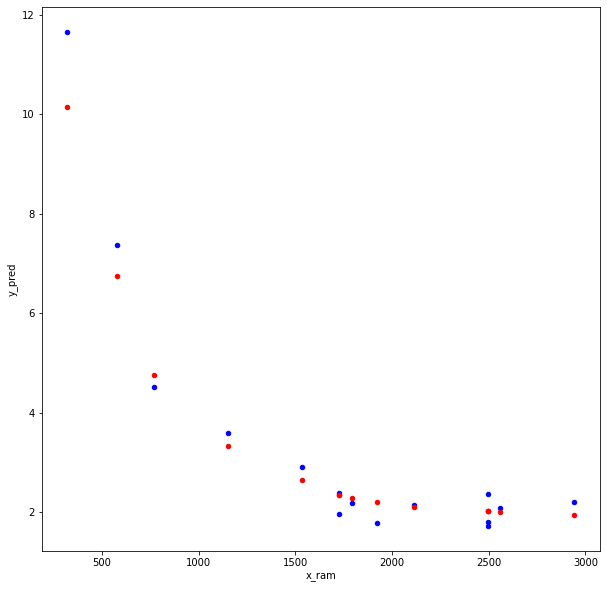

In [69]:
df = dataset[(dataset['x_task'] == 2) & (dataset['x_workflow'] == 1.0)]
plt.figure (figsize=(10,10))
ax = df.plot(kind = 'scatter', x = 'x_ram',
                  y = 'y_test', color = 'Blue', figsize=(10,10))
  
ax2 = df.plot(kind = 'scatter', x = 'x_ram', 
                   y = 'y_pred',
                   color = 'Red',
                   ax = ax, figsize=(10,10))




In [76]:
df['y_pred']

1       0.191959
43      0.398743
53      0.364747
65      0.221153
70      0.365284
          ...   
4656    0.167933
4658    0.249285
4678    0.210010
4686    0.495610
4711    0.133380
Name: y_pred, Length: 371, dtype: float32